# Preliminaries

In [11]:
#import libraries
import pandas as pd
print('pandas: %s' % pd.__version__)

pd.options.display.max_columns = None
pd.set_option('display.max_rows', 150)

import numpy as np
print('geopandas: %s' % np.__version__)

# Tensorflow / Keras
import tensorflow as tf # used to access argmax function
from tensorflow import keras # for building Neural Networks
print('Tensorflow/Keras: %s' % keras.__version__) # print version
from keras import Sequential # for creating a linear stack of layers for our Neural Network
from keras import Input # for instantiating a keras tensor
from keras.layers import Dense # for creating regular densely-connected NN layer.
from keras.layers import Dense, Conv2D, MaxPool2D, Flatten, Dropout # for adding Concolutional and densely-connected NN layers.
from tensorflow.keras import layers
from tensorflow.keras.layers import Dense, Input, Flatten,\
                                    Reshape, LeakyReLU as LR,\
                                    Activation, Dropout
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
from tensorflow.keras.callbacks import EarlyStopping

# Data manipulation
import pandas as pd # for data manipulation
print('pandas: %s' % pd.__version__) # print version
import numpy as np # for data manipulation
print('numpy: %s' % np.__version__) # print version

import decimal
from decimal import Decimal

import keras 
import tensorflow as tf
from tensorflow.keras.layers import Dropout,BatchNormalization,Conv2D,MaxPooling2D,Dense,Flatten
from tensorflow.keras.datasets import cifar10
from tensorflow.keras import regularizers
from keras import callbacks
from sklearn.preprocessing import StandardScaler
from keras.models import Sequential
import matplotlib.pyplot as plt
from keras.layers import Dense # for creating regular densely-connected NN layer.
from keras.layers import Dense, Conv2D, MaxPool2D, Flatten, Dropout,MaxPooling2D # for adding Concolutional and densely-connected NN layers.
from tensorflow.keras import layers
from tensorflow.keras.models import Model, Sequential

from pathlib import Path  

from sklearn.model_selection import train_test_split # for splitting the data into train and test samples
from sklearn.metrics import classification_report # for model evaluation metrics
from sklearn.preprocessing import OrdinalEncoder # for encoding labels
from keras.models import load_model
from sklearn.preprocessing import StandardScaler

from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics import confusion_matrix

from tensorflow.keras.utils import plot_model

from sklearn.utils.class_weight import compute_sample_weight

pandas: 1.5.0
geopandas: 1.23.2
Tensorflow/Keras: 2.10.0
pandas: 1.5.0
numpy: 1.23.2


In [12]:
import tensorflow as tf

print(f'tensorflow version {tf.__version__}')

from imblearn.over_sampling import SMOTE
from collections import Counter
from numpy import * 

import pandas as pd
import io
import requests
import numpy as np
from sklearn import metrics
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Activation
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.layers import Dense, Activation, Dropout
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics import confusion_matrix
from sklearn.preprocessing import StandardScaler


tensorflow version 2.10.0


In [13]:
%matplotlib inline
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import confusion_matrix
from sklearn import metrics

def plot_roc(pred,y):
    fpr, tpr, _ = roc_curve(y, pred)
    roc_auc = auc(fpr, tpr)

    plt.figure()
    plt.plot(fpr, tpr, label='ROC curve (area = %0.2f)' % roc_auc)
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC)')
    plt.legend(loc="lower right")
    plt.show()

In [14]:
def extract_images(df, variables, verbose=False):
    number_of_img, rows, cols = len(df.time.unique()), len(df.latitude.unique()), len(df.longitude.unique())
    images = np.zeros( (number_of_img, rows, cols, len(variables)) )
    
    df = df.sort_values(by=['time','latitude','longitude'])
    k=0
    
    for day in range(0,number_of_img):
        
        a=df.iloc[377*day:377*(day+1)]
        i=0
        for var in variables:
            images[day,:,:,i] = a.pivot(index='latitude', columns='longitude').sort_index(ascending=False)[var]
            i+=1
        k+=1
        if (k%100==0) & (verbose==True): print(k)
    return images

# Data

In [5]:
def dataLoad_noOversampling():
    train = pd.read_csv('/Users/paolo/Documents/TC_old/data/NewData_csv/training_sets_withrealtom.csv')
    val = pd.read_csv('/Users/paolo/Documents/TC_old/data/NewData_csv/validation_sets_withrealtom.csv')
    test = pd.read_csv('/Users/paolo/Documents/TC_old/data/NewData_csv/test_sets_withrealtom.csv')
    print(train.head())
    train['shear'] = train.apply(lambda x: sqrt((x.u_200-x.u_850)**2 + (x.v_200-x.v_850)**2),axis=1)
    val['shear'] = val.apply(lambda x: sqrt((x.u_200-x.u_850)**2 + (x.v_200-x.v_850)**2),axis=1)
    test['shear'] = test.apply(lambda x: sqrt((x.u_200-x.u_850)**2 + (x.v_200-x.v_850)**2),axis=1)

    #Split data
    x_train = train[[ 'vo', 'r', 'u_200', 'u_850', 'v_200','v_850', 'ttr','sst','shear']]
    print ("******training features******")
    print (x_train)
    y_train = train.apply(lambda x: 1 if x.new_target>=50 else 0,axis=1)
    print ("******training target******")
    print (y_train)
    
    x_test = test.loc[test.time>='2016-04-01'][[ 'vo', 'r', 'u_200', 'u_850', 'v_200','v_850', 'ttr','sst','shear']]
    print ("******test features******")
    print (x_test)
    y_test = test.loc[test.time>='2016-04-01'].apply(lambda x: 1 if x.new_target>=50 else 0,axis=1)
    print ("******test target******")
    print (y_test)
    
    x_val = val[[ 'vo', 'r', 'u_200', 'u_850', 'v_200','v_850', 'ttr','sst','shear']]
    print ("******validation features******")
    print (x_val)
    y_val = val.apply(lambda x: 1 if x.new_target>=50 else 0,axis=1)
    print ("******validation target******")
    print (y_val)
        
    return x_train, y_train, x_val, y_val, x_test, y_test

In [6]:
x_train, y_train, x_val, y_val, x_test, y_test = dataLoad_noOversampling()


   Unnamed: 0        time  latitude  longitude        vo          r     u_200  \
0           0  1980-01-01       0.0       20.0  0.000007  80.761185  1.909660   
1           1  1980-01-01       0.0       22.5  0.000004  80.703650  1.165733   
2           2  1980-01-01       0.0       25.0  0.000007  78.231514 -1.311676   
3           3  1980-01-01       0.0       27.5  0.000010  79.631010 -3.777573   
4           4  1980-01-01       0.0       30.0  0.000010  71.573875 -5.734505   

      u_850     v_200     v_850        ttr  sst  lsm  newlsm  new_target  \
0 -3.323872  1.687164 -1.823624 -247.54074  0.0  0.0     0.0         0.0   
1 -2.844494  1.060593 -1.991425 -240.00592  0.0  0.0     0.0         0.0   
2 -2.125244  3.280617 -1.931789 -223.76889  0.0  0.0     0.0         0.0   
3 -1.122395  5.743889 -1.243538 -235.55556  0.0  0.0     0.0         0.0   
4 -1.362953  6.514030 -0.954163 -254.03260  0.0  0.0     0.0         0.0   

   Real_tom_target  
0              0.0  
1             

In [7]:
x_train

,vo,r,u_200,u_850,v_200,v_850,ttr,sst,shear
0,0.000007,80.761185,1.909660,-3.323872,1.687164,-1.823624,-247.54074,0.00000,6.302023
1,0.000004,80.703650,1.165733,-2.844494,1.060593,-1.991425,-240.00592,0.00000,5.039517
2,0.000007,78.231514,-1.311676,-2.125244,3.280617,-1.931789,-223.76889,0.00000,5.275516
3,0.000010,79.631010,-3.777573,-1.122395,5.743889,-1.243538,-235.55556,0.00000,7.474898
4,0.000010,71.573875,-5.734505,-1.362953,6.514030,-0.954163,-254.03260,0.00000,8.653576
...,...,...,...,...,...,...,...,...,...
4268766,0.000015,26.797535,25.075424,-3.653679,-1.221291,1.515594,-273.34204,296.89227,28.859174
4268767,-0.000006,27.766910,24.175919,-2.866638,-6.724304,0.861771,-280.37018,296.03314,28.086446
4268768,0.000010,29.111805,24.655510,-2.809170,-10.138817,0.051220,-281.05167,295.36078,29.294120
4268769,0.000006,27.833050,25.088104,-2.730087,-11.036507,0.666927,-280.05610,295.10638,30.179830


In [77]:
y_train[]

0          0
1          0
2          0
3          0
4          0
          ..
4268766    0
4268767    0
4268768    0
4268769    0
4268770    0
Length: 4268771, dtype: int64

In [8]:
train = pd.read_csv('/Users/paolo/Documents/TC_old/data/NewData_csv/training_sets_withrealtom.csv')

In [10]:
train

,Unnamed: 0,time,latitude,longitude,vo,r,u_200,u_850,v_200,v_850,ttr,sst,lsm,newlsm,new_target,Real_tom_target
0,0,1980-01-01,0.0,20.0,0.000007,80.761185,1.909660,-3.323872,1.687164,-1.823624,-247.54074,0.00000,0.0,0.0,0.0,0.0
1,1,1980-01-01,0.0,22.5,0.000004,80.703650,1.165733,-2.844494,1.060593,-1.991425,-240.00592,0.00000,0.0,0.0,0.0,0.0
2,2,1980-01-01,0.0,25.0,0.000007,78.231514,-1.311676,-2.125244,3.280617,-1.931789,-223.76889,0.00000,0.0,0.0,0.0,0.0
3,3,1980-01-01,0.0,27.5,0.000010,79.631010,-3.777573,-1.122395,5.743889,-1.243538,-235.55556,0.00000,0.0,0.0,0.0,0.0
4,4,1980-01-01,0.0,30.0,0.000010,71.573875,-5.734505,-1.362953,6.514030,-0.954163,-254.03260,0.00000,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4268766,137600,2010-12-31,-30.0,80.0,0.000015,26.797535,25.075424,-3.653679,-1.221291,1.515594,-273.34204,296.89227,0.0,0.0,0.0,0.0
4268767,137601,2010-12-31,-30.0,82.5,-0.000006,27.766910,24.175919,-2.866638,-6.724304,0.861771,-280.37018,296.03314,0.0,0.0,0.0,0.0
4268768,137602,2010-12-31,-30.0,85.0,0.000010,29.111805,24.655510,-2.809170,-10.138817,0.051220,-281.05167,295.36078,0.0,0.0,0.0,0.0
4268769,137603,2010-12-31,-30.0,87.5,0.000006,27.833050,25.088104,-2.730087,-11.036507,0.666927,-280.05610,295.10638,0.0,0.0,0.0,0.0


In [8]:
trainScaler = StandardScaler()

x_train_scaled = trainScaler.fit_transform(x_train)
x_val_scaled = trainScaler.transform(x_val)
x_test_scaled = trainScaler.transform(x_test)

y_train = y_train.values
y_val = y_val.values
y_test = y_test.values

# Models

## Same of old target

### Model training

In [43]:
model_std_relu_dropout = Sequential()
model_std_relu_dropout.add(Dense(512, input_dim=9, activation='relu'))
model_std_relu_dropout.add(Dropout(0.5))
model_std_relu_dropout.add(Dense(1,activation='sigmoid')) # Output
model_std_relu_dropout.compile(loss='binary_crossentropy', optimizer='adam')

monitor = EarlyStopping(monitor='val_loss', min_delta=1e-5, patience=10, 
        verbose=1, mode='auto', restore_best_weights=True)

model_std_relu_dropout.summary()


Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_16 (Dense)            (None, 512)               5120      
                                                                 
 dropout_8 (Dropout)         (None, 512)               0         
                                                                 
 dense_17 (Dense)            (None, 1)                 513       
                                                                 
Total params: 5,633
Trainable params: 5,633
Non-trainable params: 0
_________________________________________________________________


In [44]:
model_std_relu_dropout.fit(x_train_scaled,y_train,validation_data=(x_val_scaled,y_val),
        callbacks=[monitor],epochs=50, batch_size=512)

Epoch 1/50


2023-06-07 22:10:58.520588: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8338/8338 [==============================] - ETA: 0s - loss: 0.0171

2023-06-07 22:11:32.868546: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8338/8338 [==============================] - 38s 4ms/step - loss: 0.0171 - val_loss: 0.0122
Epoch 2/50
8338/8338 [==============================] - 36s 4ms/step - loss: 0.0146 - val_loss: 0.0115
Epoch 3/50
8338/8338 [==============================] - 35s 4ms/step - loss: 0.0144 - val_loss: 0.0116
Epoch 4/50
8338/8338 [==============================] - 35s 4ms/step - loss: 0.0144 - val_loss: 0.0117
Epoch 5/50
8338/8338 [==============================] - 35s 4ms/step - loss: 0.0143 - val_loss: 0.0112
Epoch 6/50
8338/8338 [==============================] - 35s 4ms/step - loss: 0.0143 - val_loss: 0.0112
Epoch 7/50
8338/8338 [==============================] - 35s 4ms/step - loss: 0.0143 - val_loss: 0.0114
Epoch 8/50
8338/8338 [==============================] - 34s 4ms/step - loss: 0.0142 - val_loss: 0.0114
Epoch 9/50
8338/8338 [==============================] - 35s 4ms/step - loss: 0.0142 - val_loss: 0.0112
Epoch 10/50
8338/8338 [==============================] - 35s 4ms/step - loss: 0.0142

2023-06-07 23:12:06.254229: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


29053/29053 [==============================] - 32s 1ms/step


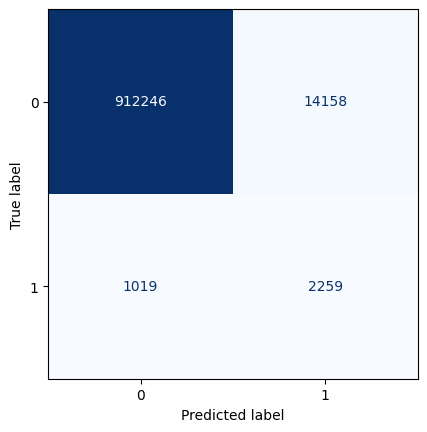

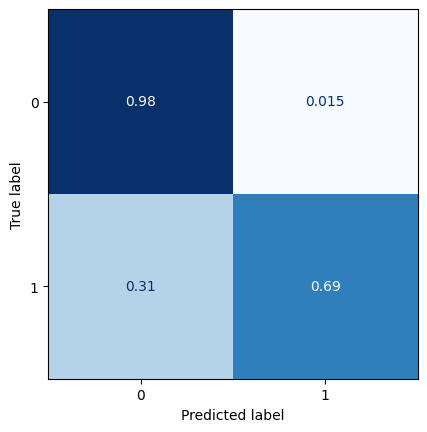

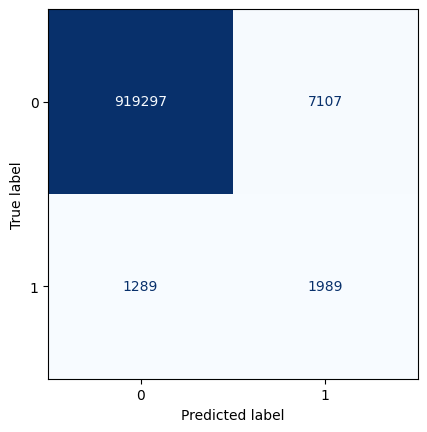

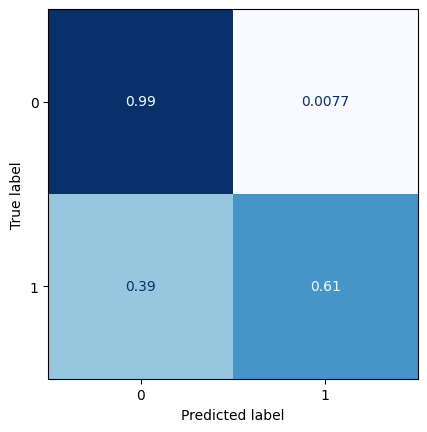

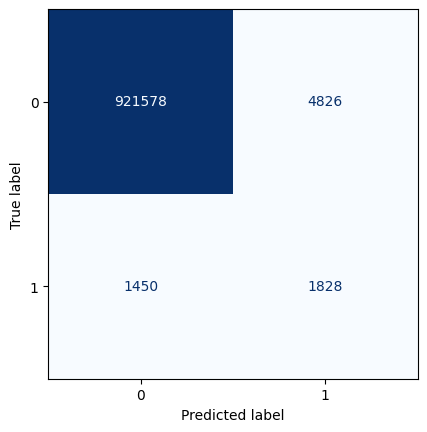

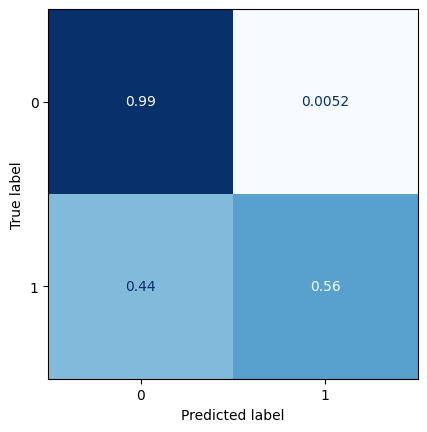

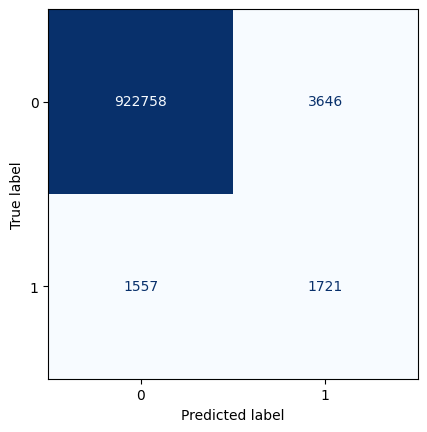

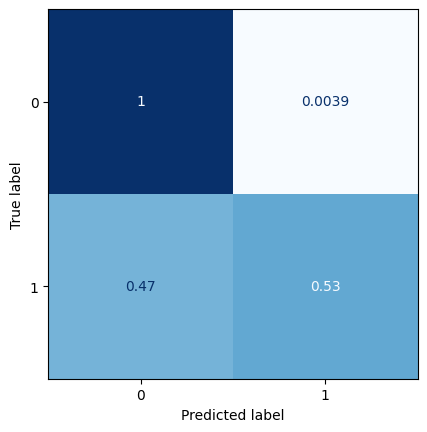

In [45]:
t = model_std_relu_dropout.predict(x_test_scaled)

ranges = [0.025,0.05,0.075,0.1]

for j in ranges:
    classes = []
    for i in t:
        if i<=j: classes.append(0)
        else: classes.append(1)

# confusion matrix with threshold on 0.1, otherwise always 0 
    ConfusionMatrixDisplay(confusion_matrix(y_test, classes)).plot(colorbar=False,cmap=plt.cm.Blues, values_format='d')
    ConfusionMatrixDisplay(confusion_matrix(y_test, classes, normalize='true')).plot(colorbar=False,cmap=plt.cm.Blues)
    


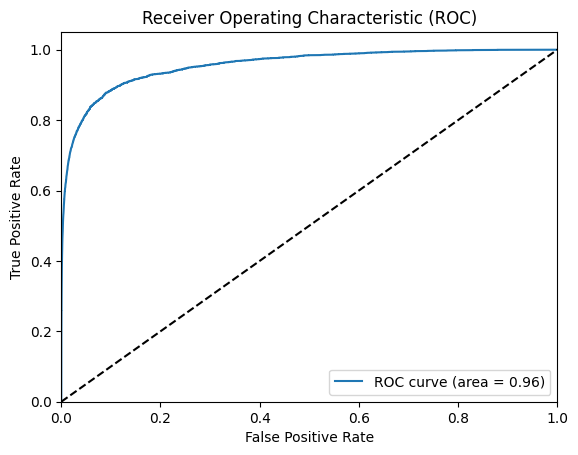

In [46]:
plot_roc(t,y_test)

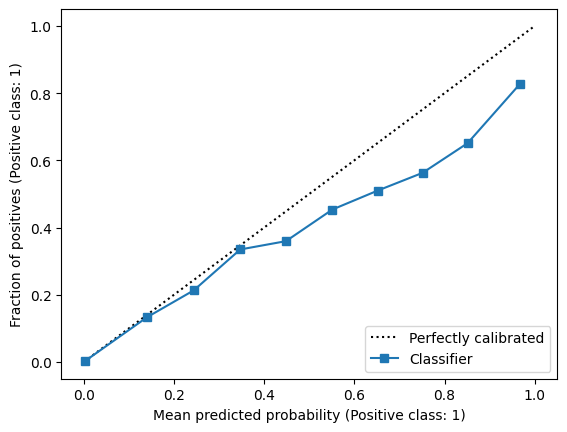

In [47]:
from sklearn.calibration import CalibrationDisplay

display = CalibrationDisplay.from_predictions(y_test, t, n_bins=10)


In [48]:
from sklearn.metrics import brier_score_loss
### brier score con probabilità predette

print(f'All zeros Brier score: {brier_score_loss(y_test, np.zeros(len(y_test)))}')
print(f'Model Brier score: {brier_score_loss(y_test, t)}')

All zeros Brier score: 0.0035259368257102965
Model Brier score: 0.0026380538506844005


In [49]:
test = pd.read_csv('/Users/paolo/Documents/TC_old/data/NewData_csv/test_sets_withrealtom.csv')
test = test.loc[test.time>='2016-04-01']

In [50]:
test['predictions_lag0'] = t

In [51]:
test.to_csv("test_with_newTarget_predictions_FFNN_noOversampling.csv")

In [8]:
test = pd.read_csv('test_with_newTarget_predictions_FFNN_noOversampling.csv')

# Lag from 1 to 13

In [14]:
from sklearn.calibration import CalibrationDisplay
from sklearn.metrics import brier_score_loss


Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_6 (Dense)             (None, 512)               5120      
                                                                 
 dropout_3 (Dropout)         (None, 512)               0         
                                                                 
 dense_7 (Dense)             (None, 1)                 513       
                                                                 
Total params: 5,633
Trainable params: 5,633
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50


2023-06-08 07:43:47.327553: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8337/8337 [==============================] - ETA: 0s - loss: 0.0214

2023-06-08 07:44:21.349252: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8337/8337 [==============================] - 37s 4ms/step - loss: 0.0214 - val_loss: 0.0165
Epoch 2/50
8337/8337 [==============================] - 36s 4ms/step - loss: 0.0188 - val_loss: 0.0161
Epoch 3/50
8337/8337 [==============================] - 36s 4ms/step - loss: 0.0186 - val_loss: 0.0161
Epoch 4/50
8337/8337 [==============================] - 35s 4ms/step - loss: 0.0185 - val_loss: 0.0160
Epoch 5/50
8337/8337 [==============================] - 35s 4ms/step - loss: 0.0185 - val_loss: 0.0160
Epoch 6/50
8337/8337 [==============================] - 35s 4ms/step - loss: 0.0184 - val_loss: 0.0158
Epoch 7/50
8337/8337 [==============================] - 35s 4ms/step - loss: 0.0184 - val_loss: 0.0160
Epoch 8/50
8337/8337 [==============================] - 34s 4ms/step - loss: 0.0183 - val_loss: 0.0158
Epoch 9/50
8337/8337 [==============================] - 35s 4ms/step - loss: 0.0183 - val_loss: 0.0157
Epoch 10/50
8337/8337 [==============================] - 35s 4ms/step - loss: 0.0183

2023-06-08 07:50:14.225590: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


29041/29041 [==============================] - 33s 1ms/step


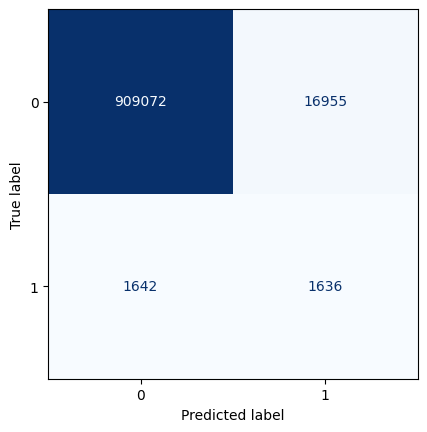

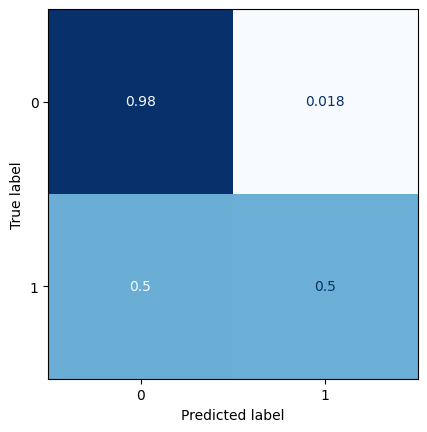

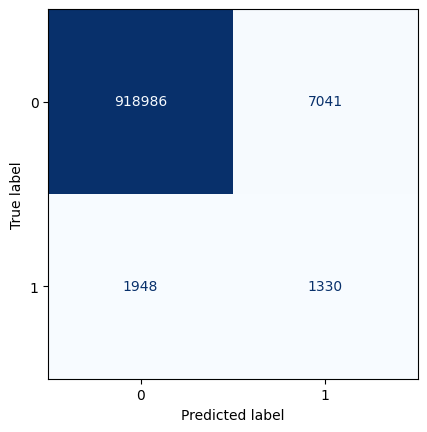

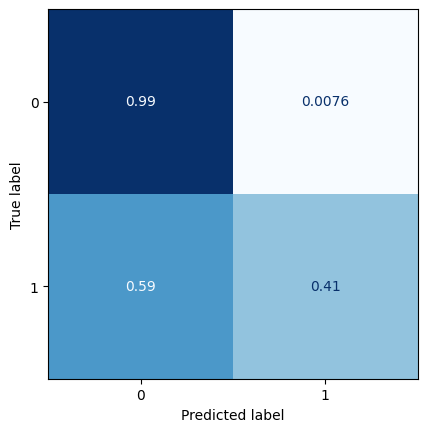

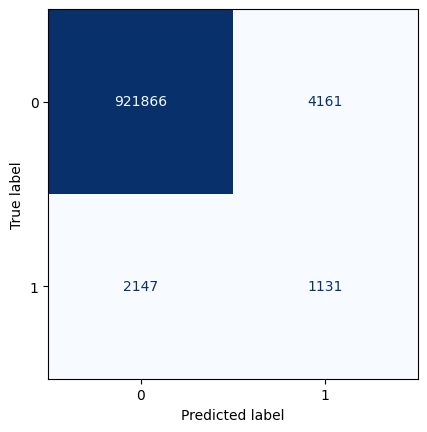

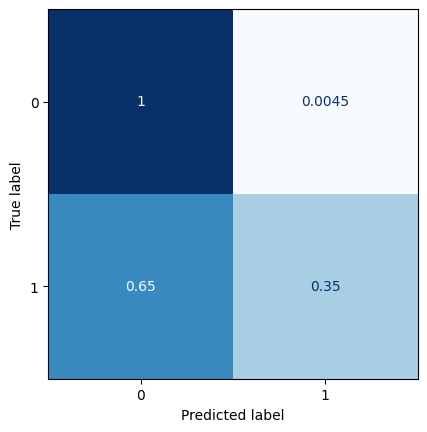

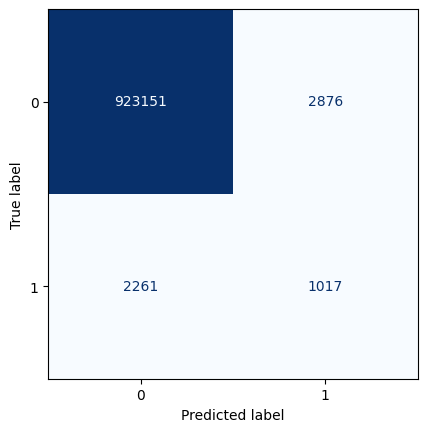

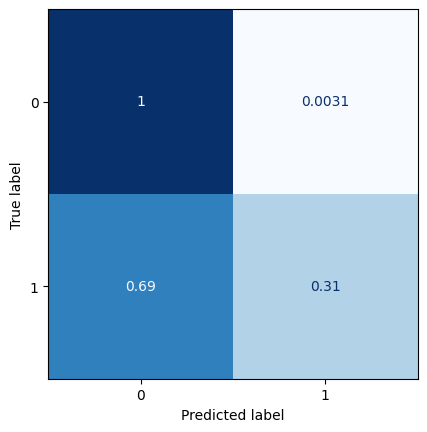

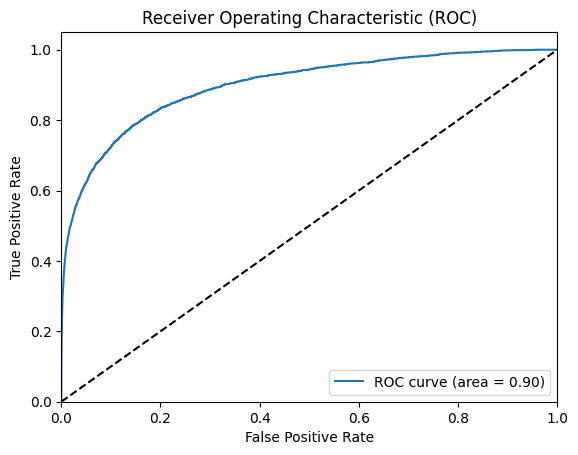

All zeros Brier score: 0.00352736722604527
Model Brier score: 0.003109807794891376
Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_8 (Dense)             (None, 512)               5120      
                                                                 
 dropout_4 (Dropout)         (None, 512)               0         
                                                                 
 dense_9 (Dense)             (None, 1)                 513       
                                                                 
Total params: 5,633
Trainable params: 5,633
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50


2023-06-08 07:51:06.319387: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8336/8336 [==============================] - ETA: 0s - loss: 0.0244

2023-06-08 07:51:39.678766: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8336/8336 [==============================] - 36s 4ms/step - loss: 0.0244 - val_loss: 0.0200
Epoch 2/50
8336/8336 [==============================] - 35s 4ms/step - loss: 0.0225 - val_loss: 0.0200
Epoch 3/50
8336/8336 [==============================] - 36s 4ms/step - loss: 0.0223 - val_loss: 0.0198
Epoch 4/50
8336/8336 [==============================] - 35s 4ms/step - loss: 0.0223 - val_loss: 0.0196
Epoch 5/50
8336/8336 [==============================] - 36s 4ms/step - loss: 0.0222 - val_loss: 0.0197
Epoch 6/50
8336/8336 [==============================] - 35s 4ms/step - loss: 0.0222 - val_loss: 0.0195
Epoch 7/50
8336/8336 [==============================] - 35s 4ms/step - loss: 0.0221 - val_loss: 0.0197
Epoch 8/50
8336/8336 [==============================] - 35s 4ms/step - loss: 0.0221 - val_loss: 0.0199
Epoch 9/50
8336/8336 [==============================] - 34s 4ms/step - loss: 0.0221 - val_loss: 0.0199
Epoch 10/50
8336/8336 [==============================] - 35s 4ms/step - loss: 0.0220

2023-06-08 07:57:35.064166: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


29029/29029 [==============================] - 35s 1ms/step


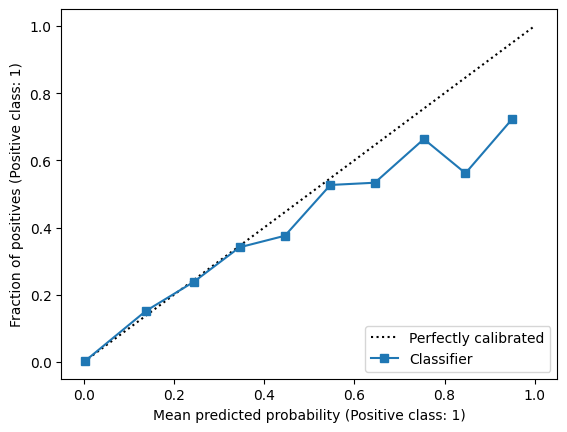

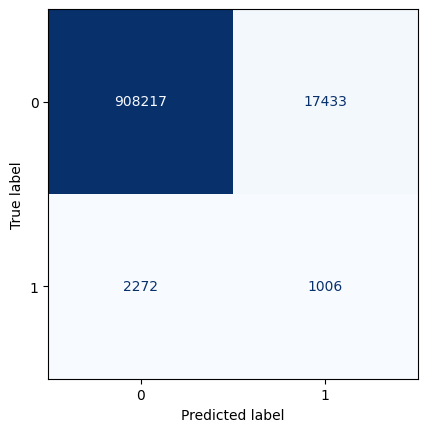

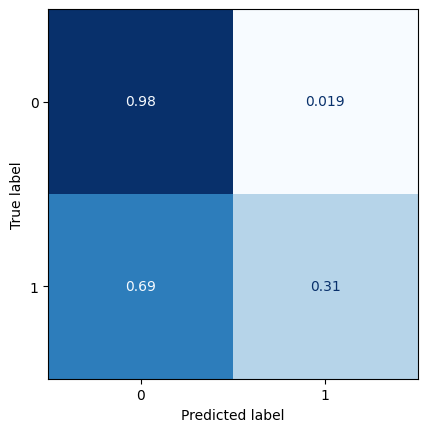

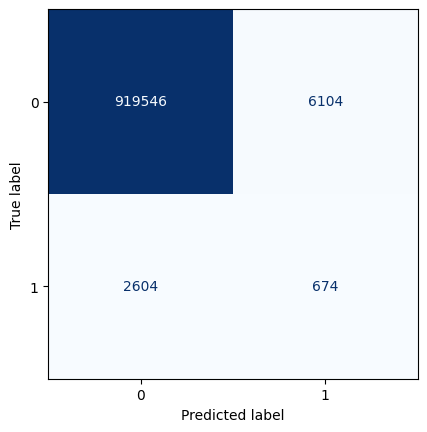

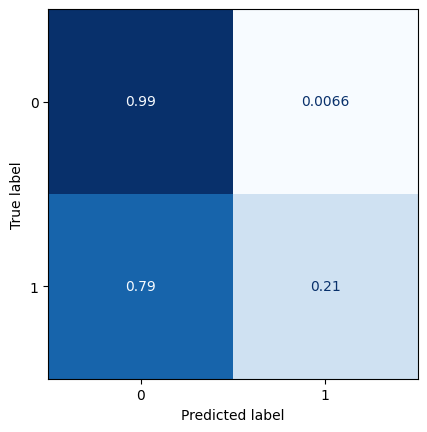

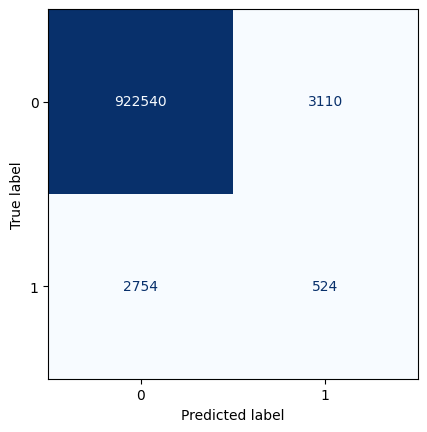

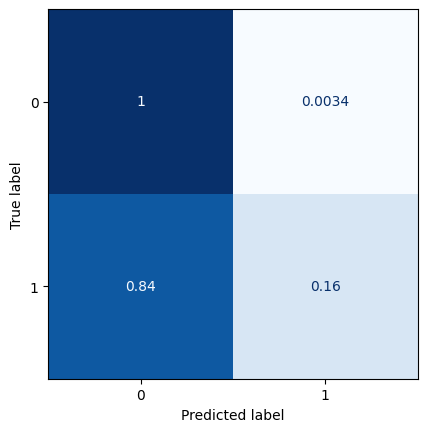

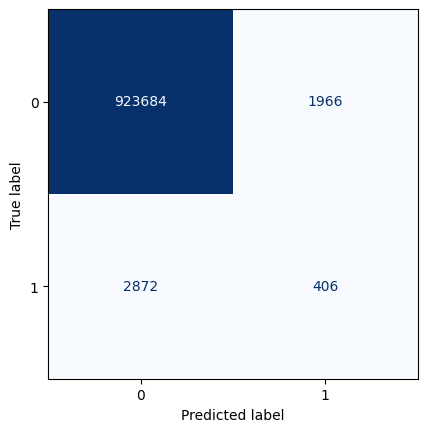

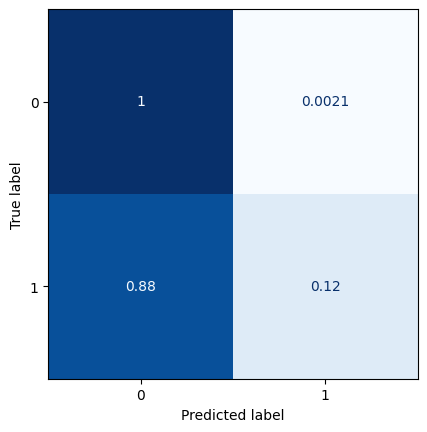

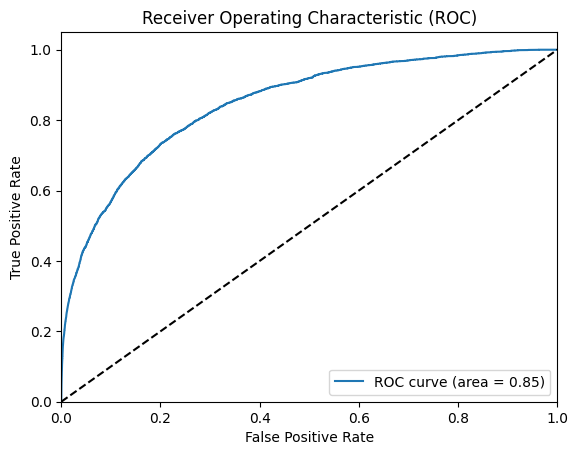

All zeros Brier score: 0.003528798787419477
Model Brier score: 0.0033967382325156468
Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_10 (Dense)            (None, 512)               5120      
                                                                 
 dropout_5 (Dropout)         (None, 512)               0         
                                                                 
 dense_11 (Dense)            (None, 1)                 513       
                                                                 
Total params: 5,633
Trainable params: 5,633
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50


2023-06-08 07:58:55.885276: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8336/8336 [==============================] - ETA: 0s - loss: 0.0261

2023-06-08 07:59:31.977902: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8336/8336 [==============================] - 39s 5ms/step - loss: 0.0261 - val_loss: 0.0218
Epoch 2/50
8336/8336 [==============================] - 36s 4ms/step - loss: 0.0241 - val_loss: 0.0214
Epoch 3/50
8336/8336 [==============================] - 36s 4ms/step - loss: 0.0240 - val_loss: 0.0213
Epoch 4/50
8336/8336 [==============================] - 35s 4ms/step - loss: 0.0240 - val_loss: 0.0213
Epoch 5/50
8336/8336 [==============================] - 36s 4ms/step - loss: 0.0239 - val_loss: 0.0214
Epoch 6/50
8336/8336 [==============================] - 35s 4ms/step - loss: 0.0239 - val_loss: 0.0216
Epoch 7/50
8336/8336 [==============================] - 35s 4ms/step - loss: 0.0238 - val_loss: 0.0214
Epoch 8/50
8336/8336 [==============================] - 35s 4ms/step - loss: 0.0238 - val_loss: 0.0213
Epoch 8: early stopping
   49/29018 [..............................] - ETA: 1:17

2023-06-08 08:03:45.151838: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


29018/29018 [==============================] - 33s 1ms/step


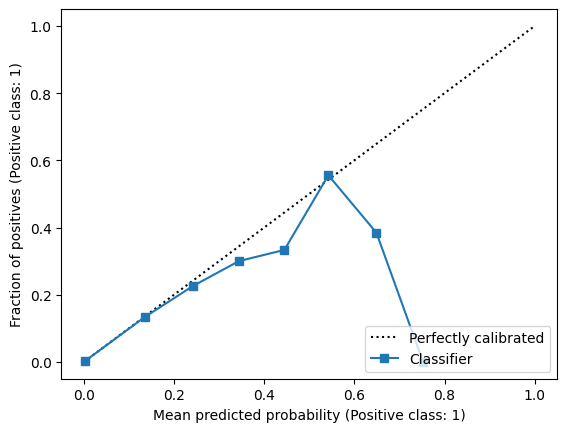

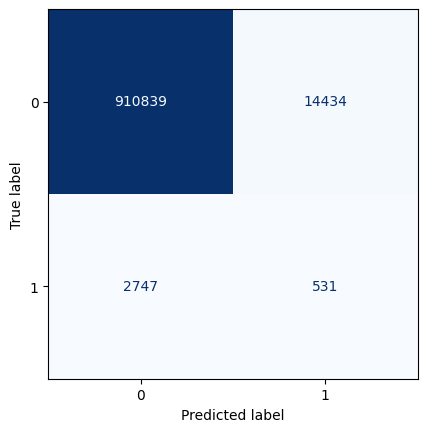

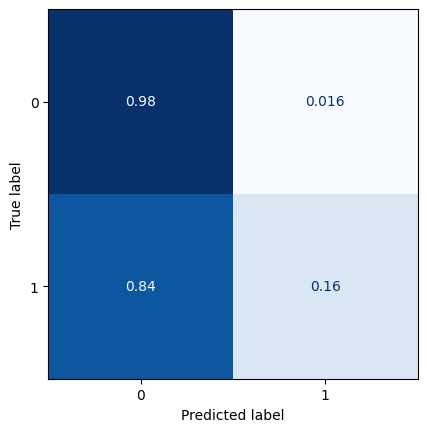

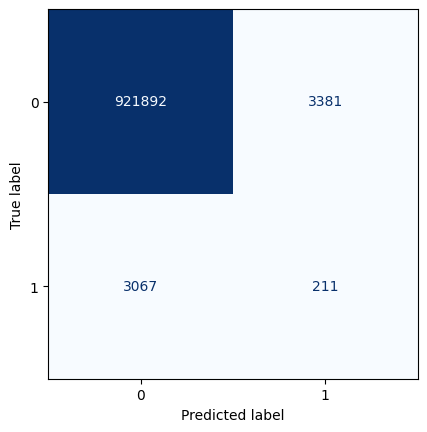

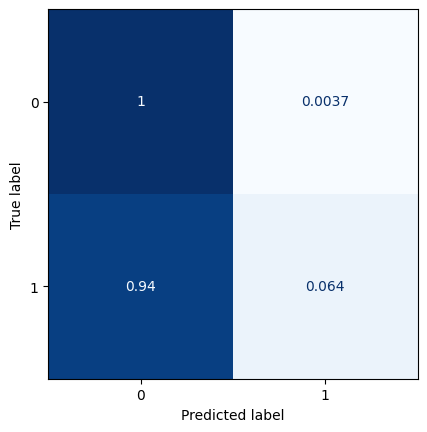

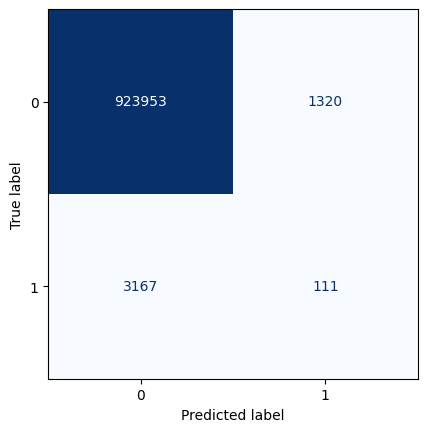

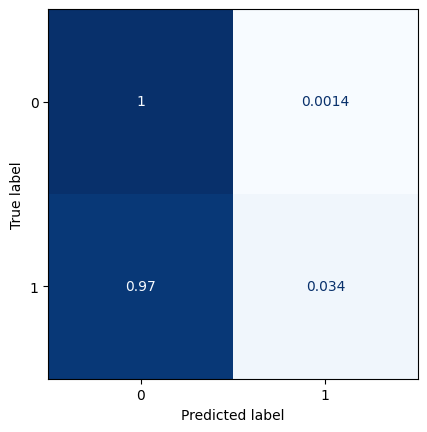

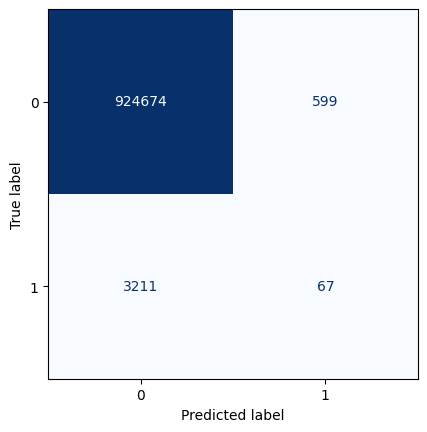

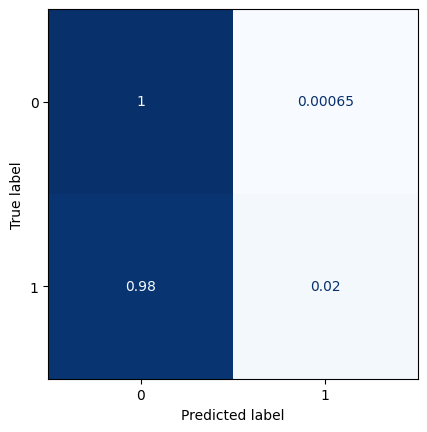

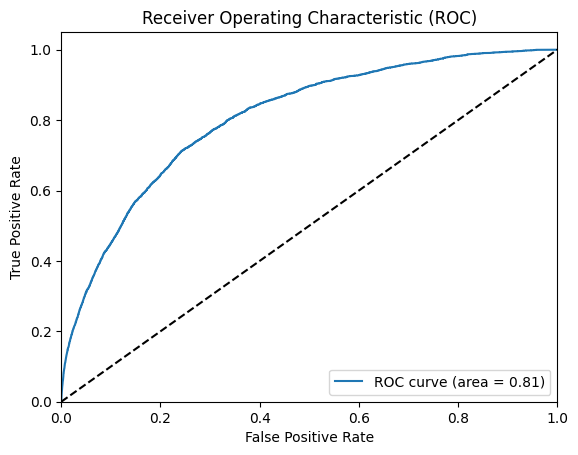

All zeros Brier score: 0.0035302315112470937
Model Brier score: 0.0034865596306971006
Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_12 (Dense)            (None, 512)               5120      
                                                                 
 dropout_6 (Dropout)         (None, 512)               0         
                                                                 
 dense_13 (Dense)            (None, 1)                 513       
                                                                 
Total params: 5,633
Trainable params: 5,633
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50


2023-06-08 08:05:03.384554: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8335/8335 [==============================] - ETA: 0s - loss: 0.0265

2023-06-08 08:05:38.968816: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8335/8335 [==============================] - 38s 5ms/step - loss: 0.0265 - val_loss: 0.0220
Epoch 2/50
8335/8335 [==============================] - 35s 4ms/step - loss: 0.0247 - val_loss: 0.0220
Epoch 3/50
8335/8335 [==============================] - 35s 4ms/step - loss: 0.0246 - val_loss: 0.0220
Epoch 4/50
8335/8335 [==============================] - 35s 4ms/step - loss: 0.0246 - val_loss: 0.0219
Epoch 5/50
8335/8335 [==============================] - 35s 4ms/step - loss: 0.0245 - val_loss: 0.0219
Epoch 6/50
8335/8335 [==============================] - 35s 4ms/step - loss: 0.0245 - val_loss: 0.0220
Epoch 6: early stopping
   74/29006 [..............................] - ETA: 40s 

2023-06-08 08:08:37.648711: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


29006/29006 [==============================] - 33s 1ms/step


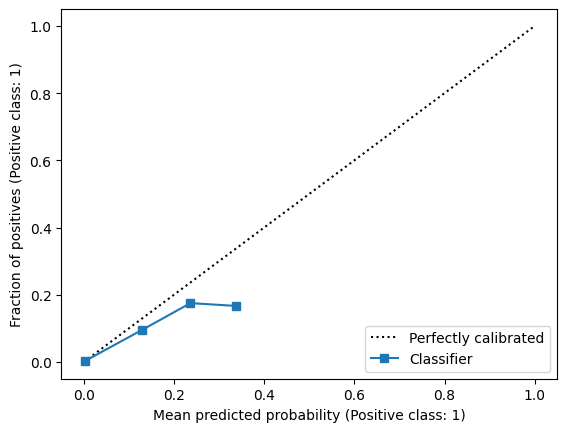

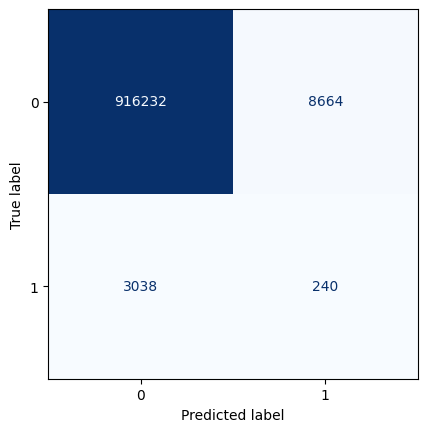

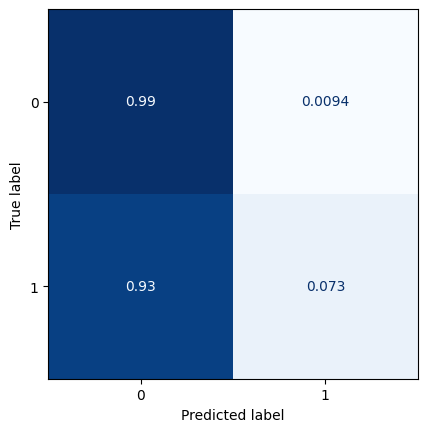

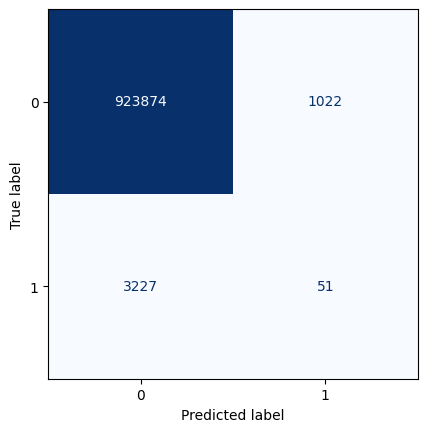

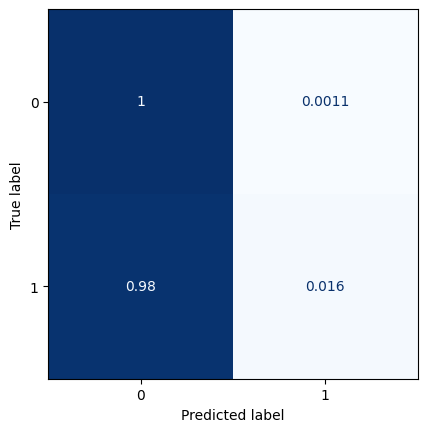

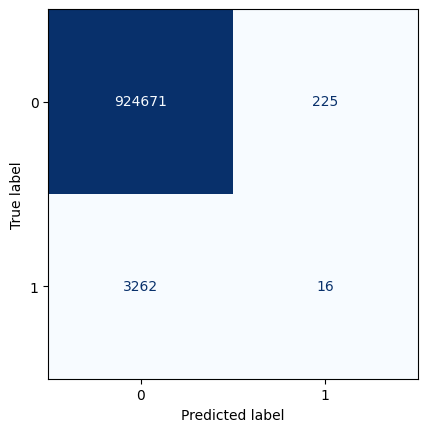

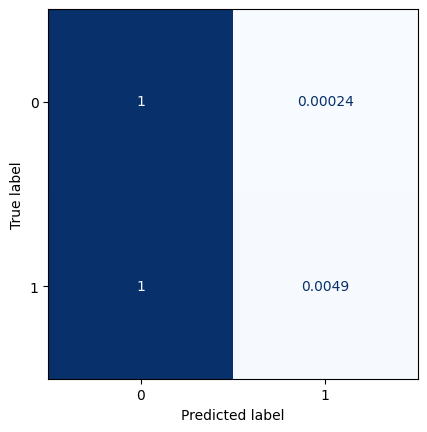

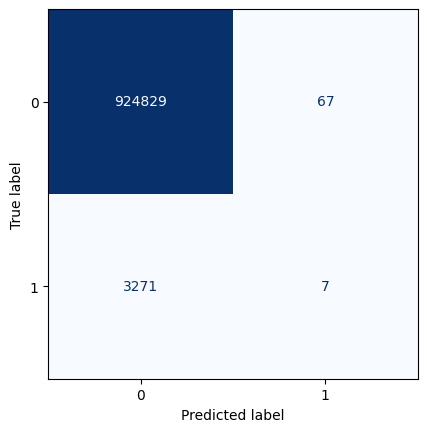

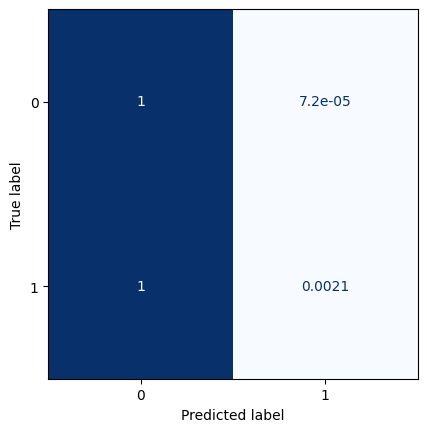

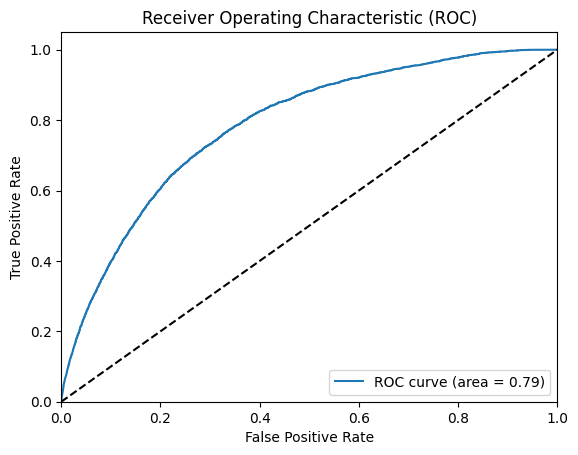

All zeros Brier score: 0.0035316653989445946
Model Brier score: 0.0035004545039076253
Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_14 (Dense)            (None, 512)               5120      
                                                                 
 dropout_7 (Dropout)         (None, 512)               0         
                                                                 
 dense_15 (Dense)            (None, 1)                 513       
                                                                 
Total params: 5,633
Trainable params: 5,633
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50


2023-06-08 08:09:59.293699: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8334/8334 [==============================] - ETA: 0s - loss: 0.0268

2023-06-08 08:10:41.255160: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8334/8334 [==============================] - 45s 5ms/step - loss: 0.0268 - val_loss: 0.0225
Epoch 2/50
8334/8334 [==============================] - 2075s 249ms/step - loss: 0.0249 - val_loss: 0.0223
Epoch 3/50
8334/8334 [==============================] - 716s 86ms/step - loss: 0.0248 - val_loss: 0.0223
Epoch 4/50
8334/8334 [==============================] - 59s 7ms/step - loss: 0.0247 - val_loss: 0.0220
Epoch 5/50
8334/8334 [==============================] - 37s 4ms/step - loss: 0.0247 - val_loss: 0.0222
Epoch 6/50
8334/8334 [==============================] - 38s 5ms/step - loss: 0.0247 - val_loss: 0.0220
Epoch 7/50
8334/8334 [==============================] - 37s 4ms/step - loss: 0.0246 - val_loss: 0.0221
Epoch 8/50
8334/8334 [==============================] - 37s 4ms/step - loss: 0.0246 - val_loss: 0.0221
Epoch 9/50
8334/8334 [==============================] - 42s 5ms/step - loss: 0.0246 - val_loss: 0.0222
Epoch 9: early stopping
   56/28994 [..............................] - ETA: 53

2023-06-08 09:01:25.510689: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


28994/28994 [==============================] - 35s 1ms/step


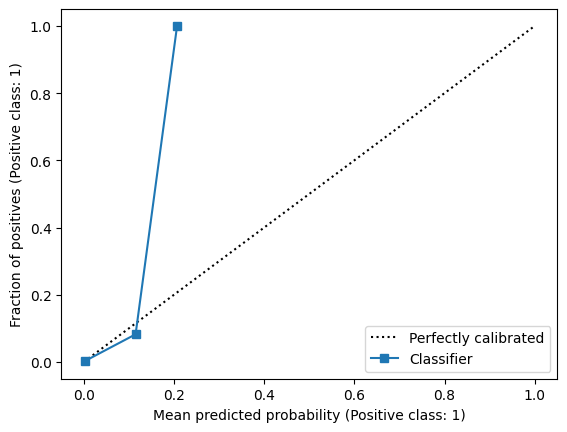

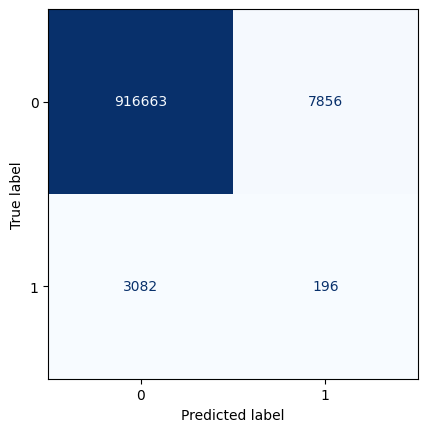

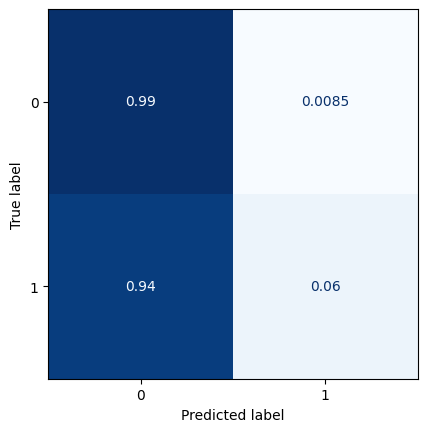

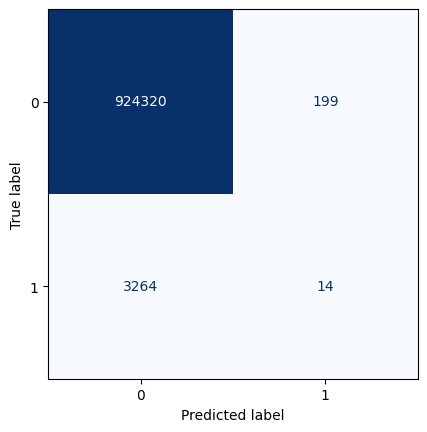

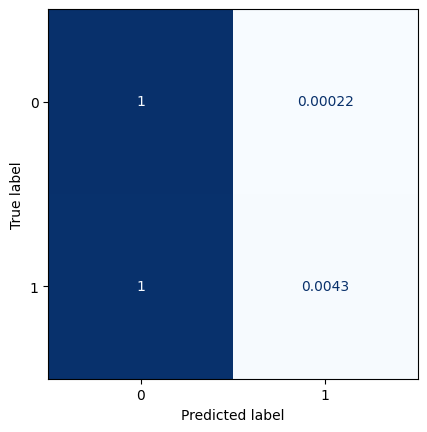

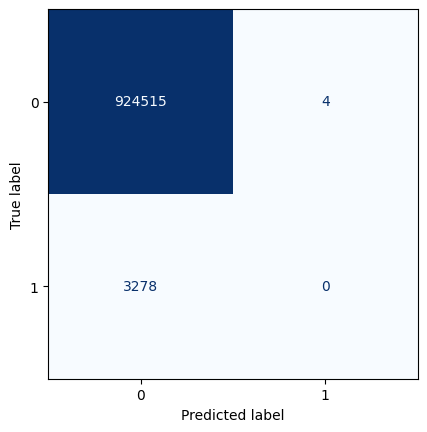

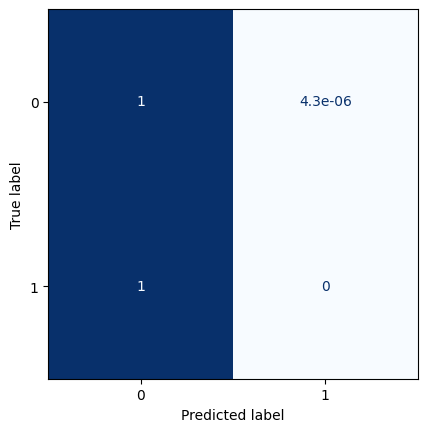

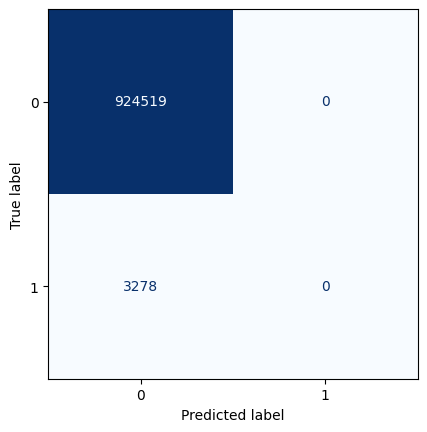

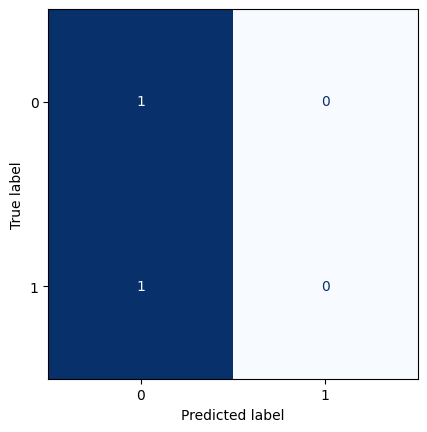

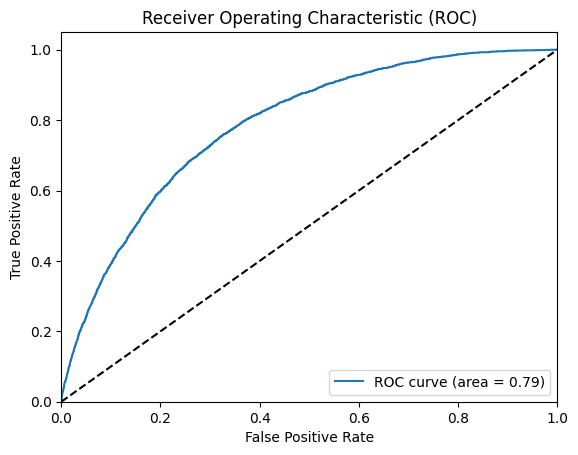

All zeros Brier score: 0.0035331004519307562
Model Brier score: 0.0035030848818807313
Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_16 (Dense)            (None, 512)               5120      
                                                                 
 dropout_8 (Dropout)         (None, 512)               0         
                                                                 
 dense_17 (Dense)            (None, 1)                 513       
                                                                 
Total params: 5,633
Trainable params: 5,633
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50


2023-06-08 09:02:51.950901: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8334/8334 [==============================] - ETA: 0s - loss: 0.0267

2023-06-08 09:03:52.143256: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8334/8334 [==============================] - 64s 7ms/step - loss: 0.0267 - val_loss: 0.0224
Epoch 2/50
8334/8334 [==============================] - 36s 4ms/step - loss: 0.0249 - val_loss: 0.0221
Epoch 3/50
8334/8334 [==============================] - 38s 5ms/step - loss: 0.0248 - val_loss: 0.0223
Epoch 4/50
8334/8334 [==============================] - 38s 5ms/step - loss: 0.0248 - val_loss: 0.0223
Epoch 5/50
8334/8334 [==============================] - 37s 4ms/step - loss: 0.0248 - val_loss: 0.0222
Epoch 6/50
8334/8334 [==============================] - 37s 4ms/step - loss: 0.0247 - val_loss: 0.0223
Epoch 7/50
8334/8334 [==============================] - 38s 5ms/step - loss: 0.0247 - val_loss: 0.0222
Epoch 7: early stopping
    1/28982 [..............................] - ETA: 1:52:11

2023-06-08 09:07:39.409820: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


28982/28982 [==============================] - 36s 1ms/step


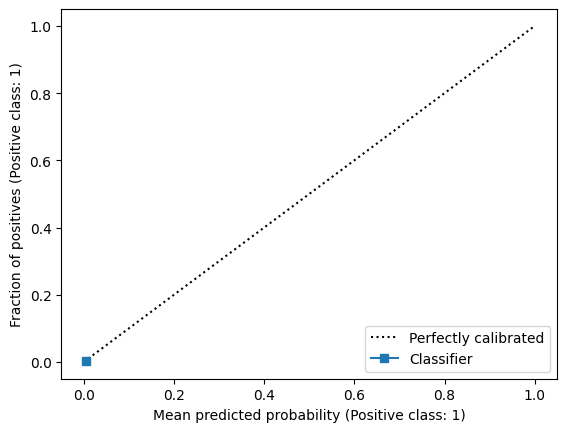

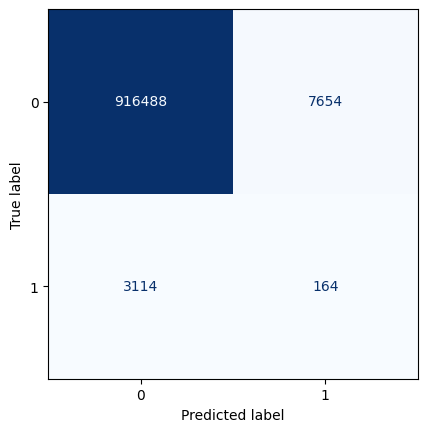

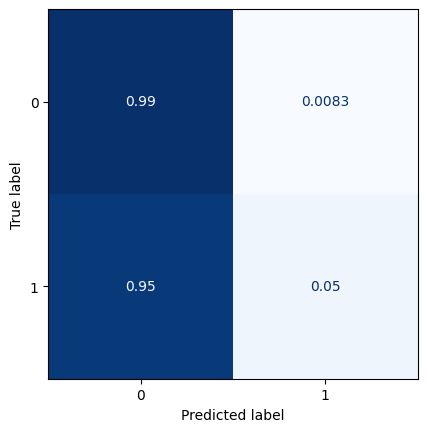

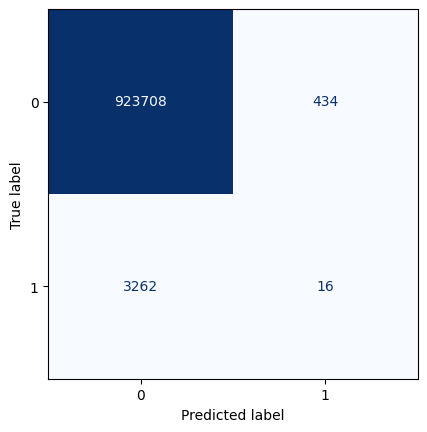

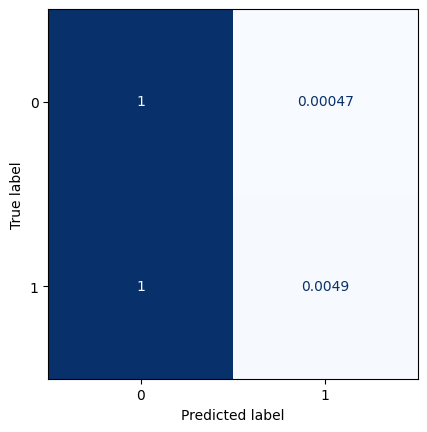

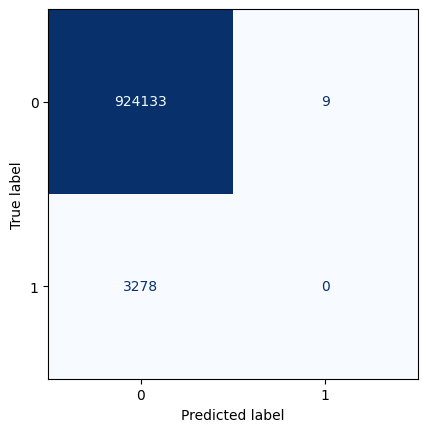

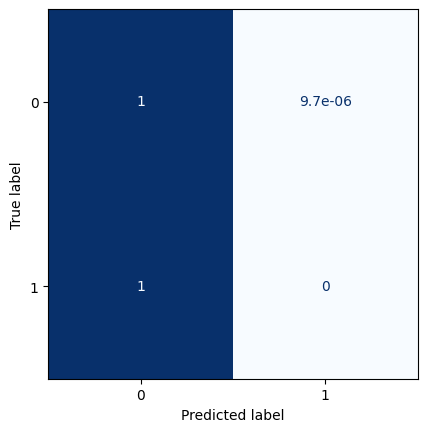

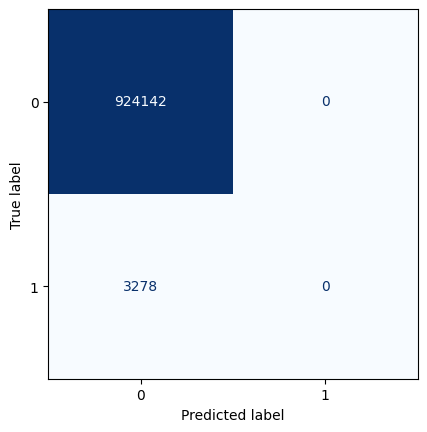

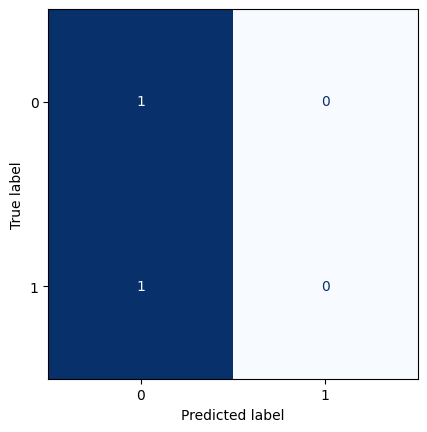

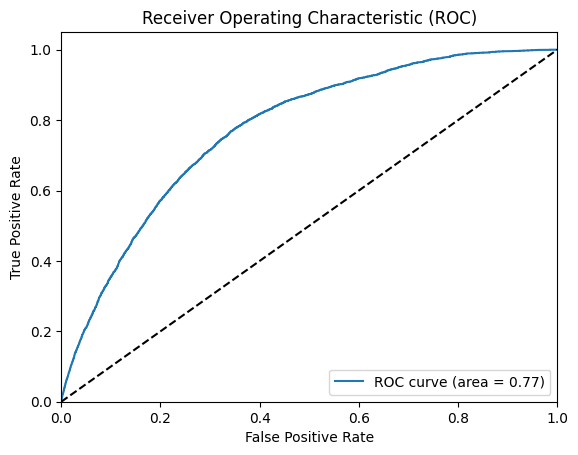

All zeros Brier score: 0.003534536671626663
Model Brier score: 0.003509180119177706
Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_18 (Dense)            (None, 512)               5120      
                                                                 
 dropout_9 (Dropout)         (None, 512)               0         
                                                                 
 dense_19 (Dense)            (None, 1)                 513       
                                                                 
Total params: 5,633
Trainable params: 5,633
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50


2023-06-08 09:09:03.906319: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8333/8333 [==============================] - ETA: 0s - loss: 0.0271

2023-06-08 09:09:38.450878: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8333/8333 [==============================] - 38s 4ms/step - loss: 0.0271 - val_loss: 0.0223
Epoch 2/50
8333/8333 [==============================] - 37s 4ms/step - loss: 0.0249 - val_loss: 0.0225
Epoch 3/50
8333/8333 [==============================] - 37s 4ms/step - loss: 0.0249 - val_loss: 0.0223
Epoch 4/50
8333/8333 [==============================] - 37s 4ms/step - loss: 0.0248 - val_loss: 0.0223
Epoch 5/50
8333/8333 [==============================] - 37s 4ms/step - loss: 0.0248 - val_loss: 0.0223
Epoch 6/50
8333/8333 [==============================] - 37s 4ms/step - loss: 0.0247 - val_loss: 0.0223
Epoch 6: early stopping
   65/28971 [..............................] - ETA: 45s 

2023-06-08 09:12:45.519169: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


28971/28971 [==============================] - 37s 1ms/step


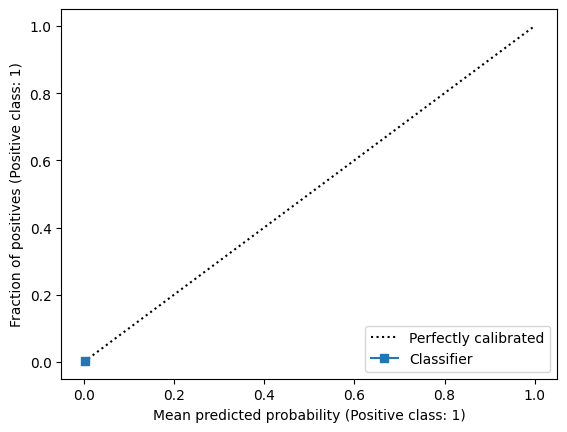

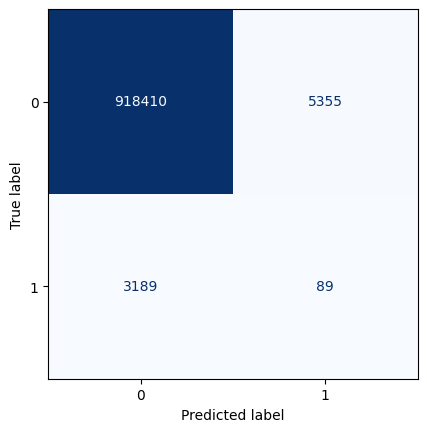

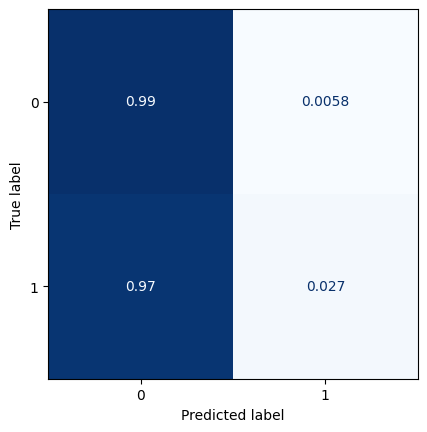

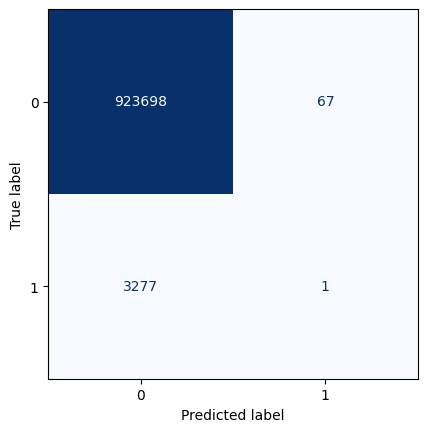

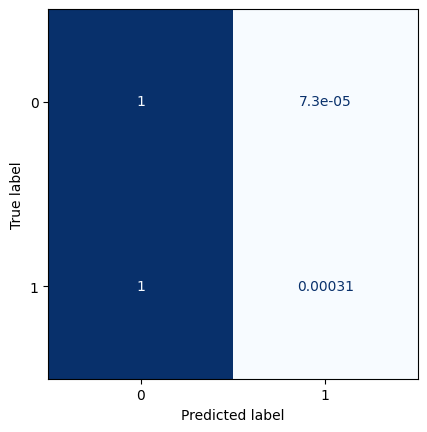

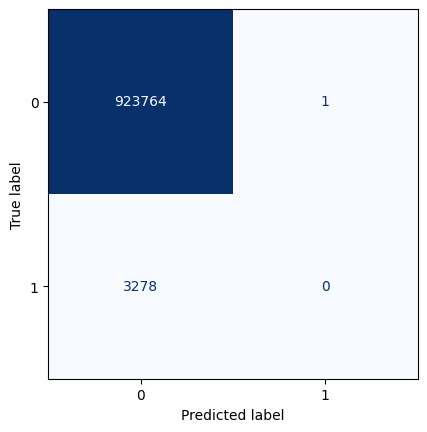

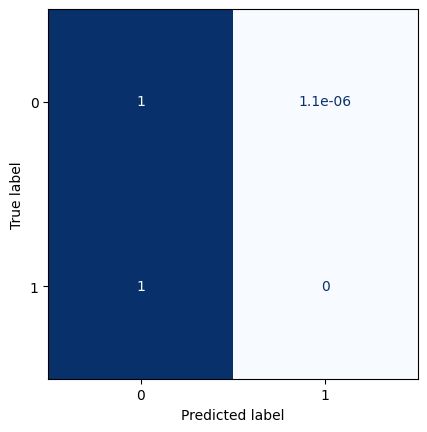

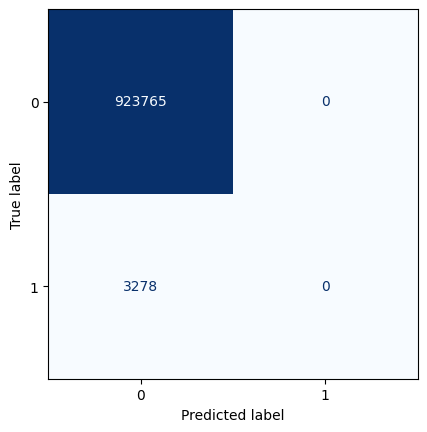

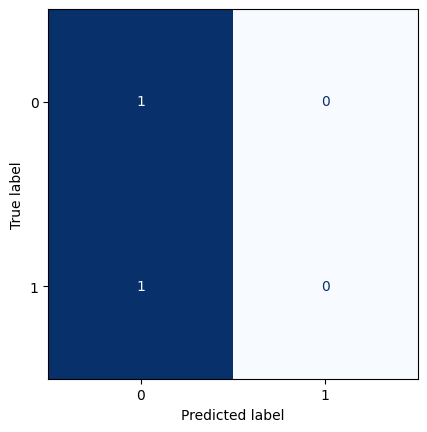

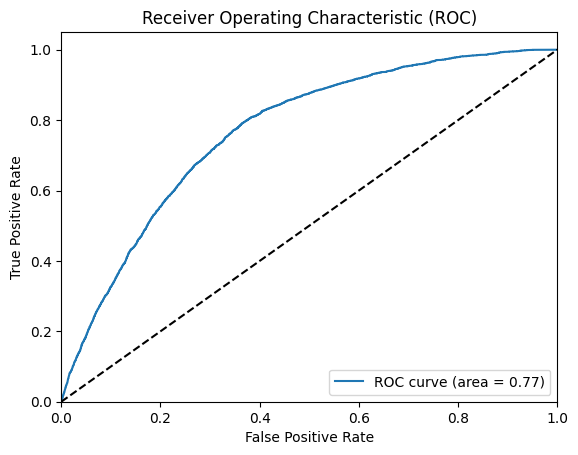

All zeros Brier score: 0.00353597405945571
Model Brier score: 0.003512815305200277
Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_20 (Dense)            (None, 512)               5120      
                                                                 
 dropout_10 (Dropout)        (None, 512)               0         
                                                                 
 dense_21 (Dense)            (None, 1)                 513       
                                                                 
Total params: 5,633
Trainable params: 5,633
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50


2023-06-08 09:14:10.860243: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8332/8332 [==============================] - ETA: 0s - loss: 0.0269

2023-06-08 09:14:45.567314: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8332/8332 [==============================] - 38s 4ms/step - loss: 0.0269 - val_loss: 0.0226
Epoch 2/50
8332/8332 [==============================] - 41s 5ms/step - loss: 0.0249 - val_loss: 0.0228
Epoch 3/50
8332/8332 [==============================] - 37s 4ms/step - loss: 0.0249 - val_loss: 0.0224
Epoch 4/50
8332/8332 [==============================] - 36s 4ms/step - loss: 0.0248 - val_loss: 0.0223
Epoch 5/50
8332/8332 [==============================] - 46s 5ms/step - loss: 0.0248 - val_loss: 0.0224
Epoch 6/50
8332/8332 [==============================] - 36s 4ms/step - loss: 0.0247 - val_loss: 0.0224
Epoch 7/50
8332/8332 [==============================] - 63s 8ms/step - loss: 0.0247 - val_loss: 0.0223
Epoch 8/50
8332/8332 [==============================] - 40s 5ms/step - loss: 0.0247 - val_loss: 0.0224
Epoch 8: early stopping
    9/28959 [..............................] - ETA: 3:02   

2023-06-08 09:19:48.756779: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


28959/28959 [==============================] - 34s 1ms/step


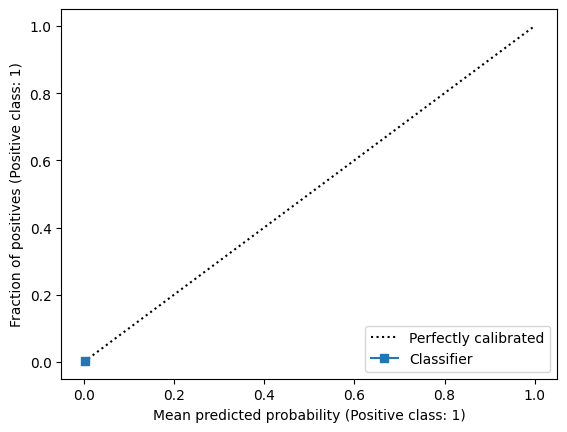

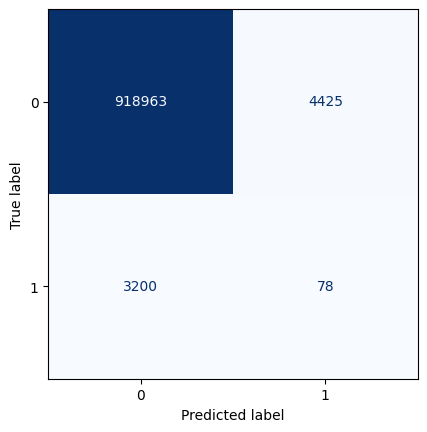

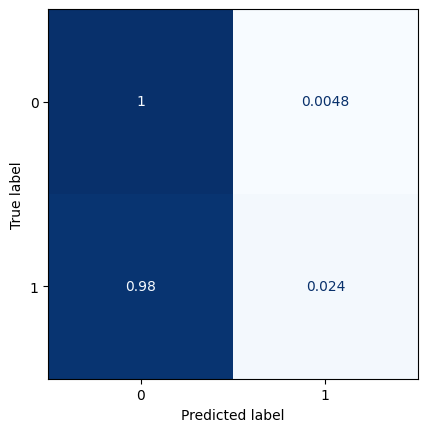

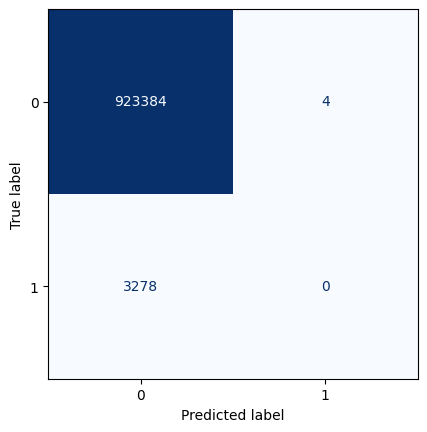

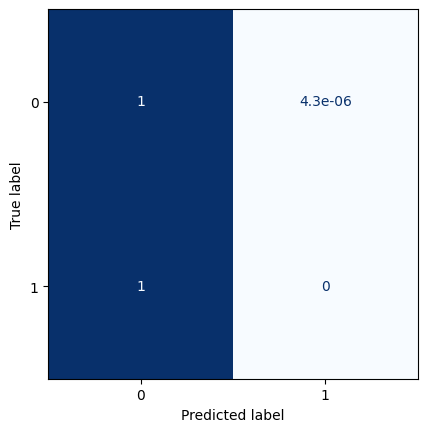

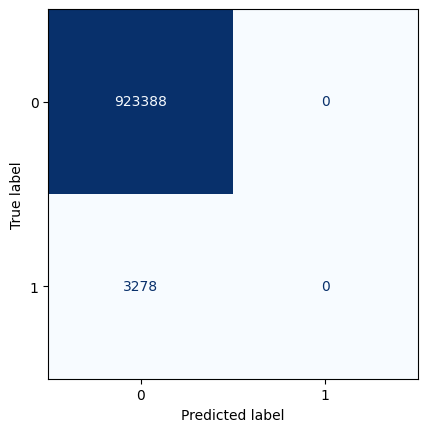

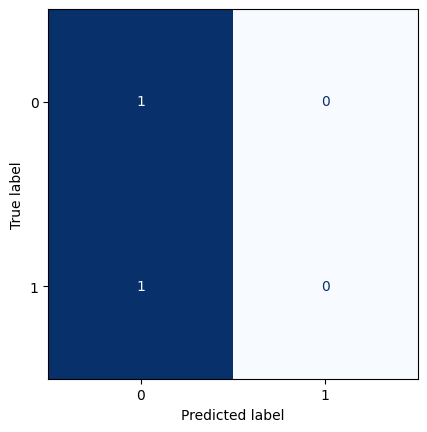

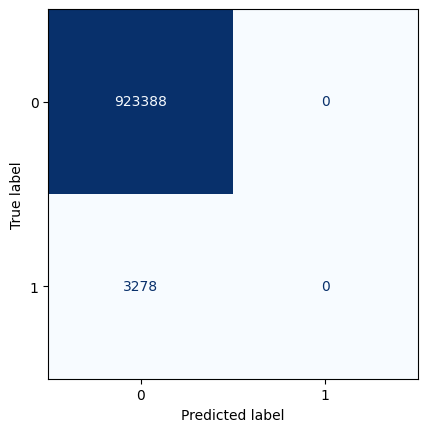

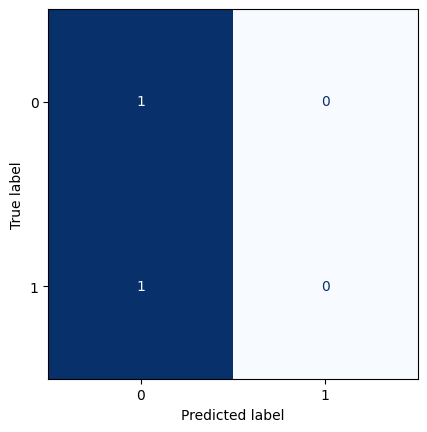

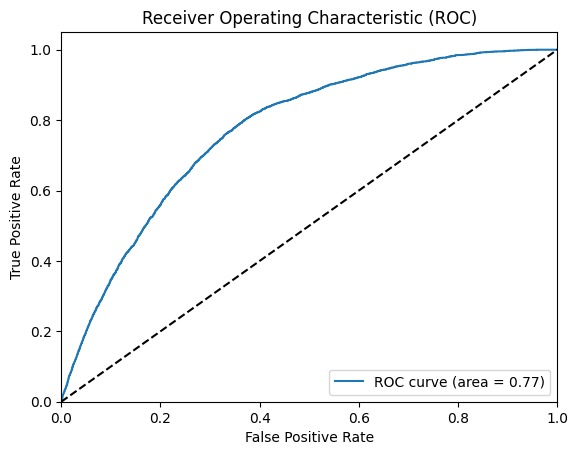

All zeros Brier score: 0.0035374126168436094
Model Brier score: 0.0035125776562193816
Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_22 (Dense)            (None, 512)               5120      
                                                                 
 dropout_11 (Dropout)        (None, 512)               0         
                                                                 
 dense_23 (Dense)            (None, 1)                 513       
                                                                 
Total params: 5,633
Trainable params: 5,633
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50


2023-06-08 09:21:13.843483: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8331/8331 [==============================] - ETA: 0s - loss: 0.0267

2023-06-08 09:21:48.674604: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8331/8331 [==============================] - 38s 4ms/step - loss: 0.0267 - val_loss: 0.0228
Epoch 2/50
8331/8331 [==============================] - 48s 6ms/step - loss: 0.0249 - val_loss: 0.0226
Epoch 3/50
8331/8331 [==============================] - 40s 5ms/step - loss: 0.0249 - val_loss: 0.0226
Epoch 4/50
8331/8331 [==============================] - 48s 6ms/step - loss: 0.0147 - val_loss: 0.0227
Epoch 5/50
8331/8331 [==============================] - 38s 5ms/step - loss: 0.0247 - val_loss: 0.0225
Epoch 6/50
8331/8331 [==============================] - 46s 6ms/step - loss: 0.0247 - val_loss: 0.0227
Epoch 7/50
8331/8331 [==============================] - 46s 6ms/step - loss: 0.0247 - val_loss: 0.0225
Epoch 8/50
8331/8331 [==============================] - 38s 5ms/step - loss: 0.0247 - val_loss: 0.0226
Epoch 9/50
8331/8331 [==============================] - 39s 5ms/step - loss: 0.0247 - val_loss: 0.0227
Epoch 10/50
8331/8331 [==============================] - 40s 5ms/step - loss: 0.0246

2023-06-08 09:29:33.533556: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


28947/28947 [==============================] - 48s 2ms/step


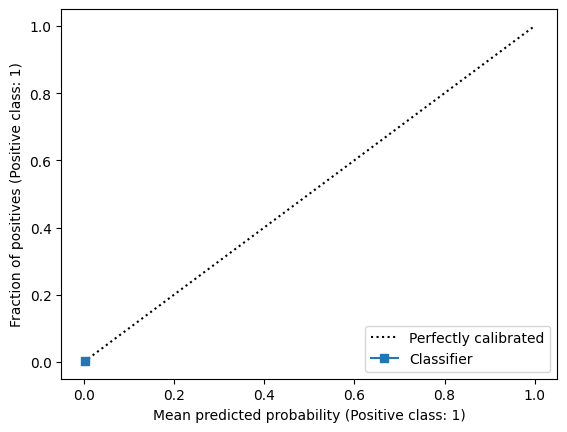

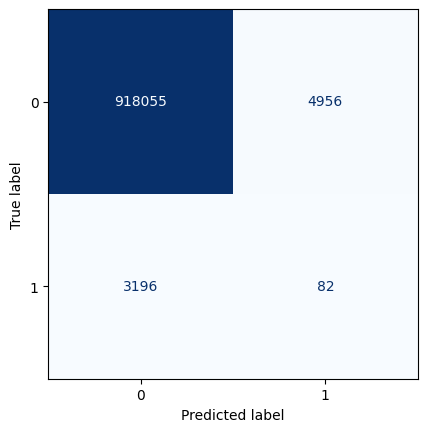

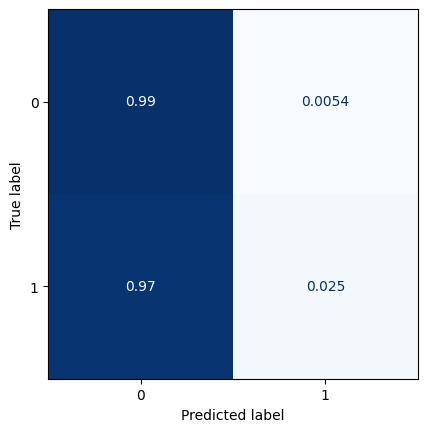

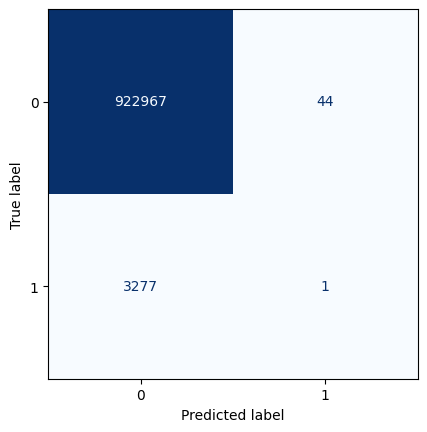

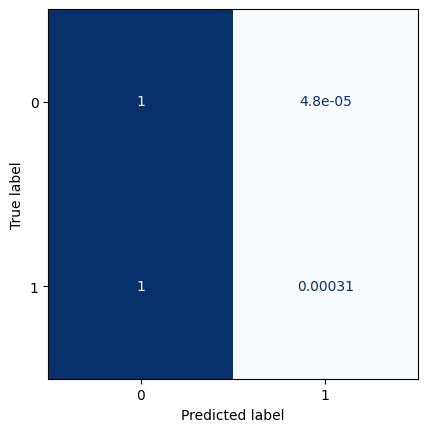

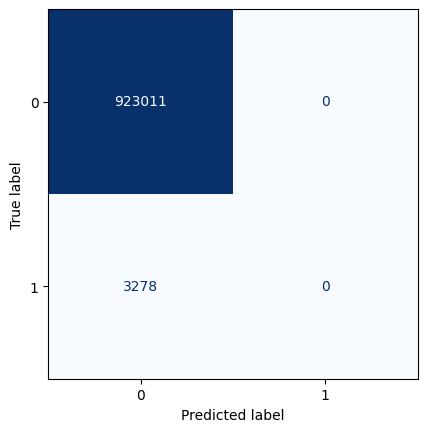

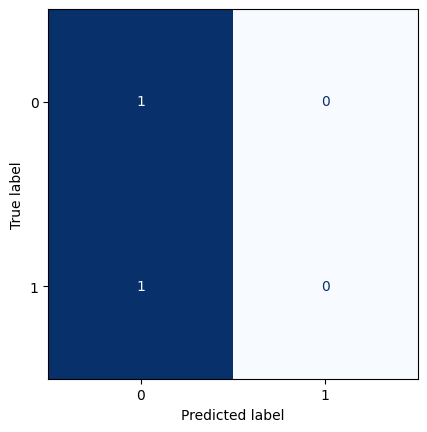

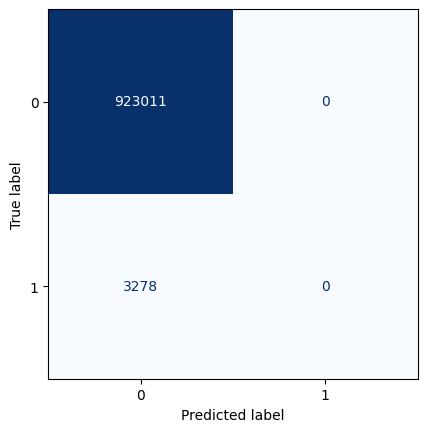

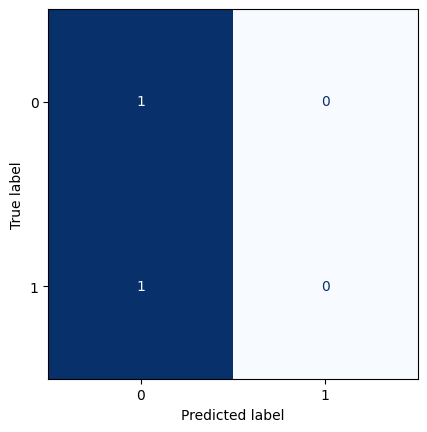

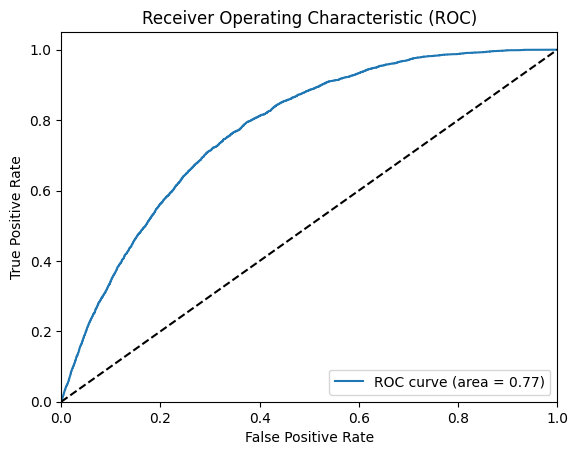

All zeros Brier score: 0.003538852345218393
Model Brier score: 0.00351441920772795
Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_24 (Dense)            (None, 512)               5120      
                                                                 
 dropout_12 (Dropout)        (None, 512)               0         
                                                                 
 dense_25 (Dense)            (None, 1)                 513       
                                                                 
Total params: 5,633
Trainable params: 5,633
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50


2023-06-08 09:31:18.898480: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8331/8331 [==============================] - ETA: 0s - loss: 0.0265

2023-06-08 09:31:57.629731: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8331/8331 [==============================] - 43s 5ms/step - loss: 0.0265 - val_loss: 0.0227
Epoch 2/50
8331/8331 [==============================] - 38s 5ms/step - loss: 0.0248 - val_loss: 0.0230
Epoch 3/50
8331/8331 [==============================] - 39s 5ms/step - loss: 0.0248 - val_loss: 0.0229
Epoch 4/50
8331/8331 [==============================] - 58s 7ms/step - loss: 0.0247 - val_loss: 0.0230
Epoch 5/50
8331/8331 [==============================] - 41s 5ms/step - loss: 0.0247 - val_loss: 0.0228
Epoch 6/50
8331/8331 [==============================] - 40s 5ms/step - loss: 0.0247 - val_loss: 0.0228
Epoch 6: early stopping
   30/28935 [..............................] - ETA: 1:46 

2023-06-08 09:35:37.394382: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


28935/28935 [==============================] - 49s 2ms/step


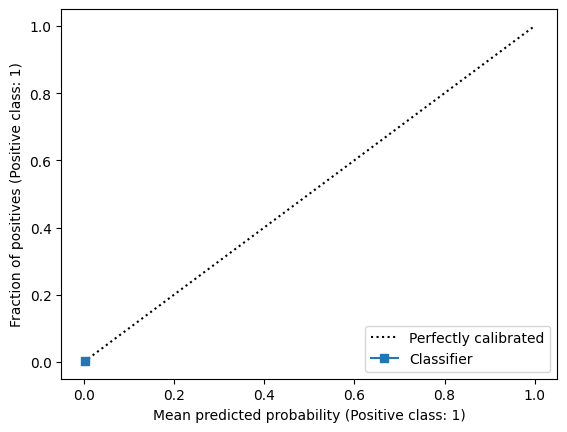

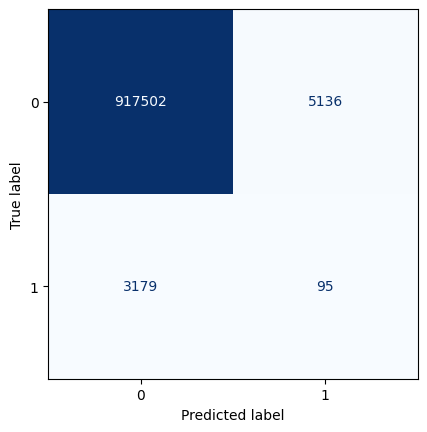

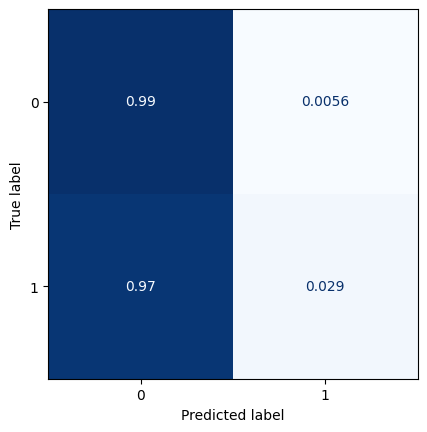

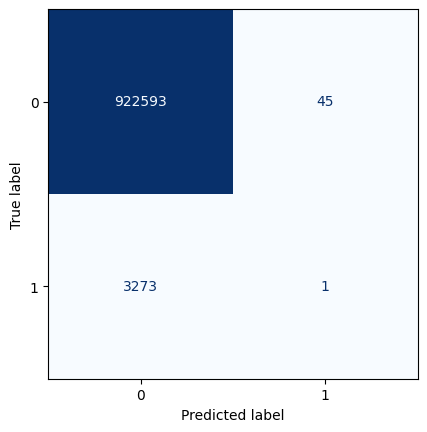

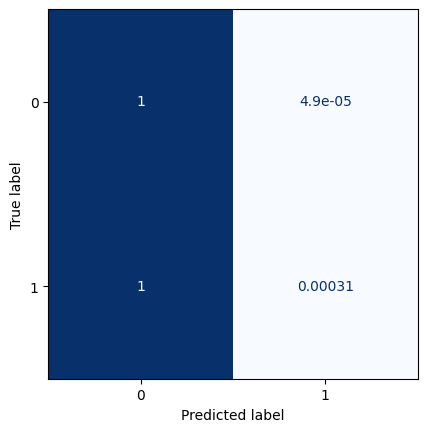

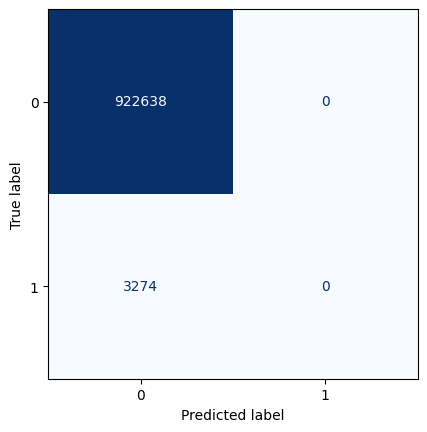

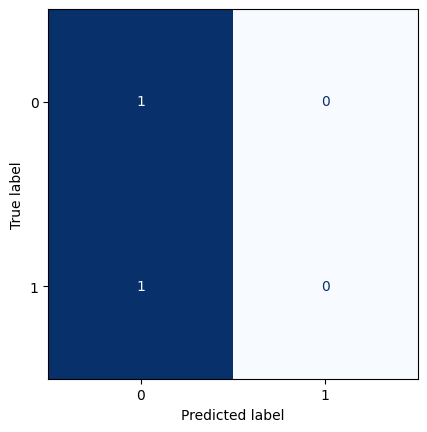

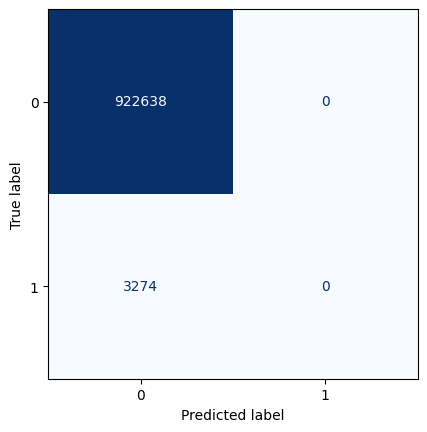

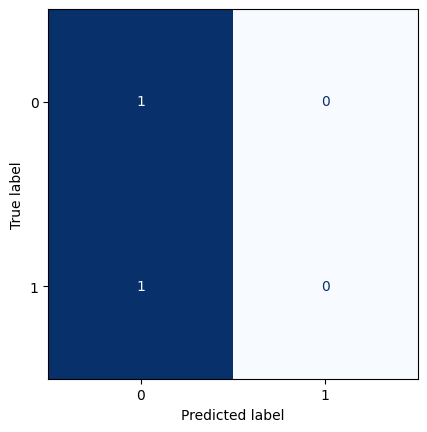

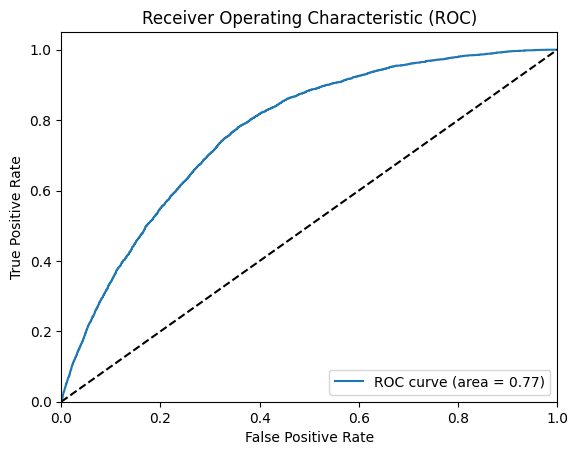

All zeros Brier score: 0.0035359731810366427
Model Brier score: 0.003512071950041364
Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_26 (Dense)            (None, 512)               5120      
                                                                 
 dropout_13 (Dropout)        (None, 512)               0         
                                                                 
 dense_27 (Dense)            (None, 1)                 513       
                                                                 
Total params: 5,633
Trainable params: 5,633
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50


2023-06-08 09:37:19.717326: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8330/8330 [==============================] - ETA: 0s - loss: 0.0264

2023-06-08 09:38:03.143516: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8330/8330 [==============================] - 47s 5ms/step - loss: 0.0264 - val_loss: 0.0230
Epoch 2/50
8330/8330 [==============================] - 37s 4ms/step - loss: 0.0249 - val_loss: 0.0228
Epoch 3/50
8330/8330 [==============================] - 40s 5ms/step - loss: 0.0248 - val_loss: 0.0229
Epoch 4/50
8330/8330 [==============================] - 39s 5ms/step - loss: 0.0247 - val_loss: 0.0228
Epoch 5/50
4377/8330 [==============>...............] - ETA: 17s - loss: 0.0247

In [ ]:
for lag in [1,2,3,4,5,6,7,8,9,10,11,12,13]:
    ### Model summary
    model = Sequential()
    model.add(Dense(512, input_dim=9, activation='relu'))
    model.add(Dropout(0.5))
    model.add(Dense(1,activation='sigmoid')) # Output
    model.compile(loss='binary_crossentropy', optimizer='adam')
    
    monitor = EarlyStopping(monitor='val_loss', min_delta=1e-4, patience=5, 
            verbose=1, mode='auto', restore_best_weights=True)
    
    model.summary()
        
    ### Model training
    model.fit(x_train_scaled[:-lag*377], y_train[lag*377:], validation_data=(x_val_scaled[:-lag*377],y_val[lag*377:]),
        callbacks=[monitor],epochs=50,batch_size=512)
    
    ### Confusion matrices
    t = model.predict(x_test_scaled[:-lag*377])

    ranges = [0.025,0.05,0.075,0.1]
    
    for j in ranges:
        classes = []
        for i in t:
            if i<=j: classes.append(0)
            else: classes.append(1)
    
        ConfusionMatrixDisplay(confusion_matrix(y_test[lag*377:], classes)).plot(colorbar=False,cmap=plt.cm.Blues, values_format='d')
        ConfusionMatrixDisplay(confusion_matrix(y_test[lag*377:], classes, normalize='true')).plot(colorbar=False,cmap=plt.cm.Blues)
    
    ### ROC
    plot_roc(t,y_test[lag*377:])
    
    z = np.zeros((lag*377,1))
    tt = np.concatenate((t,z))
    test['predictions_lag'+str(lag)] = tt.reshape(-1,1)
    test.to_csv("test_with_newTarget_predictions_FFNN_noOversampling.csv")
    
    ### calibration
    display = CalibrationDisplay.from_predictions(y_test[lag*377:], t, n_bins=10)
    print(f'All zeros Brier score: {brier_score_loss(y_test[lag*377:], np.zeros(len(y_test[lag*377:])))}')
    print(f'Model Brier score: {brier_score_loss(y_test[lag*377:], t)}')


In [12]:
0.003084963076693116
0.003401307889657023
0.0034865596306971006
0.0035004545039076253
0.0035030848818807313
0.003509180119177706
0.003512815305200277
0.0035125776562193816
test = pd.read_csv("test_with_newTarget_predictions_FFNN_noOversampling.csv")


Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_4 (Dense)             (None, 512)               5120      
                                                                 
 dropout_2 (Dropout)         (None, 512)               0         
                                                                 
 dense_5 (Dense)             (None, 1)                 513       
                                                                 
Total params: 5,633
Trainable params: 5,633
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50


2023-06-08 13:32:35.729678: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8330/8330 [==============================] - ETA: 0s - loss: 0.0269

2023-06-08 13:33:17.916872: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8330/8330 [==============================] - 46s 5ms/step - loss: 0.0269 - val_loss: 0.0228
Epoch 2/50
8330/8330 [==============================] - 40s 5ms/step - loss: 0.0249 - val_loss: 0.0231
Epoch 3/50
8330/8330 [==============================] - 37s 4ms/step - loss: 0.0248 - val_loss: 0.0229
Epoch 4/50
8330/8330 [==============================] - 39s 5ms/step - loss: 0.0247 - val_loss: 0.0228
Epoch 5/50
8330/8330 [==============================] - 38s 5ms/step - loss: 0.0247 - val_loss: 0.0228
Epoch 6/50
8330/8330 [==============================] - 40s 5ms/step - loss: 0.0246 - val_loss: 0.0228
Epoch 6: early stopping
  134/28923 [..............................] - ETA: 32s

2023-06-08 13:36:35.510279: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


28923/28923 [==============================] - 34s 1ms/step


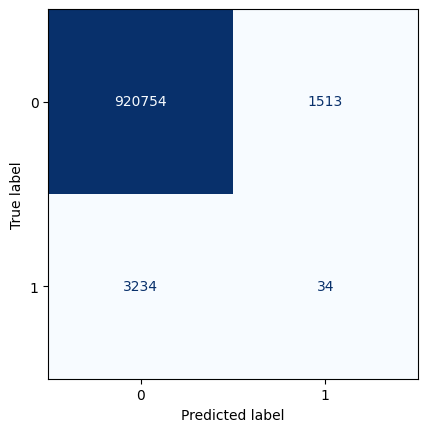

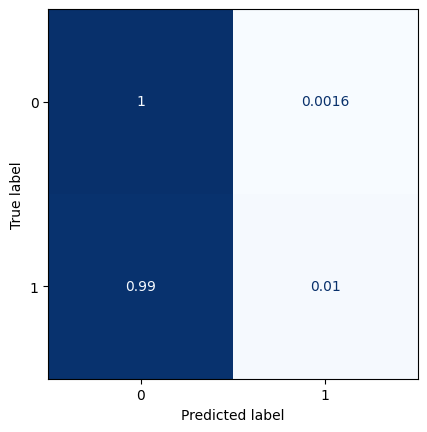

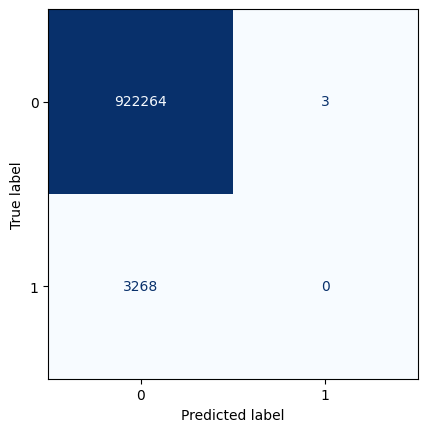

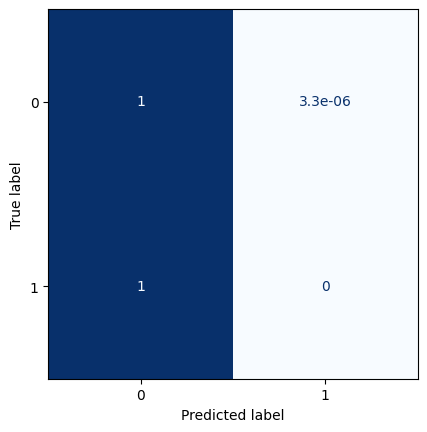

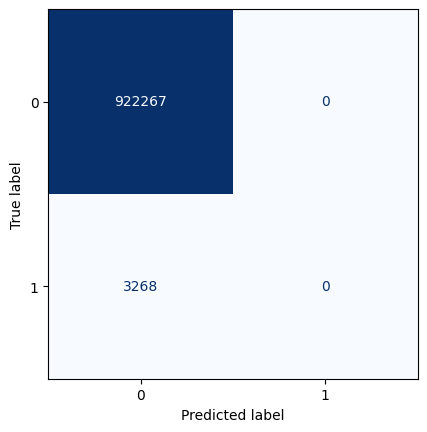

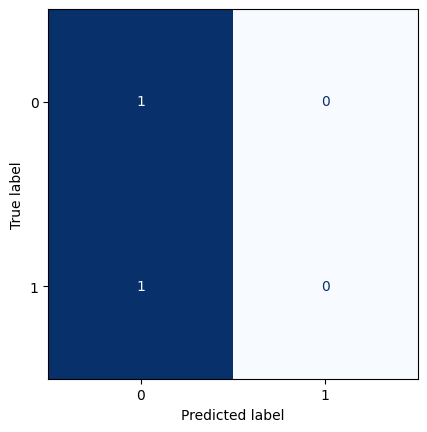

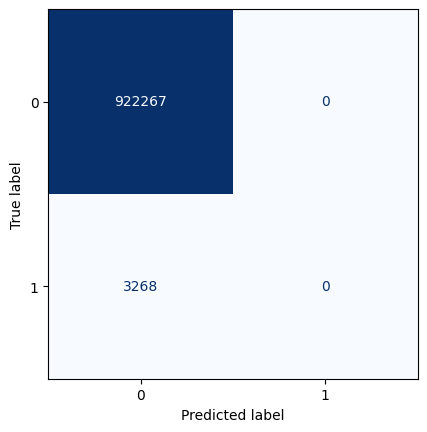

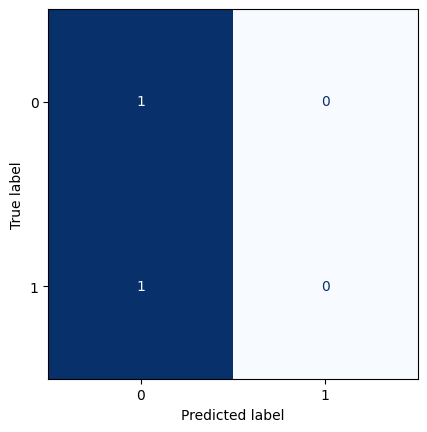

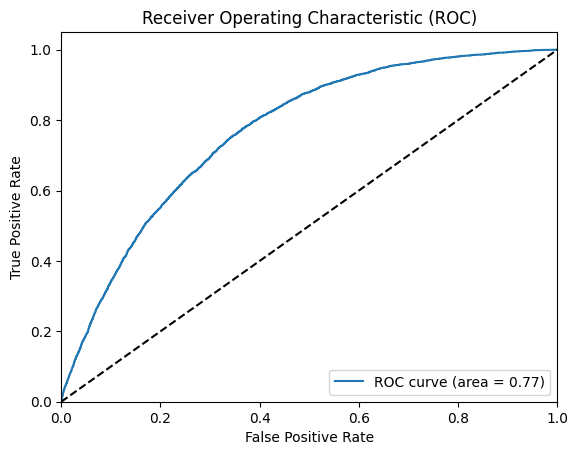

All zeros Brier score: 0.0035309307589664355
Model Brier score: 0.0035053351345202505
Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_6 (Dense)             (None, 512)               5120      
                                                                 
 dropout_3 (Dropout)         (None, 512)               0         
                                                                 
 dense_7 (Dense)             (None, 1)                 513       
                                                                 
Total params: 5,633
Trainable params: 5,633
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50


2023-06-08 13:37:36.675720: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8329/8329 [==============================] - ETA: 0s - loss: 0.0266

2023-06-08 13:38:10.994595: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8329/8329 [==============================] - 37s 4ms/step - loss: 0.0266 - val_loss: 0.0229
Epoch 2/50
8329/8329 [==============================] - 37s 4ms/step - loss: 0.0249 - val_loss: 0.0230
Epoch 3/50
8329/8329 [==============================] - 38s 5ms/step - loss: 0.0248 - val_loss: 0.0228
Epoch 4/50
8329/8329 [==============================] - 40s 5ms/step - loss: 0.0247 - val_loss: 0.0229
Epoch 5/50
8329/8329 [==============================] - 36s 4ms/step - loss: 0.0247 - val_loss: 0.0228
Epoch 6/50
8329/8329 [==============================] - 60s 7ms/step - loss: 0.0247 - val_loss: 0.0228
Epoch 7/50
8329/8329 [==============================] - 47s 6ms/step - loss: 0.0246 - val_loss: 0.0228
Epoch 8/50
8329/8329 [==============================] - 40s 5ms/step - loss: 0.0246 - val_loss: 0.0229
Epoch 8: early stopping
   74/28912 [..............................] - ETA: 40s   

2023-06-08 13:43:11.750247: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


28912/28912 [==============================] - 42s 1ms/step


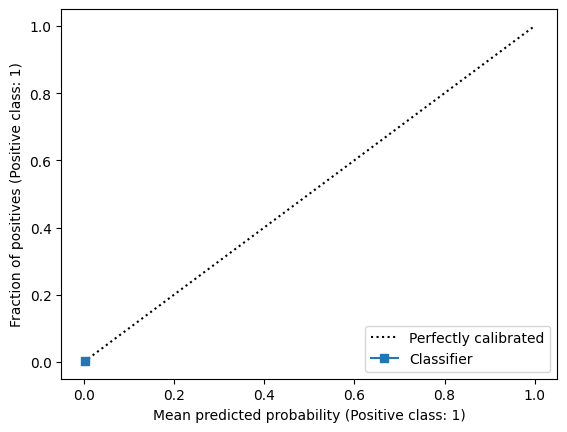

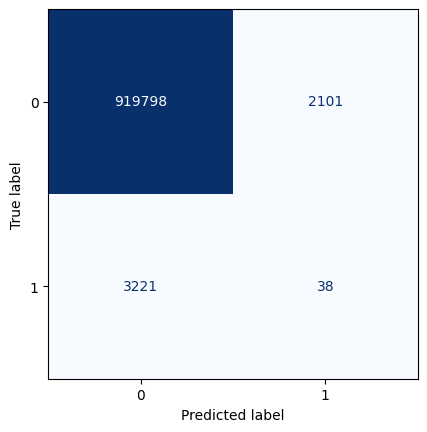

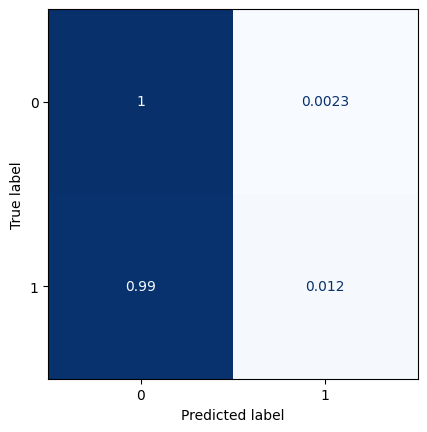

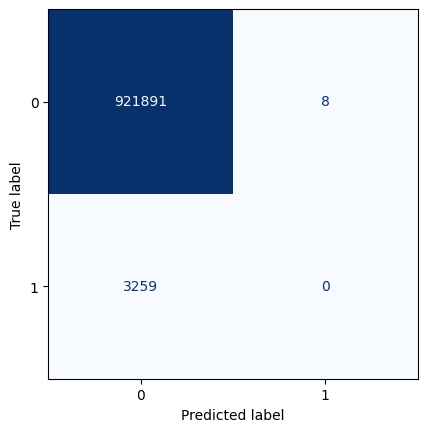

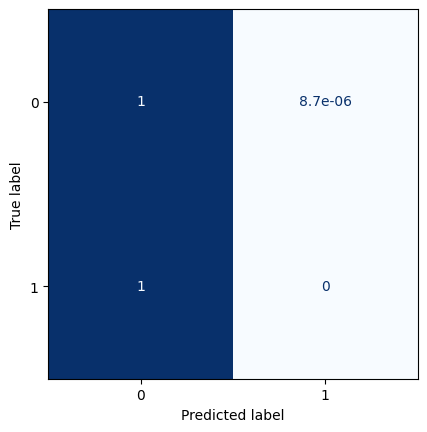

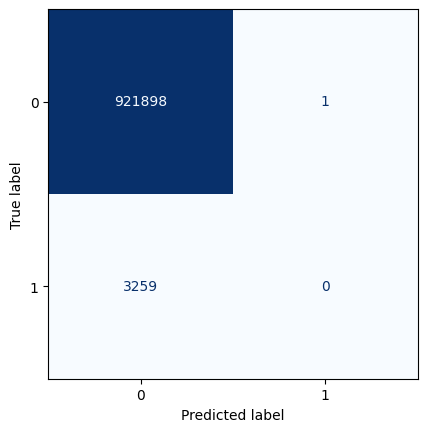

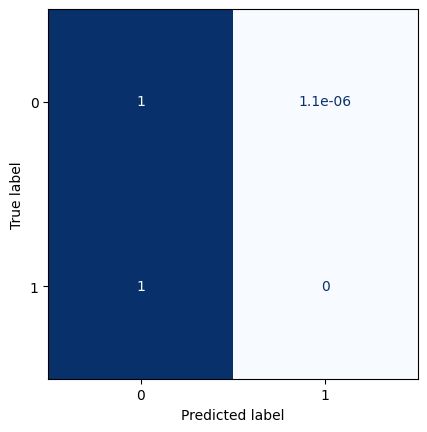

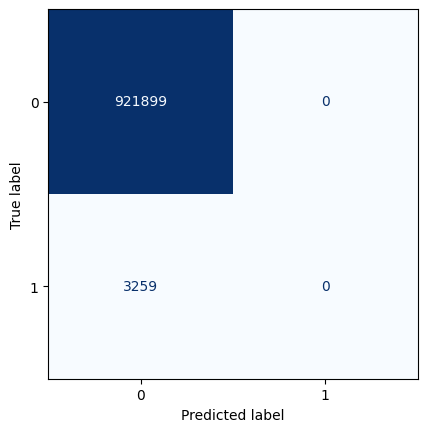

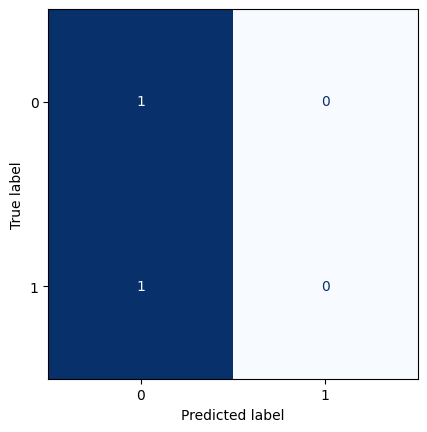

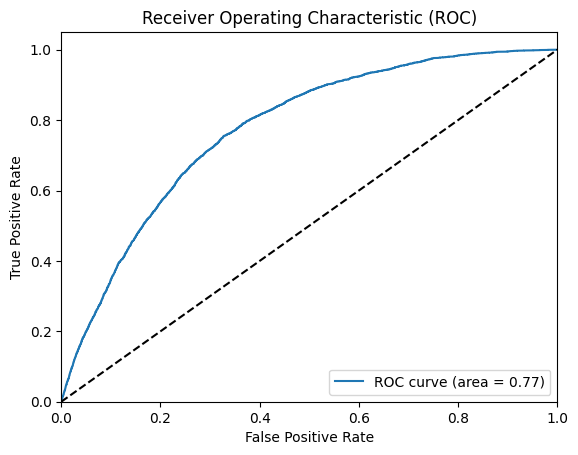

All zeros Brier score: 0.003522641537985944
Model Brier score: 0.0034970205325000757
Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_8 (Dense)             (None, 512)               5120      
                                                                 
 dropout_4 (Dropout)         (None, 512)               0         
                                                                 
 dense_9 (Dense)             (None, 1)                 513       
                                                                 
Total params: 5,633
Trainable params: 5,633
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50


2023-06-08 13:44:50.802837: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8328/8328 [==============================] - ETA: 0s - loss: 0.0263

2023-06-08 13:45:24.823207: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


8328/8328 [==============================] - 38s 4ms/step - loss: 0.0263 - val_loss: 0.0229
Epoch 2/50
8328/8328 [==============================] - 37s 4ms/step - loss: 0.0249 - val_loss: 0.0228
Epoch 3/50
8328/8328 [==============================] - 36s 4ms/step - loss: 0.0248 - val_loss: 0.0227
Epoch 4/50
8328/8328 [==============================] - 40s 5ms/step - loss: 0.0248 - val_loss: 0.0230
Epoch 5/50
8328/8328 [==============================] - 34s 4ms/step - loss: 0.0247 - val_loss: 0.0229
Epoch 6/50
8328/8328 [==============================] - 42s 5ms/step - loss: 0.0247 - val_loss: 0.0231
Epoch 7/50
8328/8328 [==============================] - 46s 6ms/step - loss: 0.0247 - val_loss: 0.0227
Epoch 8/50
8328/8328 [==============================] - 38s 5ms/step - loss: 0.0247 - val_loss: 0.0228
Epoch 8: early stopping


2023-06-08 13:50:02.271222: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


28900/28900 [==============================] - 37s 1ms/step


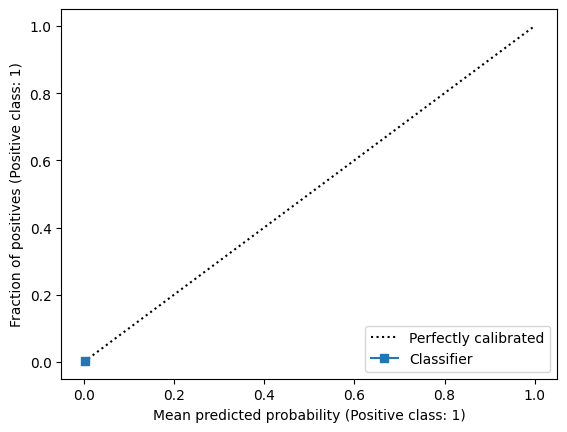

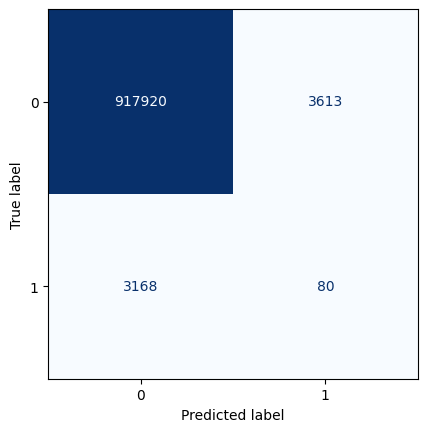

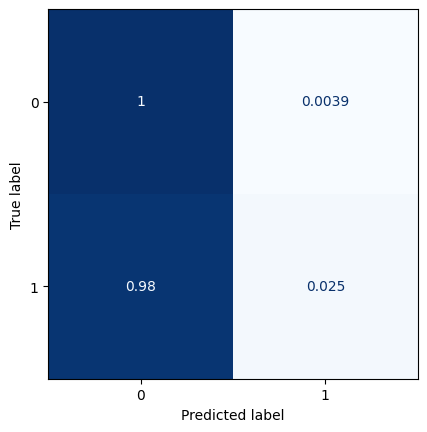

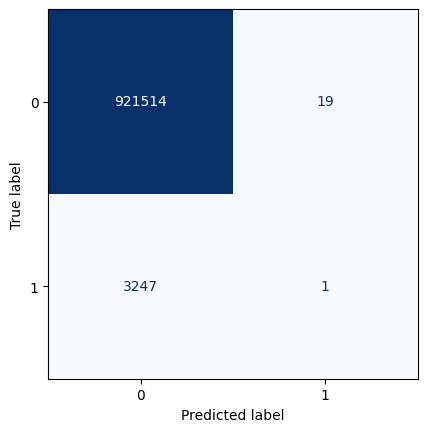

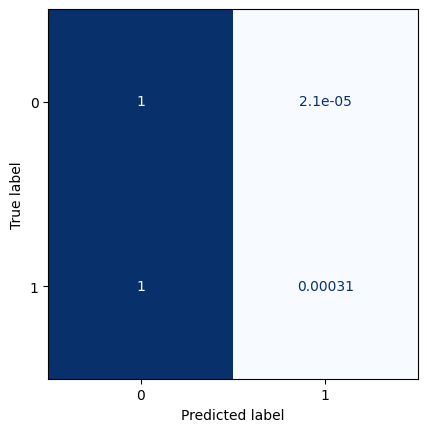

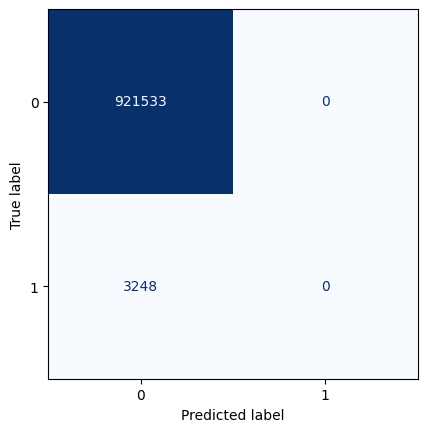

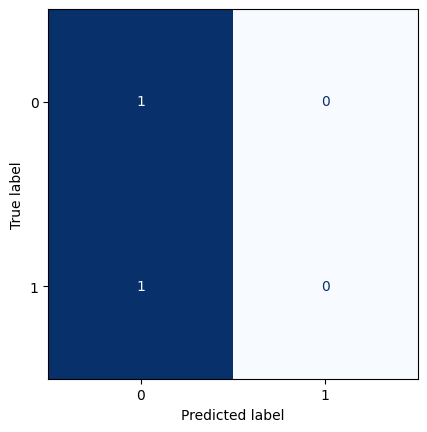

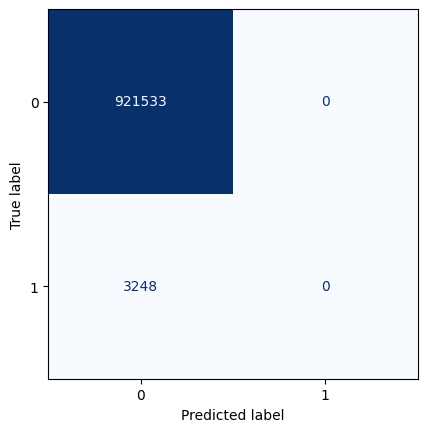

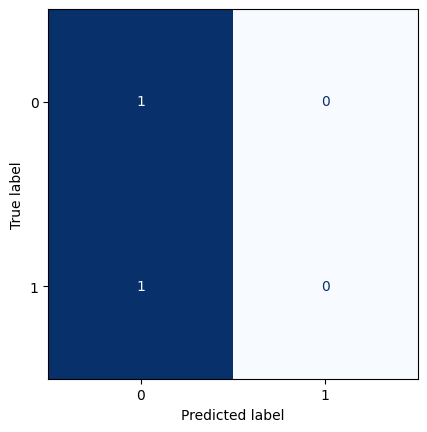

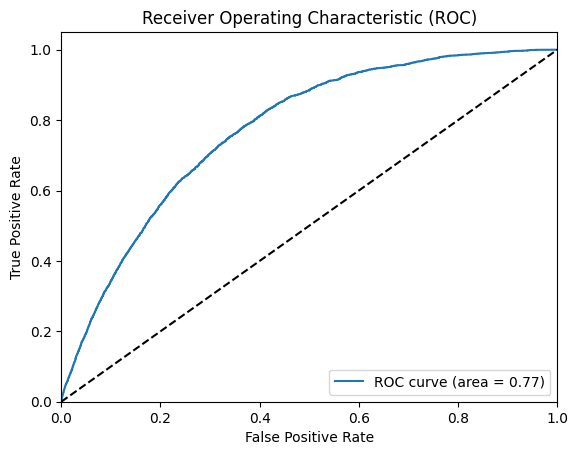

All zeros Brier score: 0.0035121828843801936
Model Brier score: 0.003487283508789587


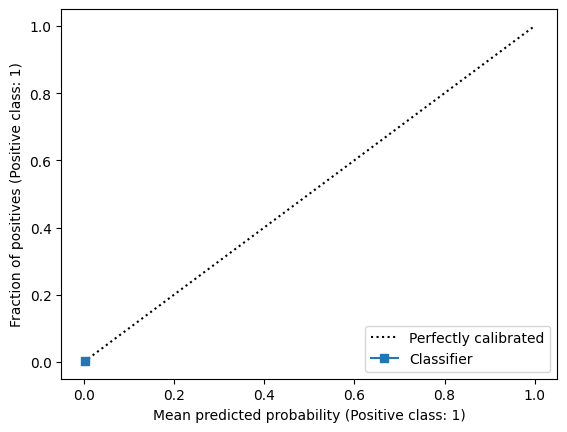

In [15]:
for lag in [11,12,13]:
    ### Model summary
    model = Sequential()
    model.add(Dense(512, input_dim=9, activation='relu'))
    model.add(Dropout(0.5))
    model.add(Dense(1,activation='sigmoid')) # Output
    model.compile(loss='binary_crossentropy', optimizer='adam')
    
    monitor = EarlyStopping(monitor='val_loss', min_delta=1e-4, patience=5, 
            verbose=1, mode='auto', restore_best_weights=True)
    
    model.summary()
        
    ### Model training
    model.fit(x_train_scaled[:-lag*377], y_train[lag*377:], validation_data=(x_val_scaled[:-lag*377],y_val[lag*377:]),
        callbacks=[monitor],epochs=50,batch_size=512)
    
    ### Confusion matrices
    t = model.predict(x_test_scaled[:-lag*377])

    ranges = [0.025,0.05,0.075,0.1]
    
    for j in ranges:
        classes = []
        for i in t:
            if i<=j: classes.append(0)
            else: classes.append(1)
    
        ConfusionMatrixDisplay(confusion_matrix(y_test[lag*377:], classes)).plot(colorbar=False,cmap=plt.cm.Blues, values_format='d')
        ConfusionMatrixDisplay(confusion_matrix(y_test[lag*377:], classes, normalize='true')).plot(colorbar=False,cmap=plt.cm.Blues)
    
    ### ROC
    plot_roc(t,y_test[lag*377:])
    
    z = np.zeros((lag*377,1))
    tt = np.concatenate((t,z))
    test['predictions_lag'+str(lag)] = tt.reshape(-1,1)
    test.to_csv("test_with_newTarget_predictions_FFNN_noOversampling.csv")
    
    ### calibration
    display = CalibrationDisplay.from_predictions(y_test[lag*377:], t, n_bins=10)
    print(f'All zeros Brier score: {brier_score_loss(y_test[lag*377:], np.zeros(len(y_test[lag*377:])))}')
    print(f'Model Brier score: {brier_score_loss(y_test[lag*377:], t)}')


# FFNN Brier scores

### Original features: u,v,r,vo,ttr,sst,shear

In [8]:
res = pd.read_csv('/Users/paolo/Documents/TC_old/new_results/test_with_newTarget_predictions_FFNN_noOversampling.csv')

score = np.average((res.new_target/100 - np.zeros(res.shape[0])) ** 2)
print(f'Brier score, all zeros: {score}\n')
for lag in range(14):
    if lag == 0:
        score = np.average((res.new_target/100 - res.predictions_lag0) ** 2)
    else:
        col = 'predictions_lag'+str(lag)
        score = np.average((res.new_target[377*lag:].values/100 - res[:-377*lag].loc[:,col].values)**2)
    
    print(f'Brier score, lag {lag}: {score}\n')
    print(f'Brier skill score, lag {lag}: {(0.0028244908639929586-score)/0.0028244908639929586}\n')
    

Brier score, all zeros: 0.0028828128596659927

Brier score, lag 0: 0.002056209614098629

Brier skill score, lag 0: 0.27200698706039256

Brier score, lag 1: 0.0024775223783742675

Brier skill score, lag 1: 0.12284284224172874

Brier score, lag 2: 0.002749504181984444

Brier skill score, lag 2: 0.02654874298389718

Brier score, lag 3: 0.0028380046035773546

Brier skill score, lag 3: -0.00478448691644617

Brier score, lag 4: 0.002853144425715736

Brier skill score, lag 4: -0.010144682033869265

Brier score, lag 5: 0.0028561447745597446

Brier skill score, lag 5: -0.011206943867411612

Brier score, lag 6: 0.0028629684088699097

Brier skill score, lag 6: -0.013622825043433059

Brier score, lag 7: 0.002866163880990633

Brier skill score, lag 7: -0.014754169513850588

Brier score, lag 8: 0.0028654849447800543

Brier skill score, lag 8: -0.01451379479030876

Brier score, lag 9: 0.002867212413704784

Brier skill score, lag 9: -0.015125398441342577

Brier score, lag 10: 0.0028650679491332297

Br

### TTR replaced by TCWV

In [4]:
res = pd.read_csv('/Users/paolo/Documents/TC/Paolo/scripts/FFNN_dailymean2.csv')
dummy = pd.read_csv('/Users/paolo/Documents/TC_predictions/test_with_newTarget_predictions_FFNN_noOversampling.csv')
res['new_target'] = dummy['new_target']
score = np.average((res.new_target/100 - np.zeros(res.shape[0])) ** 2)
print(f'Brier score, all zeros: {score}\n')
for lag in range(14):
    if lag == 0:
        score = np.average((res.new_target/100 - res.predictions_lag0) ** 2)
    else:
        col = 'predictions_lag'+str(lag)
        score = np.average((res.new_target[377*lag:].values/100 - res[:-377*lag].loc[:,col].values)**2)
    
    print(f'Brier score, lag {lag}: {score}\n')
    print(f'Brier skill score, lag {lag}: {(0.0028244908639929586-score)/0.0028244908639929586}\n')
    

Brier score, all zeros: 0.0028828128596659927

Brier score, lag 0: 0.0019460435314626065

Brier skill score, lag 0: 0.3110108599496401



KeyError: 'predictions_lag1'

### UTC 00 

In [10]:
res = pd.read_csv('/Users/paolo/Documents/TC/Paolo/scripts/FFNN_utc00.csv')
dummy = pd.read_csv('/Users/paolo/Documents/TC_old/new_results/test_with_newTarget_predictions_FFNN_noOversampling.csv')
res['new_target'] = dummy['new_target']
score = np.average((res.new_target/100 - np.zeros(res.shape[0])) ** 2)
print(f'Brier score, all zeros: {score}\n')
for lag in range(14):
    if lag == 0:
        score = np.average((res.new_target/100 - res.predictions_lag0) ** 2)
    else:
        col = 'predictions_lag'+str(lag)
        score = np.average((res.new_target[377*lag:].values/100 - res[:-377*lag].loc[:,col].values)**2)
    
    print(f'Brier score, lag {lag}: {score}\n')
    print(f'Brier skill score, lag {lag}: {(0.0028244908639929586-score)/0.0028244908639929586}\n')
    

Brier score, all zeros: 0.0028828128596659927

Brier score, lag 0: 0.00217283010600395

Brier skill score, lag 0: 0.23071795568414805

Brier score, lag 1: 0.002668721791381287

Brier skill score, lag 1: 0.055149434044003985

Brier score, lag 2: 0.002821180797955221

Brier skill score, lag 2: 0.0011719160008392536

Brier score, lag 3: 0.0028426518695893817

Brier skill score, lag 3: -0.006429833364994161

Brier score, lag 4: 0.0028507935994086494

Brier skill score, lag 4: -0.009312381127162442

Brier score, lag 5: 0.002852361670912356

Brier skill score, lag 5: -0.009867550741515452

Brier score, lag 6: 0.0028572539558243387

Brier skill score, lag 6: -0.011599645178197943

Brier score, lag 7: 0.0028577109348731362

Brier skill score, lag 7: -0.01176143683227026

Brier score, lag 8: 0.002866658802791073

Brier skill score, lag 8: -0.01492939465150259

Brier score, lag 9: 0.0028617932559649685

Brier skill score, lag 9: -0.013206766730084517

Brier score, lag 10: 0.002861858005716807

B

### Adding lat-lon to daily averages

In [5]:
res = pd.read_csv('/Users/paolo/Documents/TC/Paolo/scripts/FFNN_dailymean2_latlon.csv')
dummy = pd.read_csv('/Users/paolo/Documents/TC_predictions/test_with_newTarget_predictions_FFNN_noOversampling.csv')
res['new_target'] = dummy['new_target']
score = np.average((res.new_target/100 - np.zeros(res.shape[0])) ** 2)
print(f'Brier score, all zeros: {score}\n')
for lag in range(14):
    if lag == 0:
        score = np.average((res.new_target/100 - res.predictions_lag0) ** 2)
    else:
        col = 'predictions_lag'+str(lag)
        score = np.average((res.new_target[377*lag:].values/100 - res[:-377*lag].loc[:,col].values)**2)
    
    print(f'Brier score, lag {lag}: {score}\n')
    print(f'Brier skill score, lag {lag}: {(0.0028244908639929586-score)/0.0028244908639929586}\n')
    

Brier score, all zeros: 0.0028828128596659927

Brier score, lag 0: 0.001796490576777741

Brier skill score, lag 0: 0.3639595016292396



KeyError: 'predictions_lag1'

### Adding lat-lon-year-daymonth to daily averages

In [101]:
res = pd.read_csv('/Users/paolo/Documents/TC/Paolo/scripts/FFNN_dailymean2_latlon_time.csv')
dummy = pd.read_csv('/Users/paolo/Documents/TC_old/new_results/test_with_newTarget_predictions_FFNN_noOversampling.csv')
res['new_target'] = dummy['new_target']
score = np.average((res.new_target/100 - np.zeros(res.shape[0])) ** 2)
print(f'Brier score, all zeros: {score}\n')
for lag in range(14):
    if lag == 0:
        score = np.average((res.new_target/100 - res.predictions_lag0) ** 2)
    else:
        col = 'predictions_lag'+str(lag)
        score = np.average((res.new_target[377*lag:].values/100 - res[:-377*lag].loc[:,col].values)**2)
    
    print(f'Brier score, lag {lag}: {score}\n')
    print(f'Brier skill score, lag {lag}: {(0.0028244908639929586-score)/0.0028244908639929586}\n')


Brier score, all zeros: 0.0028828128596659927

Brier score, lag 0: 0.0018993445247442917

Brier skill score, lag 0: 0.3275444615674187

Brier score, lag 1: 0.0024232801033450104

Brier skill score, lag 1: 0.1420471086533309

Brier score, lag 2: 0.0027217232774257184

Brier skill score, lag 2: 0.03638446414443648

Brier score, lag 3: 0.0028020620829565155

Brier skill score, lag 3: 0.007940822653161542

Brier score, lag 4: 0.0028284025598214343

Brier skill score, lag 4: -0.0013849206872440516

Brier score, lag 5: 0.0028246481791598696

Brier skill score, lag 5: -5.569682271466033e-05

Brier score, lag 6: 0.002831348643320853

Brier skill score, lag 6: -0.002427970086686646

Brier score, lag 7: 0.0028339495253295196

Brier skill score, lag 7: -0.0033488022415442886

Brier score, lag 8: 0.002835827675751699

Brier skill score, lag 8: -0.004013754090432277

Brier score, lag 9: 0.0028473295907922125

Brier skill score, lag 9: -0.008085962355341793

Brier score, lag 10: 0.002840122778471176

### Adding features of two days before to daily averages

In [111]:
res = pd.read_csv('/Users/paolo/Documents/TC/Paolo/scripts/FFNN_dailymean2_target2before.csv')
dummy = pd.read_csv('/Users/paolo/Documents/TC_old/new_results/test_with_newTarget_predictions_FFNN_noOversampling.csv')
res['new_target'] = dummy['new_target']
score = np.average((res.new_target/100 - np.zeros(res.shape[0])) ** 2)
print(f'Brier score, all zeros: {score}\n')
for lag in range(14):
    if lag == 0:
        score = np.average((res.new_target/100 - res.predictions_lag0) ** 2)
    else:
        col = 'predictions_lag'+str(lag)
        score = np.average((res.new_target[377*lag:].values/100 - res[:-377*lag].loc[:,col].values)**2)
    
    print(f'Brier score, lag {lag}: {score}\n')
    print(f'Brier skill score, lag {lag}: {(0.0028244908639929586-score)/0.0028244908639929586}\n')


Brier score, all zeros: 0.0028828128596659927

Brier score, lag 0: 0.001743597886087984

Brier skill score, lag 0: 0.38268595295681906

Brier score, lag 1: 0.002456201006415295

Brier skill score, lag 1: 0.1303915910200593

Brier score, lag 2: 0.0027601174228911196

Brier skill score, lag 2: 0.022791166338146637

Brier score, lag 3: 0.002835485787270804

Brier skill score, lag 3: -0.003892709804096193

Brier score, lag 4: 0.0028461489736420573

Brier skill score, lag 4: -0.00766796944723725

Brier score, lag 5: 0.002849265010447288

Brier skill score, lag 5: -0.008771190153295997

Brier score, lag 6: 0.00285131721193712

Brier skill score, lag 6: -0.00949776410543504

Brier score, lag 7: 0.0028572608816751213

Brier skill score, lag 7: -0.011602097248718307

Brier score, lag 8: 0.0028593024822816896

Brier skill score, lag 8: -0.012324917999387024

Brier score, lag 9: 0.0028624833114155434

Brier skill score, lag 9: -0.013451078177280846

Brier score, lag 10: 0.0028595718722590185

Bri

KeyError: 'predictions_lag11'

### Adding features of two days before to daily averages and lat-lon

In [5]:
res = pd.read_csv('/Users/paolo/Documents/TC/Paolo/scripts/FFNN_dailymean2_latlon_target2before.csv')
dummy = pd.read_csv('/Users/paolo/Documents/TC_old/new_results/test_with_newTarget_predictions_FFNN_noOversampling.csv')
res['new_target'] = dummy['new_target']
score = np.average((res.new_target/100 - np.zeros(res.shape[0])) ** 2)
print(f'Brier score, all zeros: {score}\n')
for lag in range(14):
    if lag == 0:
        score = np.average((res.new_target/100 - res.predictions_lag0) ** 2)
    else:
        col = 'predictions_lag'+str(lag)
        score = np.average((res.new_target[377*lag:].values/100 - res[:-377*lag].loc[:,col].values)**2)
    
    print(f'Brier score, lag {lag}: {score}\n')
    print(f'Brier skill score, lag {lag}: {(0.0028244908639929586-score)/0.0028244908639929586}\n')


Brier score, all zeros: 0.0028828128596659927

Brier score, lag 0: 0.00167962927324397

Brier skill score, lag 0: 0.4053337914255129

Brier score, lag 1: 0.0023536273914158325

Brier skill score, lag 1: 0.16670738028568816

Brier score, lag 2: 0.0026804054493230573

Brier skill score, lag 2: 0.05101288041208564

Brier score, lag 3: 0.002786944196718808

Brier skill score, lag 3: 0.013293251450306095

Brier score, lag 4: 0.0028185233450148043

Brier skill score, lag 4: 0.0021127768739595105

Brier score, lag 5: 0.002821887988264571

Brier skill score, lag 5: 0.0009215380235672395

Brier score, lag 6: 0.0028274998868002147

Brier skill score, lag 6: -0.0010653328164787375

Brier score, lag 7: 0.0028328264377508973

Brier skill score, lag 7: -0.0029511774543872094

Brier score, lag 8: 0.0028369352457482213

Brier skill score, lag 8: -0.004405884938027455

Brier score, lag 9: 0.0028376584423235895

Brier skill score, lag 9: -0.004661929871501165

Brier score, lag 10: 0.0028429794139161637


In [19]:
model_std_relu_dropout = Sequential()
model_std_relu_dropout.add(Dense(512, input_dim=12, activation='relu'))
model_std_relu_dropout.add(Dropout(0.5))
model_std_relu_dropout.add(Dense(1,activation='sigmoid')) # Output
model_std_relu_dropout.compile(loss='binary_crossentropy', optimizer='adam')

monitor = EarlyStopping(monitor='val_loss', min_delta=1e-5, patience=10, 
        verbose=1, mode='auto', restore_best_weights=True)

model_std_relu_dropout.summary()


Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_8 (Dense)             (None, 512)               6656      
                                                                 
 dropout_4 (Dropout)         (None, 512)               0         
                                                                 
 dense_9 (Dense)             (None, 1)                 513       
                                                                 
Total params: 7,169
Trainable params: 7,169
Non-trainable params: 0
_________________________________________________________________


# Others

### Full test evaluation

68/78 [=========================>....] - ETA: 0s

2023-03-28 10:58:49.465689: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


78/78 [==============================] - 0s 2ms/step


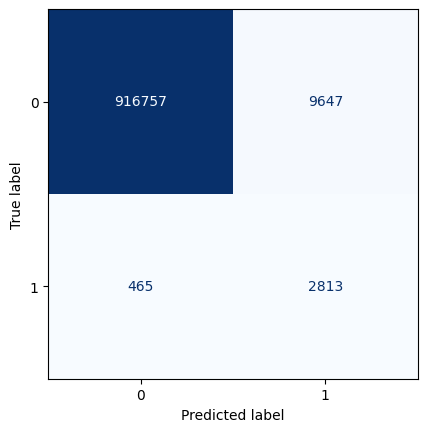

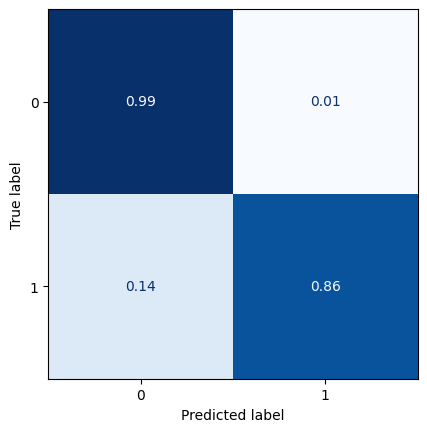

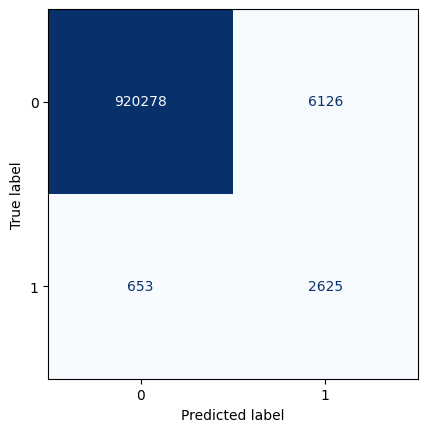

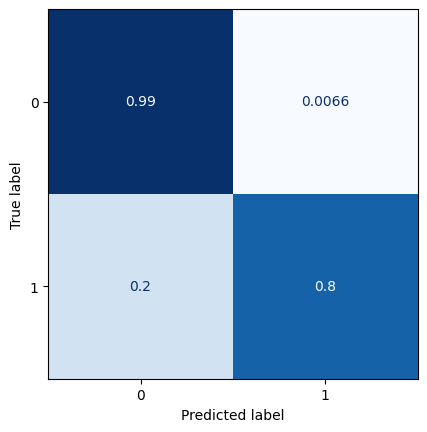

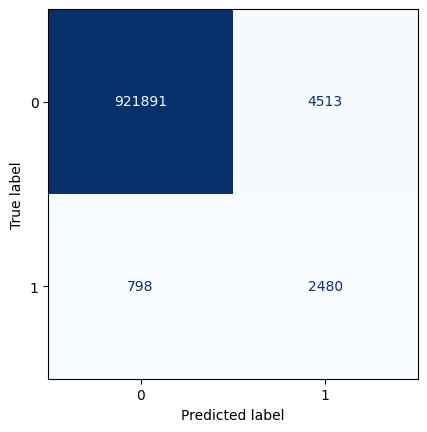

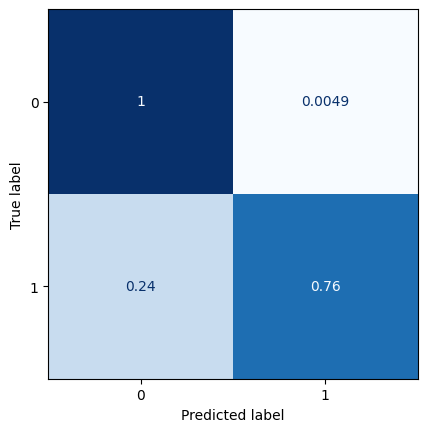

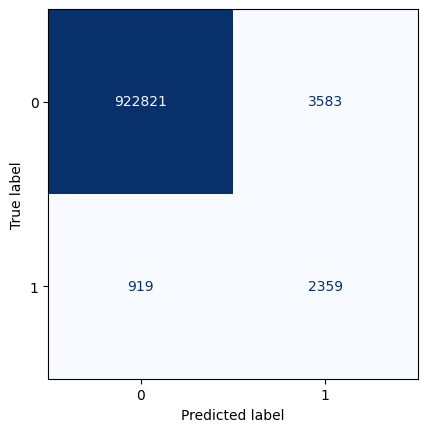

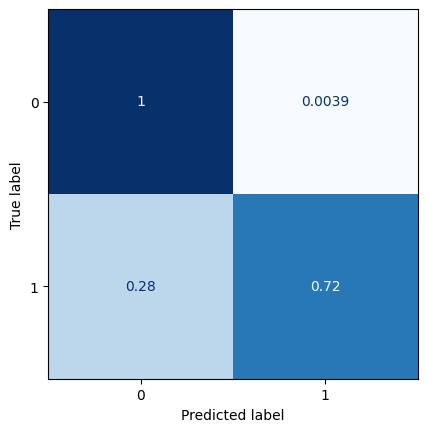

In [16]:
t = model.predict(test_img_std)

ranges = [0.025,0.05,0.075,0.1]

for j in ranges:
    classes = []
    for i in t.reshape(-1,1):
        if i<=j: classes.append(0)
        else: classes.append(1)

# confusion matrix with threshold on 0.1, otherwise always 0 
    ConfusionMatrixDisplay(confusion_matrix(y_test_img.reshape(-1,1), classes)).plot(colorbar=False,cmap=plt.cm.Blues, values_format='d')
    ConfusionMatrixDisplay(confusion_matrix(y_test_img.reshape(-1,1), classes, normalize='true')).plot(colorbar=False,cmap=plt.cm.Blues)
    

In [7]:
922821+3583+919+2359

929682

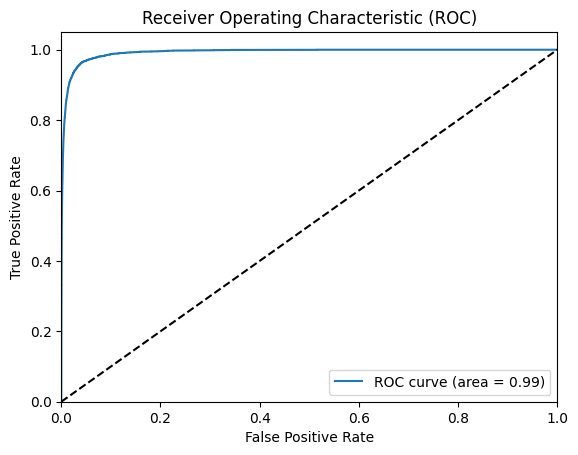

In [17]:
plot_roc(t.reshape(-1,1),y_test_img.reshape(-1,1))

9


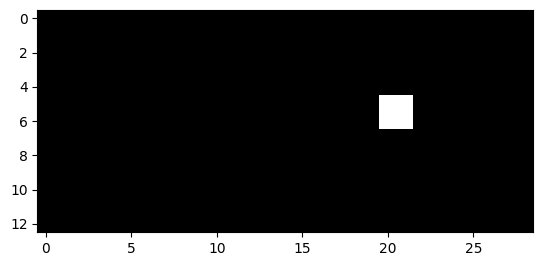

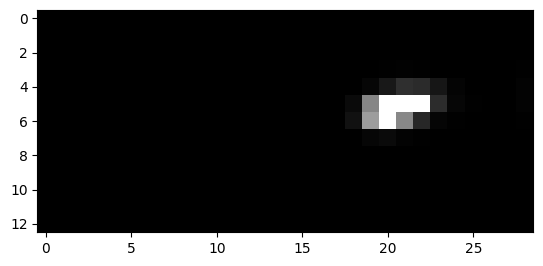

10


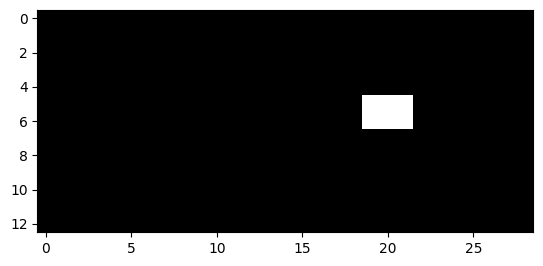

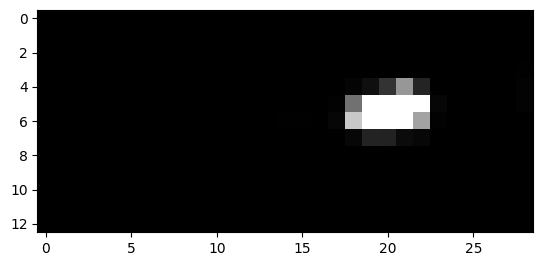

11


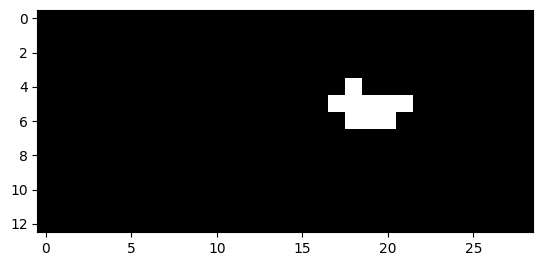

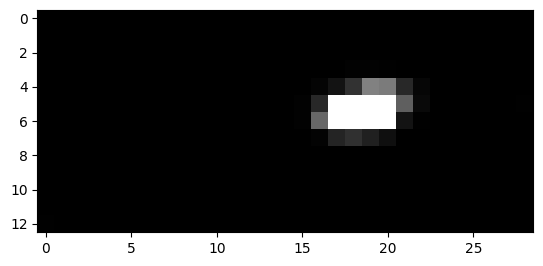

12


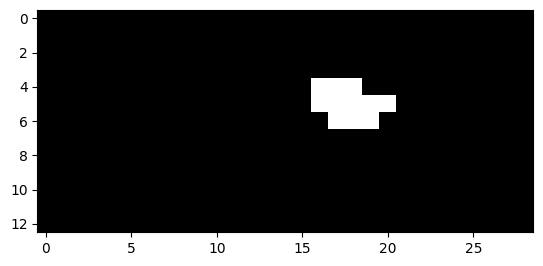

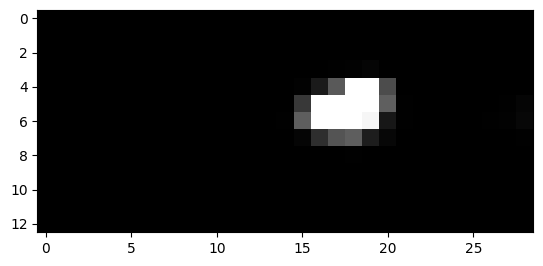

13


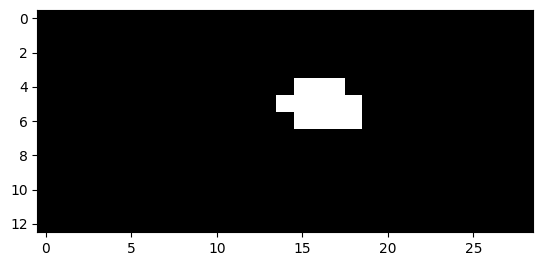

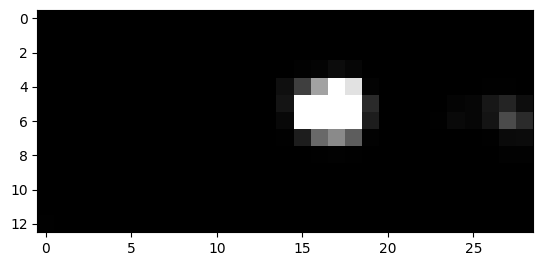

14


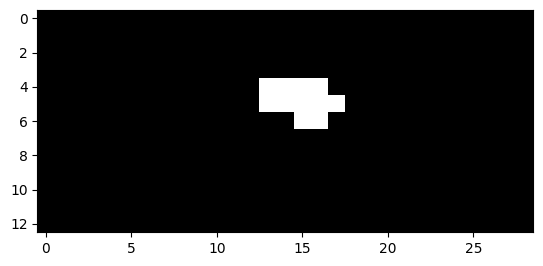

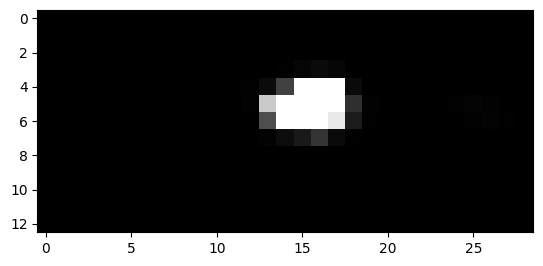

15


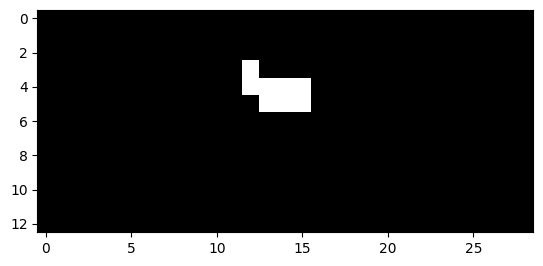

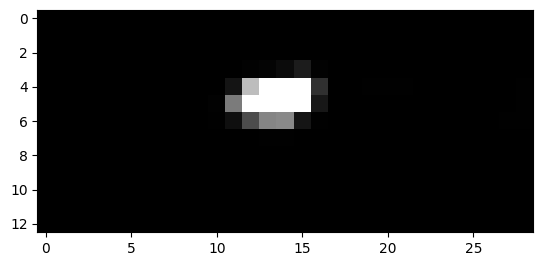

16


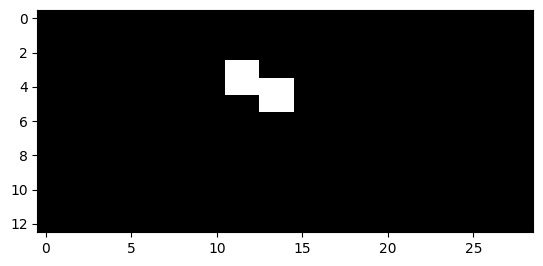

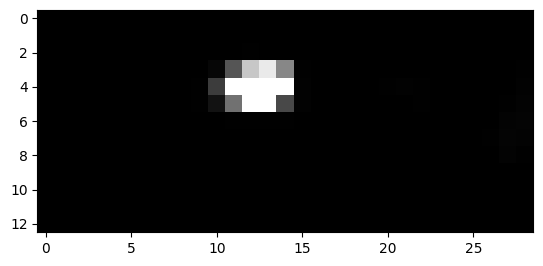

17


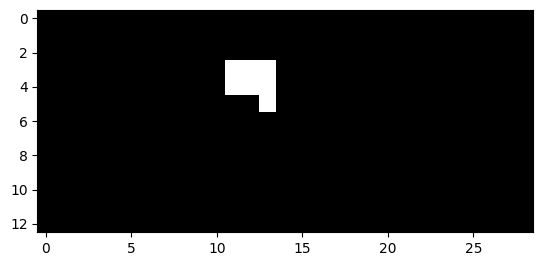

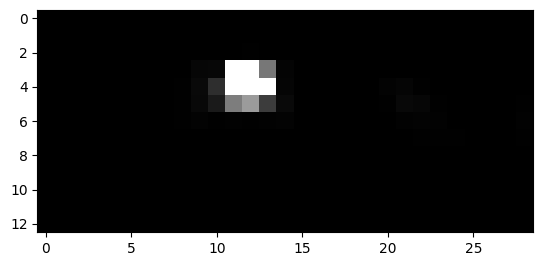

18


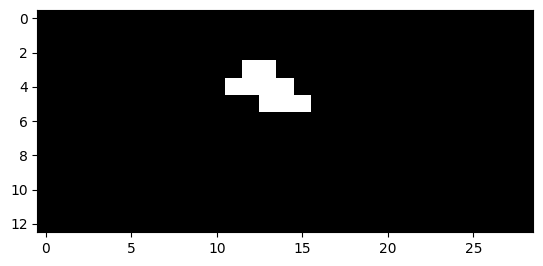

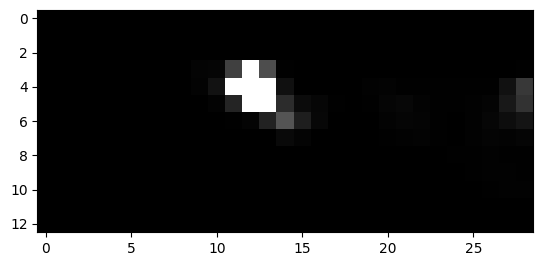

19


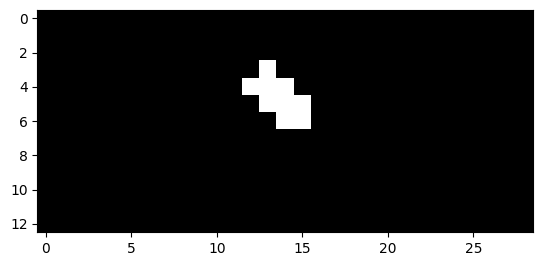

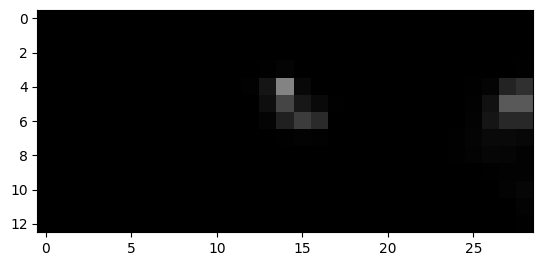

20


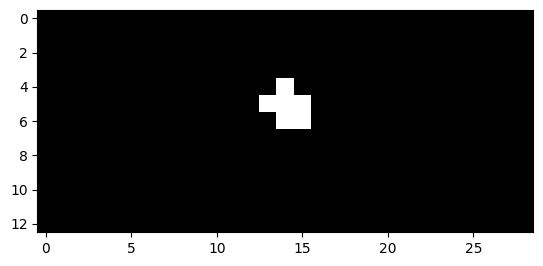

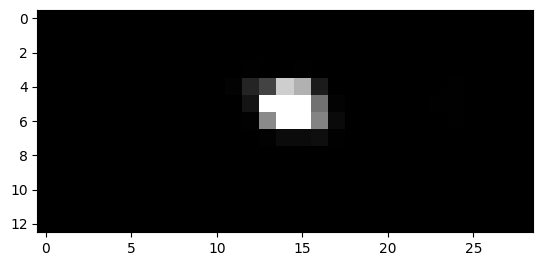

21


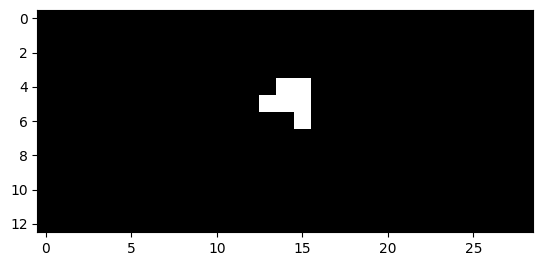

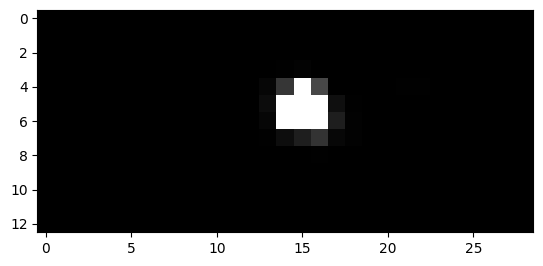

22


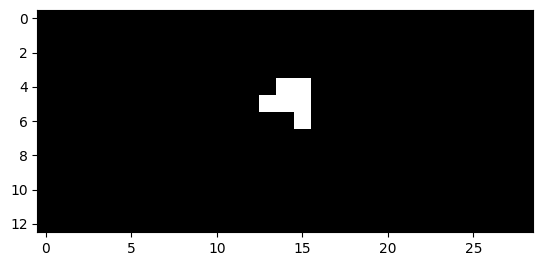

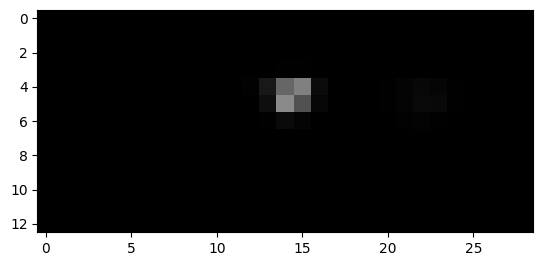

105


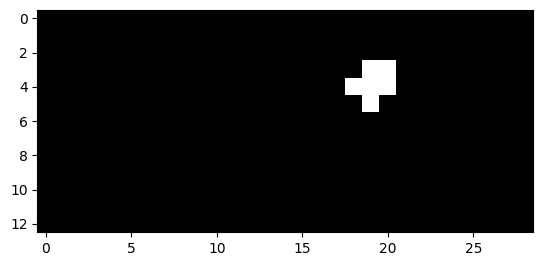

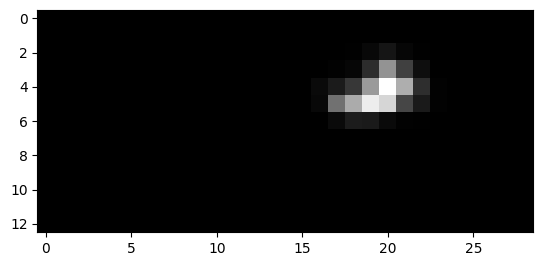

106


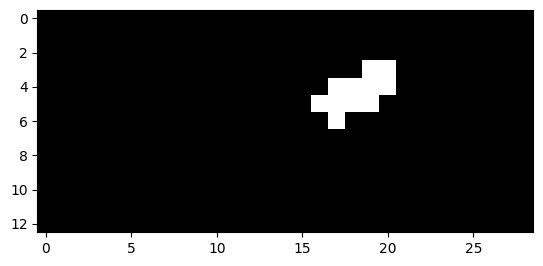

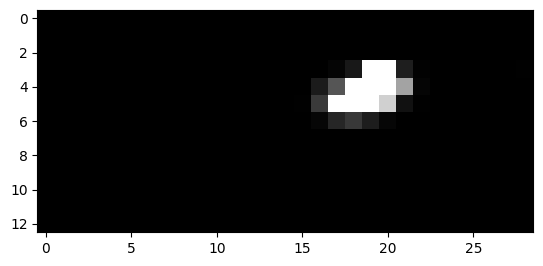

107


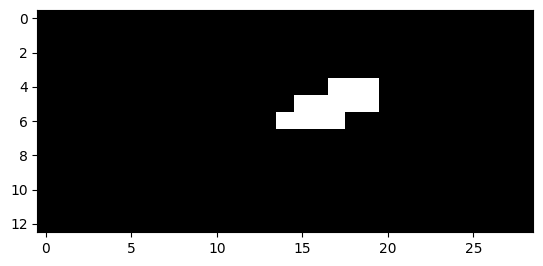

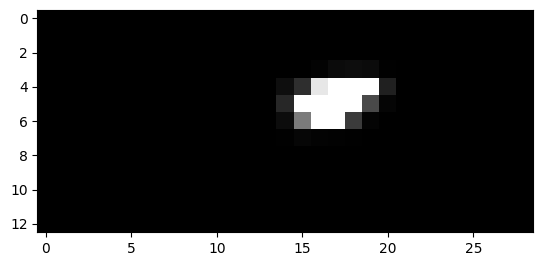

108


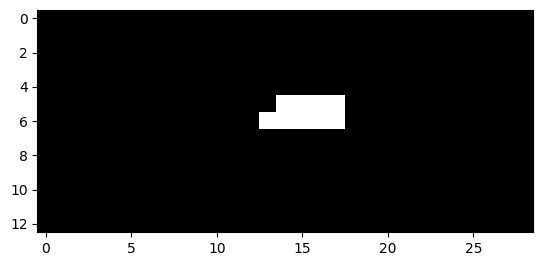

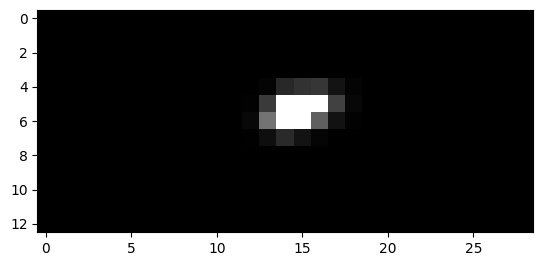

109


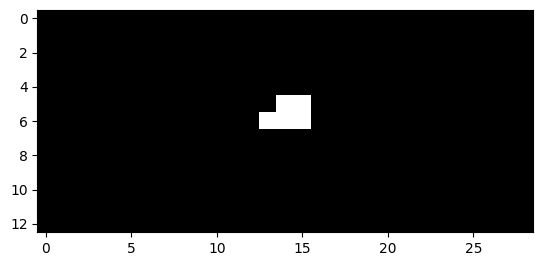

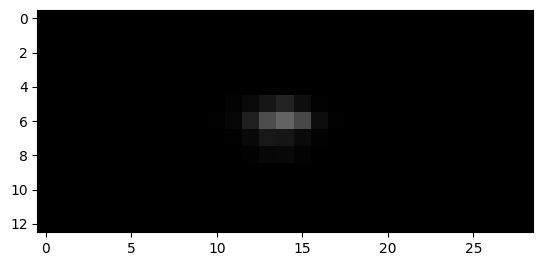

184


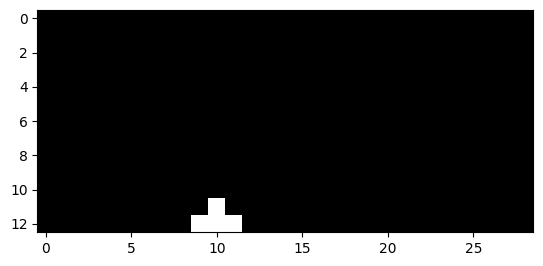

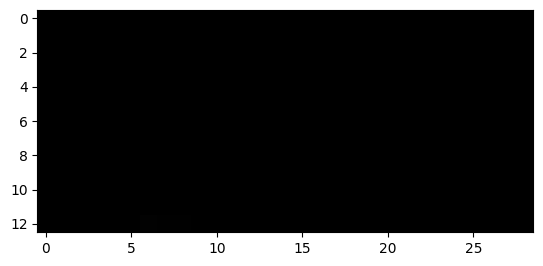

185


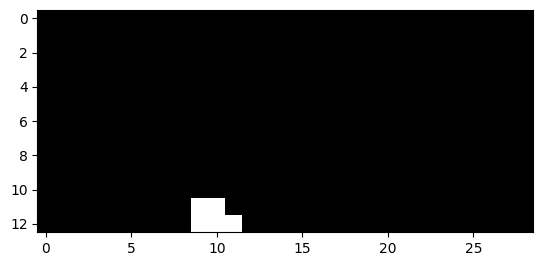

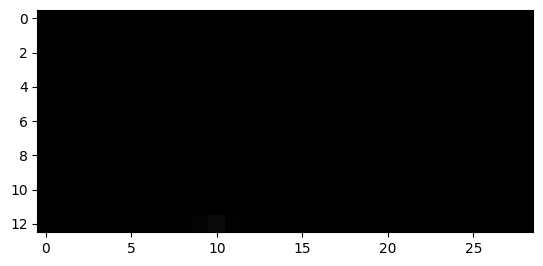

186


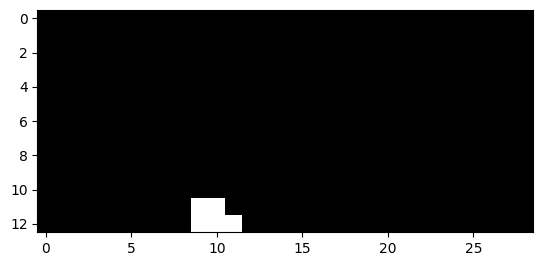

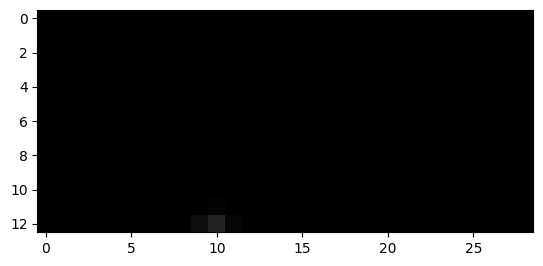

187


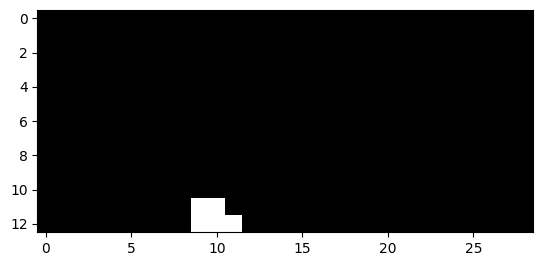

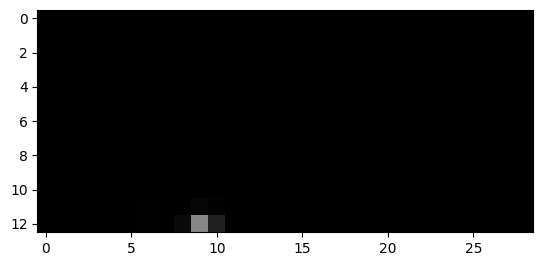

188


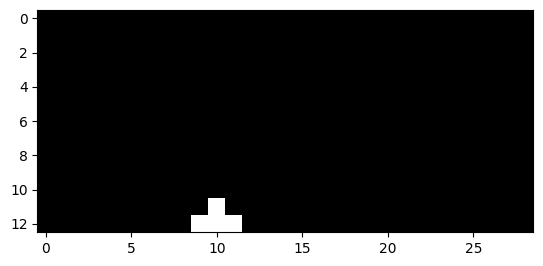

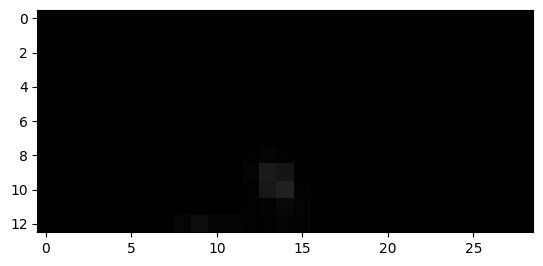

308


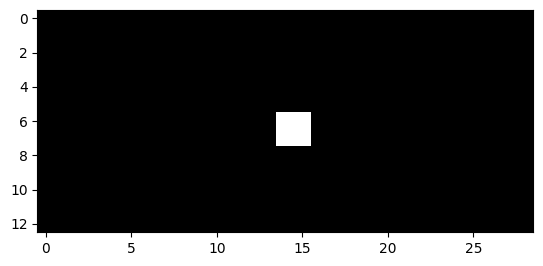

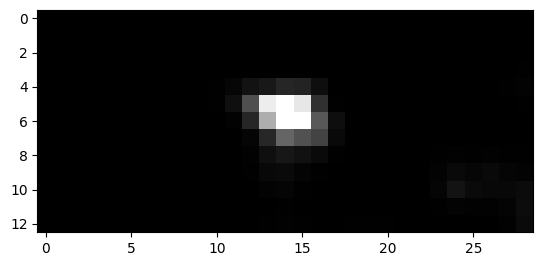

309


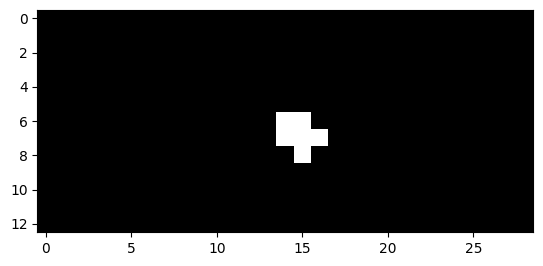

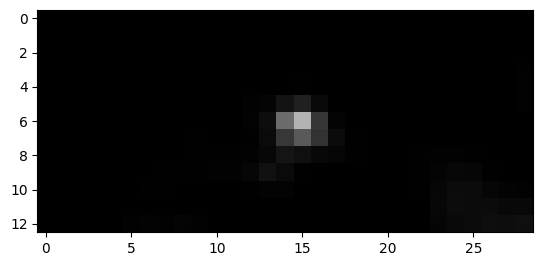

310


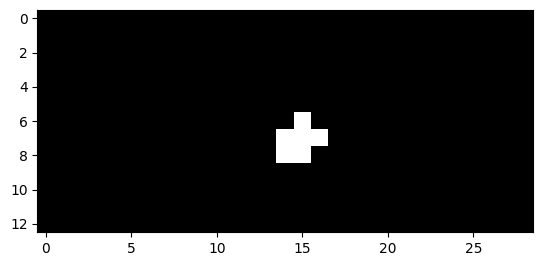

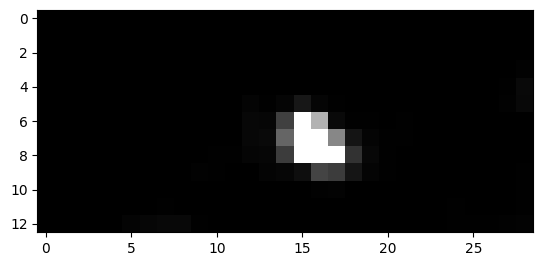

311


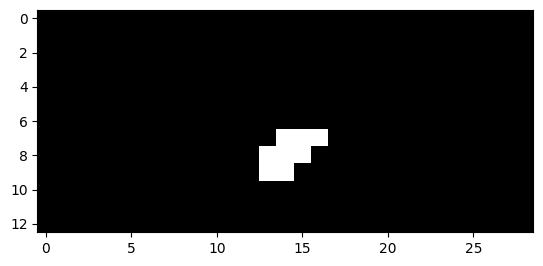

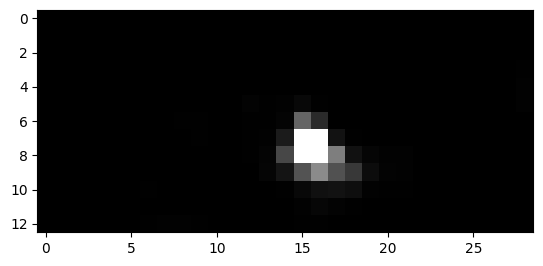

312


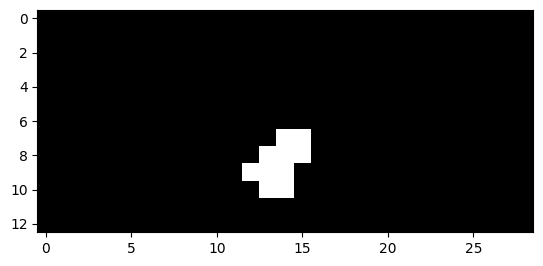

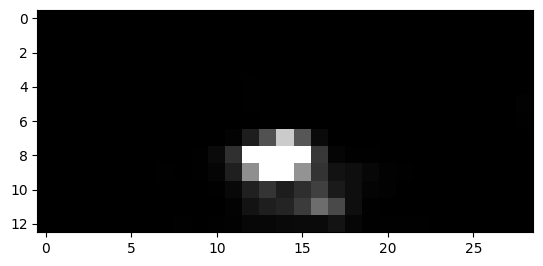

313


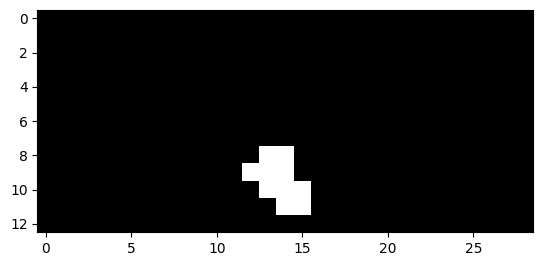

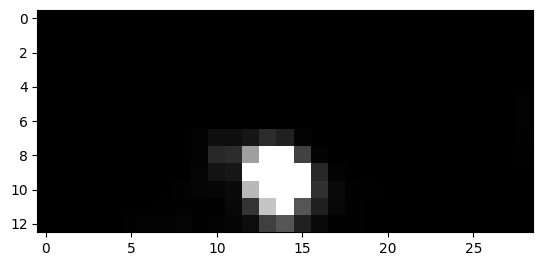

314


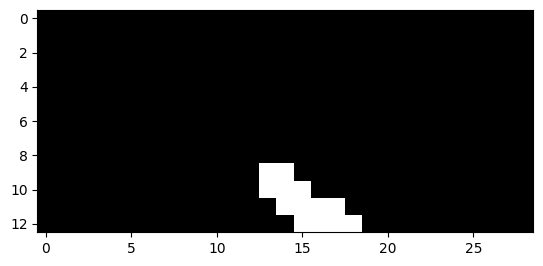

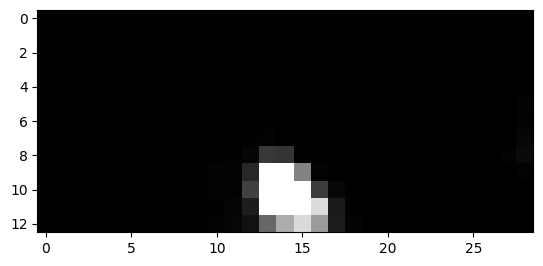

315


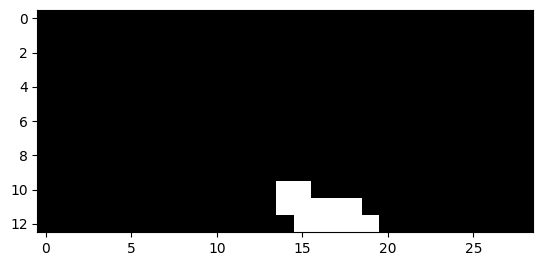

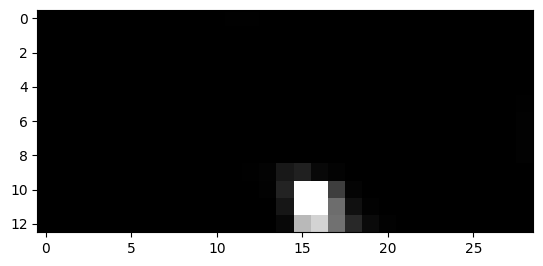

316


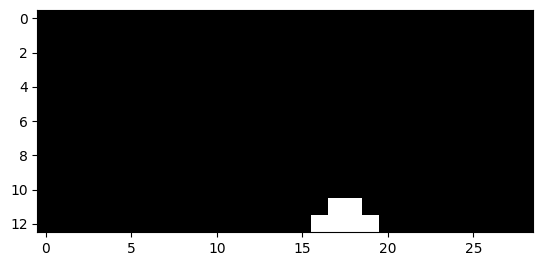

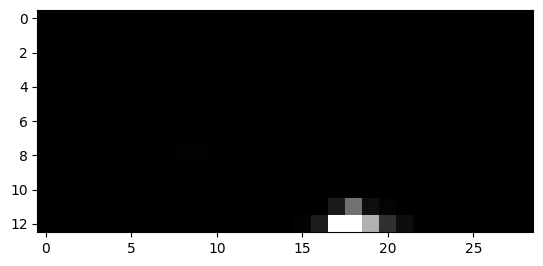

317


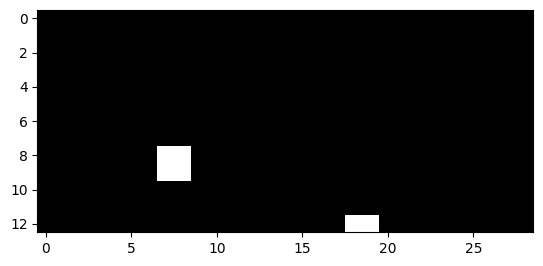

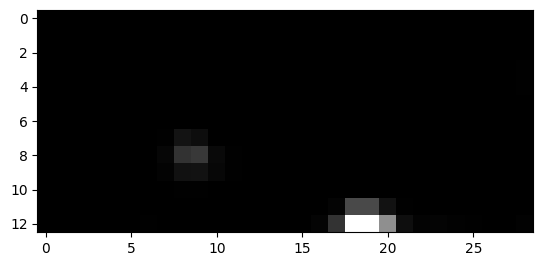

318


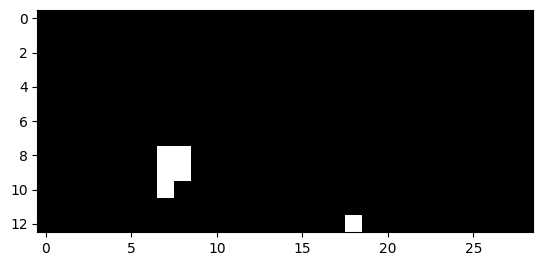

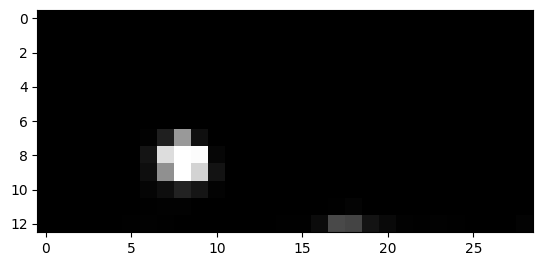

319


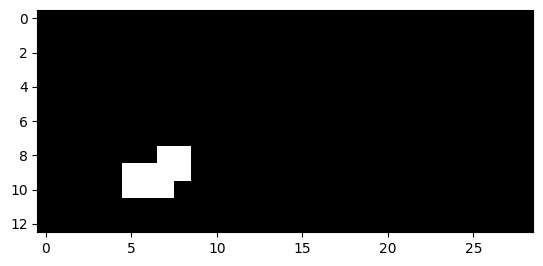

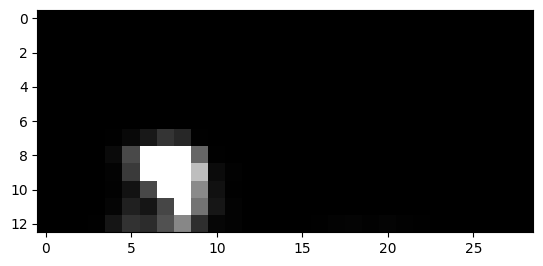

320


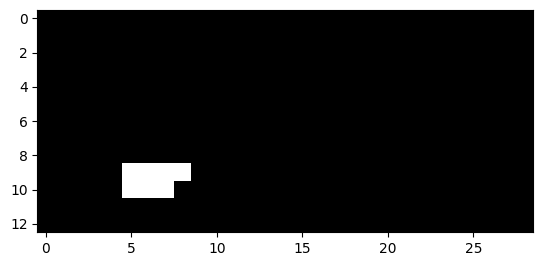

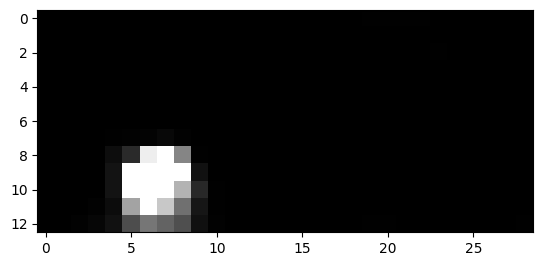

321


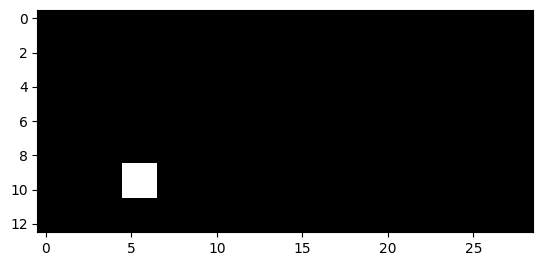

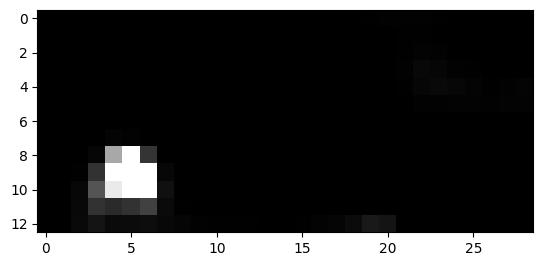

335


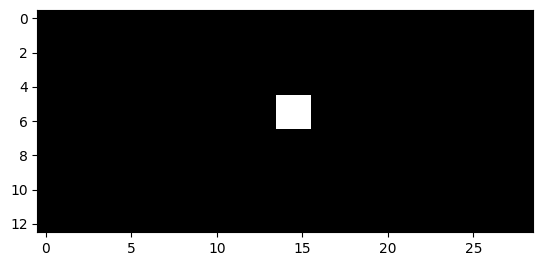

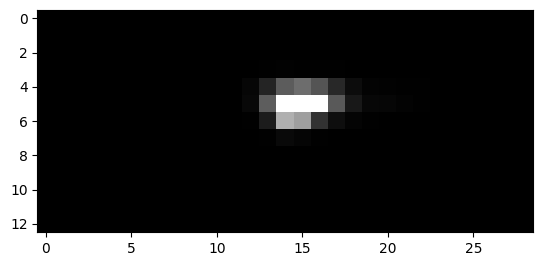

336


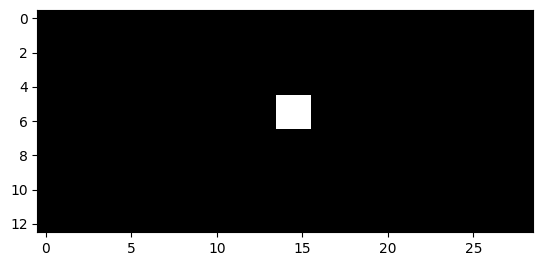

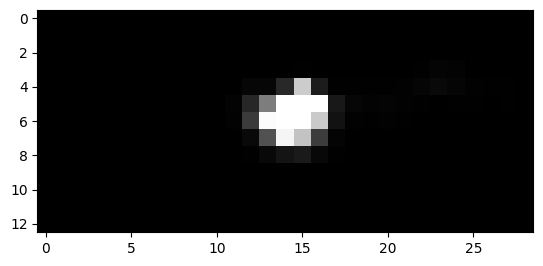

337


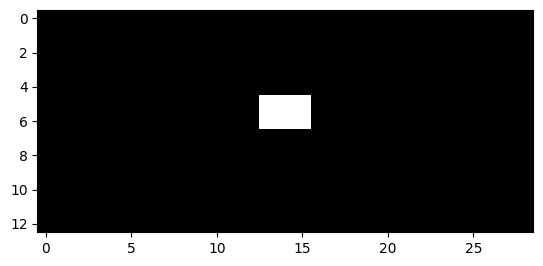

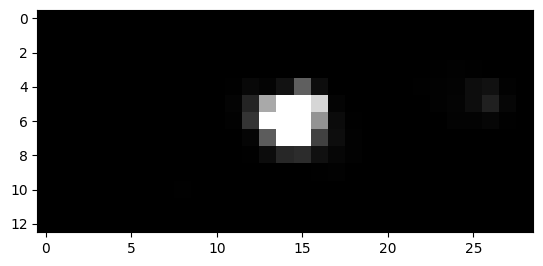

338


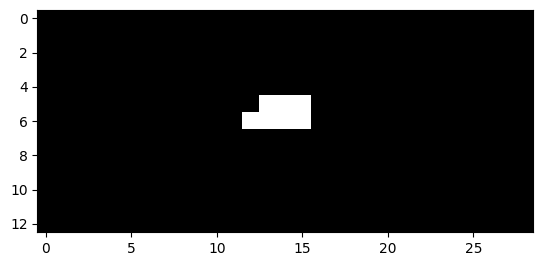

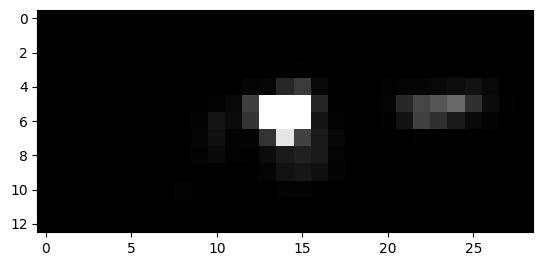

339


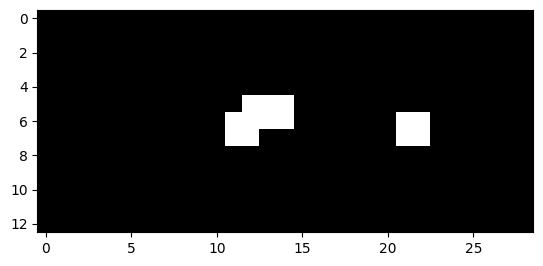

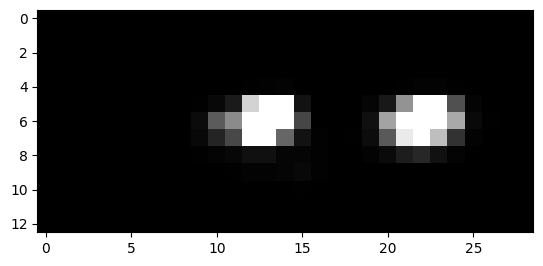

340


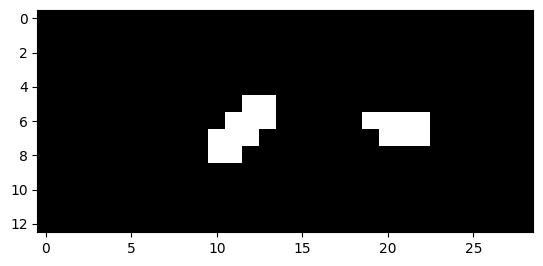

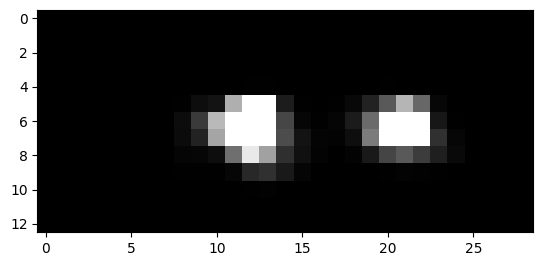

341


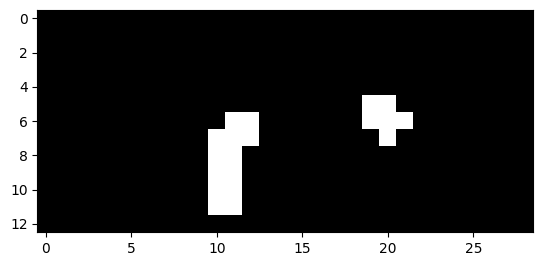

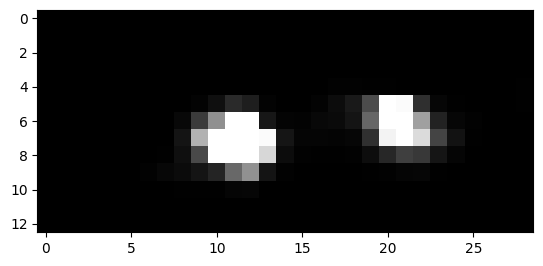

342


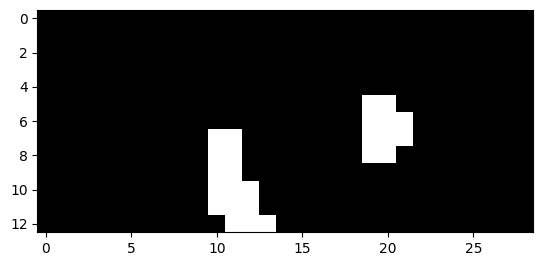

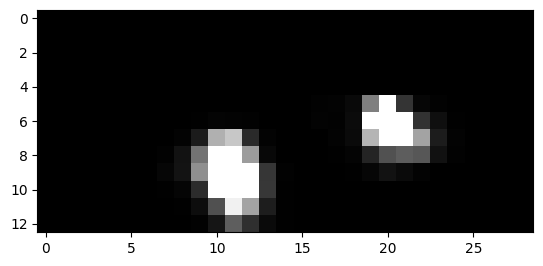

343


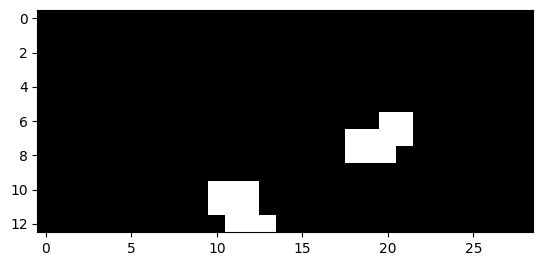

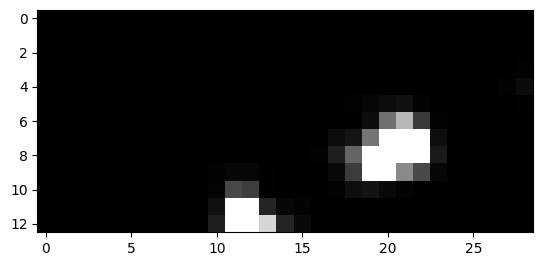

344


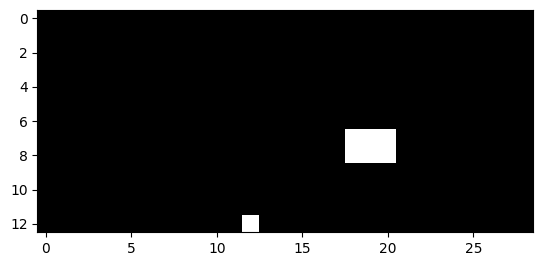

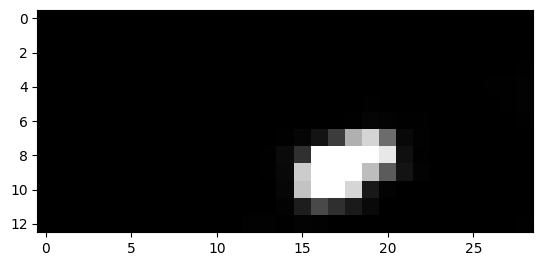

346


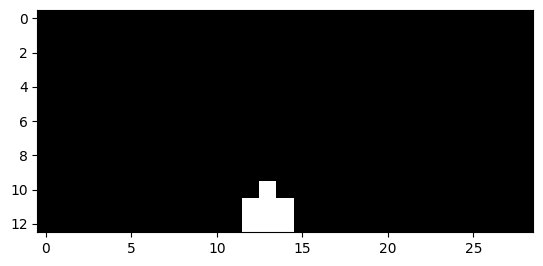

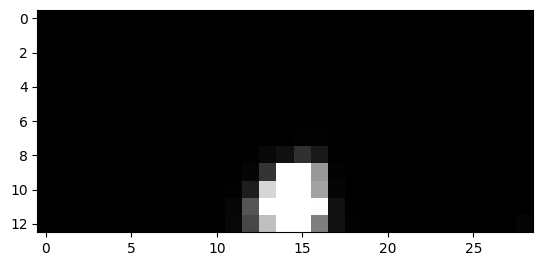

347


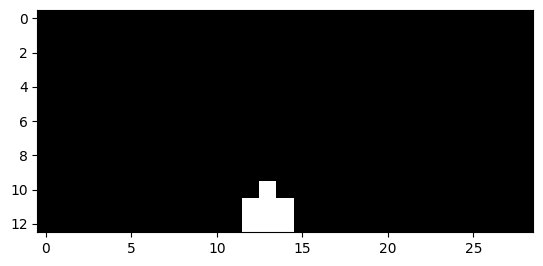

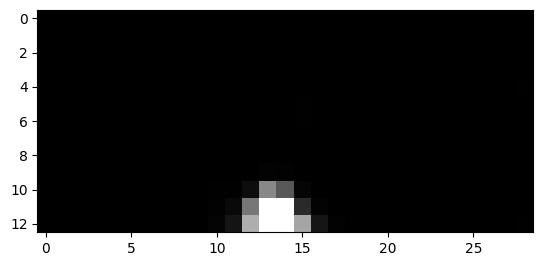

348


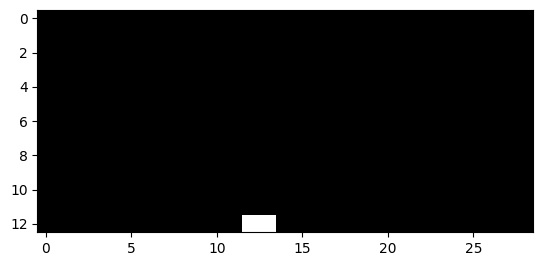

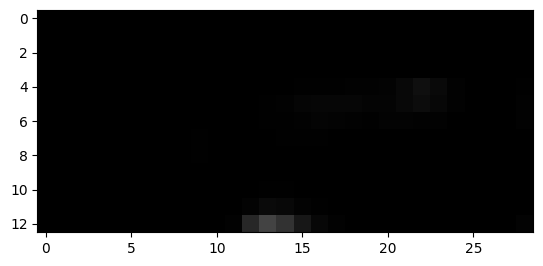

640


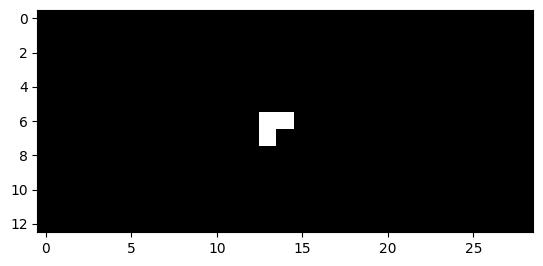

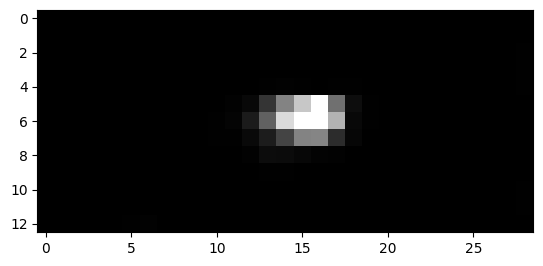

641


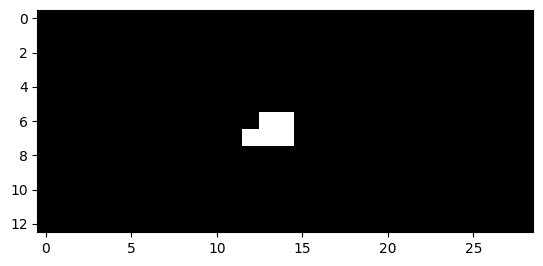

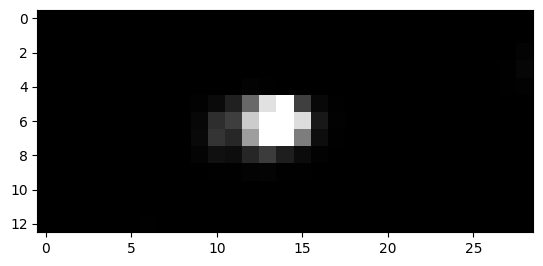

642


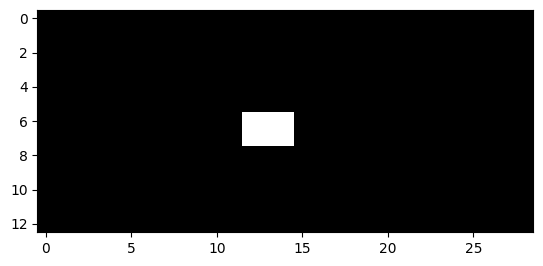

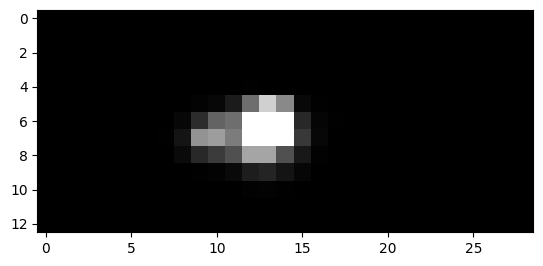

643


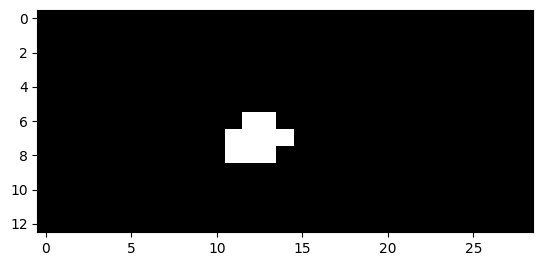

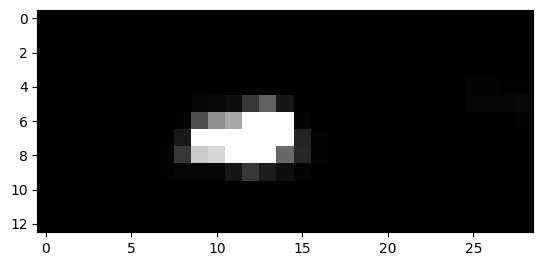

644


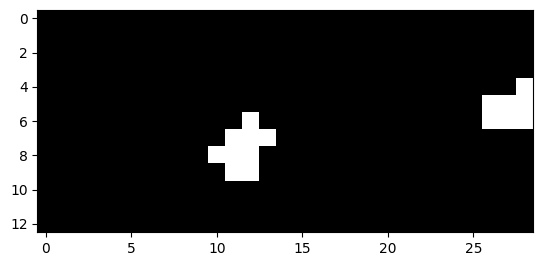

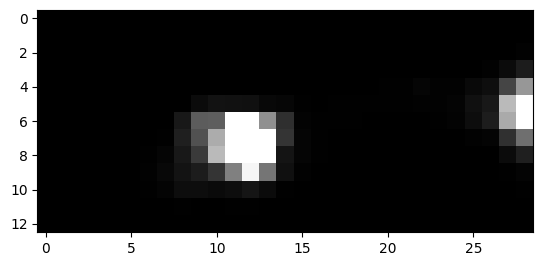

645


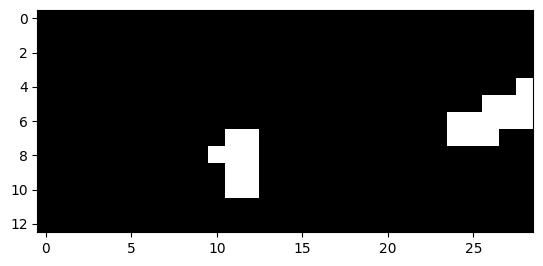

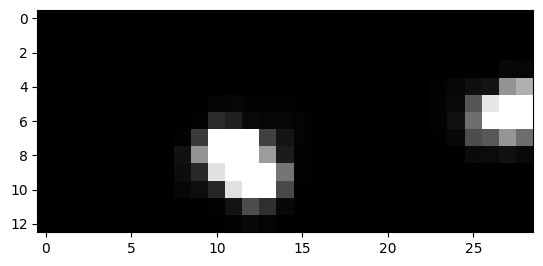

646


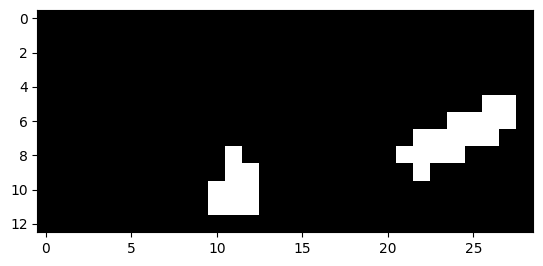

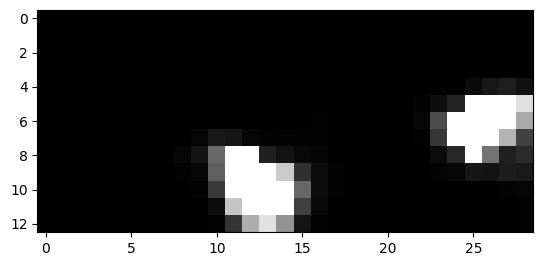

647


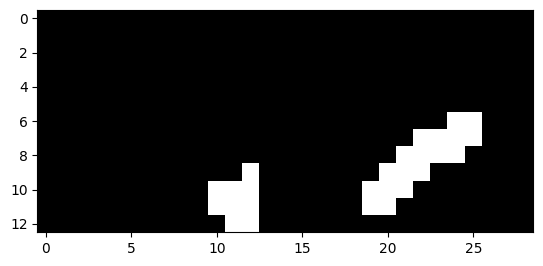

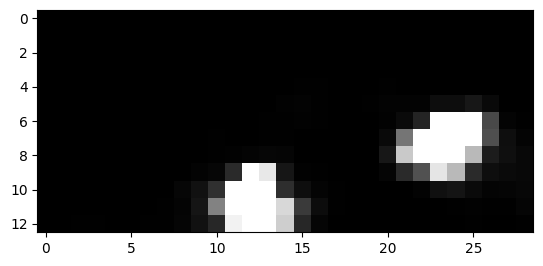

648


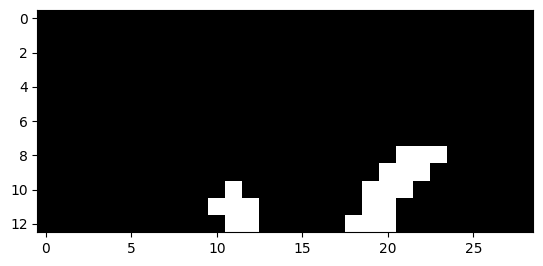

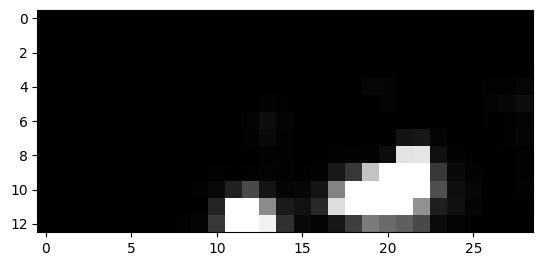

649


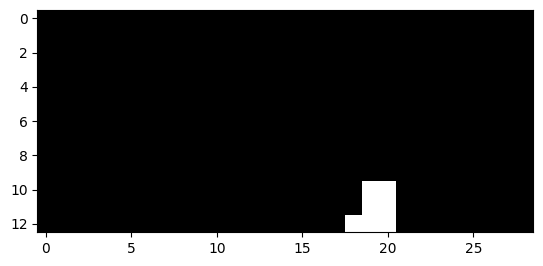

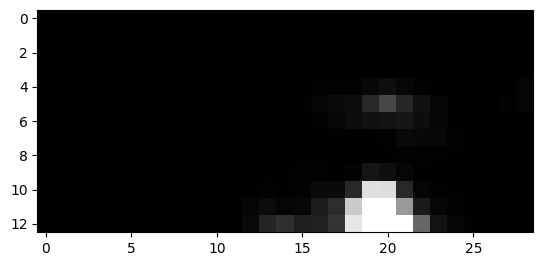

651


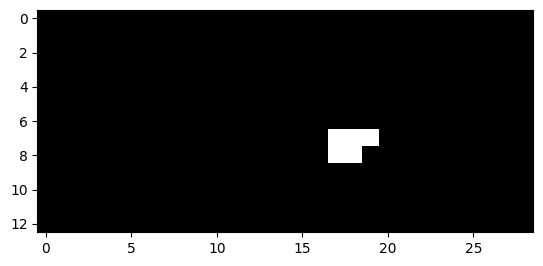

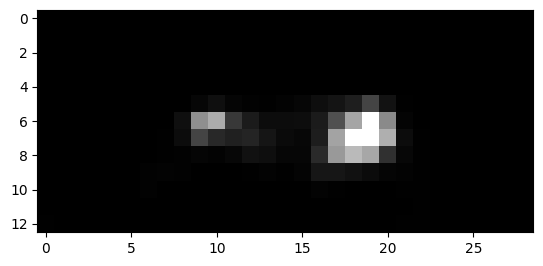

652


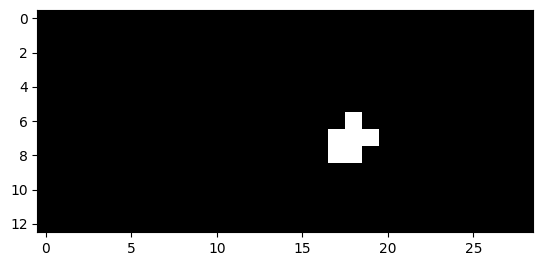

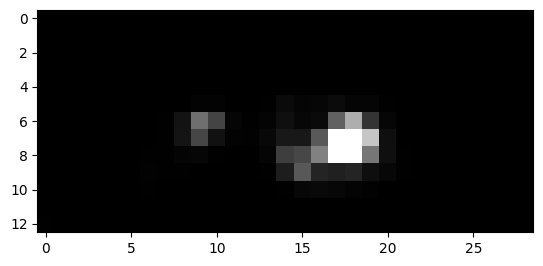

653


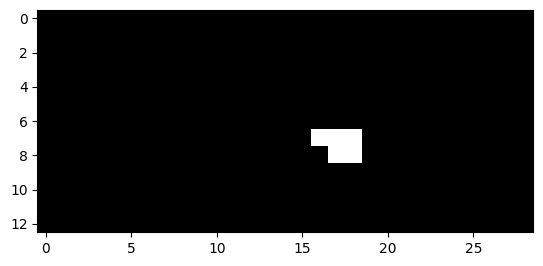

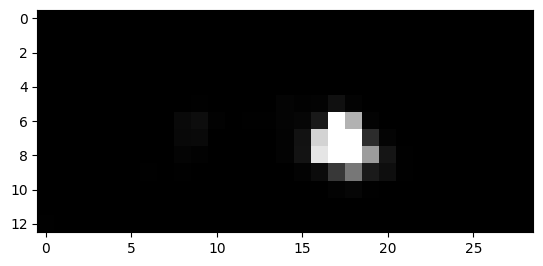

654


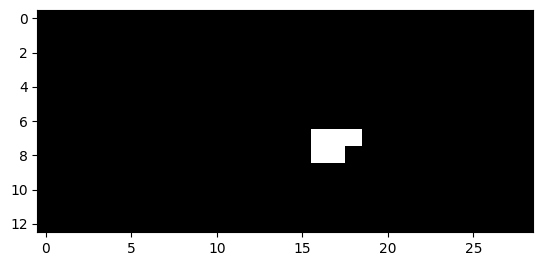

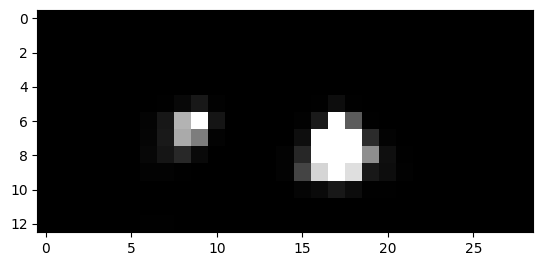

655


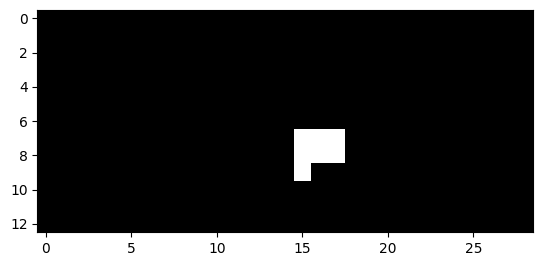

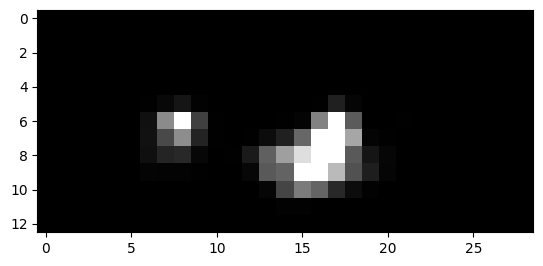

656


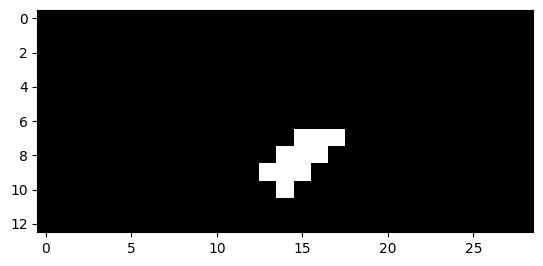

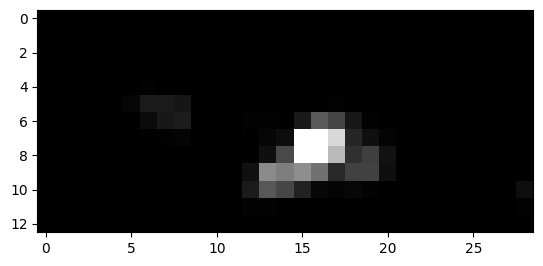

657


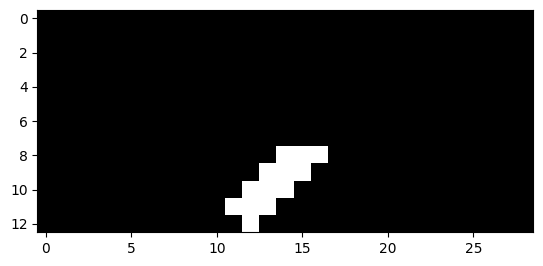

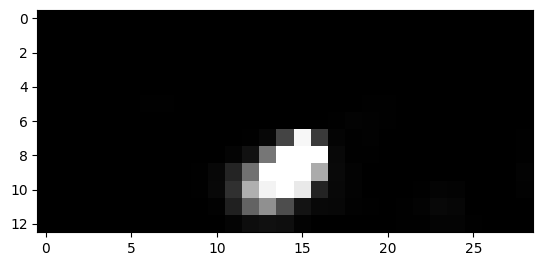

658


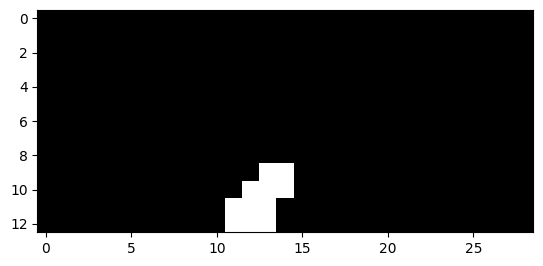

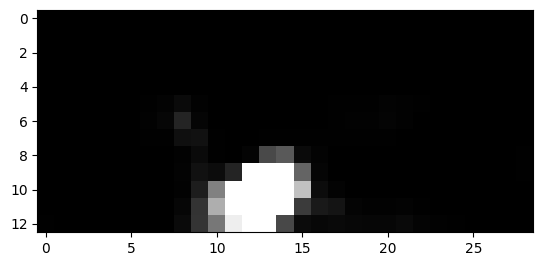

659


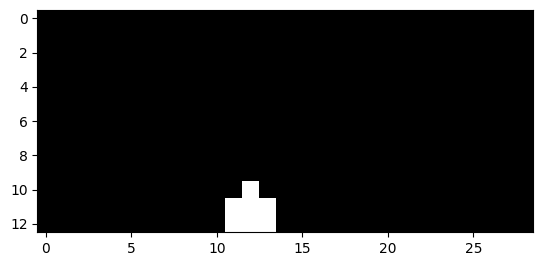

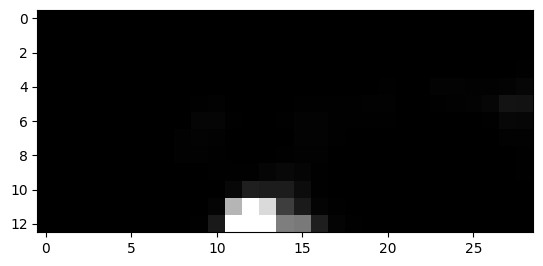

665


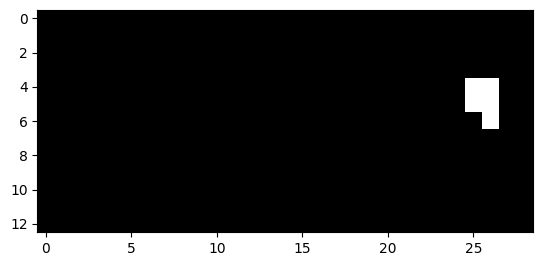

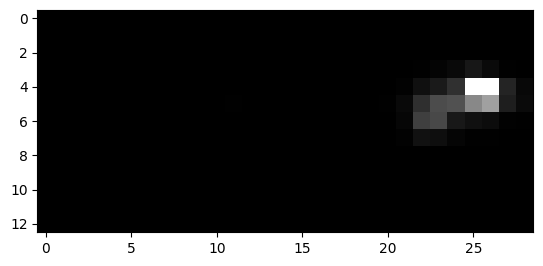

666


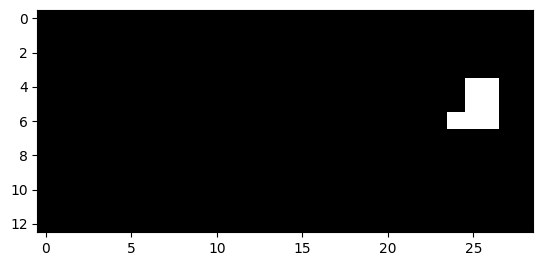

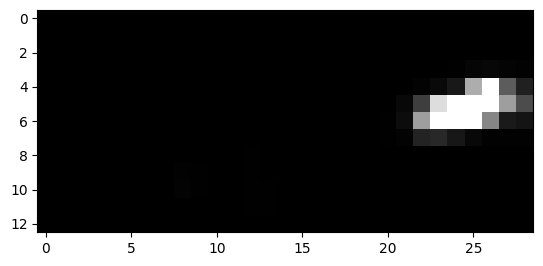

667


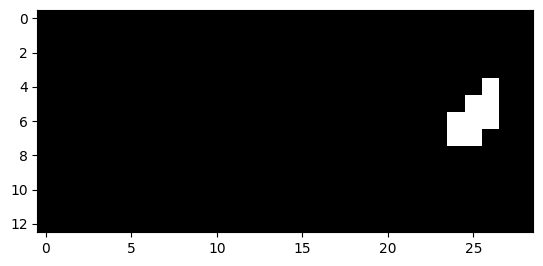

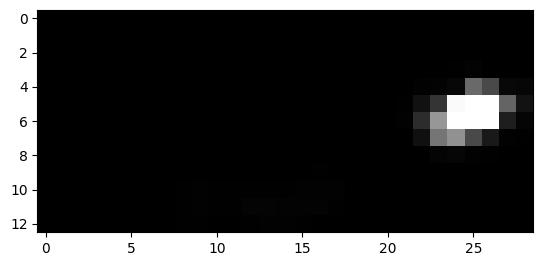

668


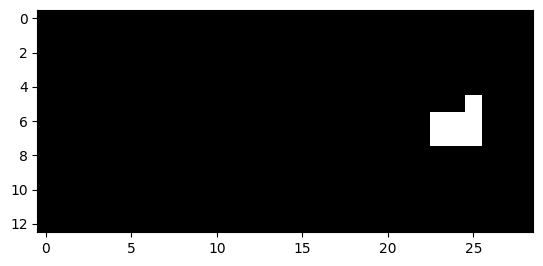

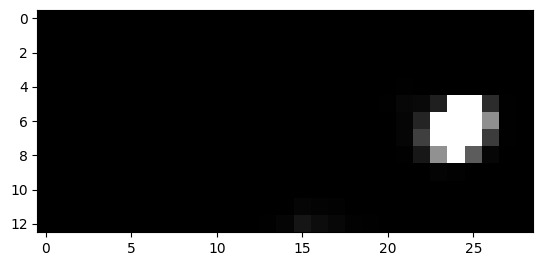

669


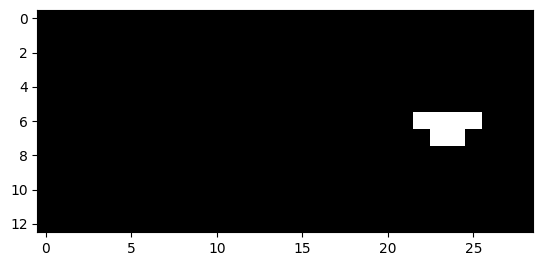

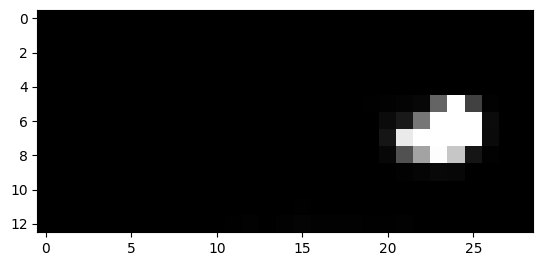

670


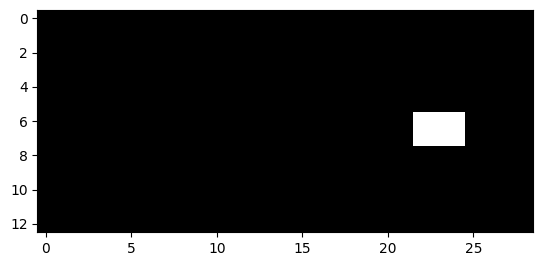

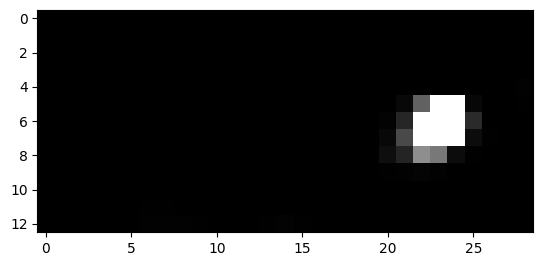

671


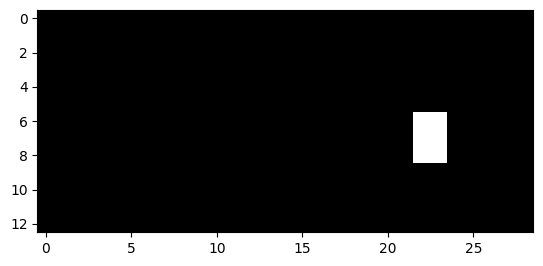

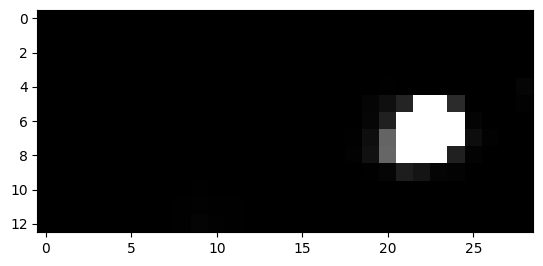

672


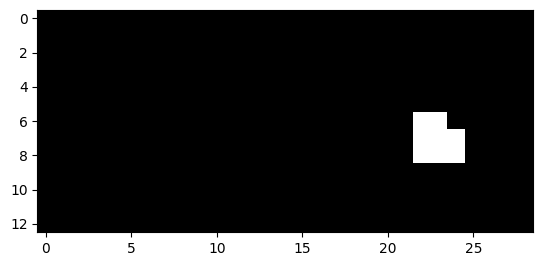

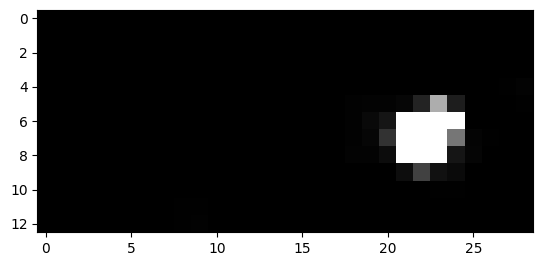

673


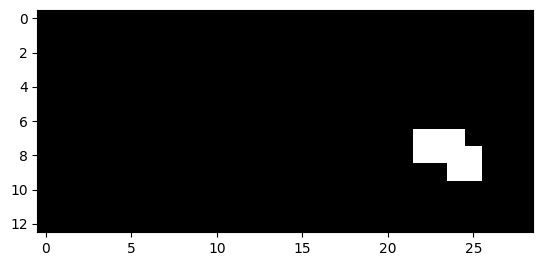

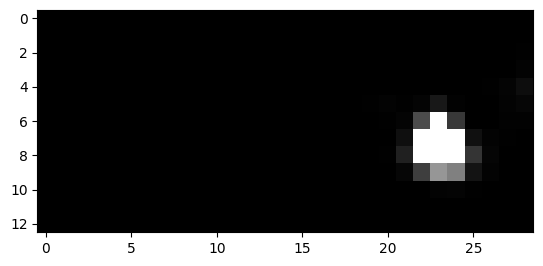

674


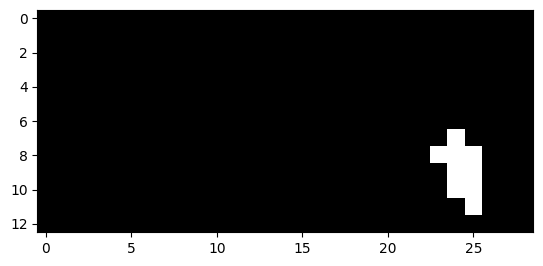

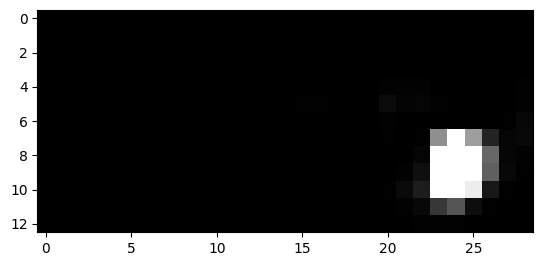

675


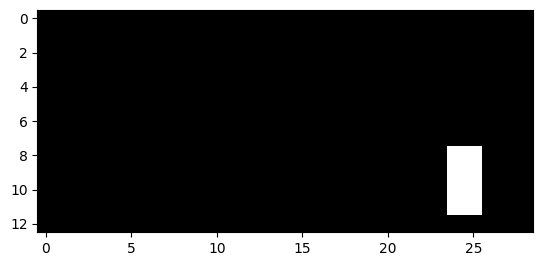

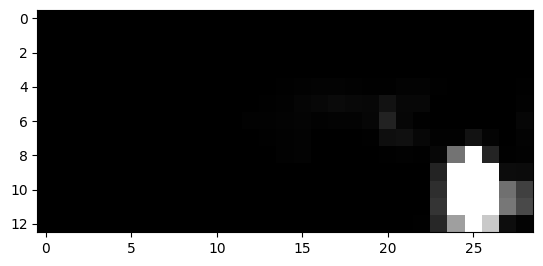

676


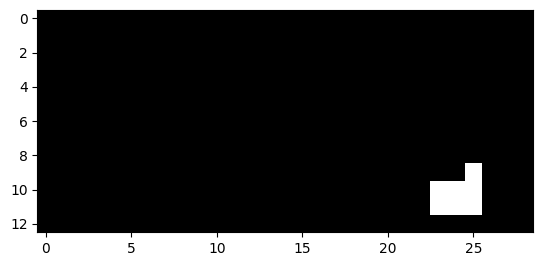

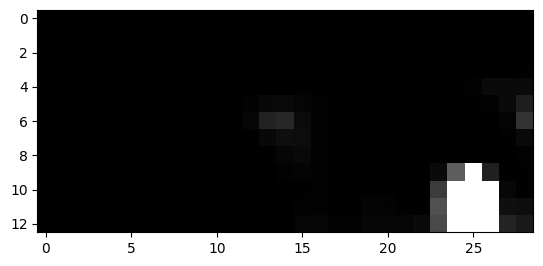

677


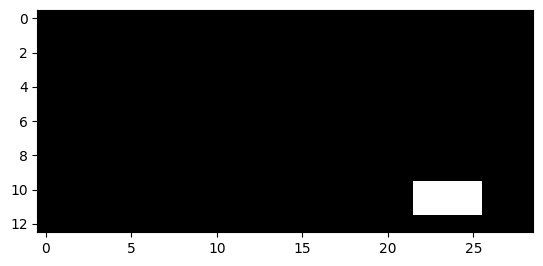

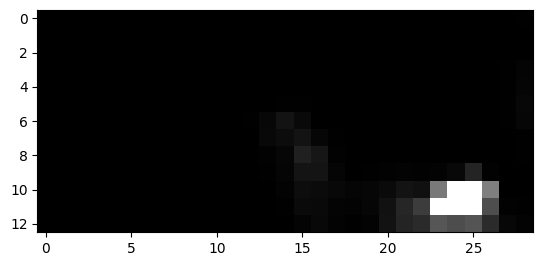

678


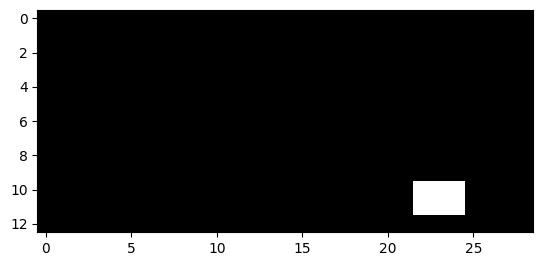

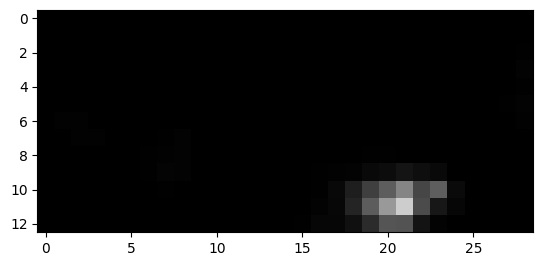

699


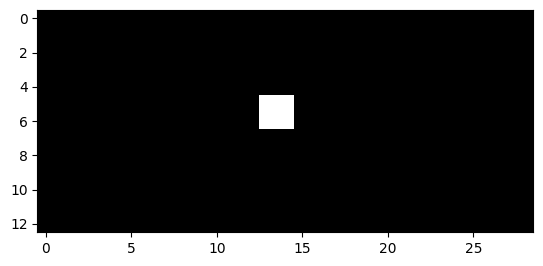

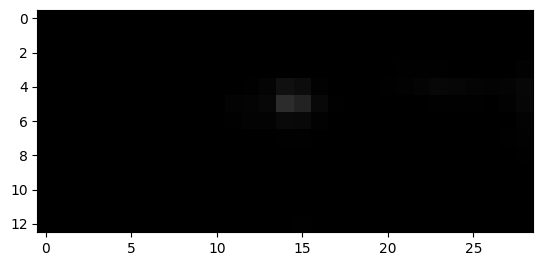

700


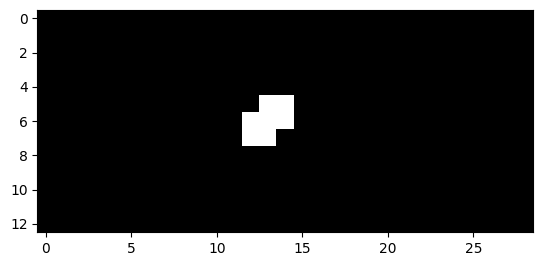

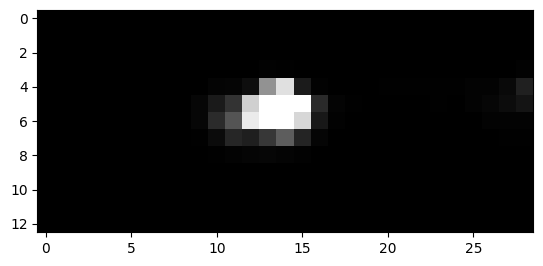

701


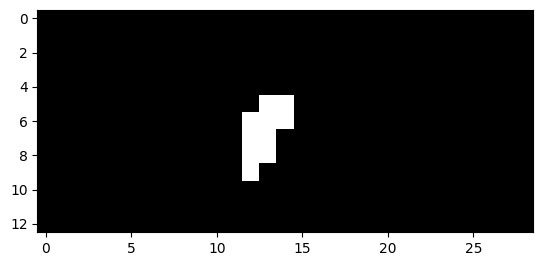

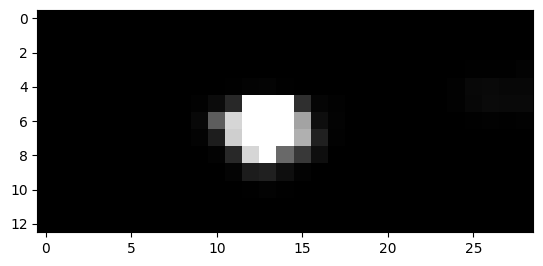

702


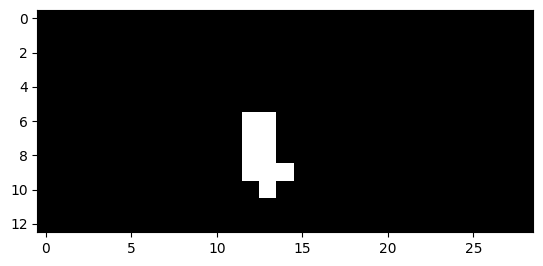

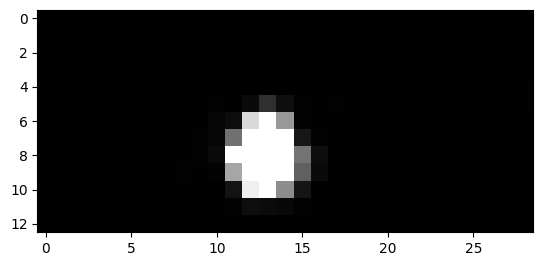

703


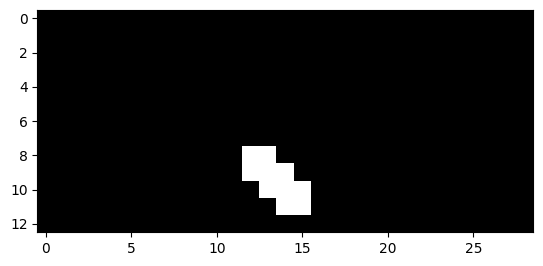

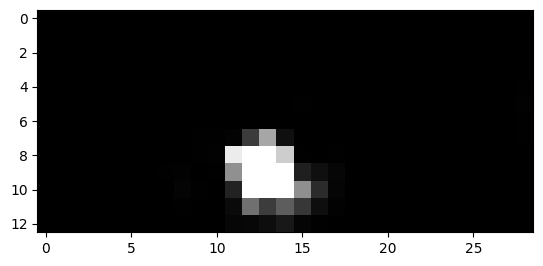

704


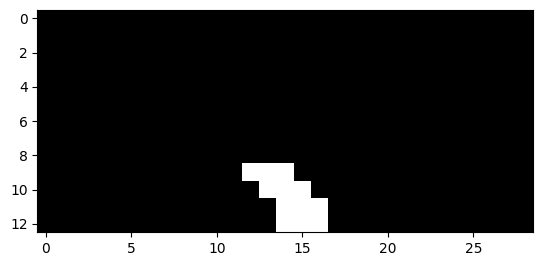

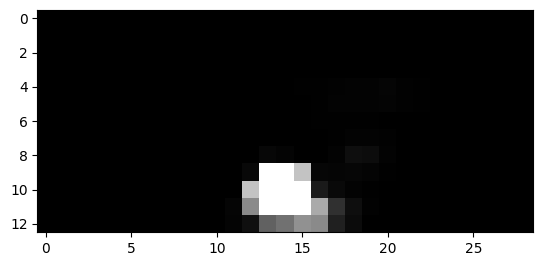

705


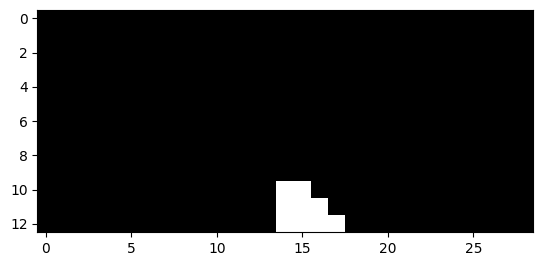

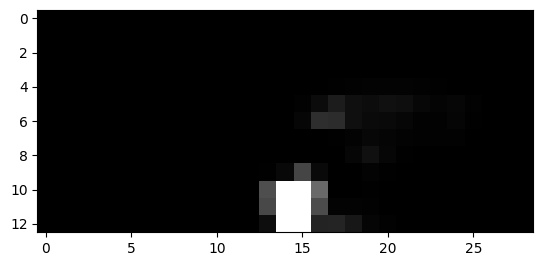

706


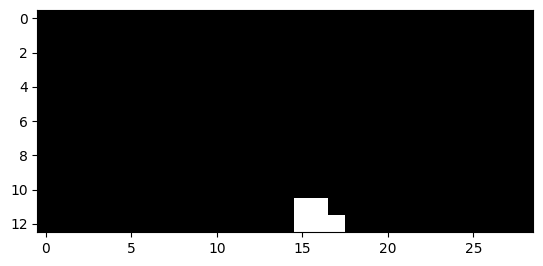

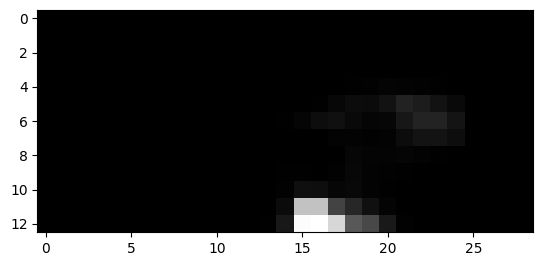

711


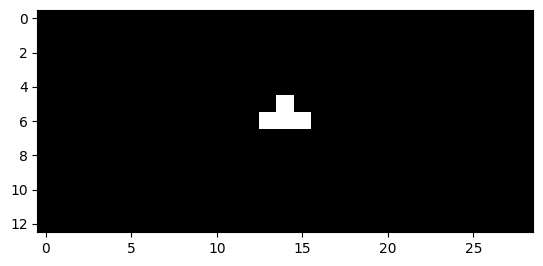

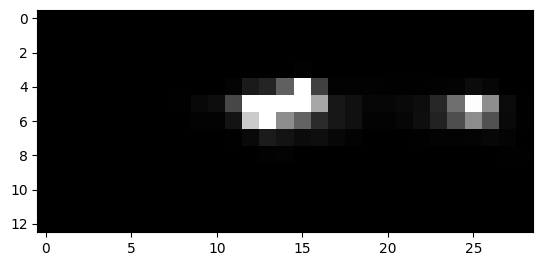

712


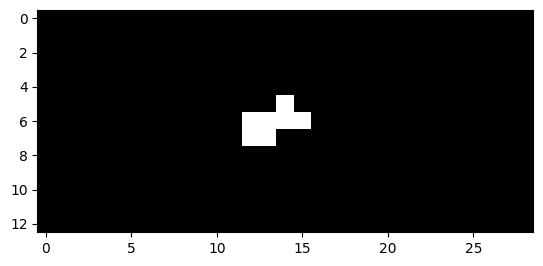

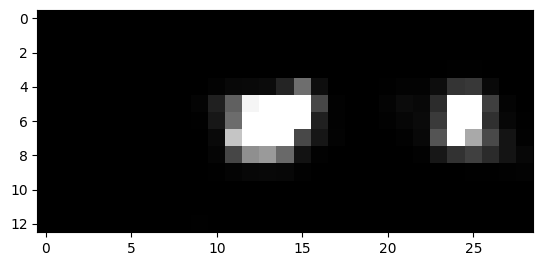

713


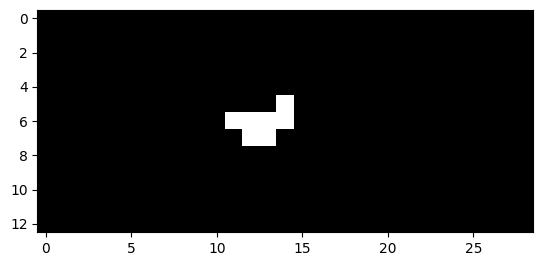

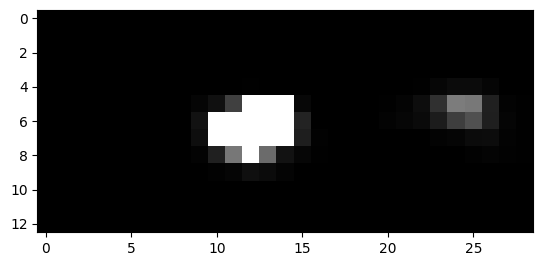

714


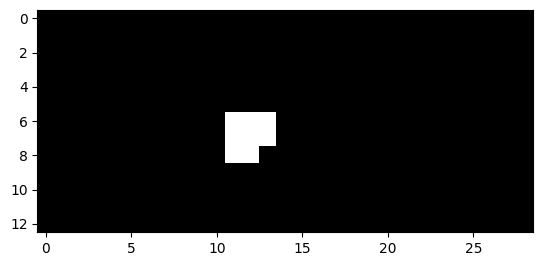

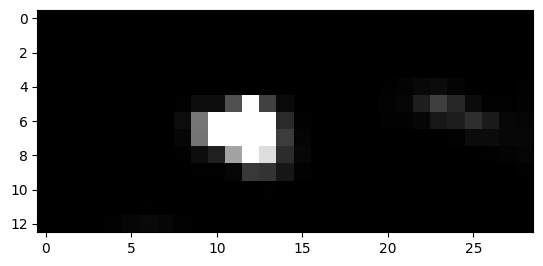

715


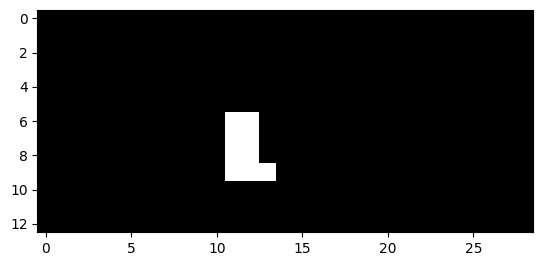

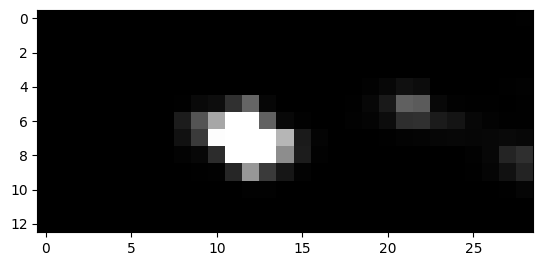

716


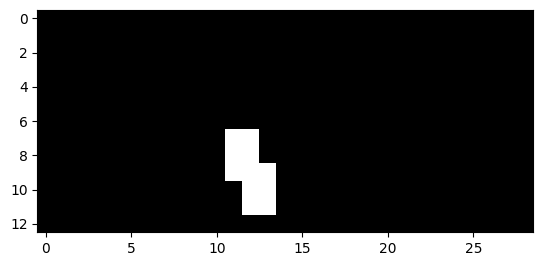

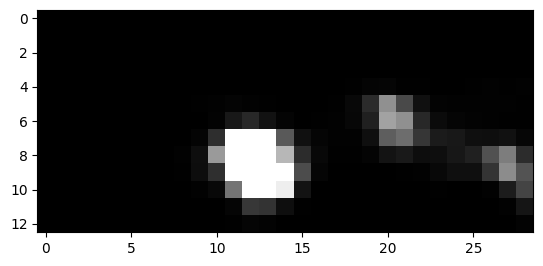

717


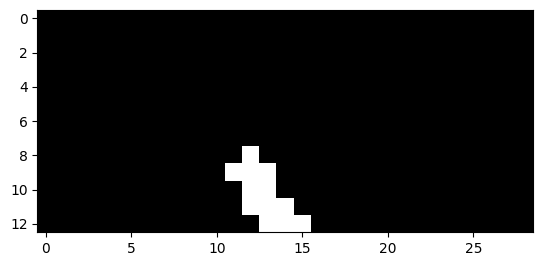

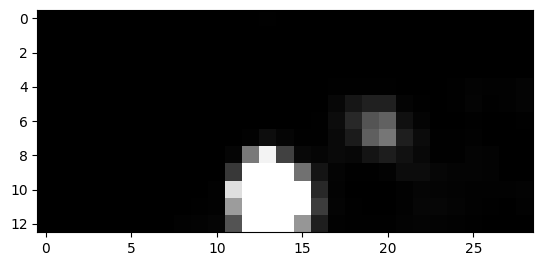

718


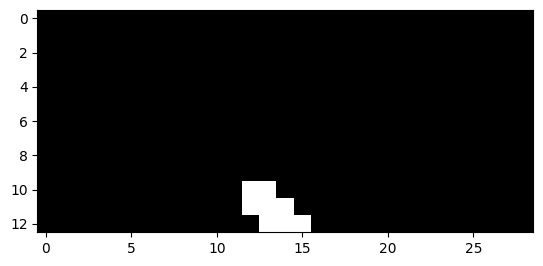

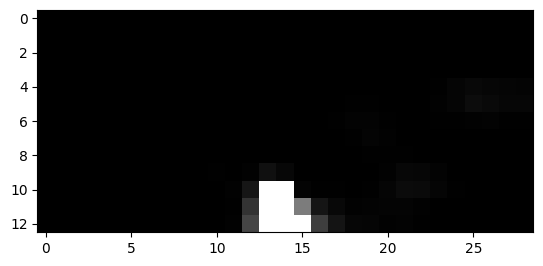

719


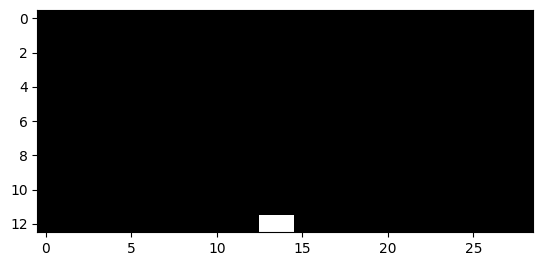

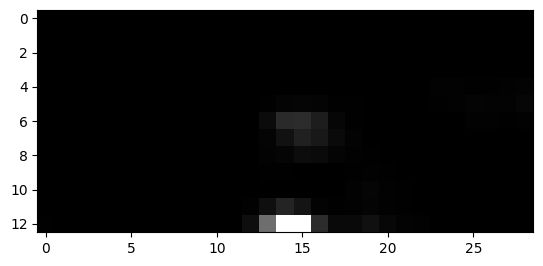

751


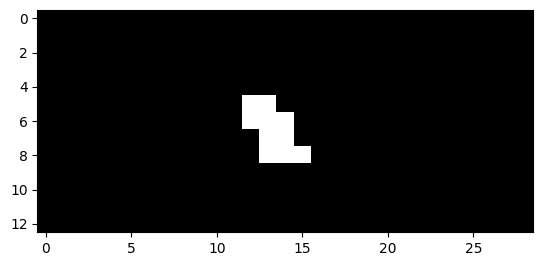

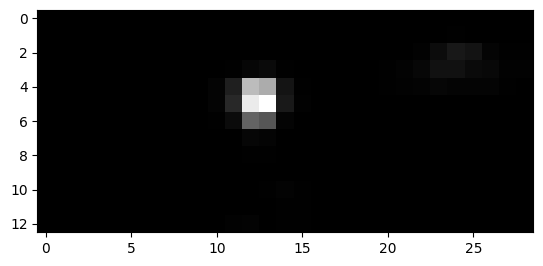

752


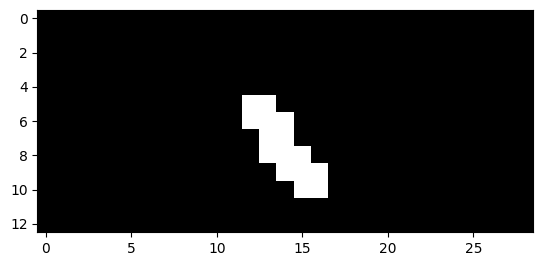

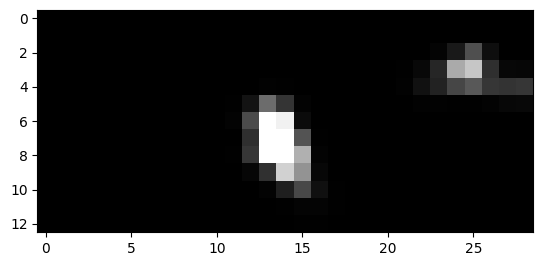

753


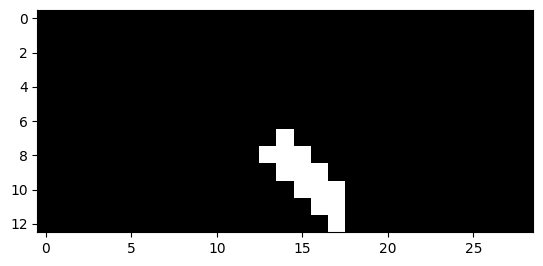

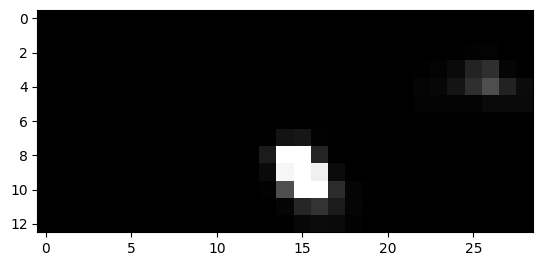

754


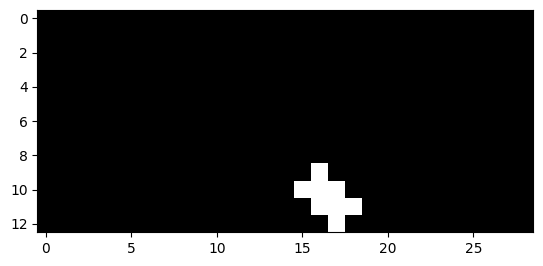

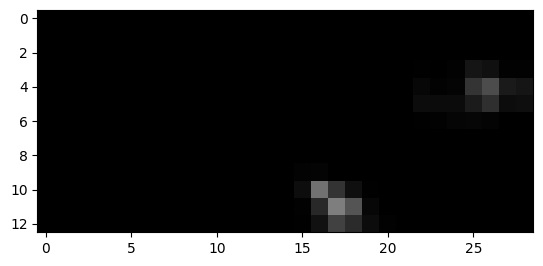

755


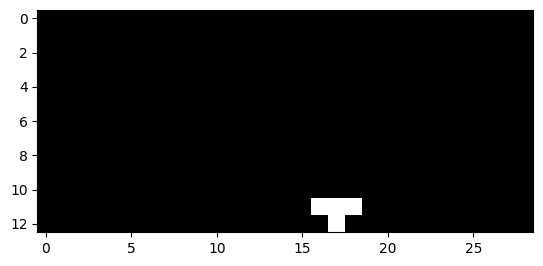

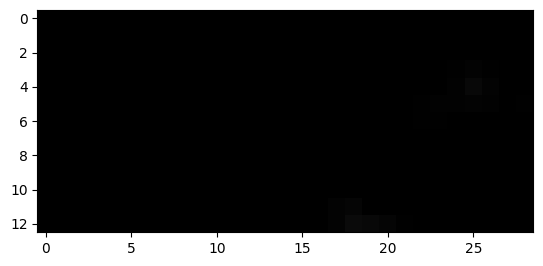

756


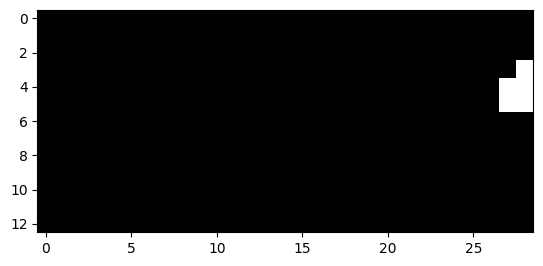

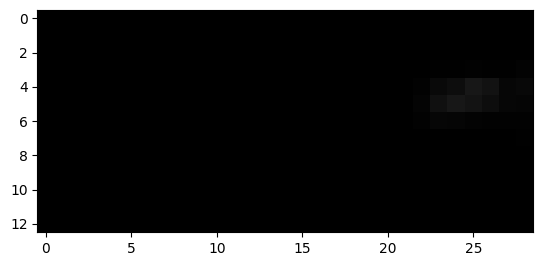

757


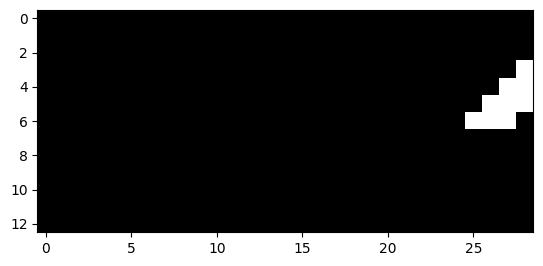

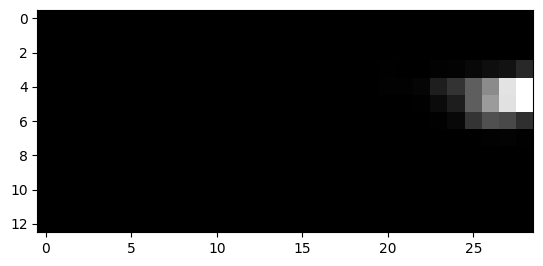

758


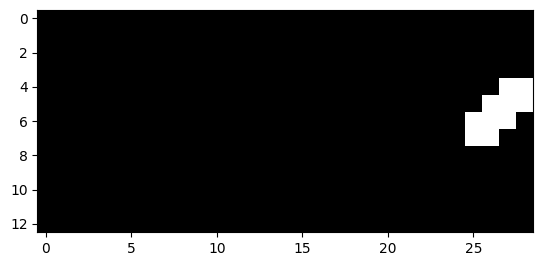

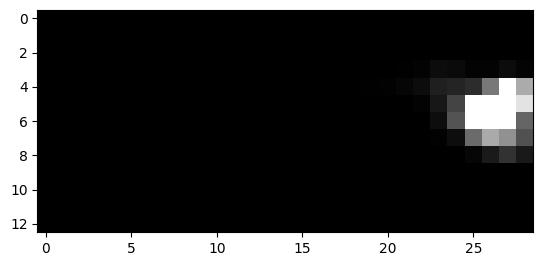

759


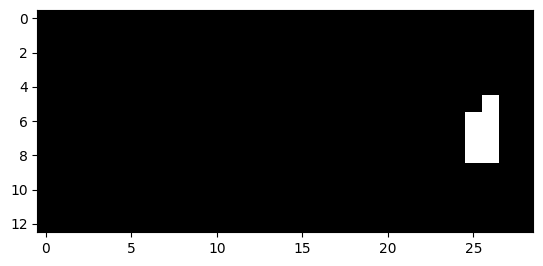

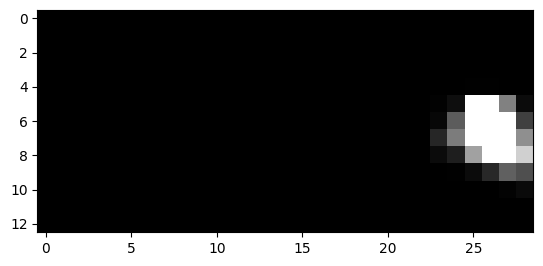

760


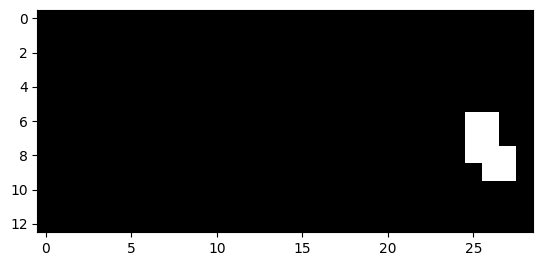

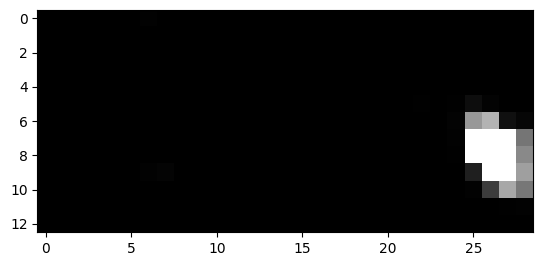

761


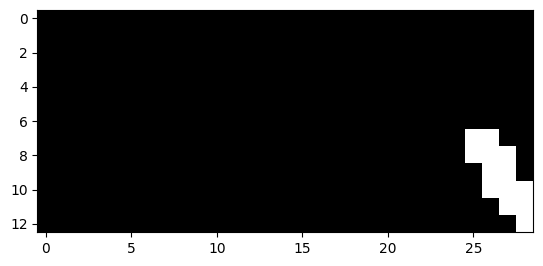

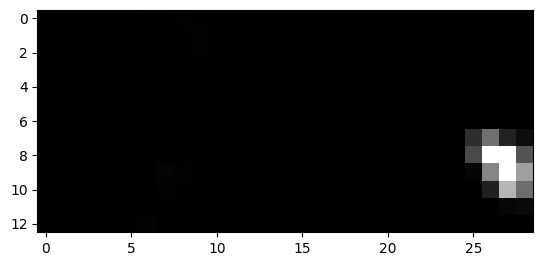

762


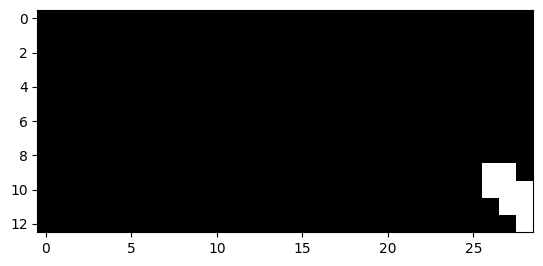

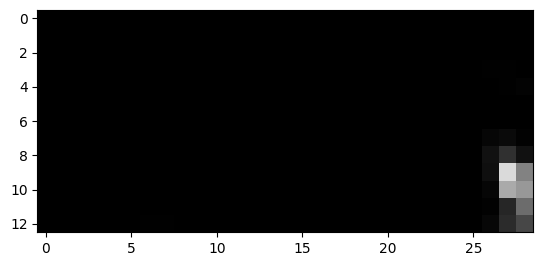

763


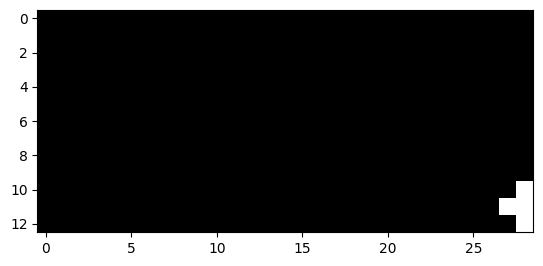

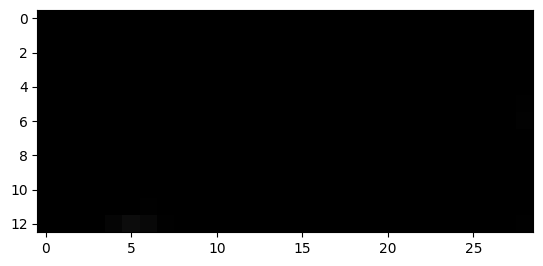

896


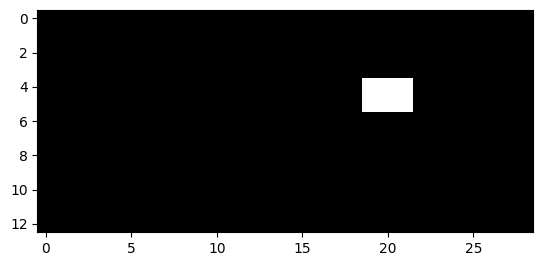

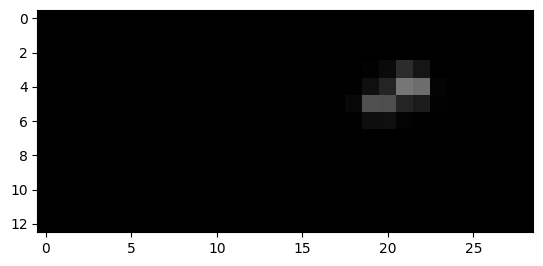

897


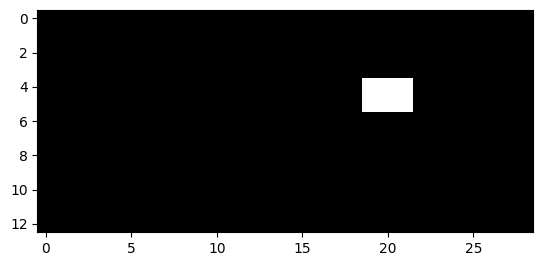

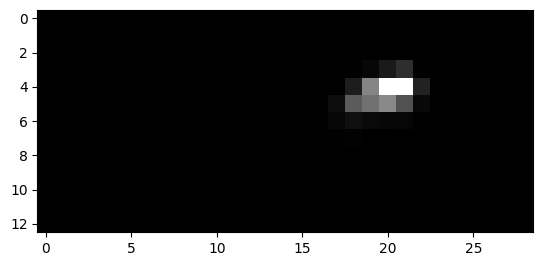

948


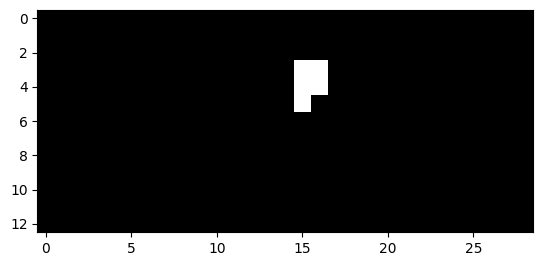

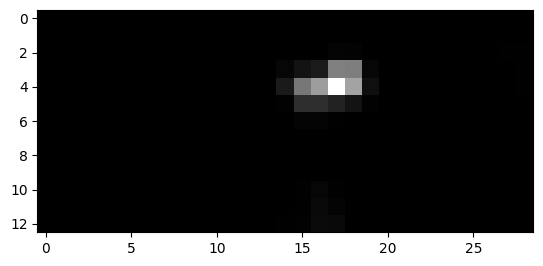

949


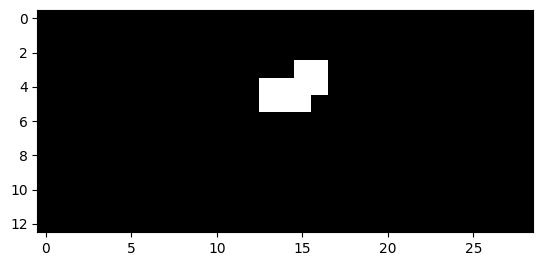

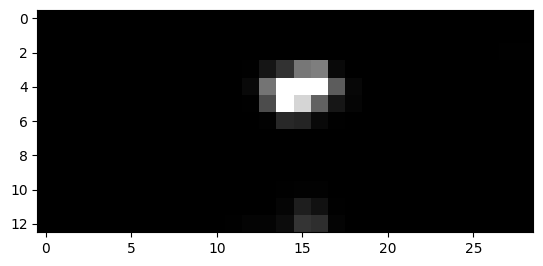

950


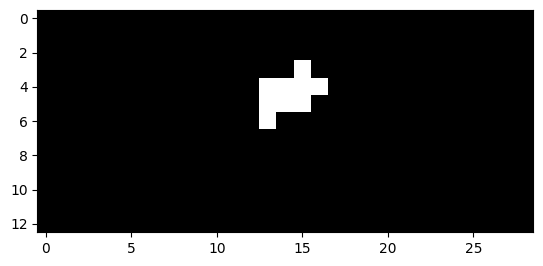

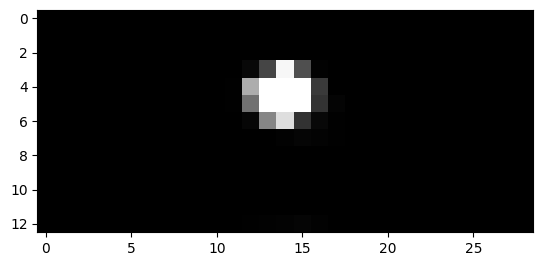

951


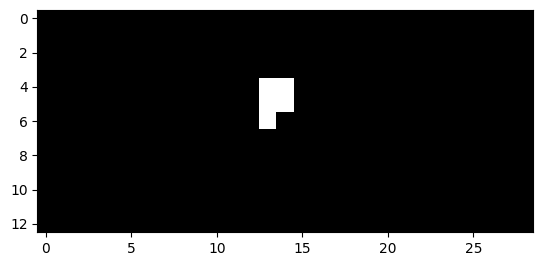

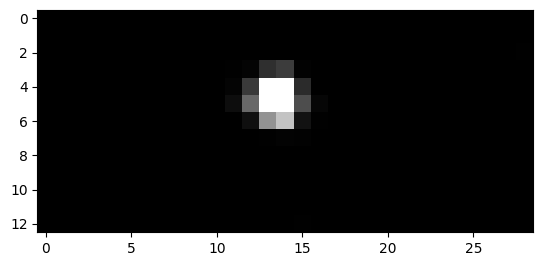

952


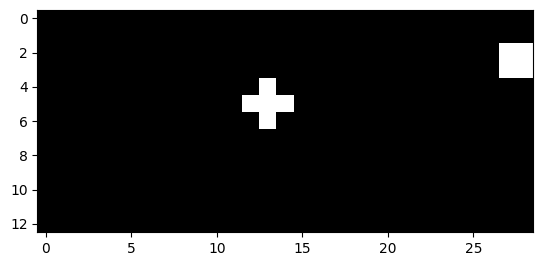

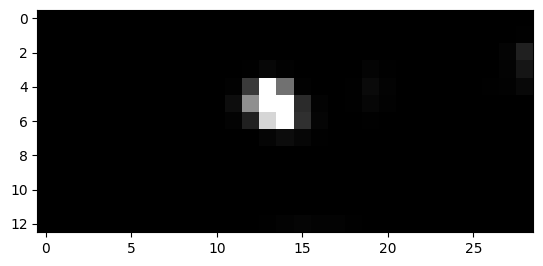

953


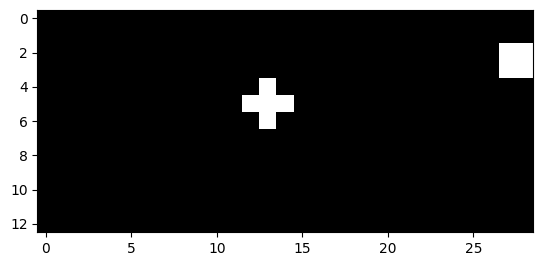

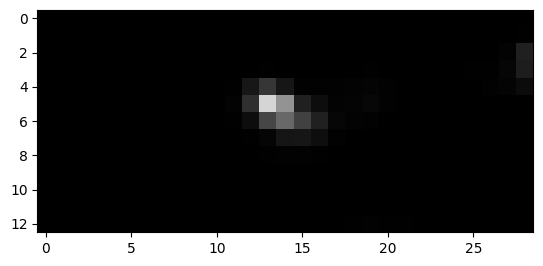

954


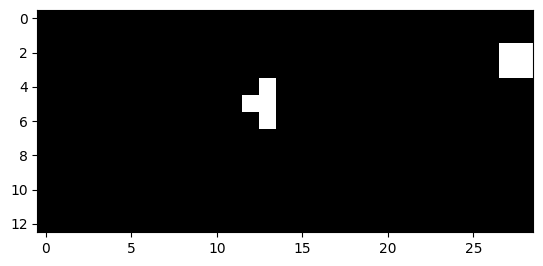

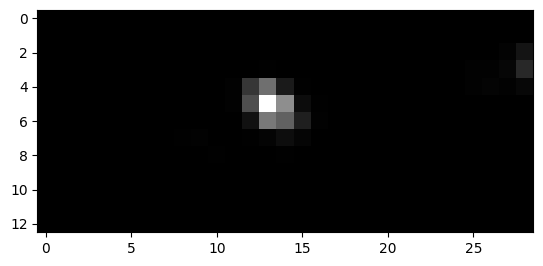

955


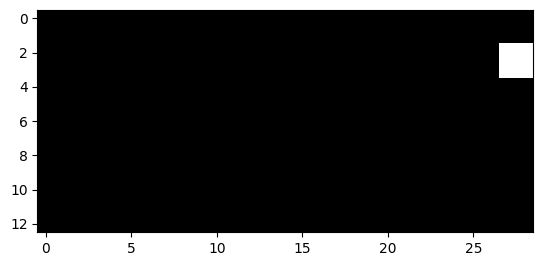

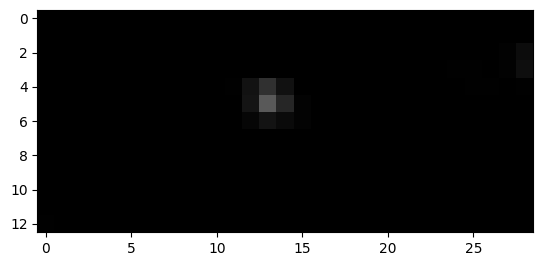

959


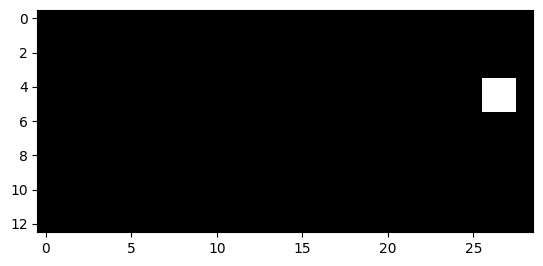

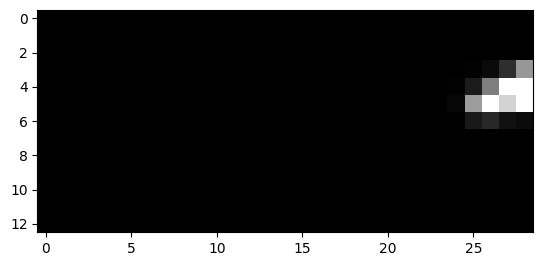

960


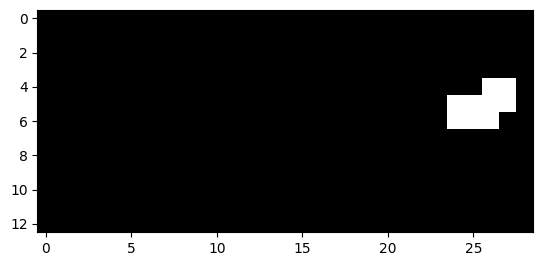

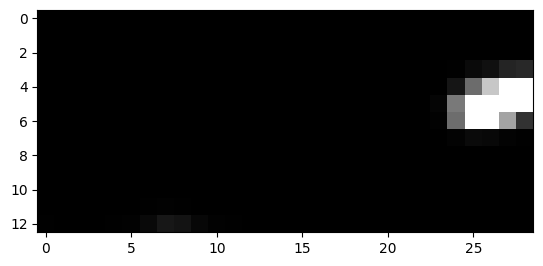

961


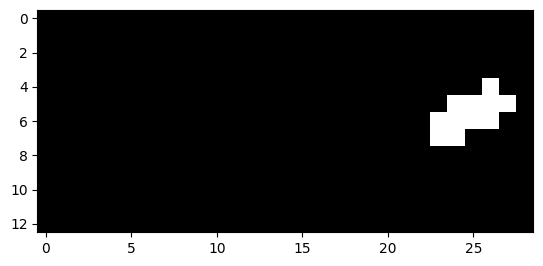

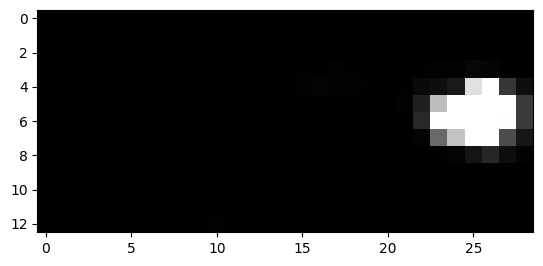

962


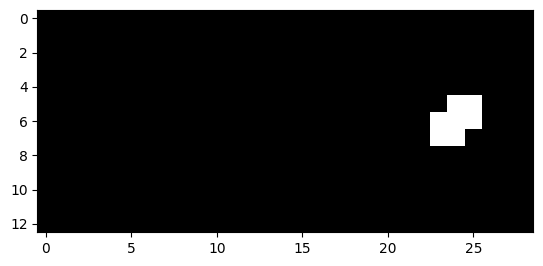

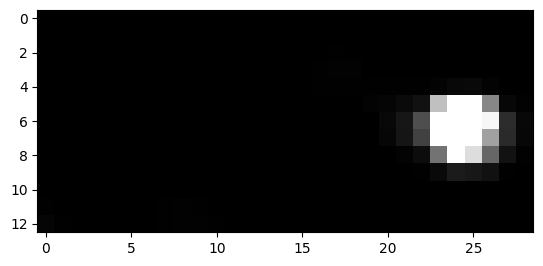

987


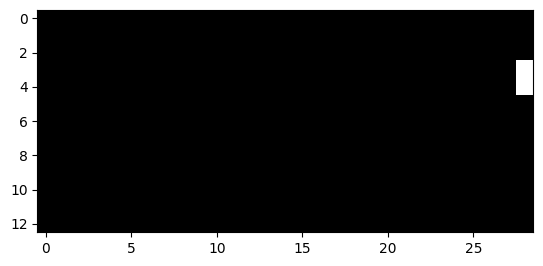

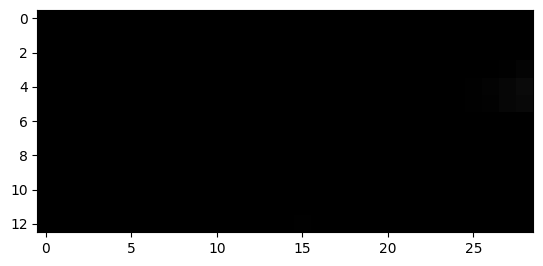

988


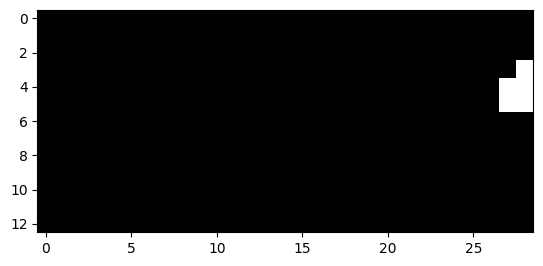

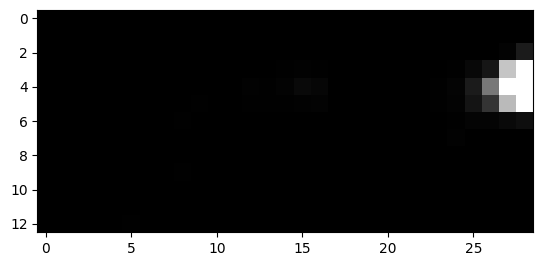

989


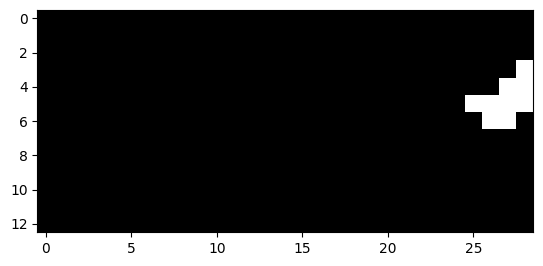

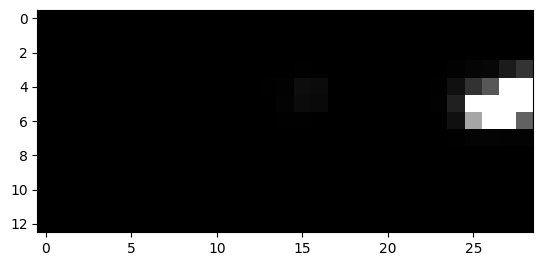

990


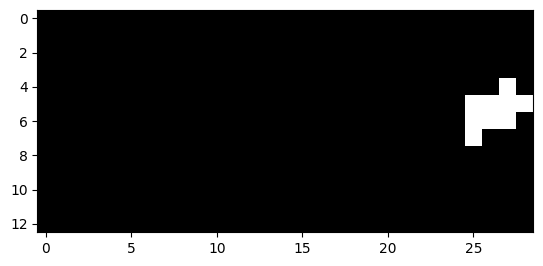

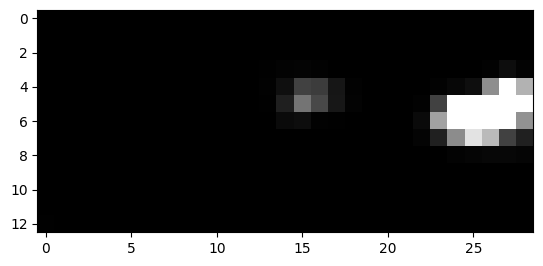

991


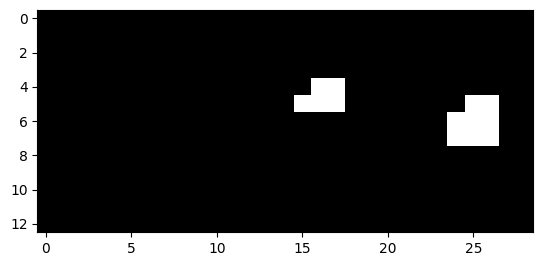

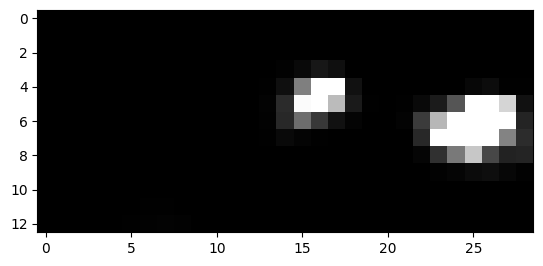

992


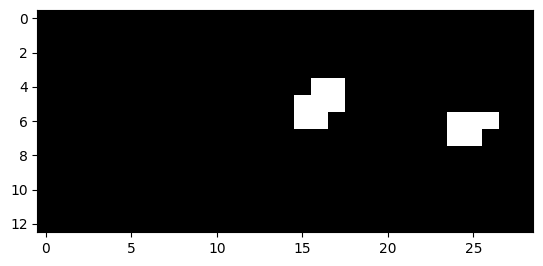

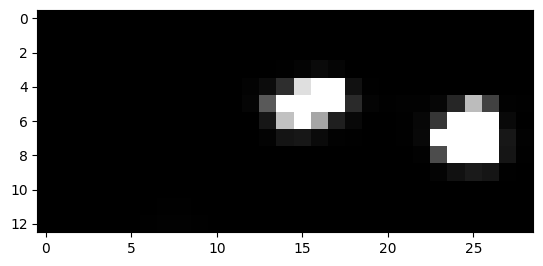

993


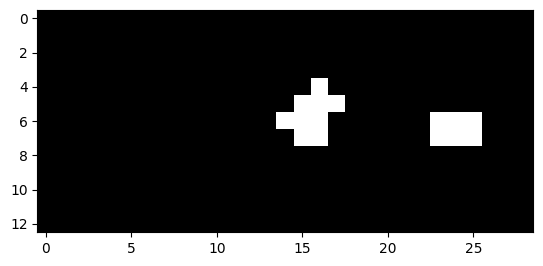

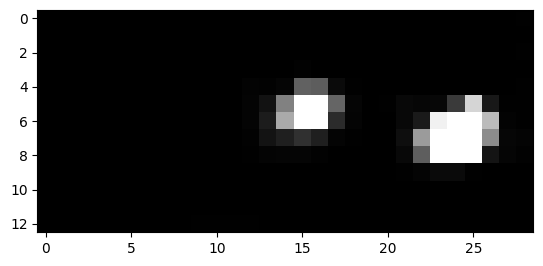

994


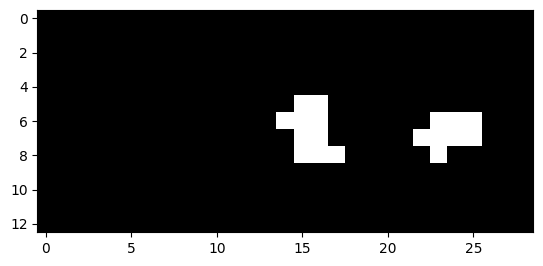

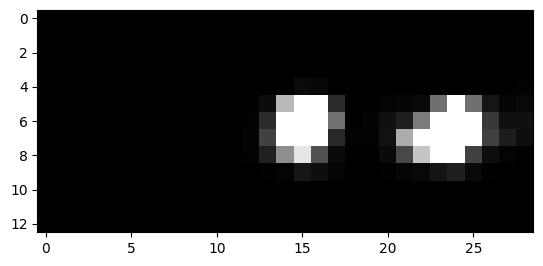

995


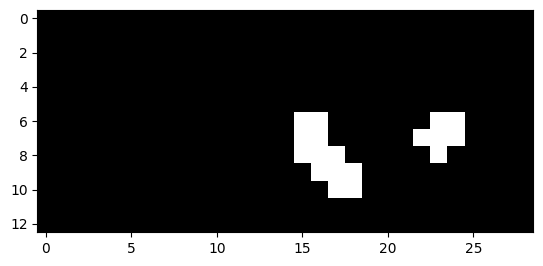

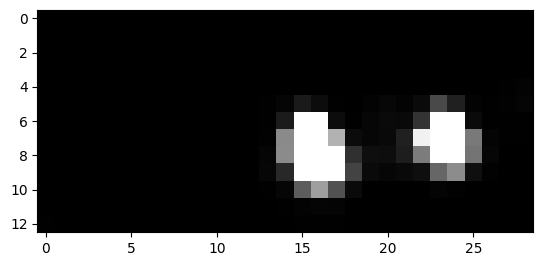

996


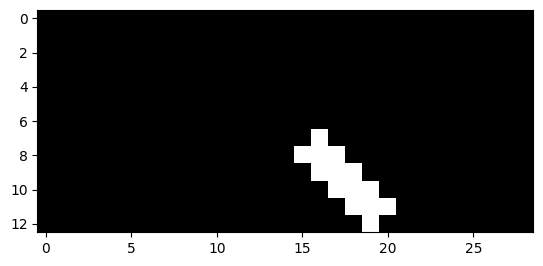

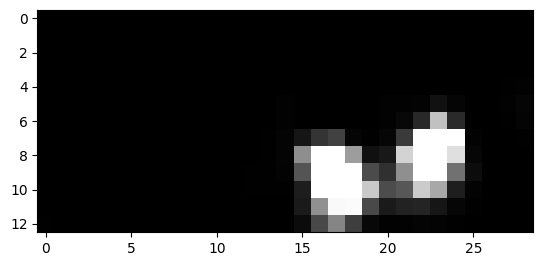

997


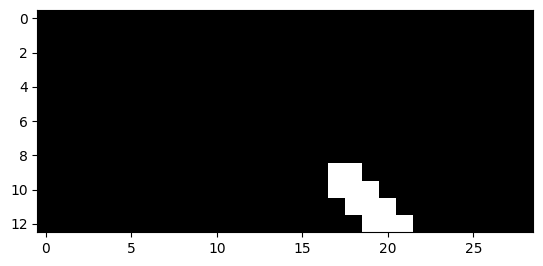

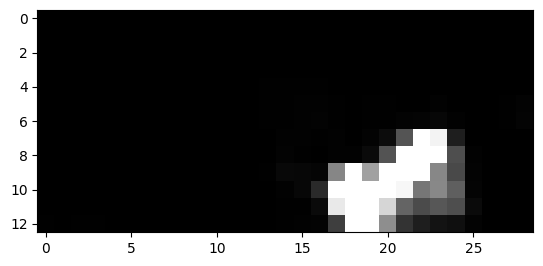

998


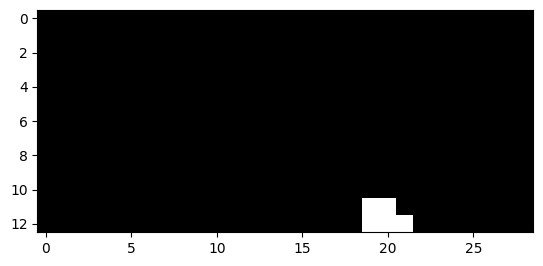

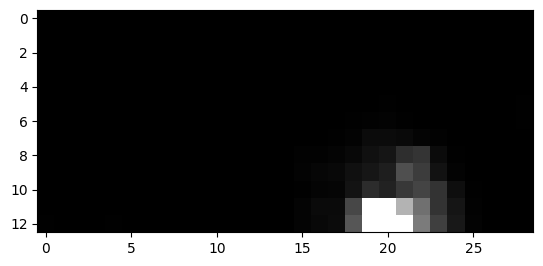

1023


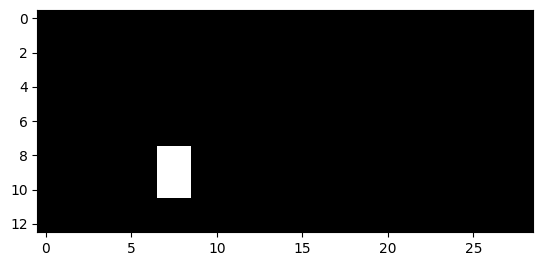

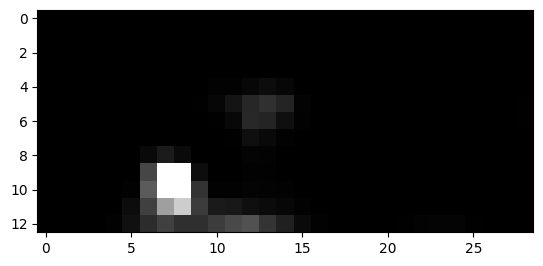

1024


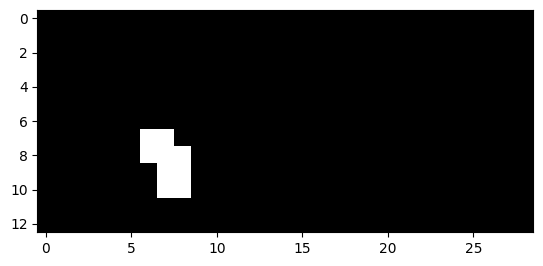

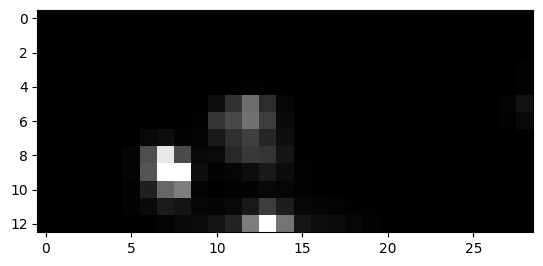

1025


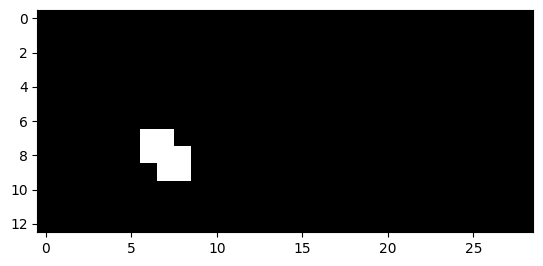

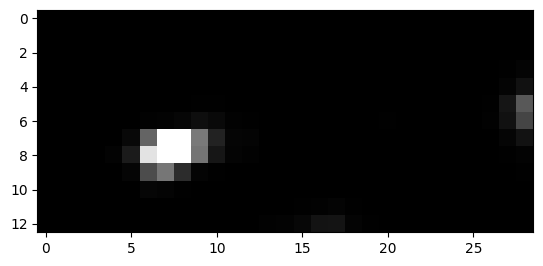

1027


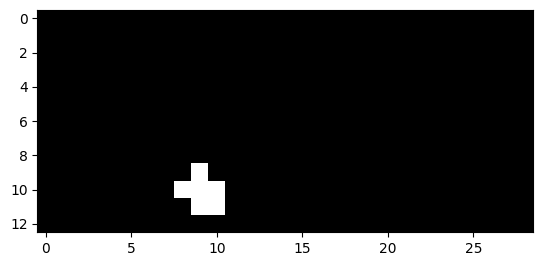

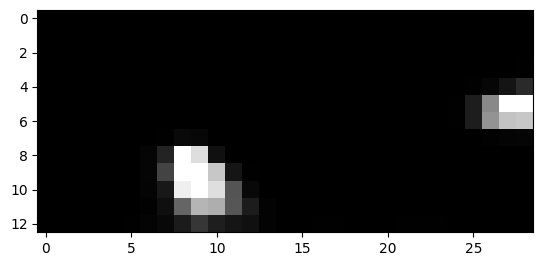

1028


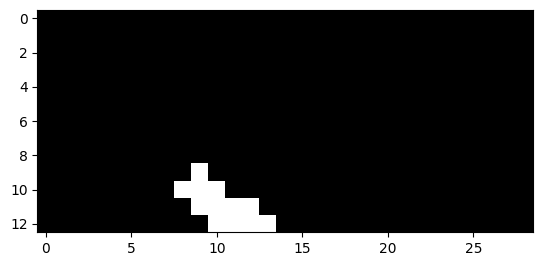

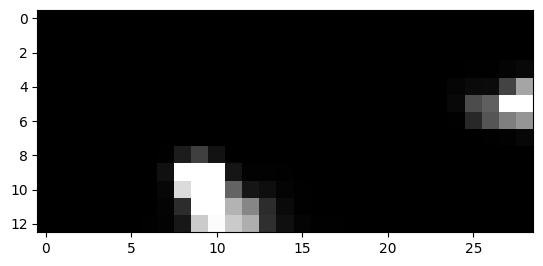

1029


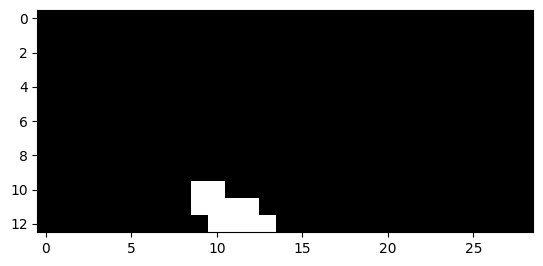

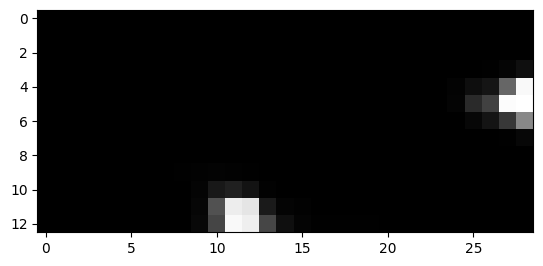

1039


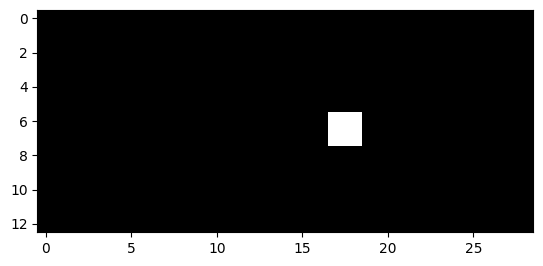

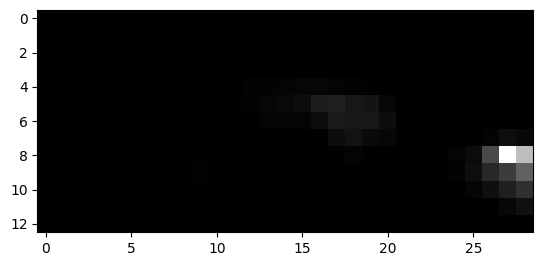

1040


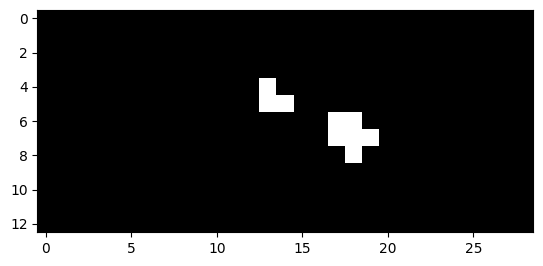

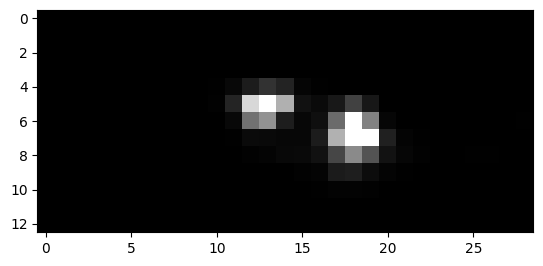

1041


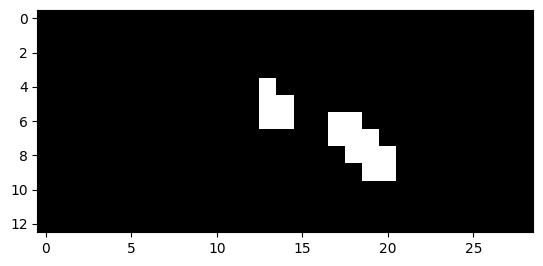

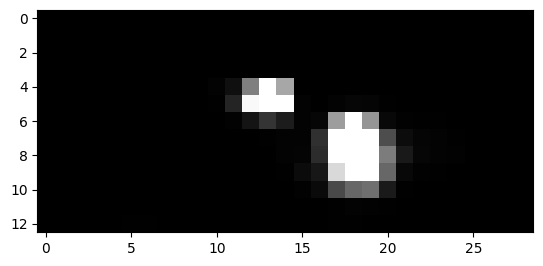

1042


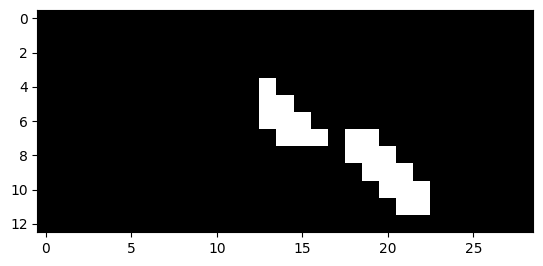

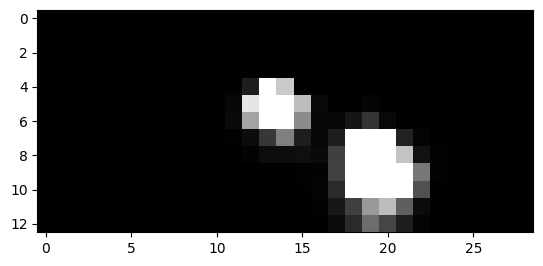

1043


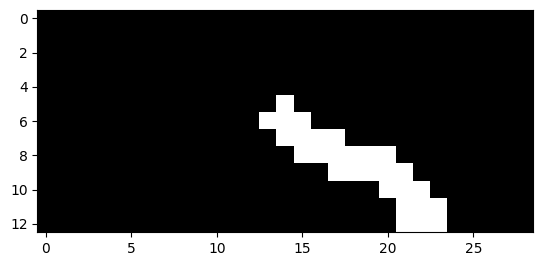

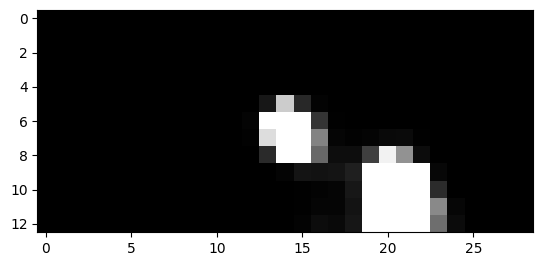

1044


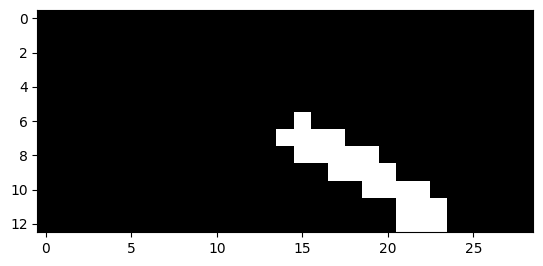

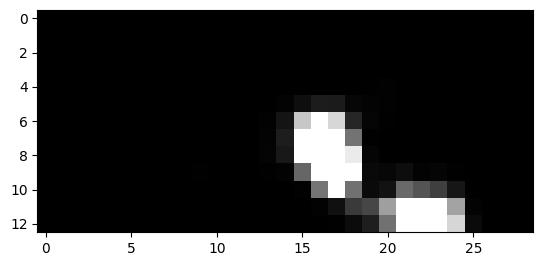

1045


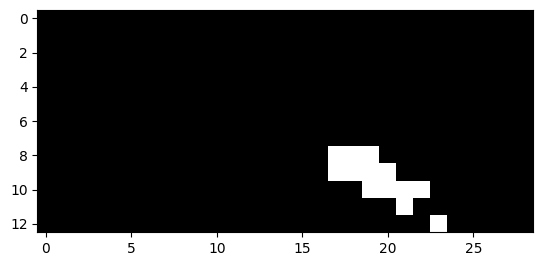

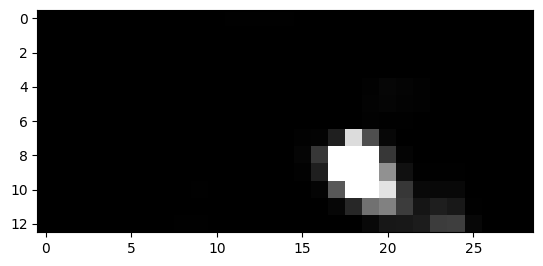

1046


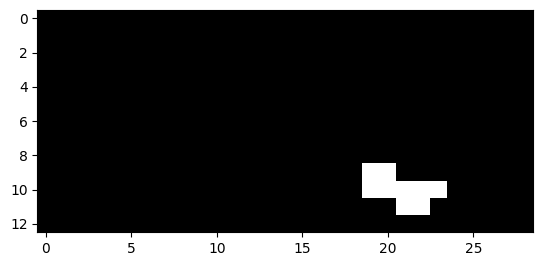

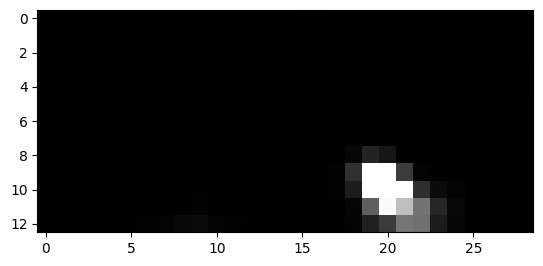

1047


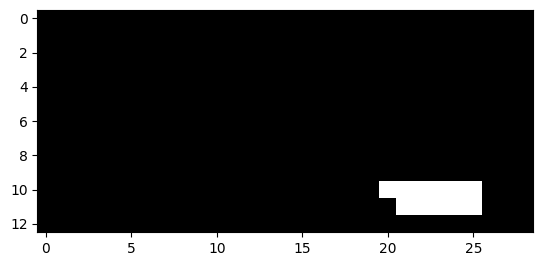

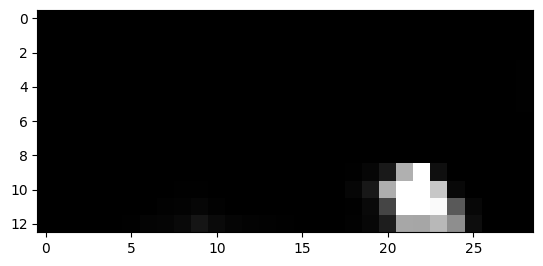

1048


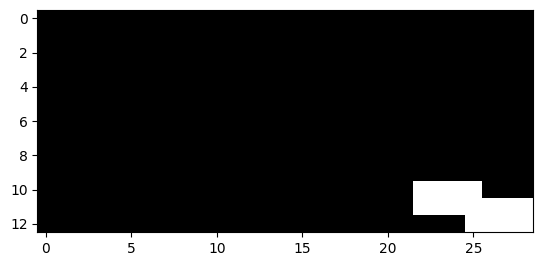

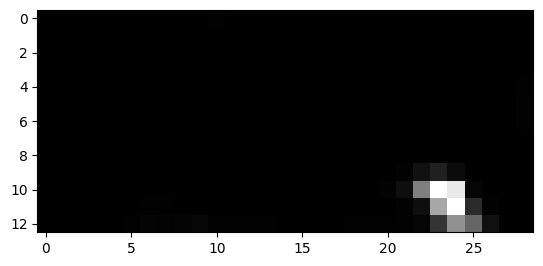

1049


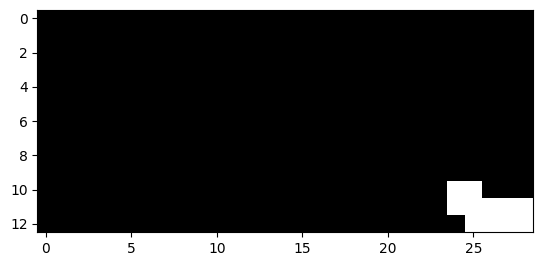

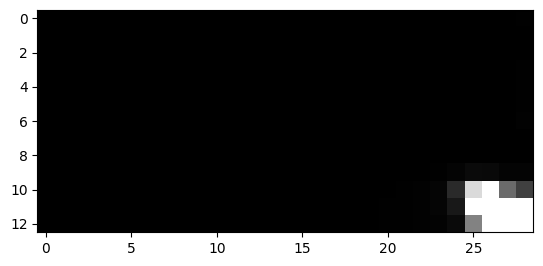

1050


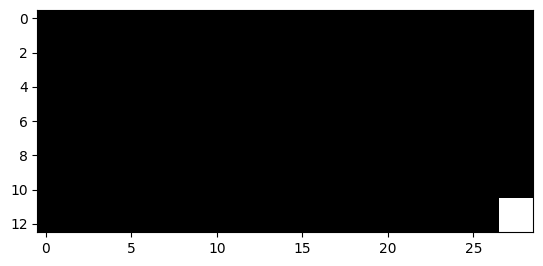

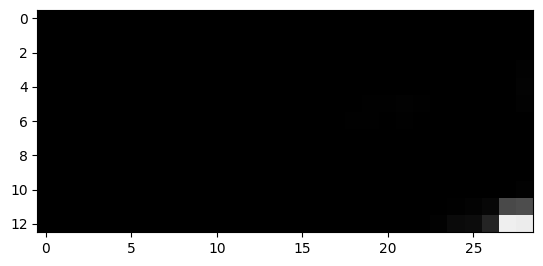

1064


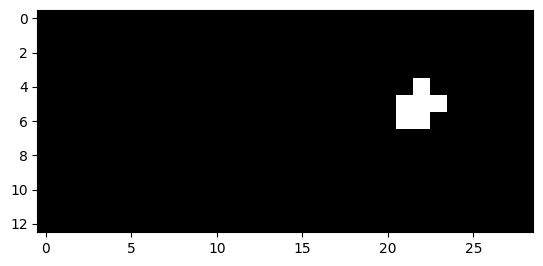

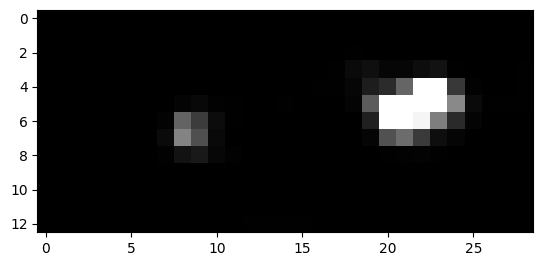

1065


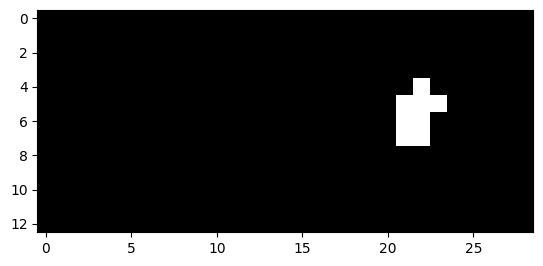

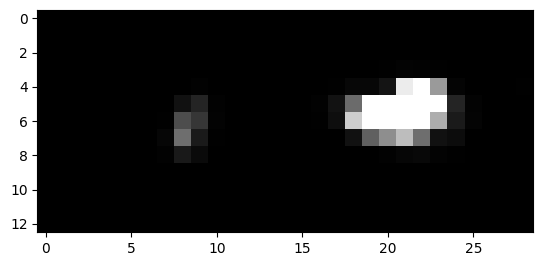

1066


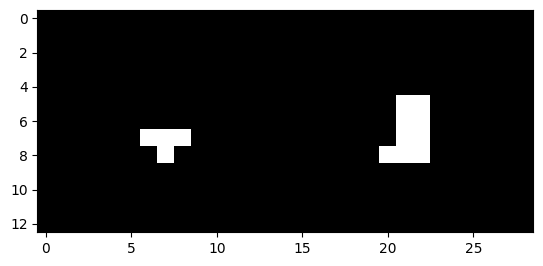

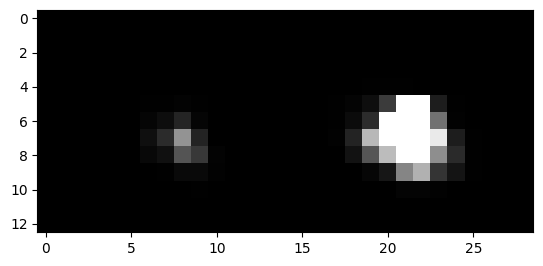

1067


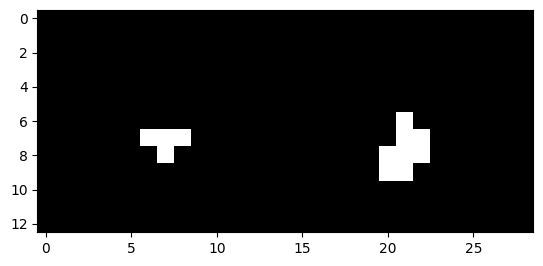

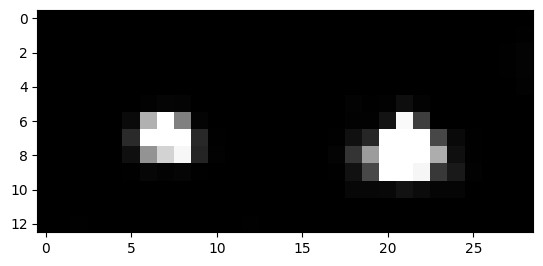

1068


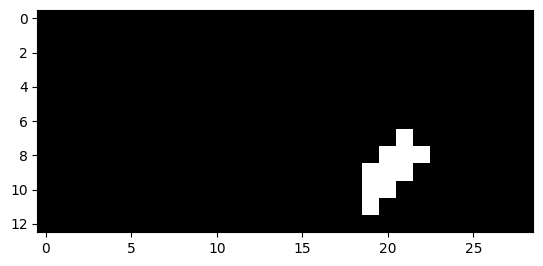

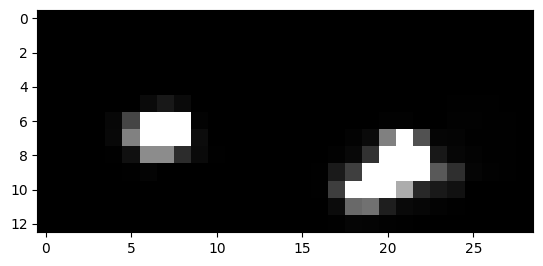

1069


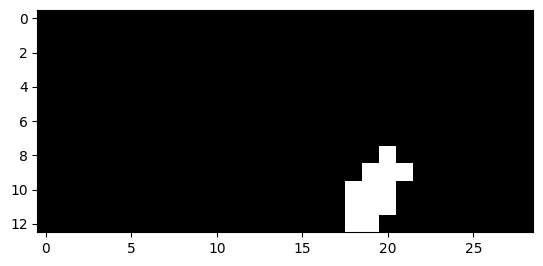

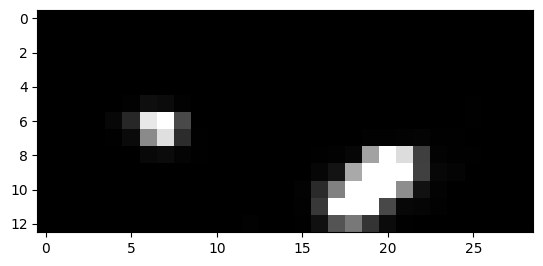

1070


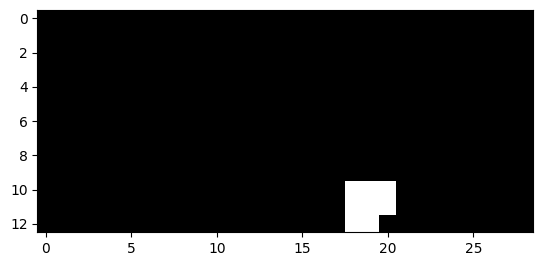

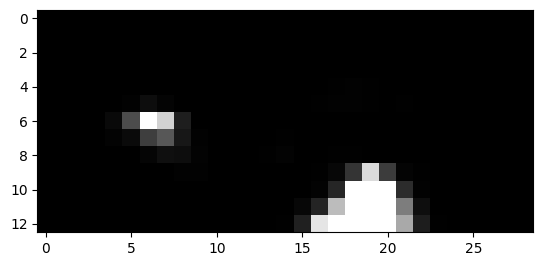

1071


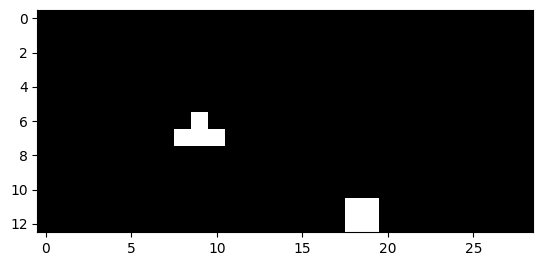

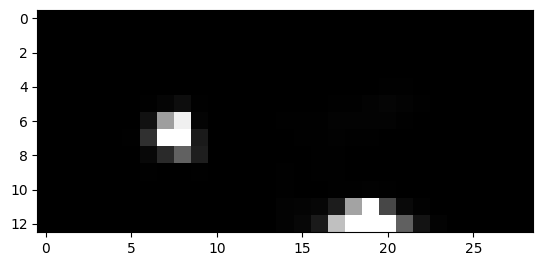

1072


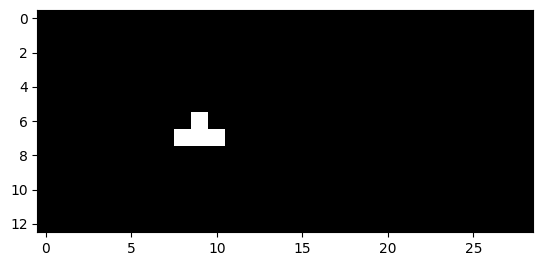

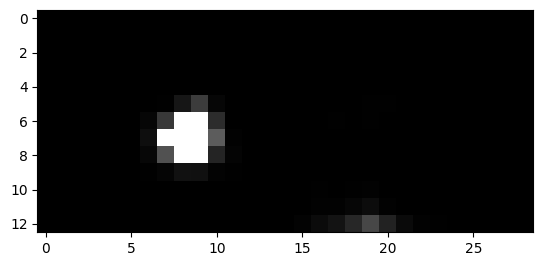

1073


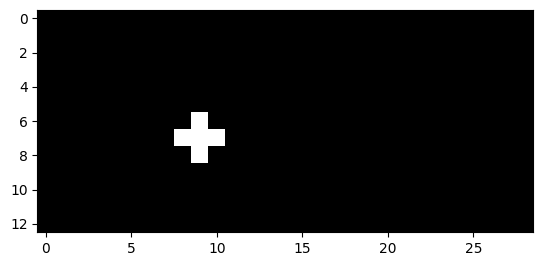

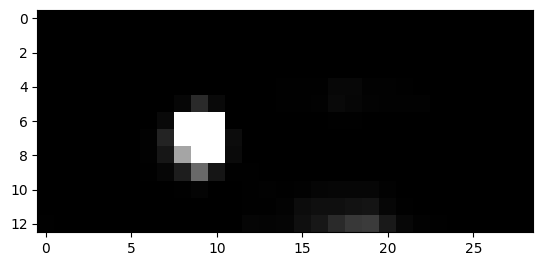

1074


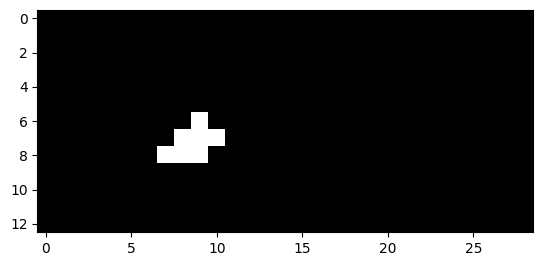

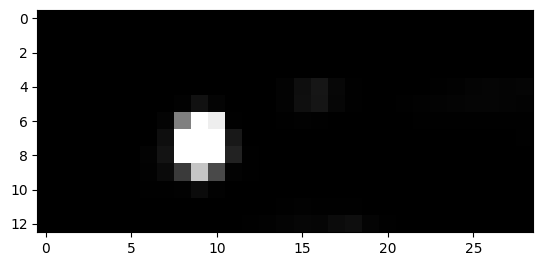

1075


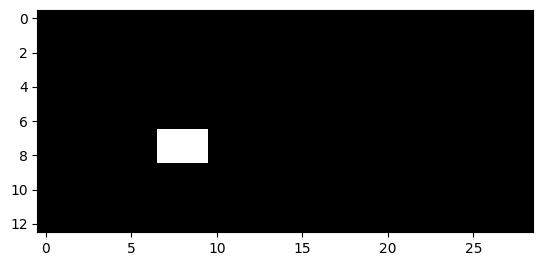

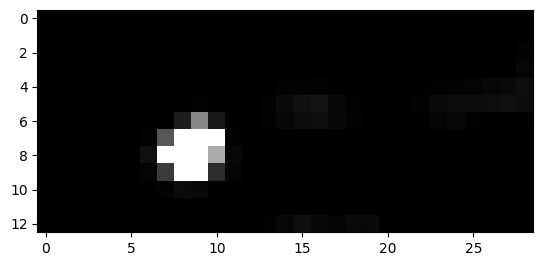

1076


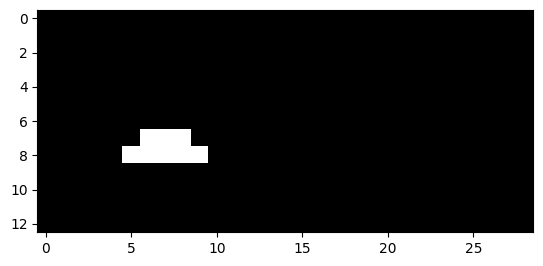

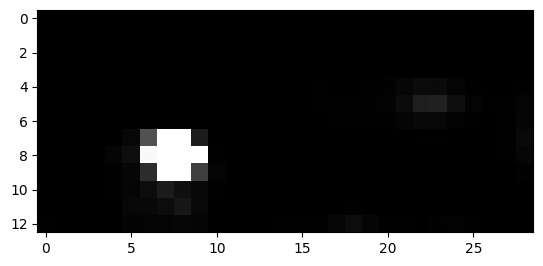

1077


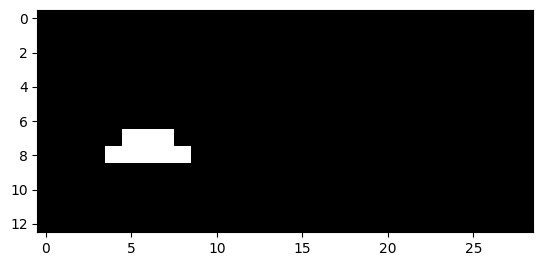

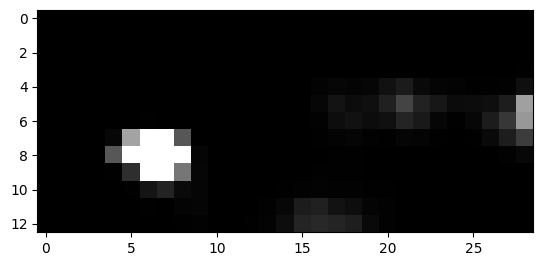

1078


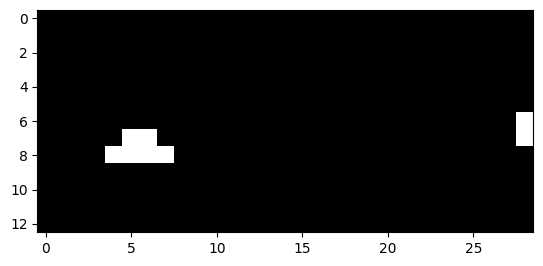

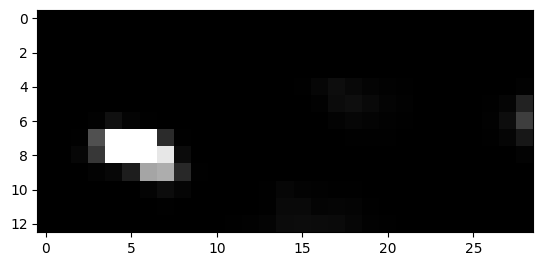

1079


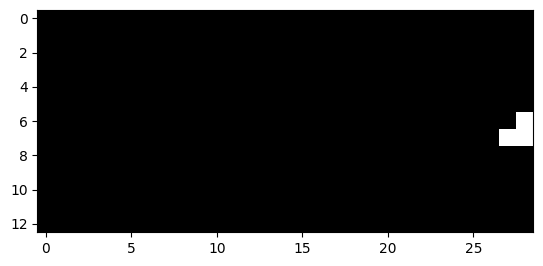

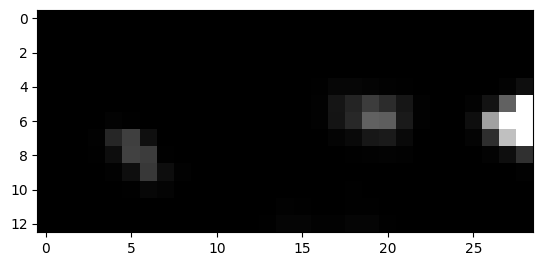

1080


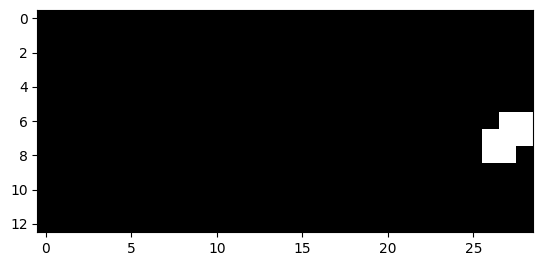

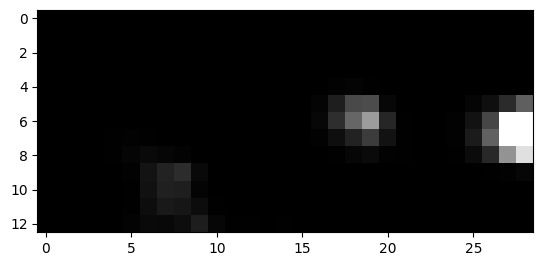

1081


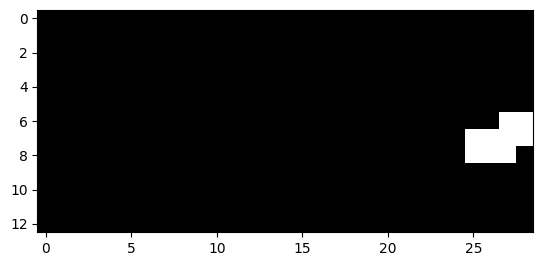

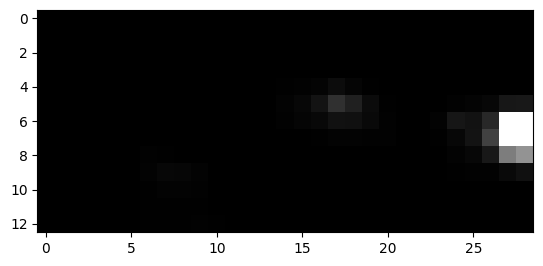

1082


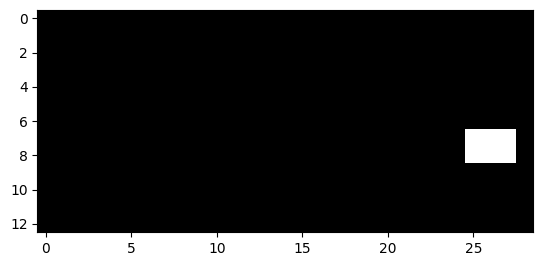

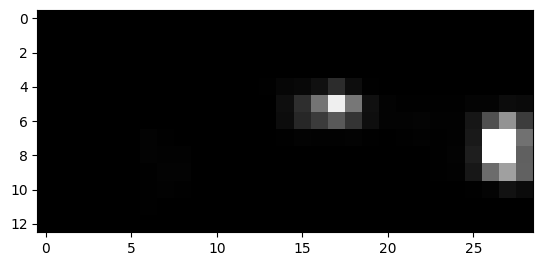

1083


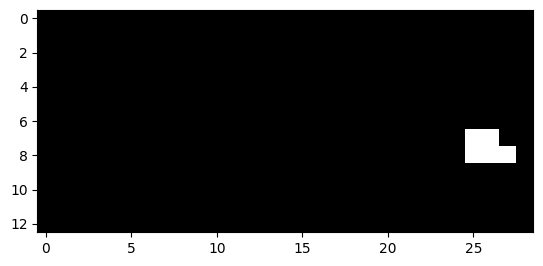

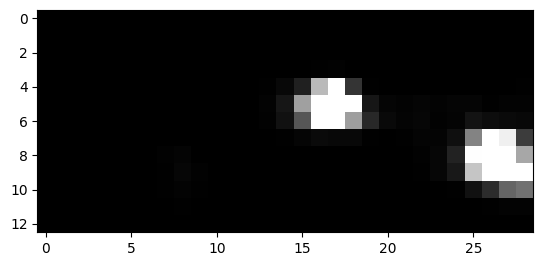

1084


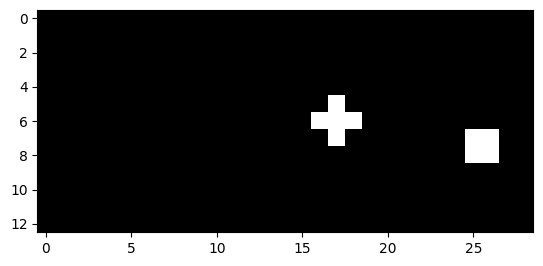

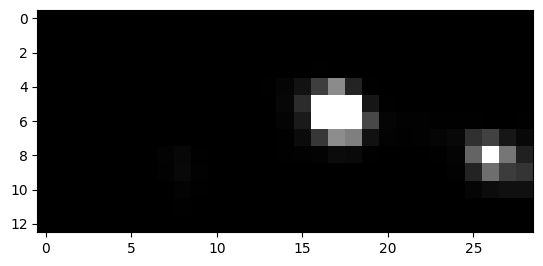

1085


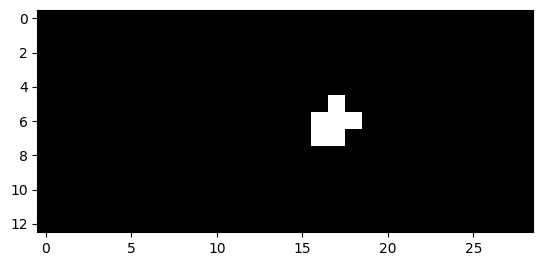

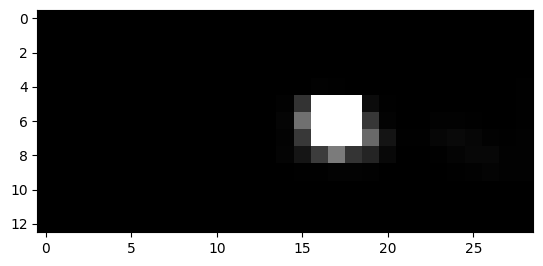

1086


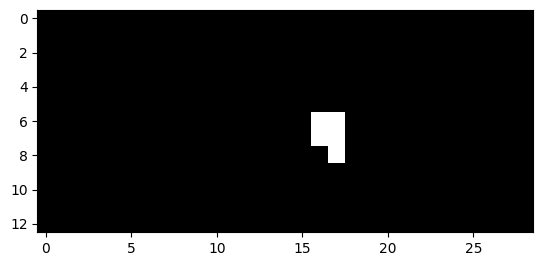

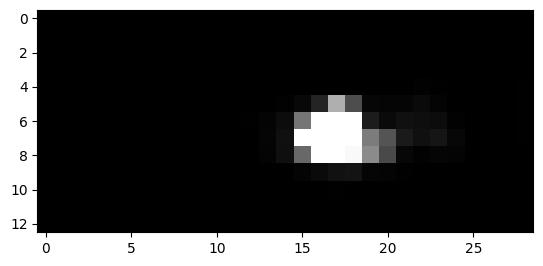

1087


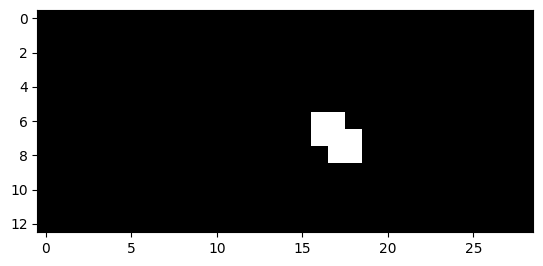

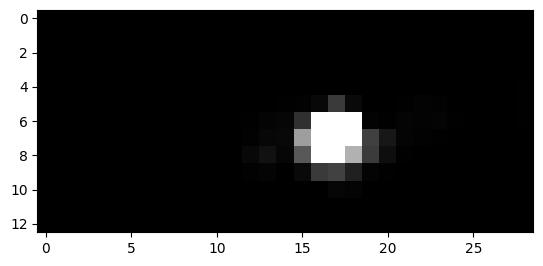

1088


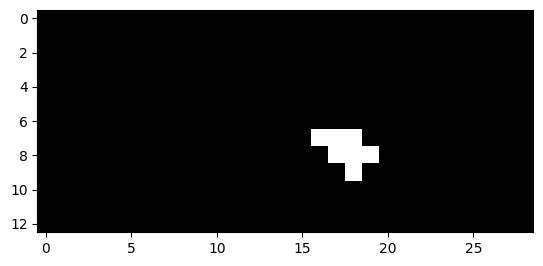

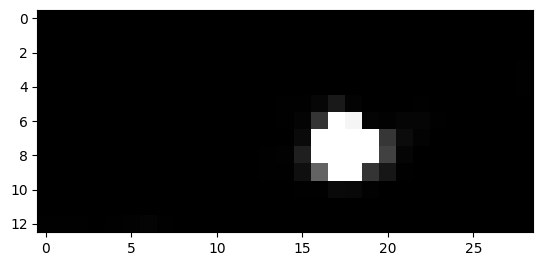

1089


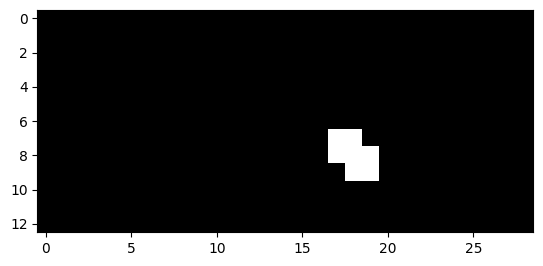

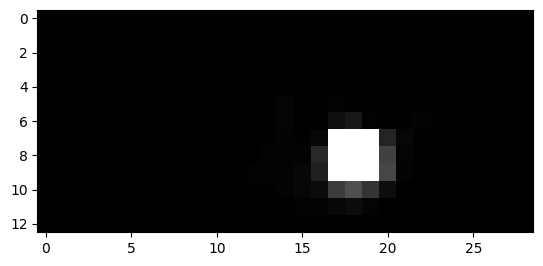

1090


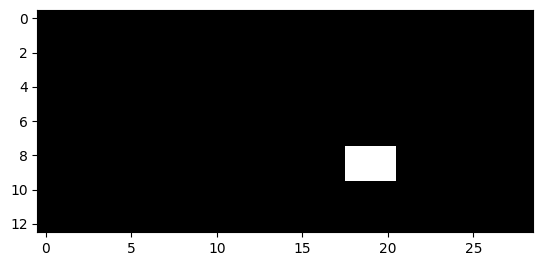

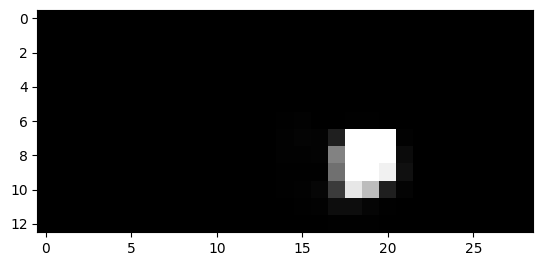

1091


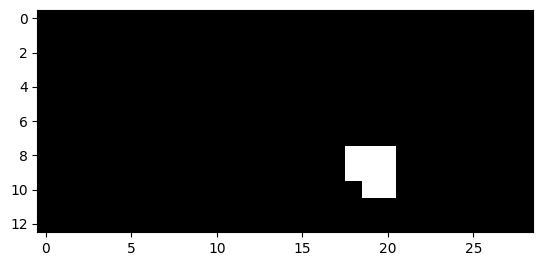

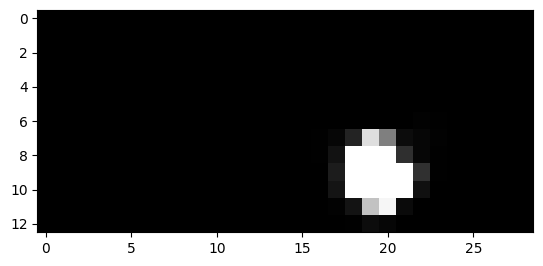

1092


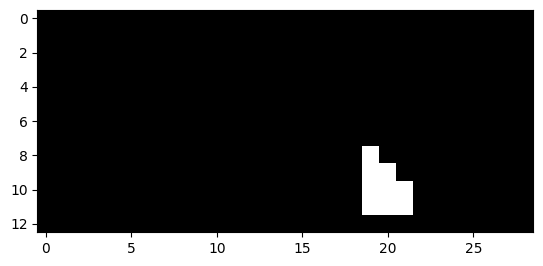

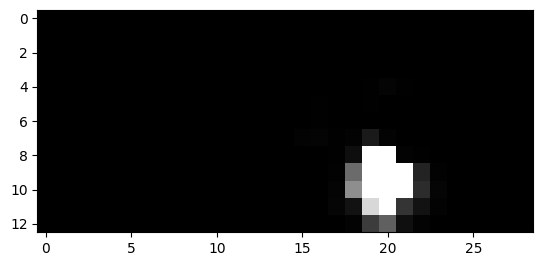

1093


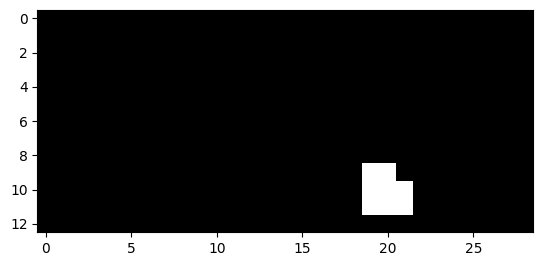

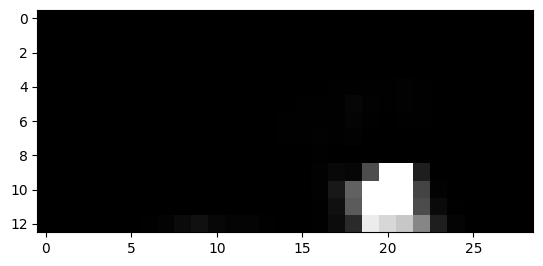

1094


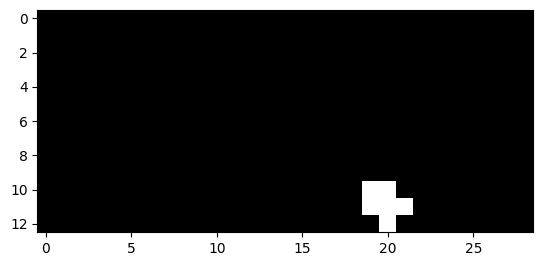

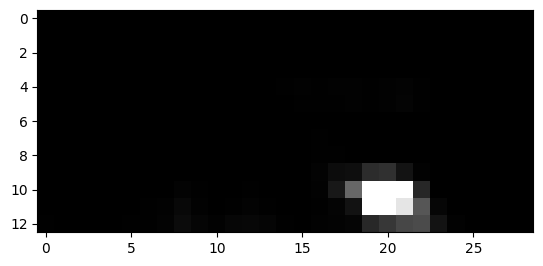

1095


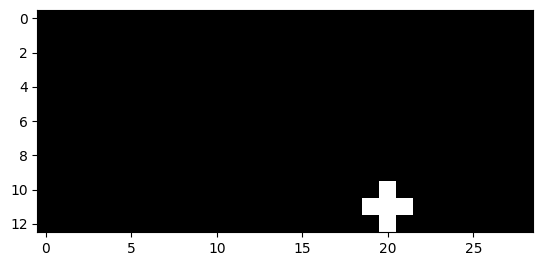

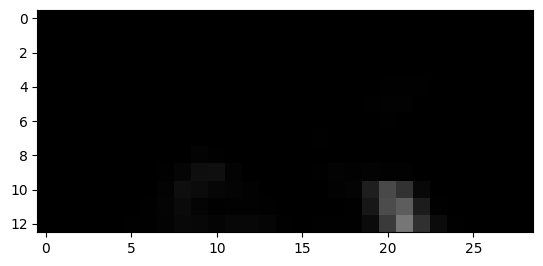

1116


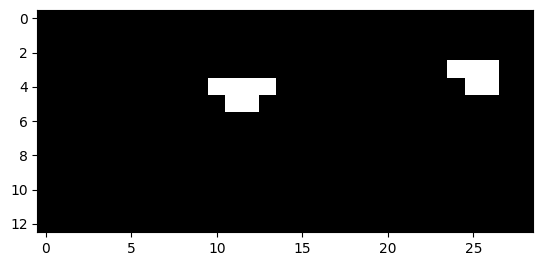

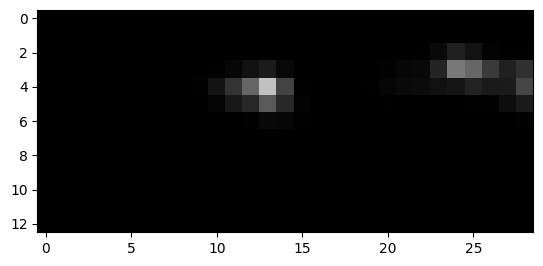

1117


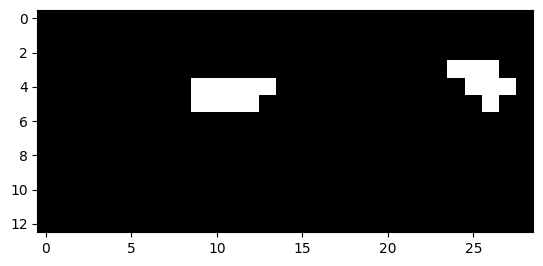

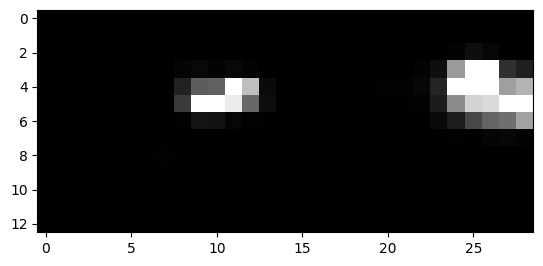

1118


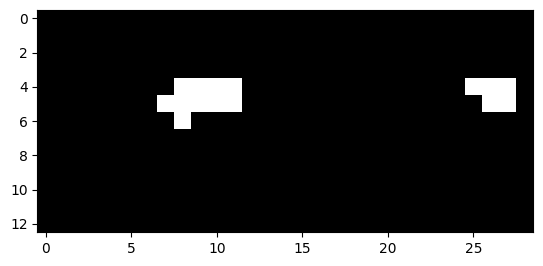

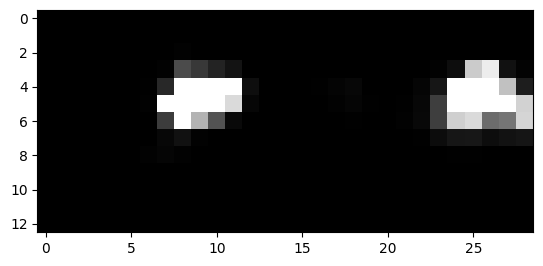

1119


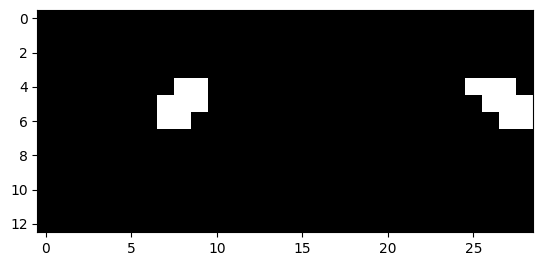

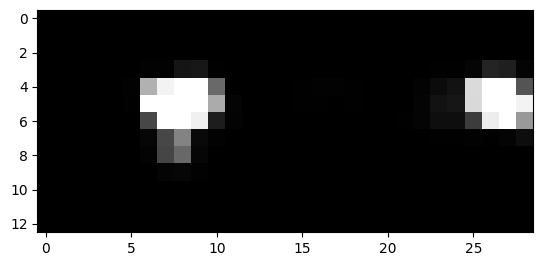

1120


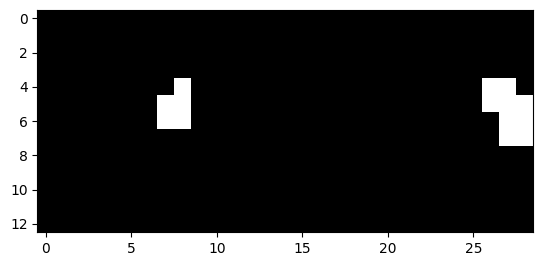

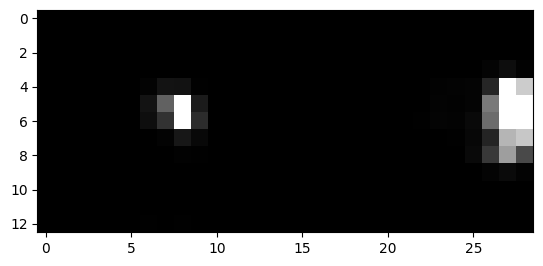

1121


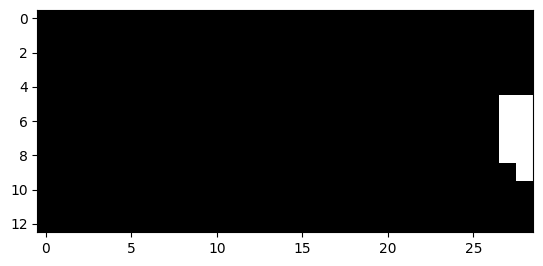

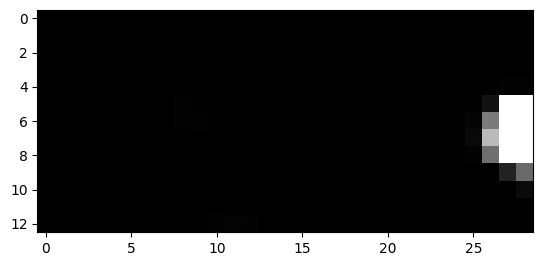

1122


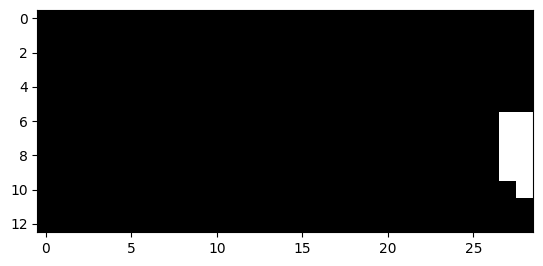

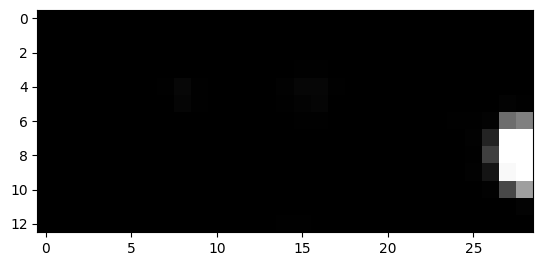

1123


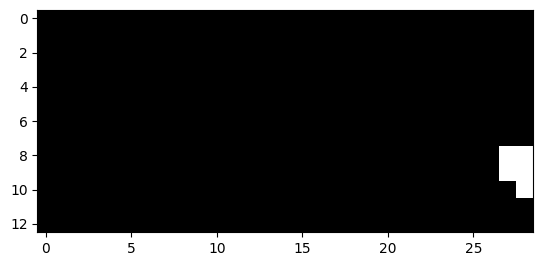

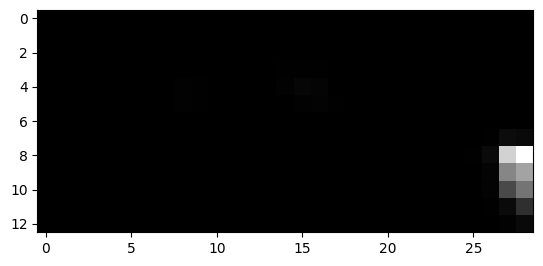

1341


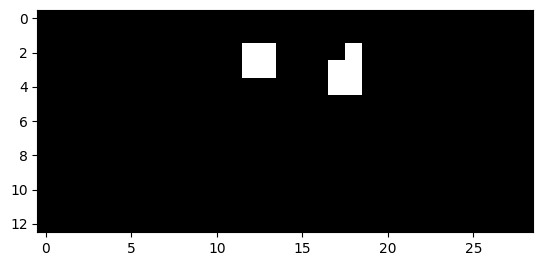

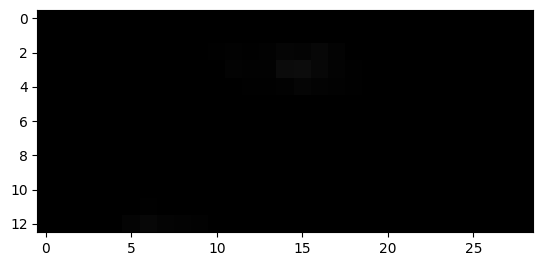

1342


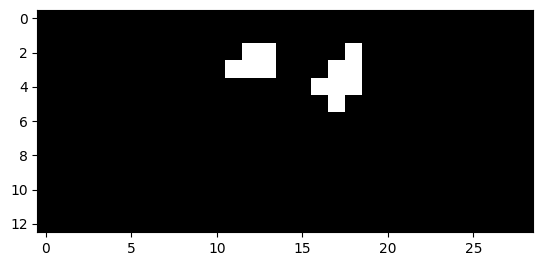

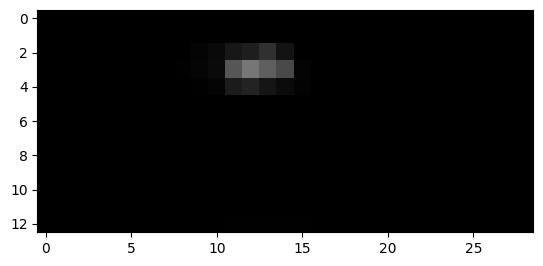

1343


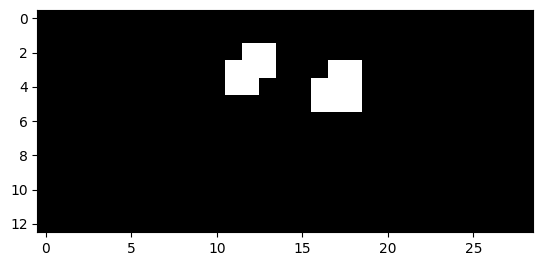

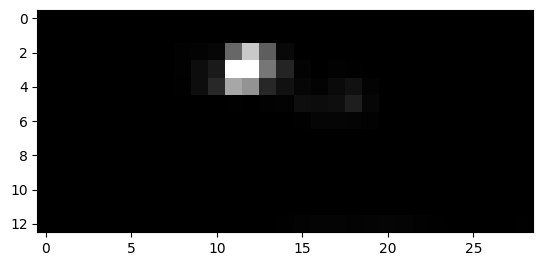

1344


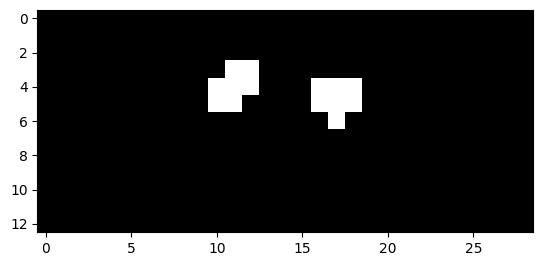

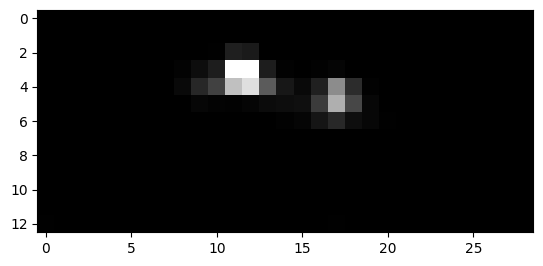

1345


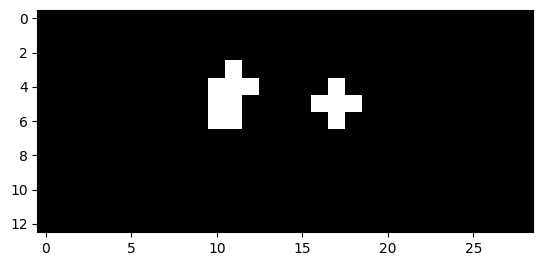

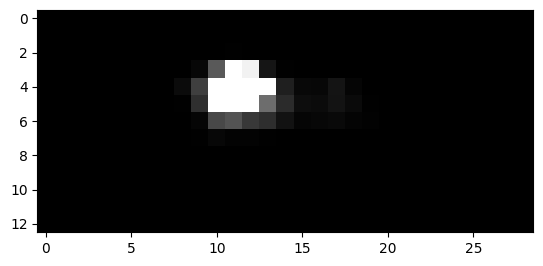

1346


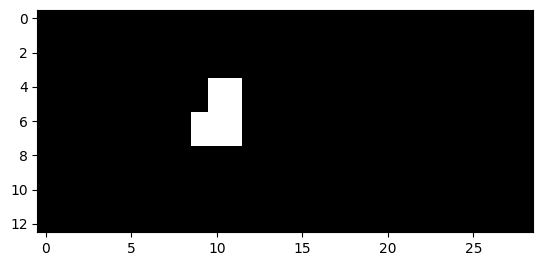

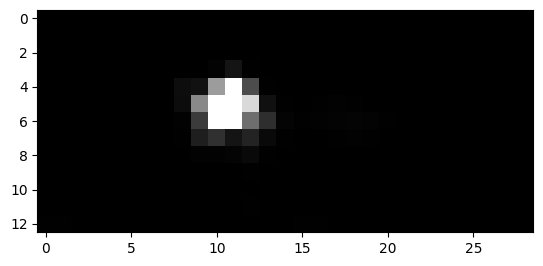

1347


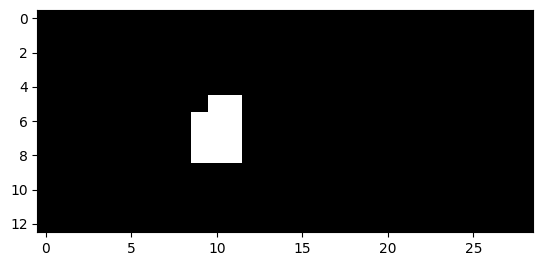

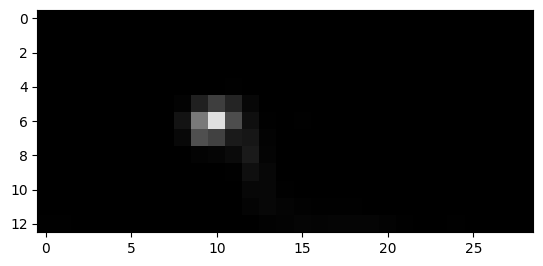

1348


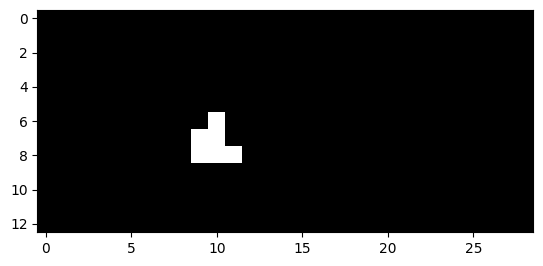

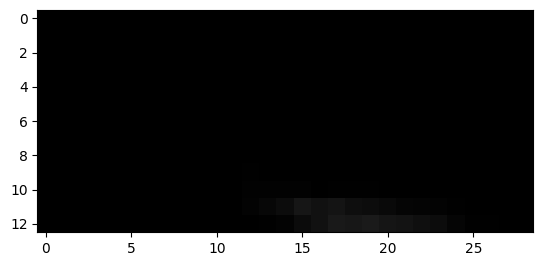

1366


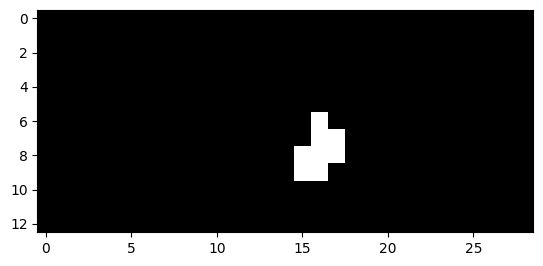

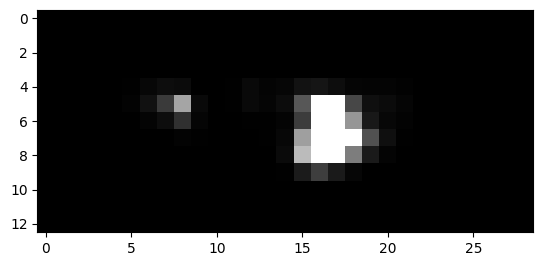

1367


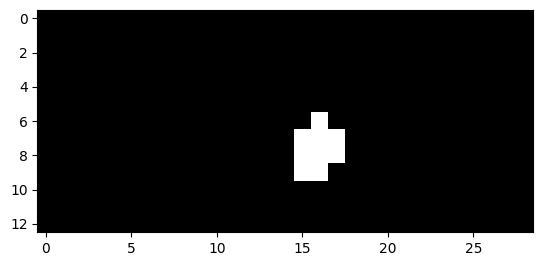

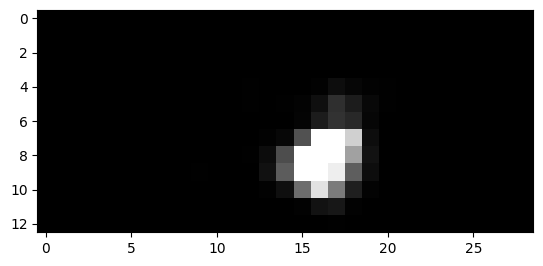

1368


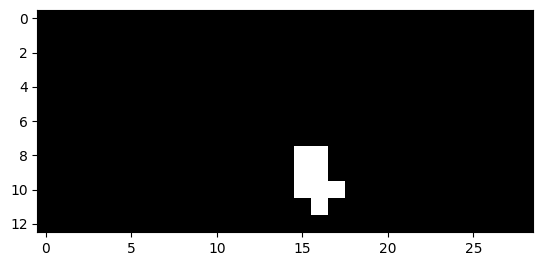

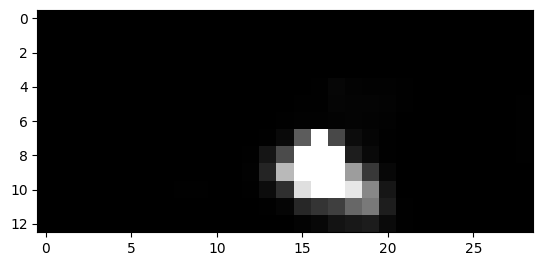

1369


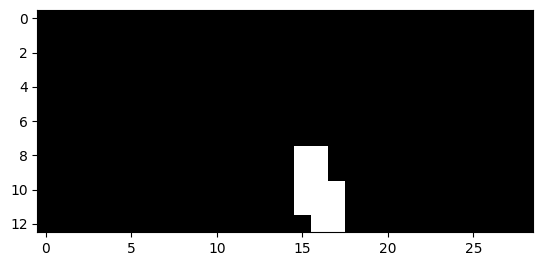

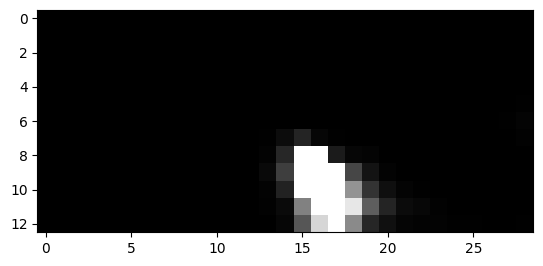

1370


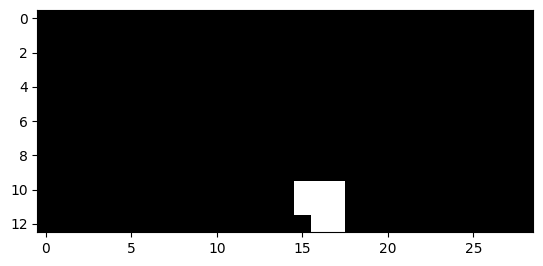

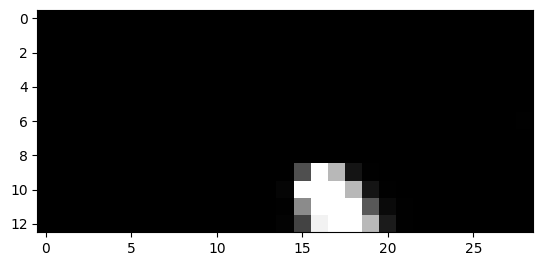

1371


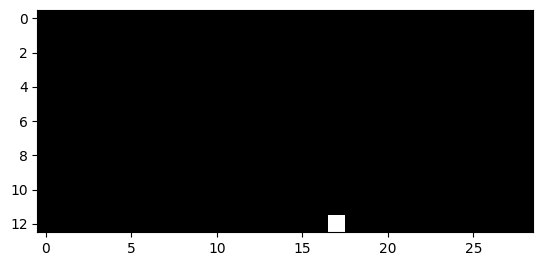

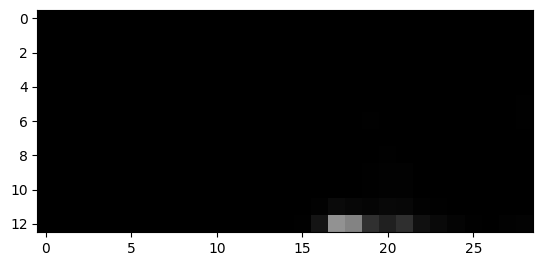

1389


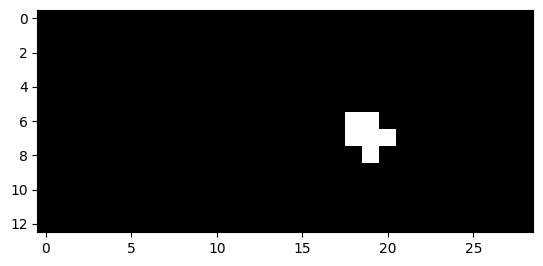

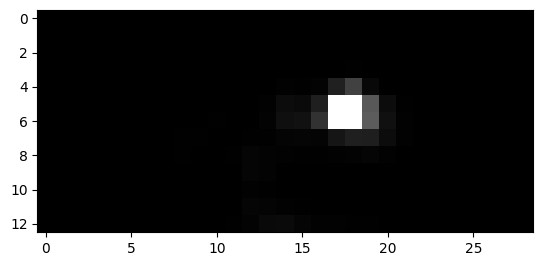

1390


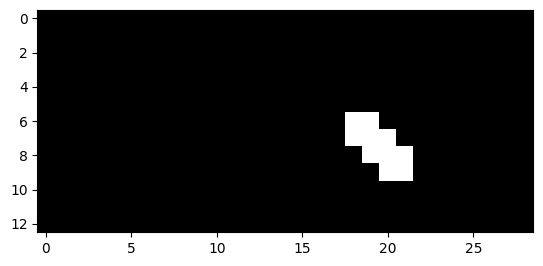

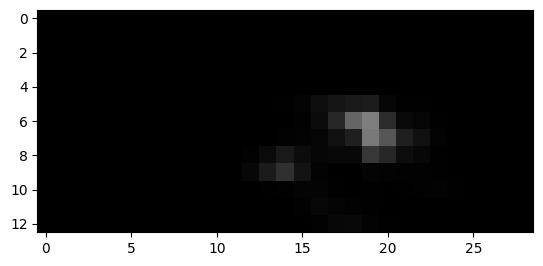

1391


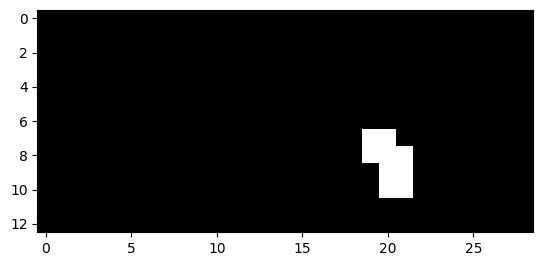

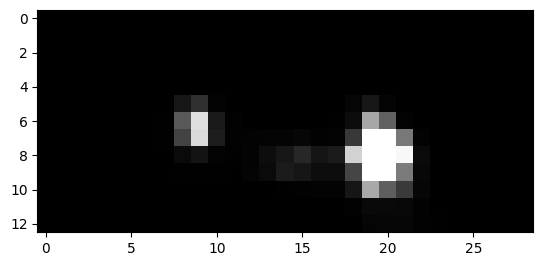

1392


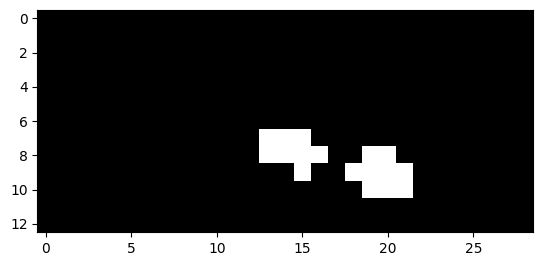

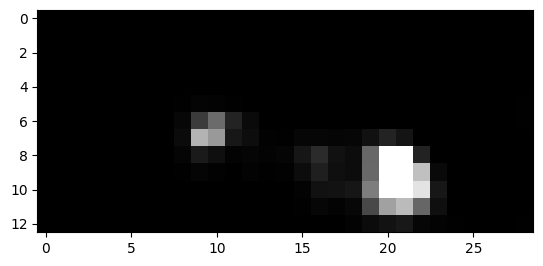

1393


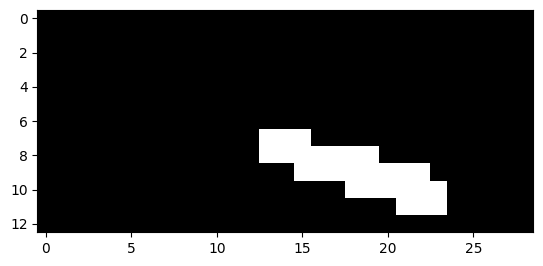

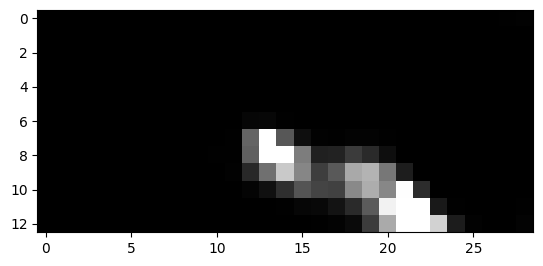

1394


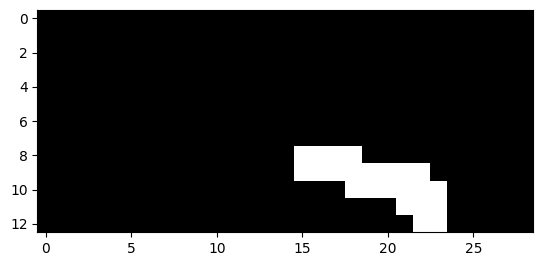

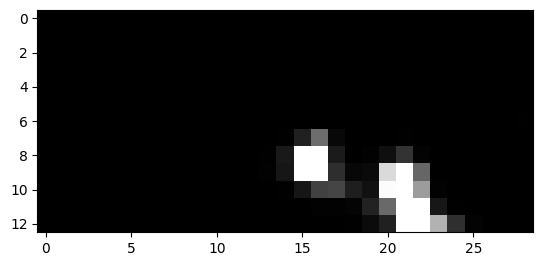

1395


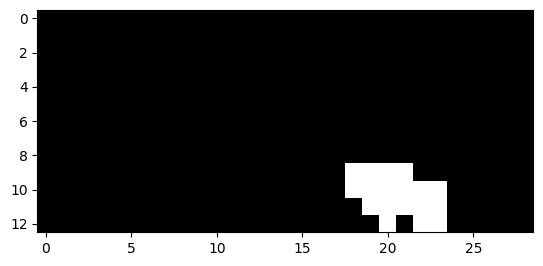

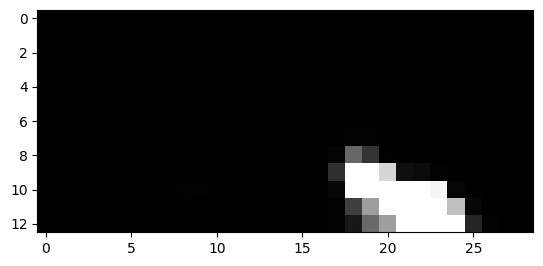

1396


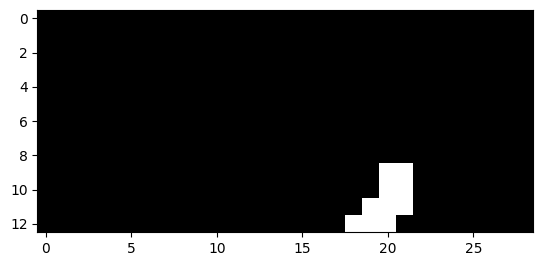

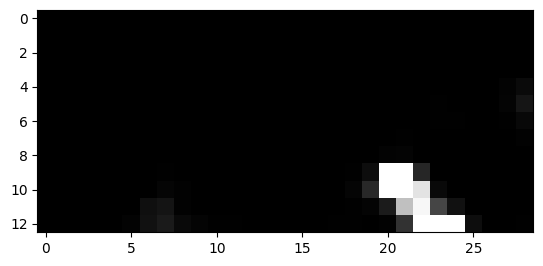

1397


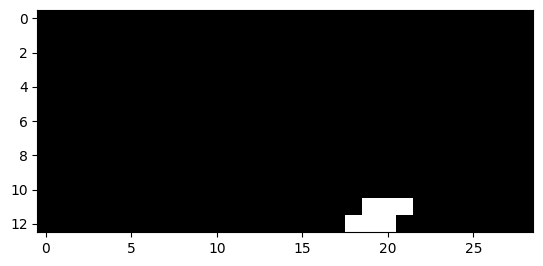

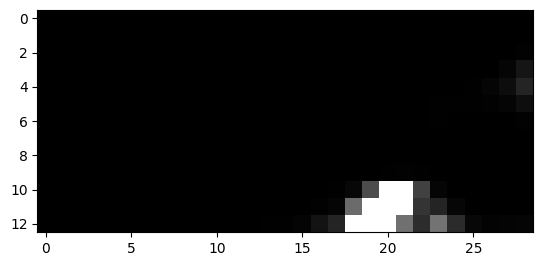

1398


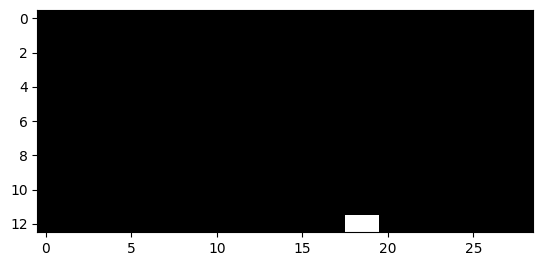

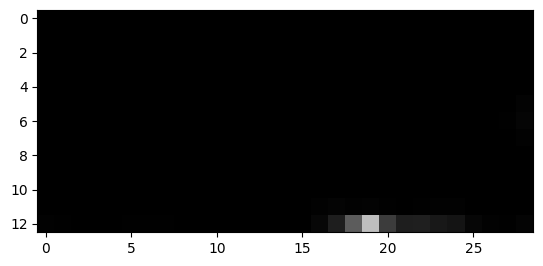

1403


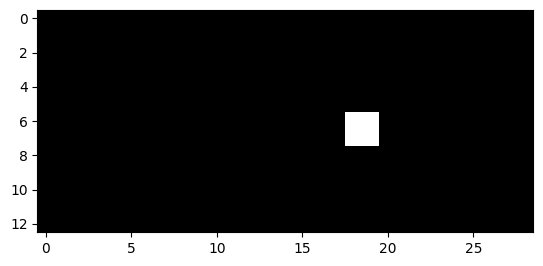

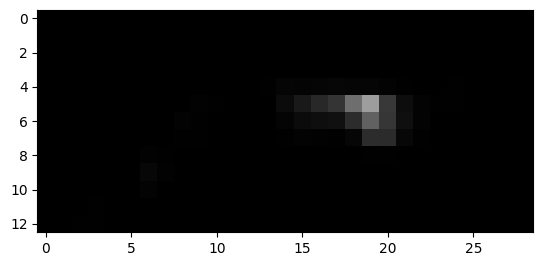

1404


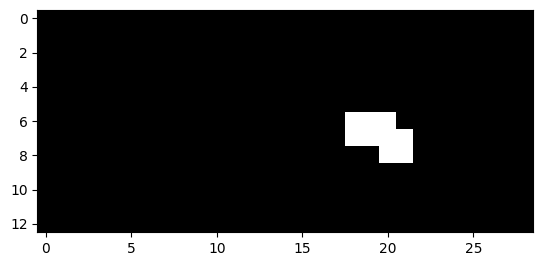

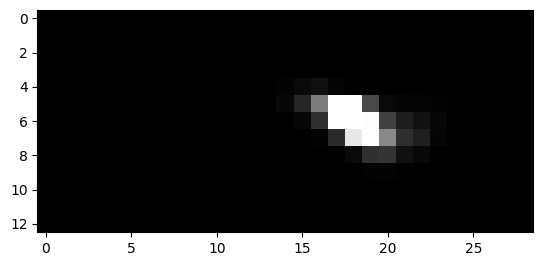

1405


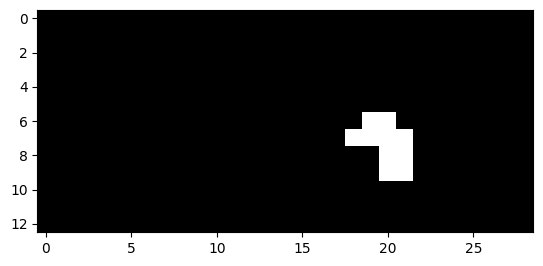

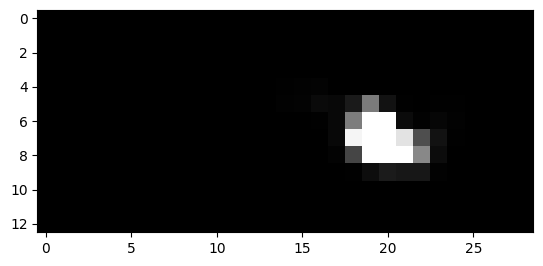

1406


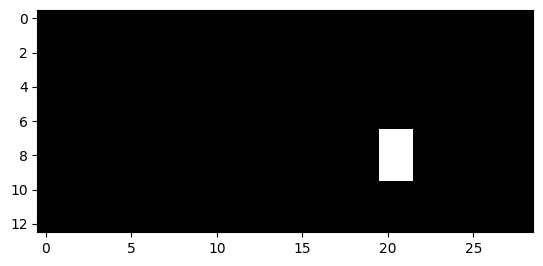

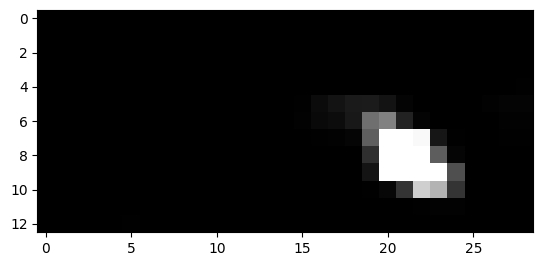

1407


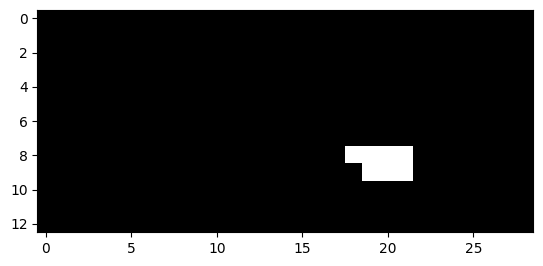

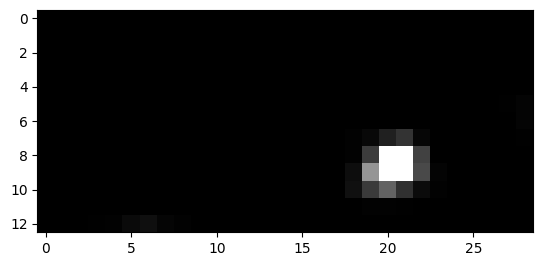

1408


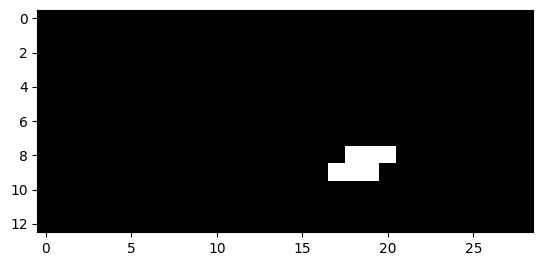

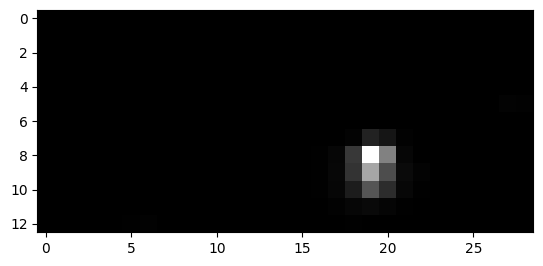

1409


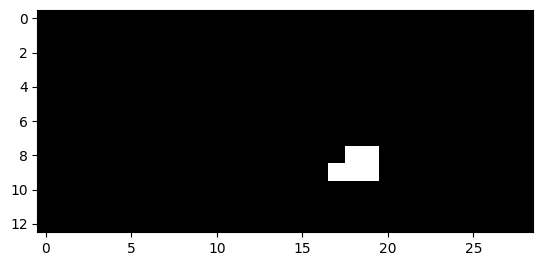

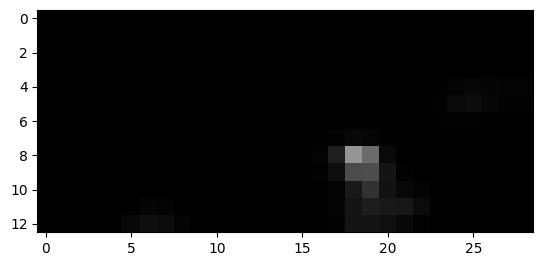

1412


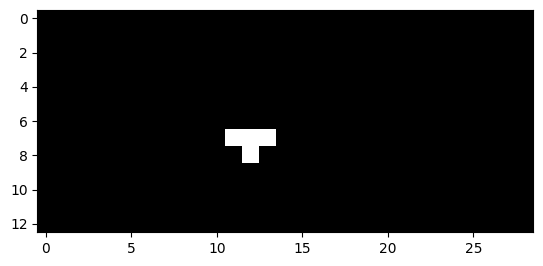

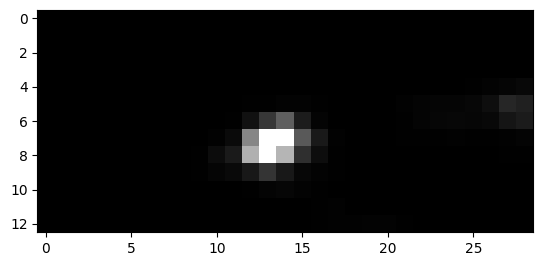

1413


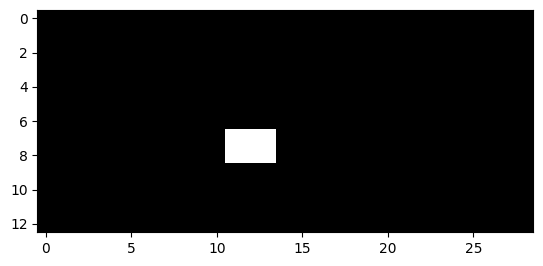

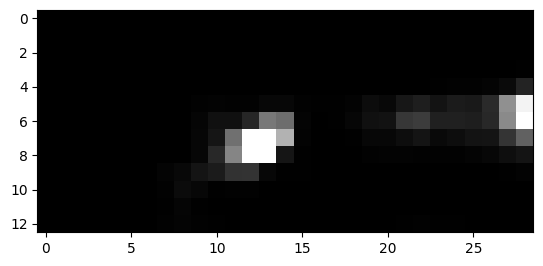

1414


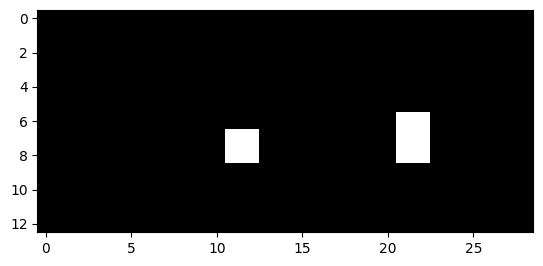

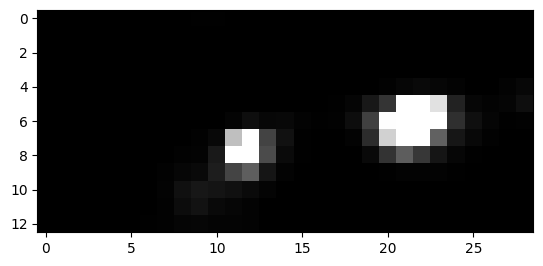

1415


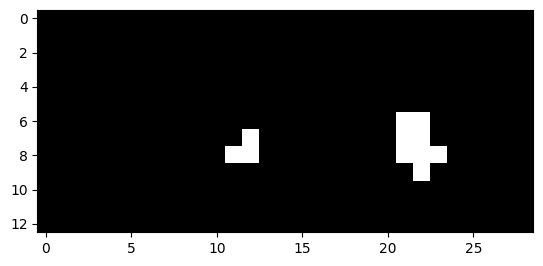

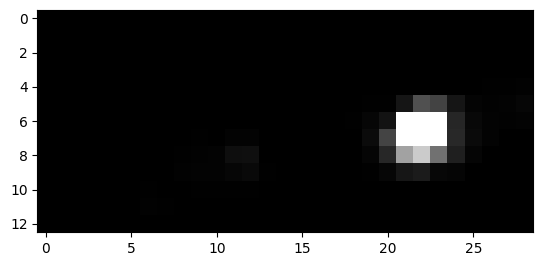

1416


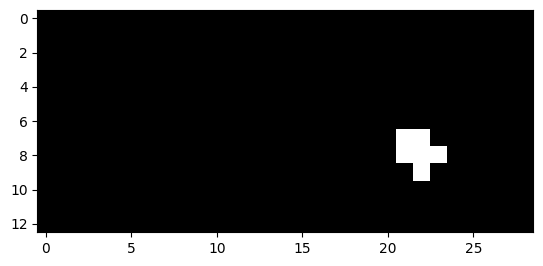

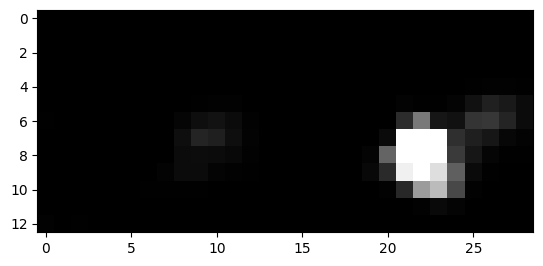

1417


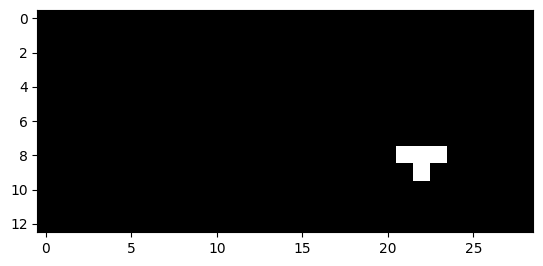

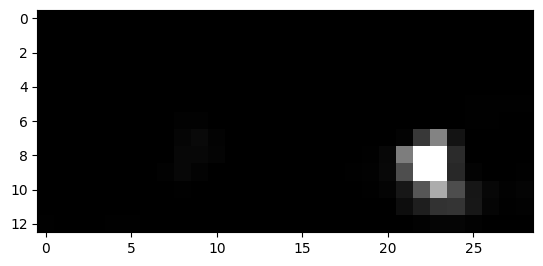

1419


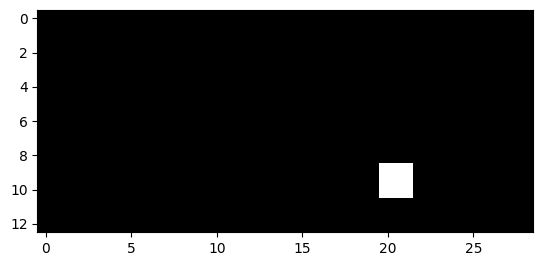

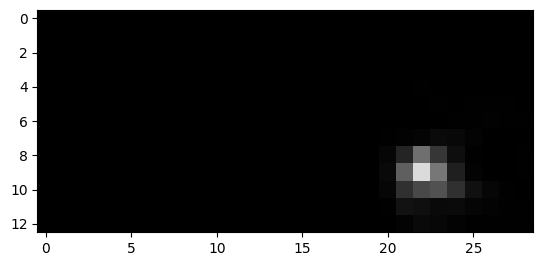

1420


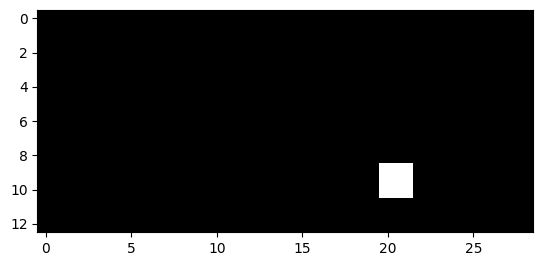

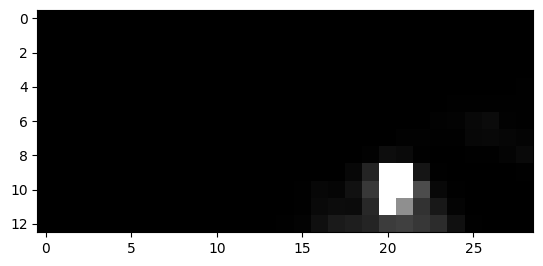

1441


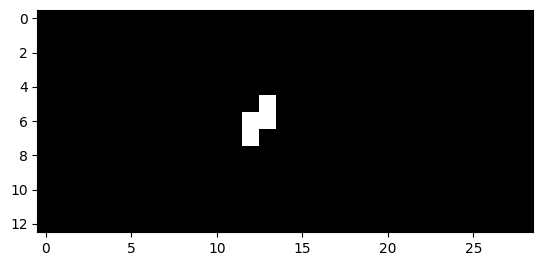

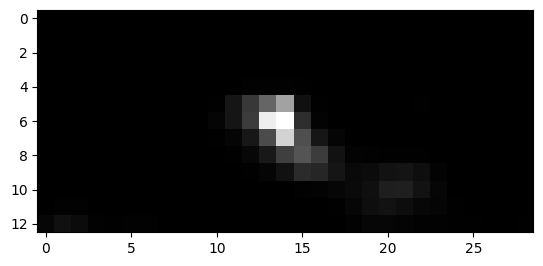

1442


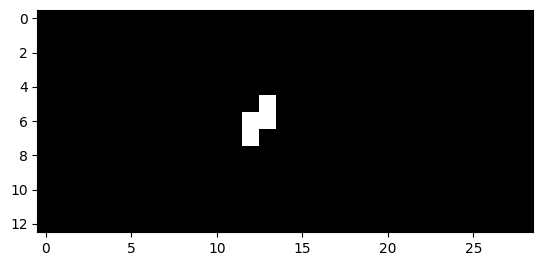

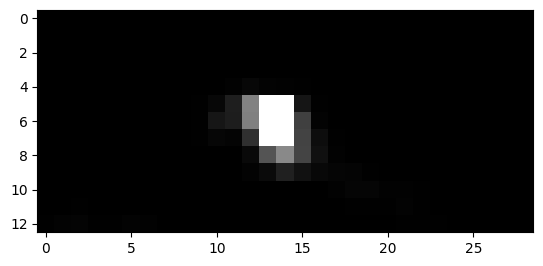

1443


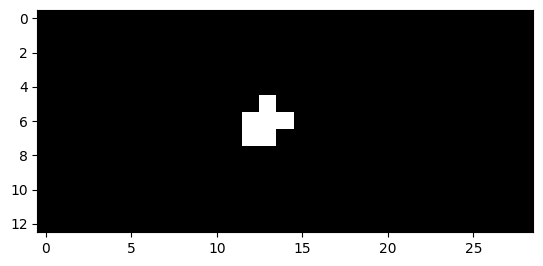

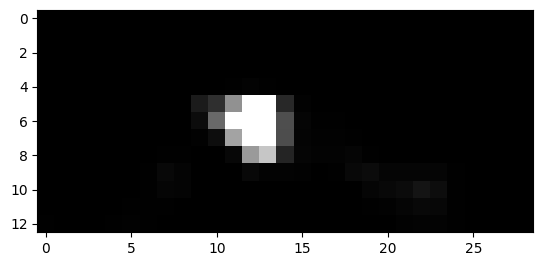

1444


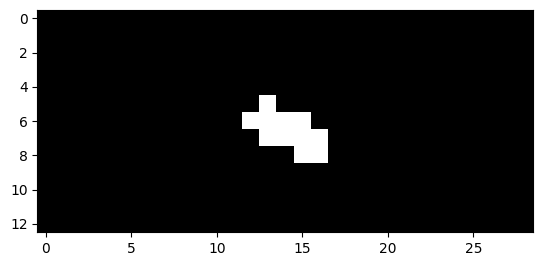

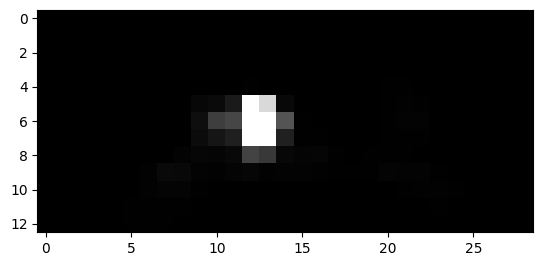

1445


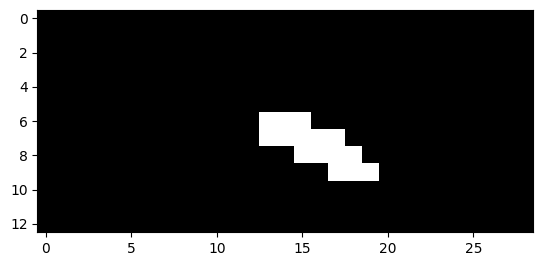

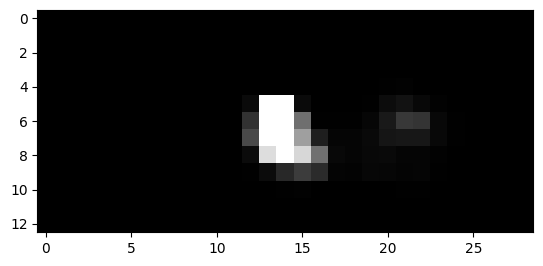

1446


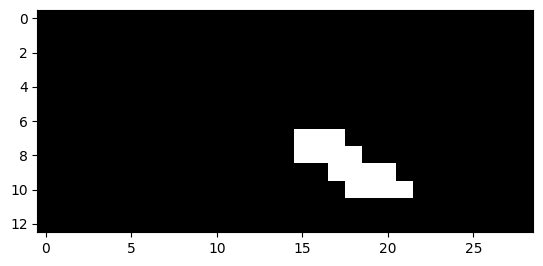

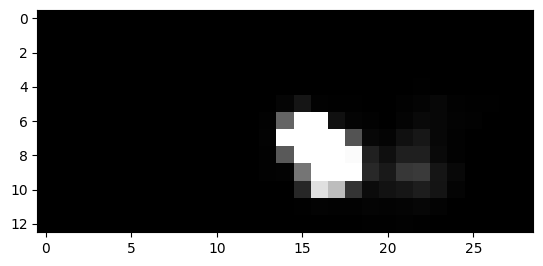

1447


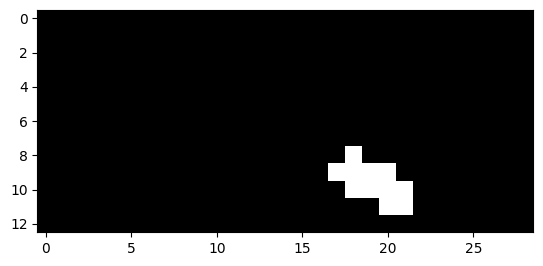

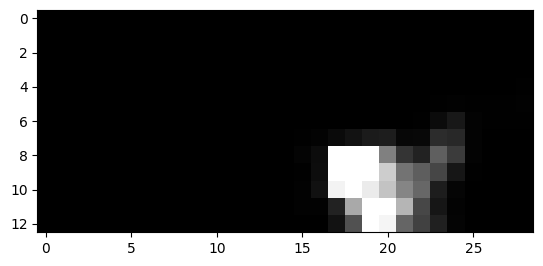

1448


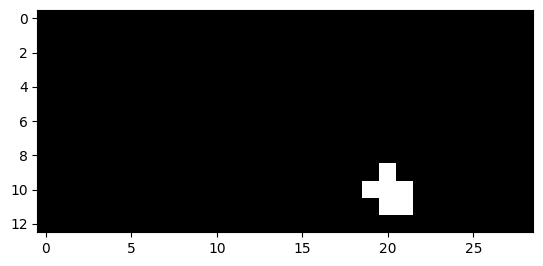

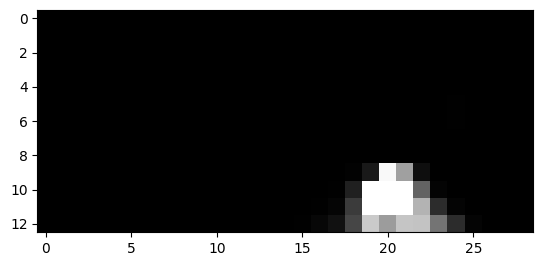

1460


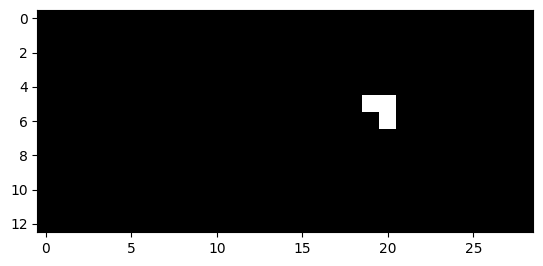

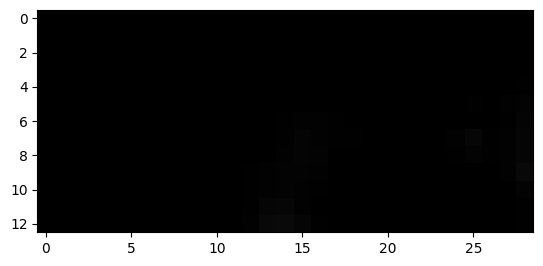

1461


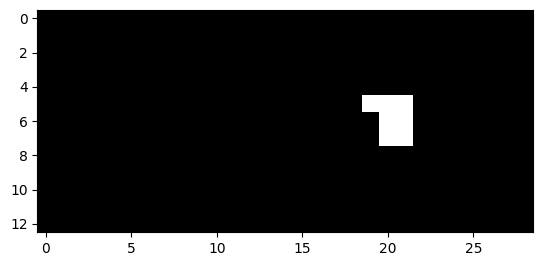

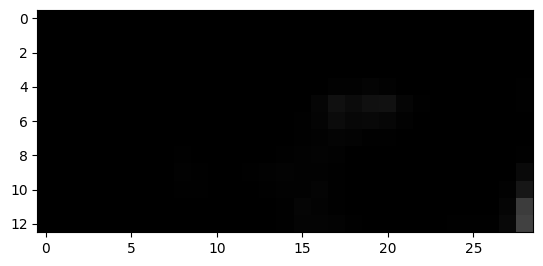

1462


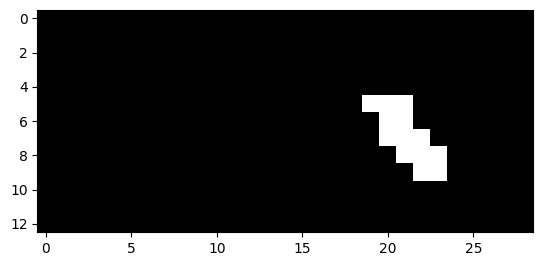

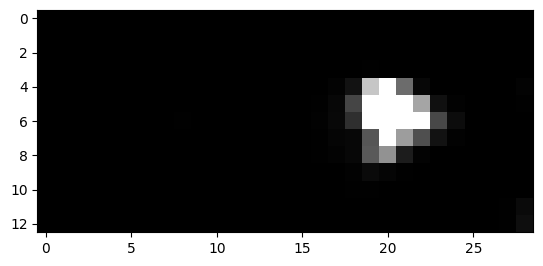

1463


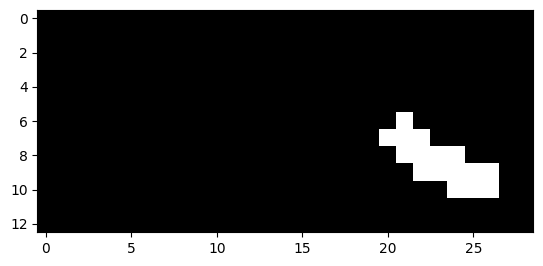

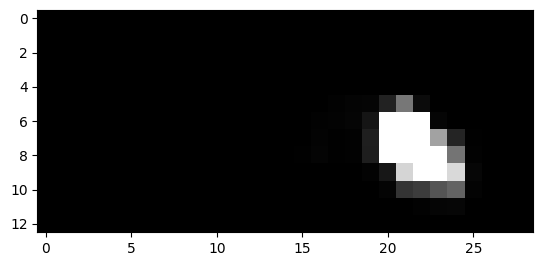

1464


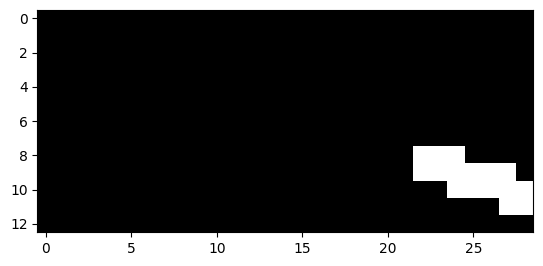

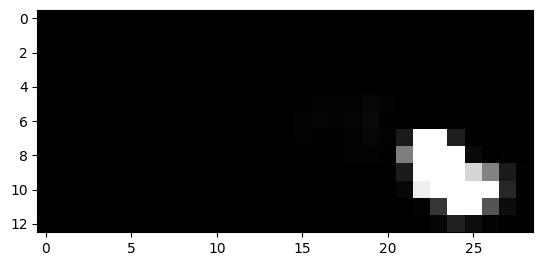

1465


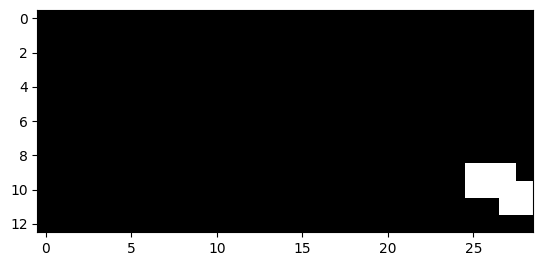

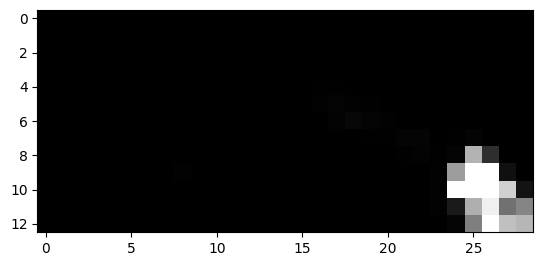

1466


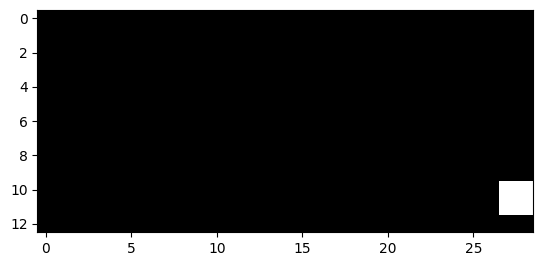

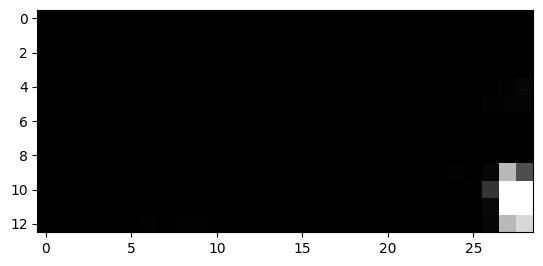

1473


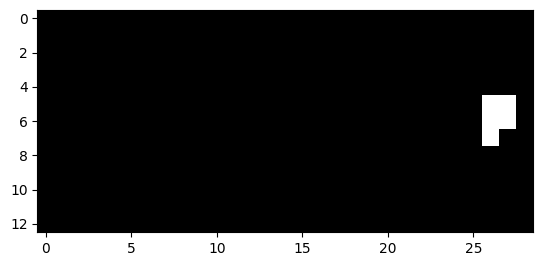

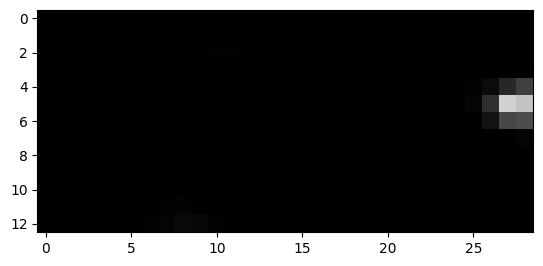

1474


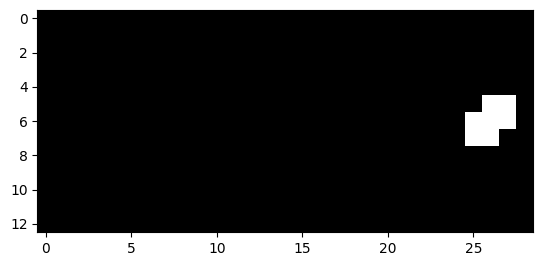

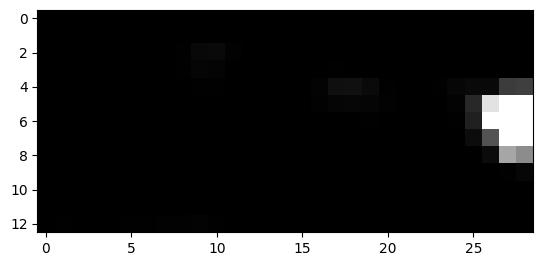

1475


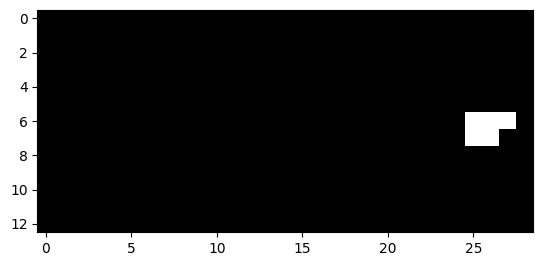

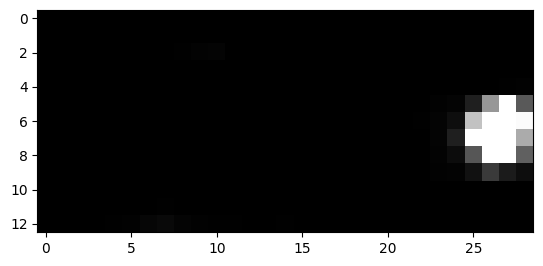

1509


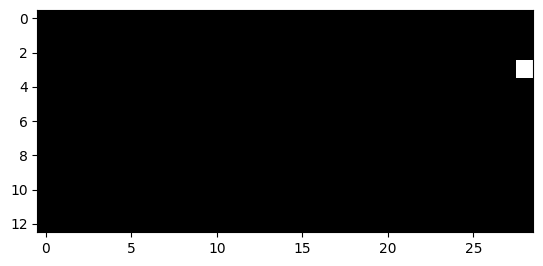

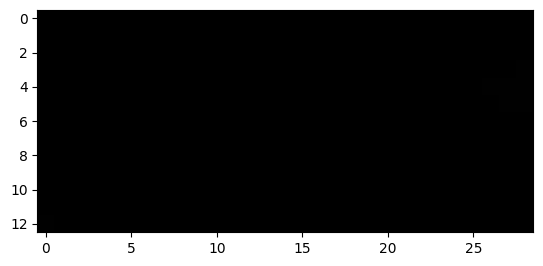

1510


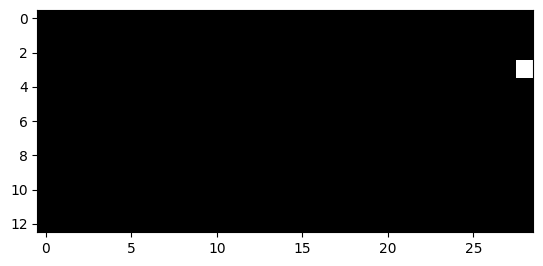

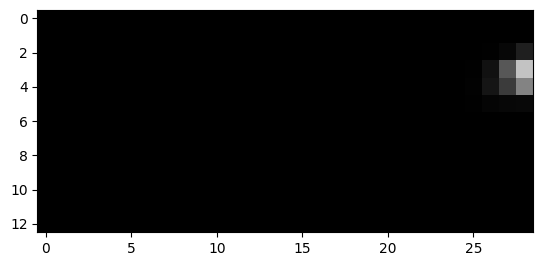

1511


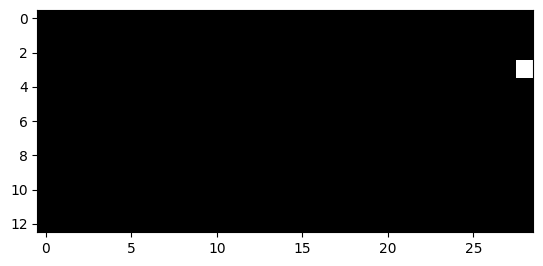

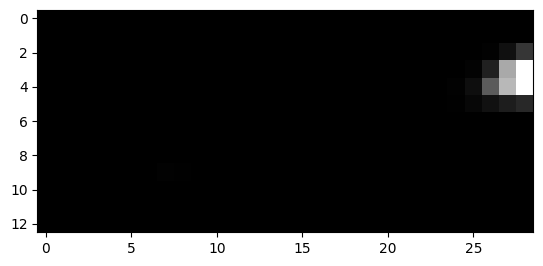

1687


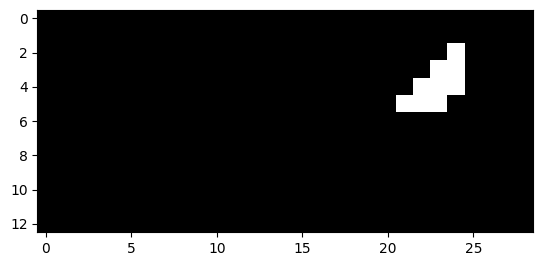

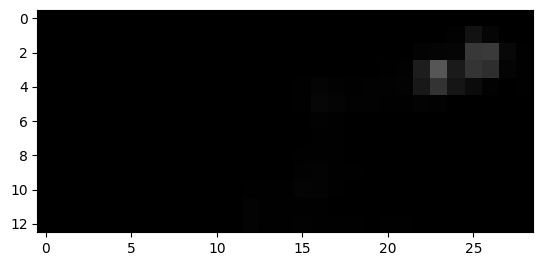

1688


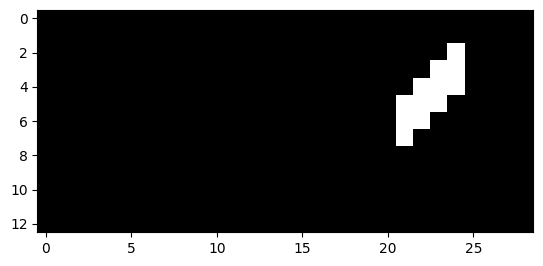

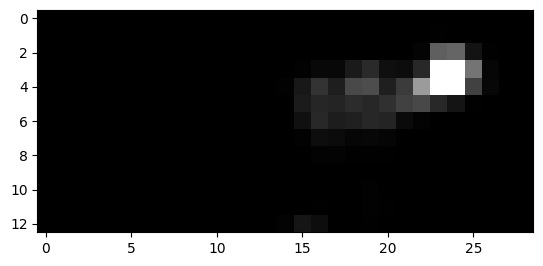

1689


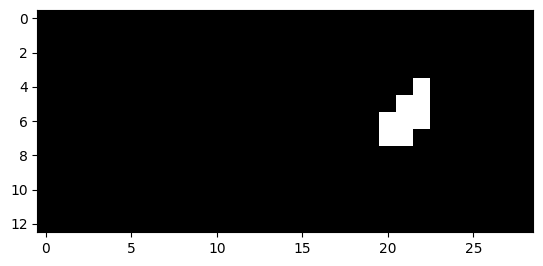

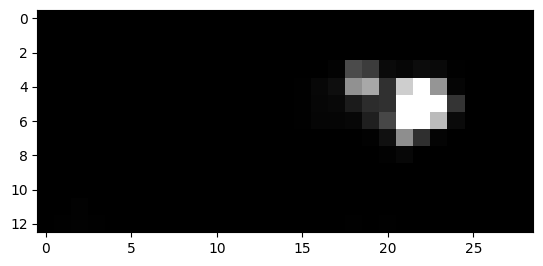

1690


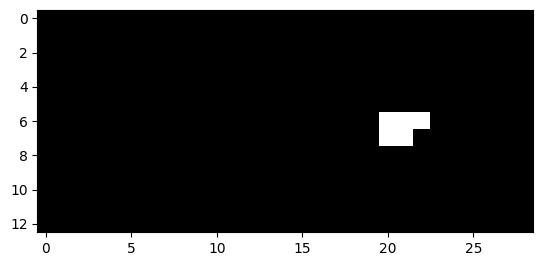

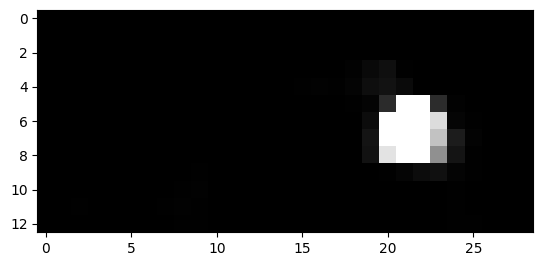

1691


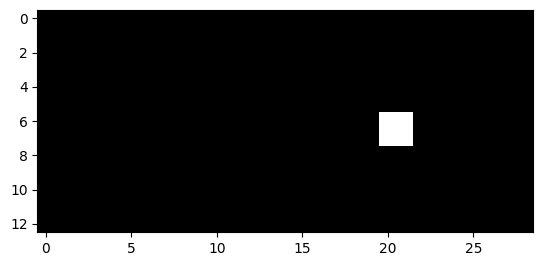

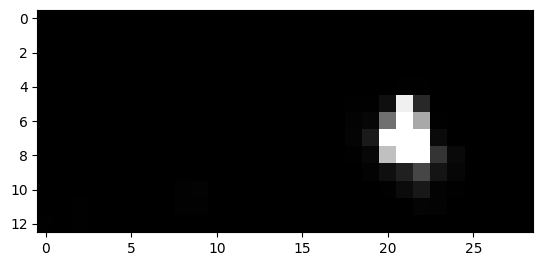

1710


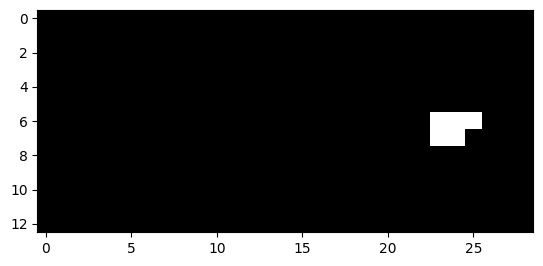

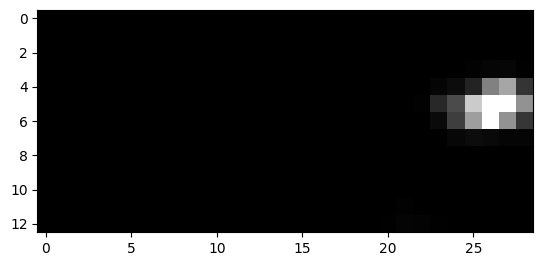

1711


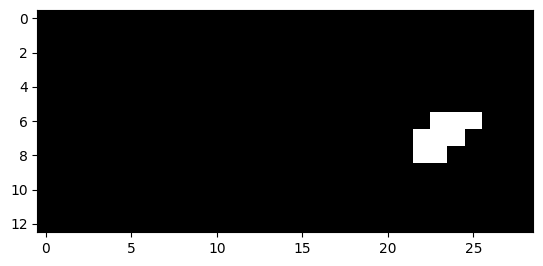

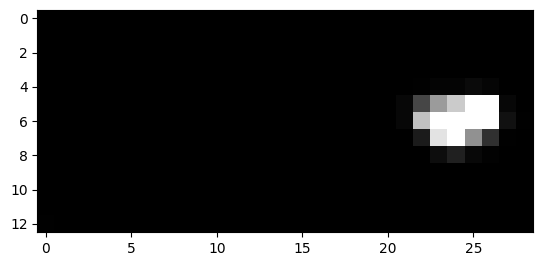

1712


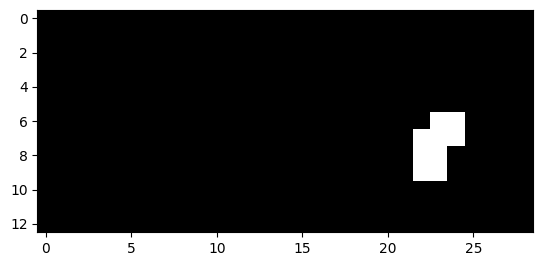

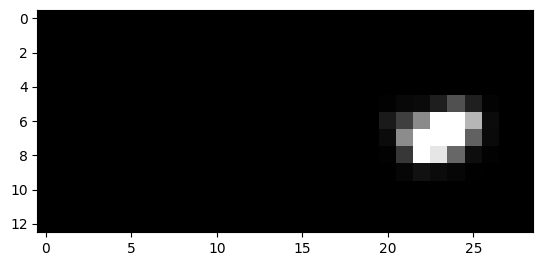

1713


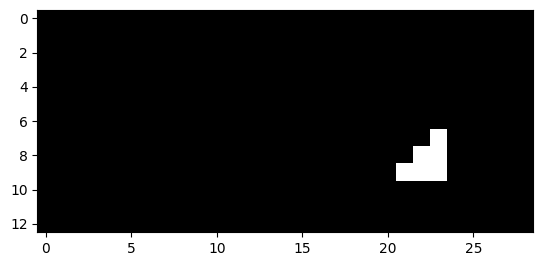

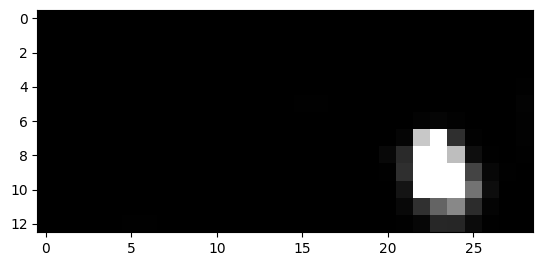

1714


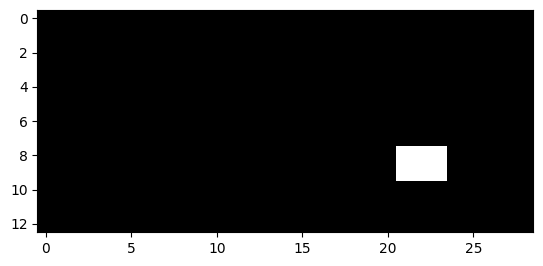

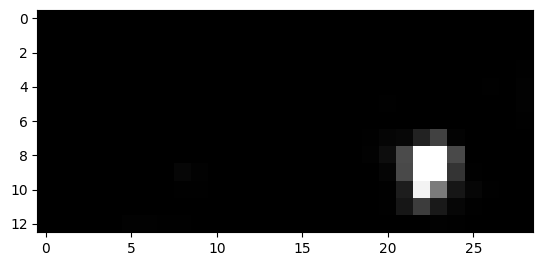

1715


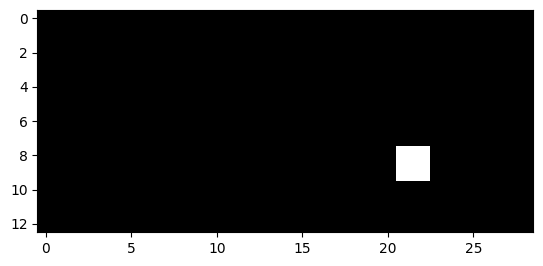

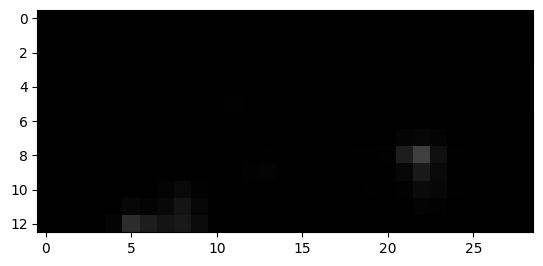

1728


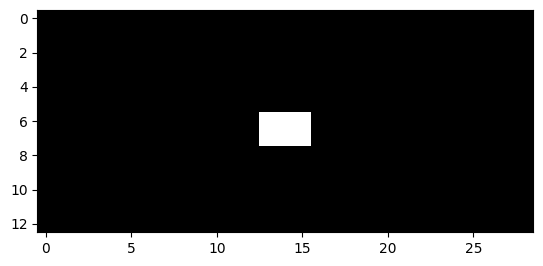

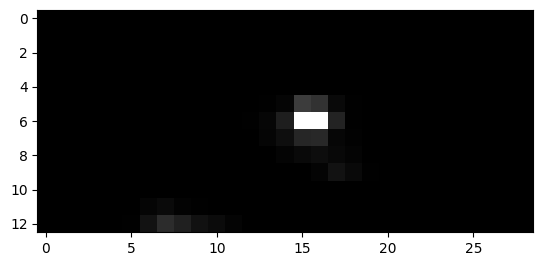

1729


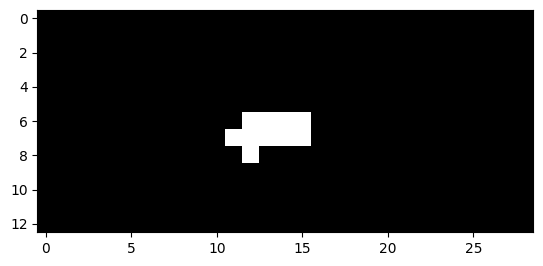

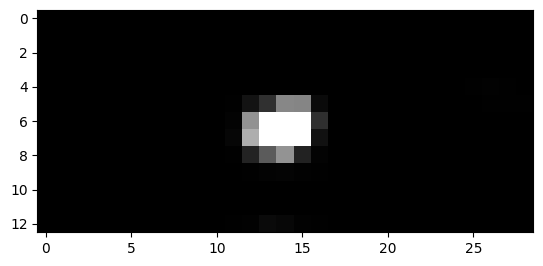

1730


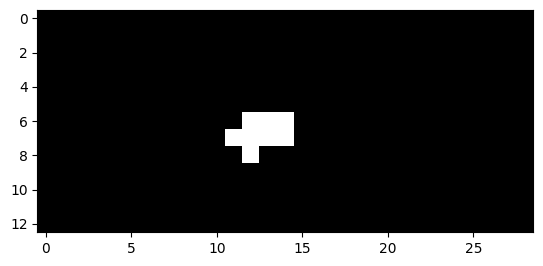

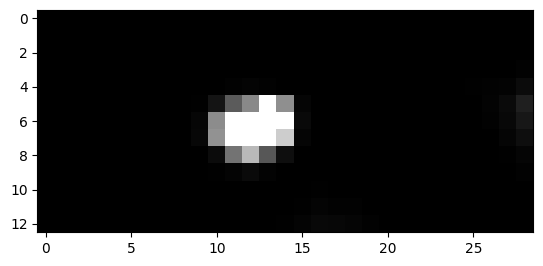

1731


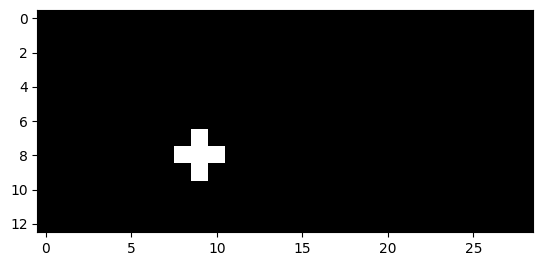

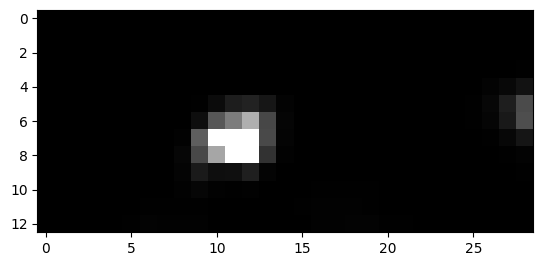

1732


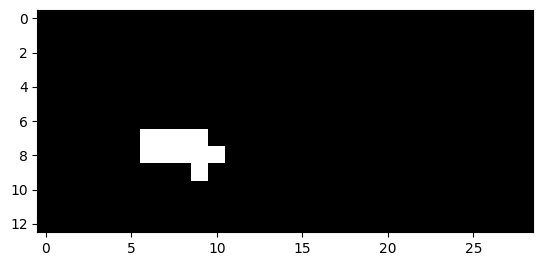

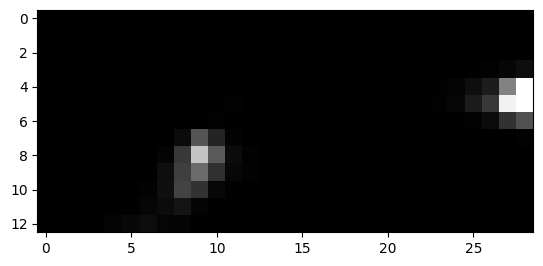

1733


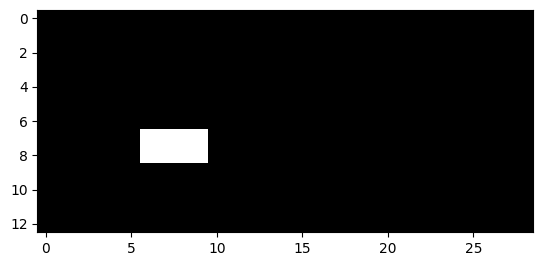

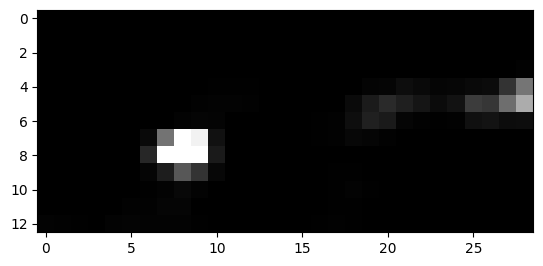

1735


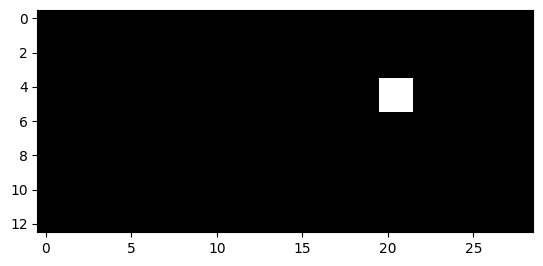

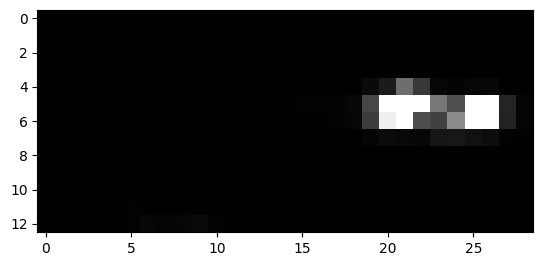

1736


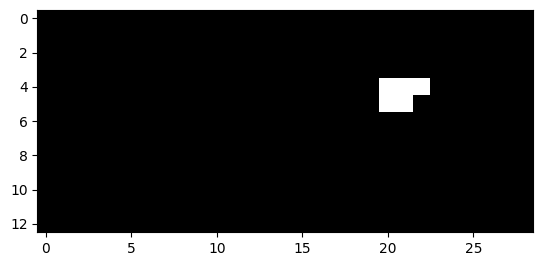

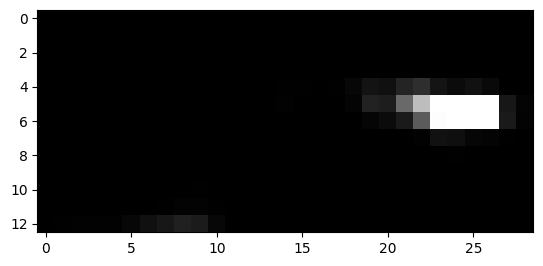

1737


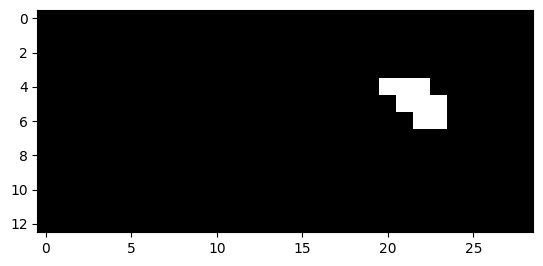

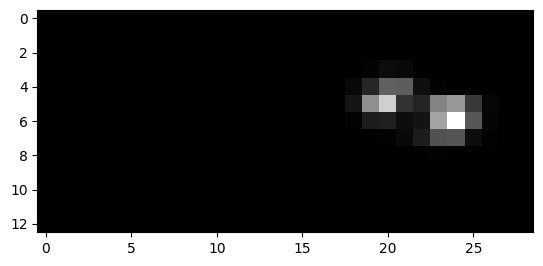

1738


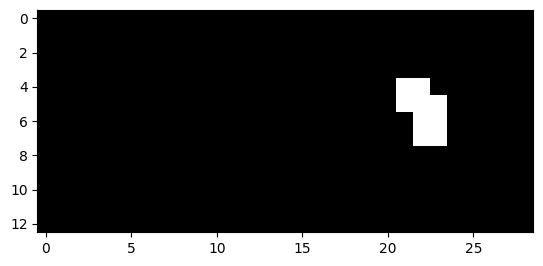

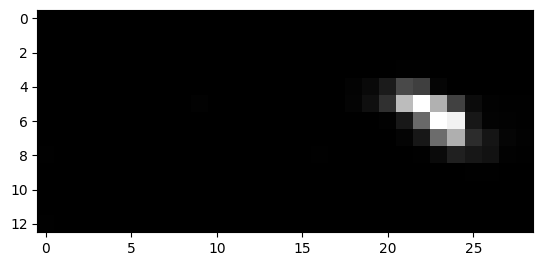

1739


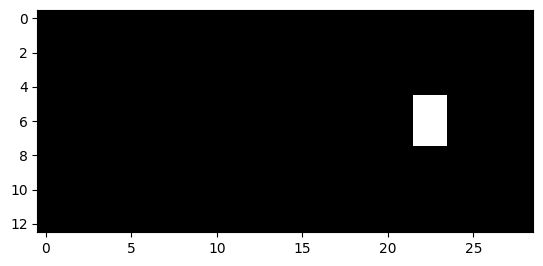

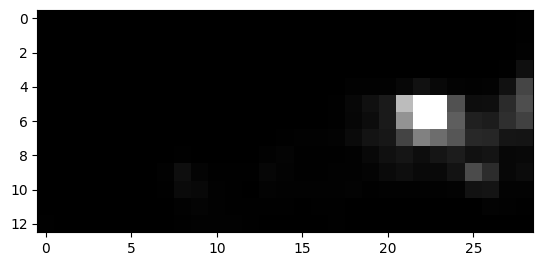

1740


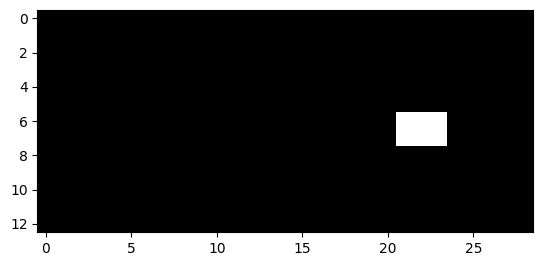

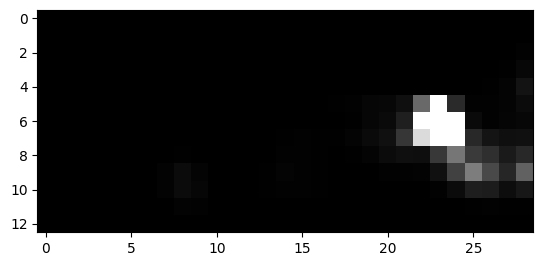

1741


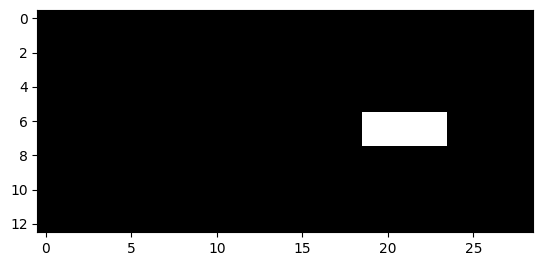

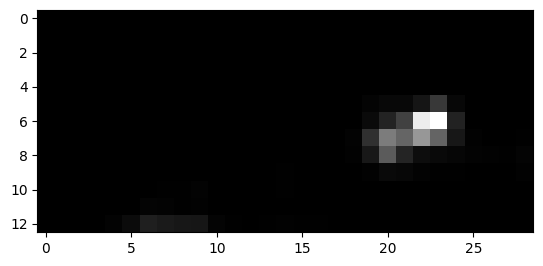

1742


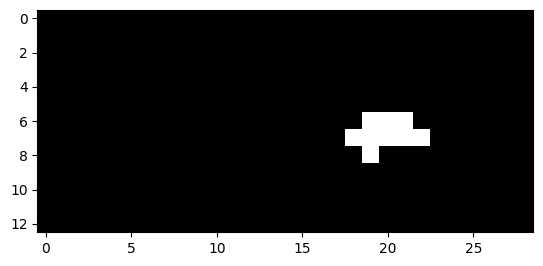

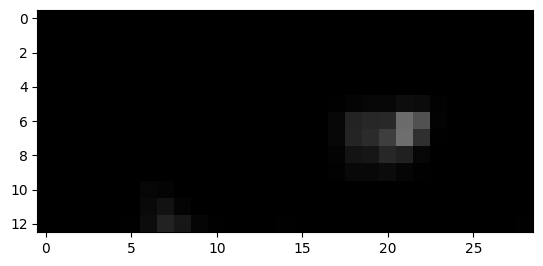

1743


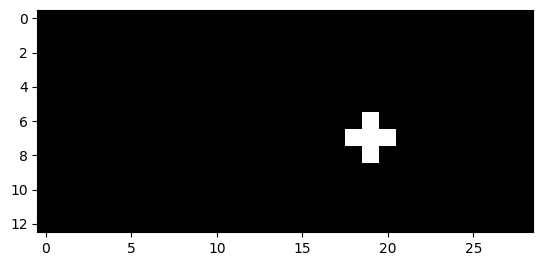

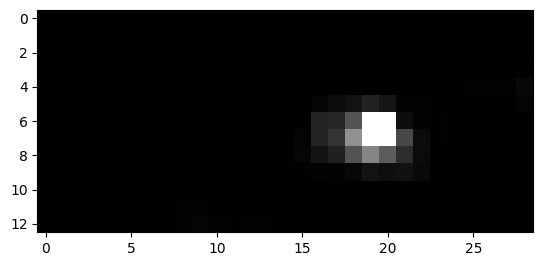

1750


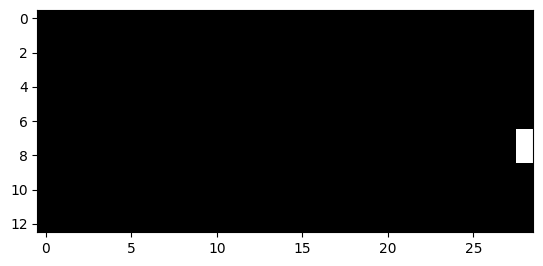

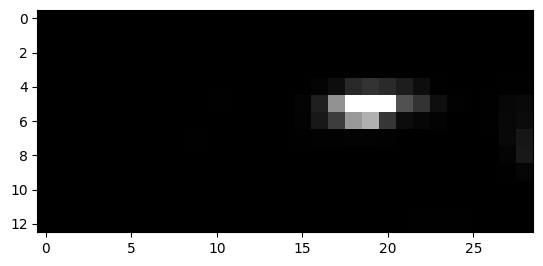

1751


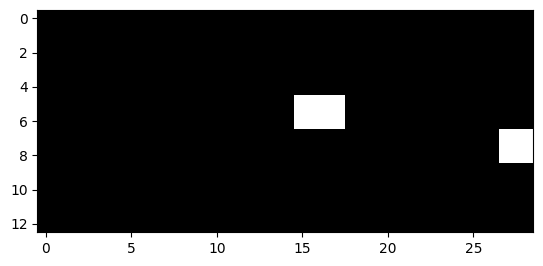

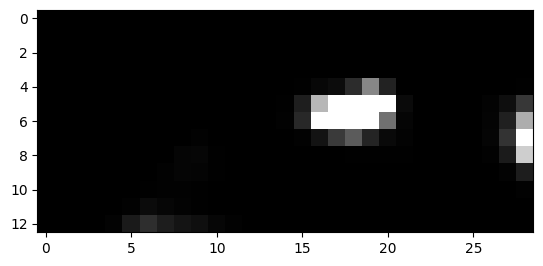

1752


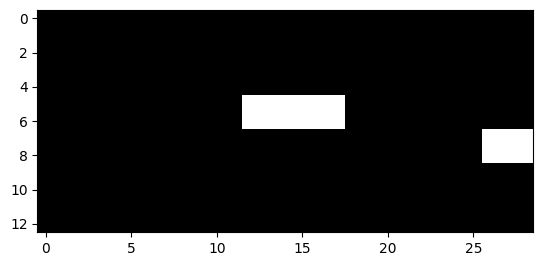

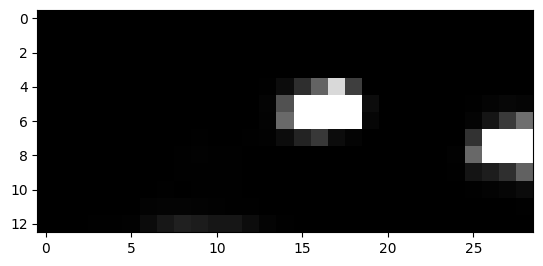

1753


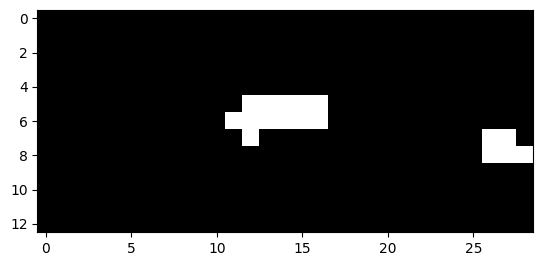

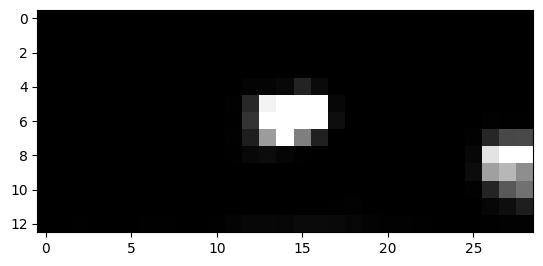

1754


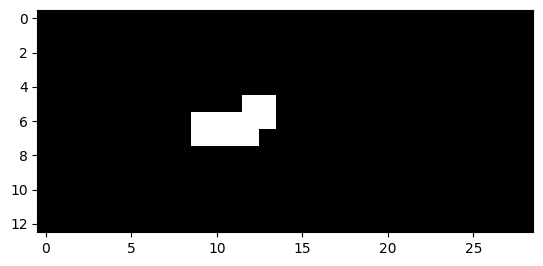

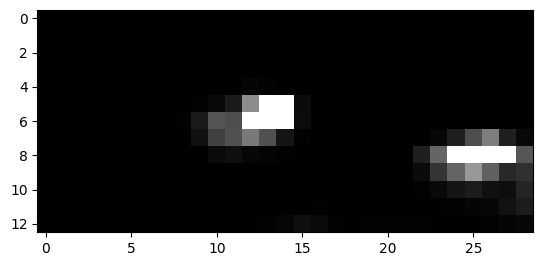

1755


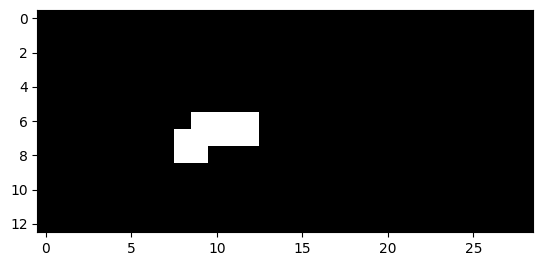

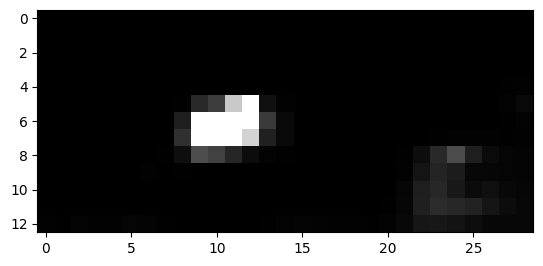

1756


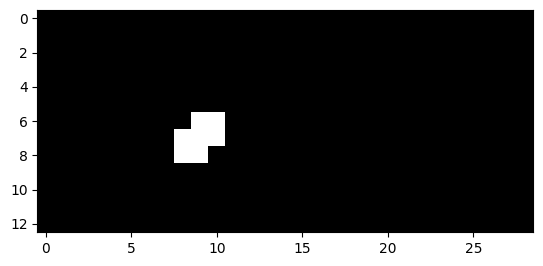

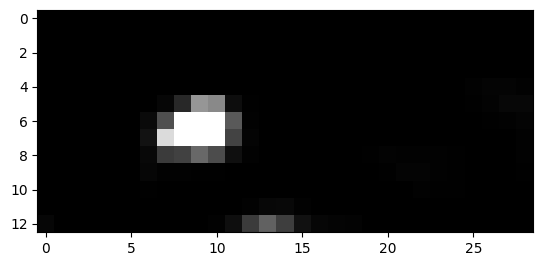

1760


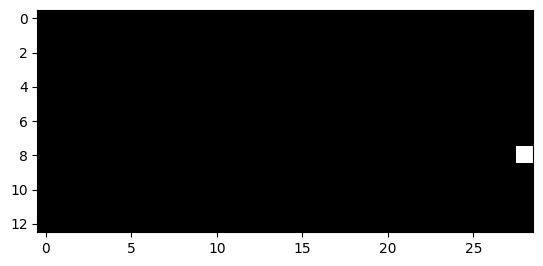

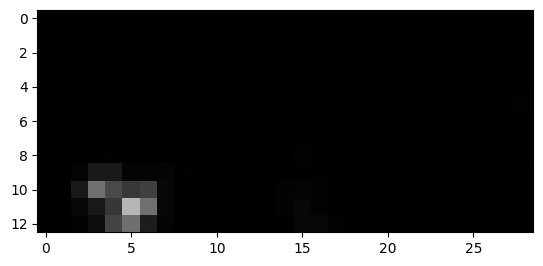

1761


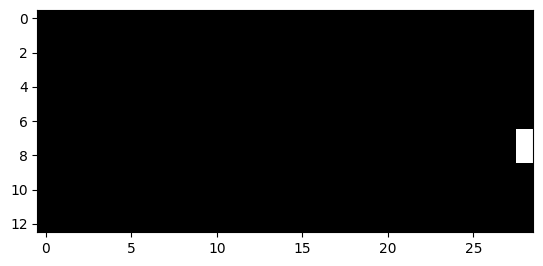

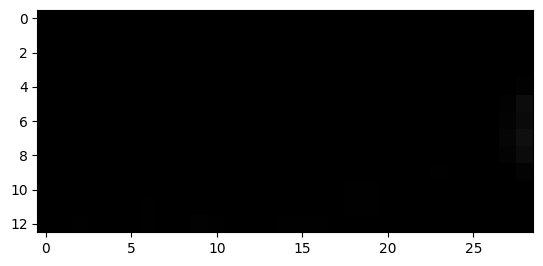

1762


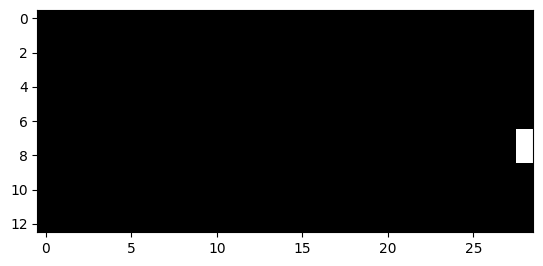

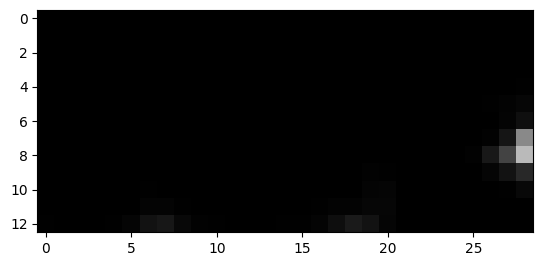

1770


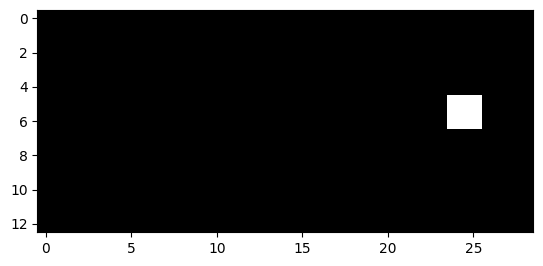

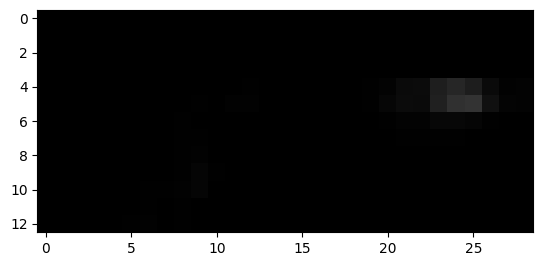

1771


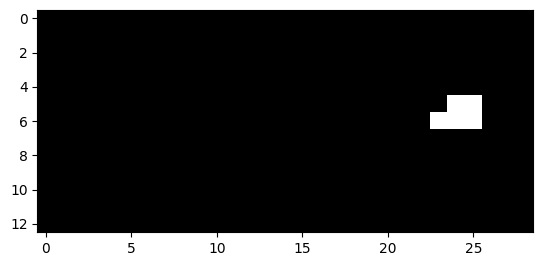

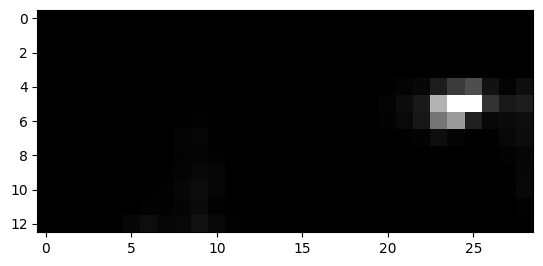

1772


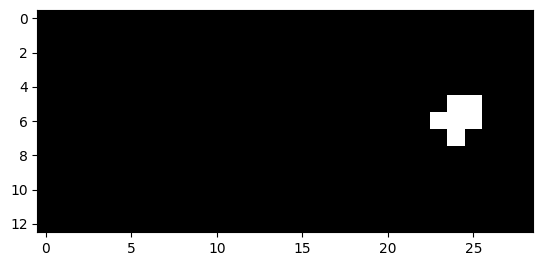

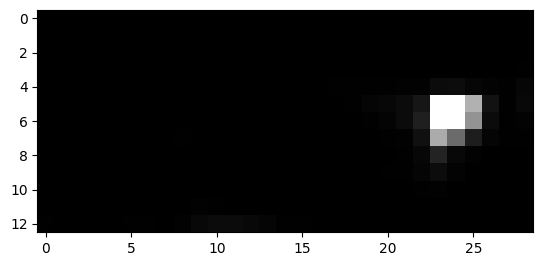

1773


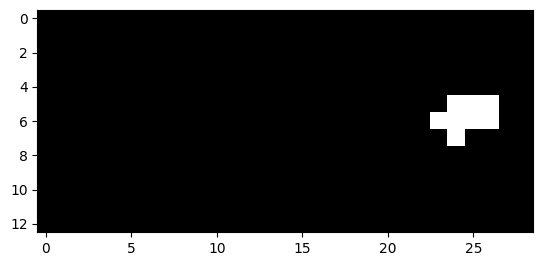

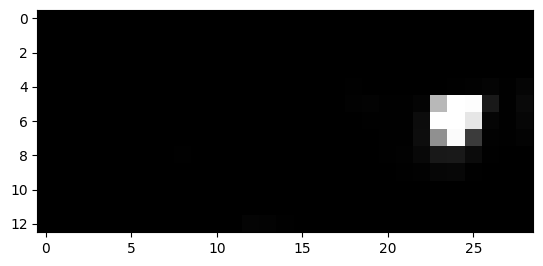

1774


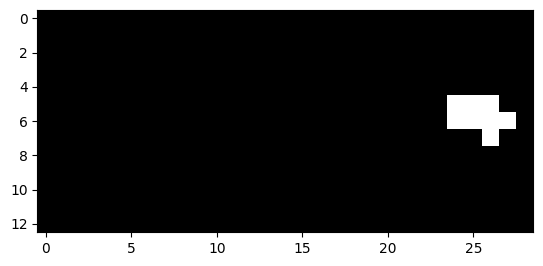

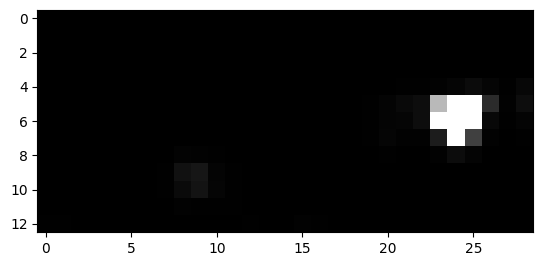

1775


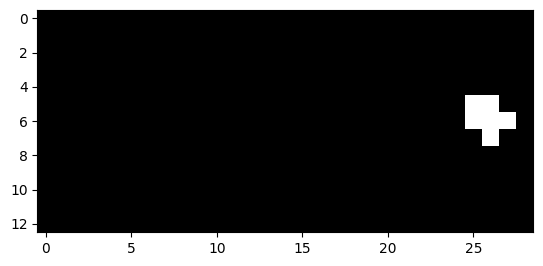

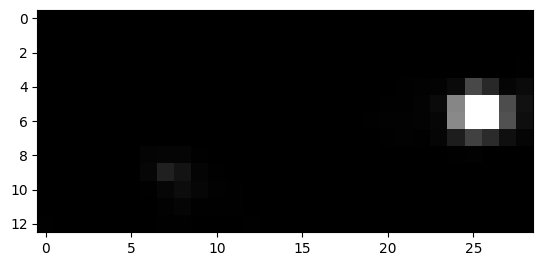

1776


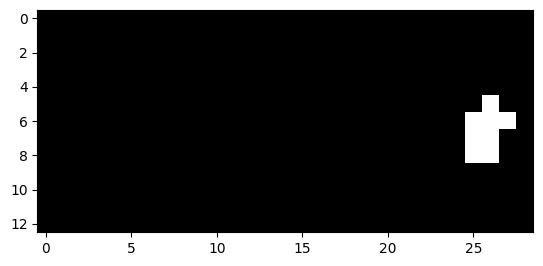

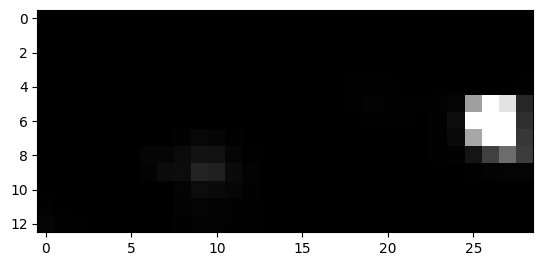

1777


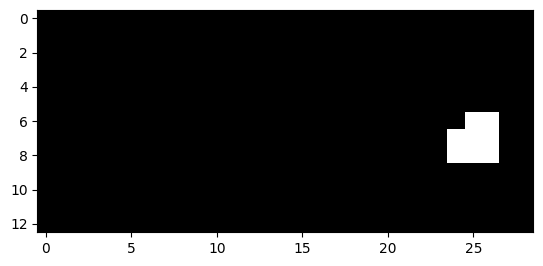

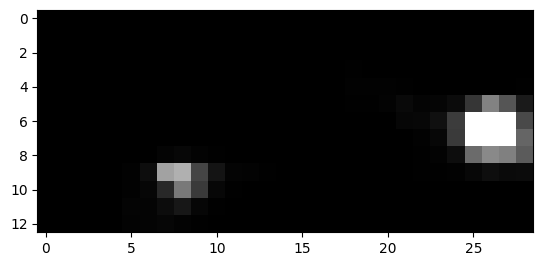

1778


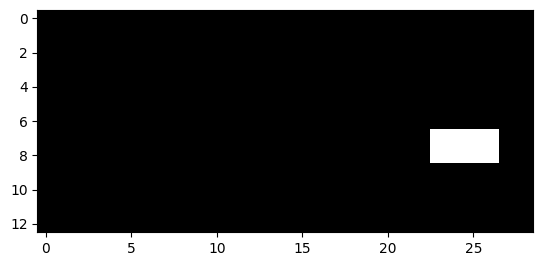

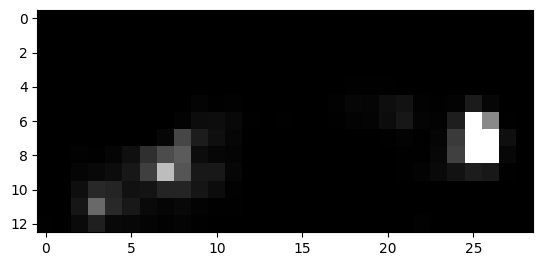

1779


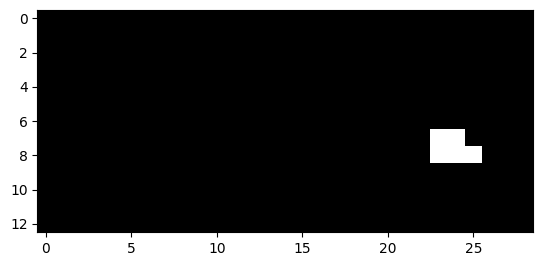

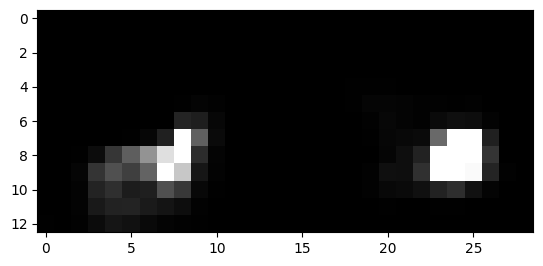

1786


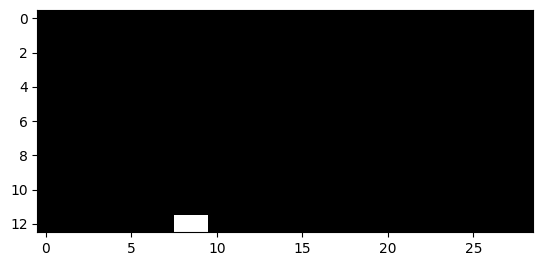

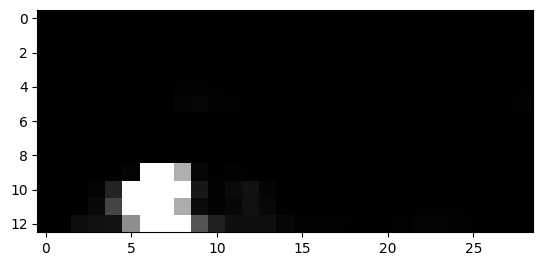

1787


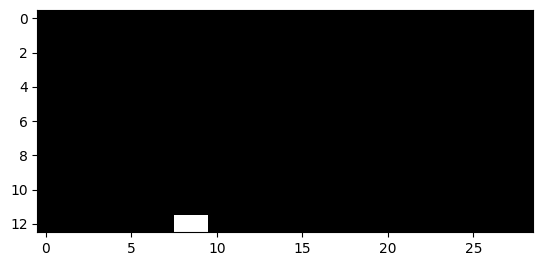

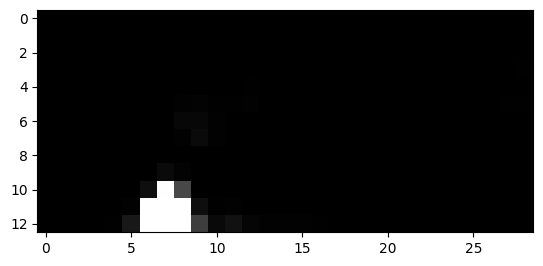

1792


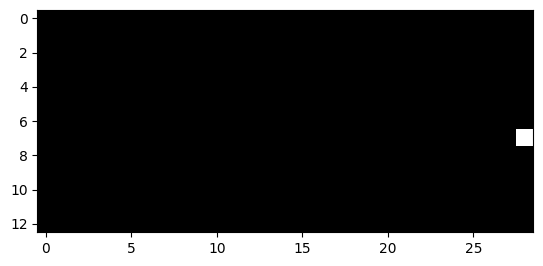

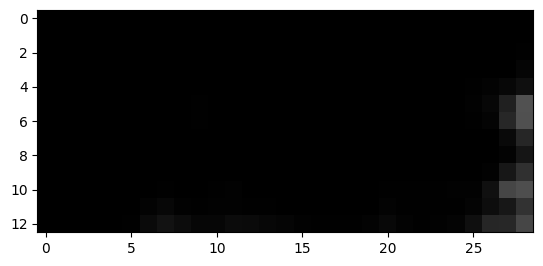

1793


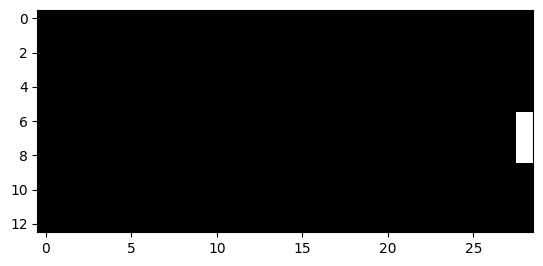

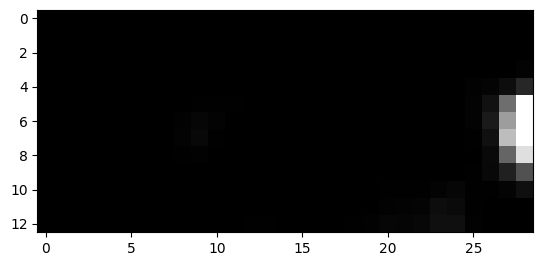

1794


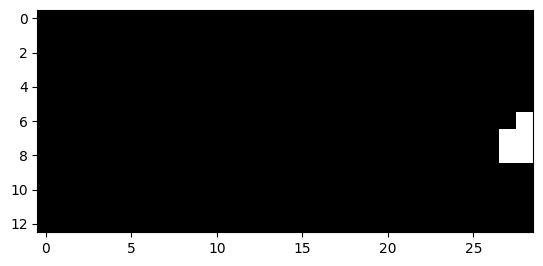

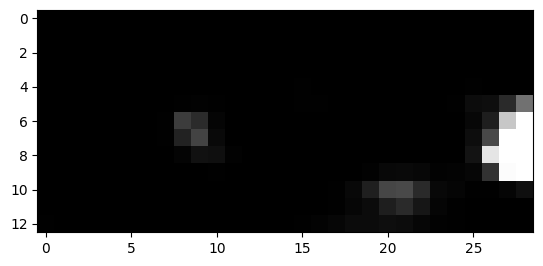

1795


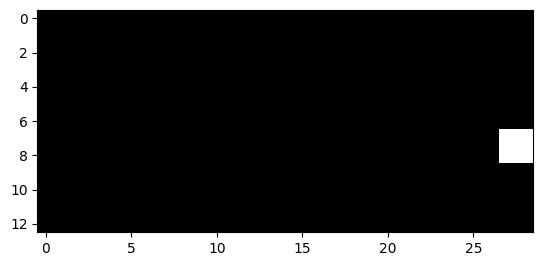

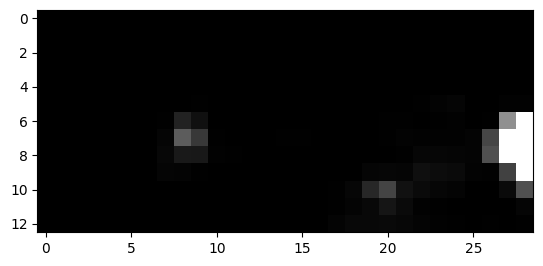

1796


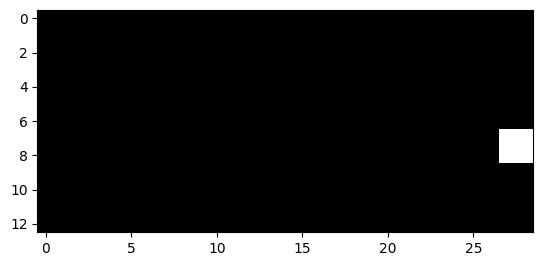

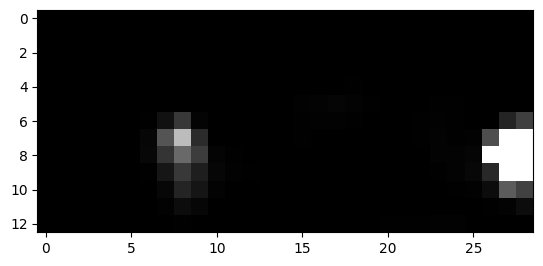

1797


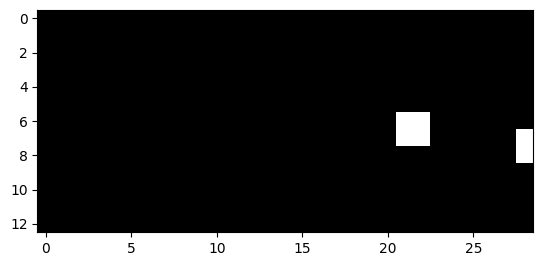

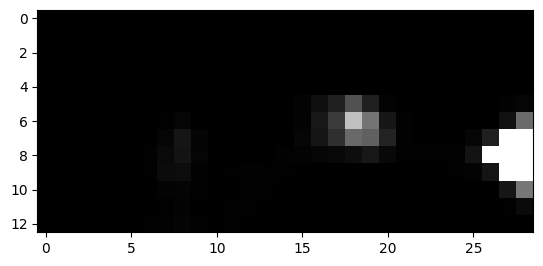

1798


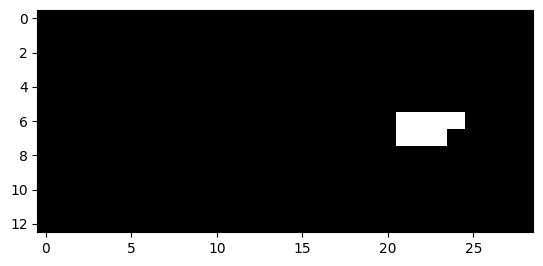

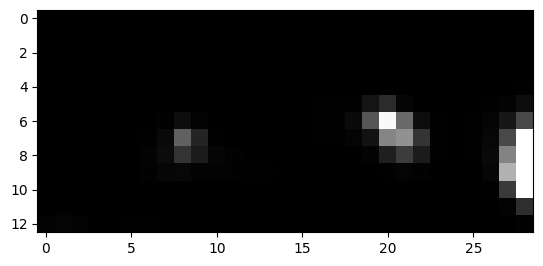

1799


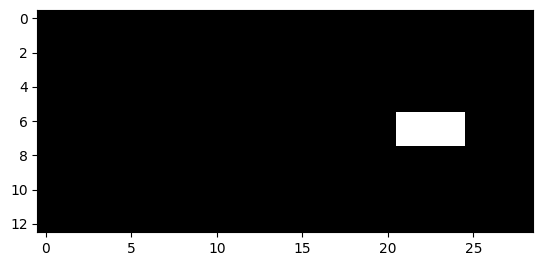

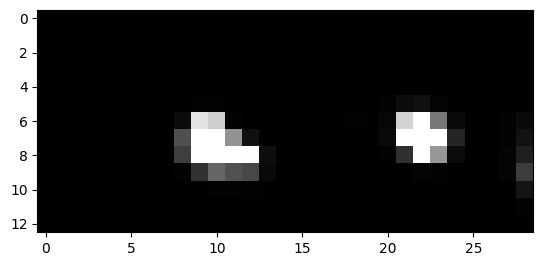

1800


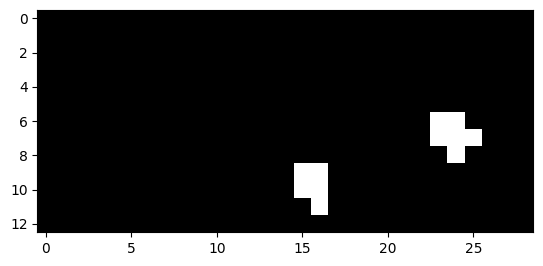

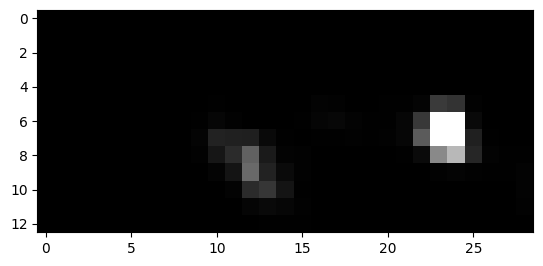

1801


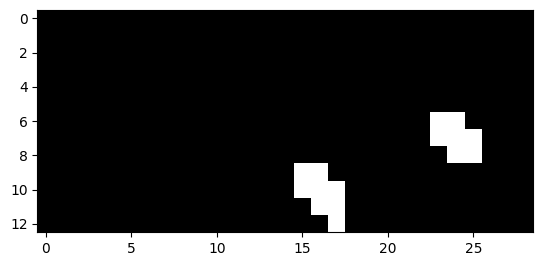

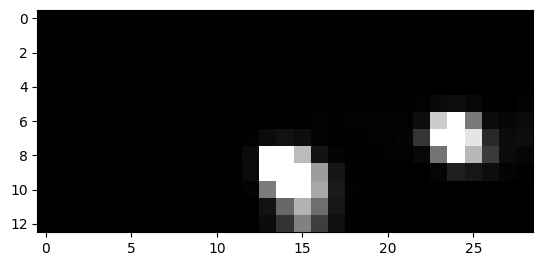

1802


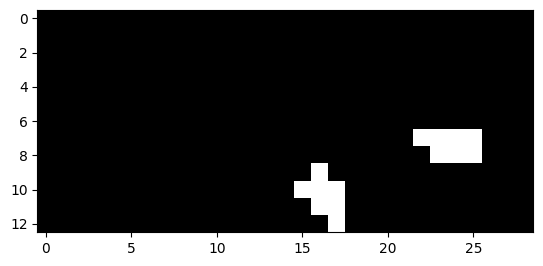

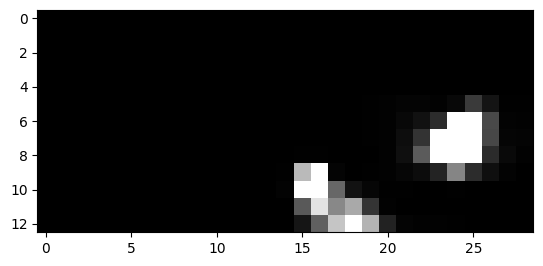

1803


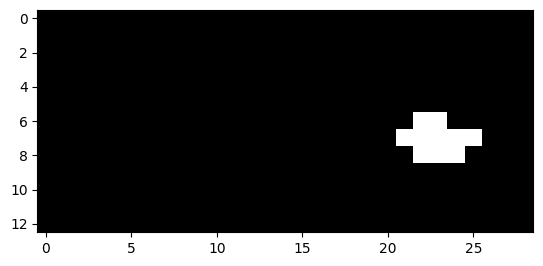

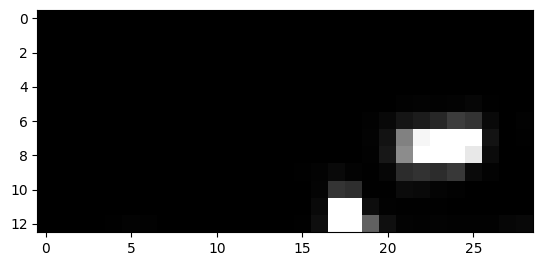

1804


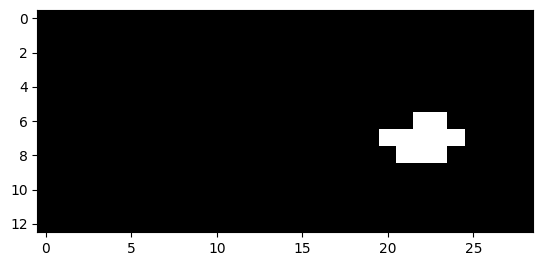

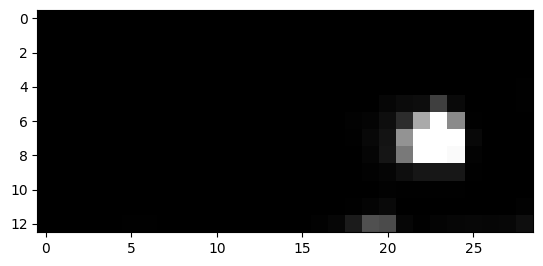

1805


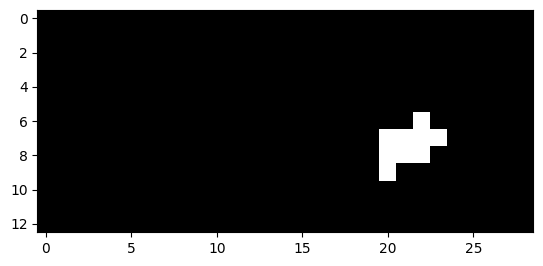

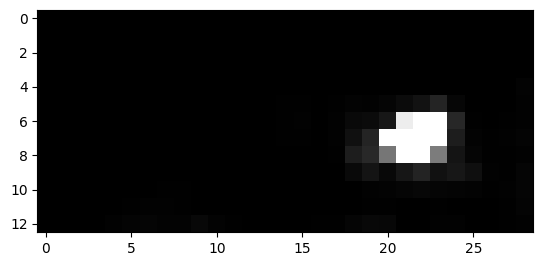

1806


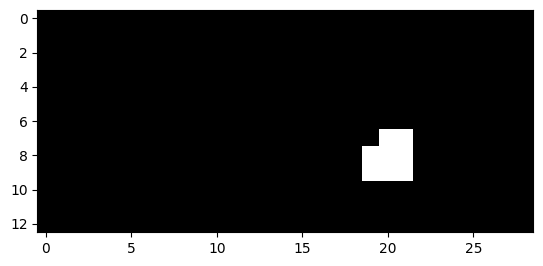

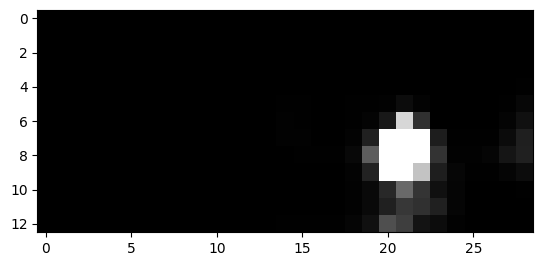

1807


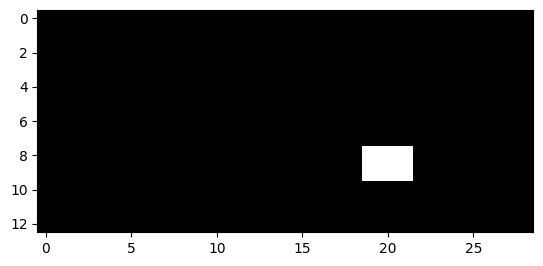

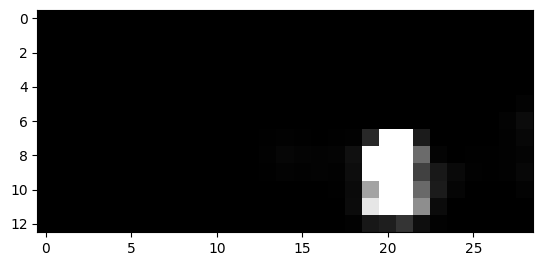

1808


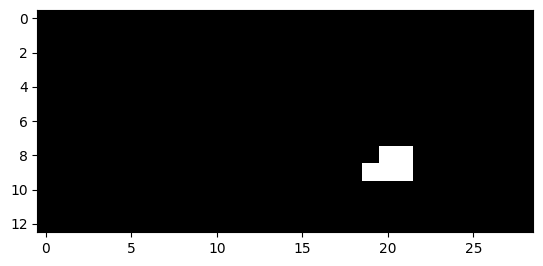

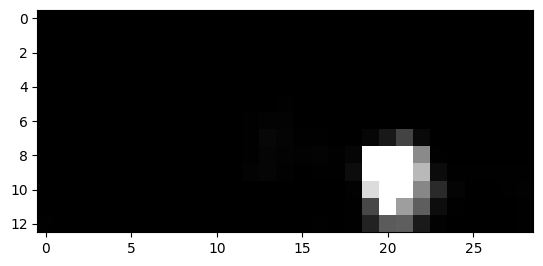

1809


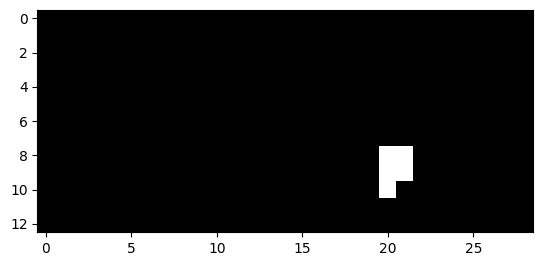

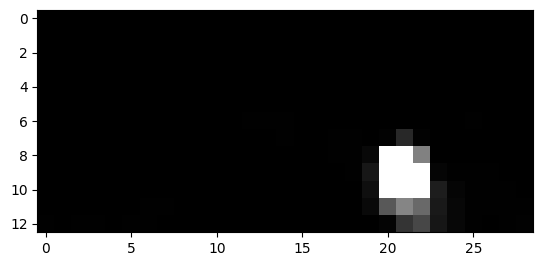

1810


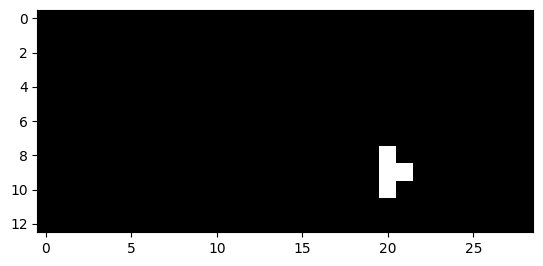

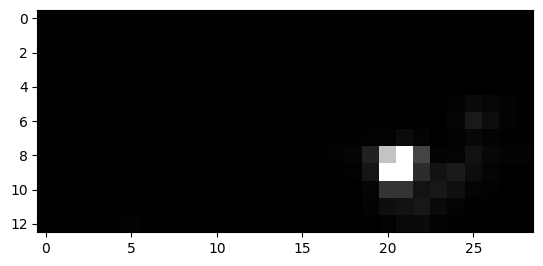

1845


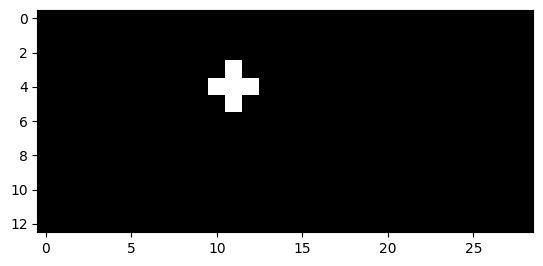

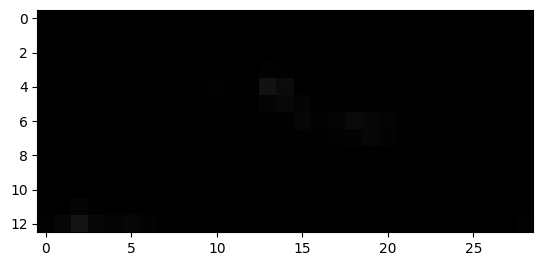

1846


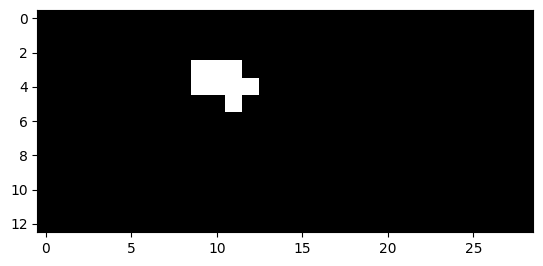

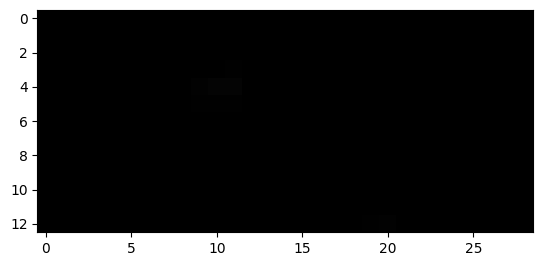

1847


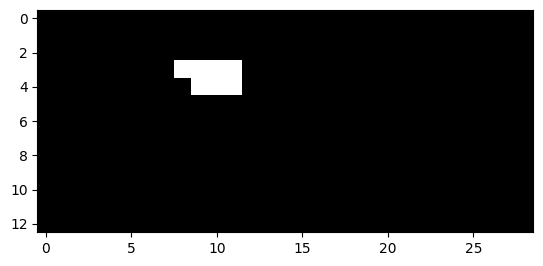

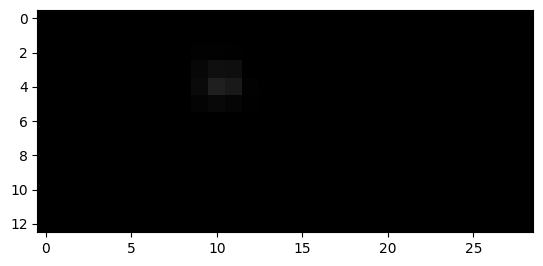

1848


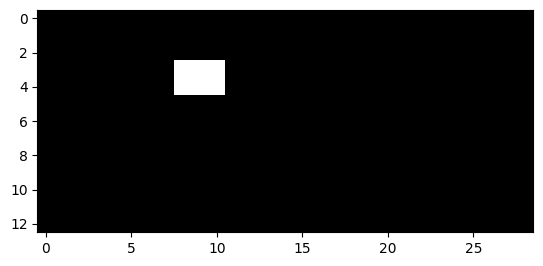

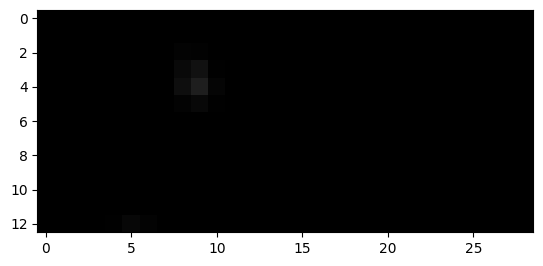

1849


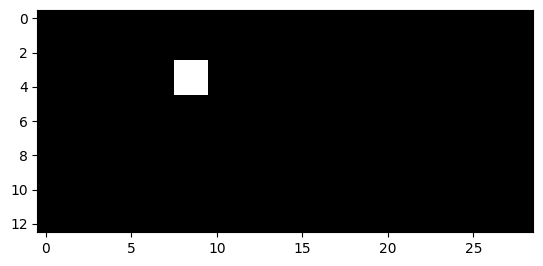

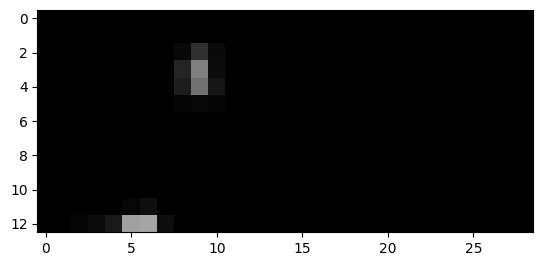

2122


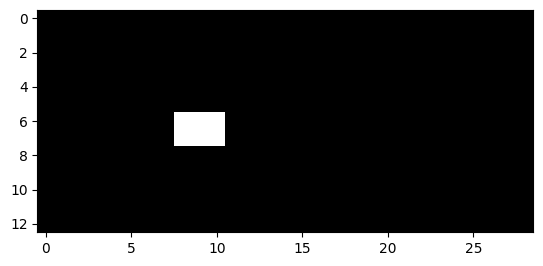

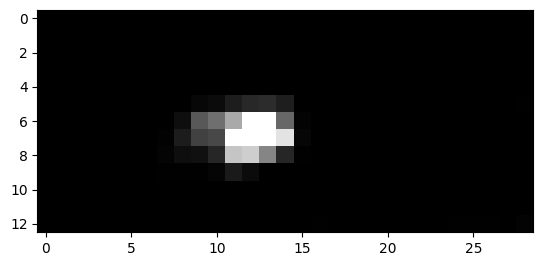

2123


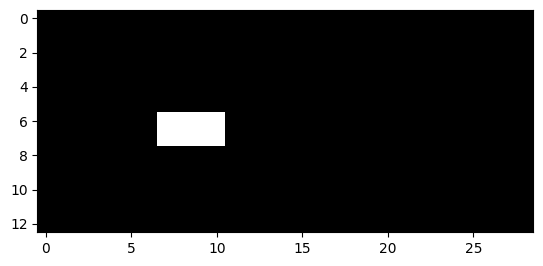

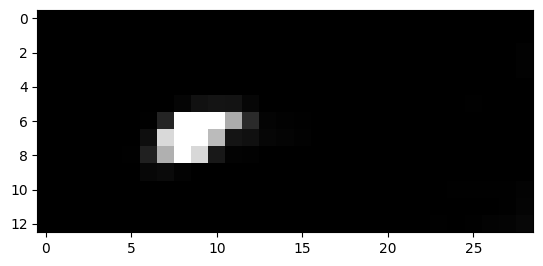

2124


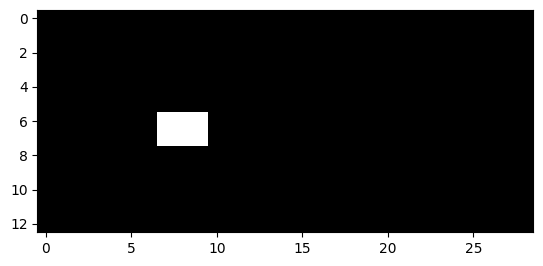

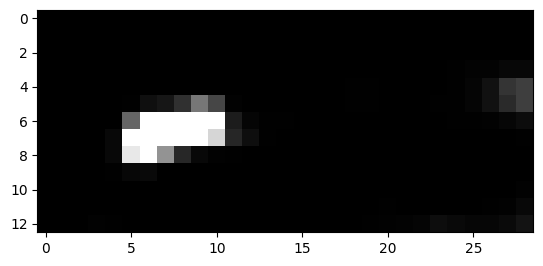

2126


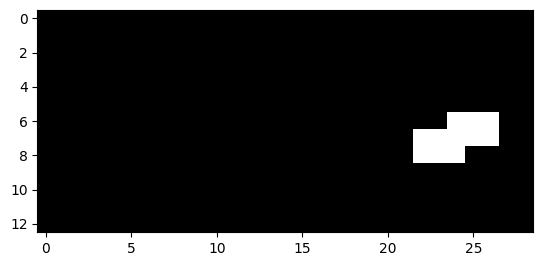

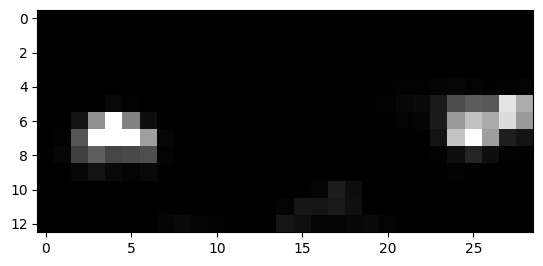

2127


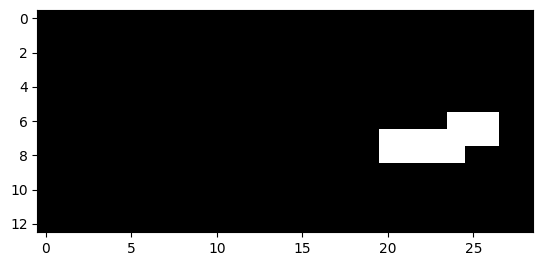

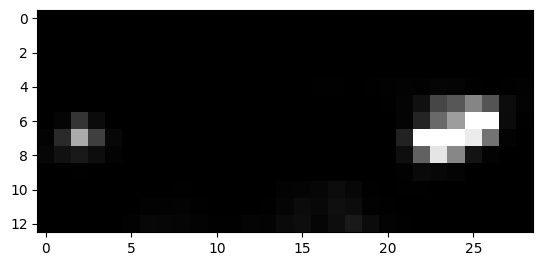

2128


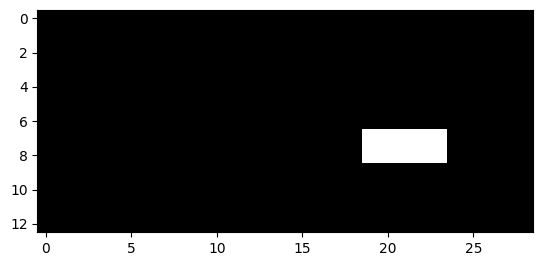

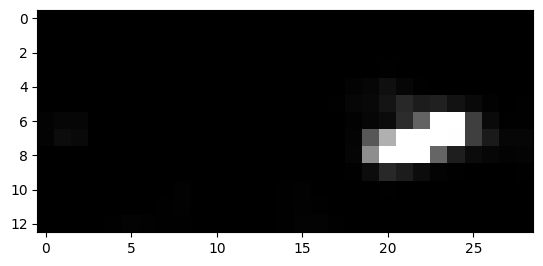

2129


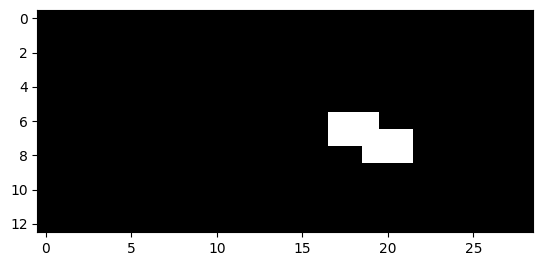

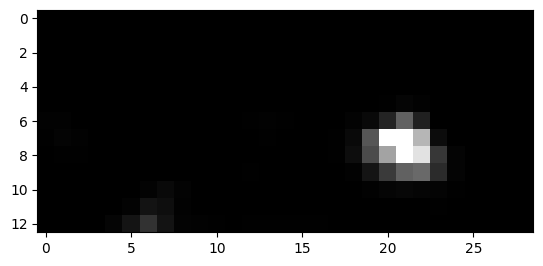

2130


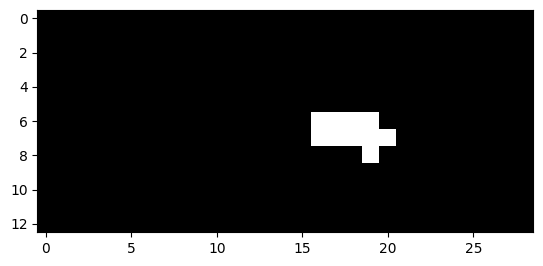

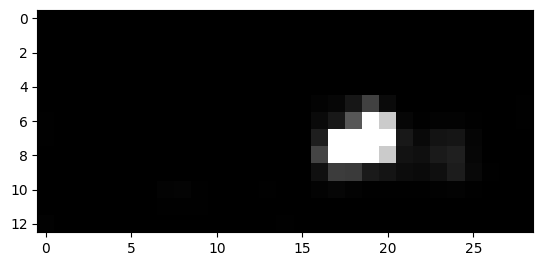

2131


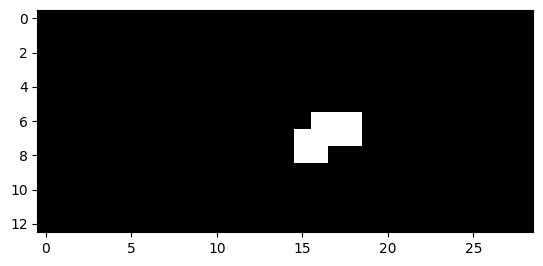

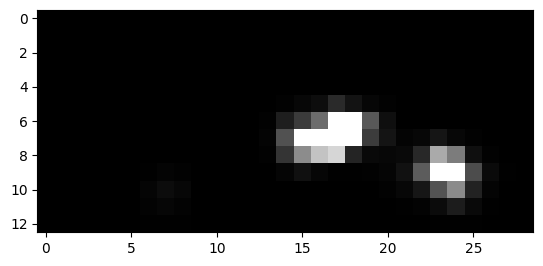

2132


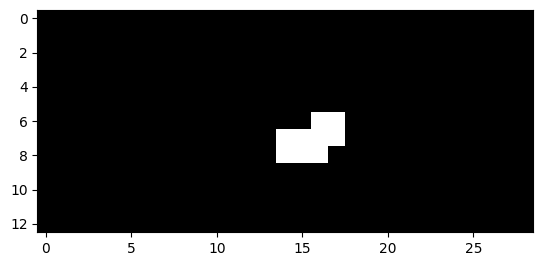

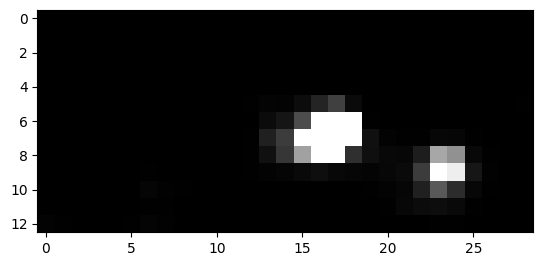

2133


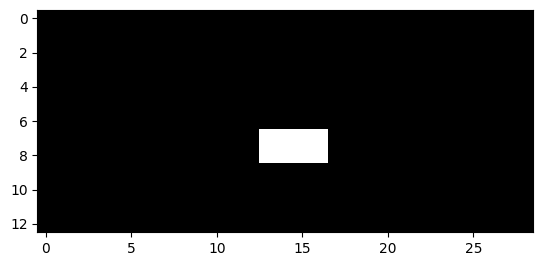

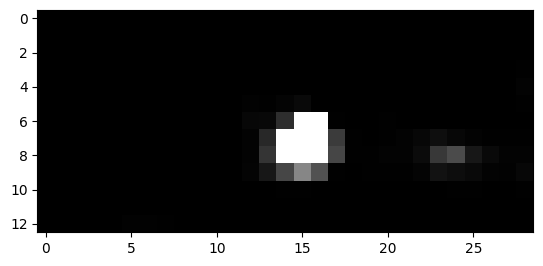

2134


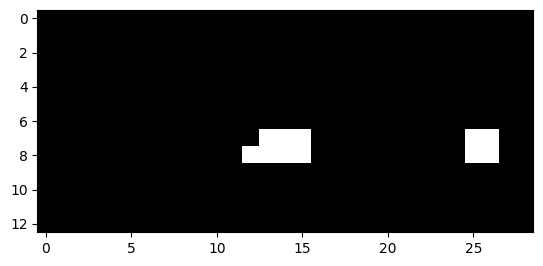

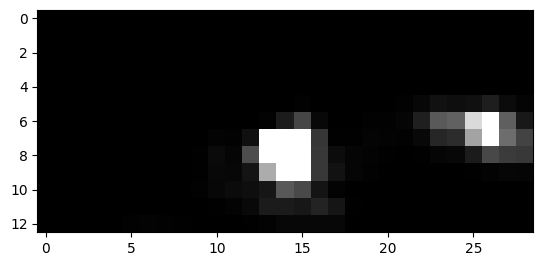

2135


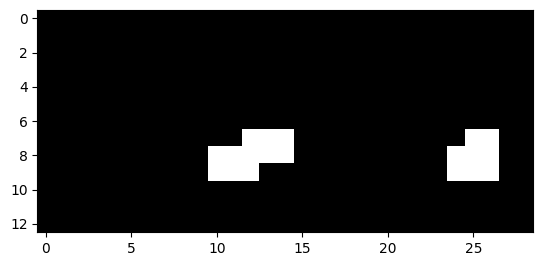

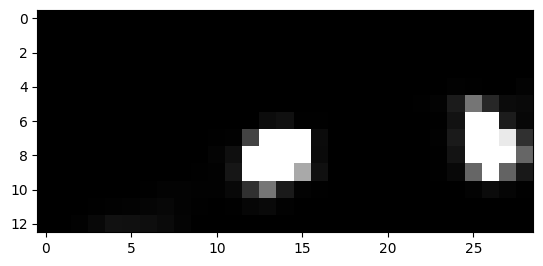

2136


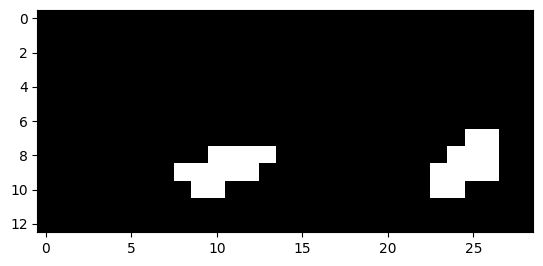

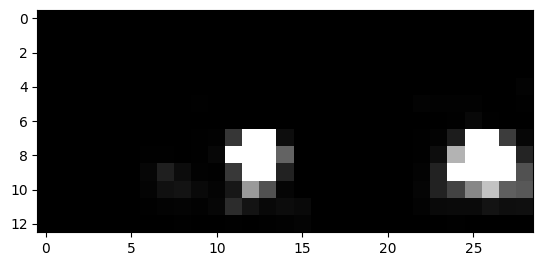

2137


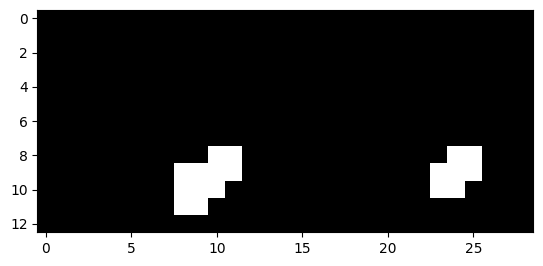

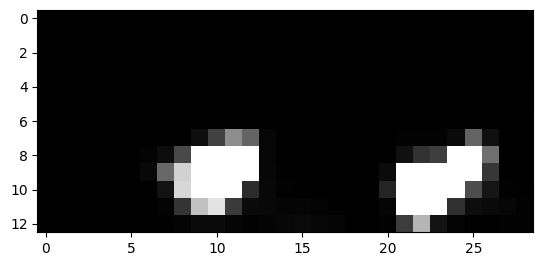

2138


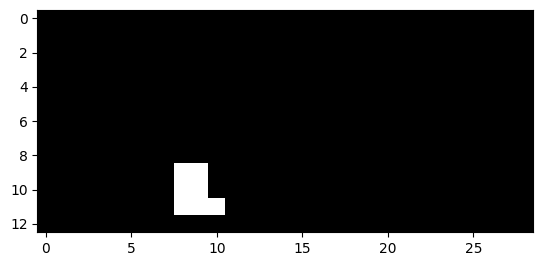

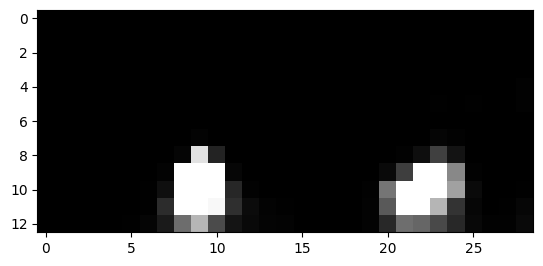

2139


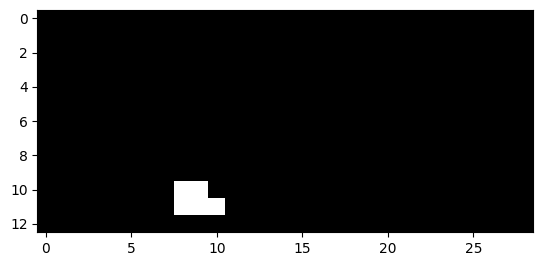

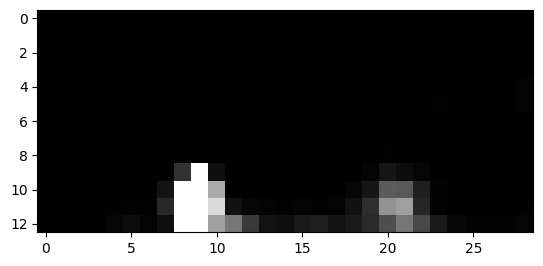

2143


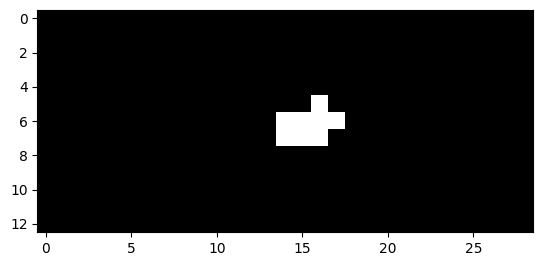

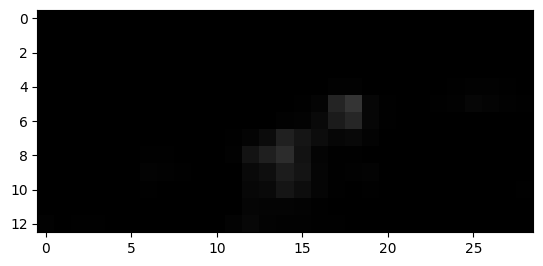

2144


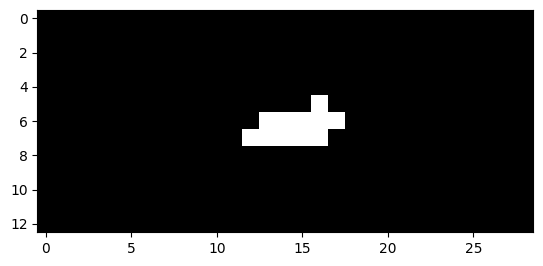

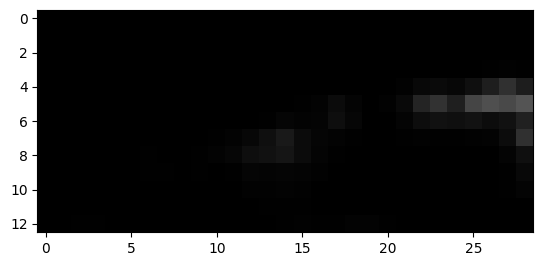

2145


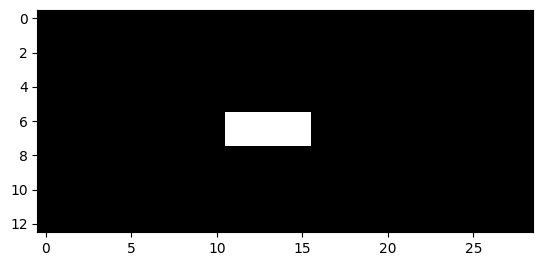

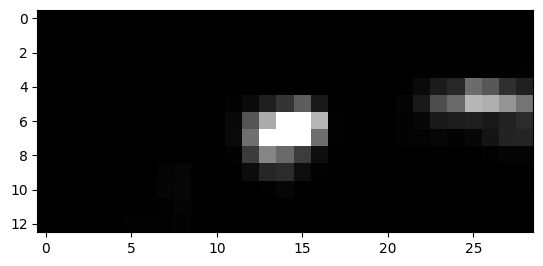

2146


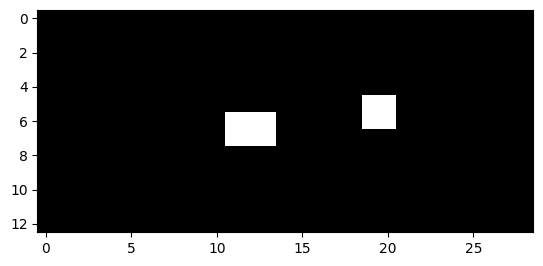

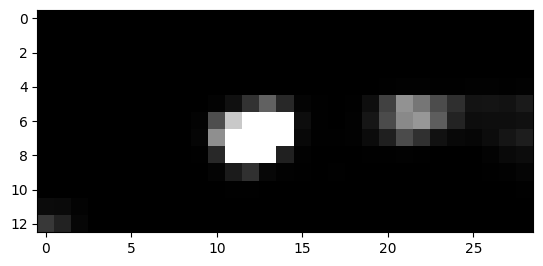

2147


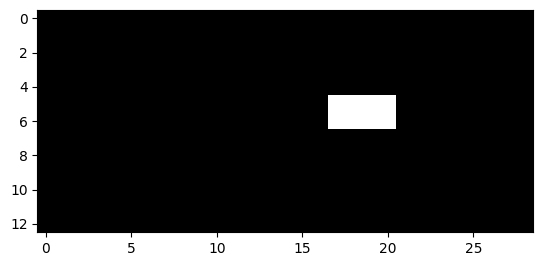

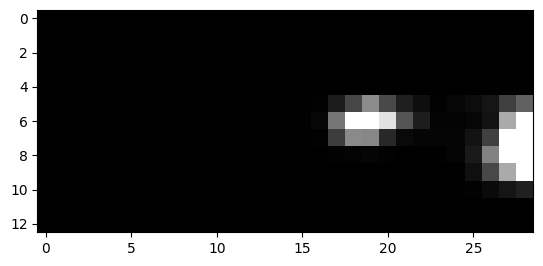

2148


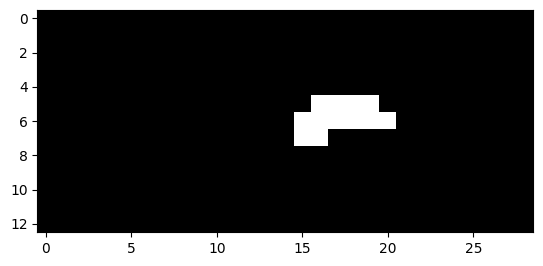

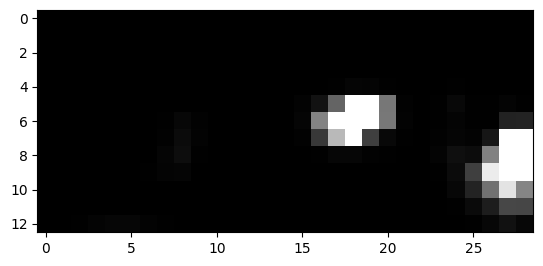

2149


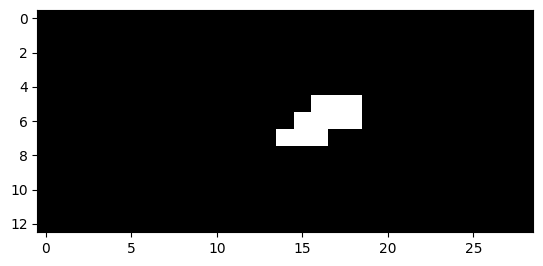

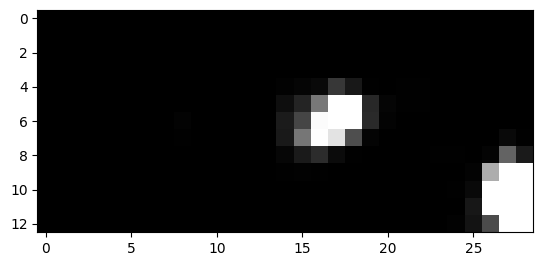

2150


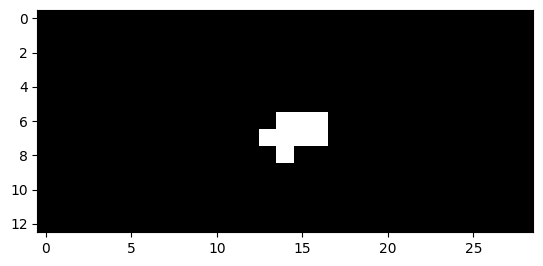

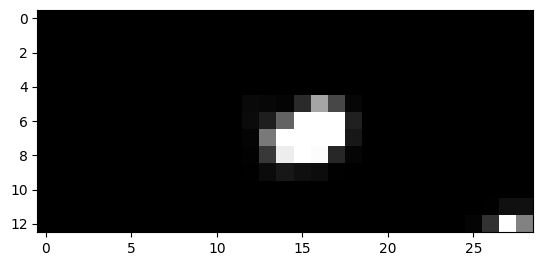

2151


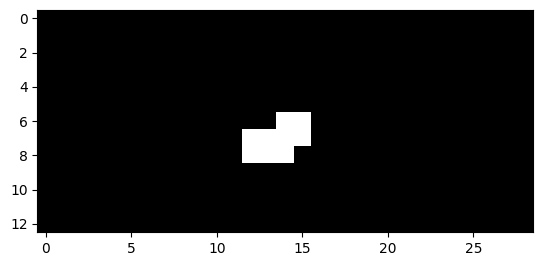

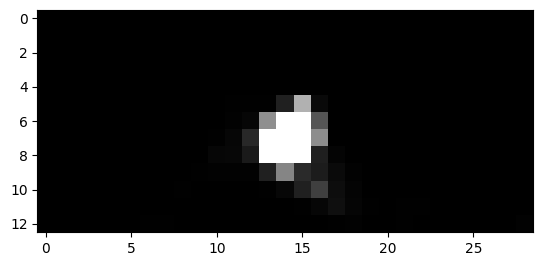

2152


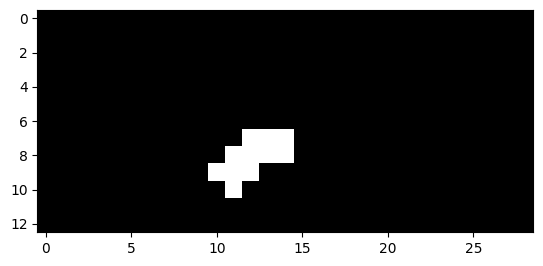

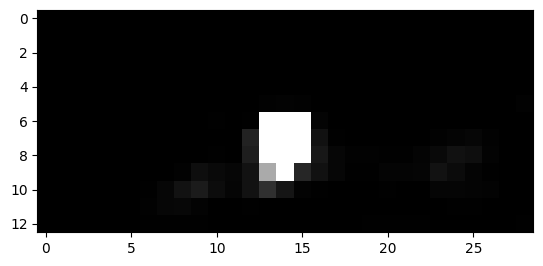

2153


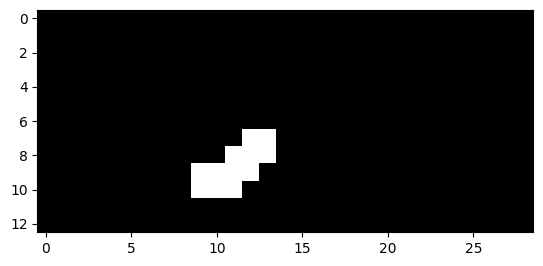

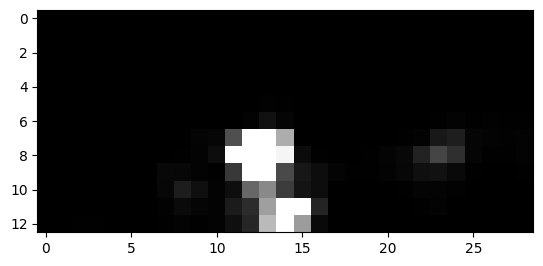

2154


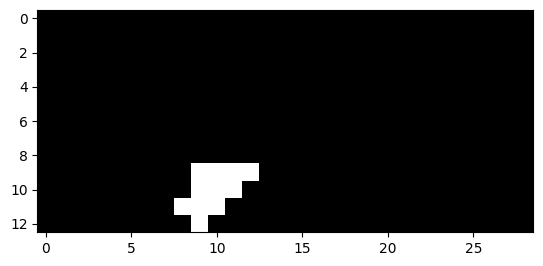

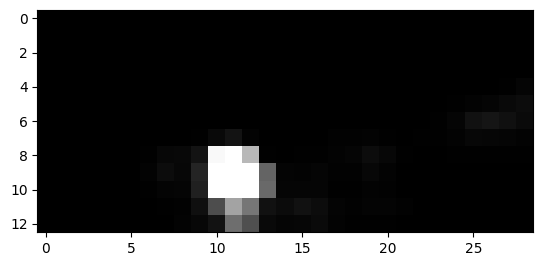

2155


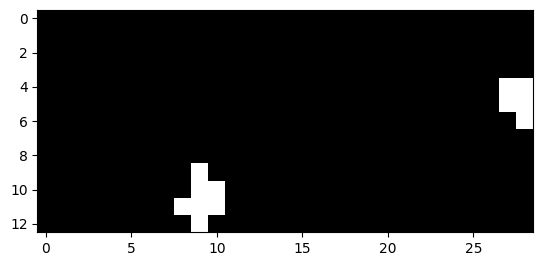

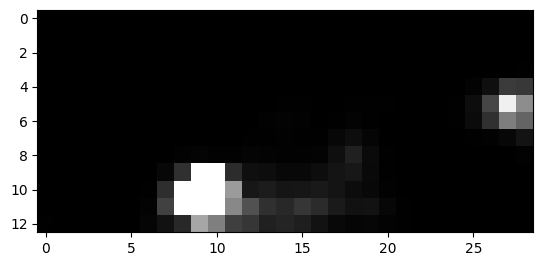

2156


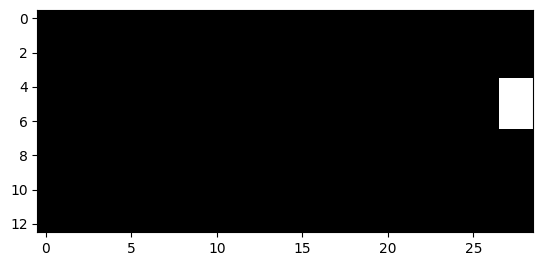

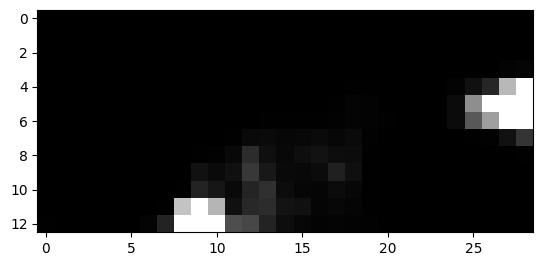

2157


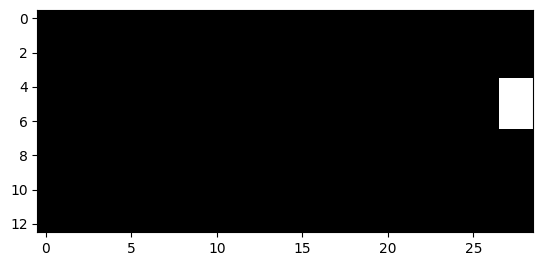

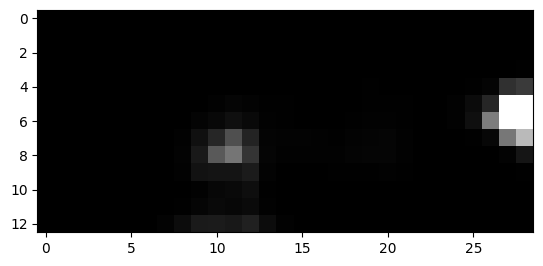

2166


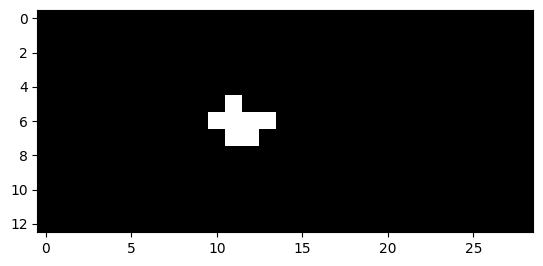

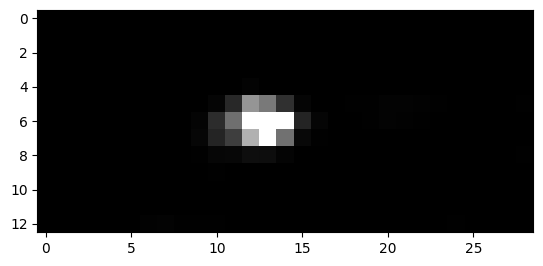

2167


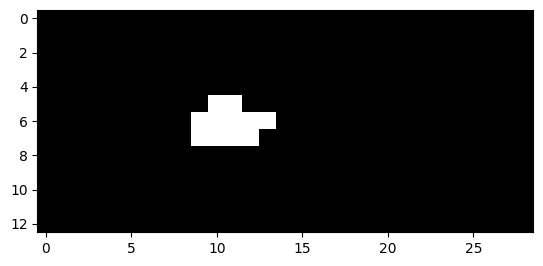

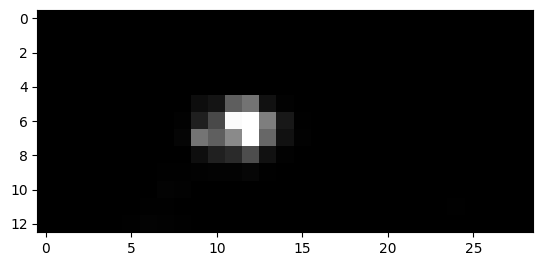

2168


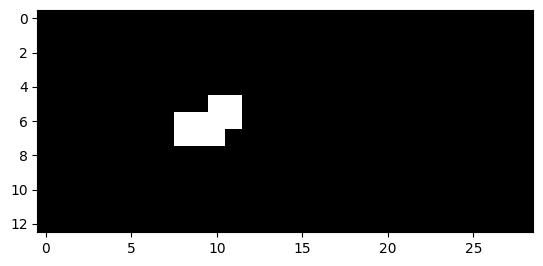

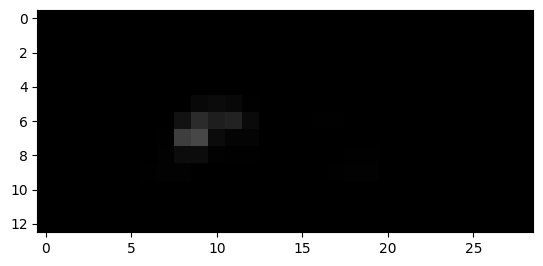

2169


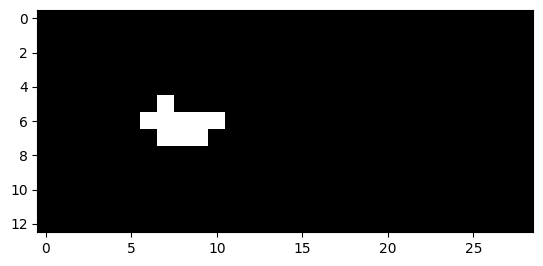

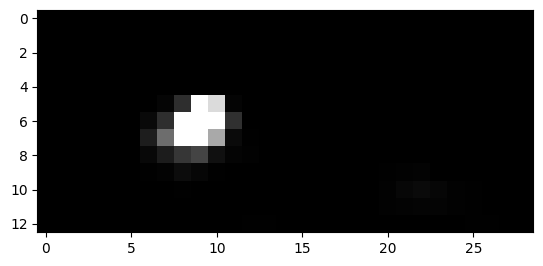

2170


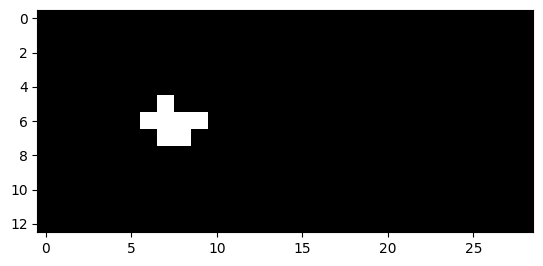

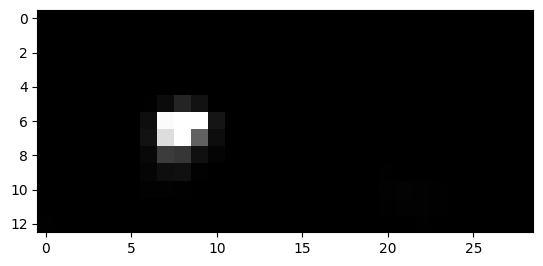

2171


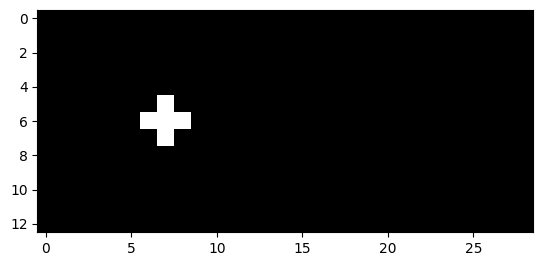

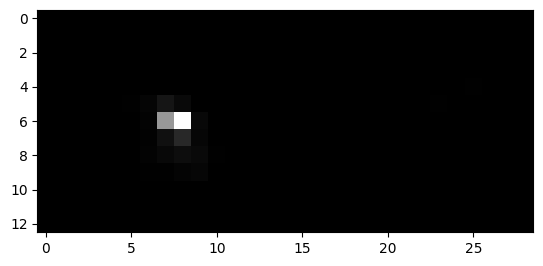

2174


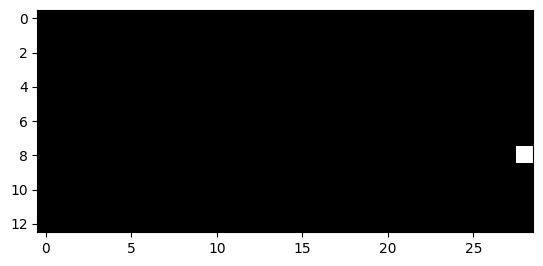

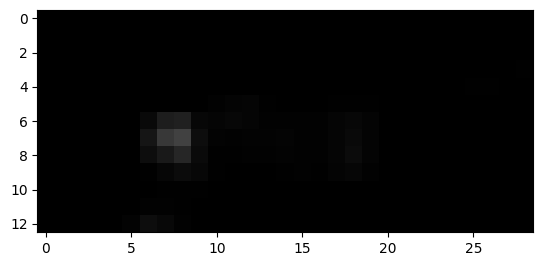

2175


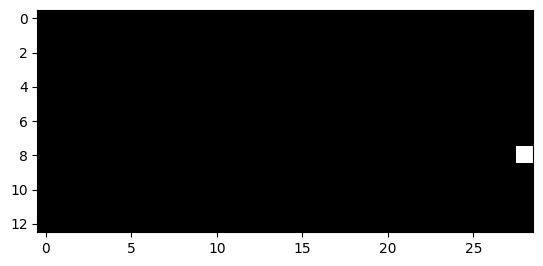

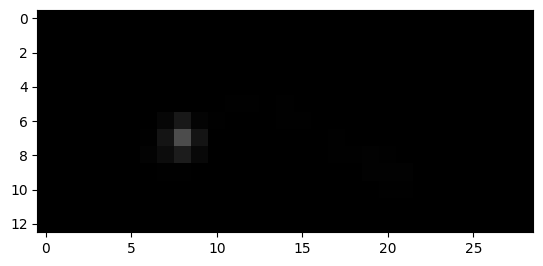

2181


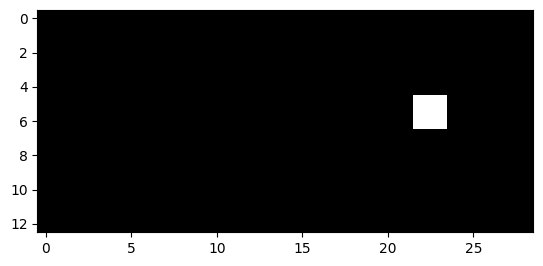

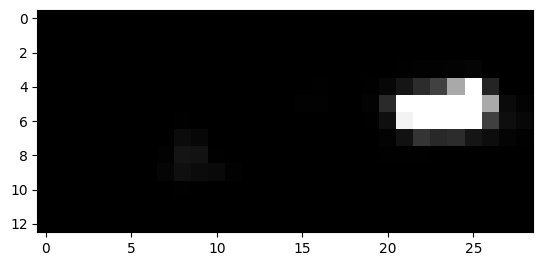

2182


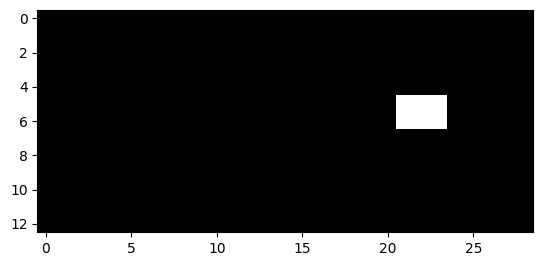

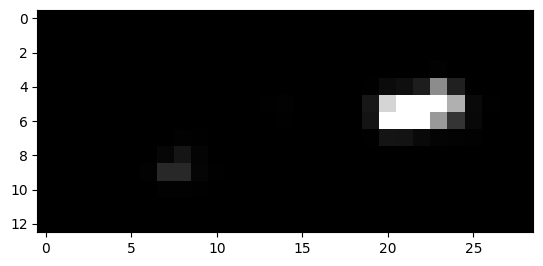

2183


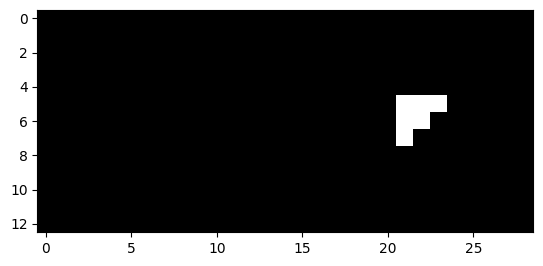

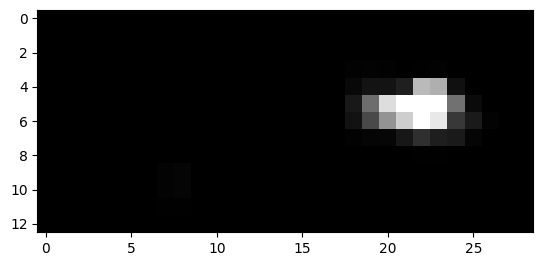

2184


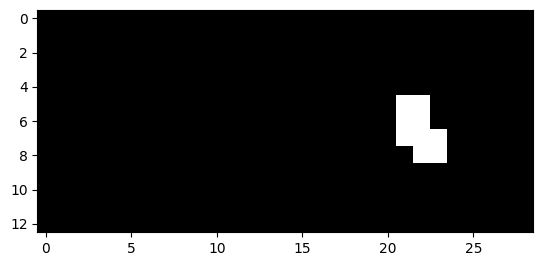

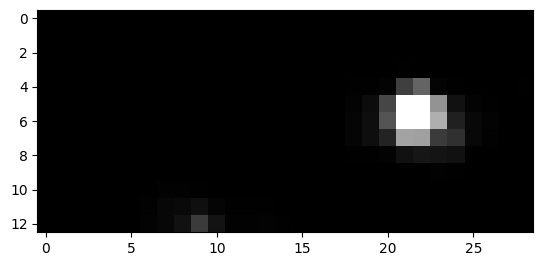

2185


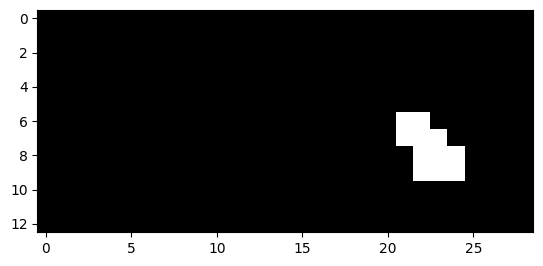

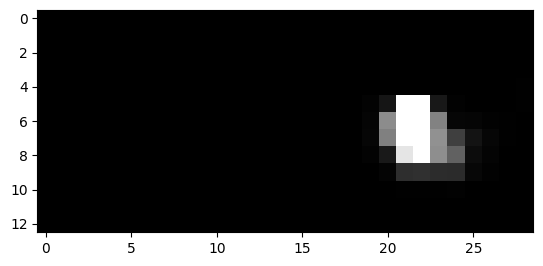

2186


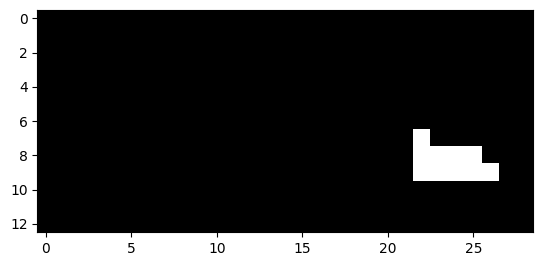

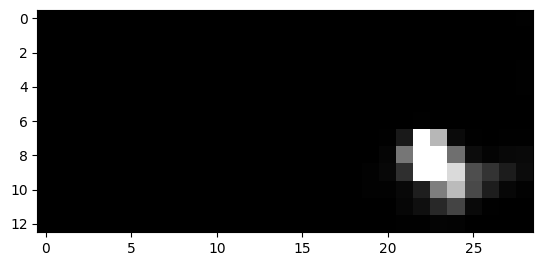

2187


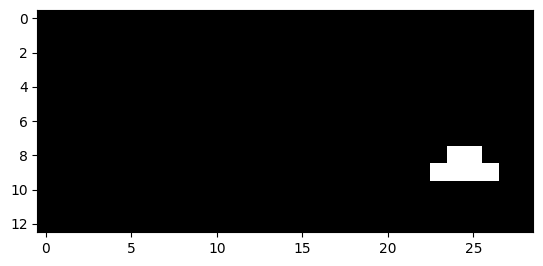

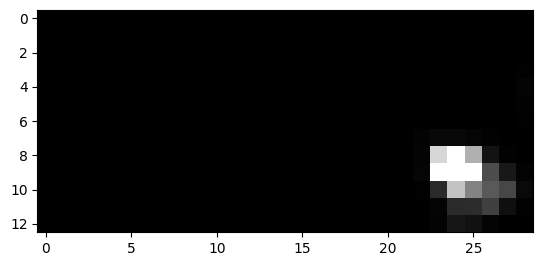

2188


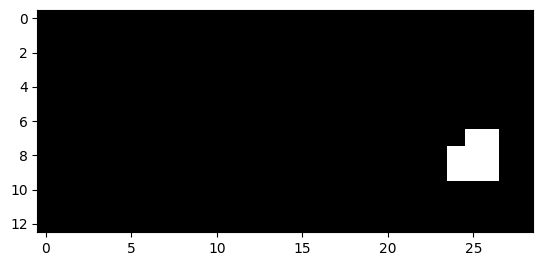

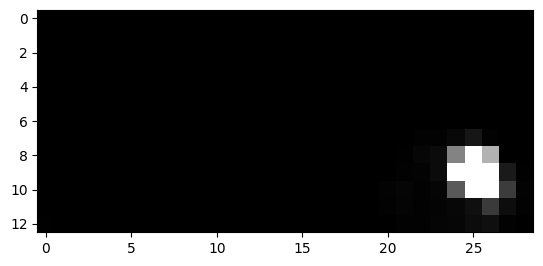

2189


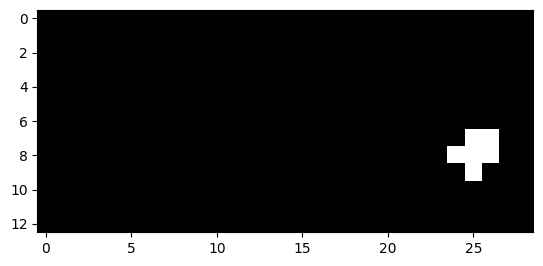

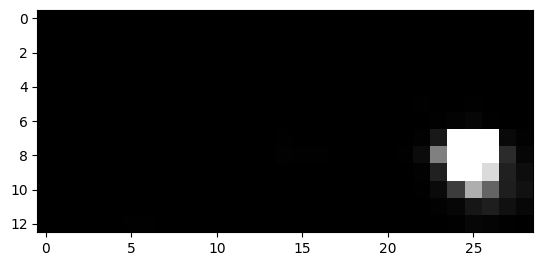

2190


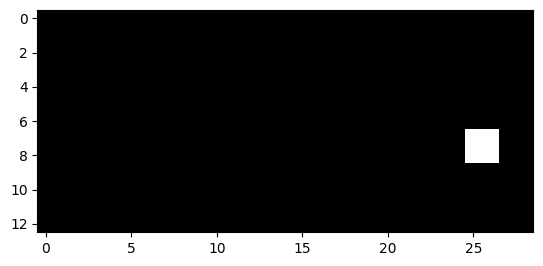

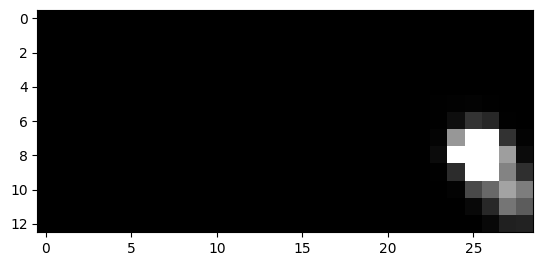

2191


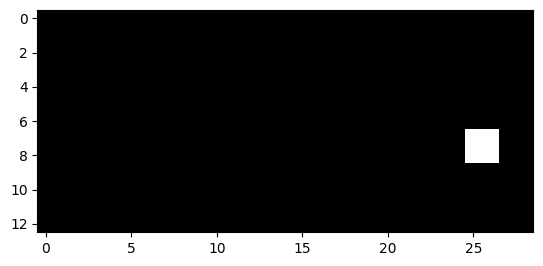

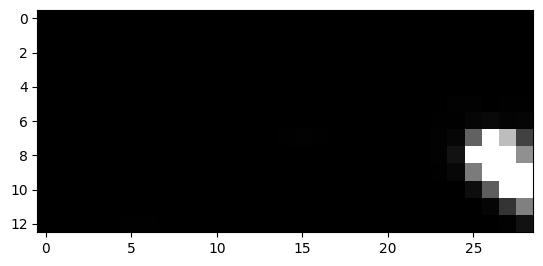

2214


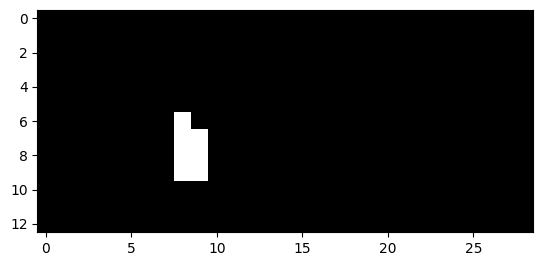

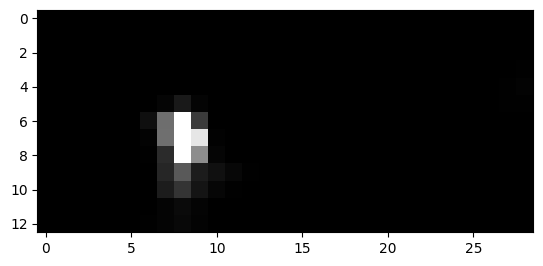

2215


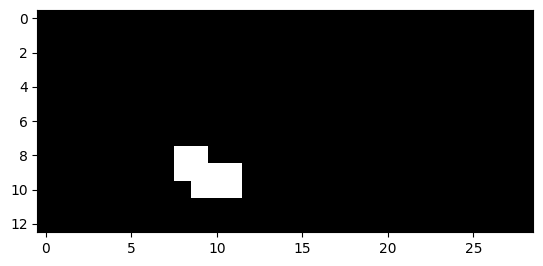

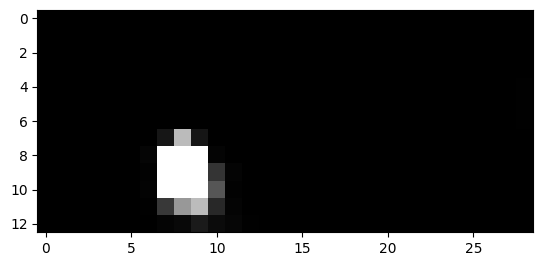

2216


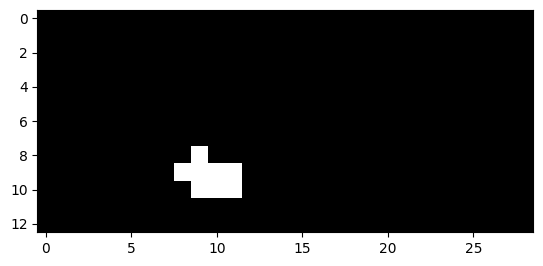

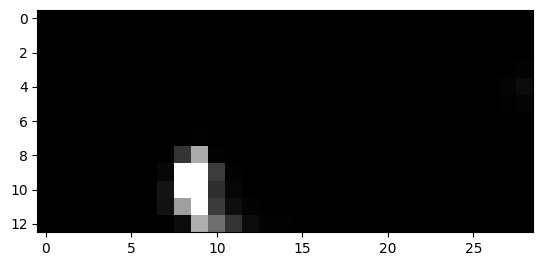

2226


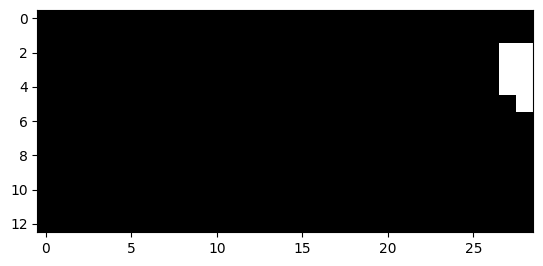

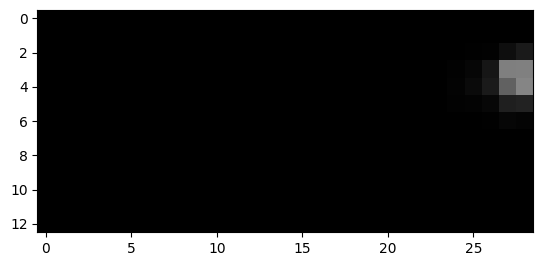

2227


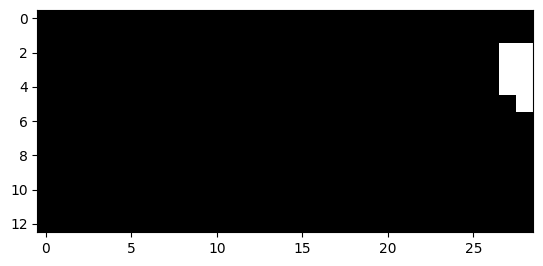

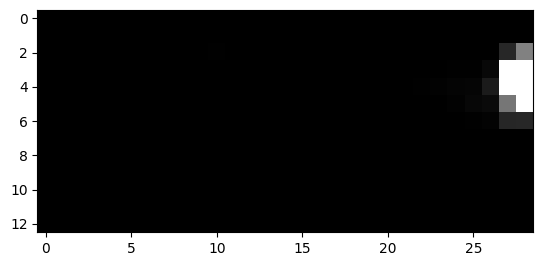

2228


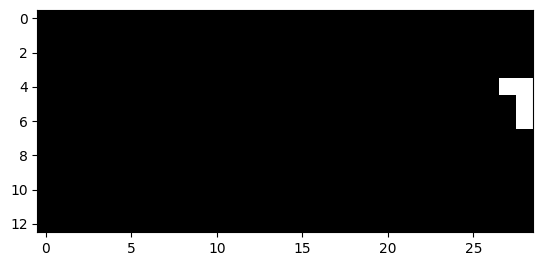

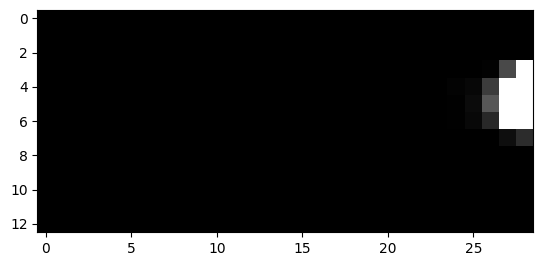

2229


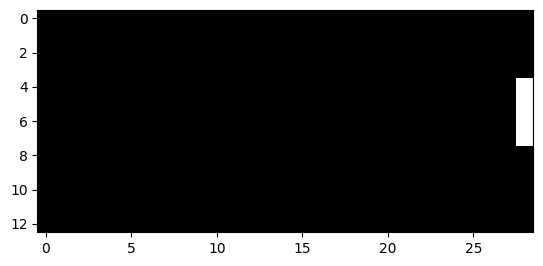

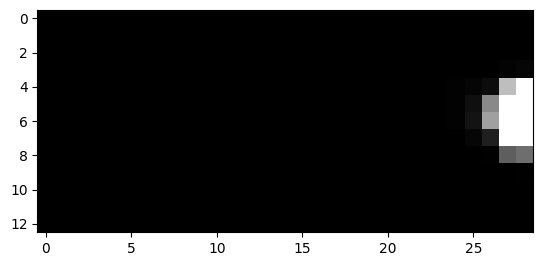

2230


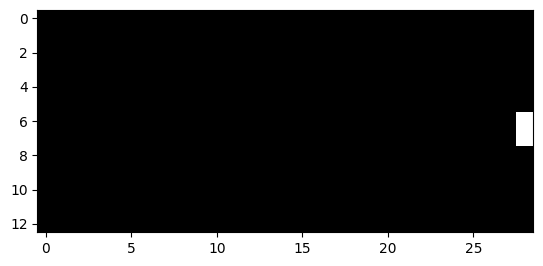

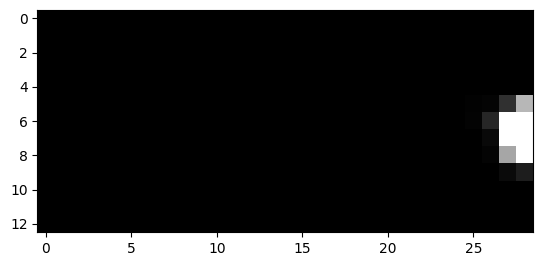

389


In [18]:
k=0
for i in range(len(y_test_img)): 
    if(np.max(y_test_img[i].reshape(-1))>0.1):
        print(i)
        plt.figure()
        plt.imshow(y_test_img[i], cmap = "gray", vmin=0, vmax=1)
        plt.show()
        plt.imshow(t[i], vmin=0, vmax=0.3, cmap = "gray")
        plt.show()
        k+=1
print(k)

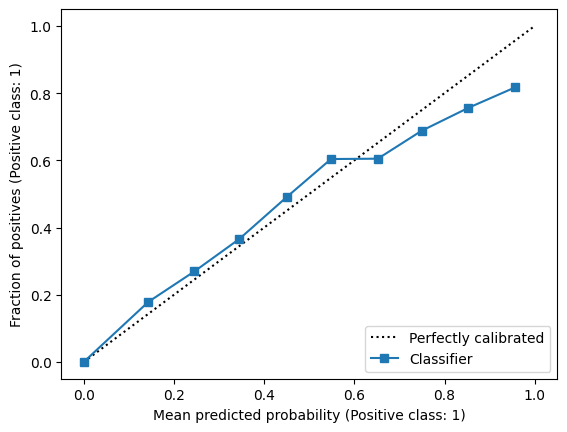

In [19]:
from sklearn.calibration import CalibrationDisplay

display = CalibrationDisplay.from_predictions(y_test_img.reshape(-1,1), t.reshape(-1,1), n_bins=10)


In [20]:
from sklearn.metrics import brier_score_loss
### brier score con probabilità predette

print(f'All zeros Brier score: {brier_score_loss(y_test_img.reshape(-1,1), np.zeros(len(y_test_img.reshape(-1,1))))}')
print(f'Model Brier score: {brier_score_loss(y_test_img.reshape(-1,1), t.reshape(-1,1))}')

All zeros Brier score: 0.0035259368257102965
Model Brier score: 0.002172682068754036


In [21]:
test['predictions_lag0'] = t.reshape(-1,1)

In [22]:
test.to_csv("test_with_newTarget_predictions.csv")

## Lags

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3 (Conv2D)           (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_4 (Conv2D)           (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_1 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_5 (Conv2D)           (None, 14, 30, 1)         73        
                                                                 
 cropping2d_1 (Cropping2D)   (None, 13, 29, 1)        

2023-03-28 10:59:39.432091: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0454

2023-03-28 10:59:42.256314: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.0454 - val_loss: 0.0165
Epoch 2/100
354/354 [==============================] - 3s 9ms/step - loss: 0.0173 - val_loss: 0.0143
Epoch 3/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0154 - val_loss: 0.0126
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0144 - val_loss: 0.0128
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0137 - val_loss: 0.0118
Epoch 6/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0134 - val_loss: 0.0118
Epoch 7/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0131 - val_loss: 0.0111
Epoch 8/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0129 - val_loss: 0.0116
Epoch 9/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0127 - val_loss: 0.0111
Epoch 10/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0126 - val_loss: 0.0111
E

2023-03-28 11:01:46.261696: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


78/78 [==============================] - 0s 2ms/step


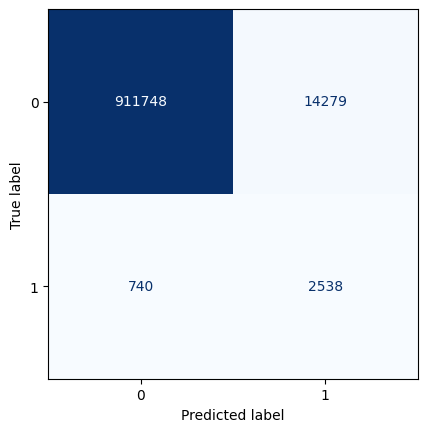

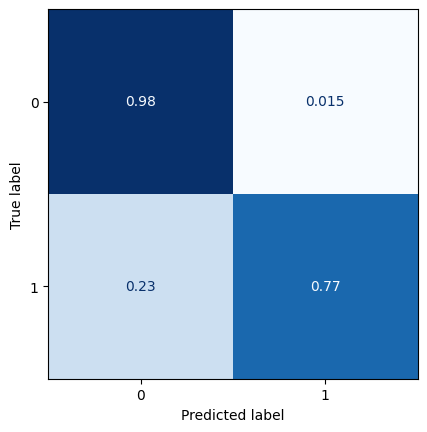

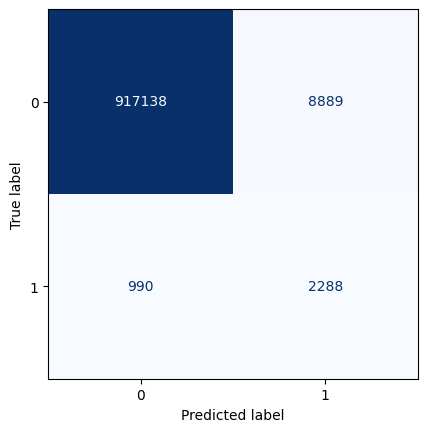

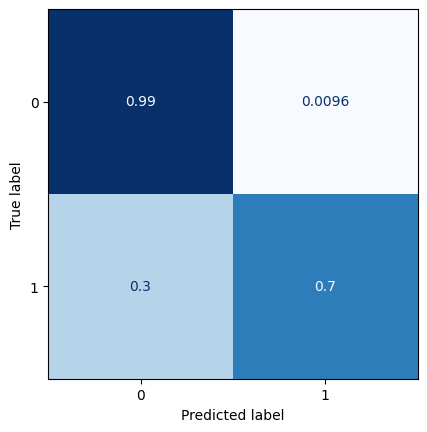

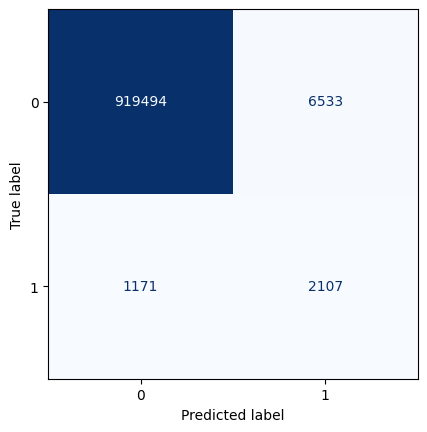

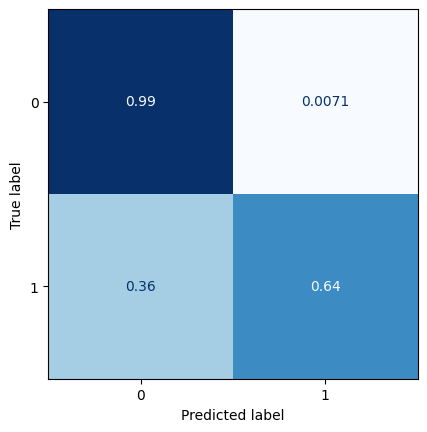

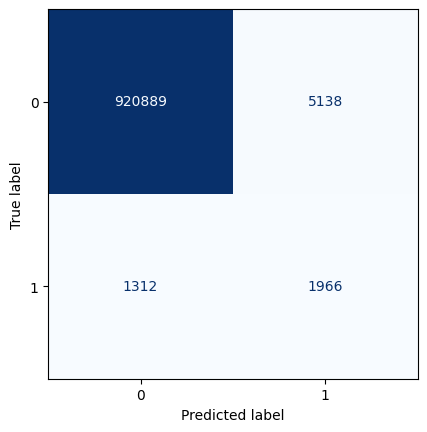

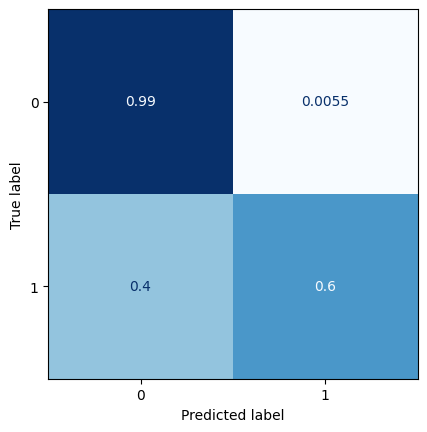

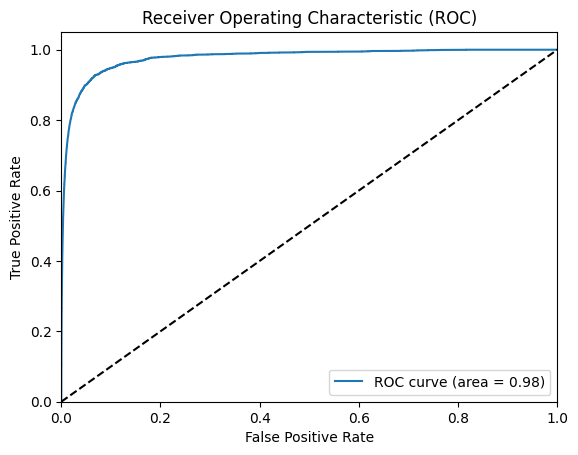

All zeros Brier score: 0.00352736722604527
Model Brier score: 0.002736149079277809
Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_7 (Conv2D)           (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_2 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_8 (Conv2D)           (None, 14, 30, 1)         73        
                                     

2023-03-28 11:02:02.298032: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.1122 - val_loss: 0.0237


2023-03-28 11:02:05.025261: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


Epoch 2/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0234 - val_loss: 0.0191
Epoch 3/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0206 - val_loss: 0.0176
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0195 - val_loss: 0.0175
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0189 - val_loss: 0.0169
Epoch 6/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0185 - val_loss: 0.0165
Epoch 7/100
354/354 [==============================] - 3s 9ms/step - loss: 0.0181 - val_loss: 0.0165
Epoch 8/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0177 - val_loss: 0.0157
Epoch 9/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0173 - val_loss: 0.0158
Epoch 10/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0170 - val_loss: 0.0154
Epoch 11/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0167 - val_l

2023-03-28 11:05:55.954056: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


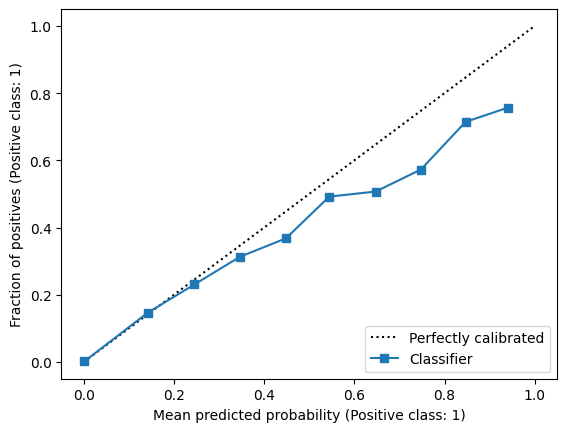

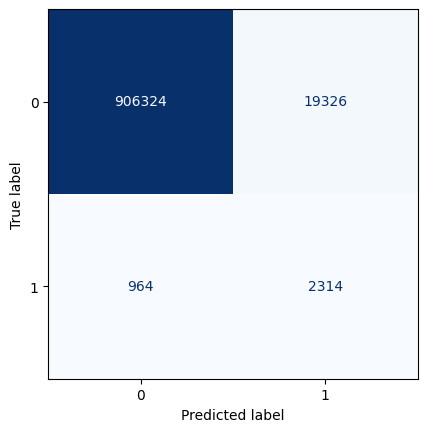

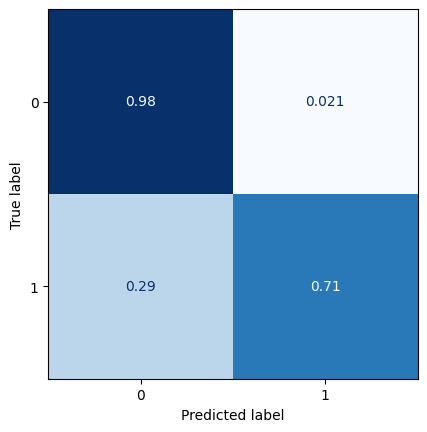

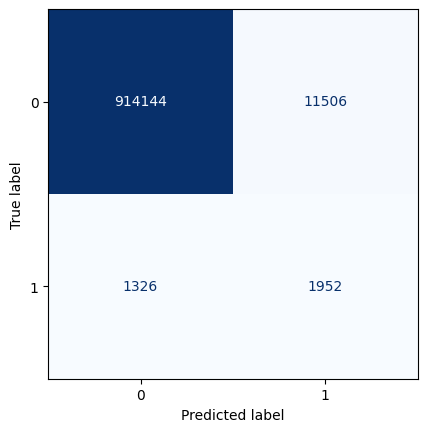

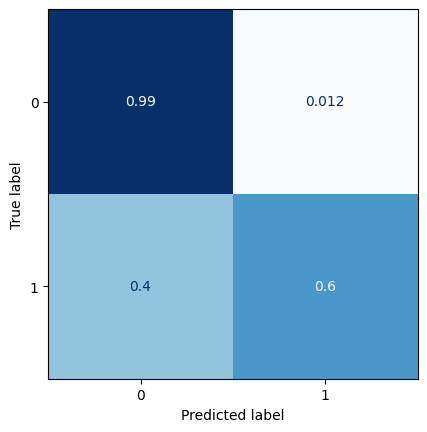

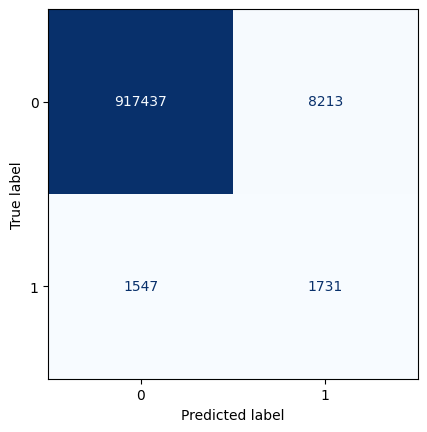

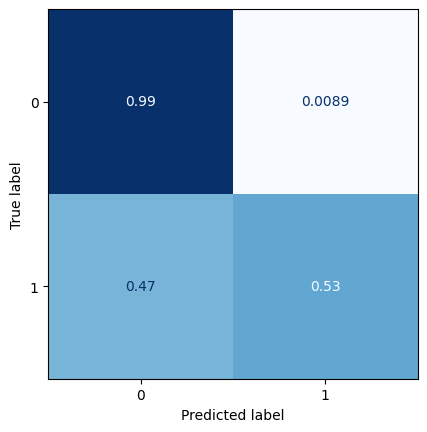

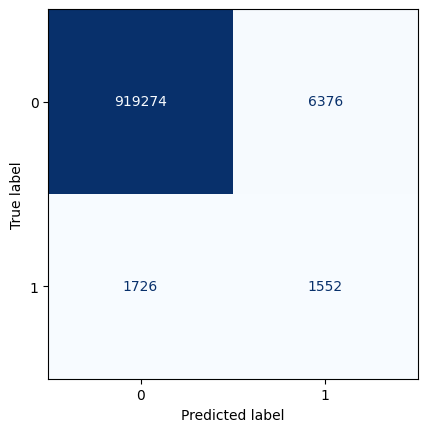

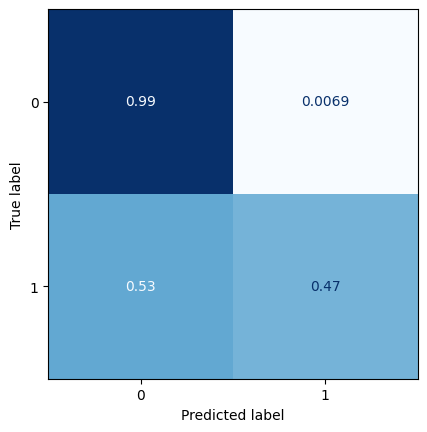

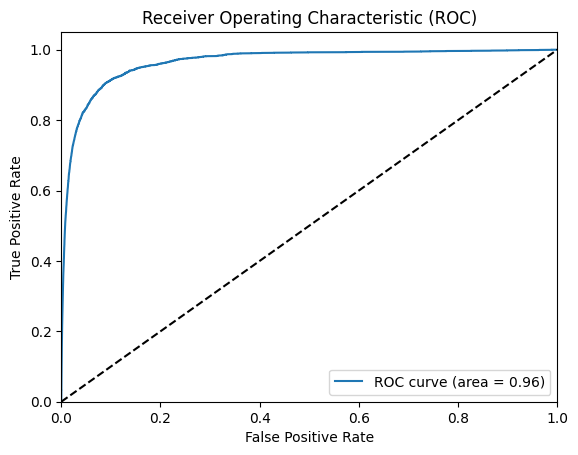

All zeros Brier score: 0.003528798787419477
Model Brier score: 0.0031380999744746304
Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_9 (Conv2D)           (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_10 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_3 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_11 (Conv2D)          (None, 14, 30, 1)         73        
                                   

2023-03-28 11:06:13.081715: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0924

2023-03-28 11:06:15.862402: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.0924 - val_loss: 0.0228
Epoch 2/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0242 - val_loss: 0.0203
Epoch 3/100
354/354 [==============================] - 3s 9ms/step - loss: 0.0216 - val_loss: 0.0187
Epoch 4/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0203 - val_loss: 0.0183
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0196 - val_loss: 0.0176
Epoch 6/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0192 - val_loss: 0.0176
Epoch 7/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0188 - val_loss: 0.0172
Epoch 8/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0185 - val_loss: 0.0172
Epoch 9/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0184 - val_loss: 0.0174
Epoch 10/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0182 - val_loss: 0.0168
E

2023-03-28 11:07:55.162788: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


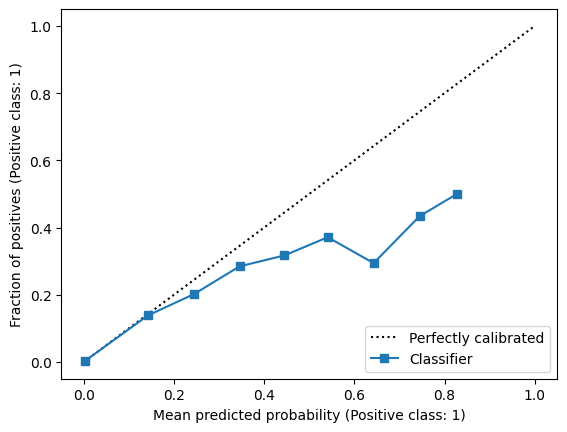

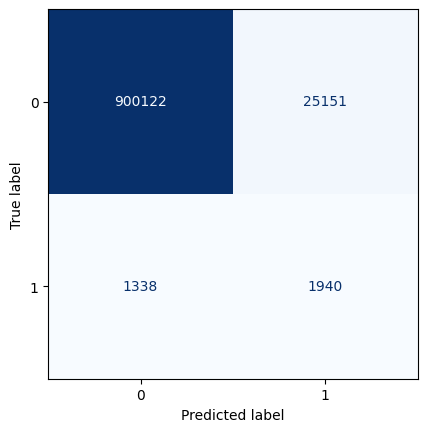

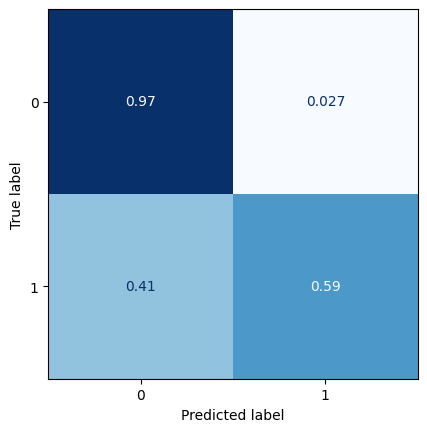

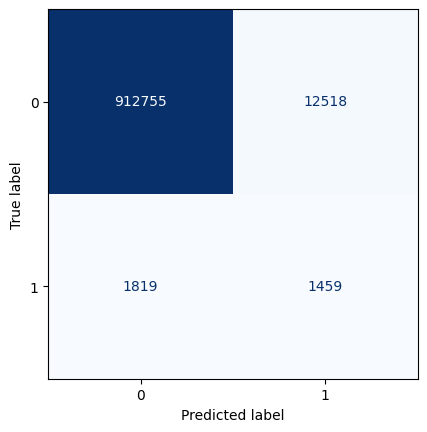

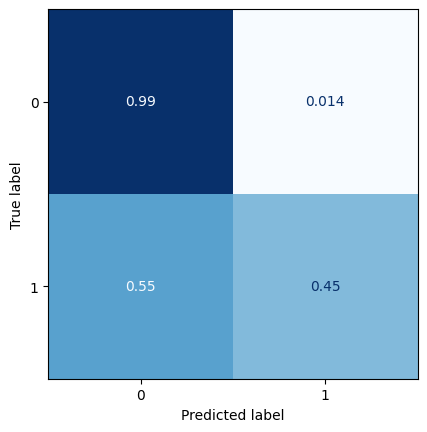

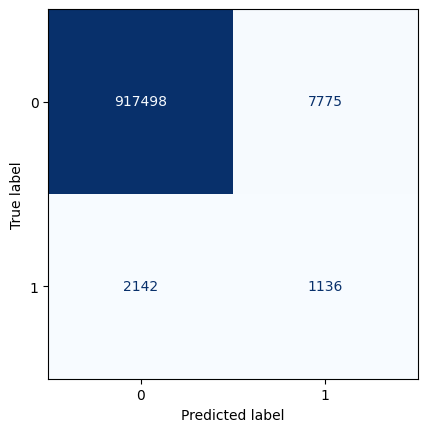

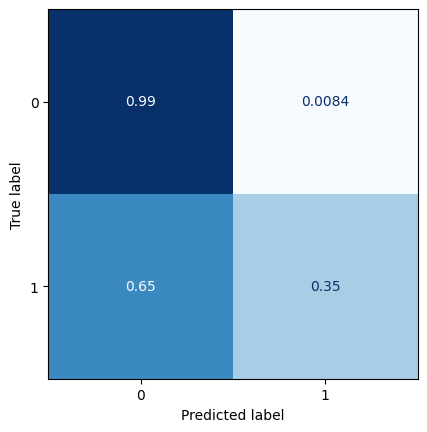

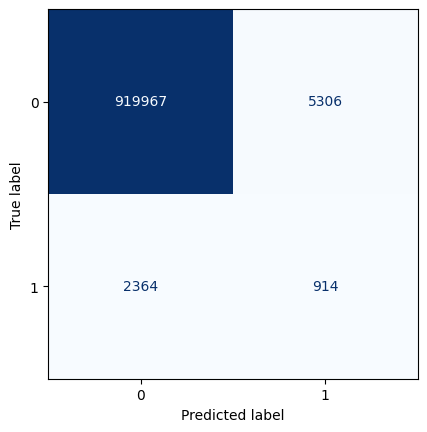

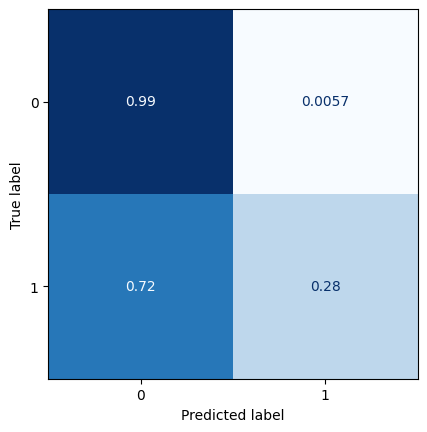

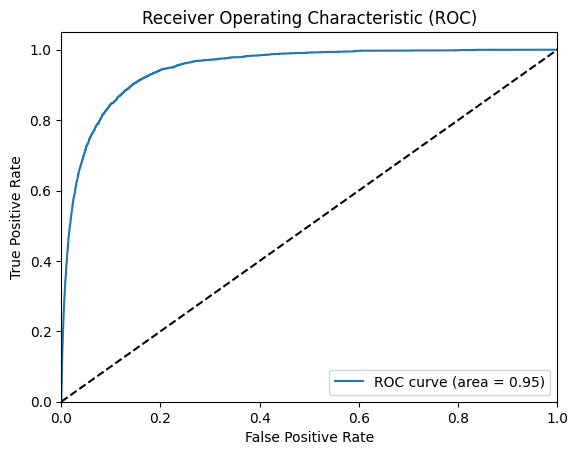

All zeros Brier score: 0.0035302315112470937
Model Brier score: 0.003340098371057907
Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_12 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_13 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_4 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_14 (Conv2D)          (None, 14, 30, 1)         73        
                                   

2023-03-28 11:08:12.666334: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0430

2023-03-28 11:08:15.458858: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.0430 - val_loss: 0.0211
Epoch 2/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0223 - val_loss: 0.0198
Epoch 3/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0211 - val_loss: 0.0190
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0206 - val_loss: 0.0189
Epoch 5/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0202 - val_loss: 0.0185
Epoch 6/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0200 - val_loss: 0.0186
Epoch 7/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0198 - val_loss: 0.0183
Epoch 8/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0196 - val_loss: 0.0179
Epoch 9/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0194 - val_loss: 0.0183
Epoch 10/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0193 - val_loss: 0.0180
E

2023-03-28 11:10:23.722777: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


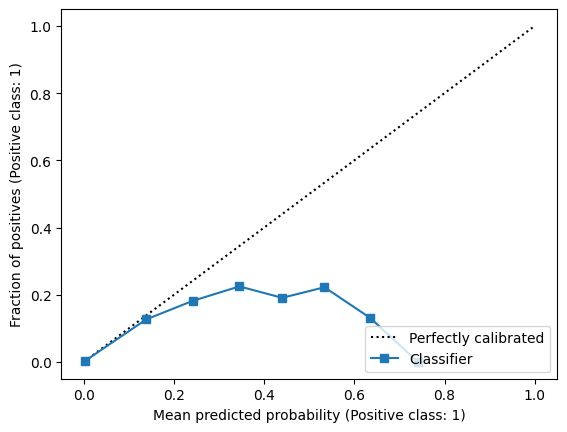

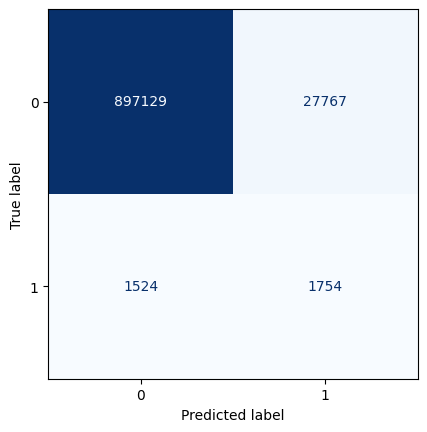

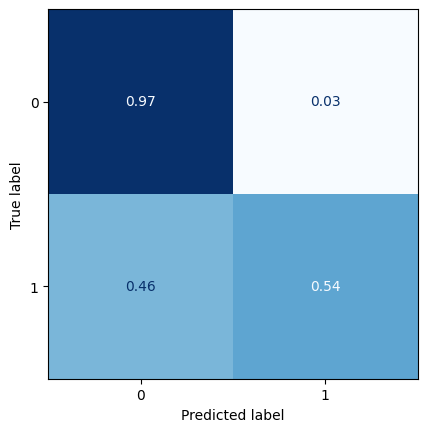

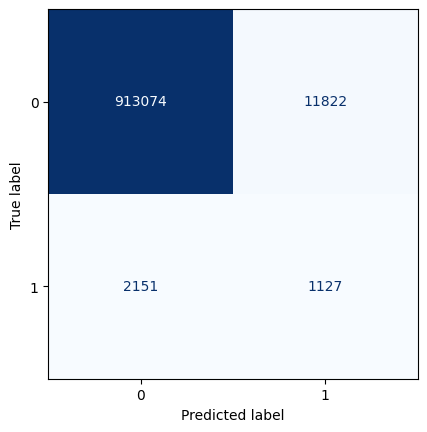

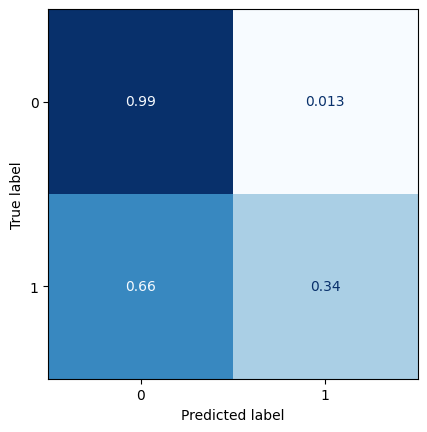

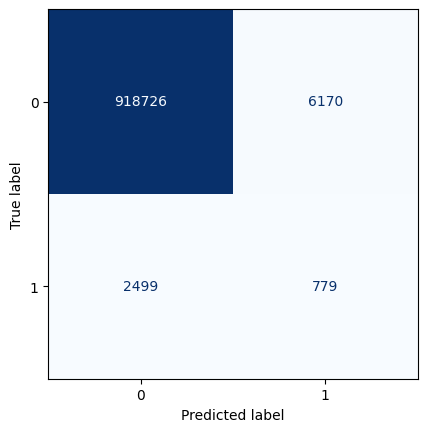

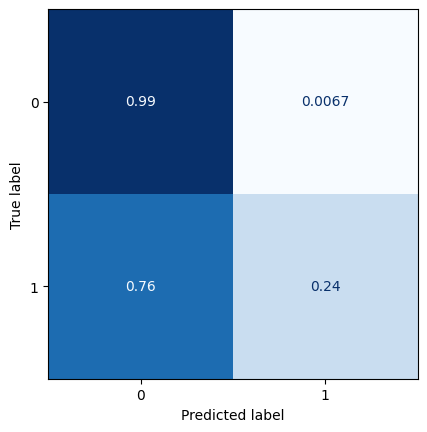

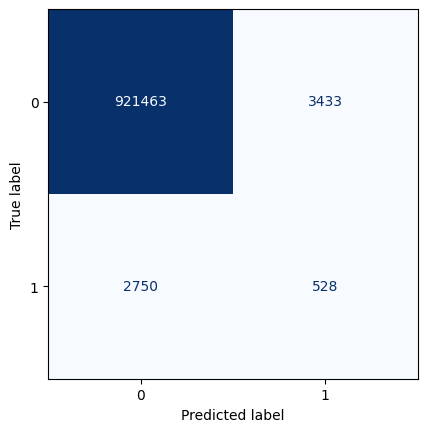

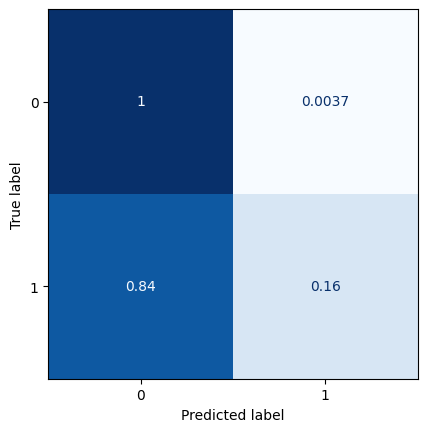

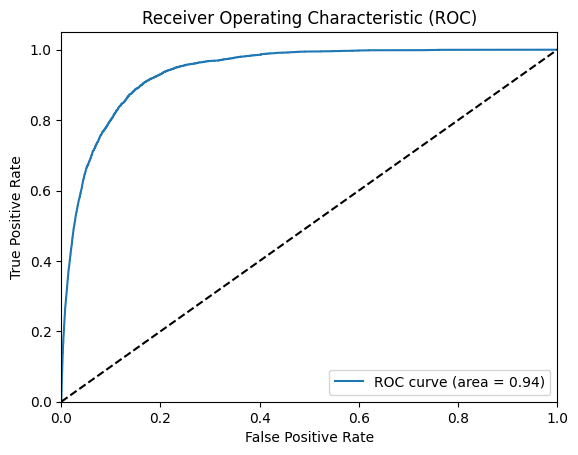

All zeros Brier score: 0.0035316653989445946
Model Brier score: 0.003369550319754776
Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_15 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_16 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_5 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_17 (Conv2D)          (None, 14, 30, 1)         73        
                                   

2023-03-28 11:10:41.885585: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0708

2023-03-28 11:10:44.657780: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.0708 - val_loss: 0.0229
Epoch 2/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0242 - val_loss: 0.0207
Epoch 3/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0225 - val_loss: 0.0200
Epoch 4/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0218 - val_loss: 0.0195
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0214 - val_loss: 0.0190
Epoch 6/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0211 - val_loss: 0.0192
Epoch 7/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0208 - val_loss: 0.0188
Epoch 8/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0207 - val_loss: 0.0186
Epoch 9/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0205 - val_loss: 0.0190
Epoch 10/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0204 - val_loss: 0.0191
E

2023-03-28 11:13:03.427060: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


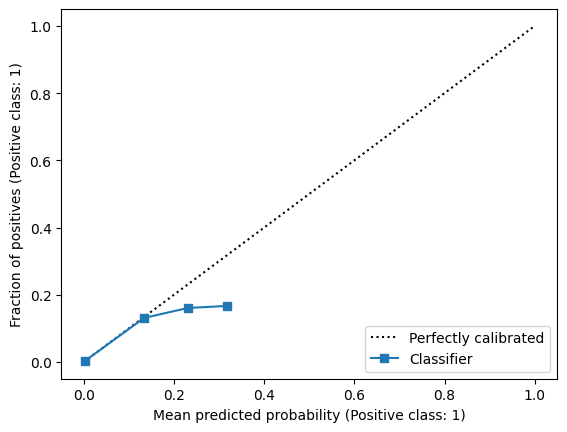

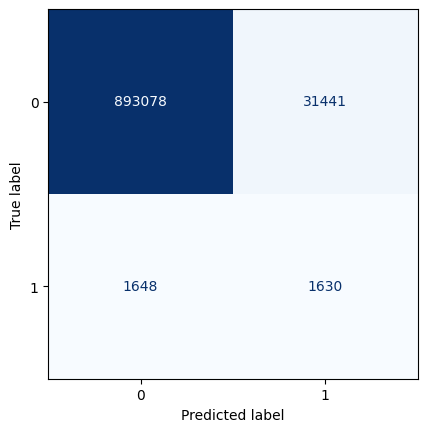

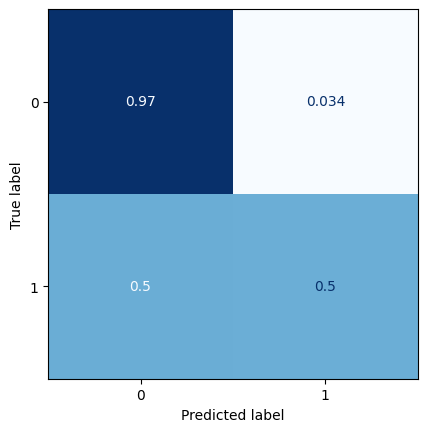

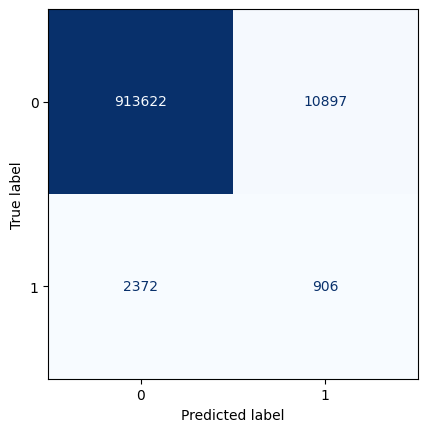

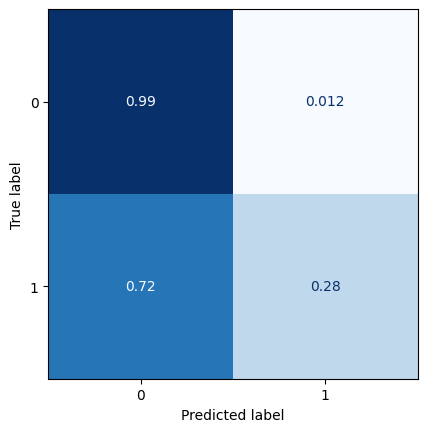

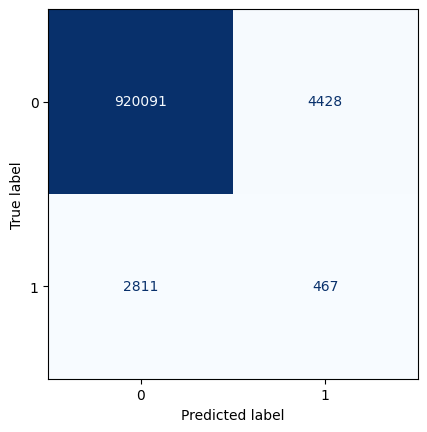

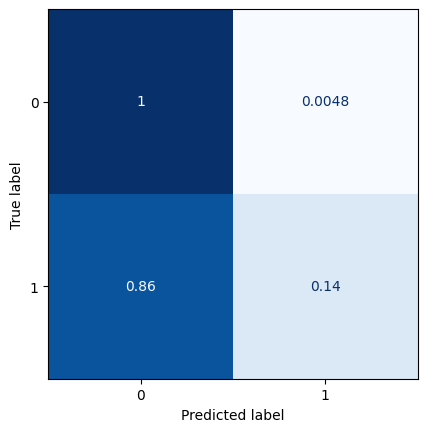

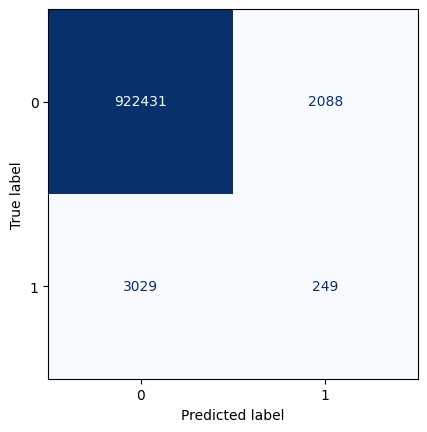

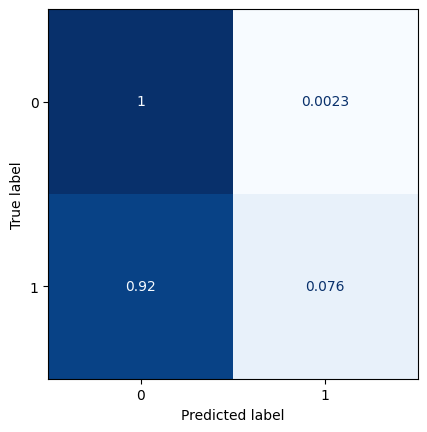

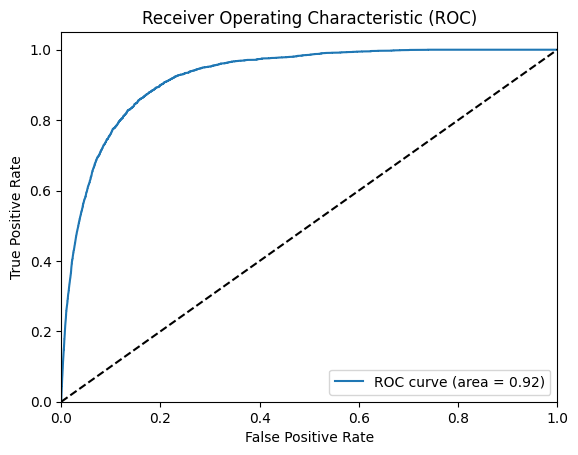

All zeros Brier score: 0.0035331004519307562
Model Brier score: 0.003414690807235763
Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_18 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_19 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_6 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_20 (Conv2D)          (None, 14, 30, 1)         73        
                                   

2023-03-28 11:13:22.381228: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0669

2023-03-28 11:13:25.135576: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.0669 - val_loss: 0.0231
Epoch 2/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0246 - val_loss: 0.0209
Epoch 3/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0230 - val_loss: 0.0203
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0222 - val_loss: 0.0197
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0218 - val_loss: 0.0196
Epoch 6/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0215 - val_loss: 0.0192
Epoch 7/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0212 - val_loss: 0.0191
Epoch 8/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0211 - val_loss: 0.0196
Epoch 9/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0209 - val_loss: 0.0196
Epoch 10/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0208 - val_loss: 0.0193
E

2023-03-28 11:15:41.788530: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


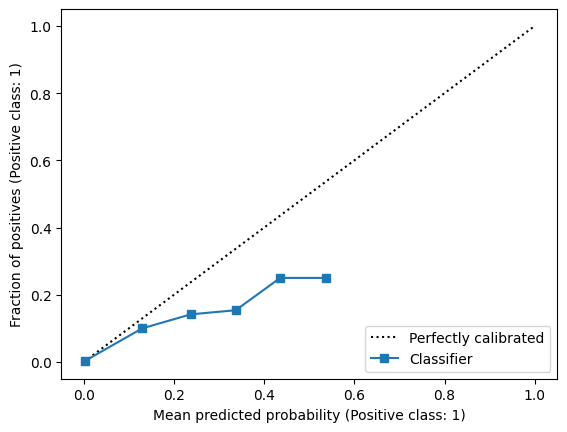

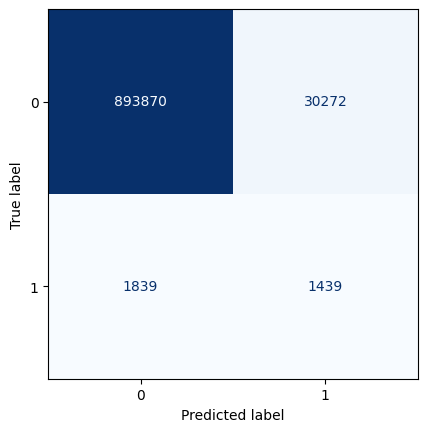

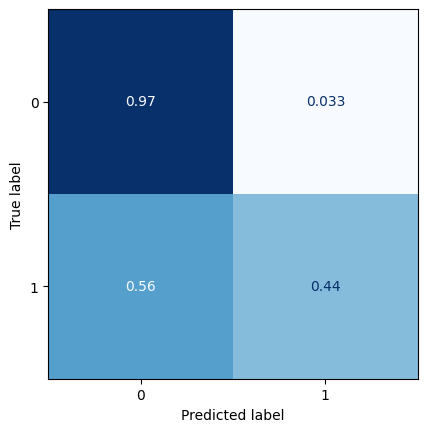

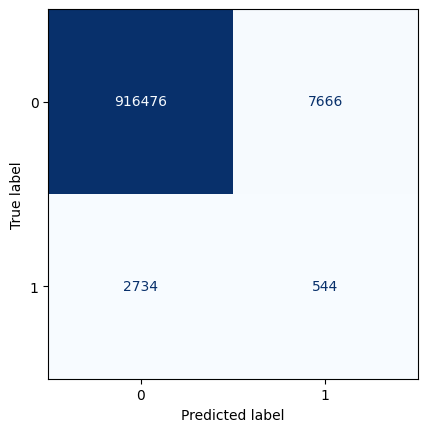

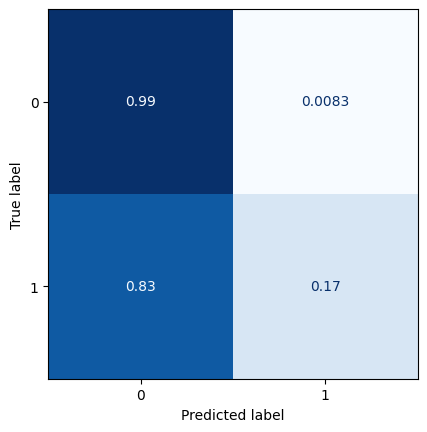

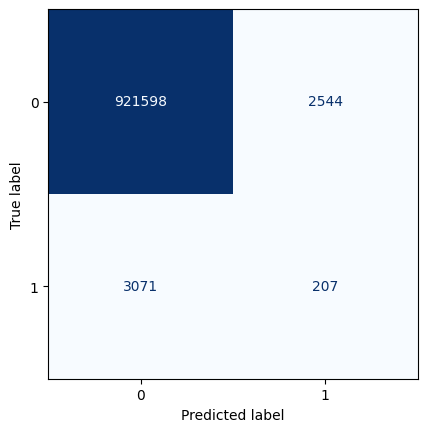

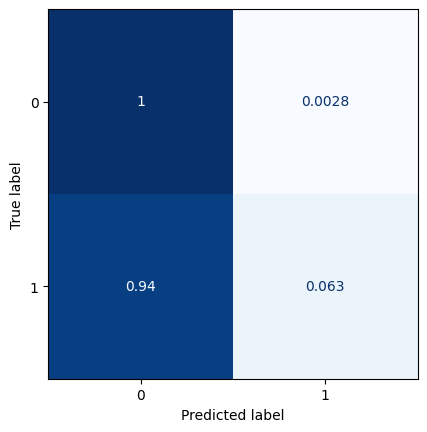

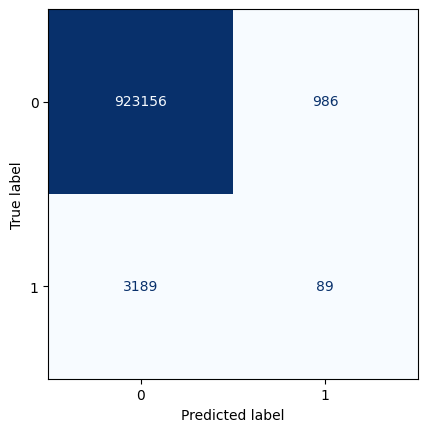

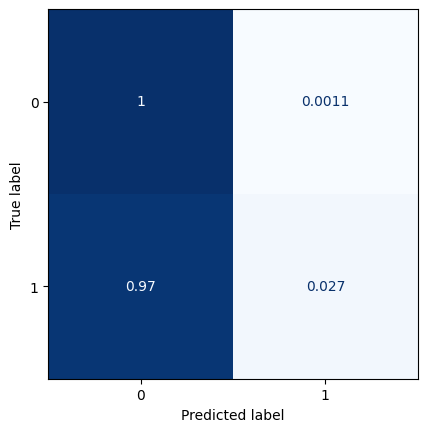

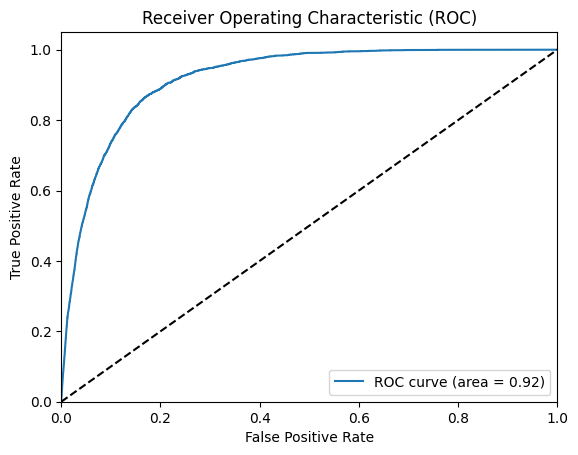

All zeros Brier score: 0.003534536671626663
Model Brier score: 0.003440155557271136
Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_21 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_7 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_22 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_7 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_23 (Conv2D)          (None, 14, 30, 1)         73        
                                    

2023-03-28 11:16:01.284930: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.1477

2023-03-28 11:16:04.007383: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.1477 - val_loss: 0.0267
Epoch 2/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0278 - val_loss: 0.0232
Epoch 3/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0253 - val_loss: 0.0220
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0241 - val_loss: 0.0213
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0232 - val_loss: 0.0205
Epoch 6/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0225 - val_loss: 0.0202
Epoch 7/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0220 - val_loss: 0.0200
Epoch 8/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0217 - val_loss: 0.0199
Epoch 9/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0215 - val_loss: 0.0195
Epoch 10/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0214 - val_loss: 0.0194
E

2023-03-28 11:17:52.256299: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 2ms/step


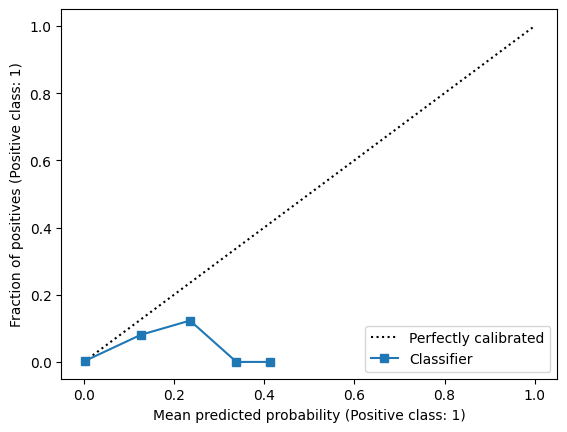

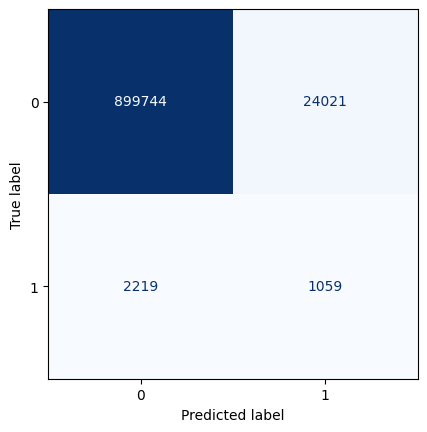

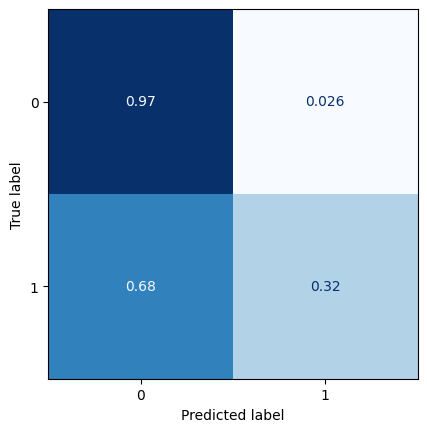

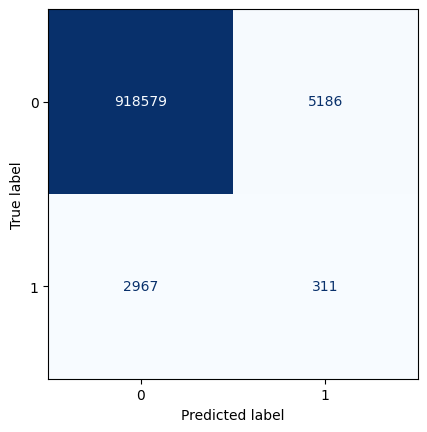

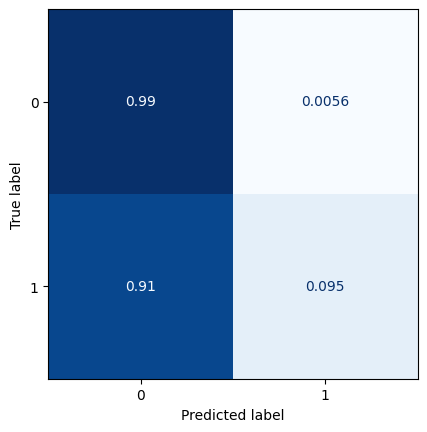

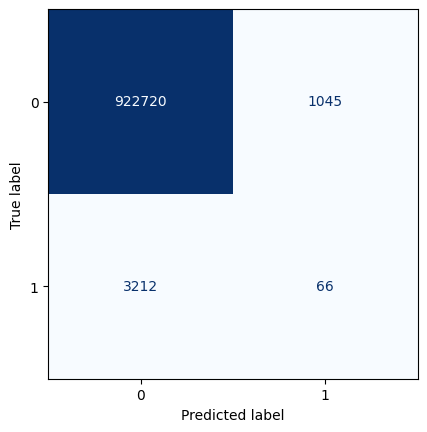

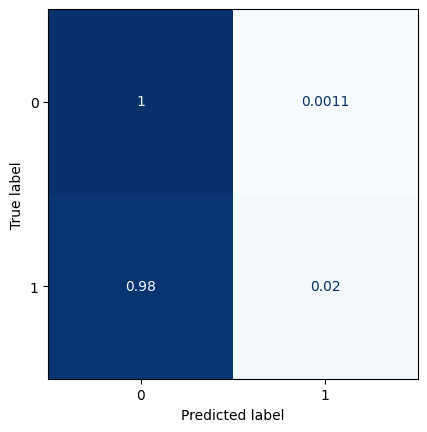

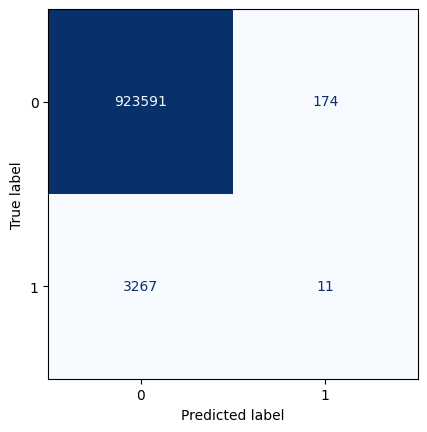

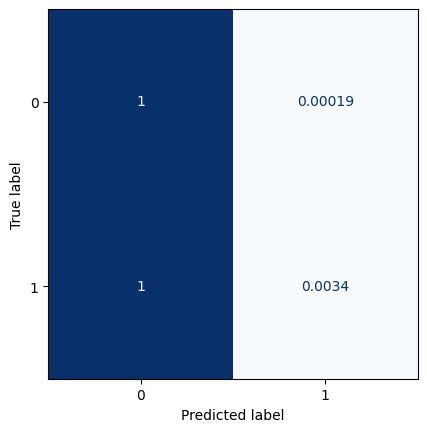

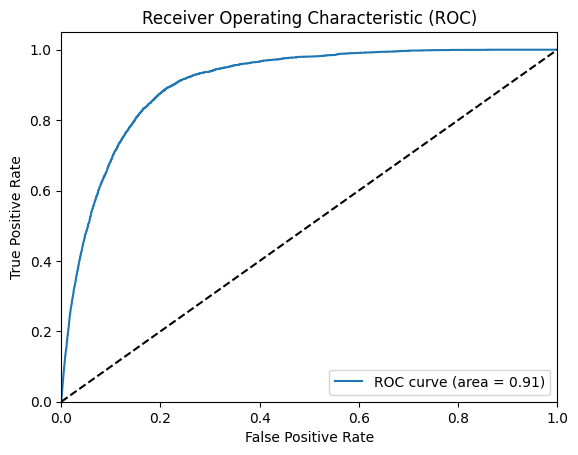

All zeros Brier score: 0.00353597405945571
Model Brier score: 0.0034597454648158136
Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_24 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_8 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_25 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_8 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_26 (Conv2D)          (None, 14, 30, 1)         73        
                                    

2023-03-28 11:18:12.313033: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0451

2023-03-28 11:18:15.130543: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.0451 - val_loss: 0.0231
Epoch 2/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0242 - val_loss: 0.0213
Epoch 3/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0228 - val_loss: 0.0205
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0222 - val_loss: 0.0199
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0218 - val_loss: 0.0199
Epoch 6/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0216 - val_loss: 0.0194
Epoch 7/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0214 - val_loss: 0.0194
Epoch 8/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0212 - val_loss: 0.0193
Epoch 9/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0211 - val_loss: 0.0194
Epoch 10/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0210 - val_loss: 0.0191
E

2023-03-28 11:19:39.004748: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


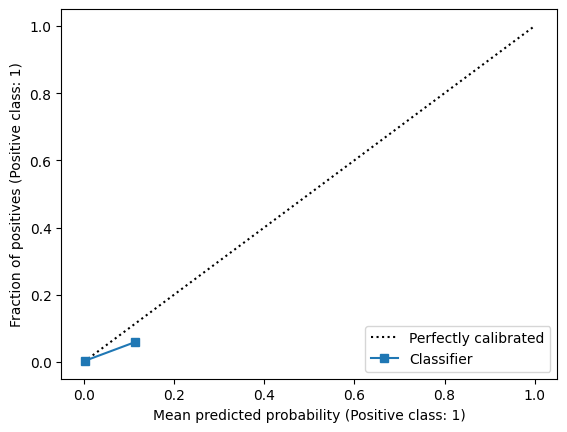

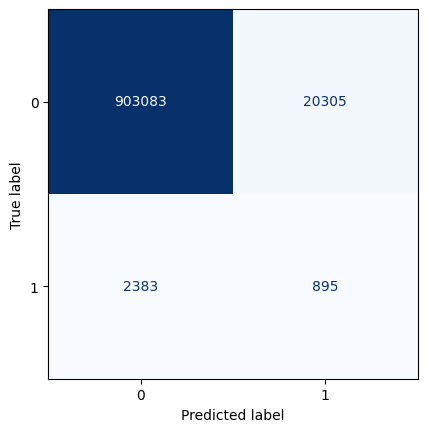

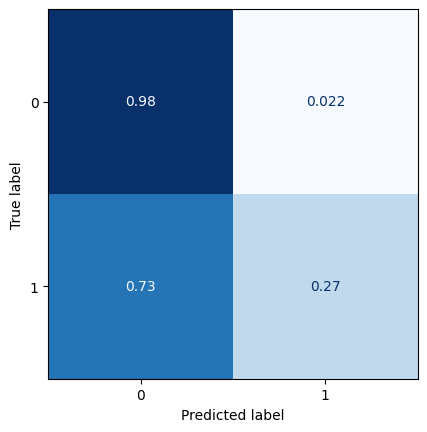

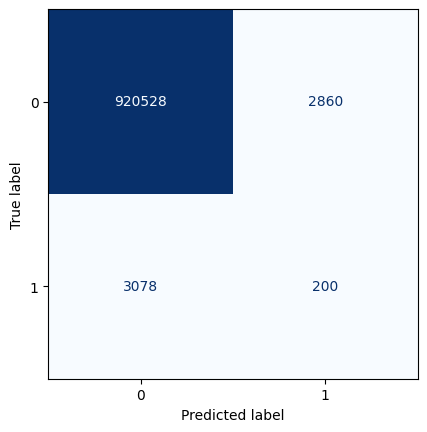

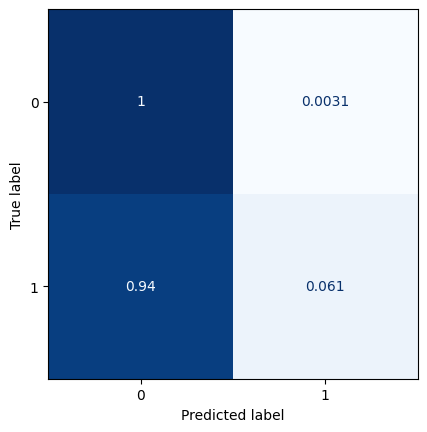

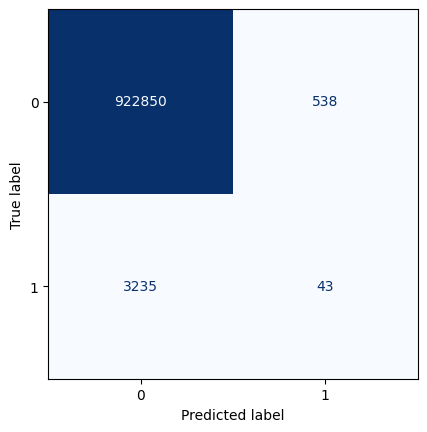

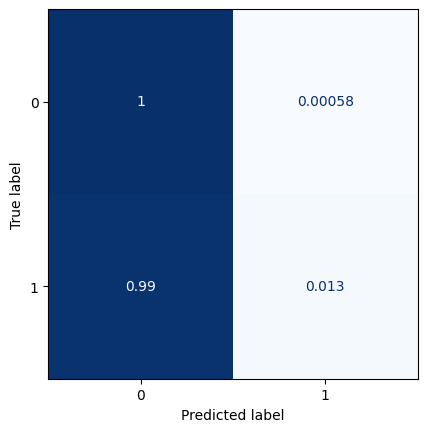

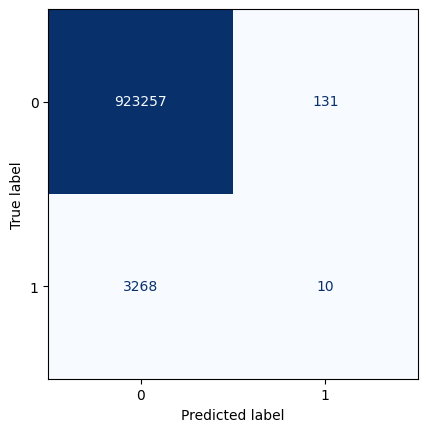

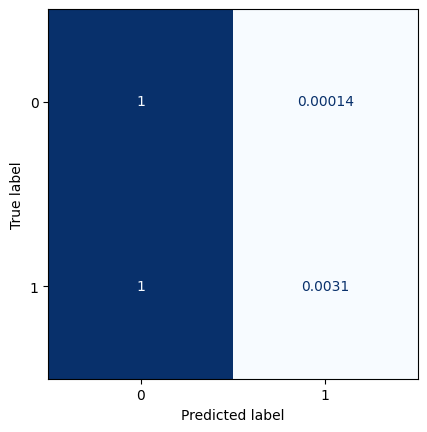

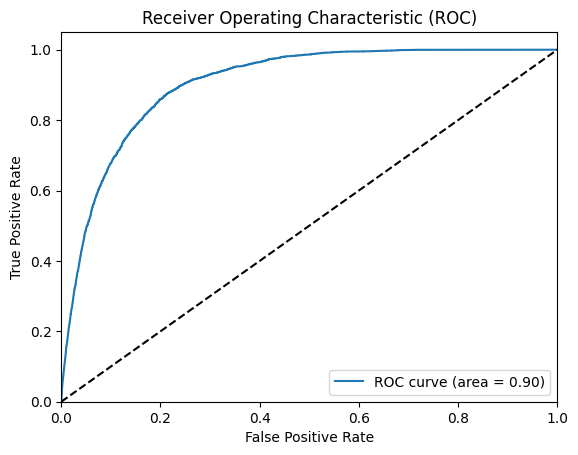

All zeros Brier score: 0.0035374126168436094
Model Brier score: 0.0034618074381382396
Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_27 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_9 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_28 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_9 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_29 (Conv2D)          (None, 14, 30, 1)         73        
                                  

2023-03-28 11:20:00.797013: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0448

2023-03-28 11:20:03.640464: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.0448 - val_loss: 0.0227
Epoch 2/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0238 - val_loss: 0.0211
Epoch 3/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0226 - val_loss: 0.0205
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0221 - val_loss: 0.0203
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0218 - val_loss: 0.0202
Epoch 6/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0215 - val_loss: 0.0200
Epoch 7/100
354/354 [==============================] - 3s 9ms/step - loss: 0.0214 - val_loss: 0.0201
Epoch 8/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0213 - val_loss: 0.0197
Epoch 9/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0212 - val_loss: 0.0198
Epoch 10/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0211 - val_loss: 0.0201
E

2023-03-28 11:21:36.046377: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


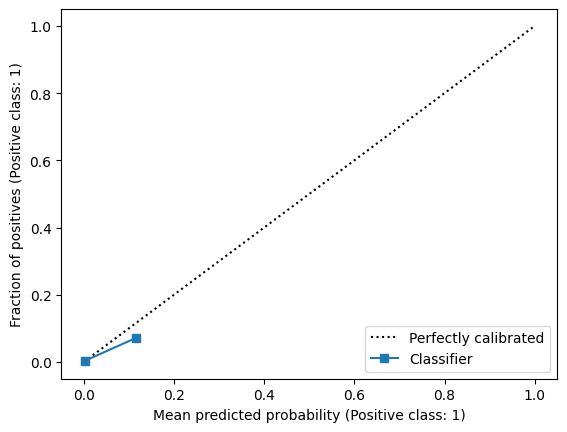

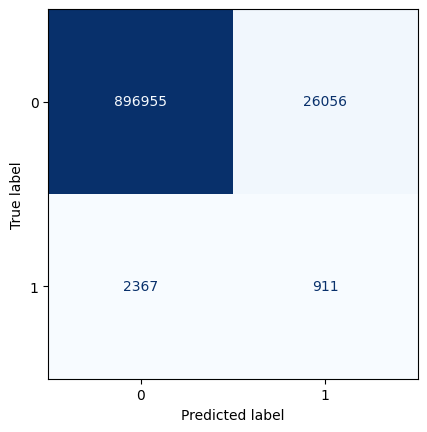

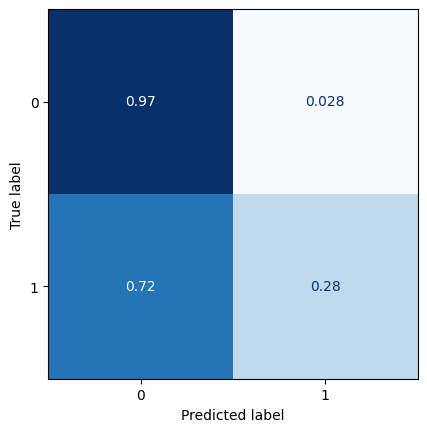

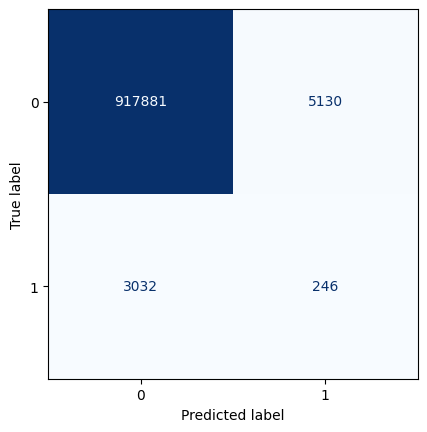

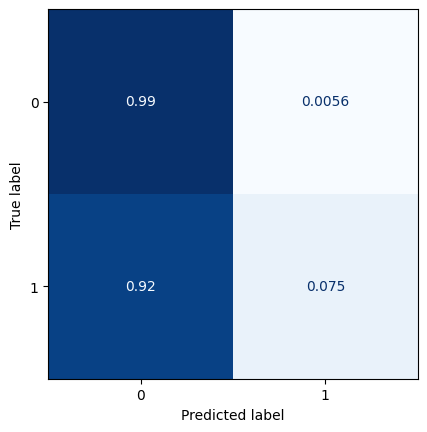

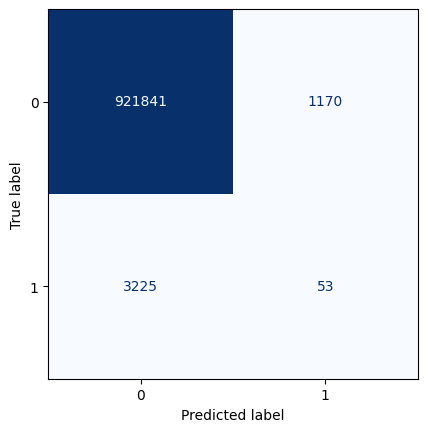

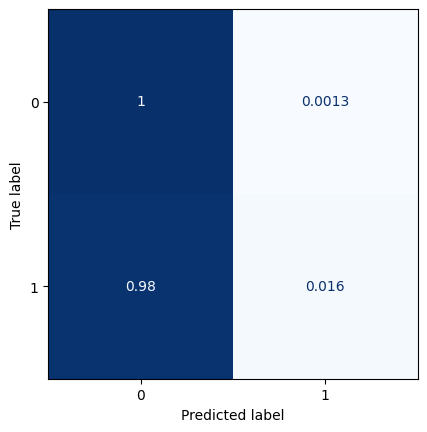

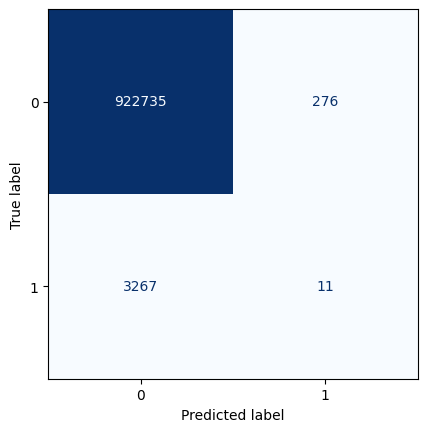

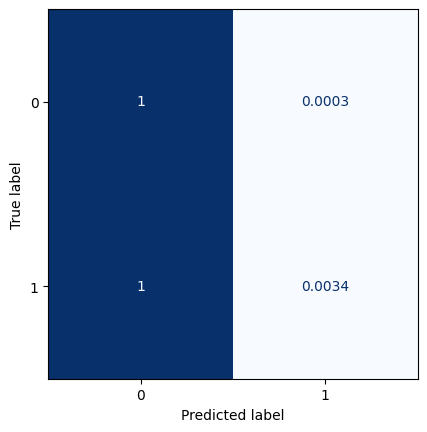

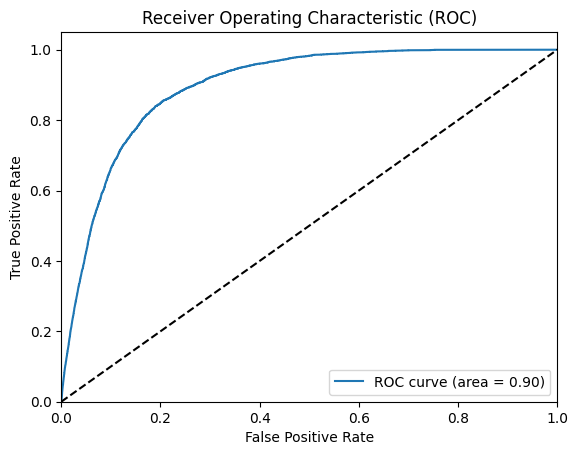

All zeros Brier score: 0.003538852345218393
Model Brier score: 0.0034784944757933795
Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_30 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_10 (MaxPoolin  (None, 7, 15, 8)         0         
 g2D)                                                            
                                                                 
 conv2d_31 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_10 (UpSamplin  (None, 14, 30, 8)        0         
 g2D)                                                            
                                                                 
 conv2d_32 (Conv2D)          (None, 14, 30, 1)         73        
                                  

2023-03-28 11:21:57.965497: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0600

2023-03-28 11:22:00.895264: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 9ms/step - loss: 0.0600 - val_loss: 0.0233
Epoch 2/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0243 - val_loss: 0.0216
Epoch 3/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0232 - val_loss: 0.0208
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0226 - val_loss: 0.0205
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0223 - val_loss: 0.0206
Epoch 6/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0220 - val_loss: 0.0200
Epoch 7/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0218 - val_loss: 0.0198
Epoch 8/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0216 - val_loss: 0.0202
Epoch 9/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0216 - val_loss: 0.0198
Epoch 10/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0214 - val_loss: 0.0196
E

2023-03-28 11:23:27.050857: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


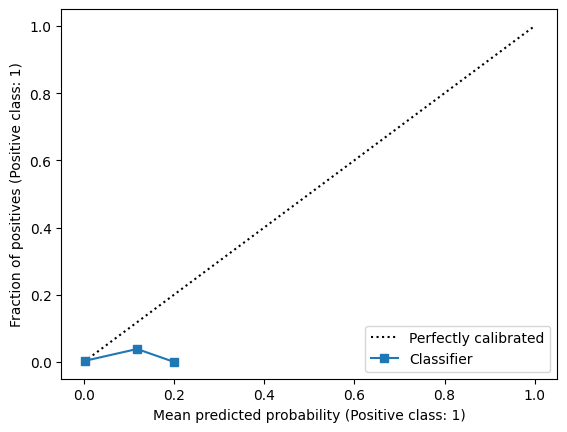

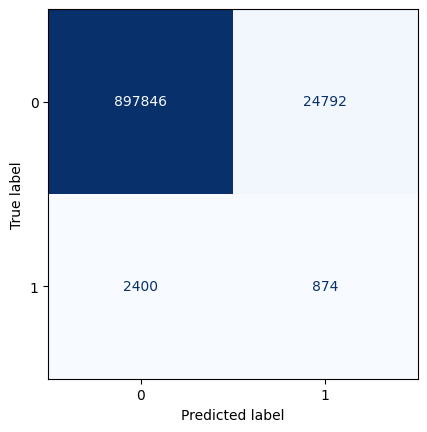

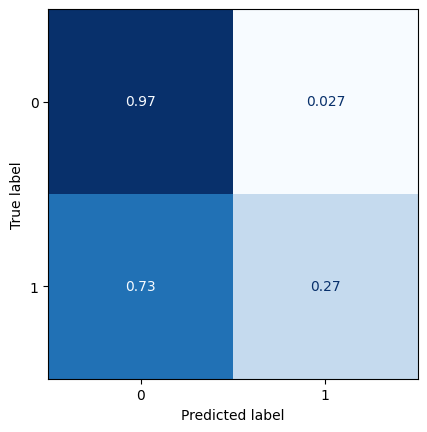

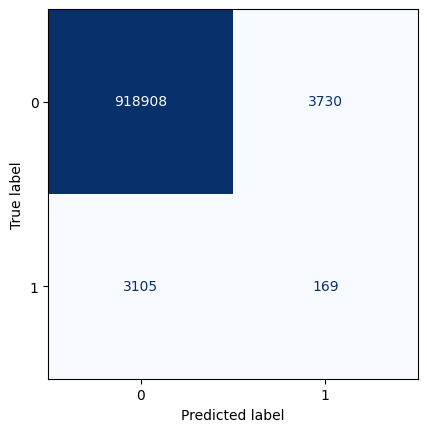

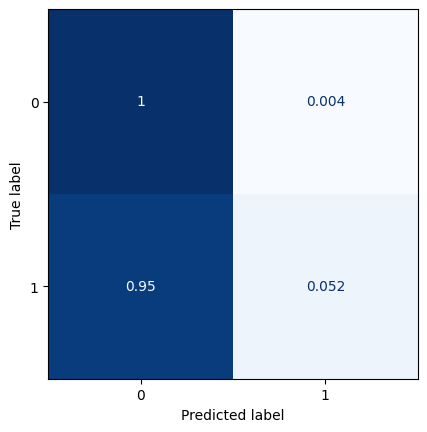

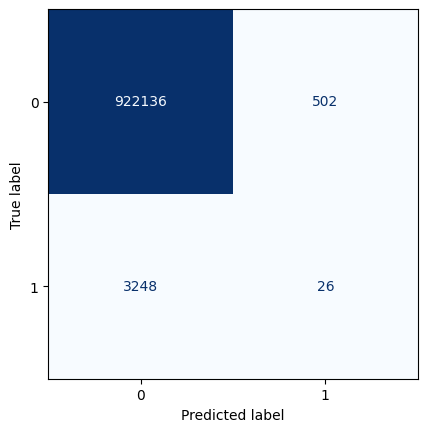

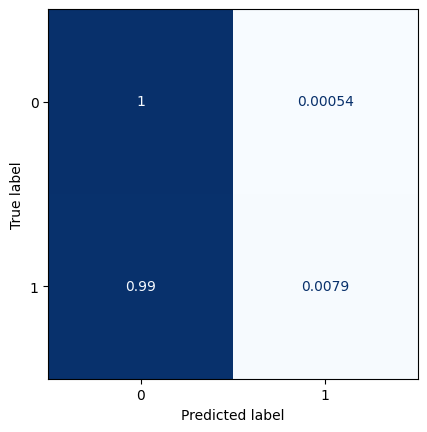

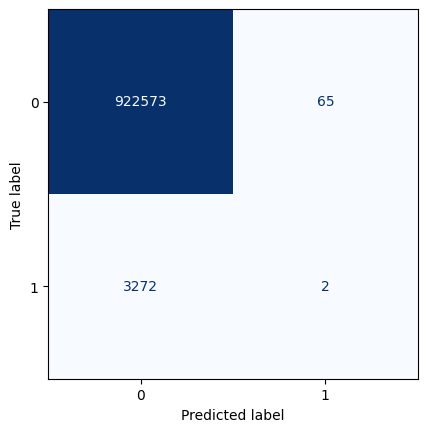

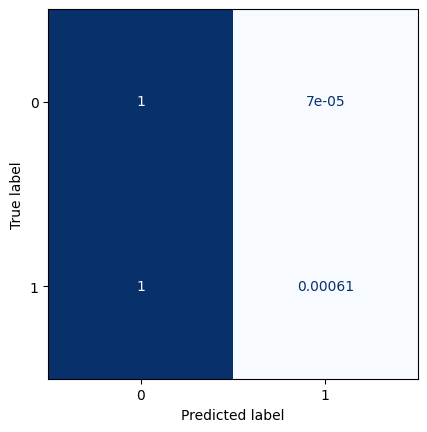

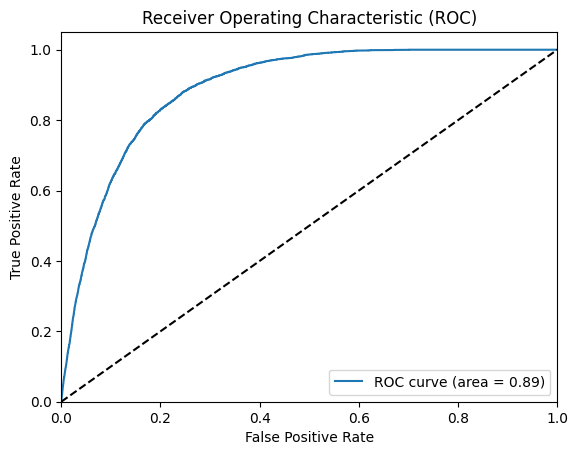

All zeros Brier score: 0.0035359731810366427
Model Brier score: 0.003477522258814916
Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_33 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_11 (MaxPoolin  (None, 7, 15, 8)         0         
 g2D)                                                            
                                                                 
 conv2d_34 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_11 (UpSamplin  (None, 14, 30, 8)        0         
 g2D)                                                            
                                                                 
 conv2d_35 (Conv2D)          (None, 14, 30, 1)         73        
                                  

2023-03-28 11:23:49.444177: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0537

2023-03-28 11:23:52.832610: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 4s 10ms/step - loss: 0.0537 - val_loss: 0.0241
Epoch 2/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0240 - val_loss: 0.0222
Epoch 3/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0230 - val_loss: 0.0215
Epoch 4/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0223 - val_loss: 0.0205
Epoch 5/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0220 - val_loss: 0.0203
Epoch 6/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0217 - val_loss: 0.0203
Epoch 7/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0216 - val_loss: 0.0205
Epoch 8/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0215 - val_loss: 0.0200
Epoch 9/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0214 - val_loss: 0.0199
Epoch 10/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0213 - val_loss: 0.0199


2023-03-28 11:25:54.759172: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


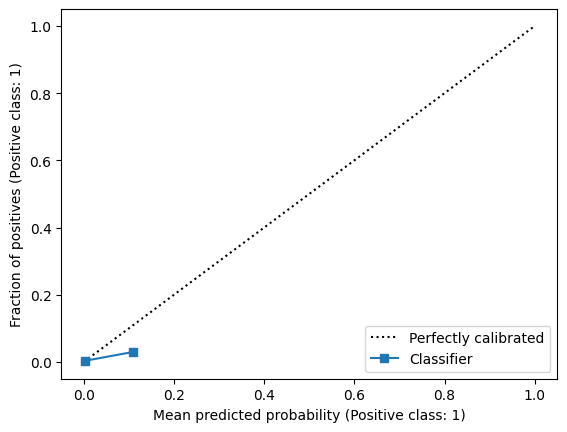

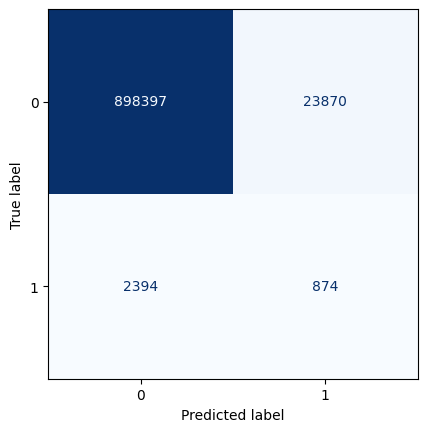

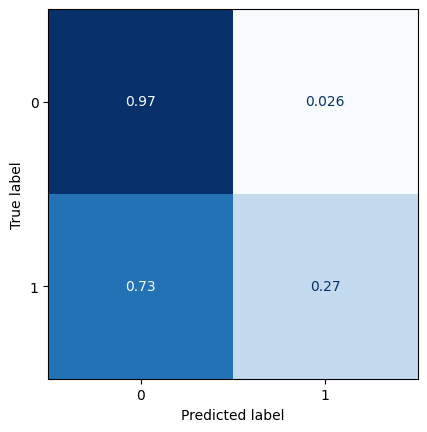

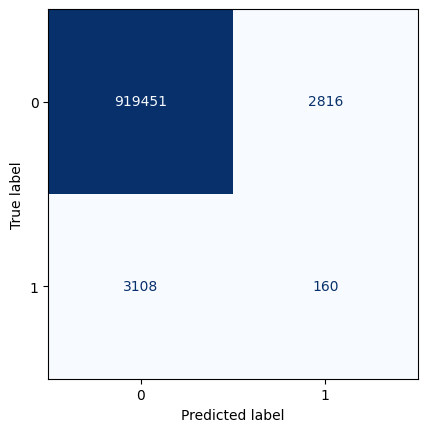

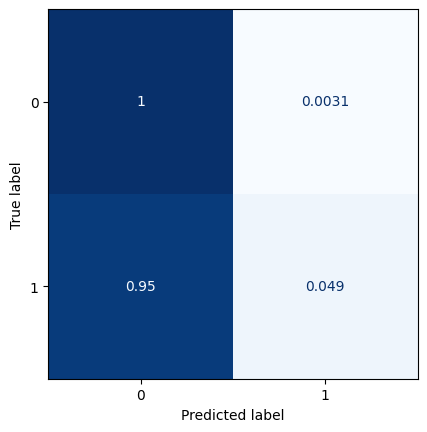

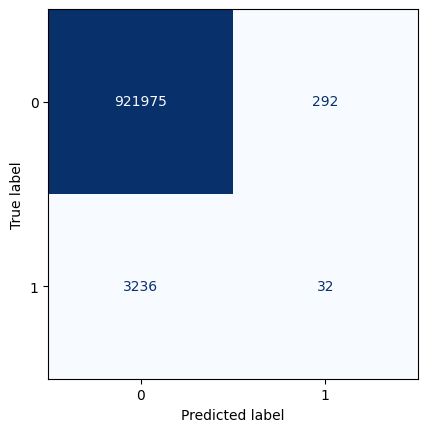

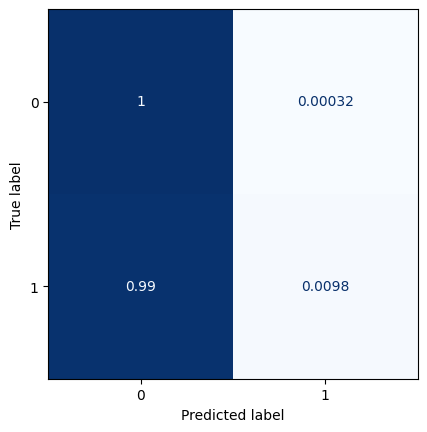

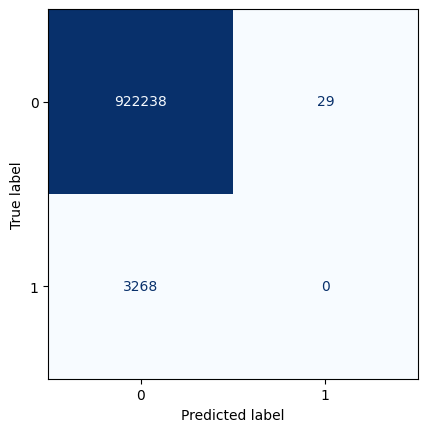

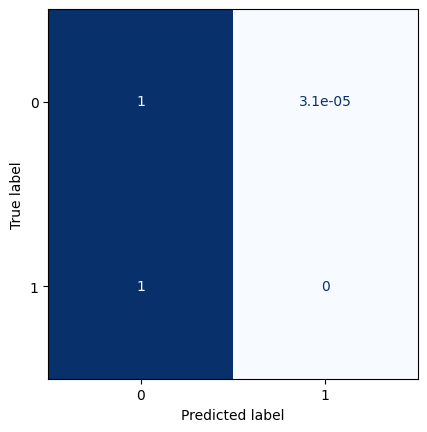

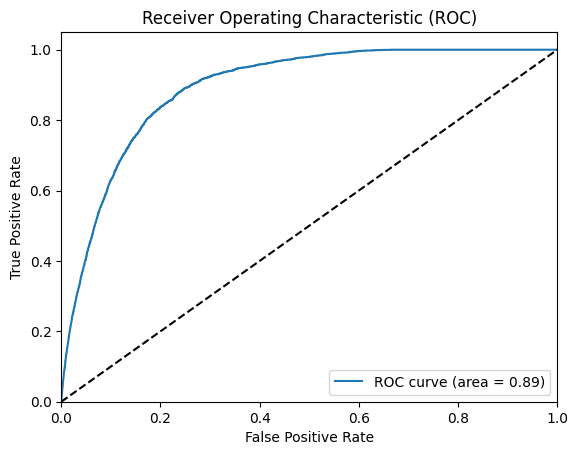

All zeros Brier score: 0.0035309307589664355
Model Brier score: 0.0034669633336080717
Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_36 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_12 (MaxPoolin  (None, 7, 15, 8)         0         
 g2D)                                                            
                                                                 
 conv2d_37 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_12 (UpSamplin  (None, 14, 30, 8)        0         
 g2D)                                                            
                                                                 
 conv2d_38 (Conv2D)          (None, 14, 30, 1)         73        
                                 

2023-03-28 11:26:18.965733: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0580

2023-03-28 11:26:21.812693: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.0580 - val_loss: 0.0234
Epoch 2/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0245 - val_loss: 0.0219
Epoch 3/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0233 - val_loss: 0.0215
Epoch 4/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0226 - val_loss: 0.0209
Epoch 5/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0222 - val_loss: 0.0207
Epoch 6/100
354/354 [==============================] - 3s 9ms/step - loss: 0.0219 - val_loss: 0.0209
Epoch 7/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0217 - val_loss: 0.0201
Epoch 8/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0216 - val_loss: 0.0203
Epoch 9/100
354/354 [==============================] - 3s 9ms/step - loss: 0.0215 - val_loss: 0.0203
Epoch 10/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0214 - val_loss: 0.0201
E

2023-03-28 11:27:48.416958: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


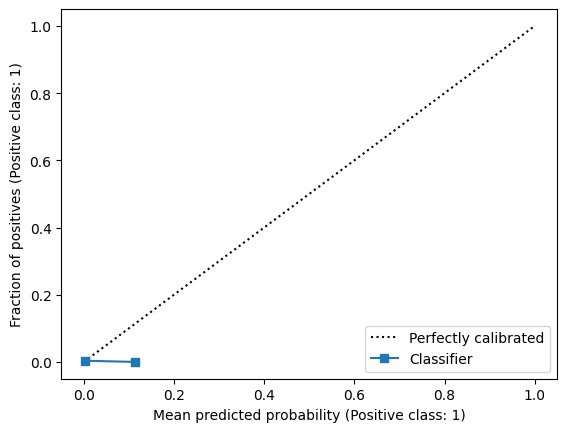

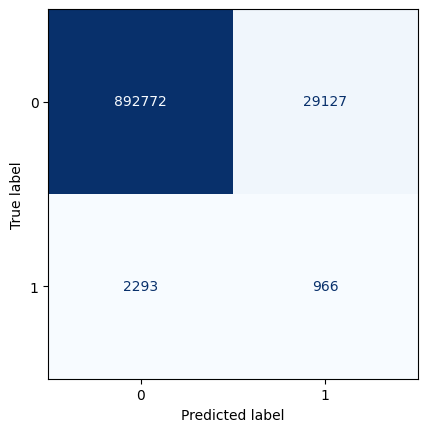

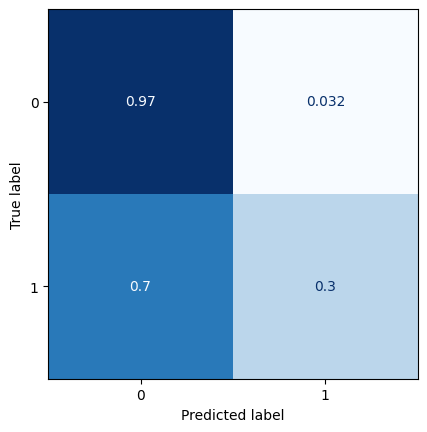

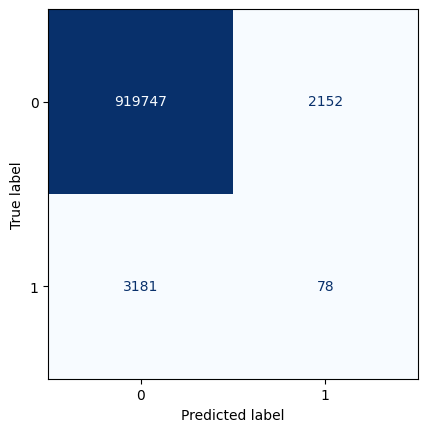

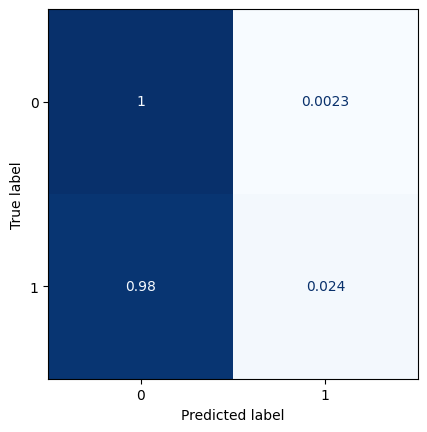

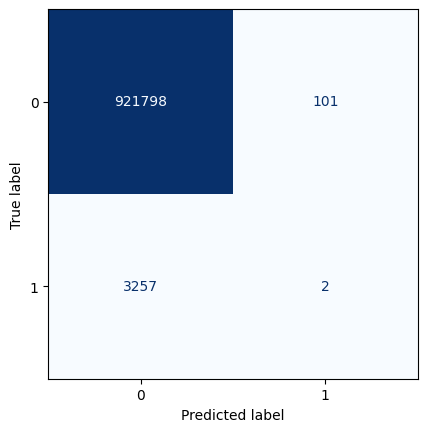

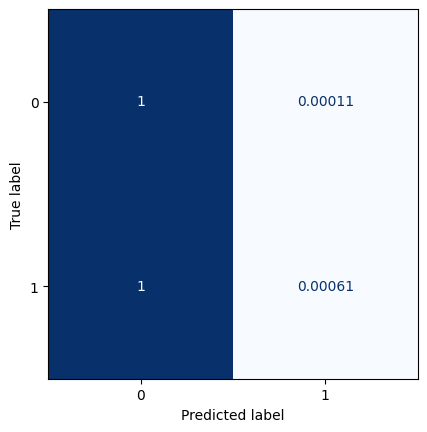

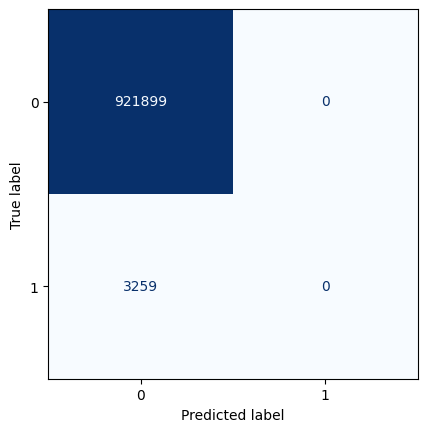

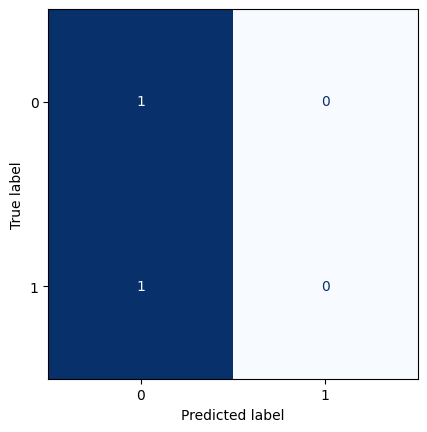

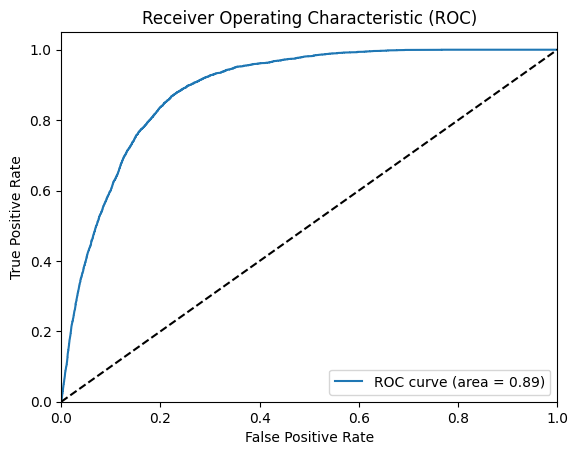

All zeros Brier score: 0.003522641537985944
Model Brier score: 0.0034647624830147837
Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_39 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_13 (MaxPoolin  (None, 7, 15, 8)         0         
 g2D)                                                            
                                                                 
 conv2d_40 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_13 (UpSamplin  (None, 14, 30, 8)        0         
 g2D)                                                            
                                                                 
 conv2d_41 (Conv2D)          (None, 14, 30, 1)         73        
                                  

2023-03-28 11:28:12.650330: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0812

2023-03-28 11:28:15.620495: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 9ms/step - loss: 0.0812 - val_loss: 0.0253
Epoch 2/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0260 - val_loss: 0.0235
Epoch 3/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0242 - val_loss: 0.0222
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0233 - val_loss: 0.0217
Epoch 5/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0228 - val_loss: 0.0211
Epoch 6/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0224 - val_loss: 0.0208
Epoch 7/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0223 - val_loss: 0.0208
Epoch 8/100
354/354 [==============================] - 3s 9ms/step - loss: 0.0221 - val_loss: 0.0208
Epoch 9/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0219 - val_loss: 0.0207
Epoch 10/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0218 - val_loss: 0.0206
E

2023-03-28 11:30:26.220758: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


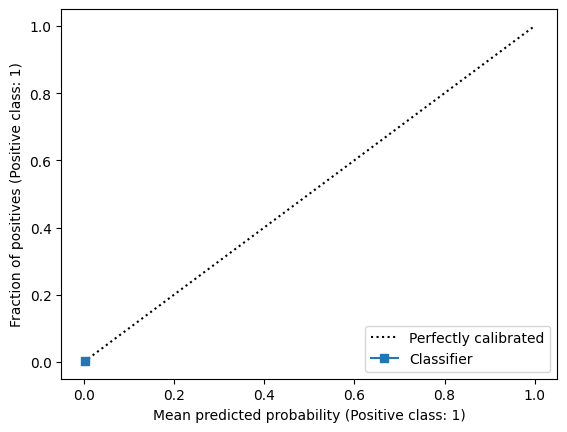

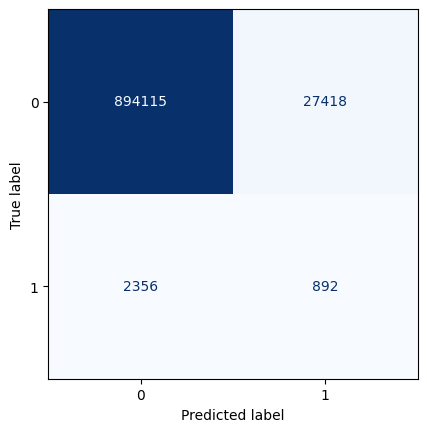

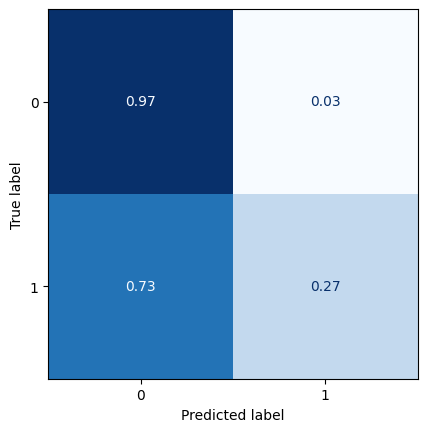

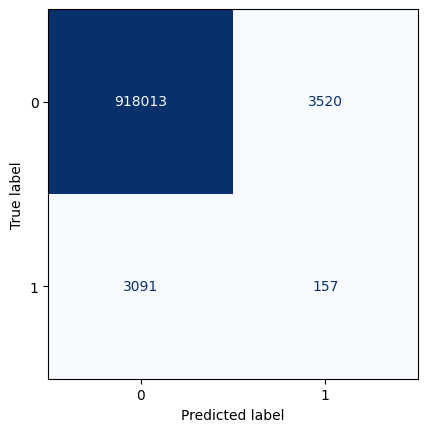

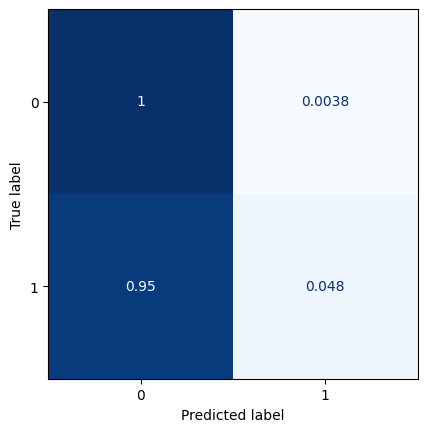

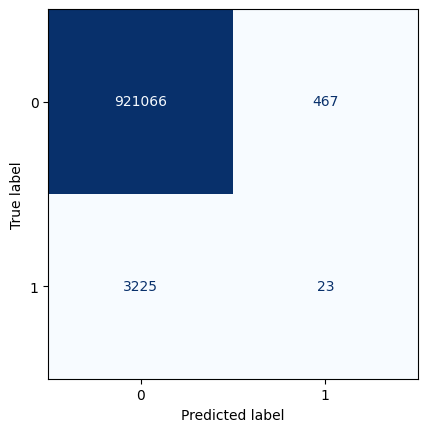

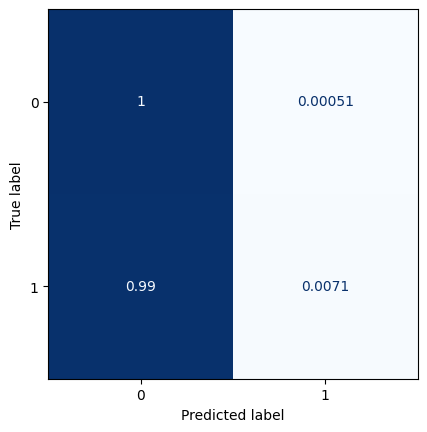

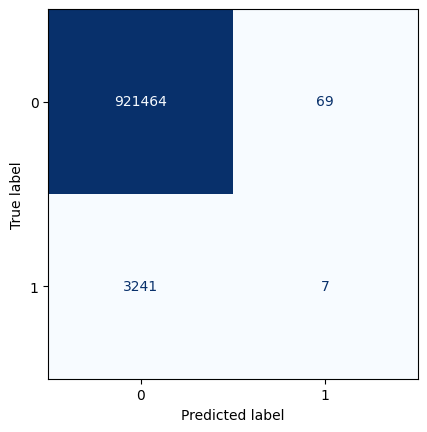

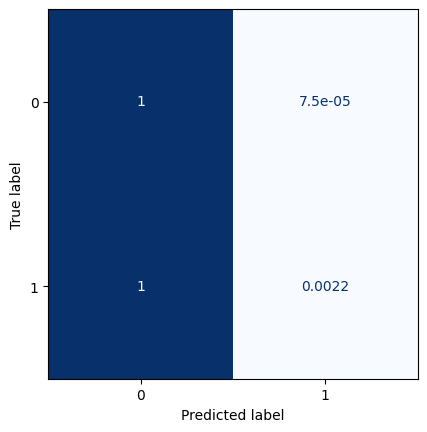

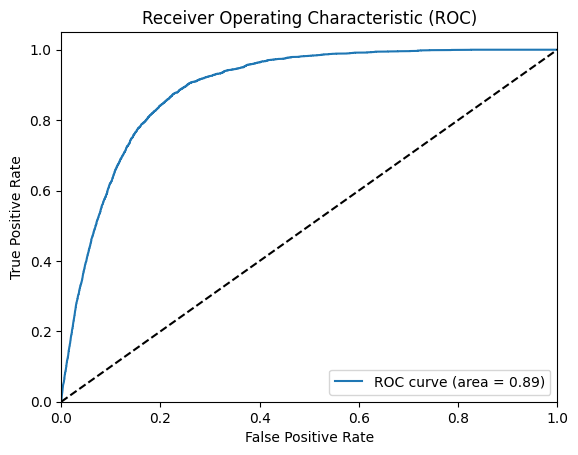

All zeros Brier score: 0.0035121828843801936
Model Brier score: 0.003456000968310353


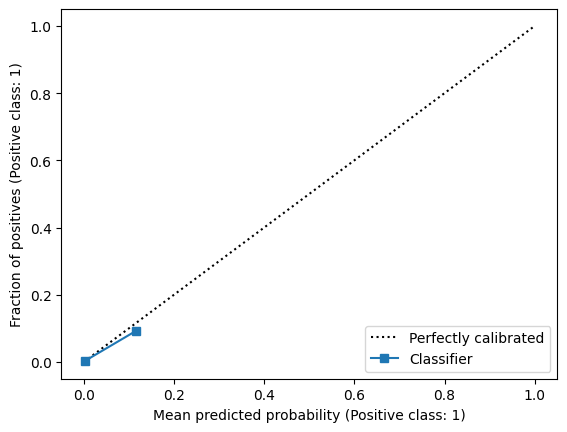

In [23]:
for lag in [1,2,3,4,5,6,7,8,9,10,11,12,13]:
    ### Model summary
    model = Sequential()
    model.add(layers.Input(shape=(13, 29, 9)))
    
    model.add(layers.Conv2D(8, (3,3), activation='relu', padding='same'))
    model.add(layers.MaxPooling2D((2, 2), padding='same'))

    model.add(layers.Conv2D(8, (3,3), activation='relu', padding='same'))
    model.add(layers.UpSampling2D((2,2)))
    
    model.add(layers.Conv2D(1, (3, 3), activation='sigmoid', padding='same')) # sigmoidal activation to have probabilities
    
    model.add(layers.Cropping2D(cropping=((0,1),(0,1))))
    
    model.summary()
    
    
    model.compile(loss='binary_crossentropy', optimizer='adam')
    
    monitor = EarlyStopping(monitor='val_loss', min_delta=1e-5, patience=20, 
            verbose=1, mode='auto', restore_best_weights=True)
    
    ### Model training
    model.fit(train_img_std[:-lag], y_train_img[lag:], validation_data=(val_img_std[:-lag],y_val_img[lag:]),
        callbacks=[monitor],epochs=100)
    
    ### Confusion matrices
    t = model.predict(test_img_std[:-lag])

    ranges = [0.025,0.05,0.075,0.1]
    
    for j in ranges:
        classes = []
        for i in t.reshape(-1,1):
            if i<=j: classes.append(0)
            else: classes.append(1)
    
        ConfusionMatrixDisplay(confusion_matrix(y_test_img[lag:].reshape(-1,1), classes)).plot(colorbar=False,cmap=plt.cm.Blues, values_format='d')
        ConfusionMatrixDisplay(confusion_matrix(y_test_img[lag:].reshape(-1,1), classes, normalize='true')).plot(colorbar=False,cmap=plt.cm.Blues)
    
    ### ROC
    plot_roc(t.reshape(-1,1),y_test_img[lag:].reshape(-1,1))
    
    z = np.zeros((lag,13,29,1))
    tt = np.concatenate((t,z))
    test['predictions_lag'+str(lag)] = tt.reshape(-1,1)
    test.to_csv("test_with_newTarget_predictions.csv")
    
    ### calibration
    display = CalibrationDisplay.from_predictions(y_test_img[lag:].reshape(-1,1), t.reshape(-1,1), n_bins=10)
    print(f'All zeros Brier score: {brier_score_loss(y_test_img[lag:].reshape(-1,1), np.zeros(len(y_test_img[lag:].reshape(-1,1))))}')
    print(f'Model Brier score: {brier_score_loss(y_test_img[lag:].reshape(-1,1), t.reshape(-1,1))}')
    

In [29]:
test

,Unnamed: 0,time,latitude,longitude,vo,r,u_200,u_850,v_200,v_850,ttr,sst,new_target,Real_tom_target,shear,target,predictions_lag0,predictions_lag1,predictions_lag2,predictions_lag3,predictions_lag4,predictions_lag5,predictions_lag6,predictions_lag7,predictions_lag8,predictions_lag9,predictions_lag10,predictions_lag11,predictions_lag12,predictions_lag13
34307,34307,2016-04-01,0.0,20.0,0.238973,1.386669,-0.945404,1.574206,0.511504,0.367981,2.652010,-1.588255,0.0,0.0,-0.516292,0,5.599760e-06,1.116584e-05,0.000032,0.000440,1.698381e-04,4.817998e-06,3.752636e-05,0.000202,2.247904e-05,0.000111,0.000871,3.269772e-06,0.000328,0.000142
34308,34308,2016-04-01,0.0,22.5,-0.172396,1.196522,-0.819827,1.371793,0.717349,0.332262,3.396515,-1.588255,0.0,0.0,-0.755886,0,8.091185e-07,3.770019e-07,0.000002,0.000008,1.457031e-06,6.148791e-08,6.037646e-07,0.000003,5.734404e-07,0.000007,0.000024,5.036778e-08,0.000031,0.000008
34309,34309,2016-04-01,0.0,25.0,1.188889,1.166772,-0.571398,1.173488,0.662464,0.144802,4.092788,-1.588255,0.0,0.0,-1.161314,0,5.273907e-07,1.280818e-07,0.000003,0.000005,5.989831e-07,3.379468e-08,3.775615e-07,0.000001,2.429358e-07,0.000003,0.000012,3.192573e-08,0.000018,0.000004
34310,34310,2016-04-01,0.0,27.5,-0.649707,1.063899,-0.385753,0.812011,0.713230,0.584284,4.044557,-1.588255,0.0,0.0,-1.507685,0,4.937469e-07,6.390888e-08,0.000009,0.000003,9.002248e-07,3.109205e-08,8.725253e-08,0.000001,1.392415e-08,0.000001,0.000008,2.136173e-08,0.000014,0.000001
34311,34311,2016-04-01,0.0,30.0,-0.629183,1.432846,-0.362931,0.809212,0.888739,-0.207576,3.438931,-1.588255,0.0,0.0,-1.154385,0,9.038527e-07,1.089020e-07,0.000020,0.000004,1.546370e-06,4.021748e-08,5.431863e-08,0.000002,2.086840e-08,0.000002,0.000012,2.222927e-08,0.000014,0.000002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
963984,137600,2022-12-31,-30.0,80.0,0.677806,-1.271307,0.290892,-0.727302,0.813190,-0.684904,-0.431475,0.601392,0.0,0.0,0.050674,0,5.519601e-03,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000,0.000000
963985,137601,2022-12-31,-30.0,82.5,0.898493,-1.325164,0.224460,-0.764678,1.178495,-0.105389,-0.107881,0.599524,0.0,0.0,0.004080,0,3.107689e-03,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000,0.000000
963986,137602,2022-12-31,-30.0,85.0,1.629797,-1.468220,0.376651,-0.566606,1.728863,0.450626,-0.082227,0.597113,0.0,0.0,0.220205,0,1.299448e-03,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000,0.000000
963987,137603,2022-12-31,-30.0,87.5,0.280770,-1.453315,0.621629,-0.446284,2.368318,0.792994,-0.000815,0.594579,0.0,0.0,0.648118,0,6.500229e-04,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000,0.000000


## Deepdive predictions

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_21 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_7 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_22 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_7 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_23 (Conv2D)          (None, 14, 30, 1)         73        
                                                                 
 cropping2d_7 (Cropping2D)   (None, 13, 29, 1)        

2023-05-31 12:36:30.262962: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0517

2023-05-31 12:36:33.144857: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 3s 8ms/step - loss: 0.0517 - val_loss: 0.0189
Epoch 2/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0187 - val_loss: 0.0149
Epoch 3/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0160 - val_loss: 0.0138
Epoch 4/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0151 - val_loss: 0.0132
Epoch 5/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0144 - val_loss: 0.0127
Epoch 6/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0140 - val_loss: 0.0124
Epoch 7/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0136 - val_loss: 0.0120
Epoch 8/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0133 - val_loss: 0.0122
Epoch 9/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0131 - val_loss: 0.0114
Epoch 10/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0128 - val_loss: 0.0112
E

2023-05-31 12:38:44.570391: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


78/78 [==============================] - 0s 3ms/step


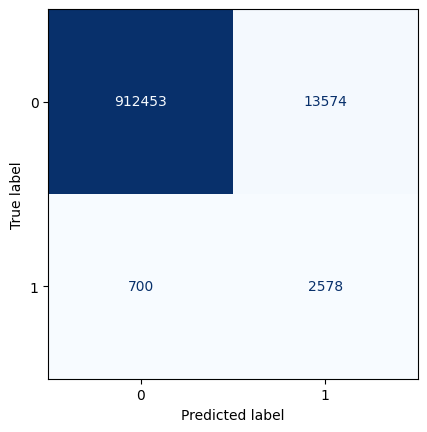

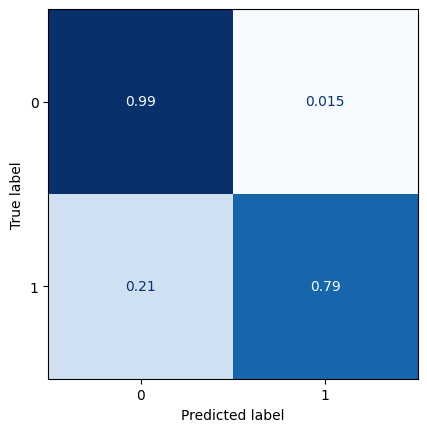

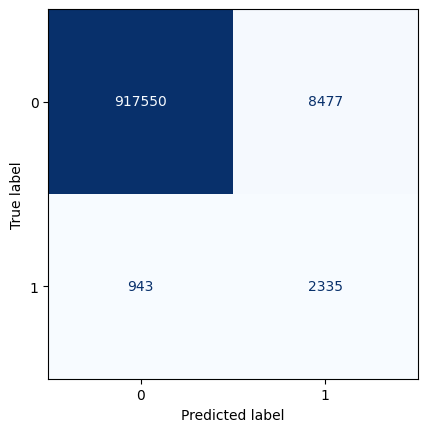

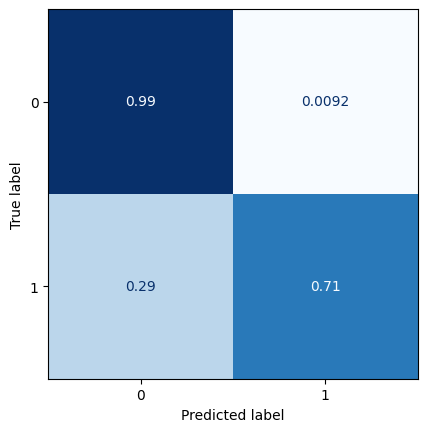

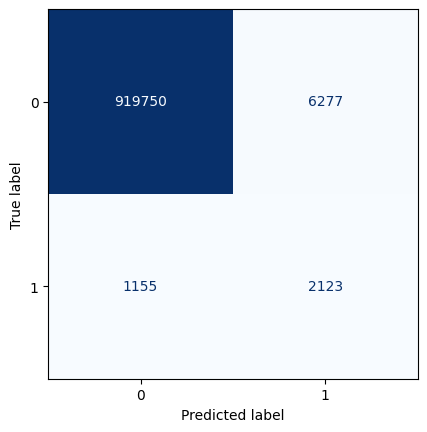

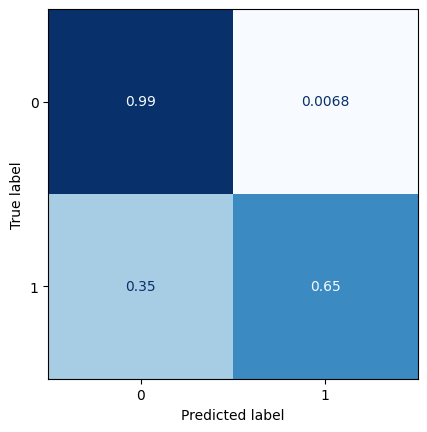

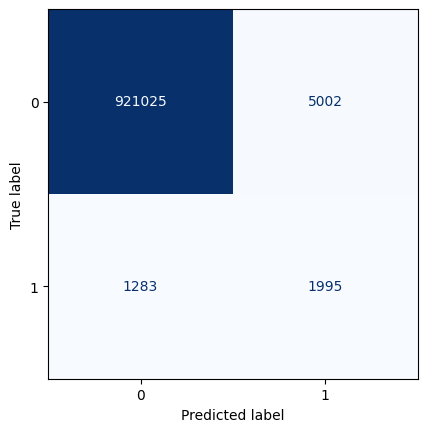

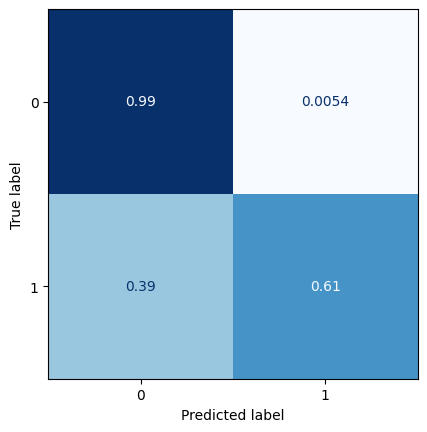

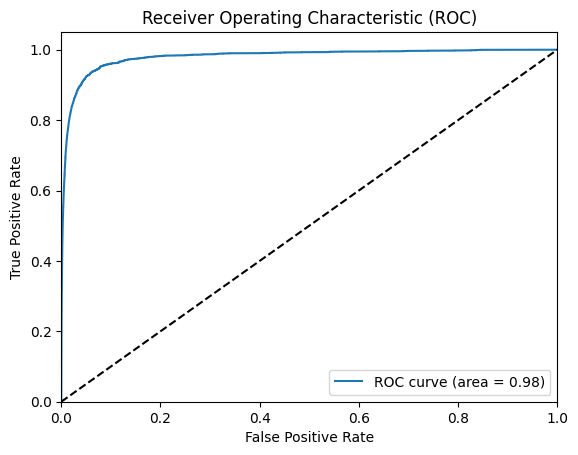

All zeros Brier score: 0.00352736722604527
Model Brier score: 0.0026680288701073384
9


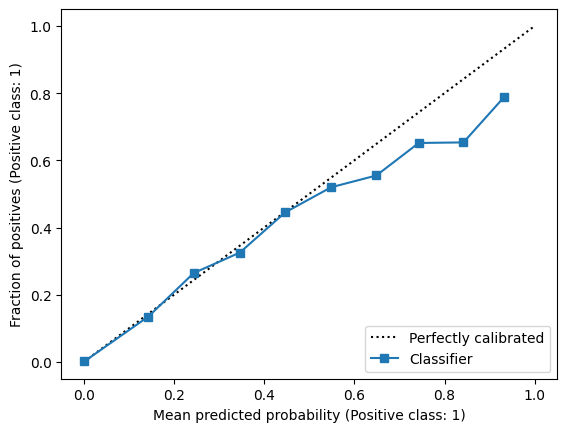

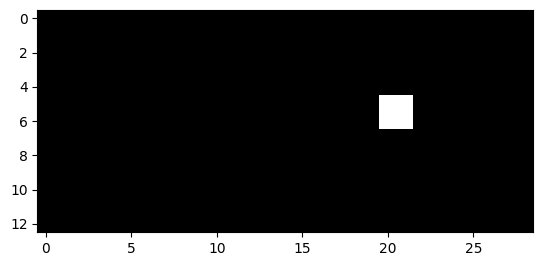

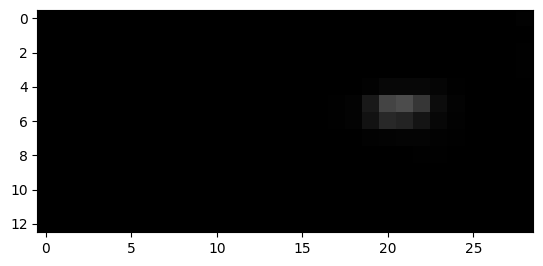

10


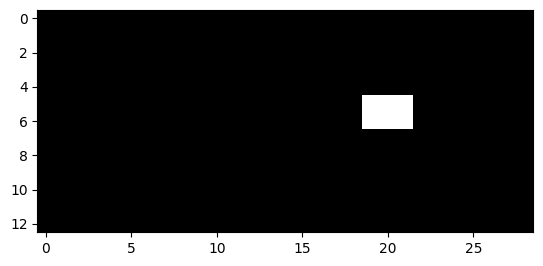

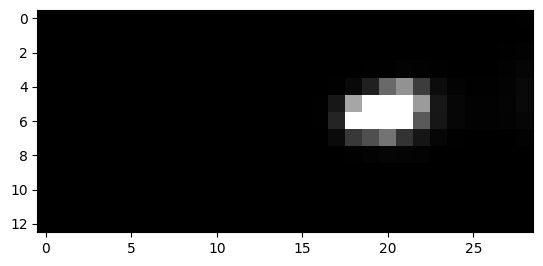

11


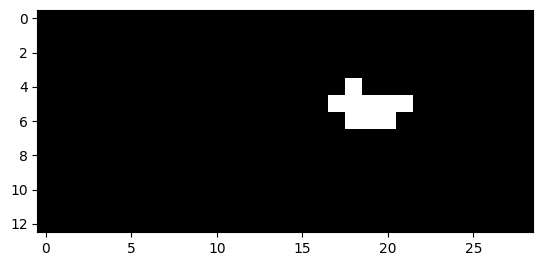

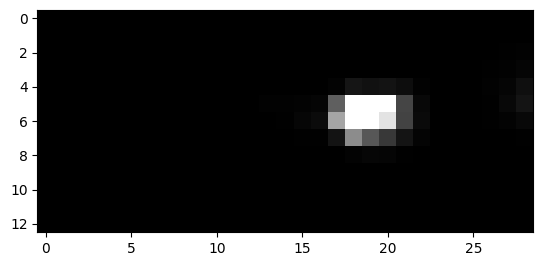

12


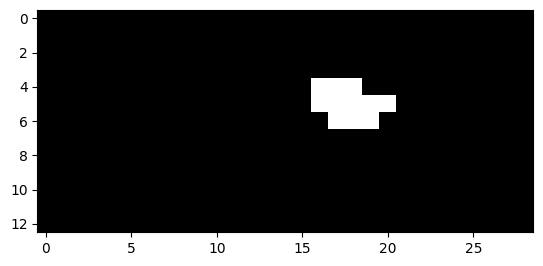

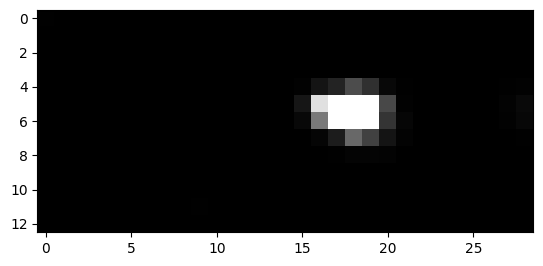

13


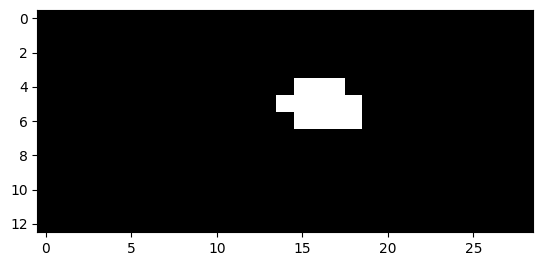

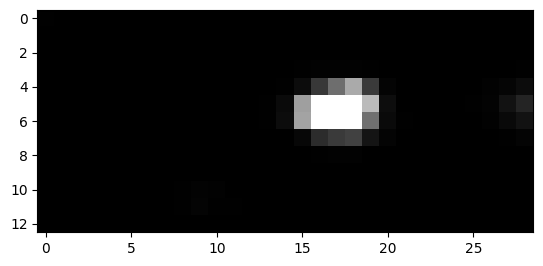

14


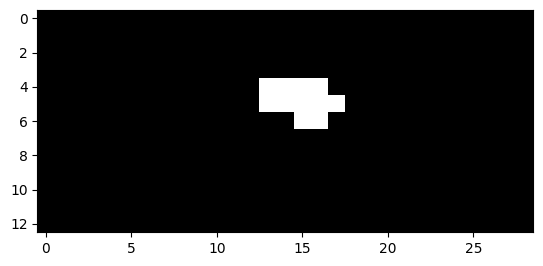

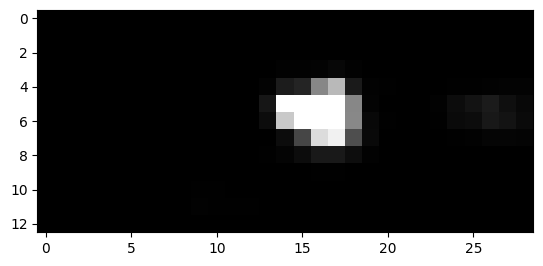

15


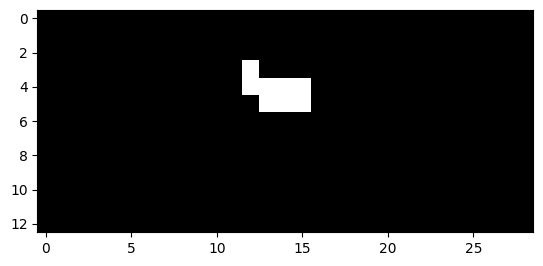

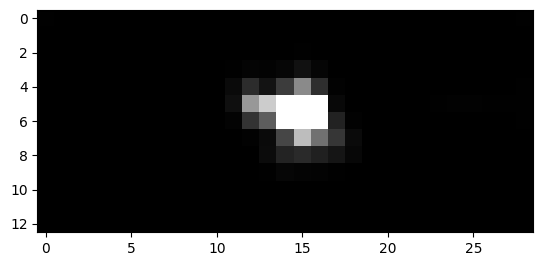

16


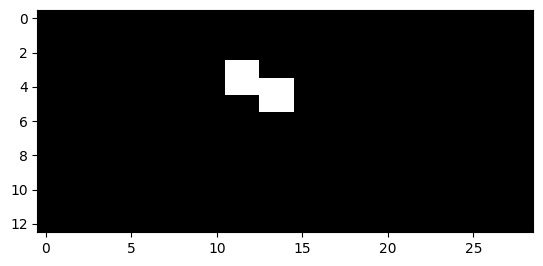

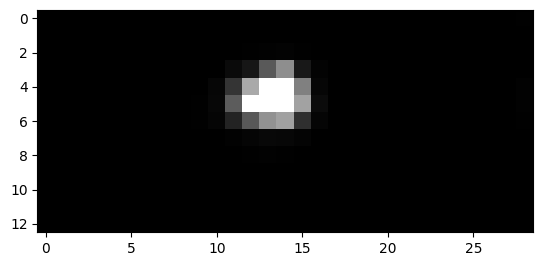

17


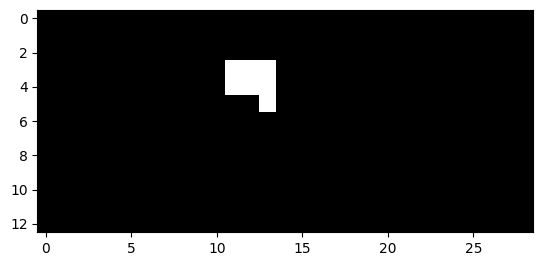

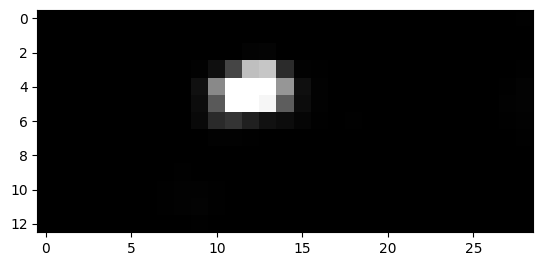

18


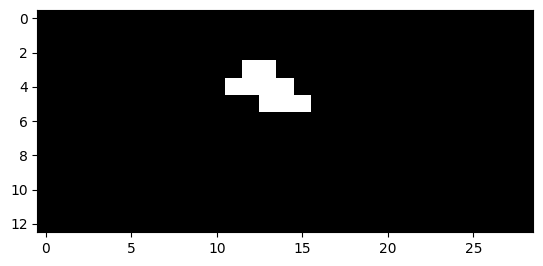

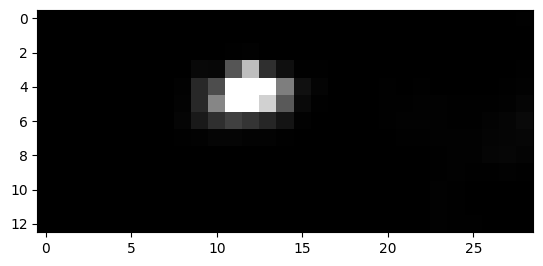

19


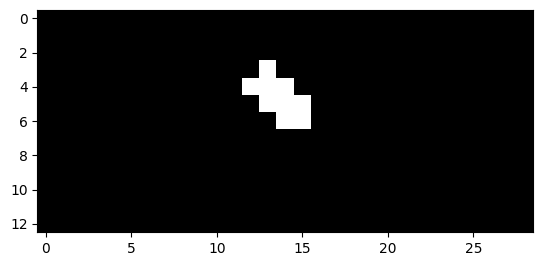

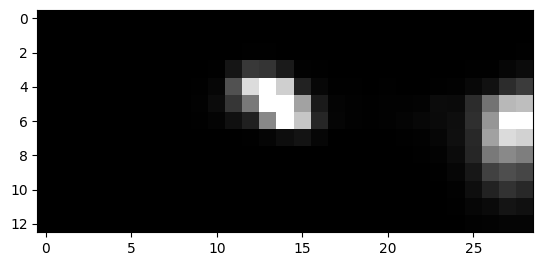

20


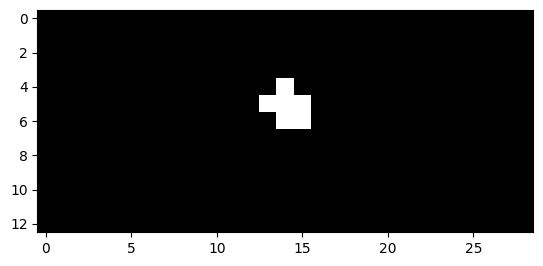

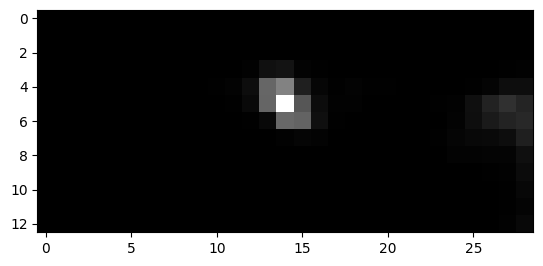

21


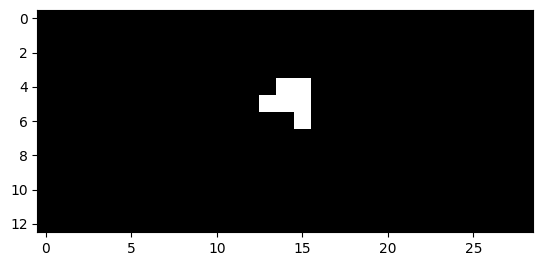

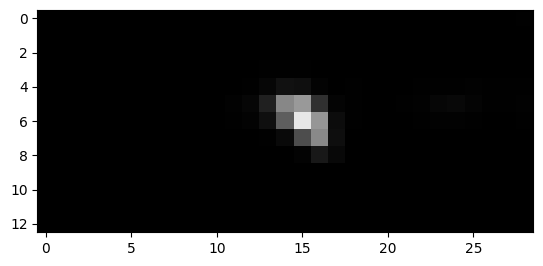

22


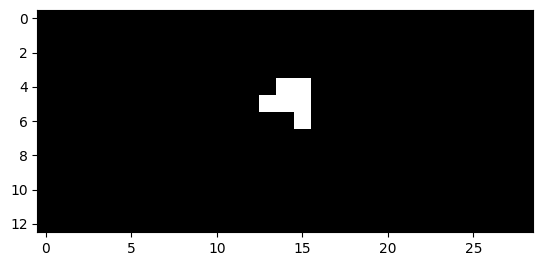

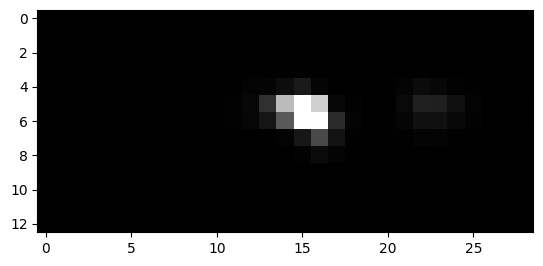

105


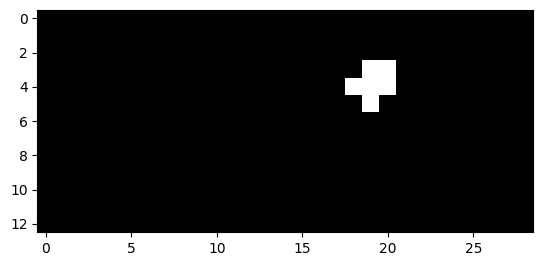

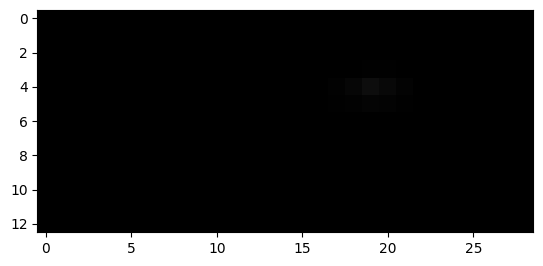

106


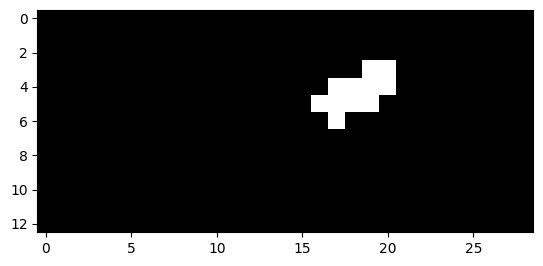

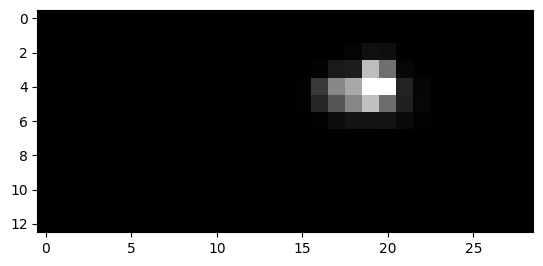

107


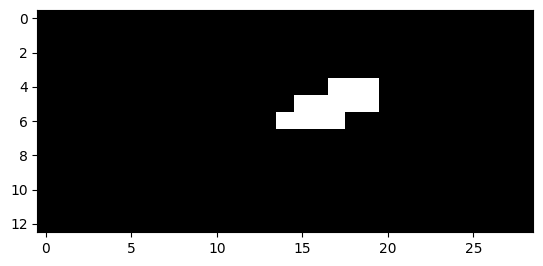

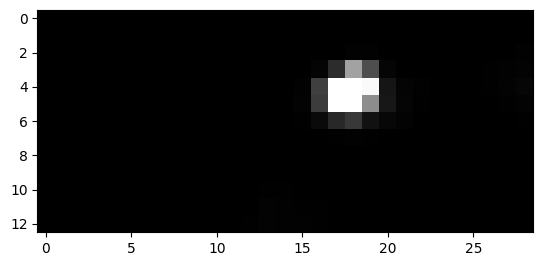

108


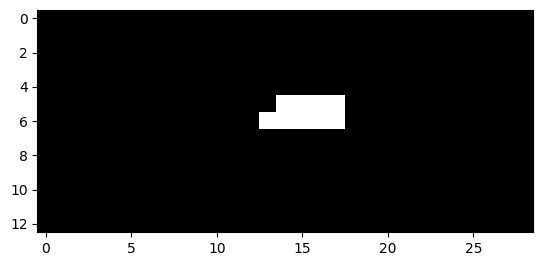

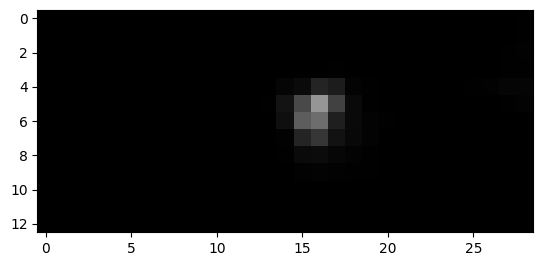

109


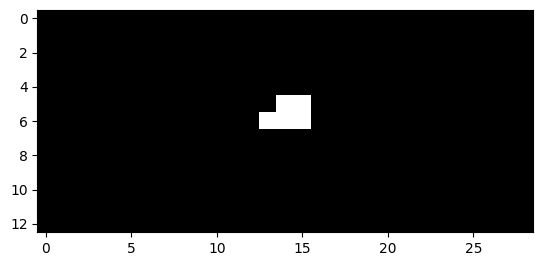

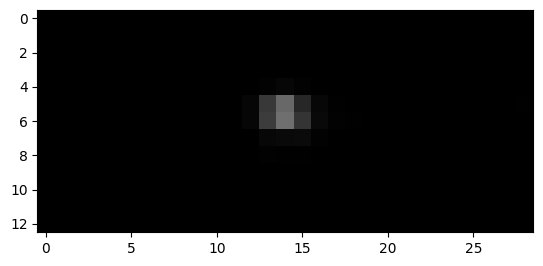

184


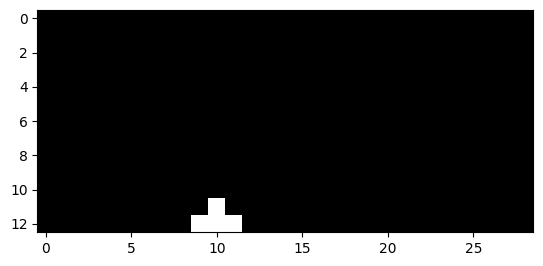

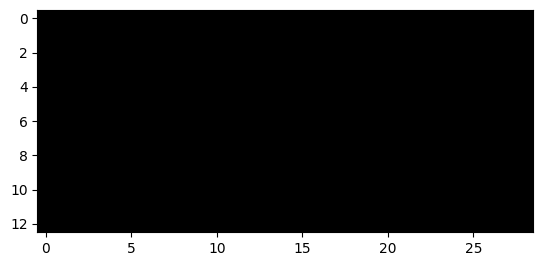

185


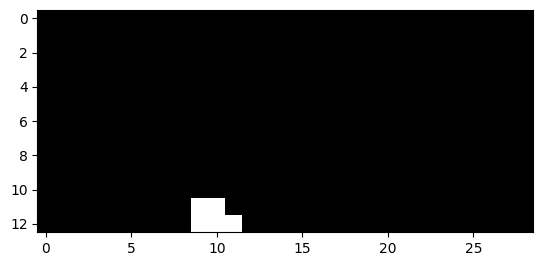

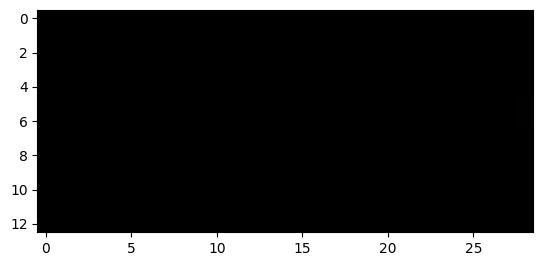

186


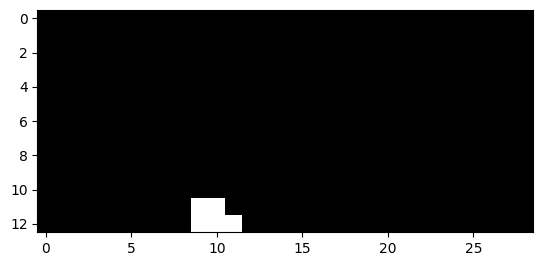

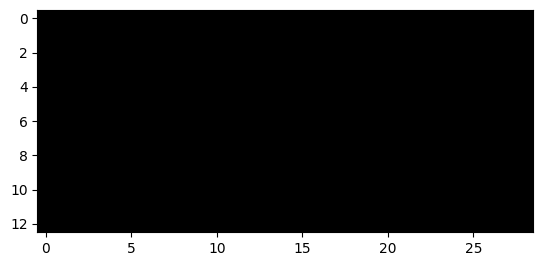

187


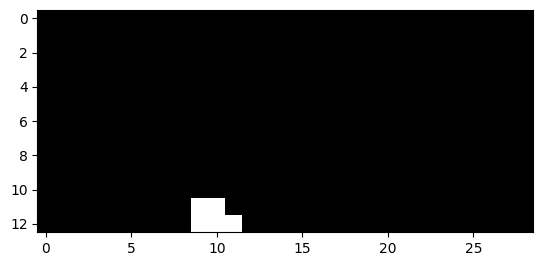

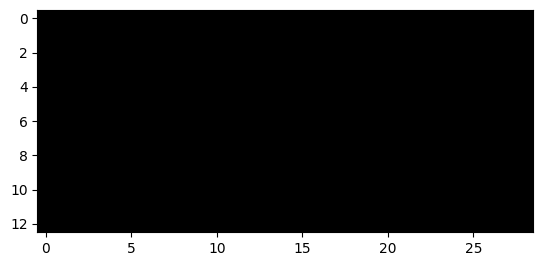

188


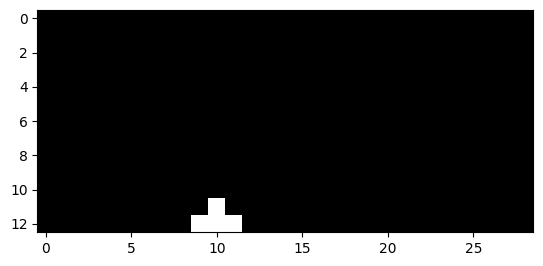

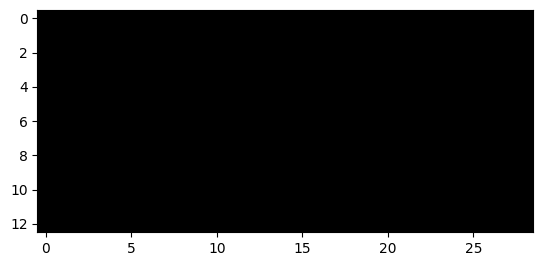

308


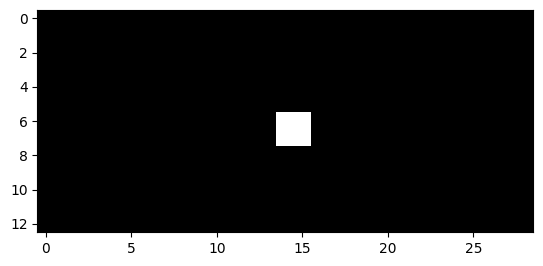

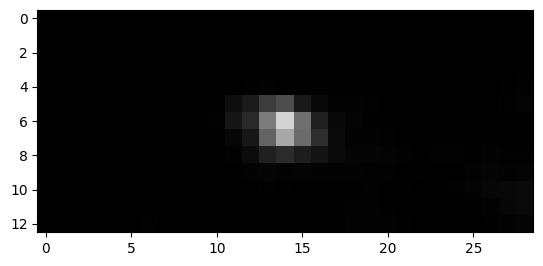

309


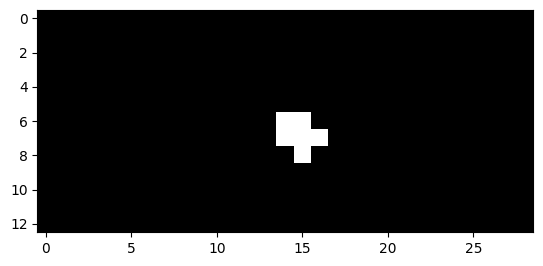

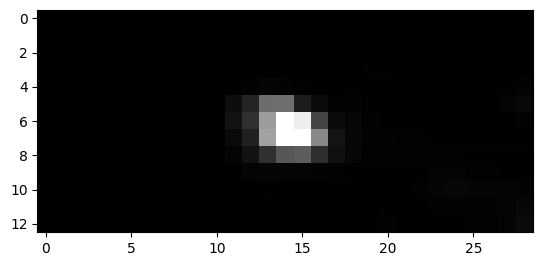

310


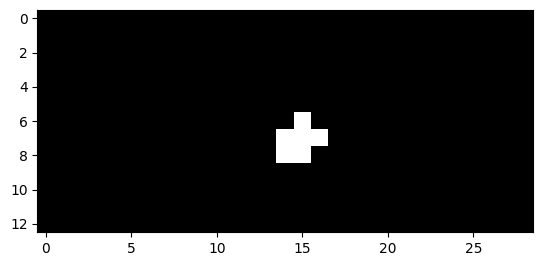

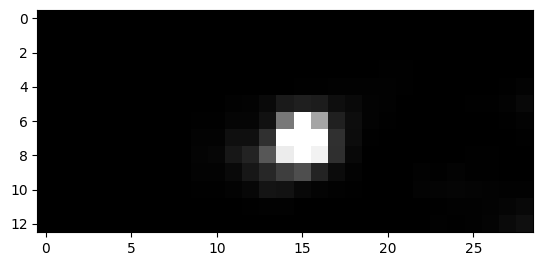

311


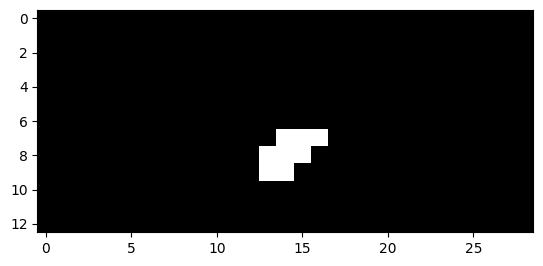

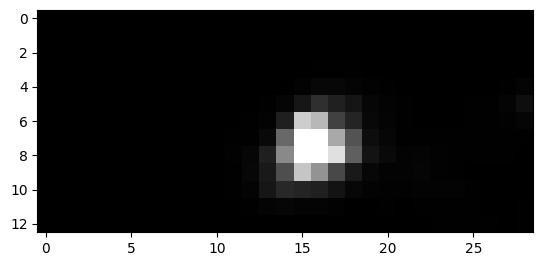

312


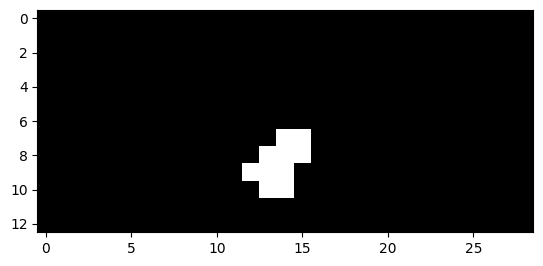

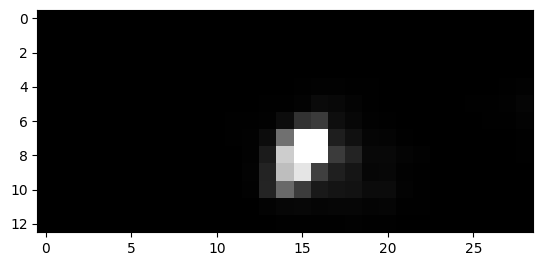

313


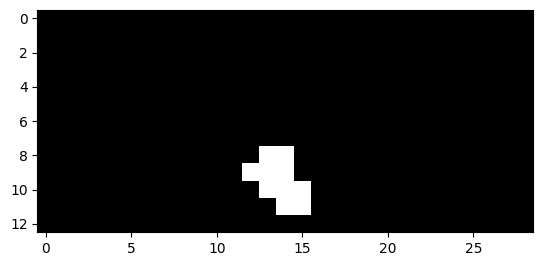

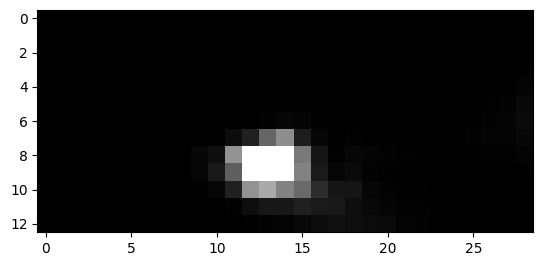

314


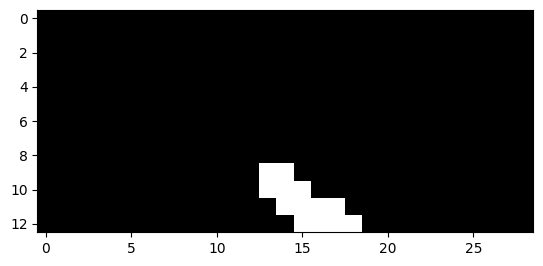

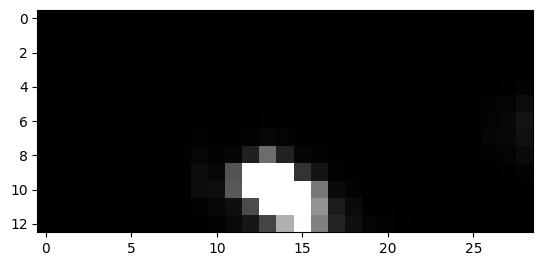

315


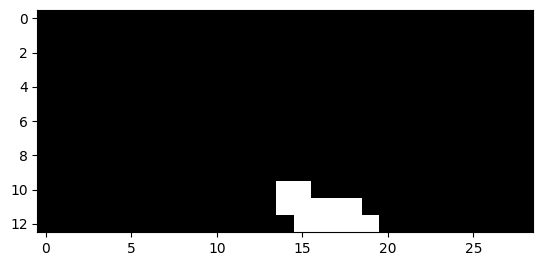

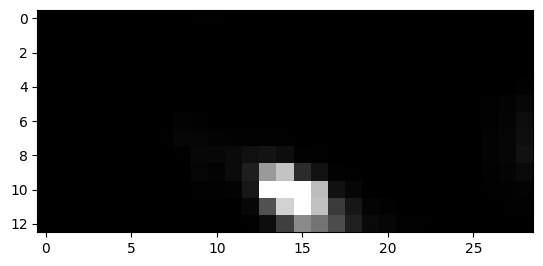

316


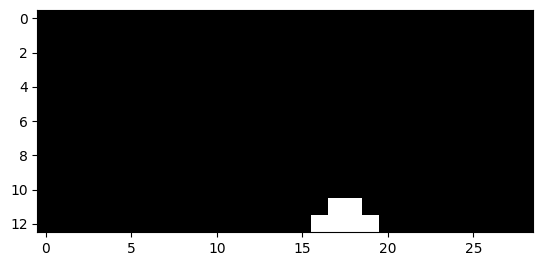

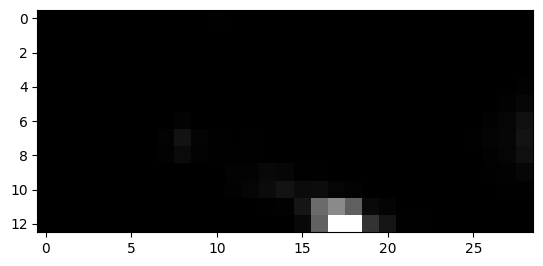

317


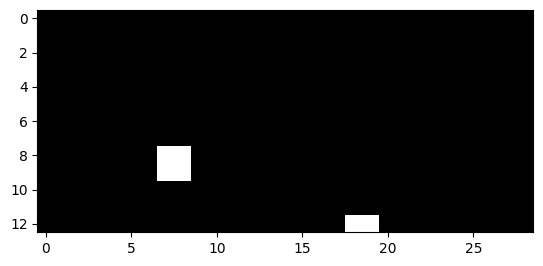

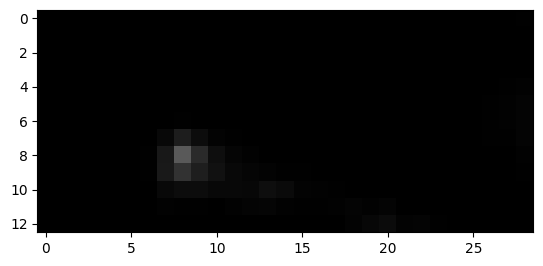

318


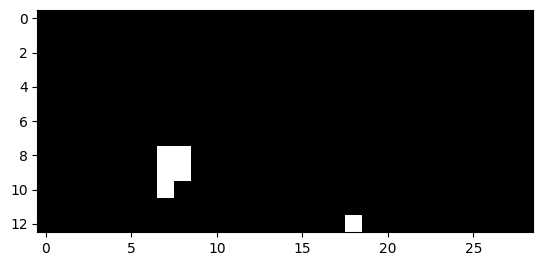

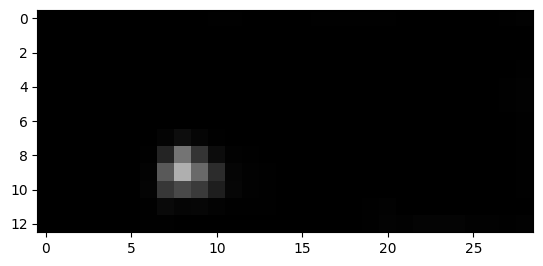

319


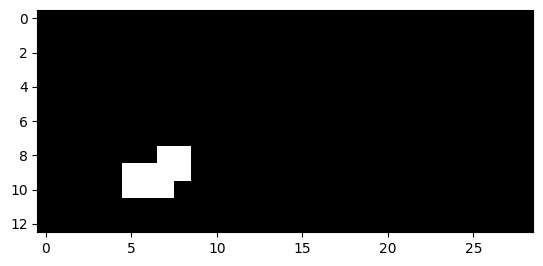

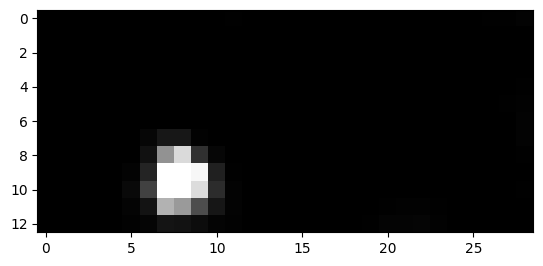

320


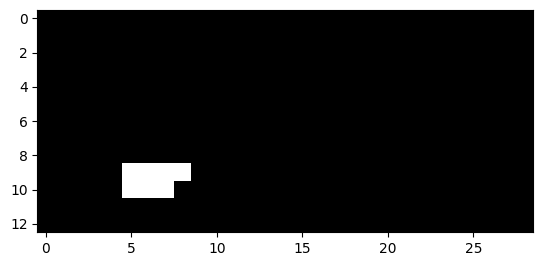

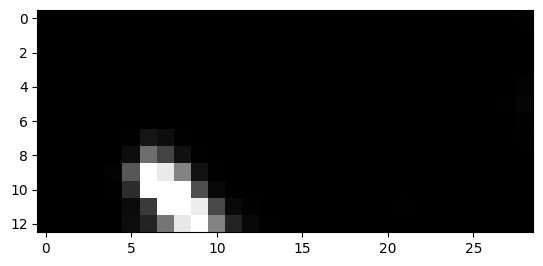

321


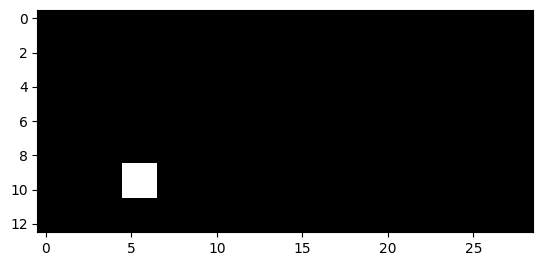

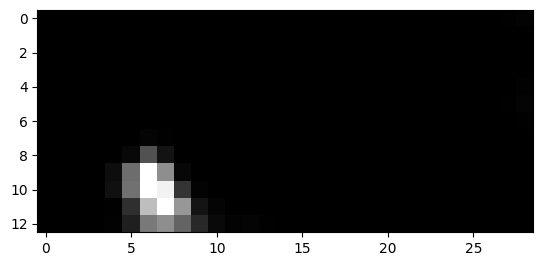

335


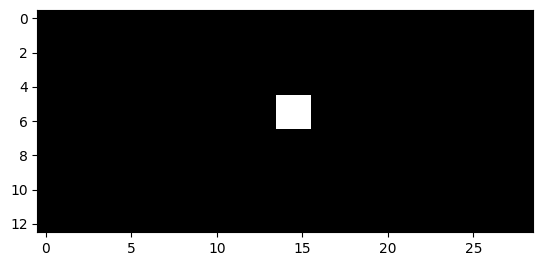

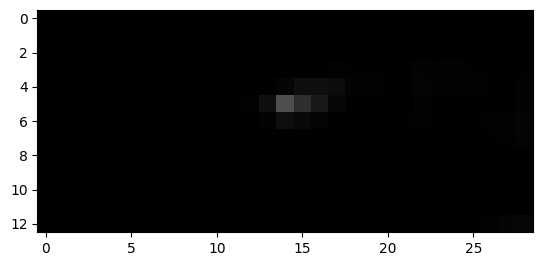

336


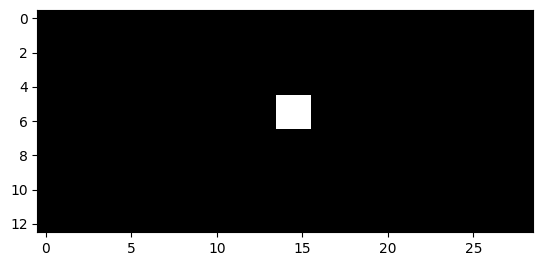

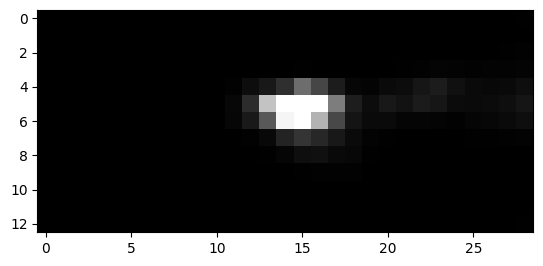

337


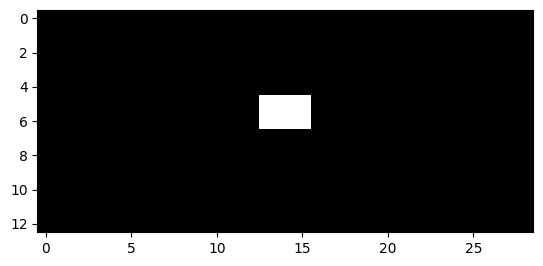

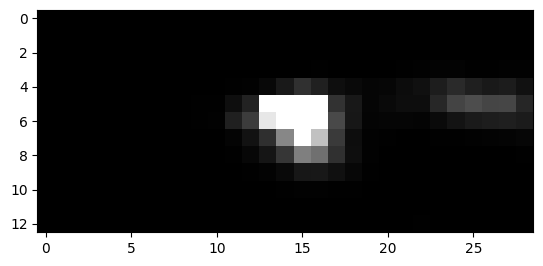

338


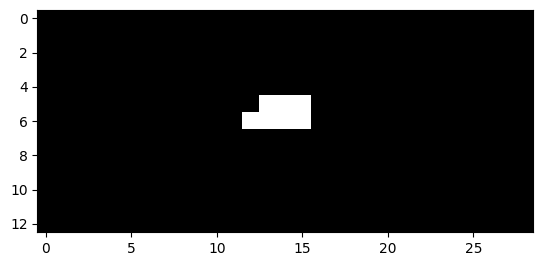

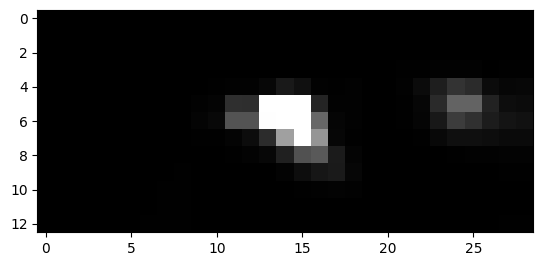

339


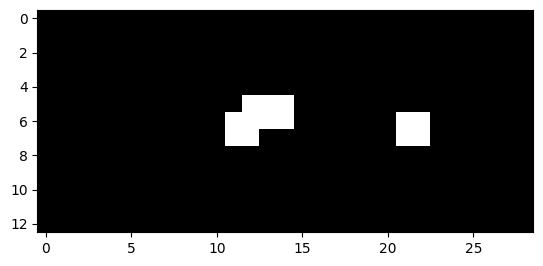

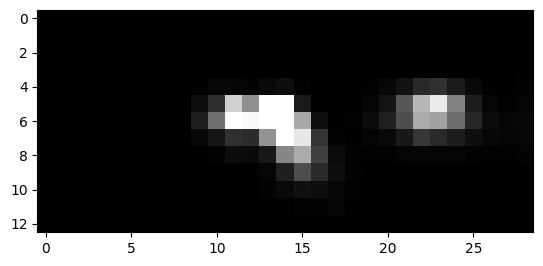

340


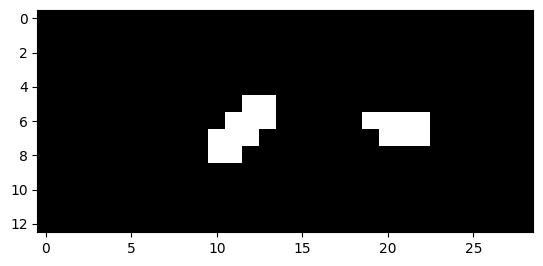

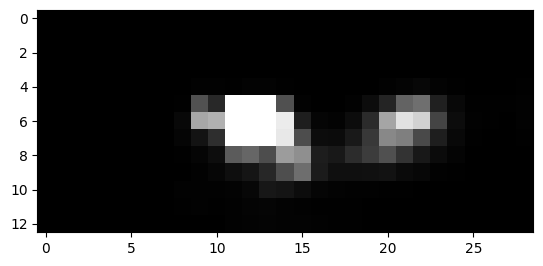

341


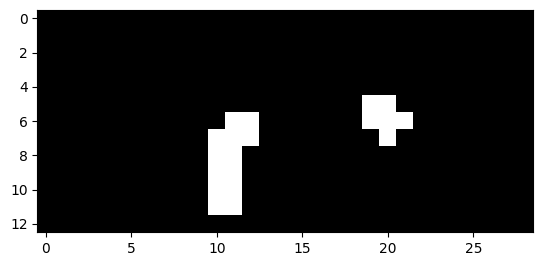

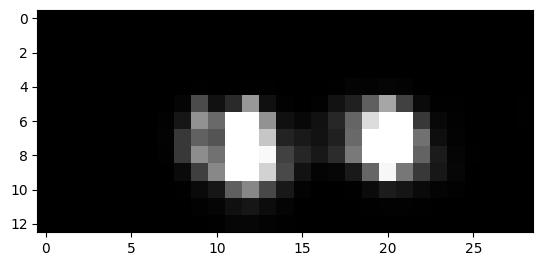

342


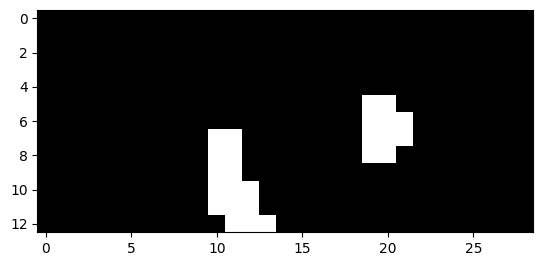

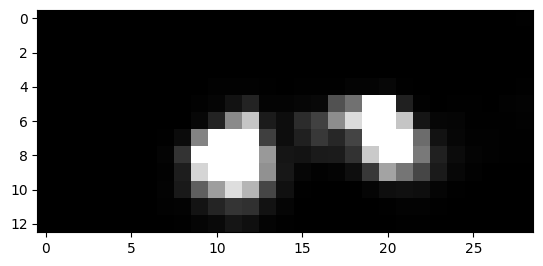

343


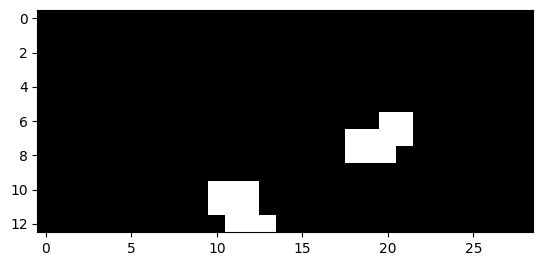

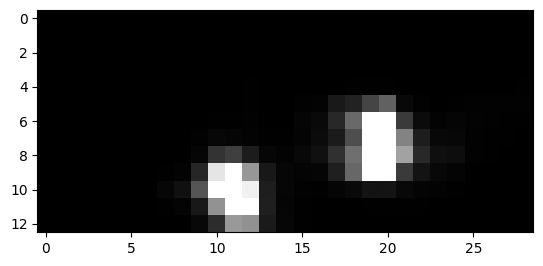

344


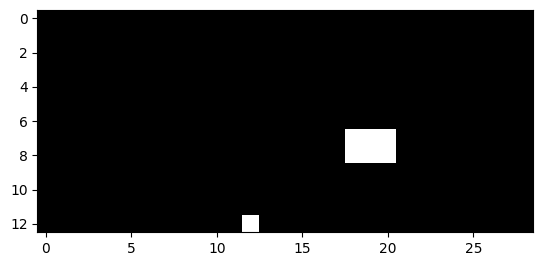

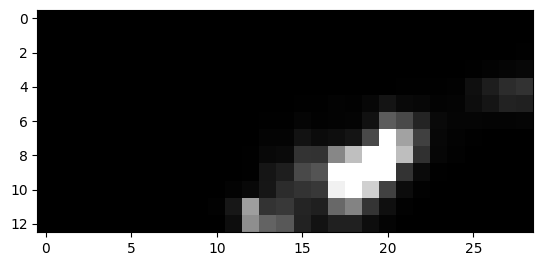

346


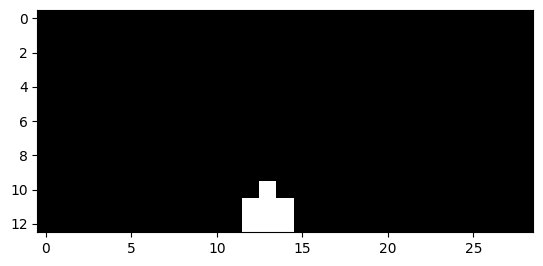

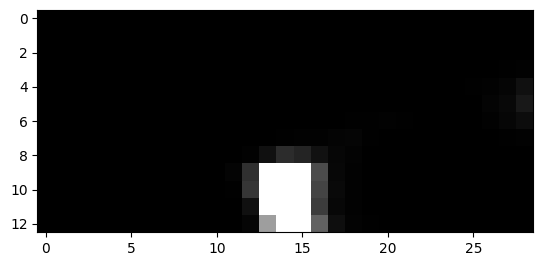

347


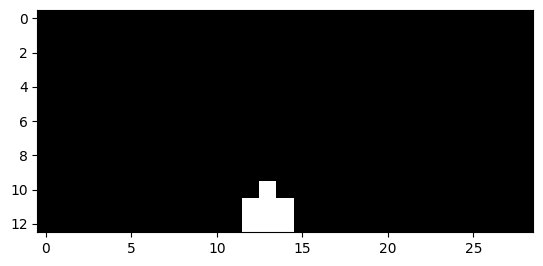

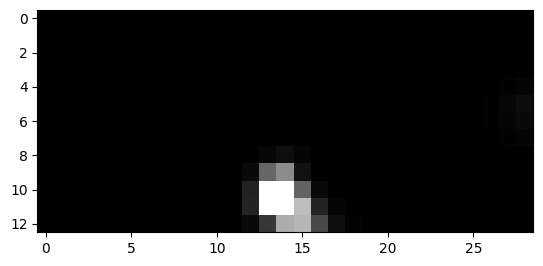

348


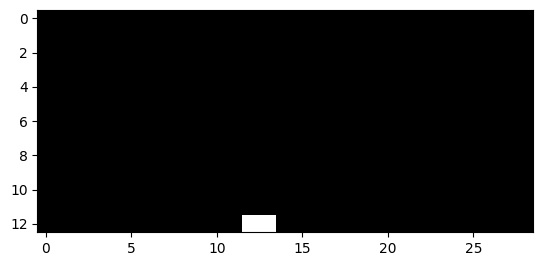

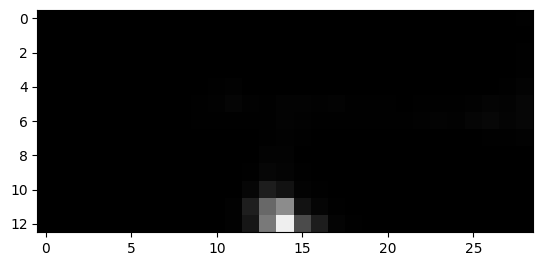

640


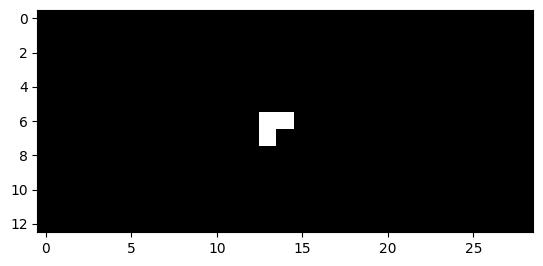

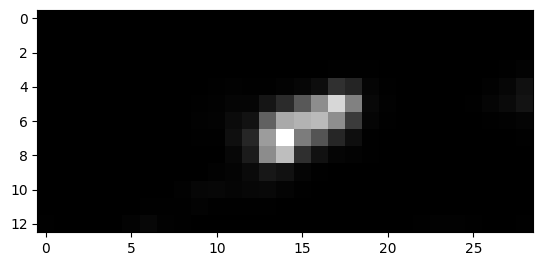

641


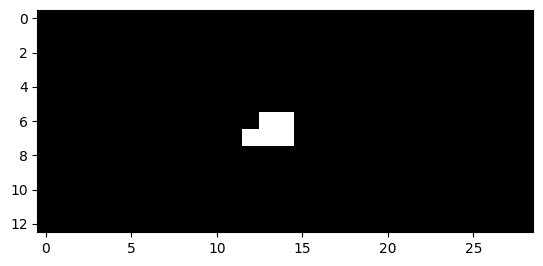

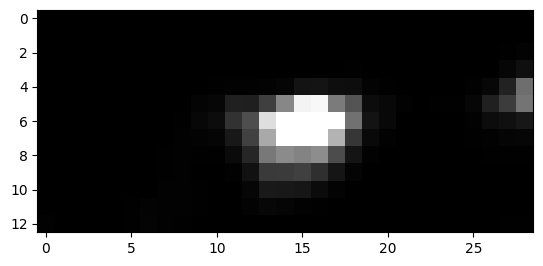

642


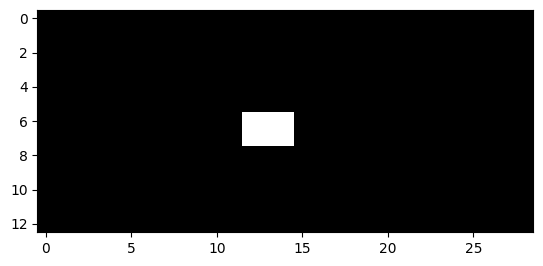

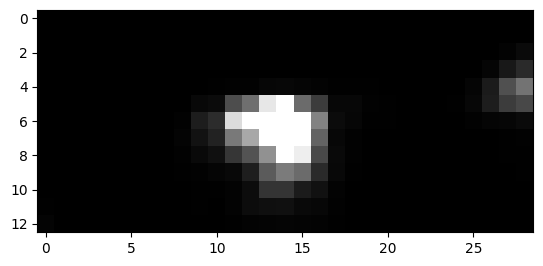

643


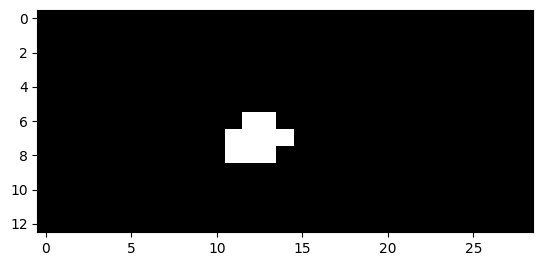

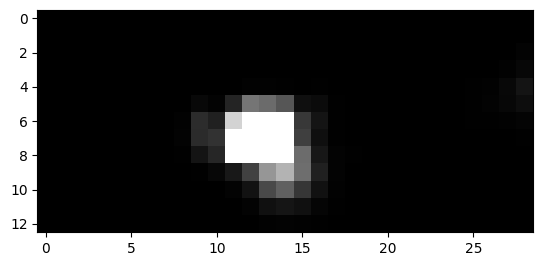

644


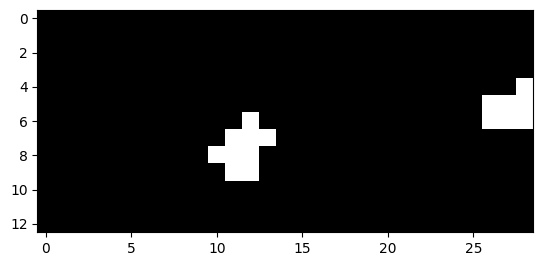

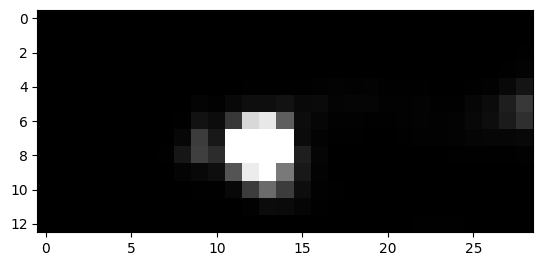

645


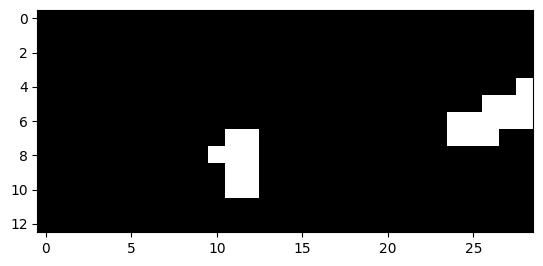

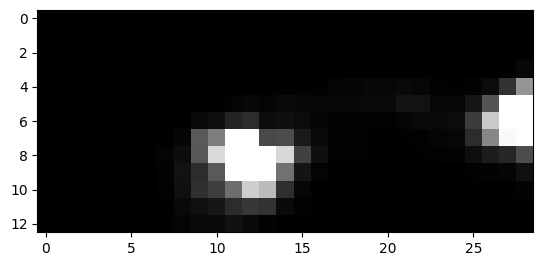

646


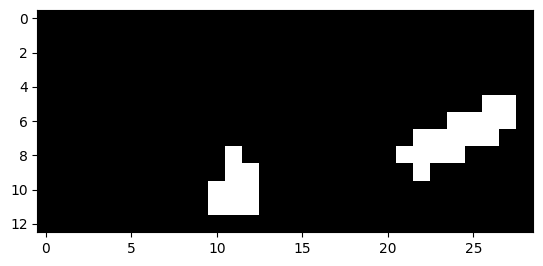

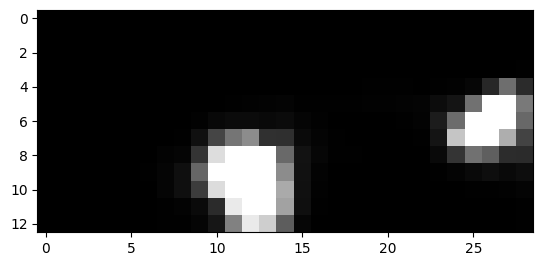

647


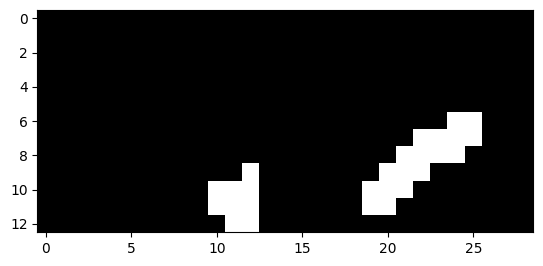

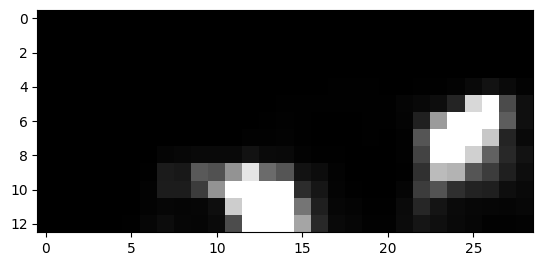

648


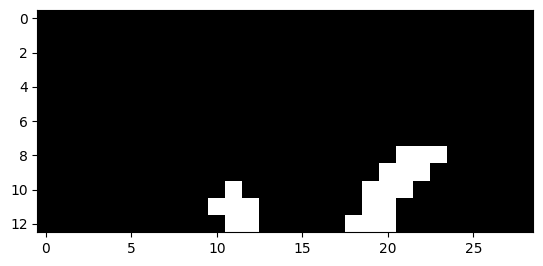

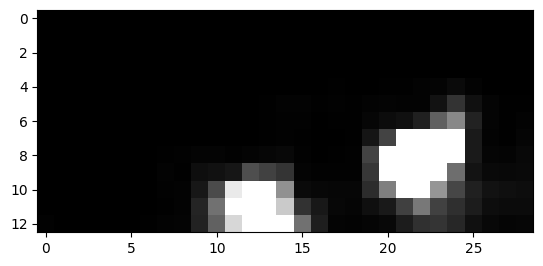

649


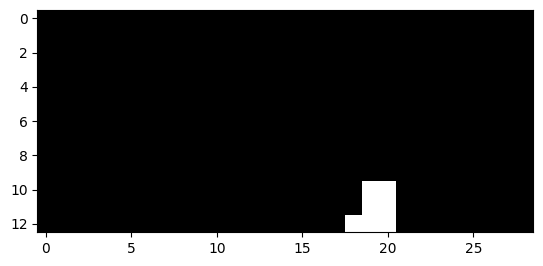

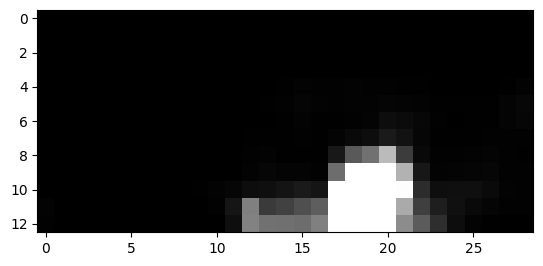

651


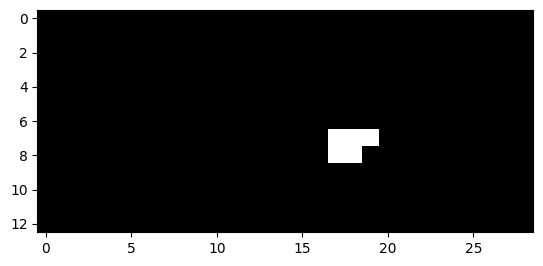

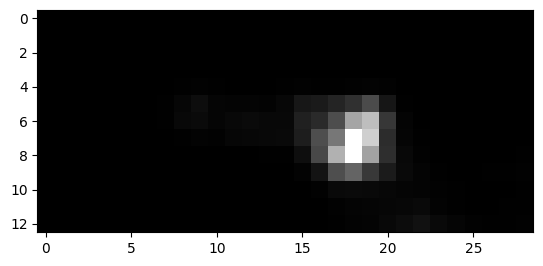

652


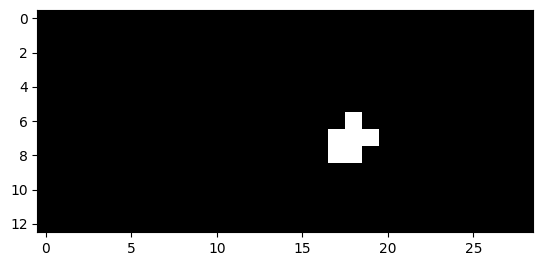

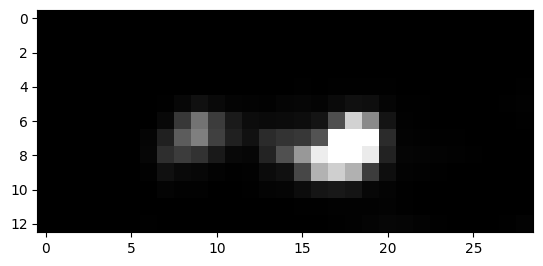

653


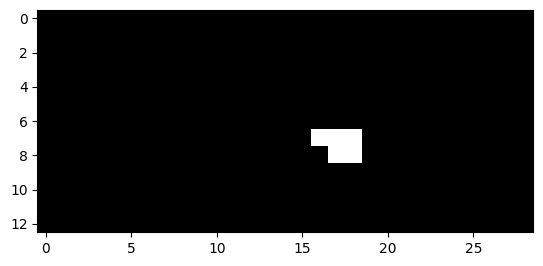

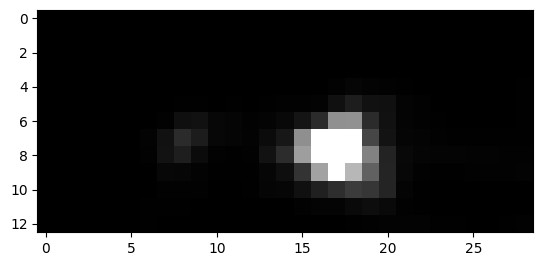

654


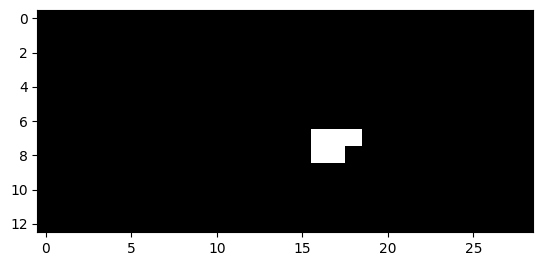

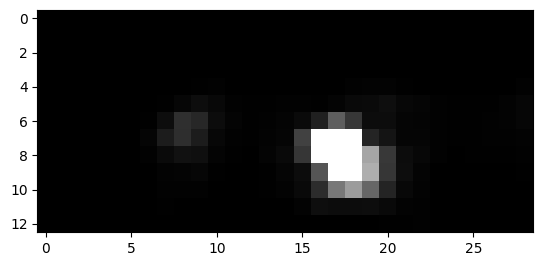

655


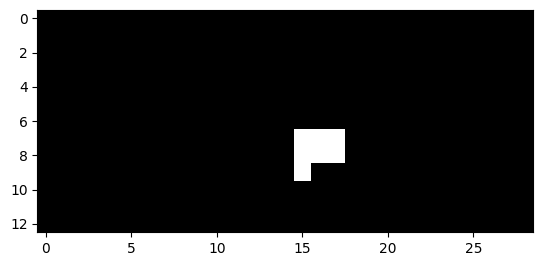

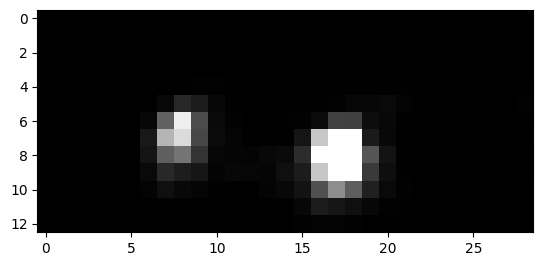

656


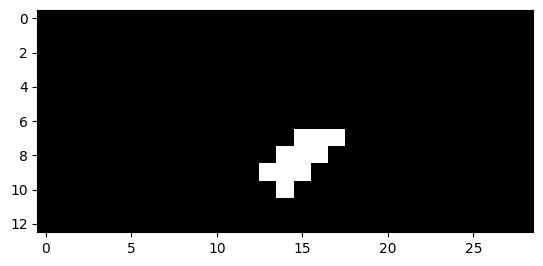

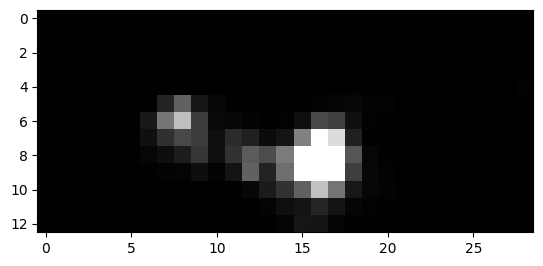

657


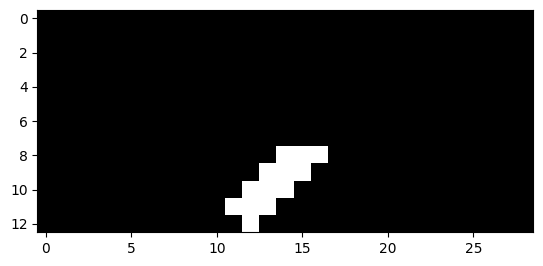

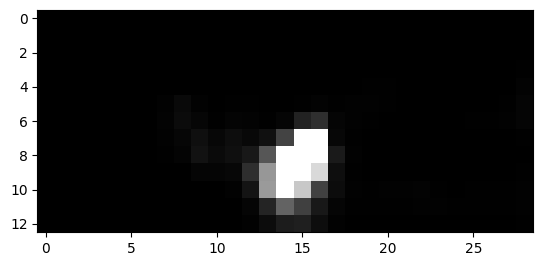

658


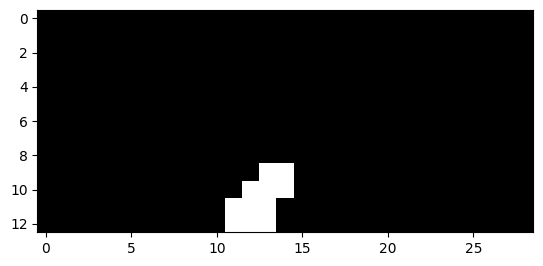

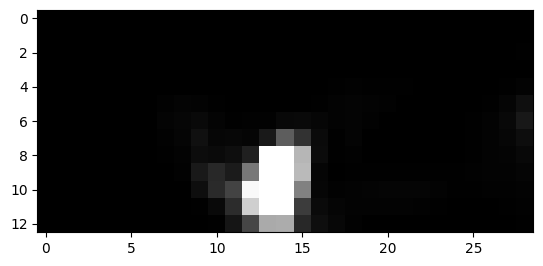

659


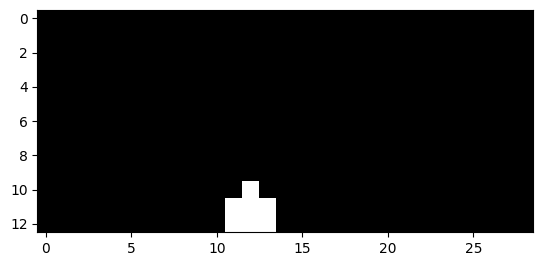

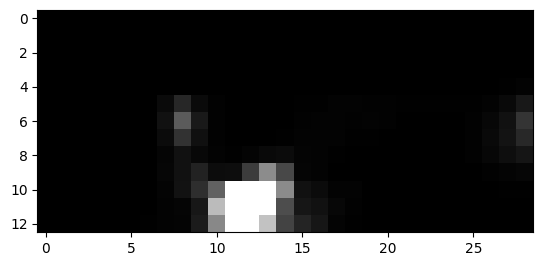

665


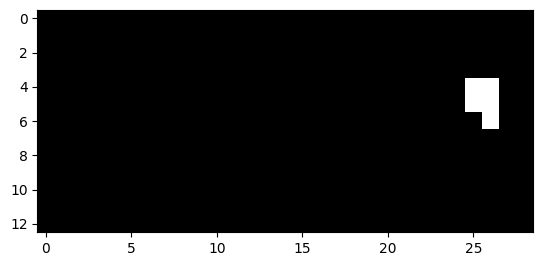

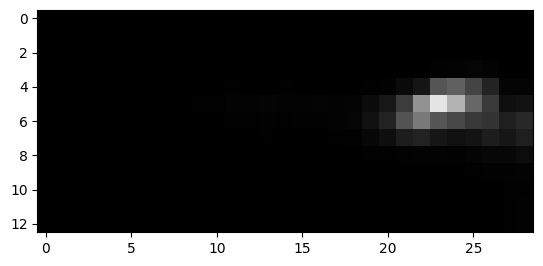

666


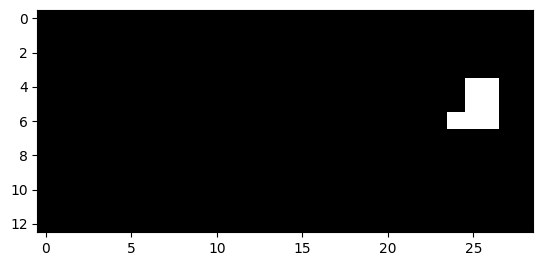

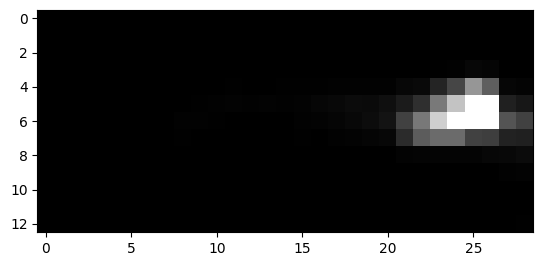

667


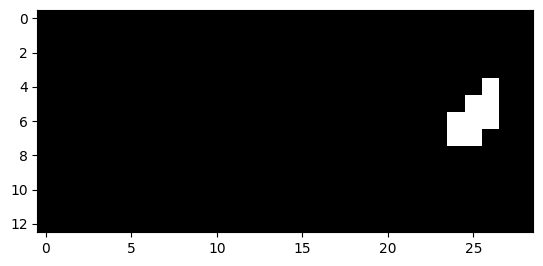

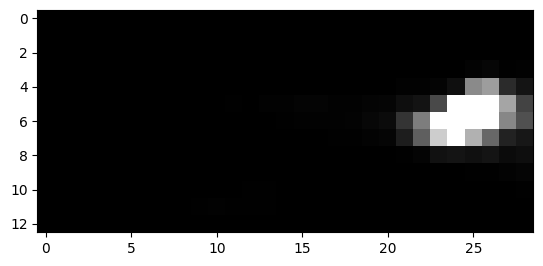

668


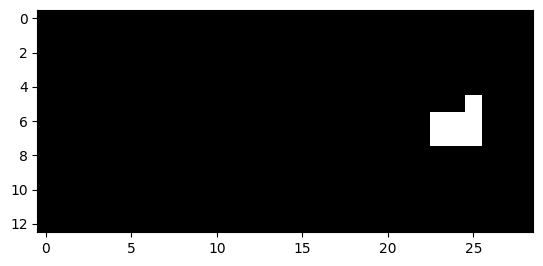

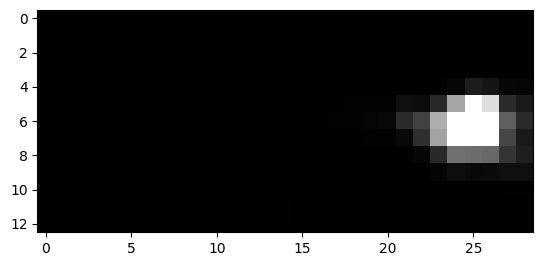

669


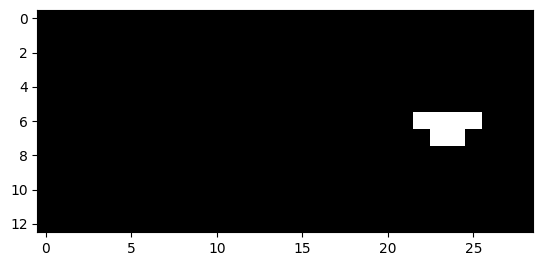

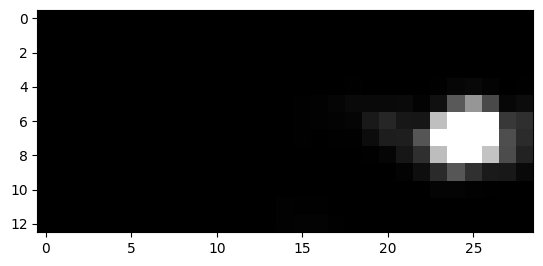

670


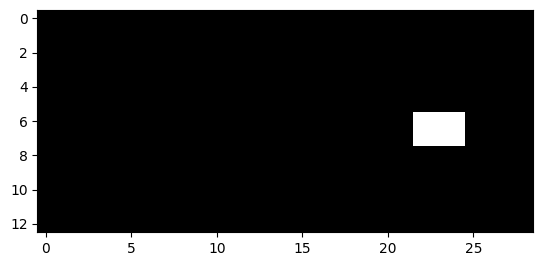

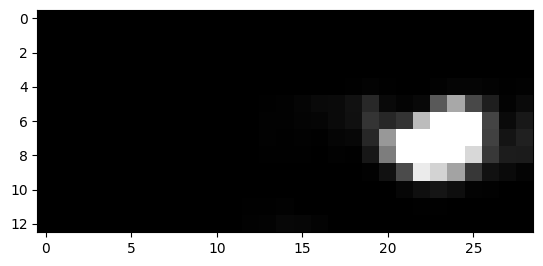

671


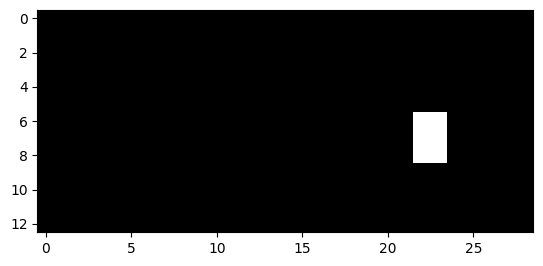

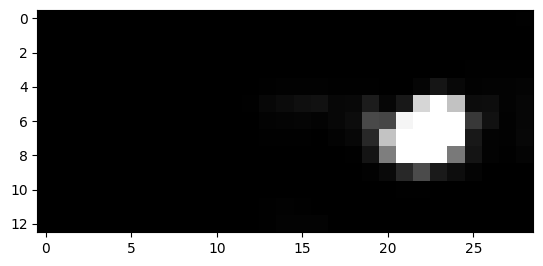

672


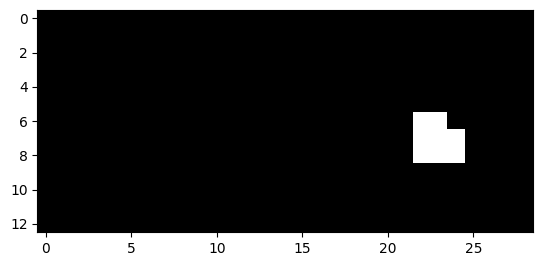

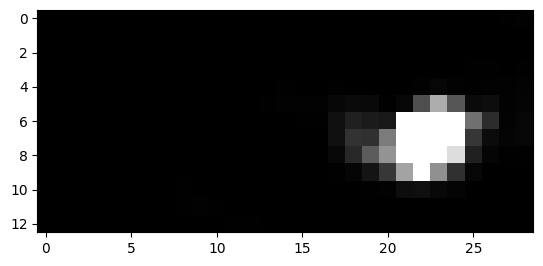

673


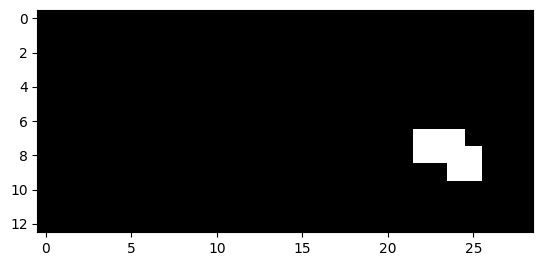

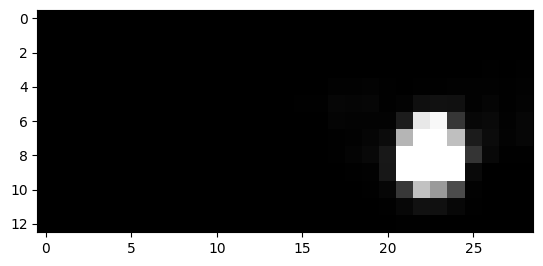

674


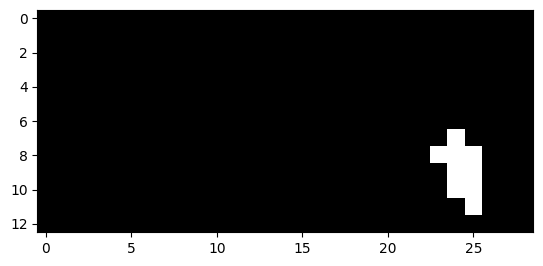

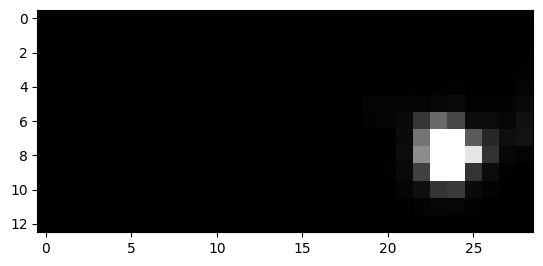

675


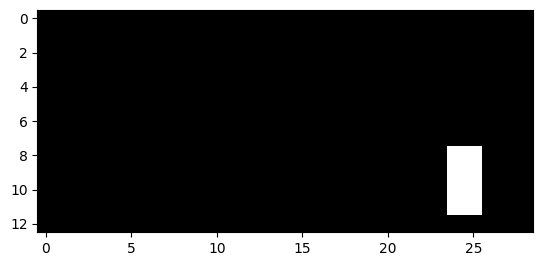

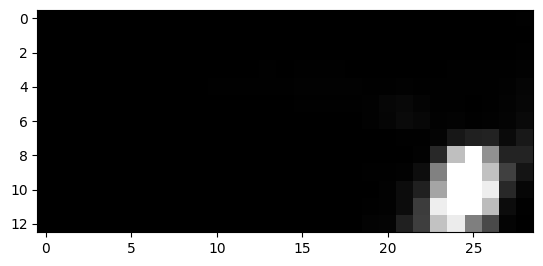

676


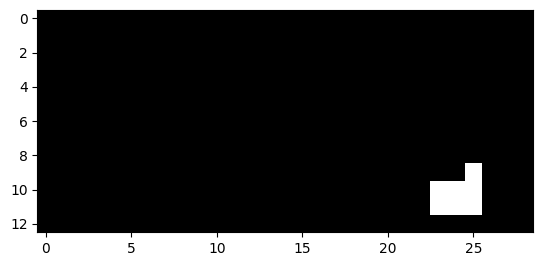

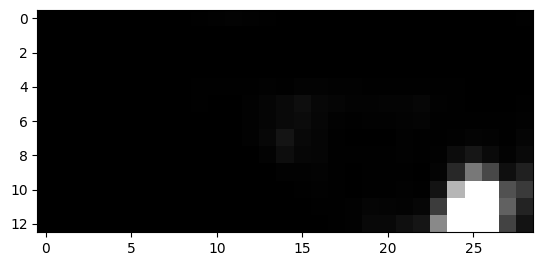

677


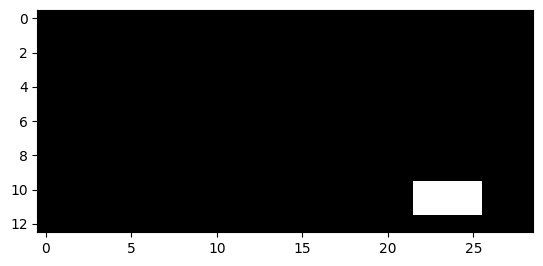

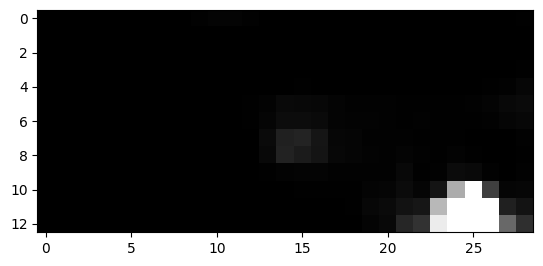

678


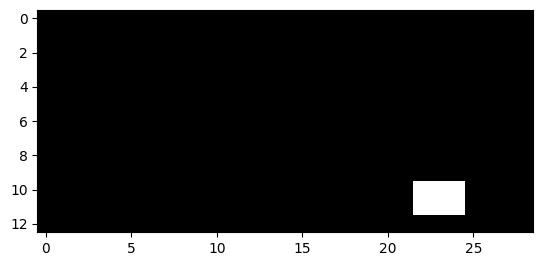

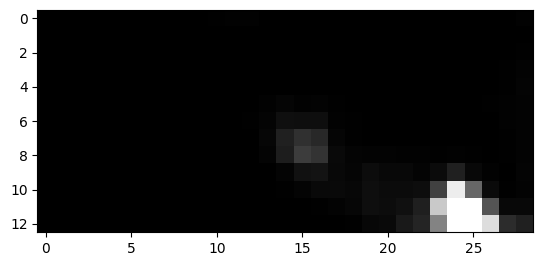

699


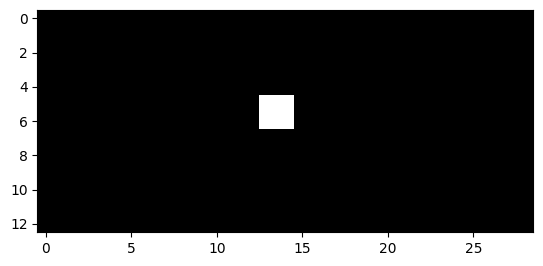

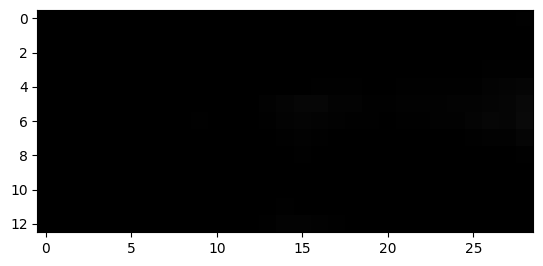

700


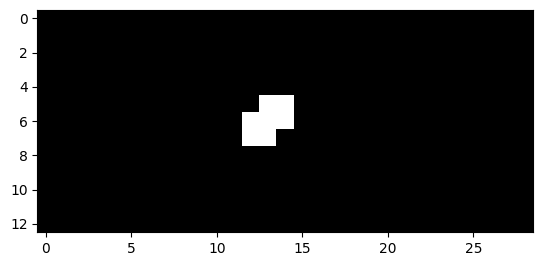

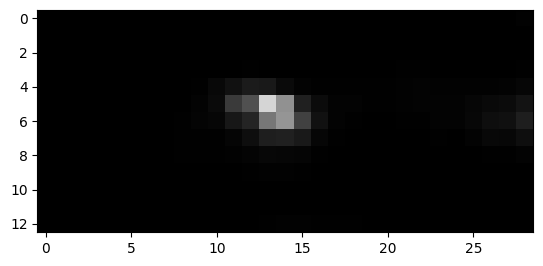

701


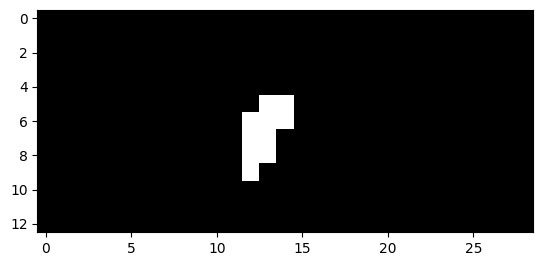

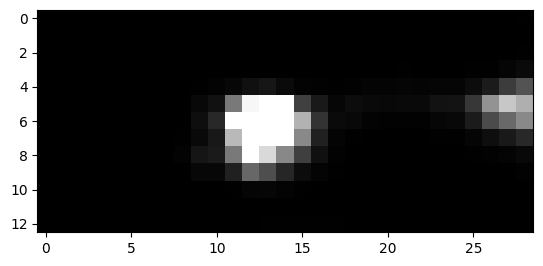

702


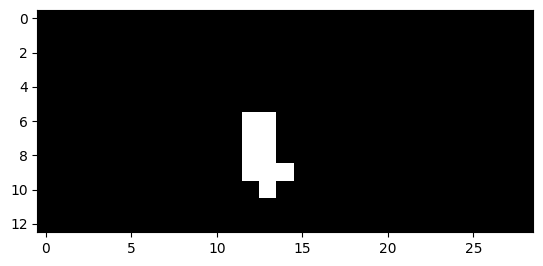

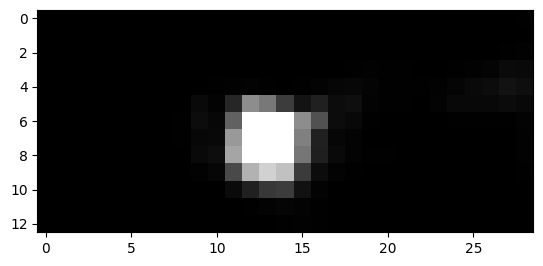

703


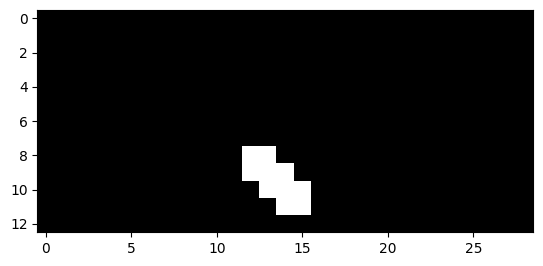

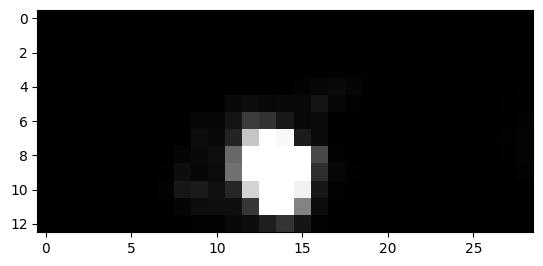

704


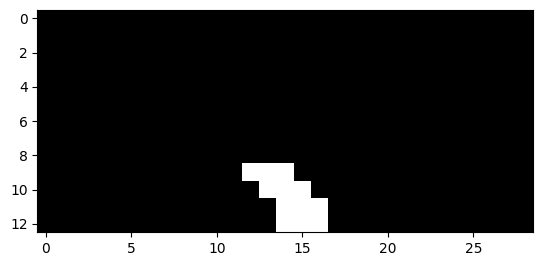

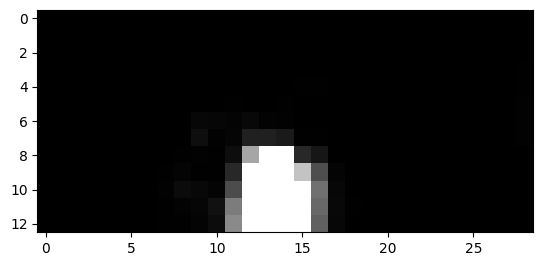

705


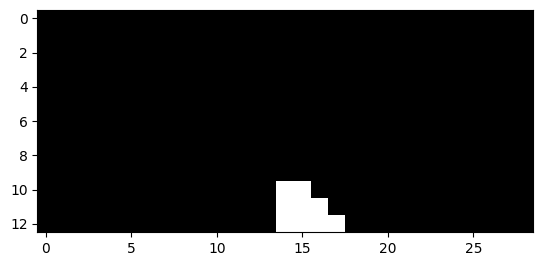

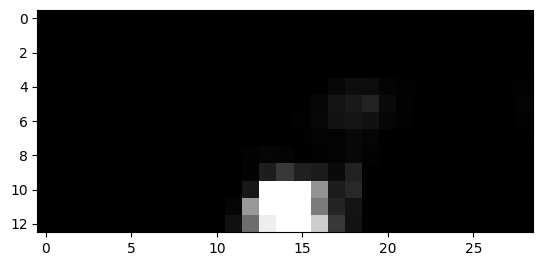

706


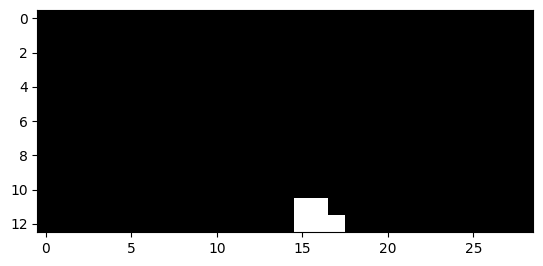

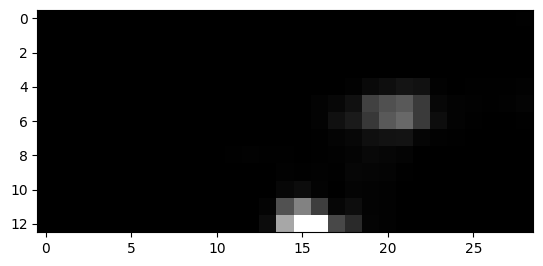

711


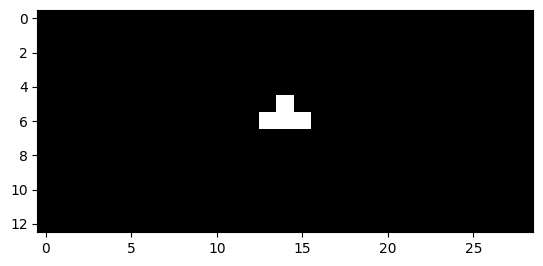

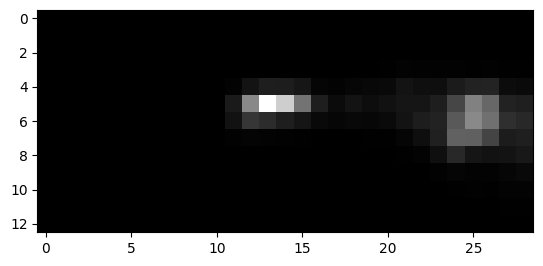

712


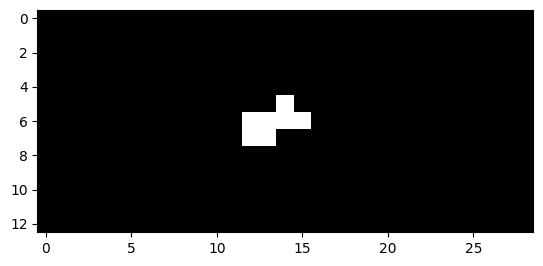

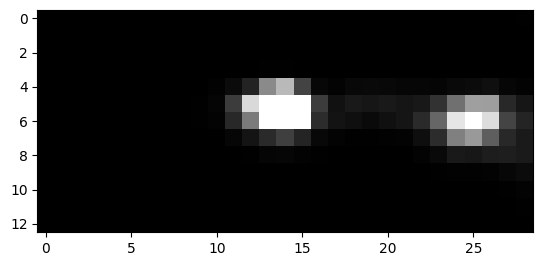

713


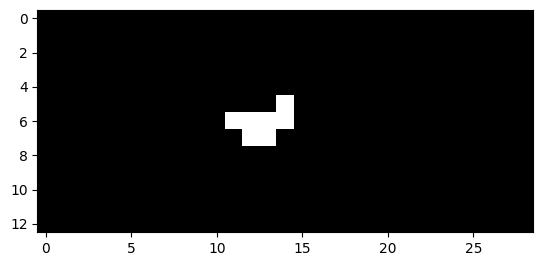

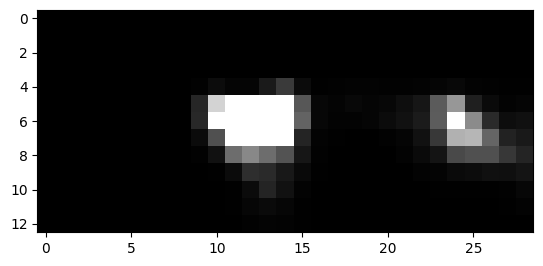

714


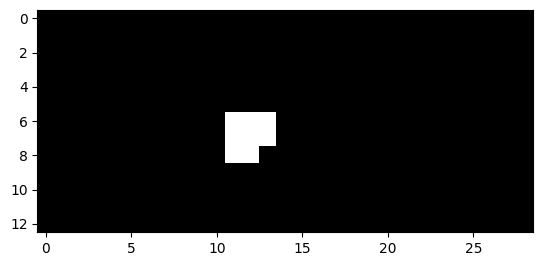

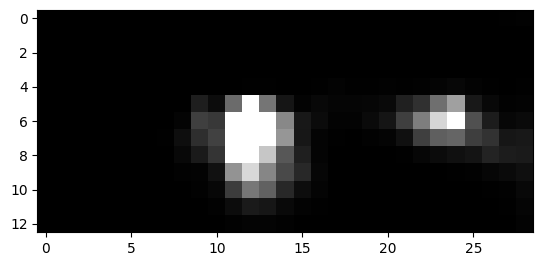

715


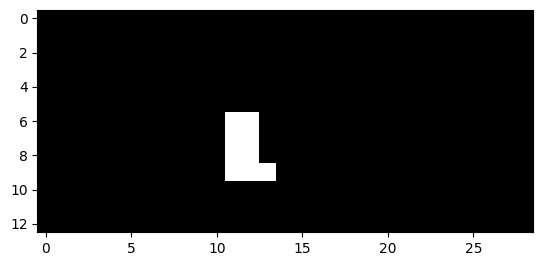

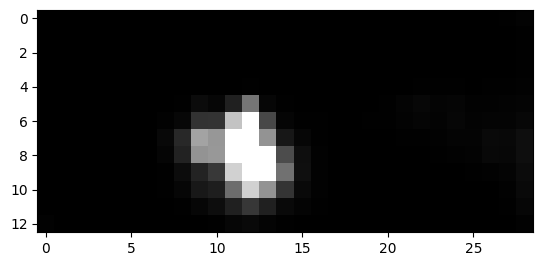

716


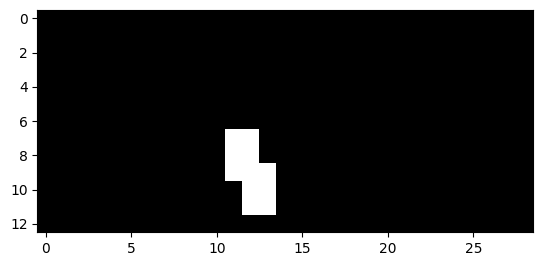

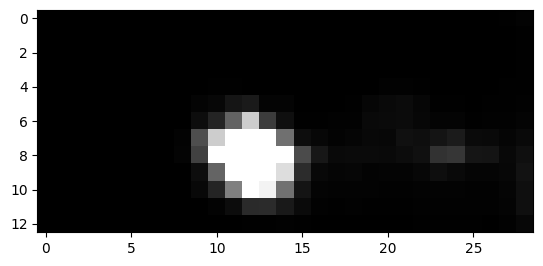

717


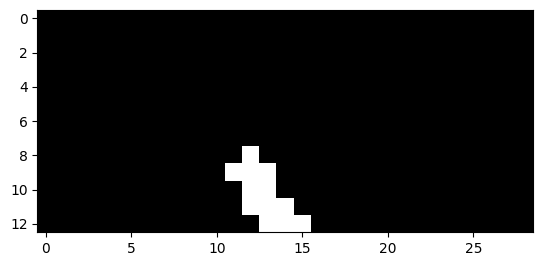

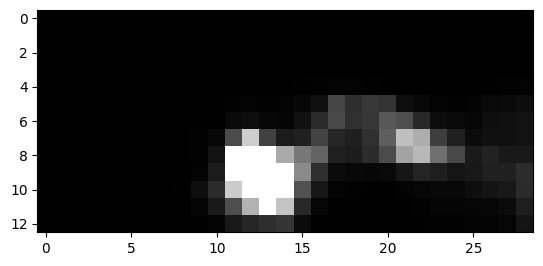

718


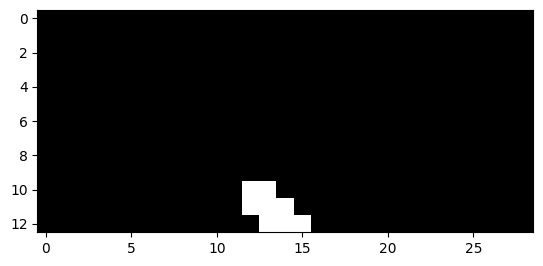

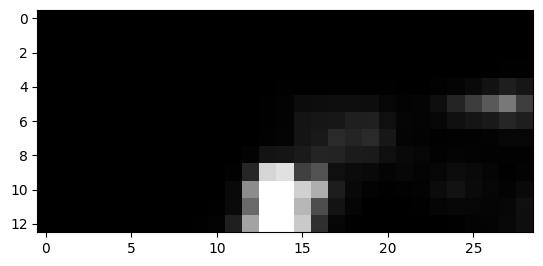

719


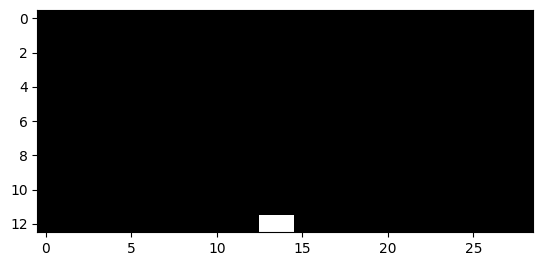

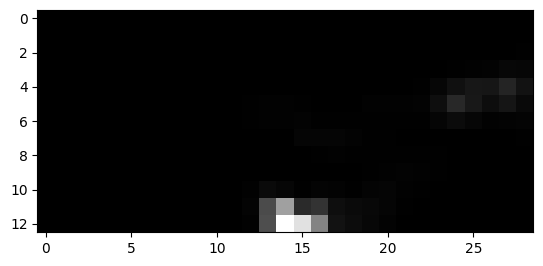

751


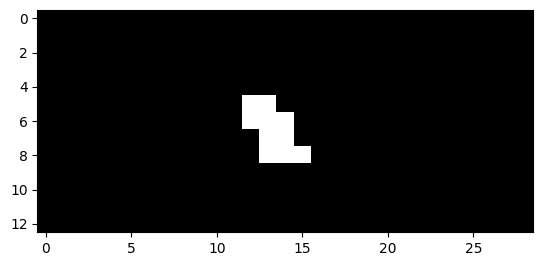

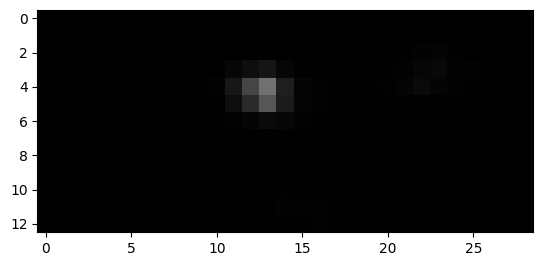

752


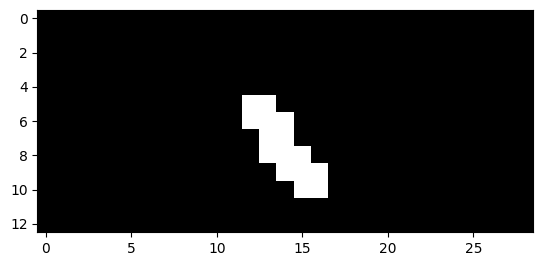

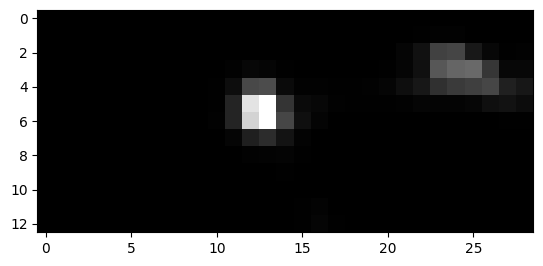

753


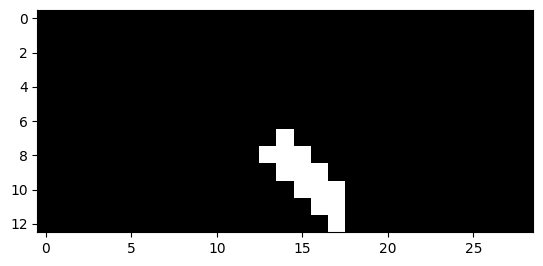

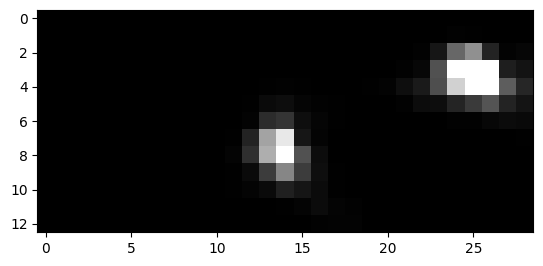

754


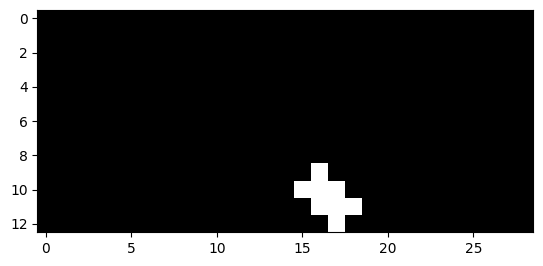

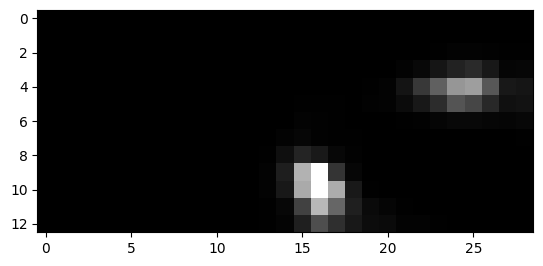

755


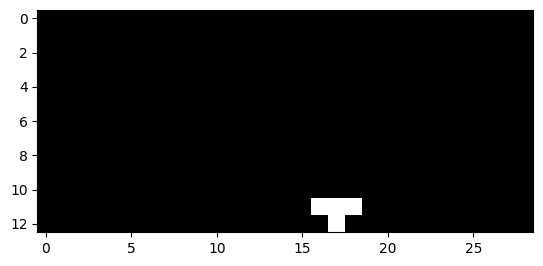

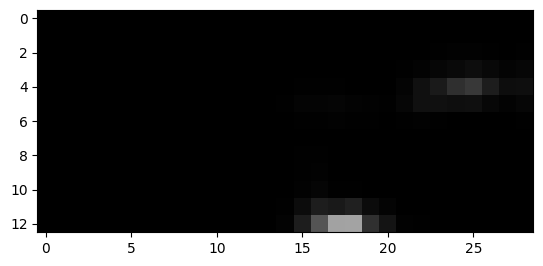

756


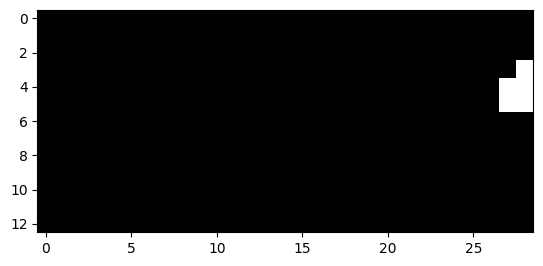

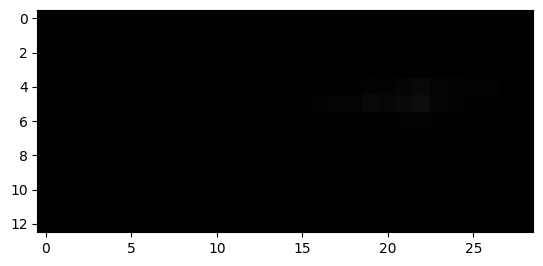

757


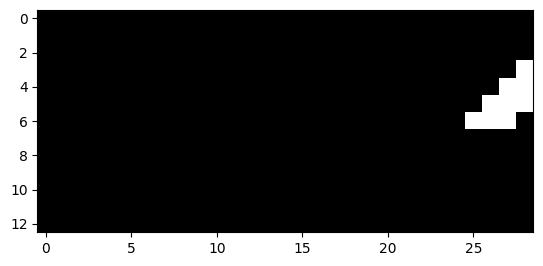

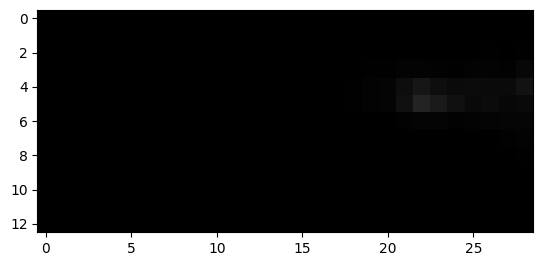

758


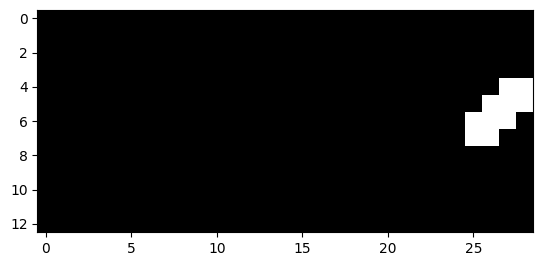

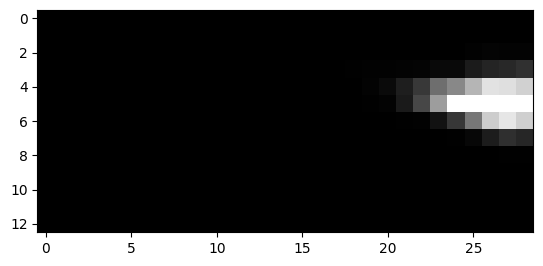

759


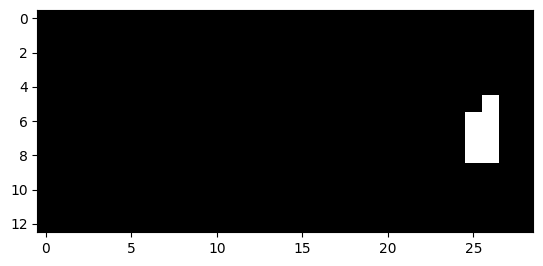

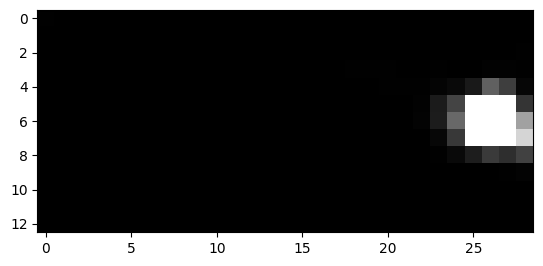

760


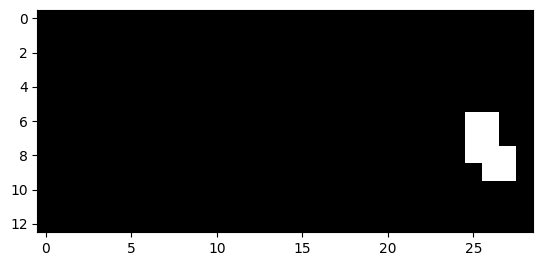

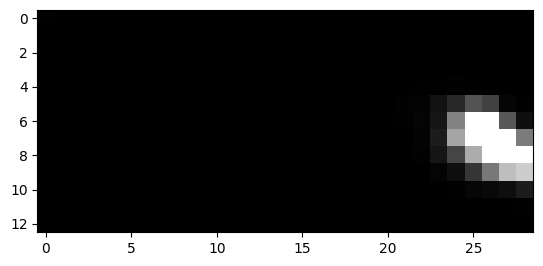

761


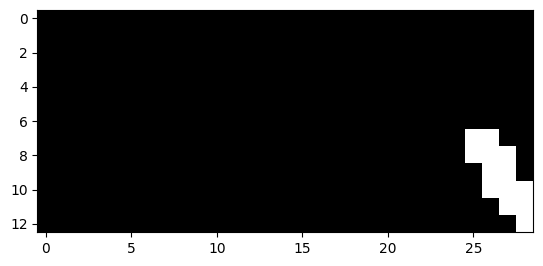

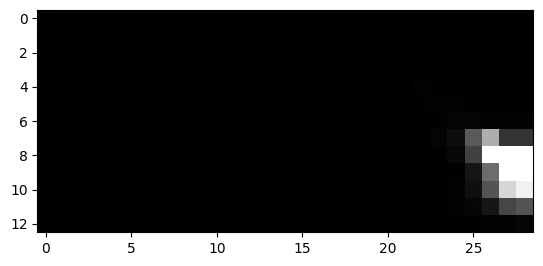

762


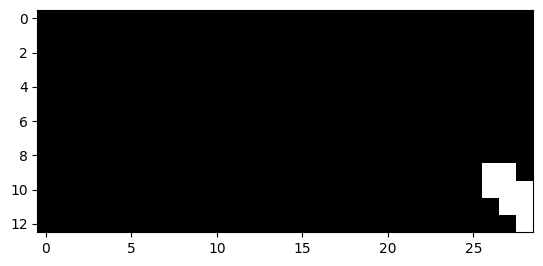

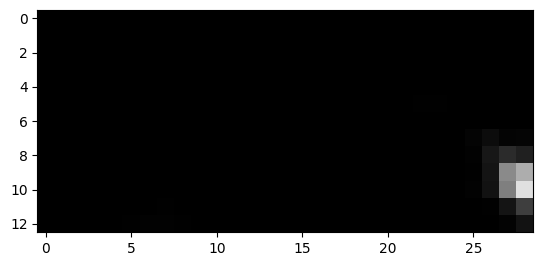

763


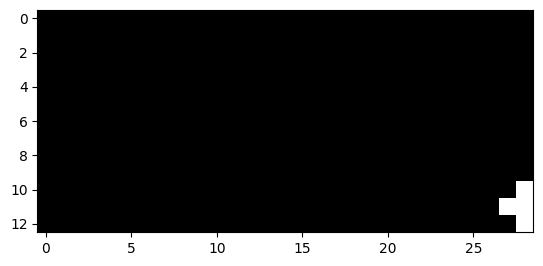

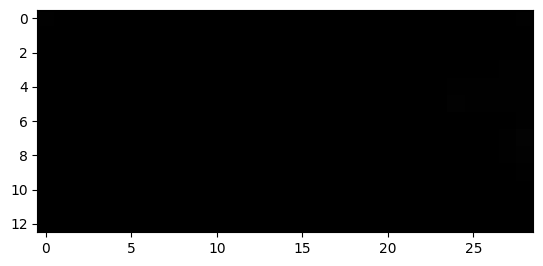

896


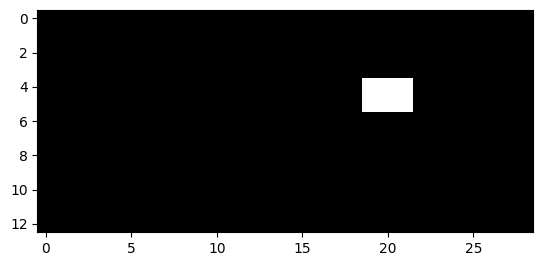

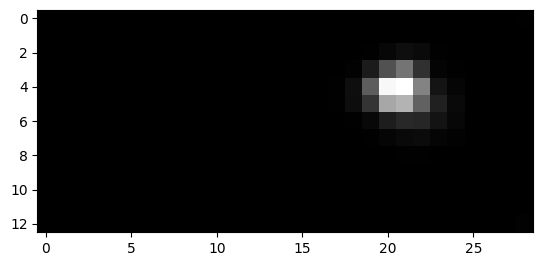

897


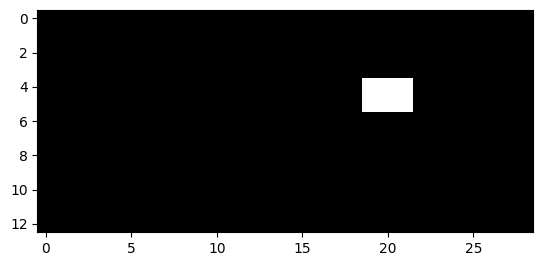

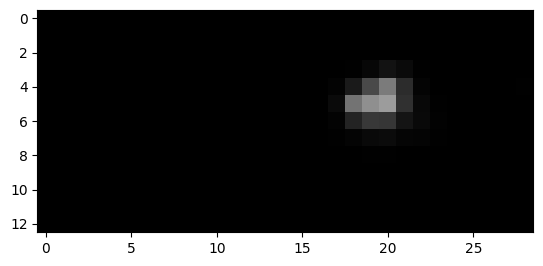

948


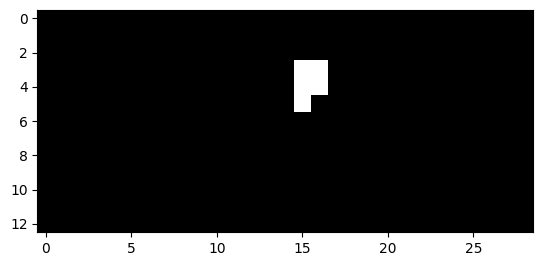

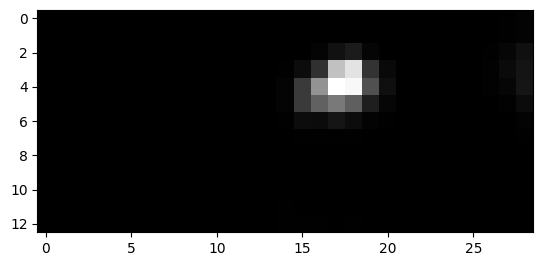

949


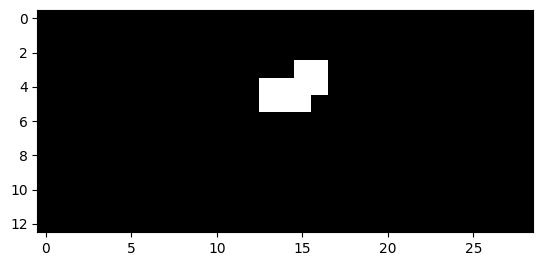

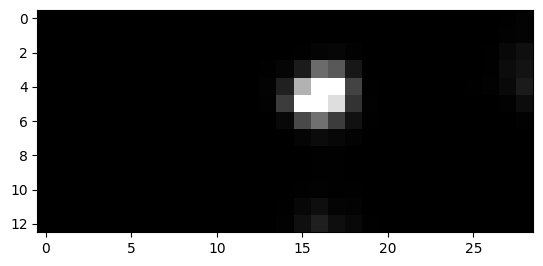

950


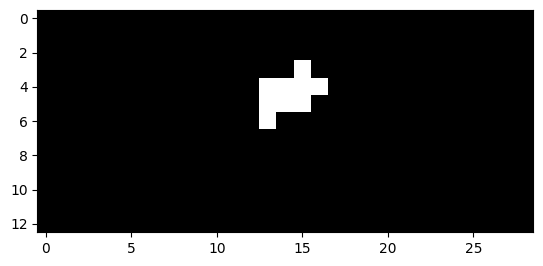

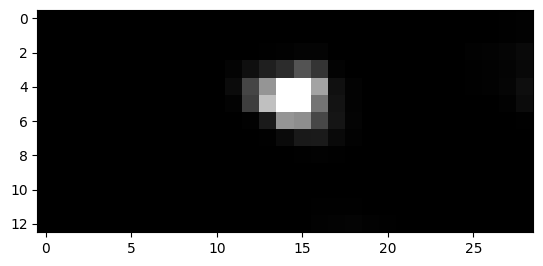

951


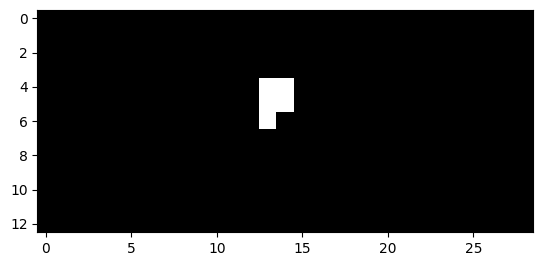

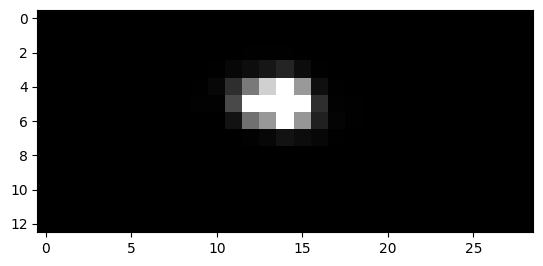

952


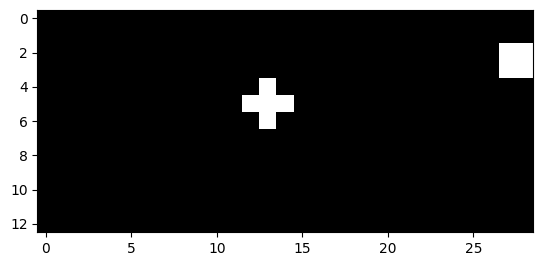

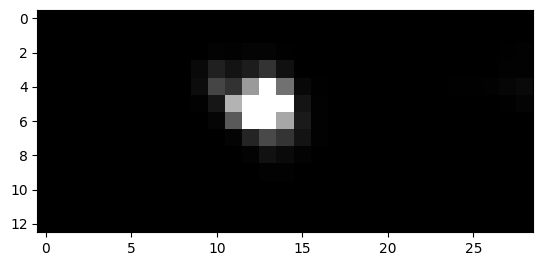

953


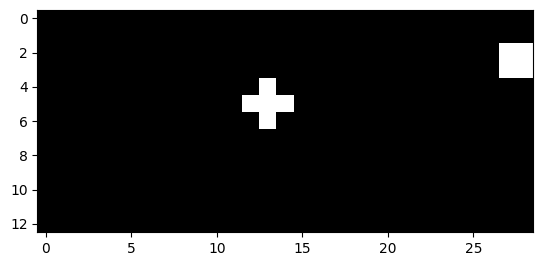

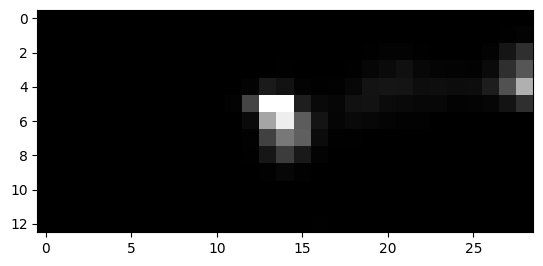

954


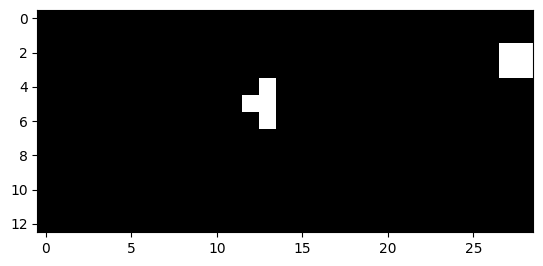

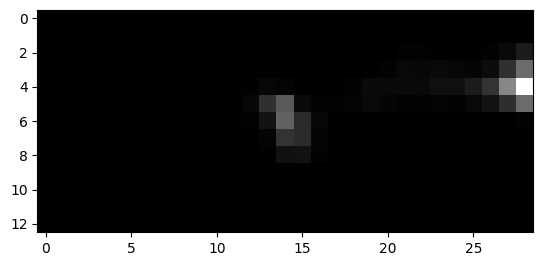

955


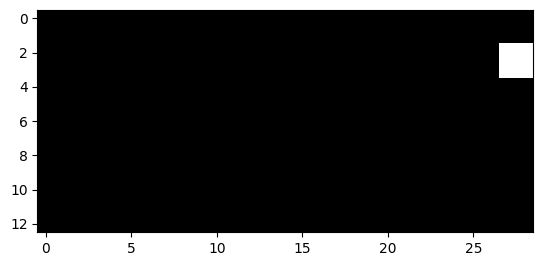

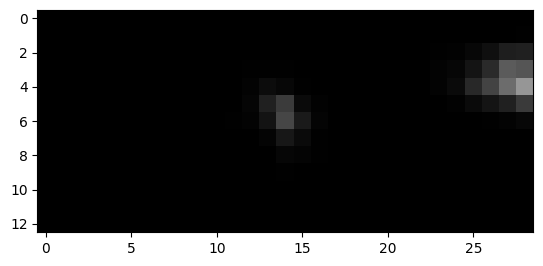

959


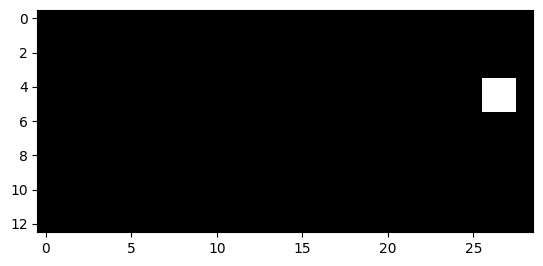

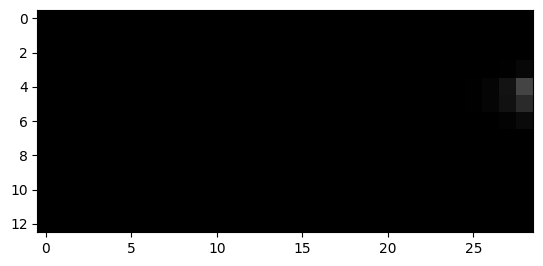

960


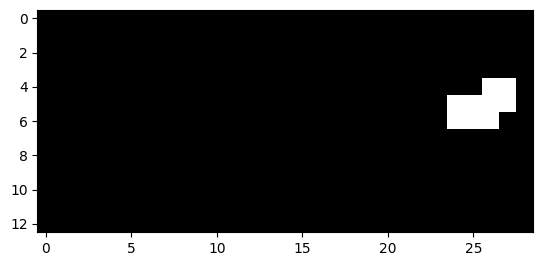

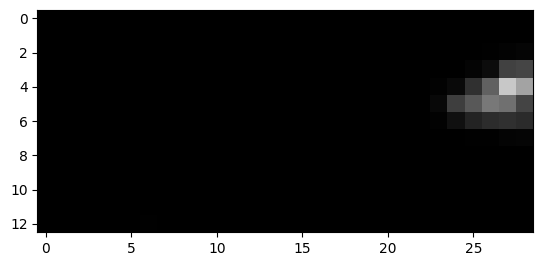

961


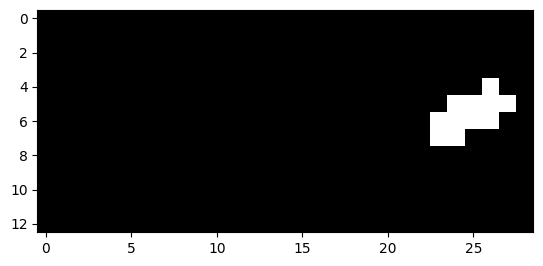

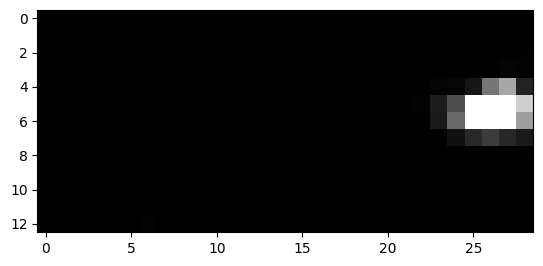

962


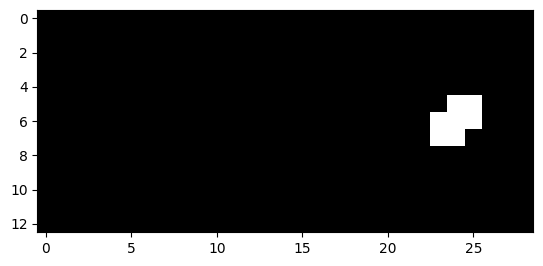

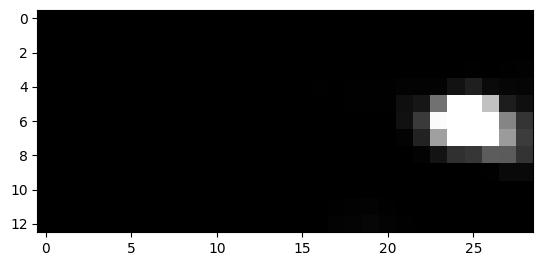

987


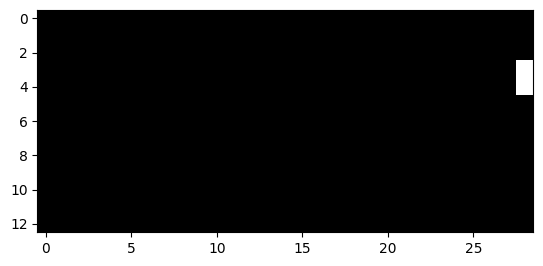

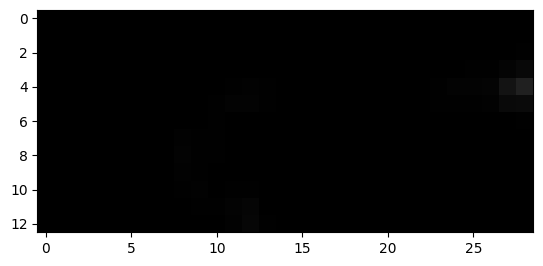

988


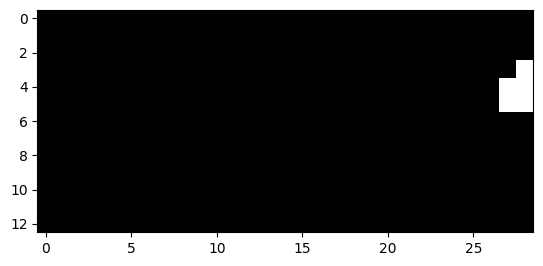

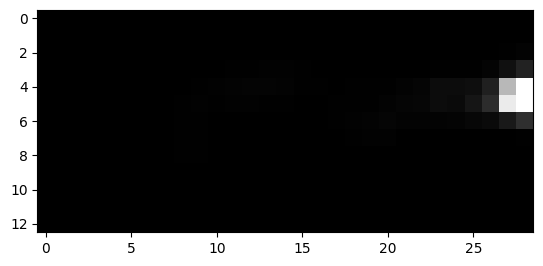

989


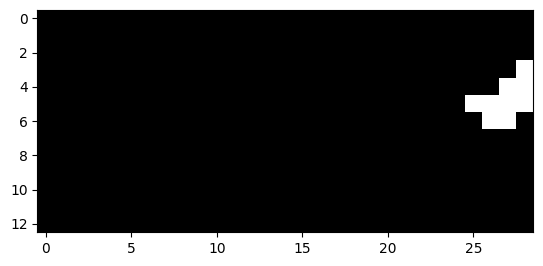

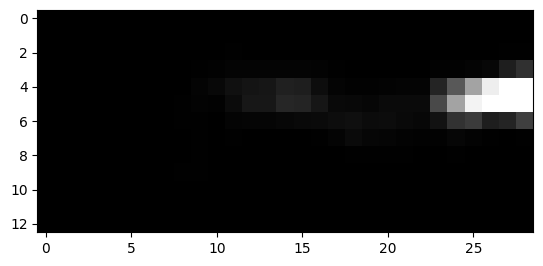

990


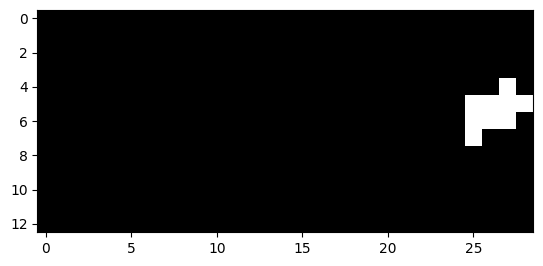

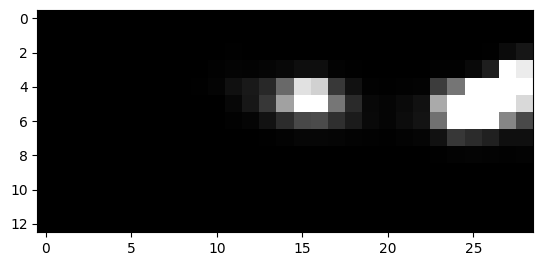

991


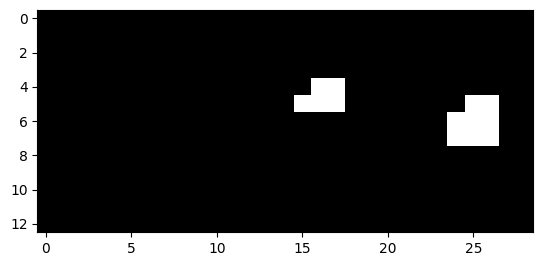

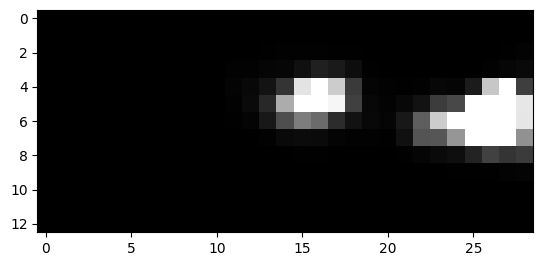

992


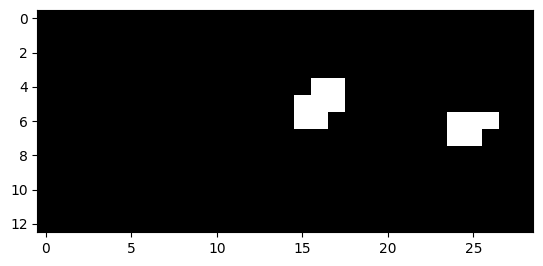

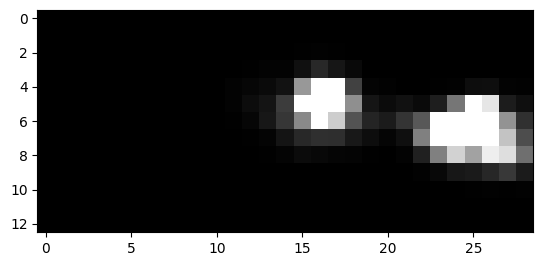

993


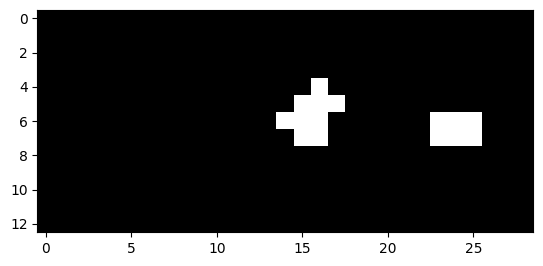

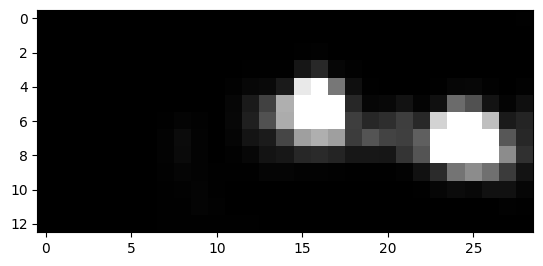

994


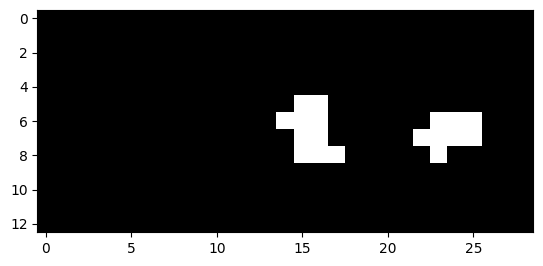

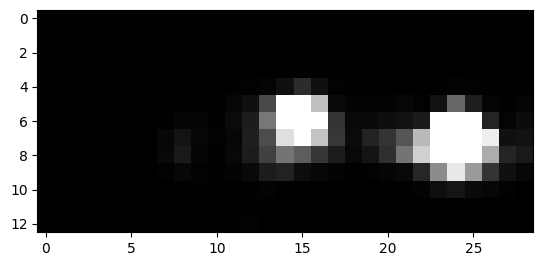

995


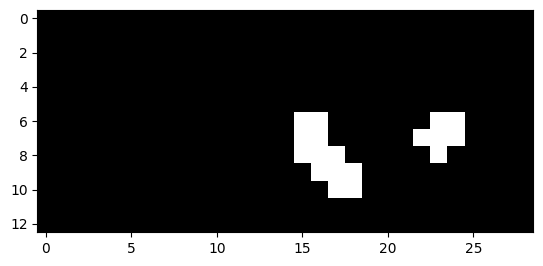

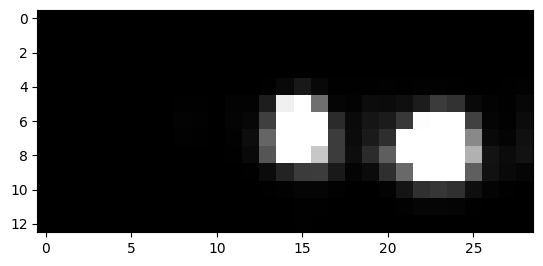

996


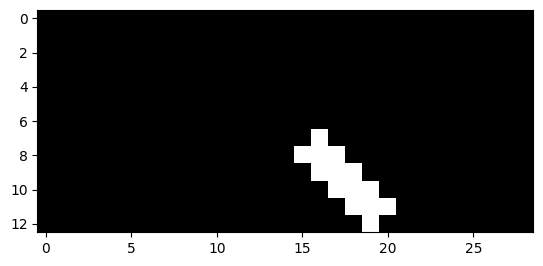

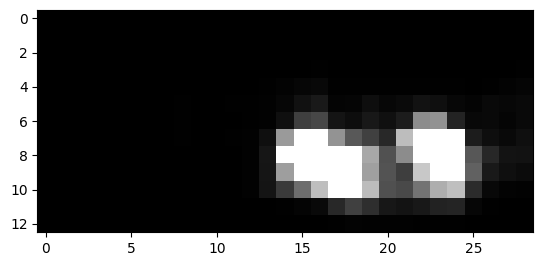

997


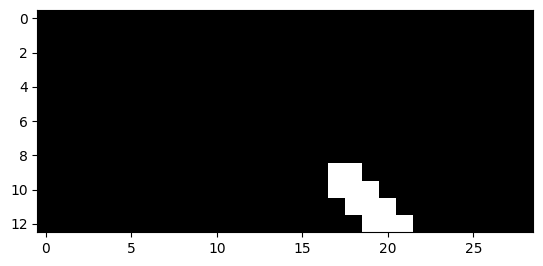

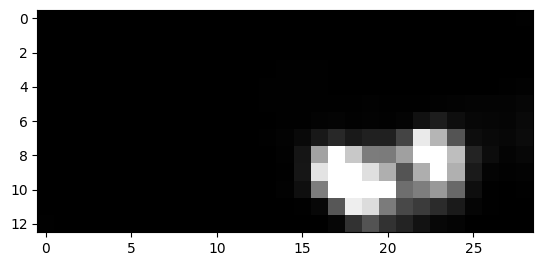

998


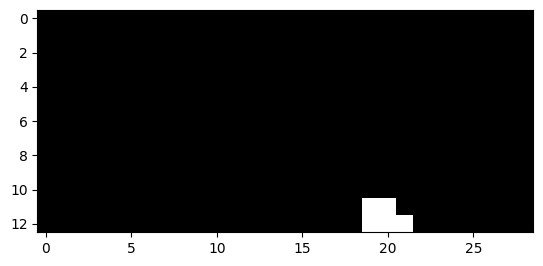

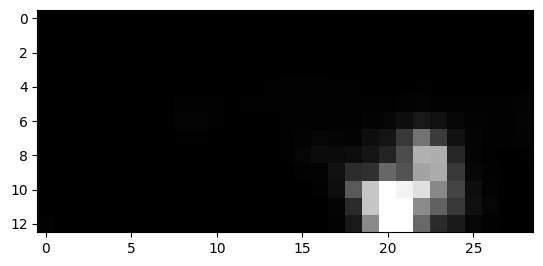

1023


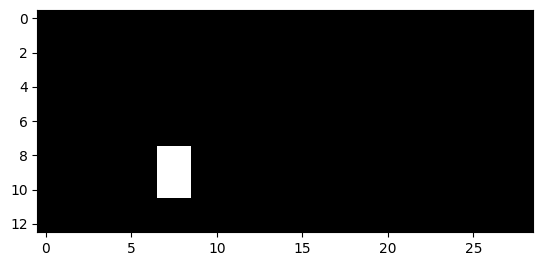

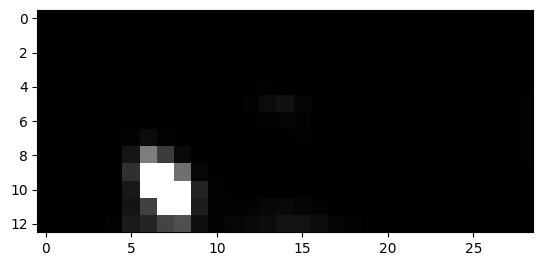

1024


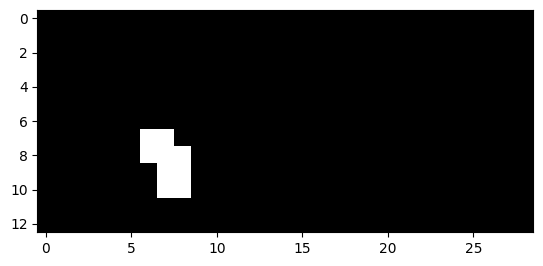

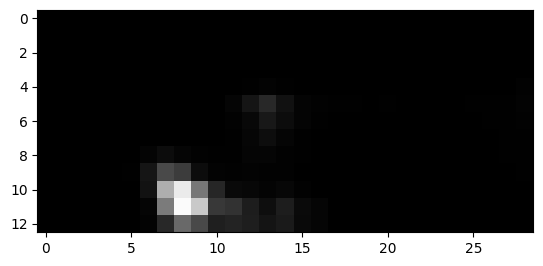

1025


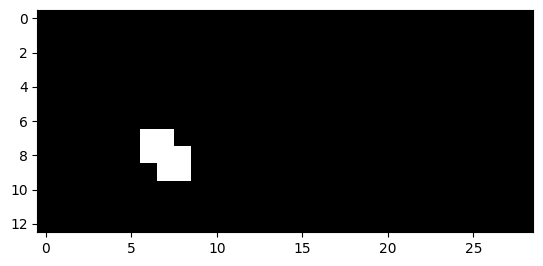

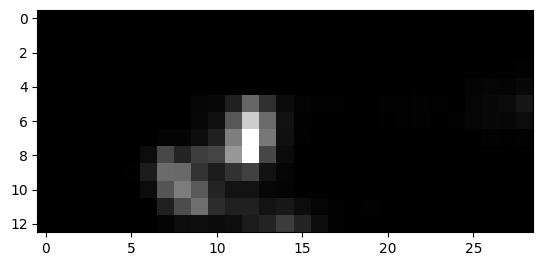

1027


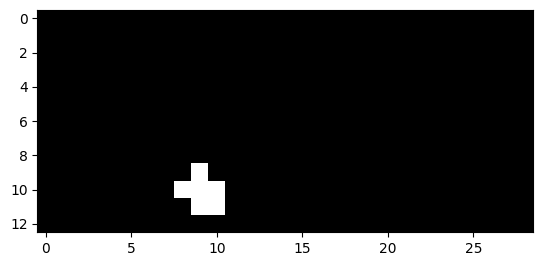

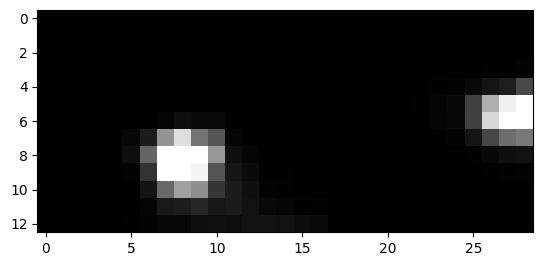

1028


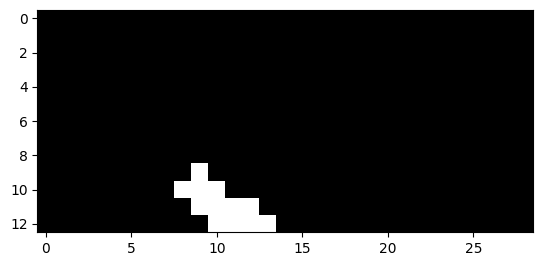

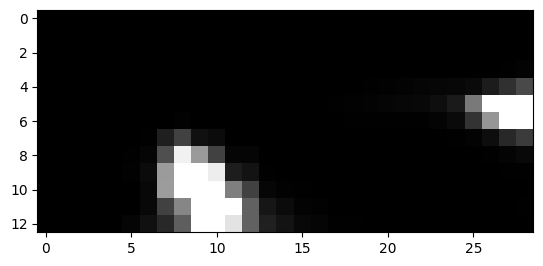

1029


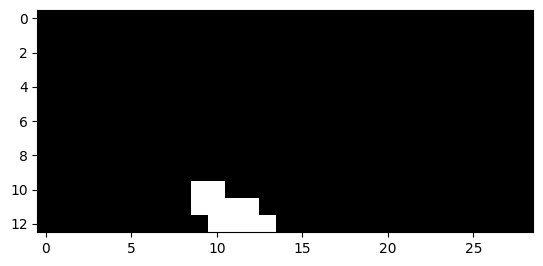

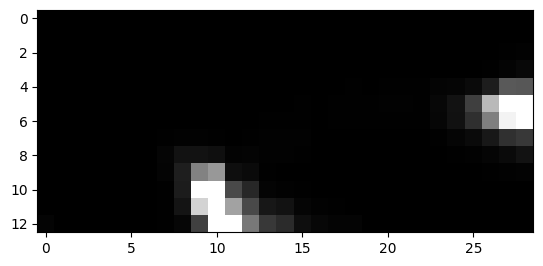

1039


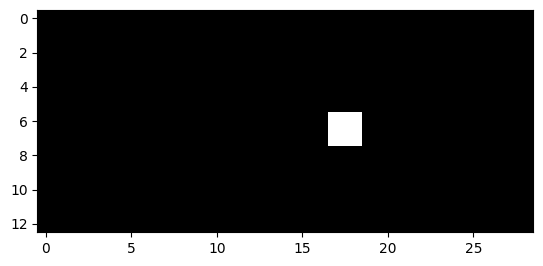

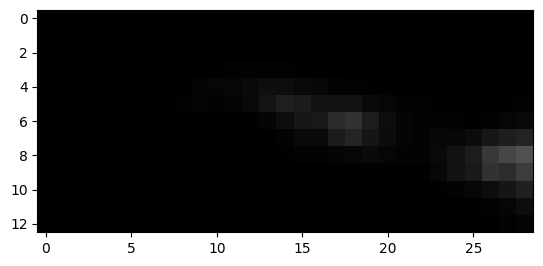

1040


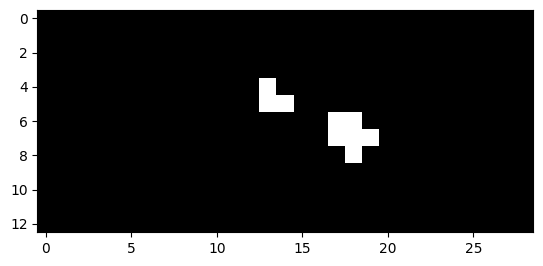

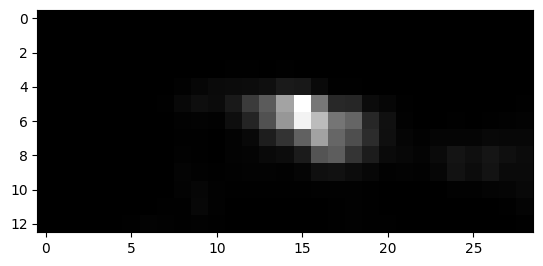

1041


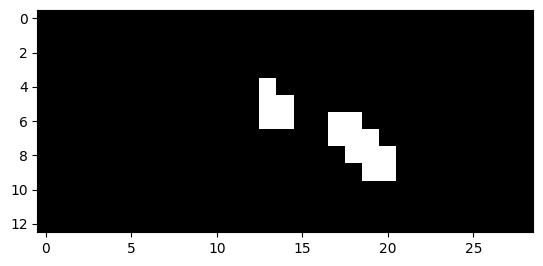

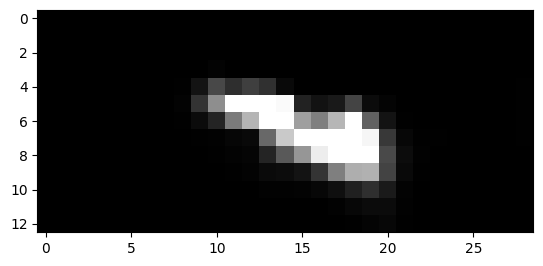

1042


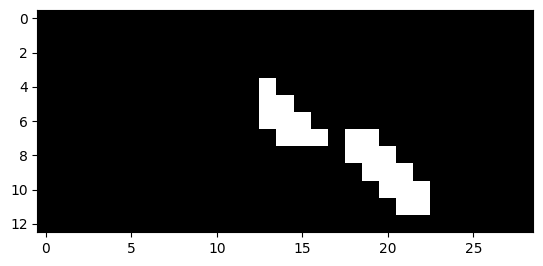

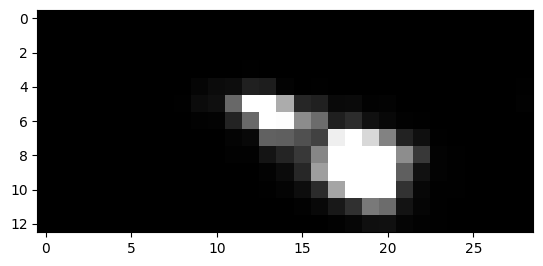

1043


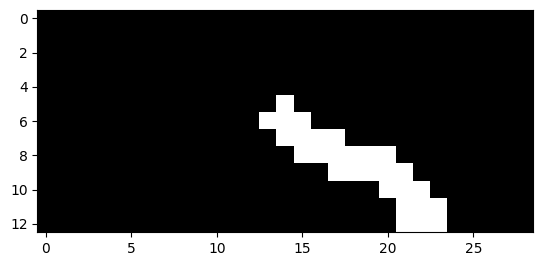

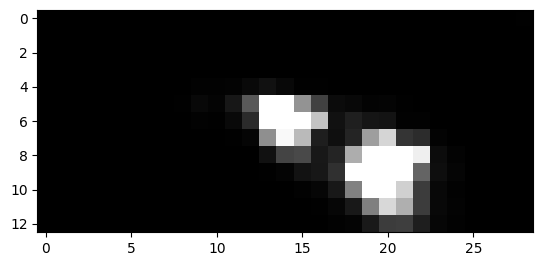

1044


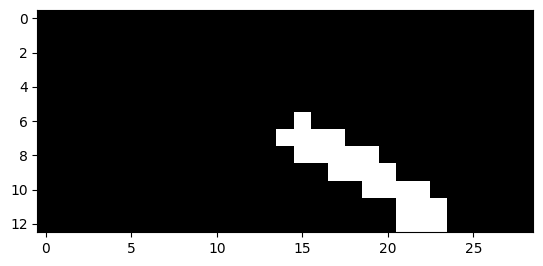

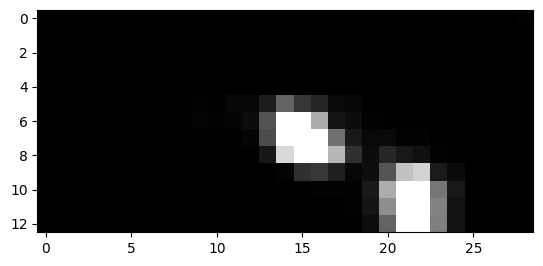

1045


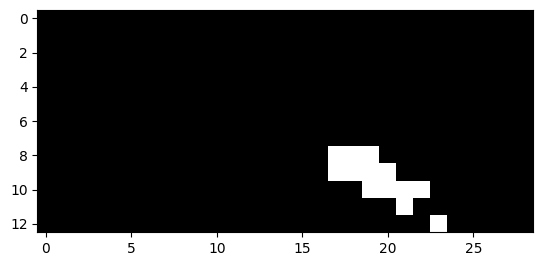

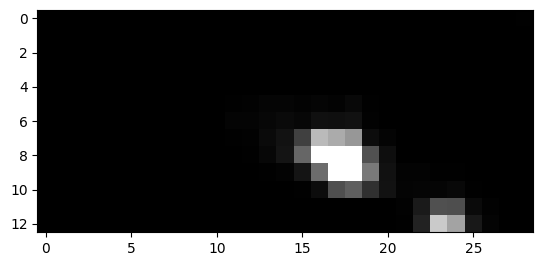

1046


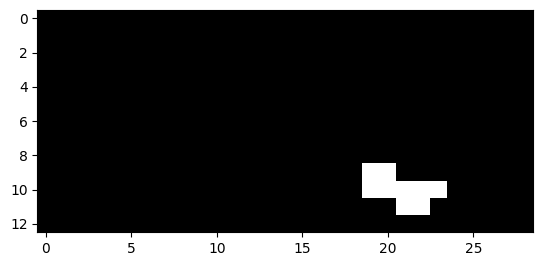

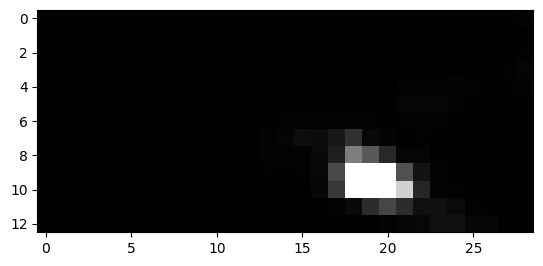

1047


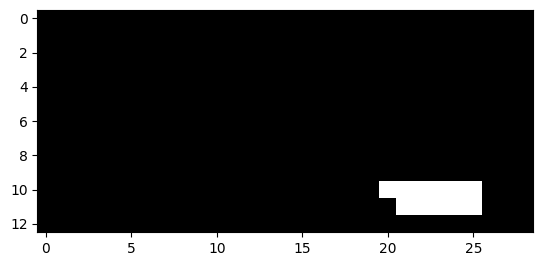

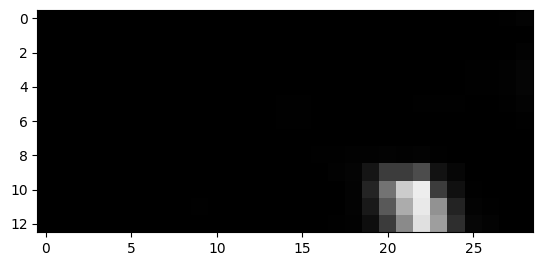

1048


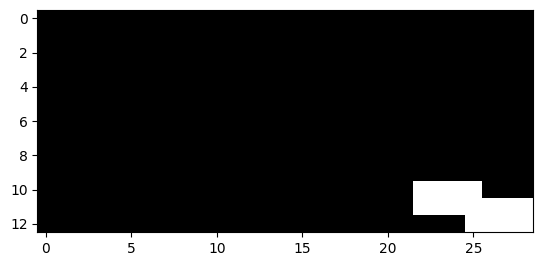

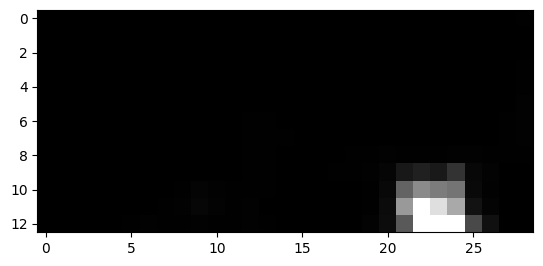

1049


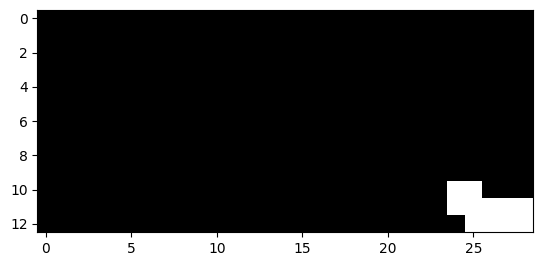

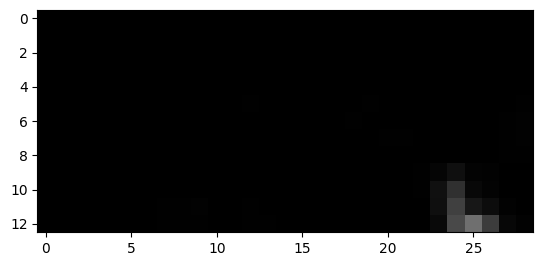

1050


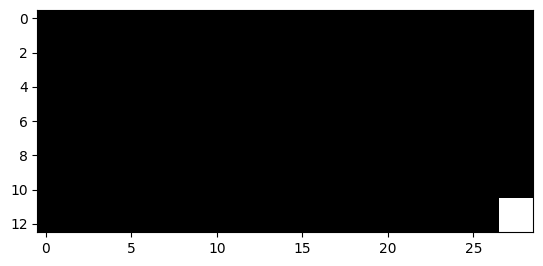

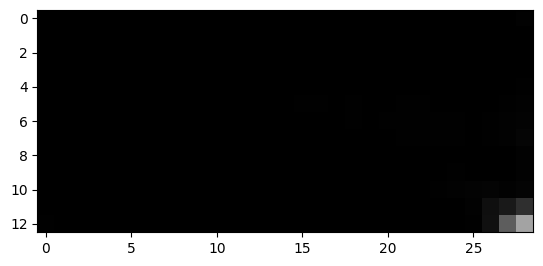

1064


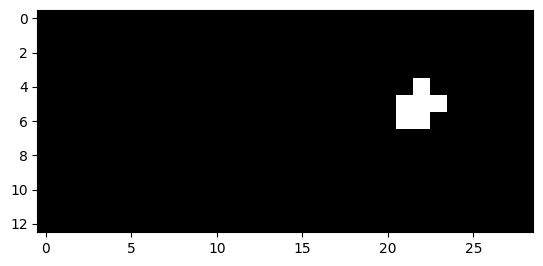

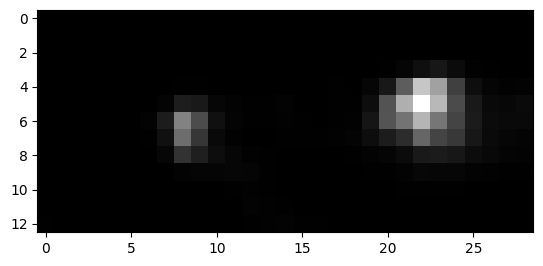

1065


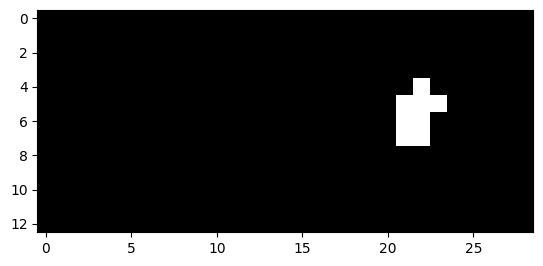

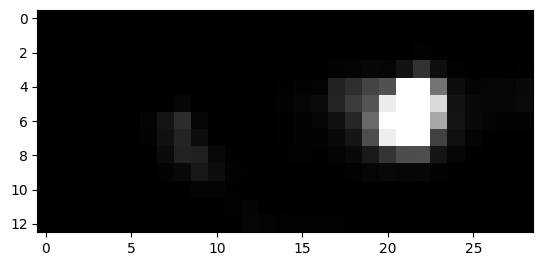

1066


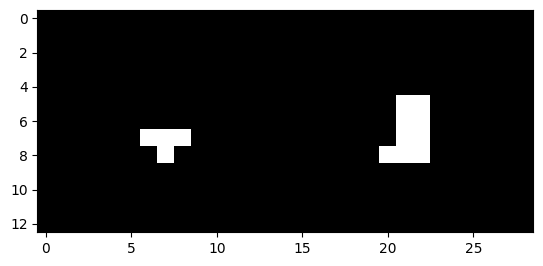

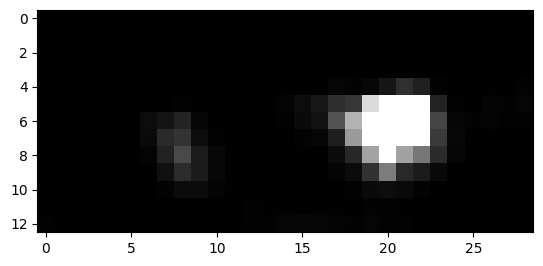

1067


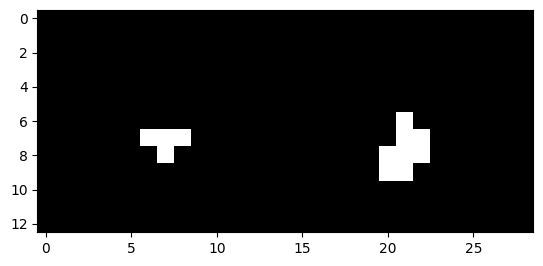

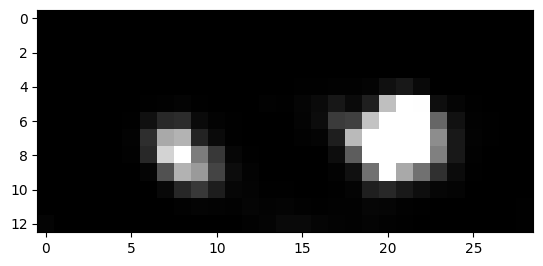

1068


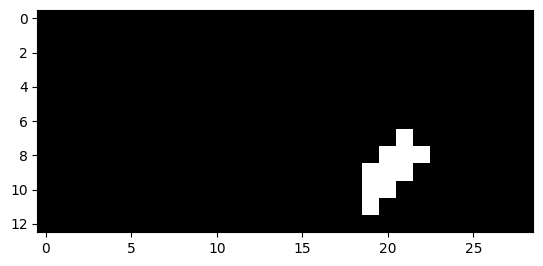

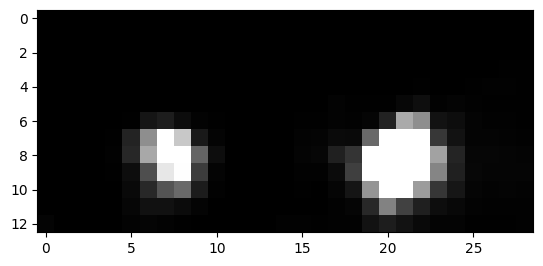

1069


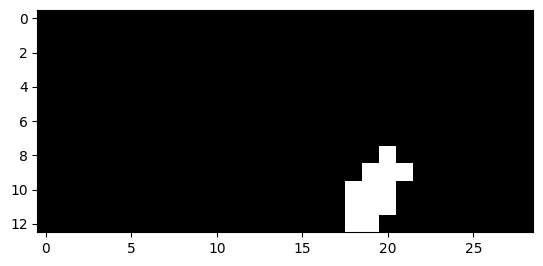

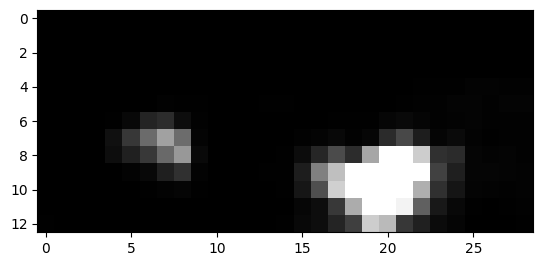

1070


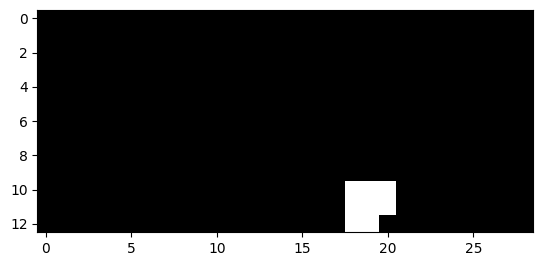

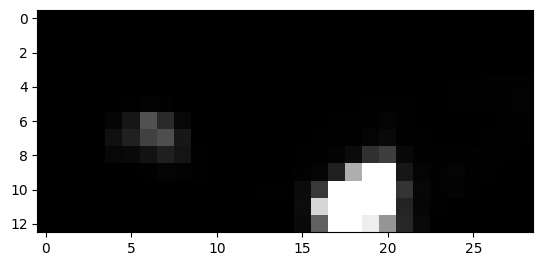

1071


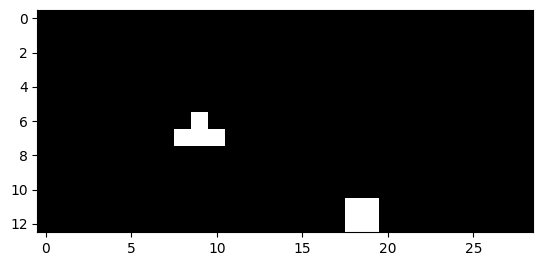

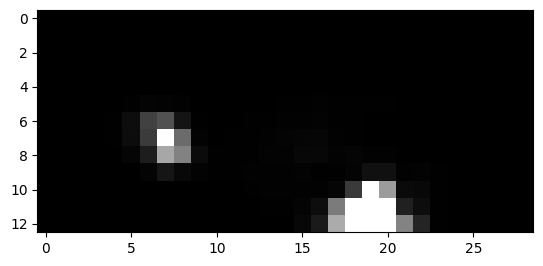

1072


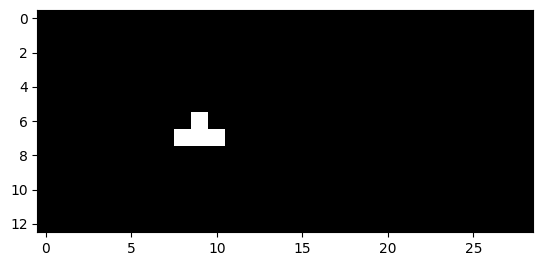

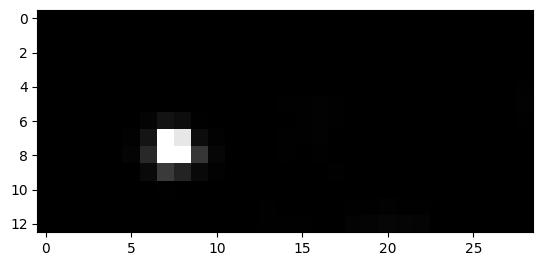

1073


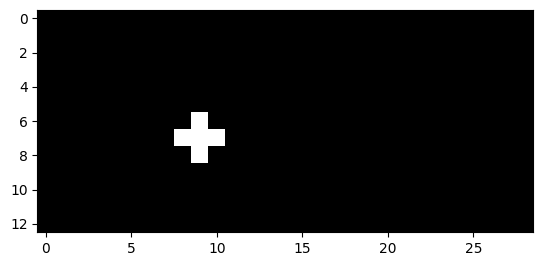

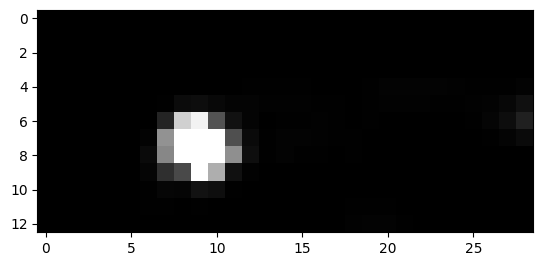

1074


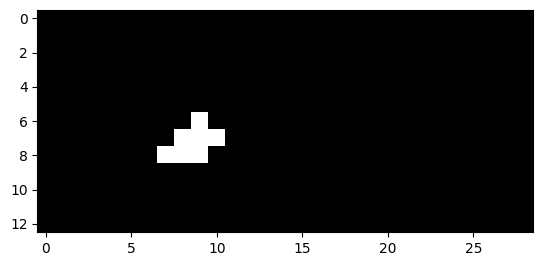

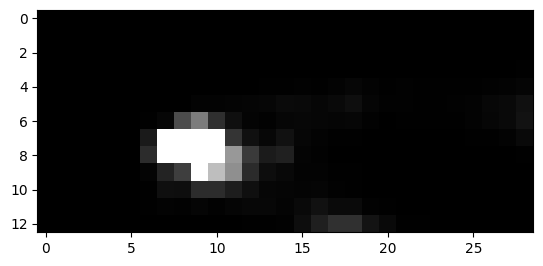

1075


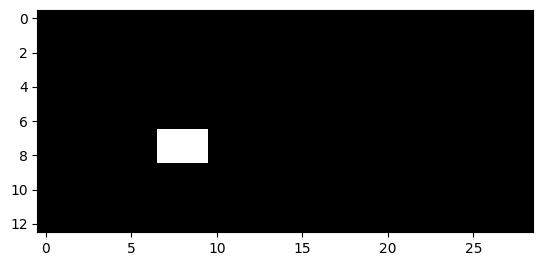

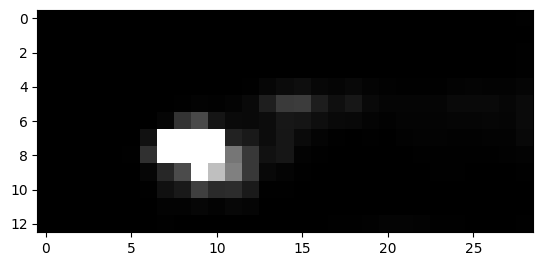

1076


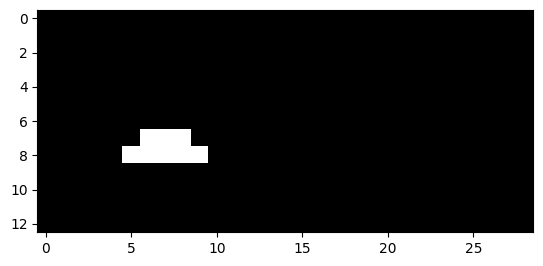

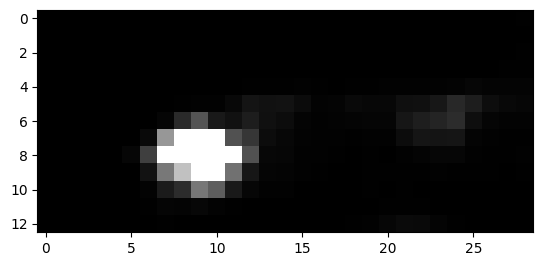

1077


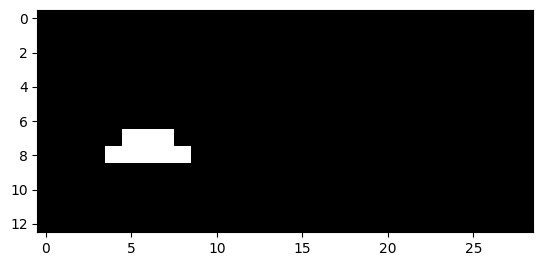

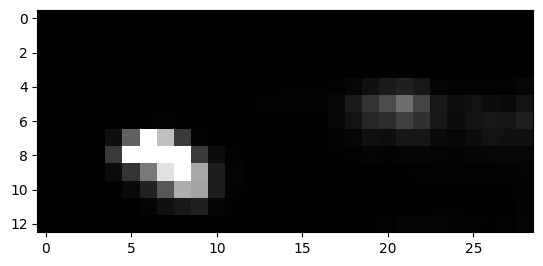

1078


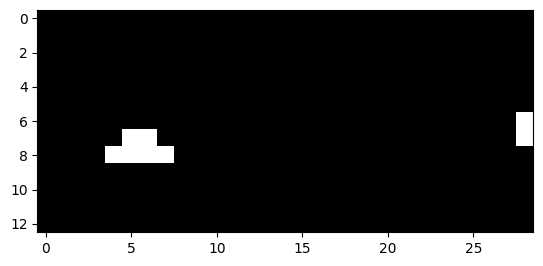

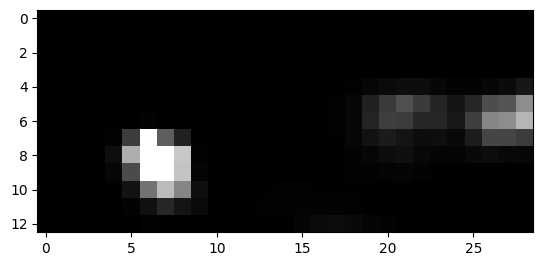

1079


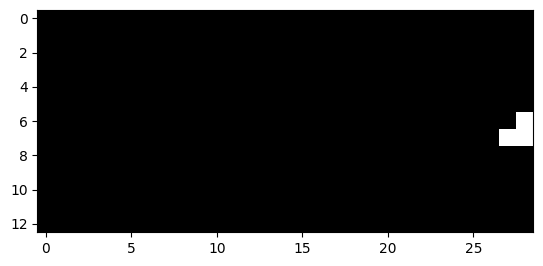

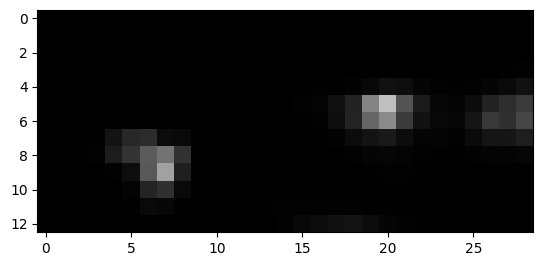

1080


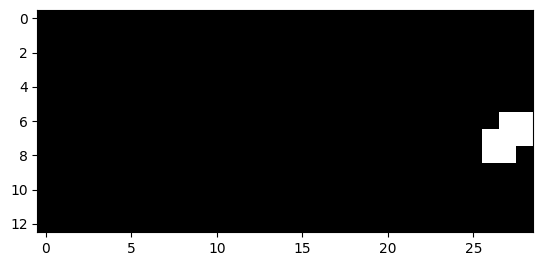

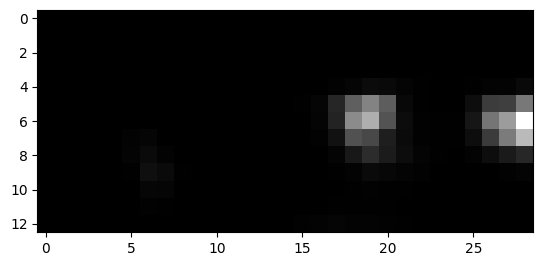

1081


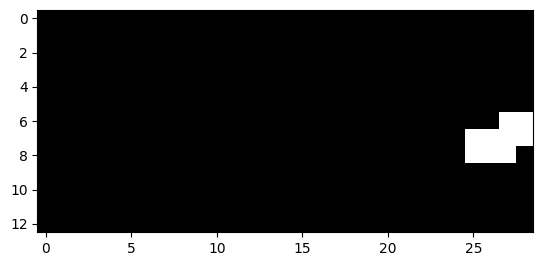

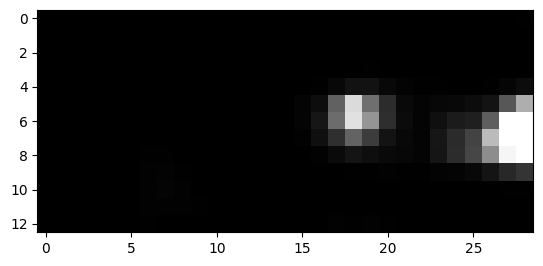

1082


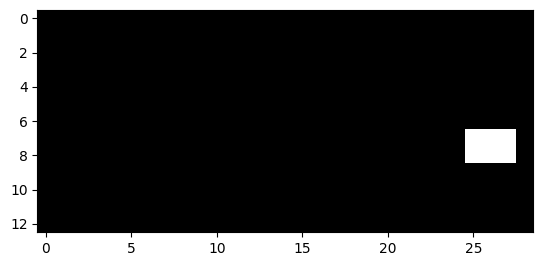

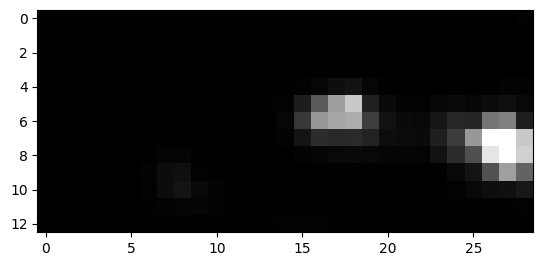

1083


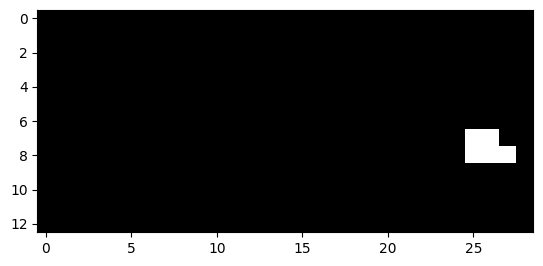

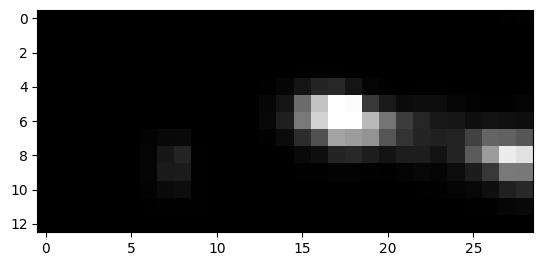

1084


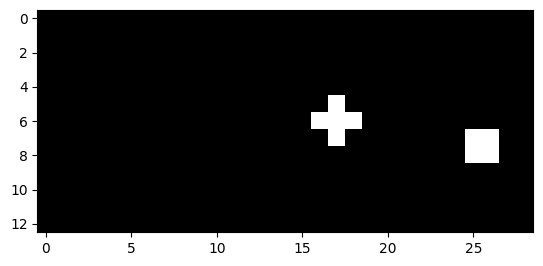

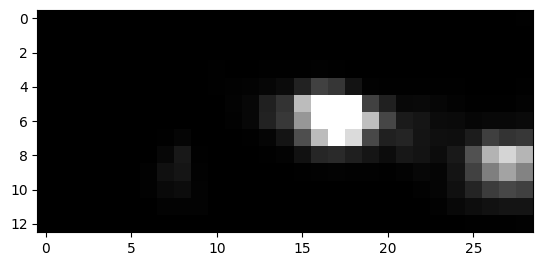

1085


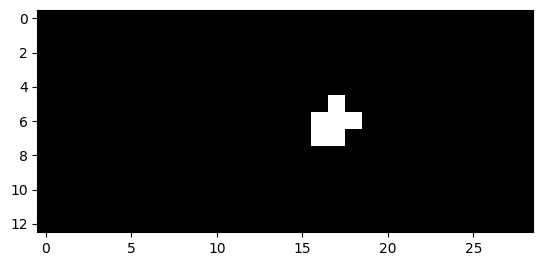

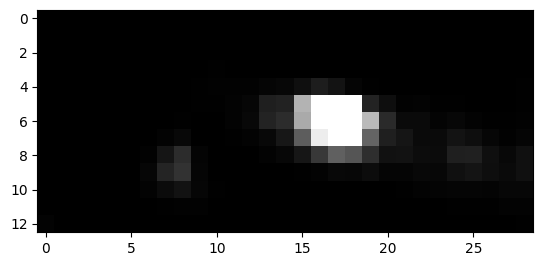

1086


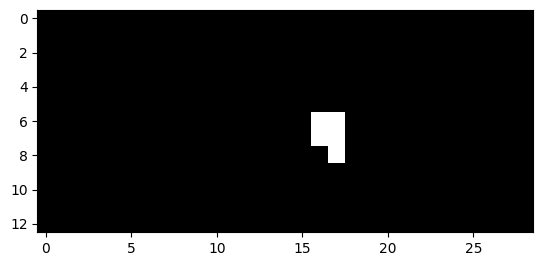

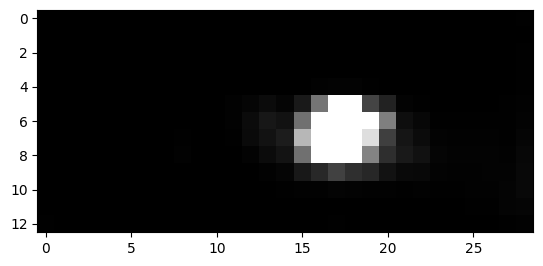

1087


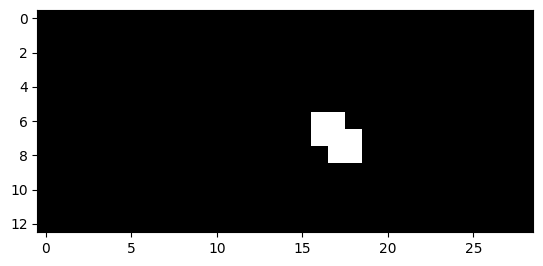

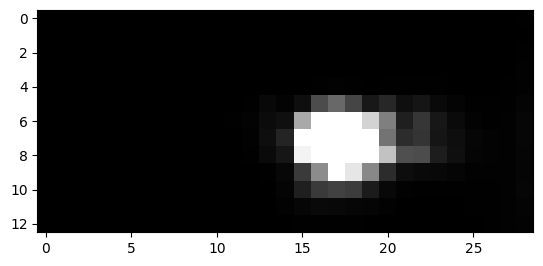

1088


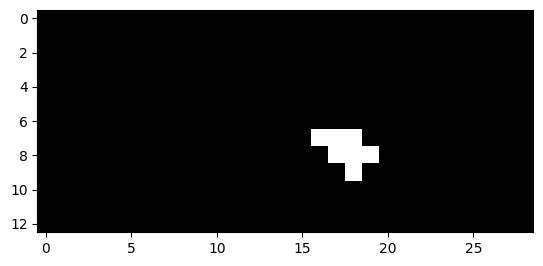

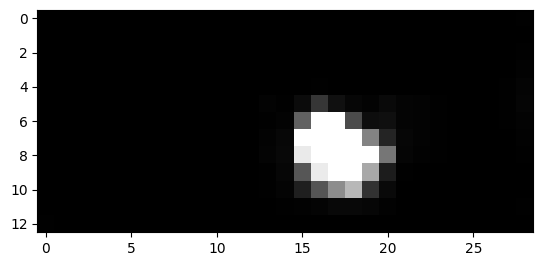

1089


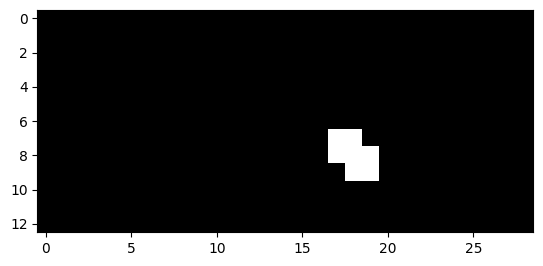

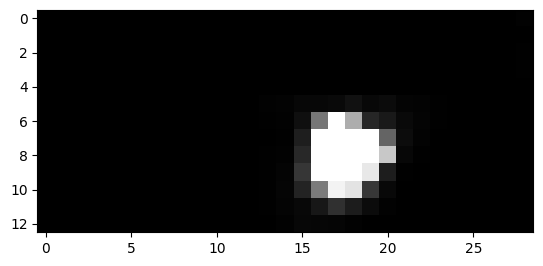

1090


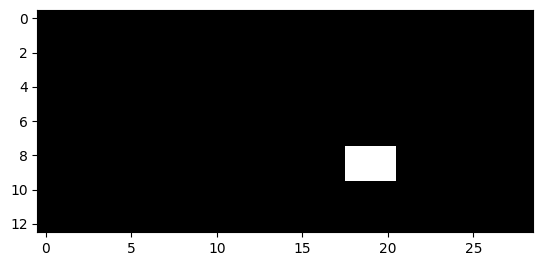

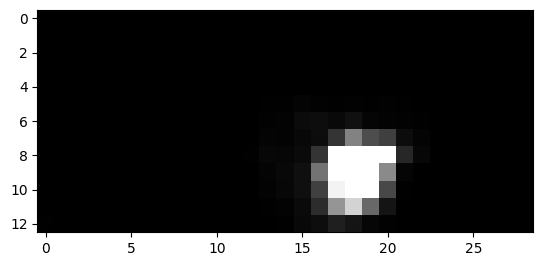

1091


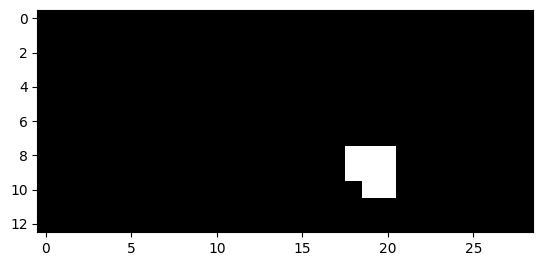

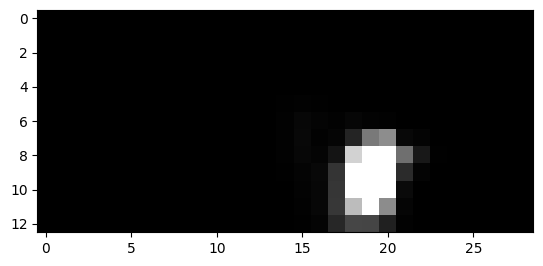

1092


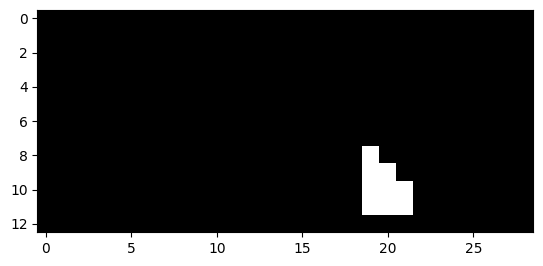

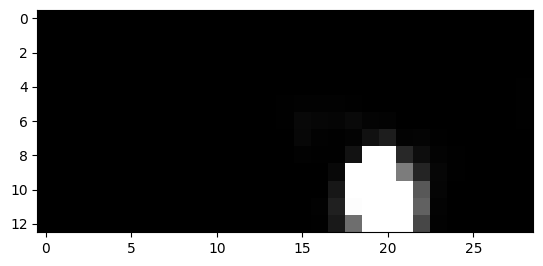

1093


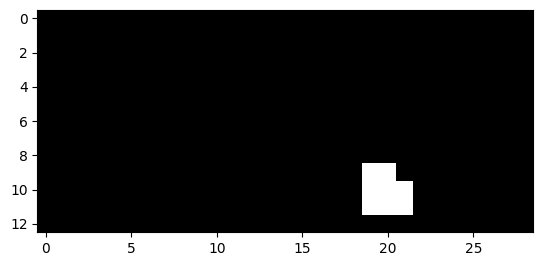

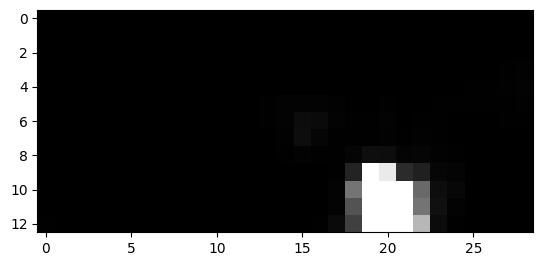

1094


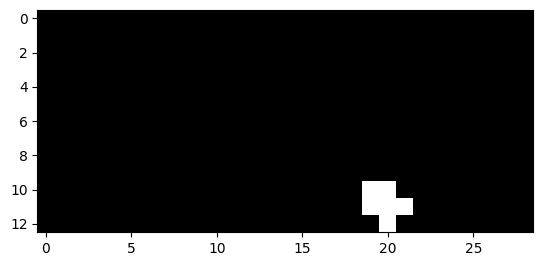

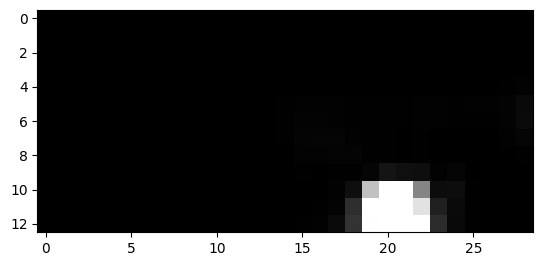

1095


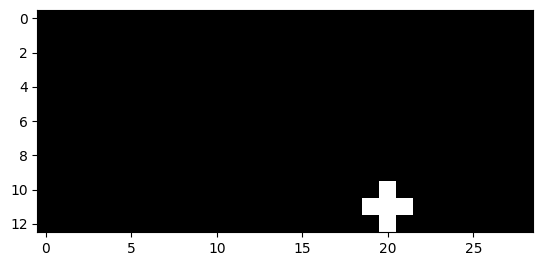

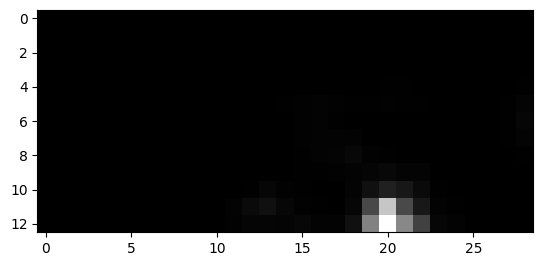

1116


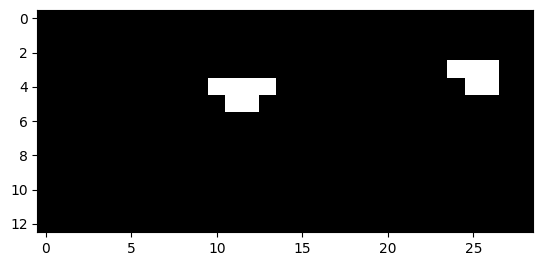

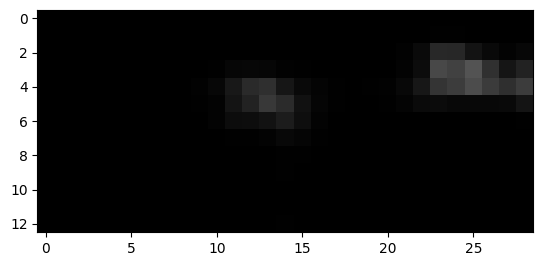

1117


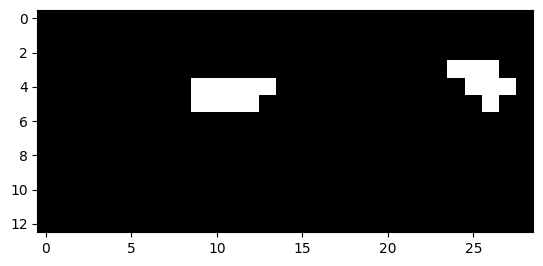

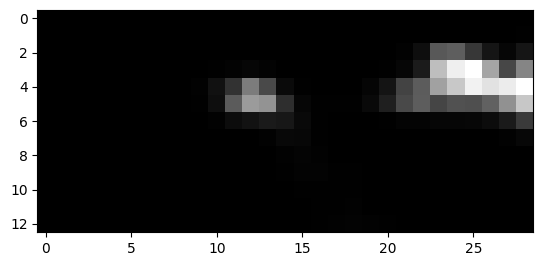

1118


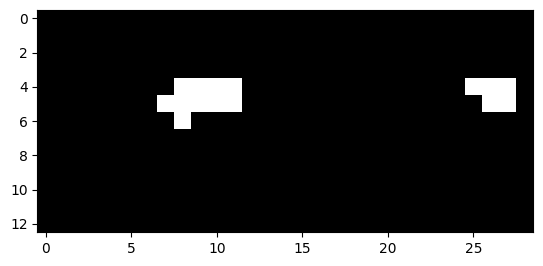

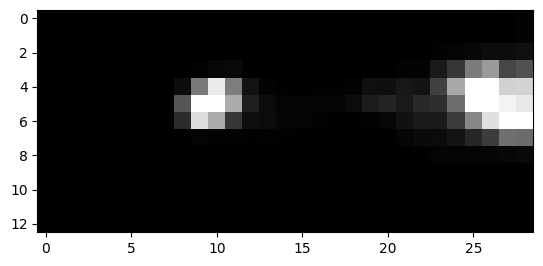

1119


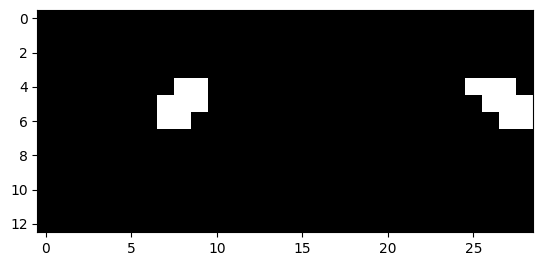

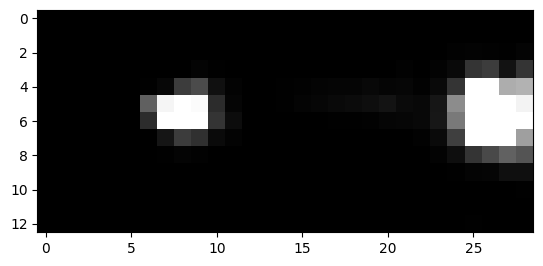

1120


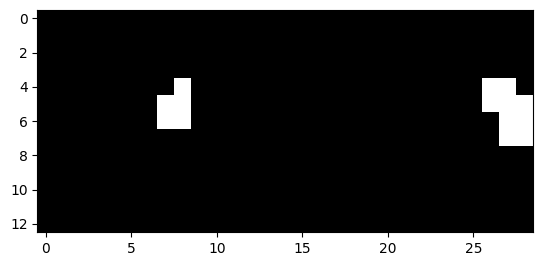

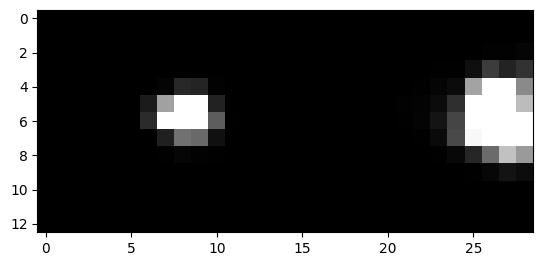

1121


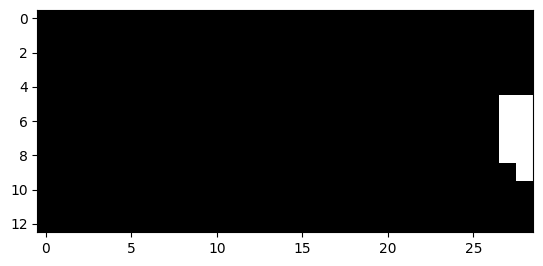

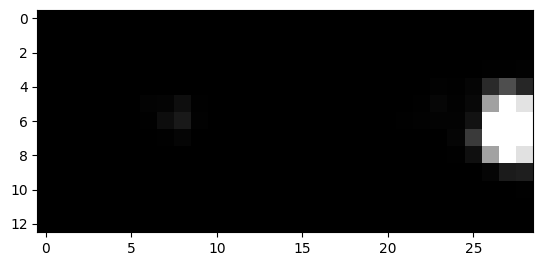

1122


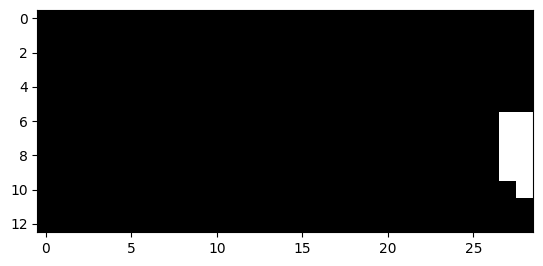

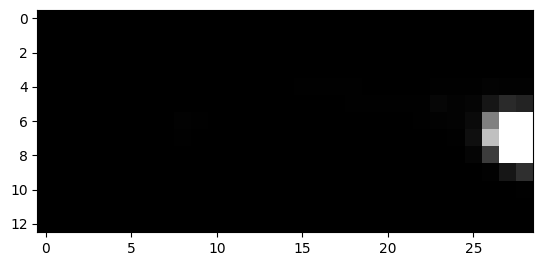

1123


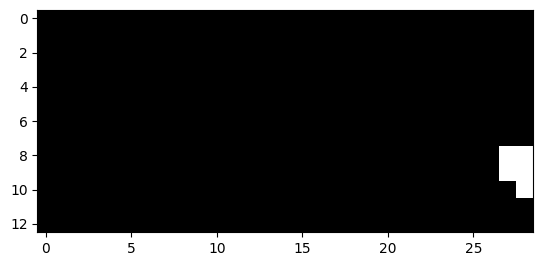

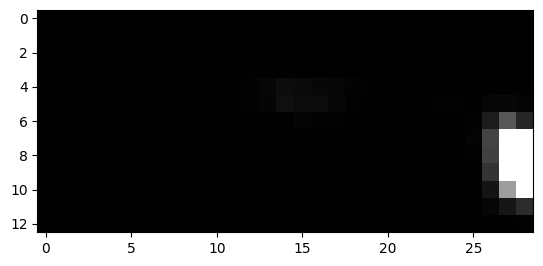

1341


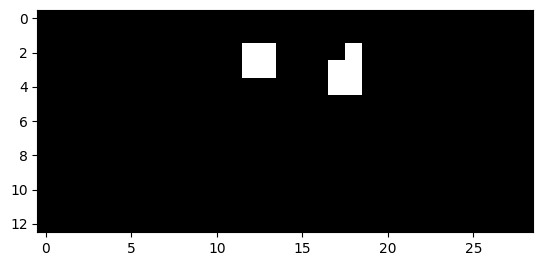

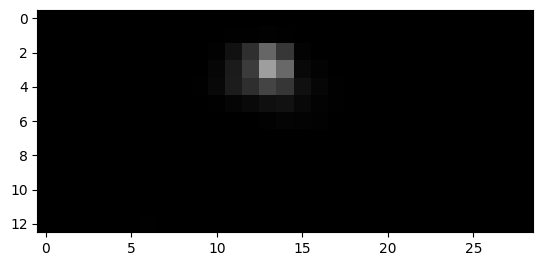

1342


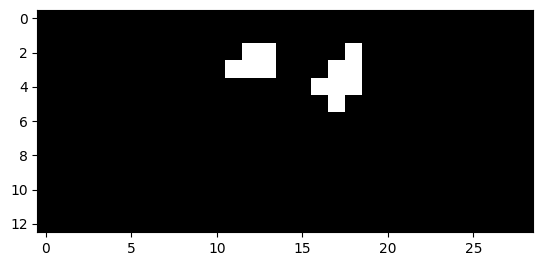

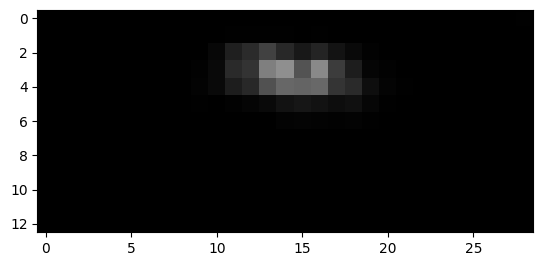

1343


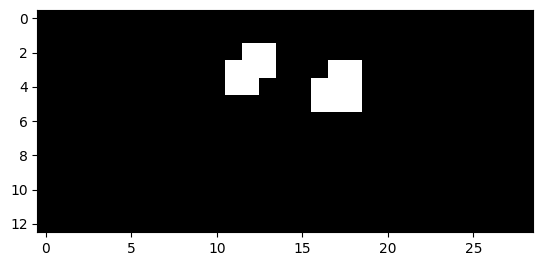

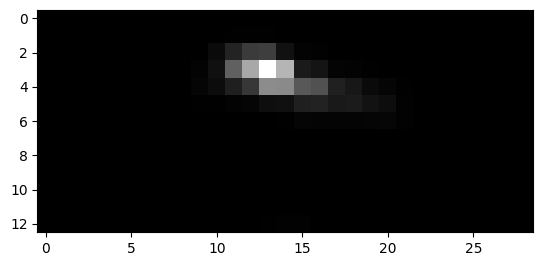

1344


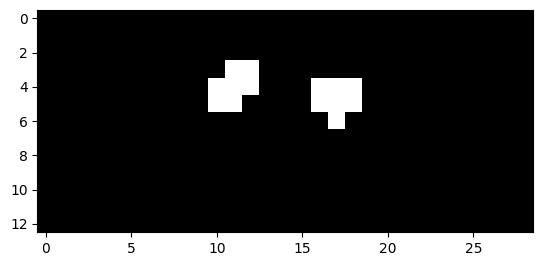

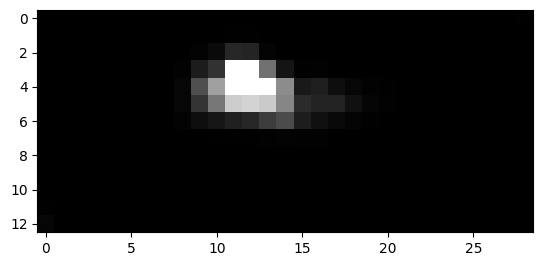

1345


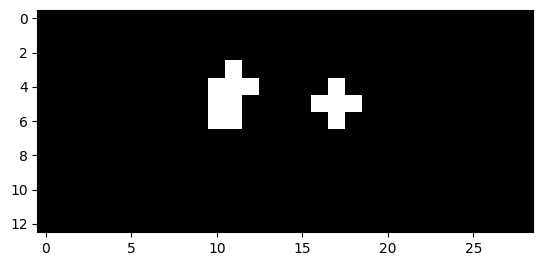

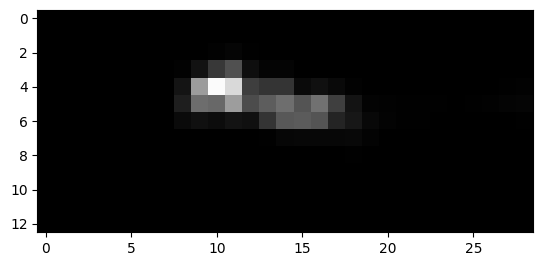

1346


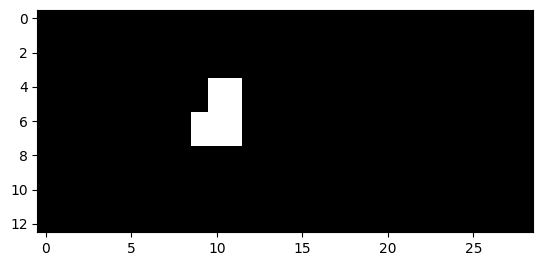

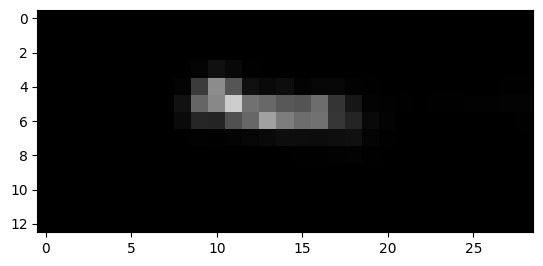

1347


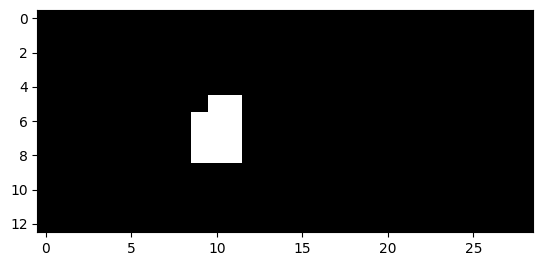

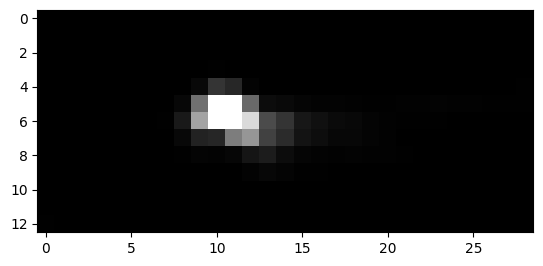

1348


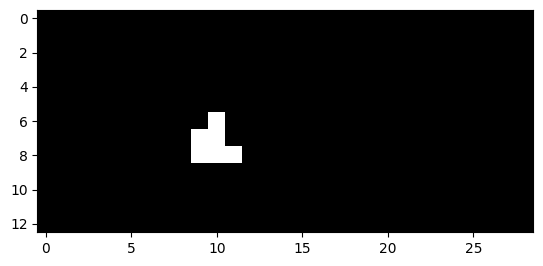

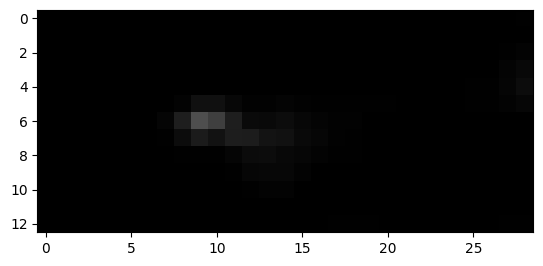

1366


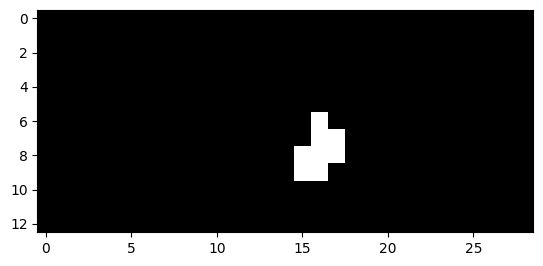

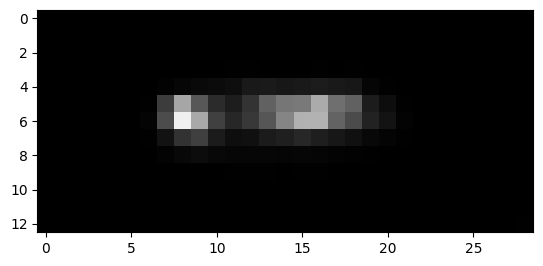

1367


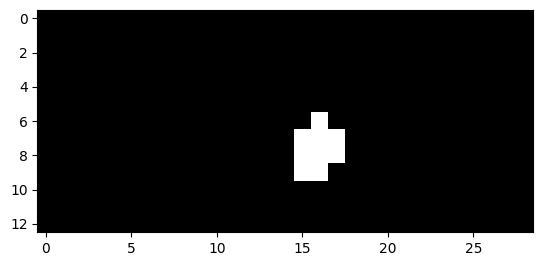

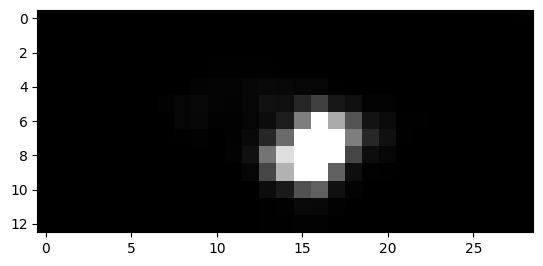

1368


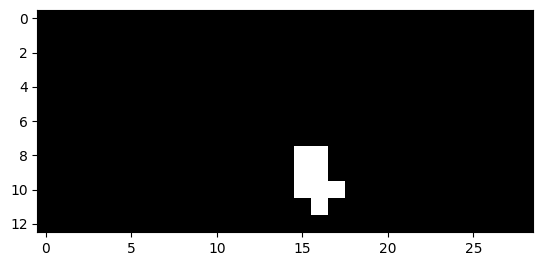

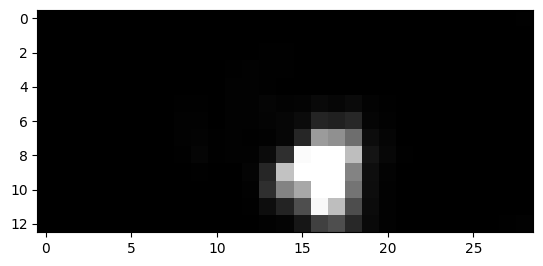

1369


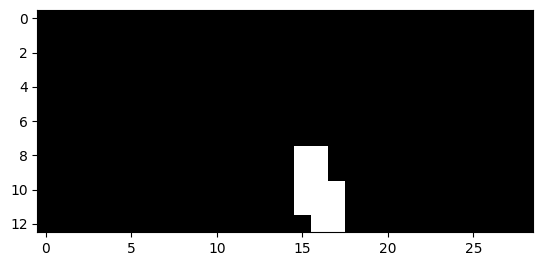

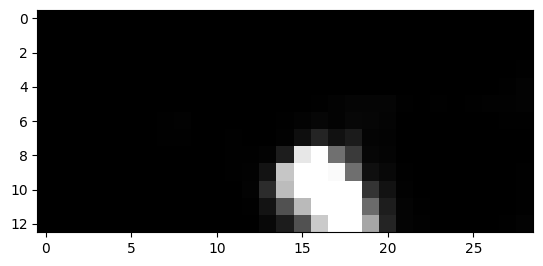

1370


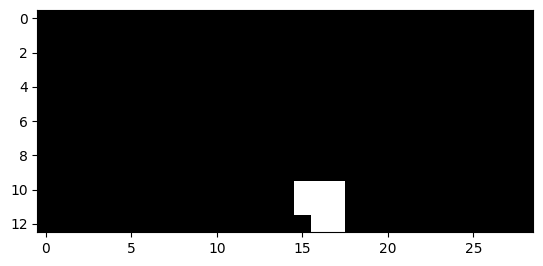

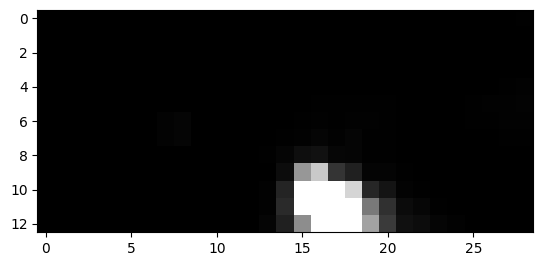

1371


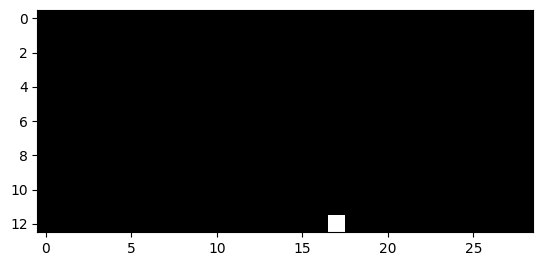

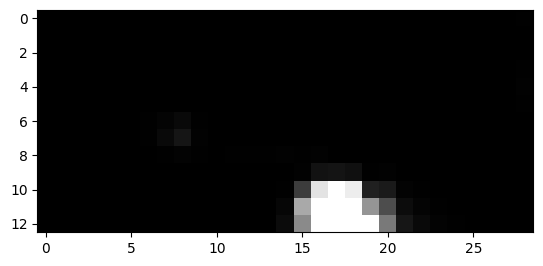

1389


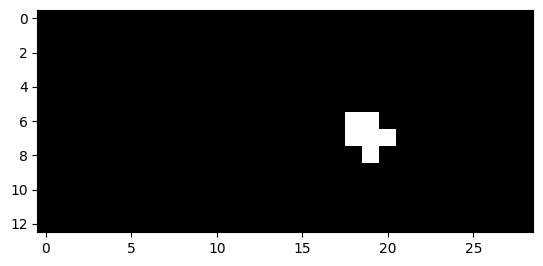

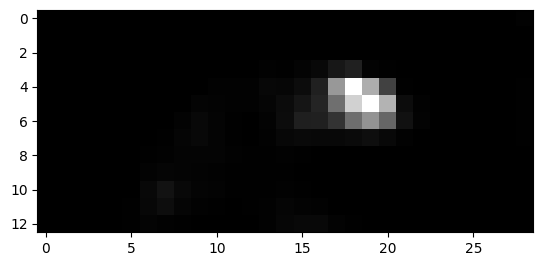

1390


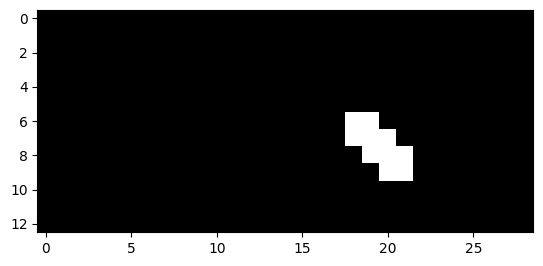

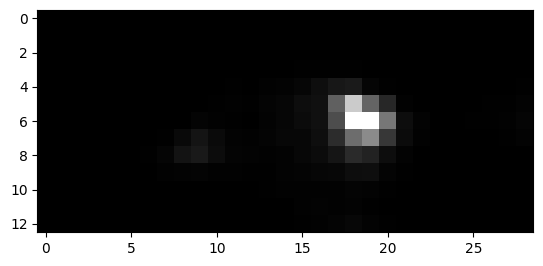

1391


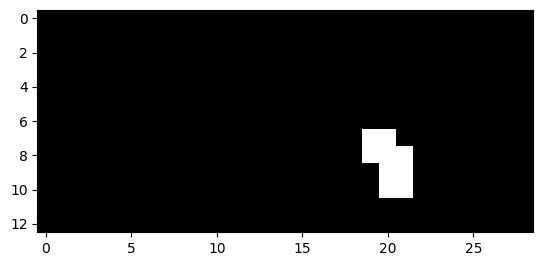

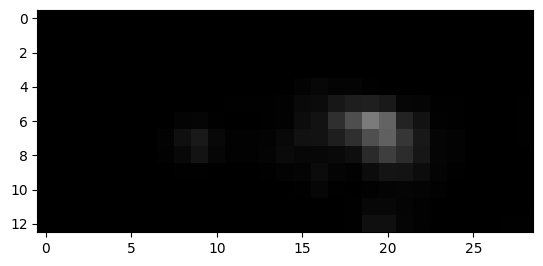

1392


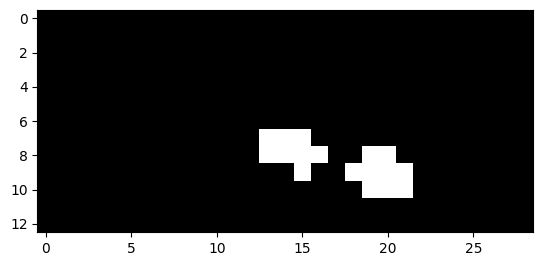

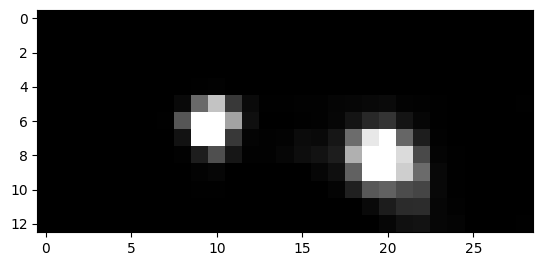

1393


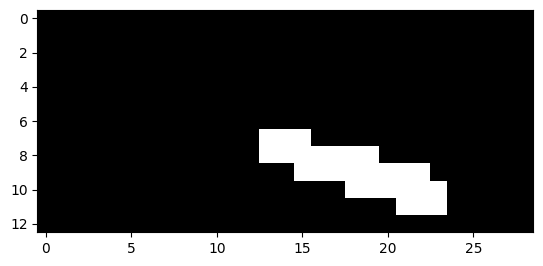

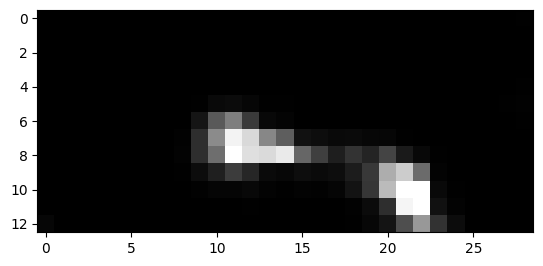

1394


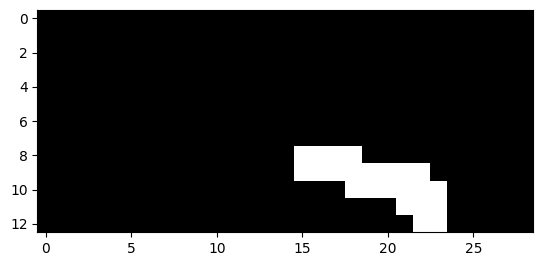

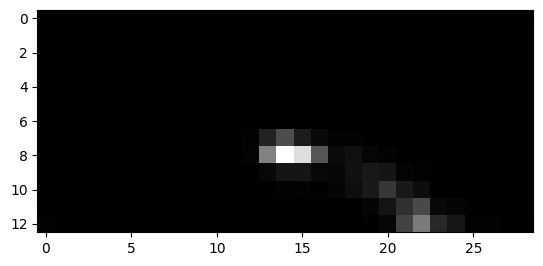

1395


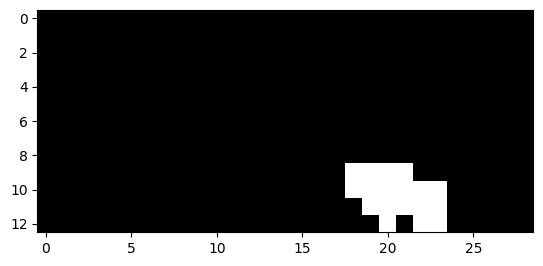

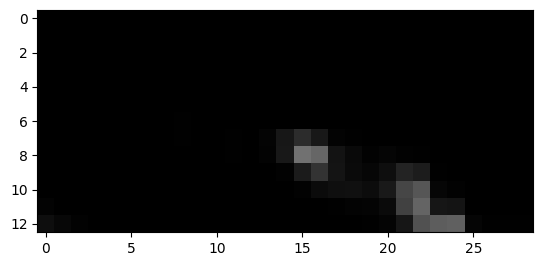

1396


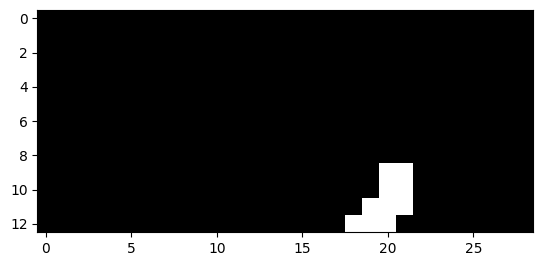

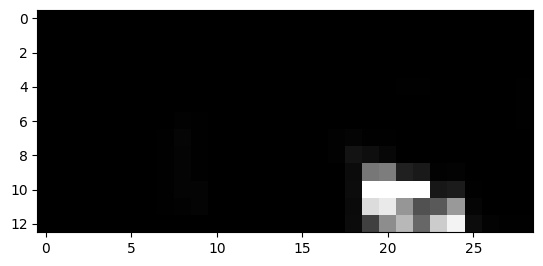

1397


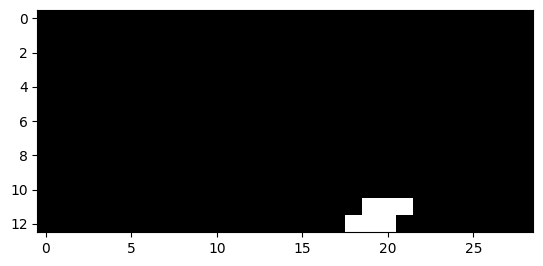

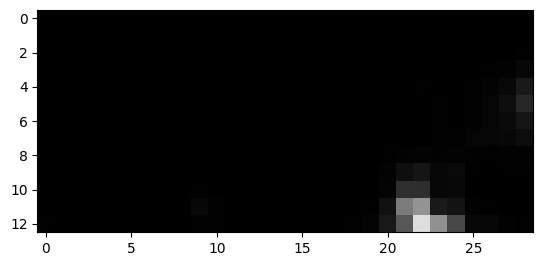

1398


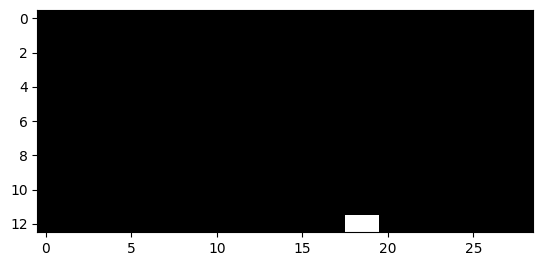

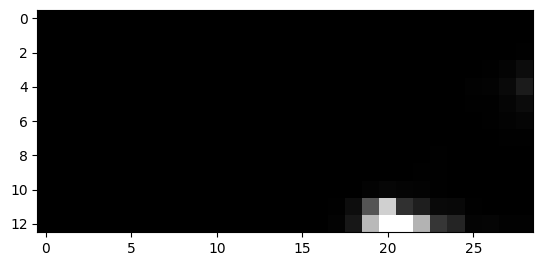

1403


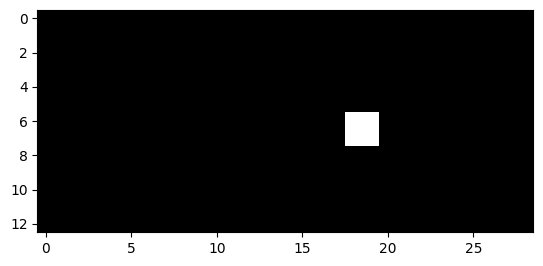

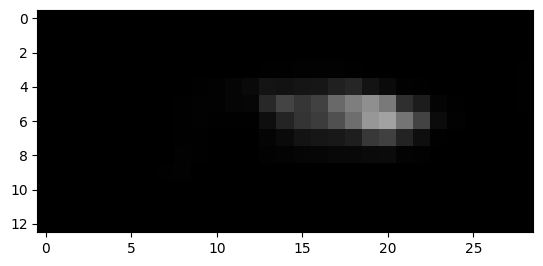

1404


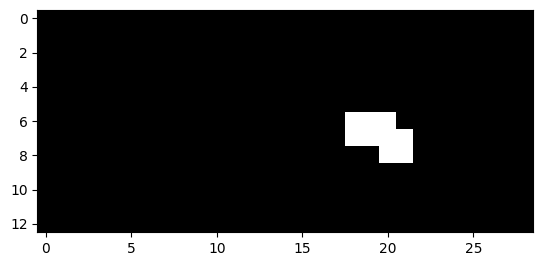

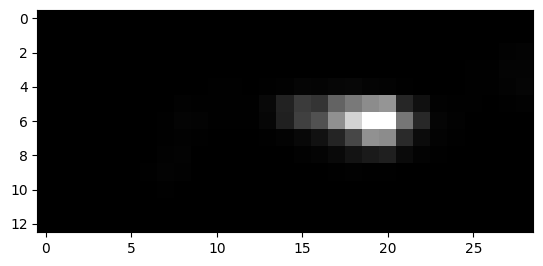

1405


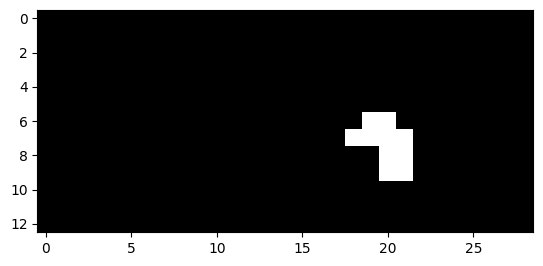

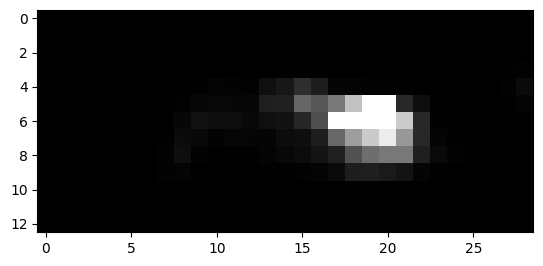

1406


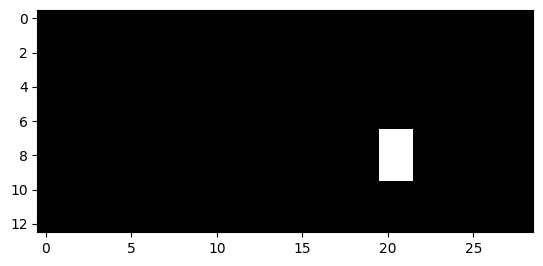

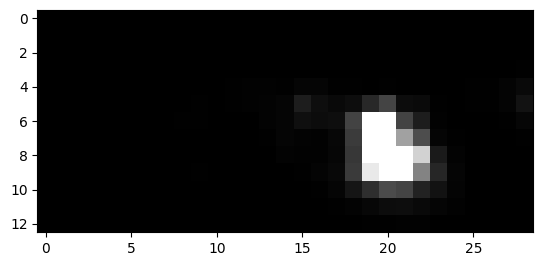

1407


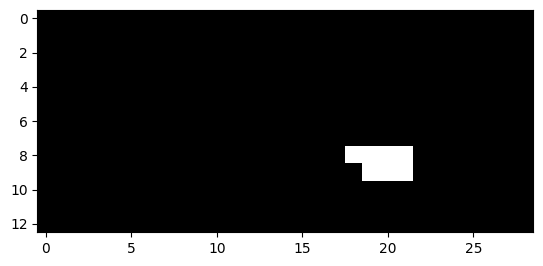

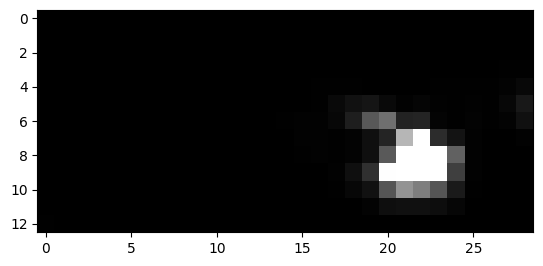

1408


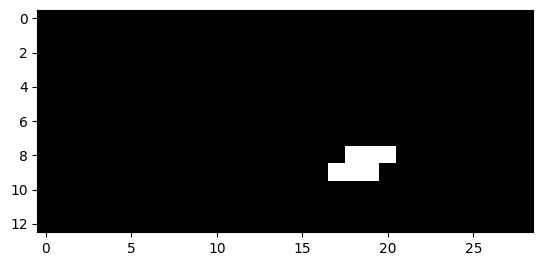

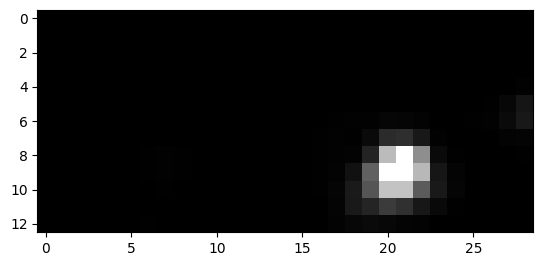

1409


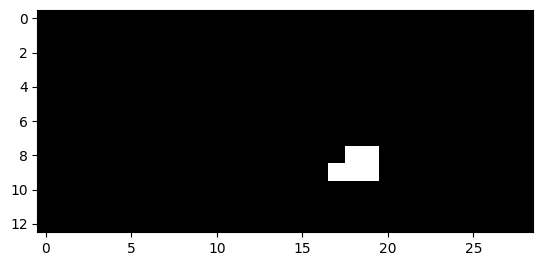

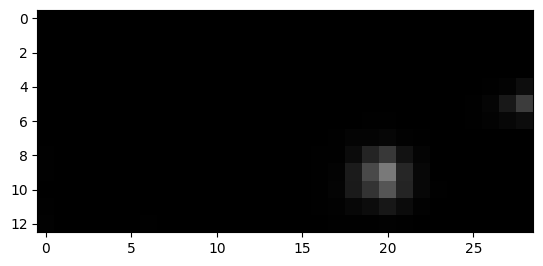

1412


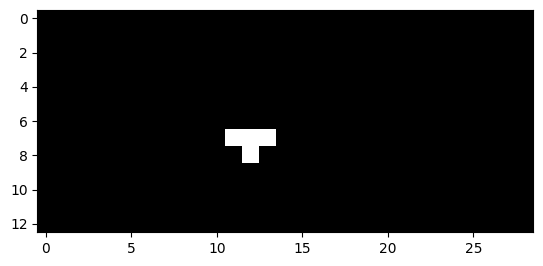

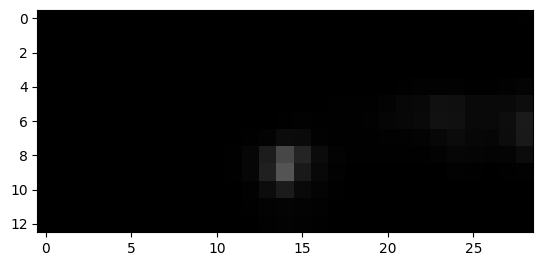

1413


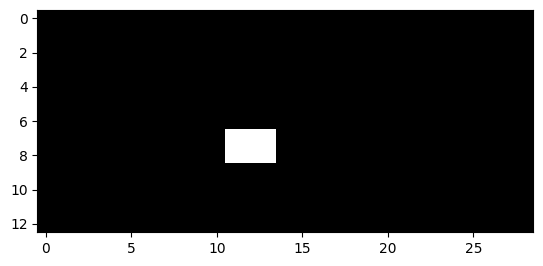

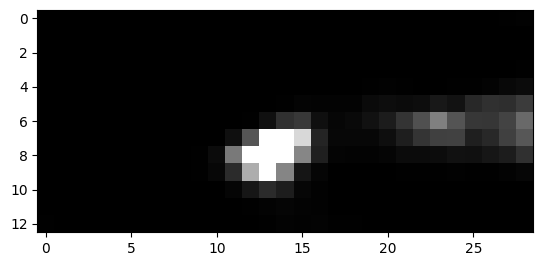

1414


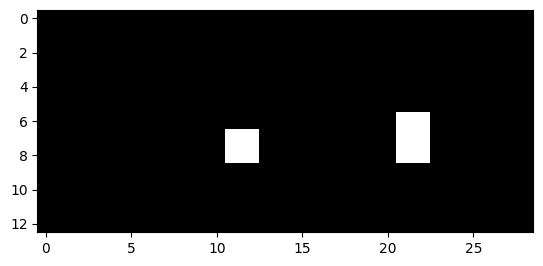

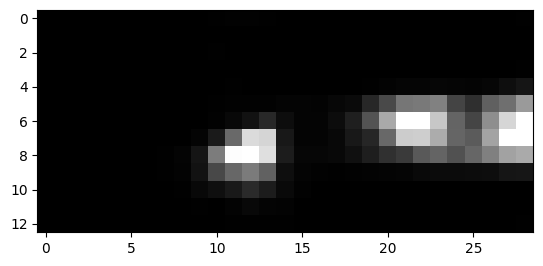

1415


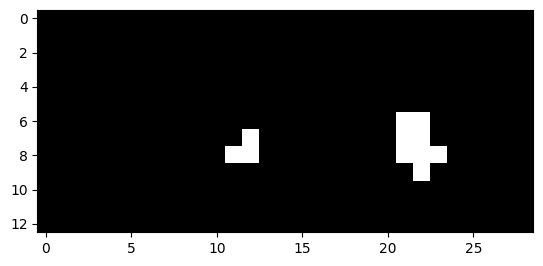

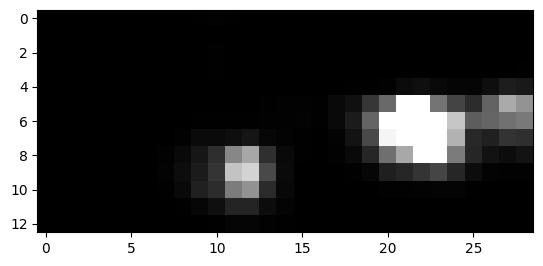

1416


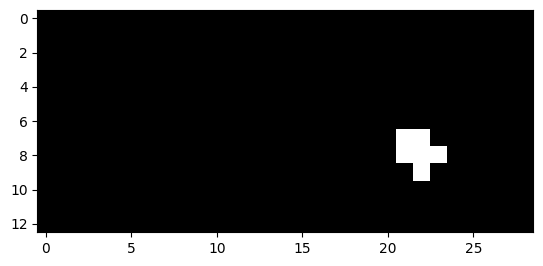

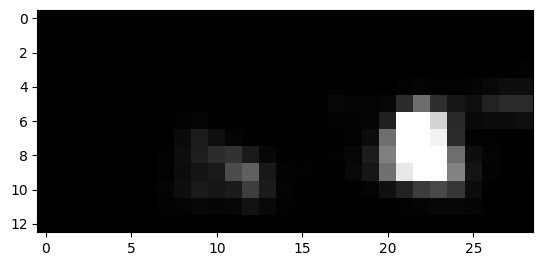

1417


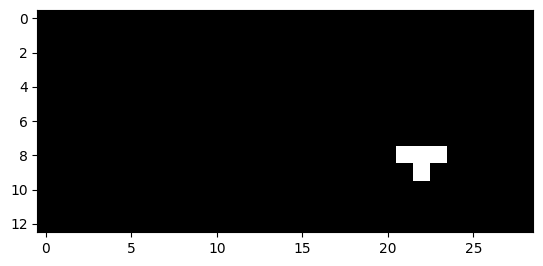

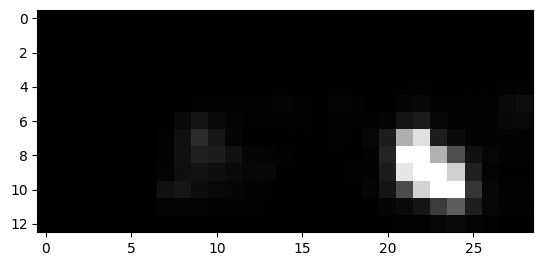

1419


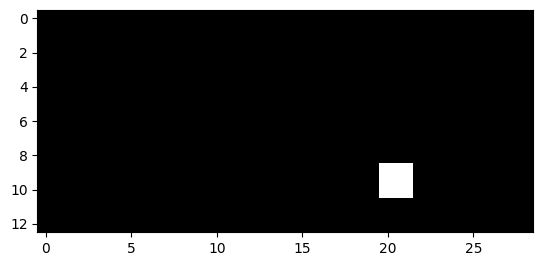

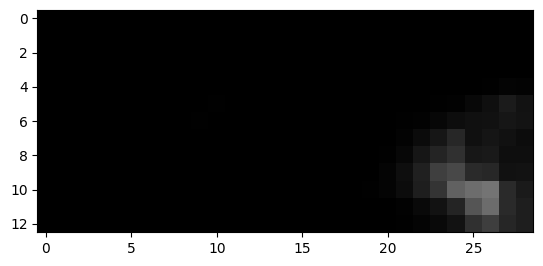

1420


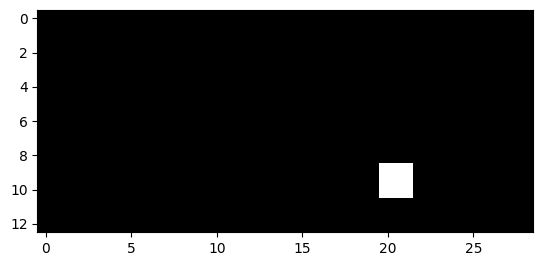

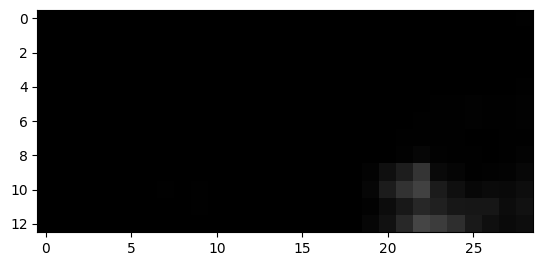

1441


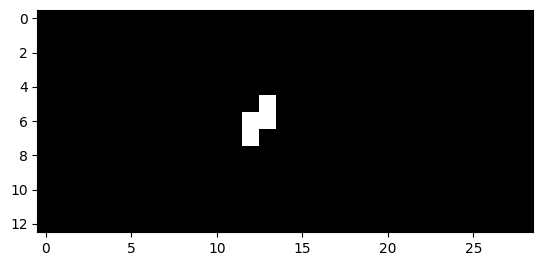

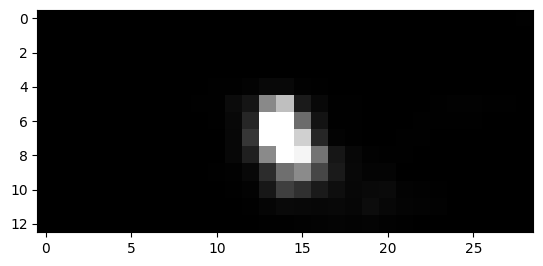

1442


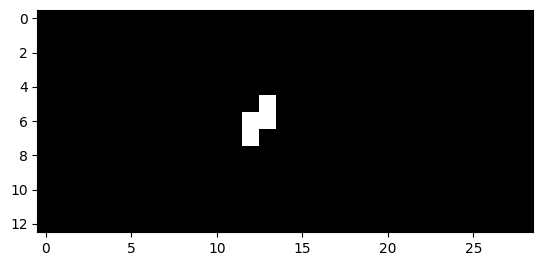

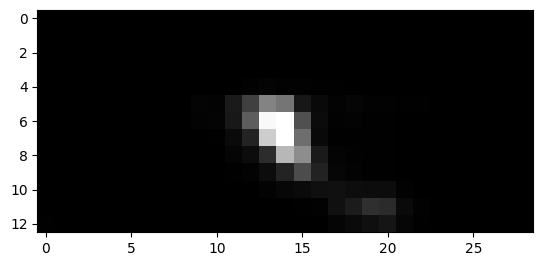

1443


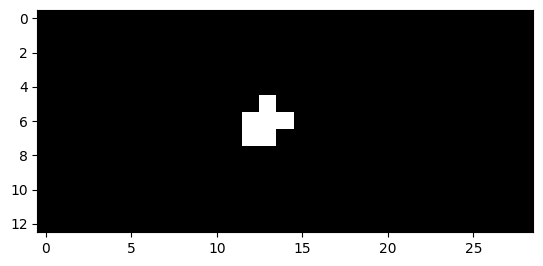

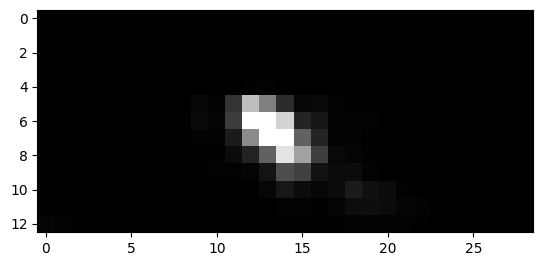

1444


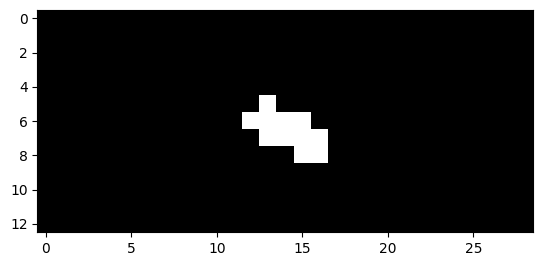

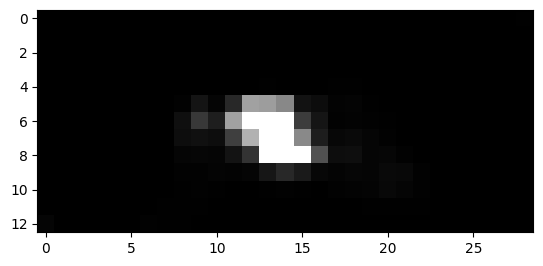

1445


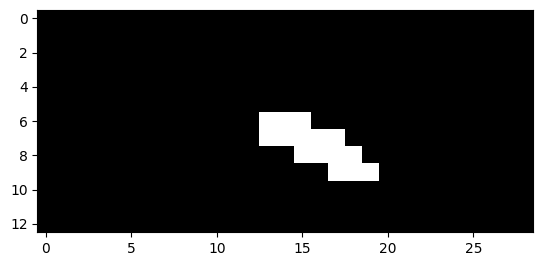

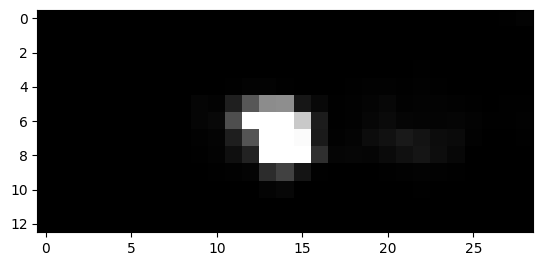

1446


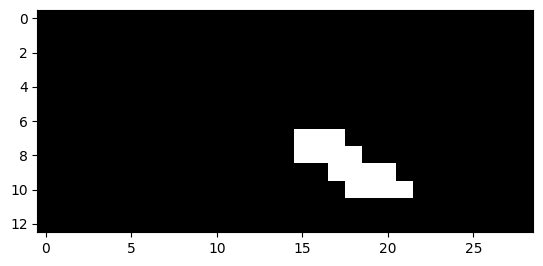

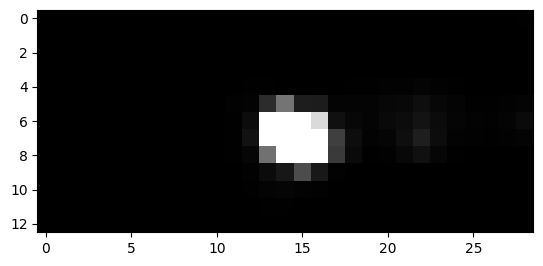

1447


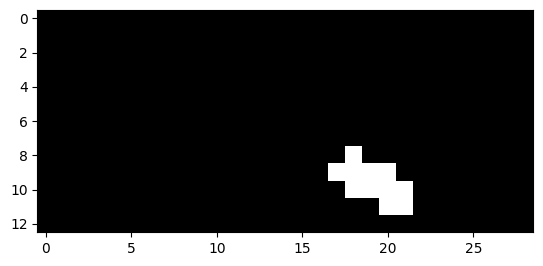

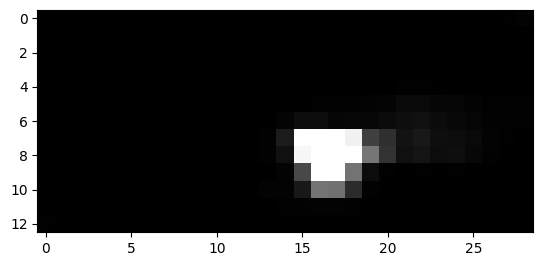

1448


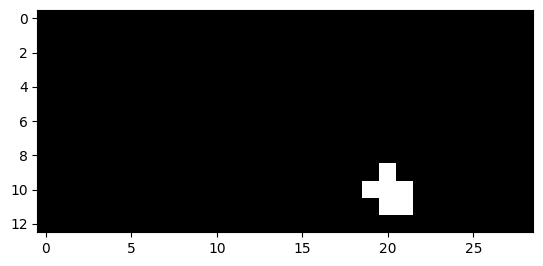

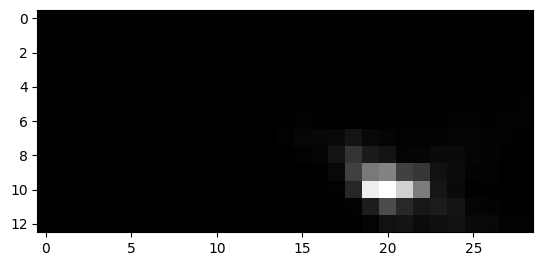

1460


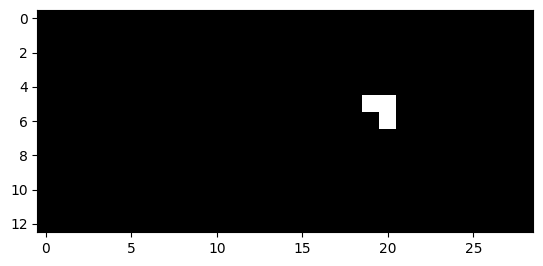

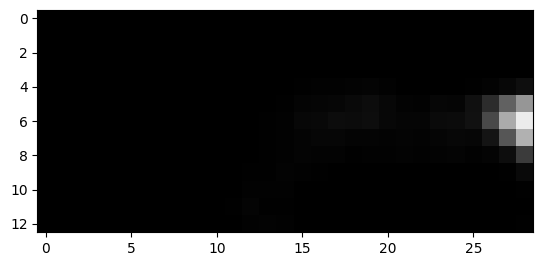

1461


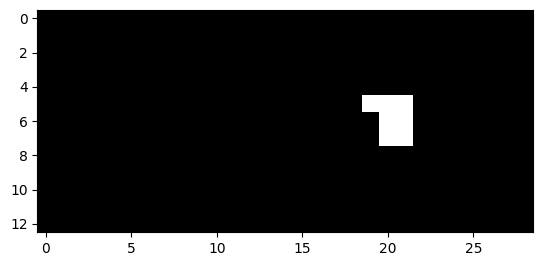

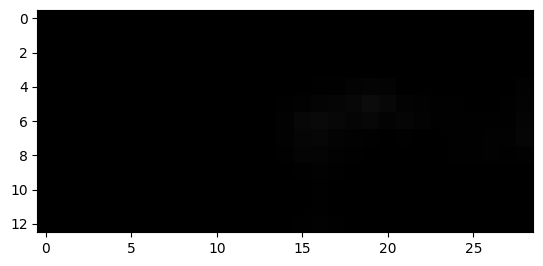

1462


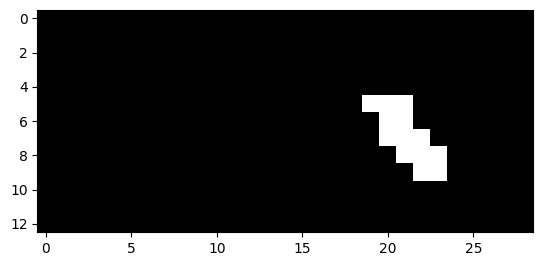

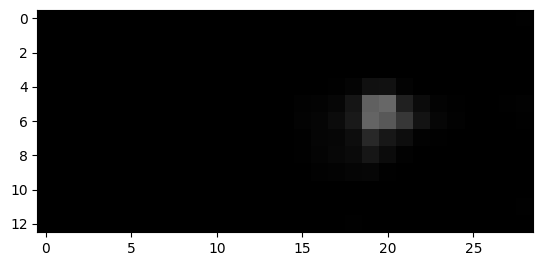

1463


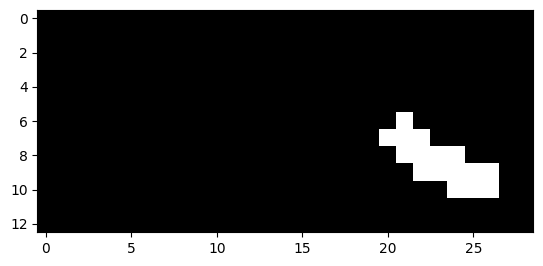

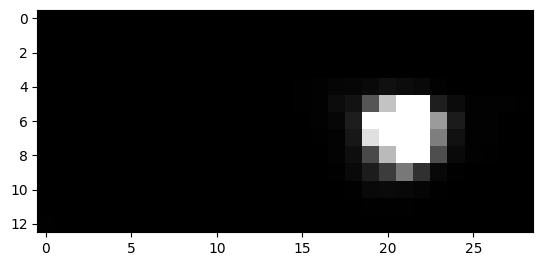

1464


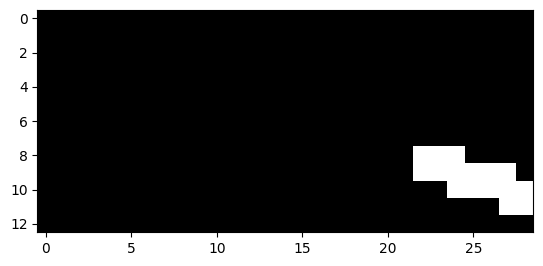

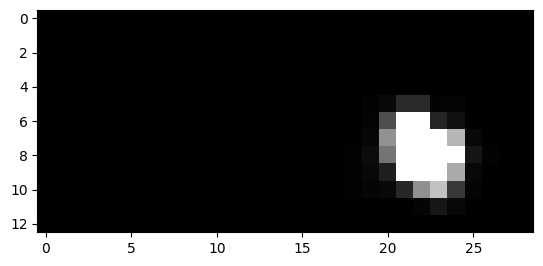

1465


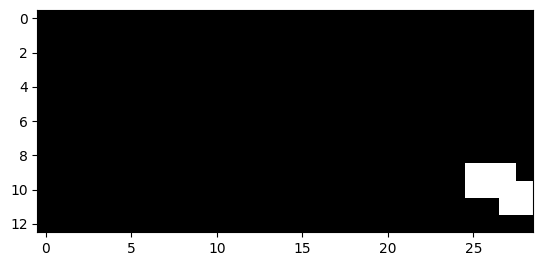

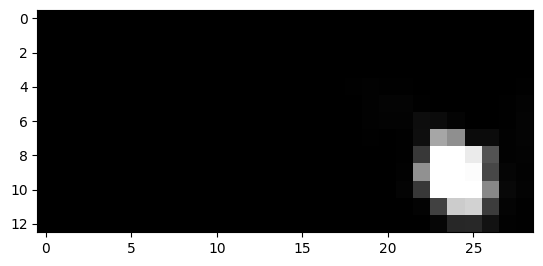

1466


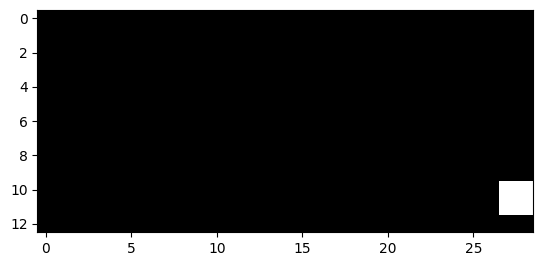

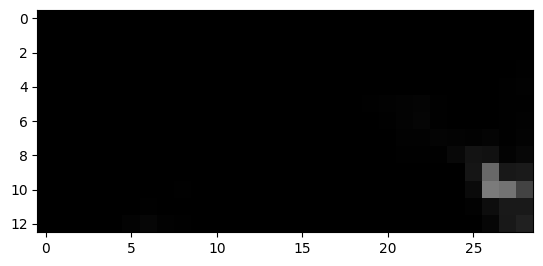

1473


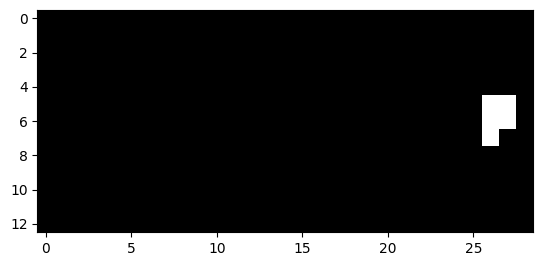

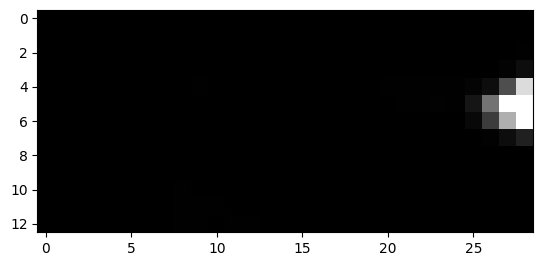

1474


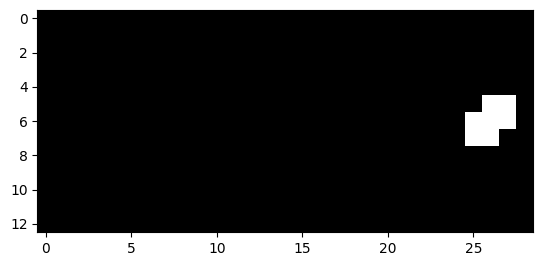

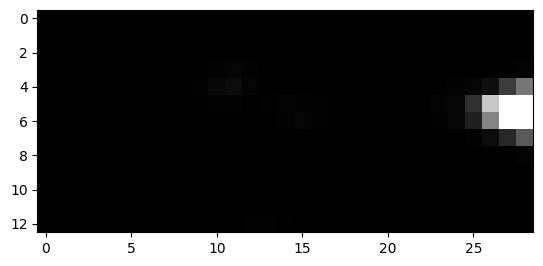

1475


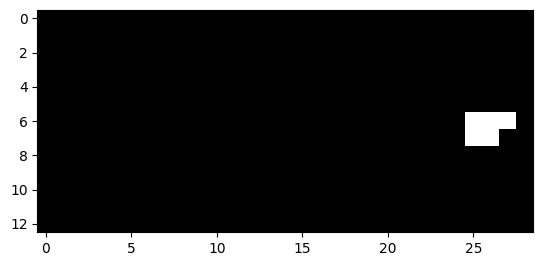

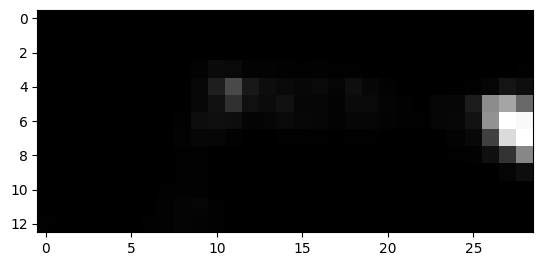

1509


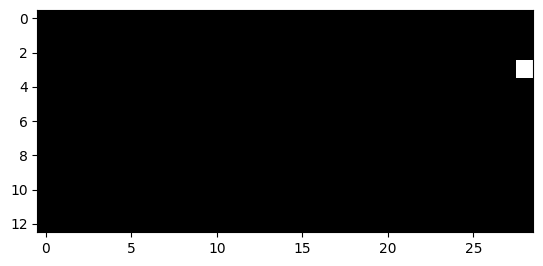

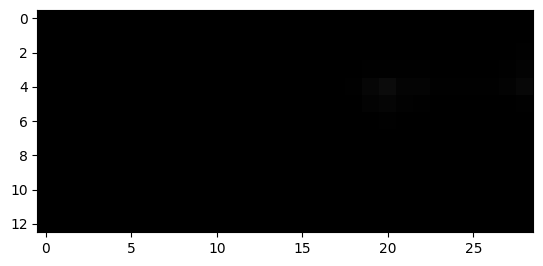

1510


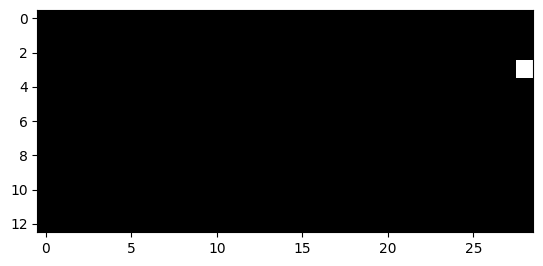

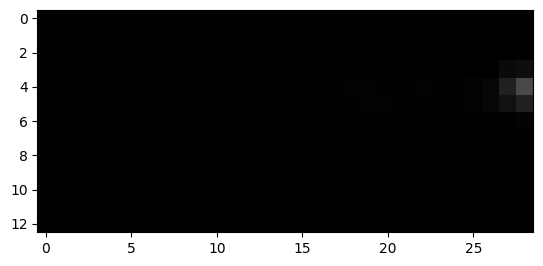

1511


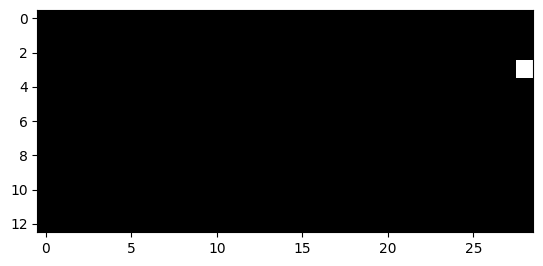

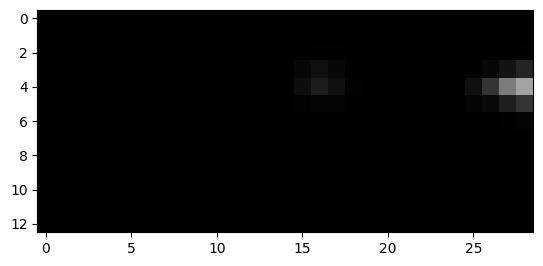

1687


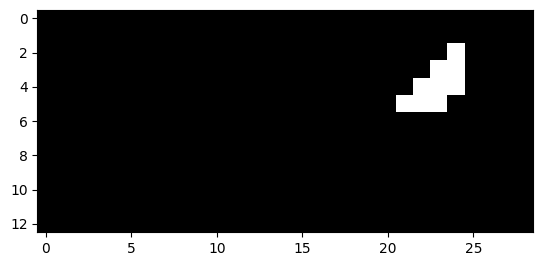

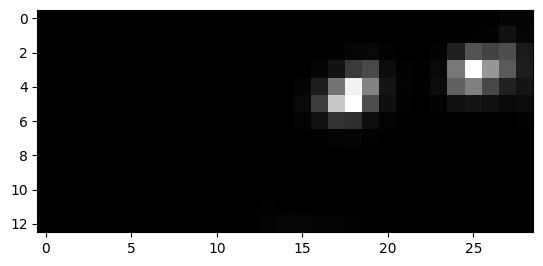

1688


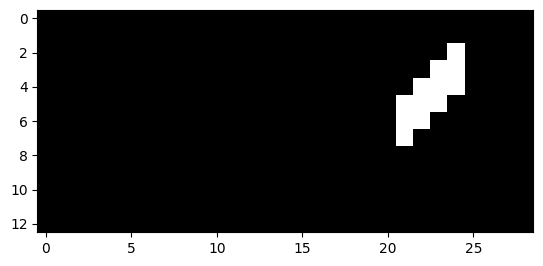

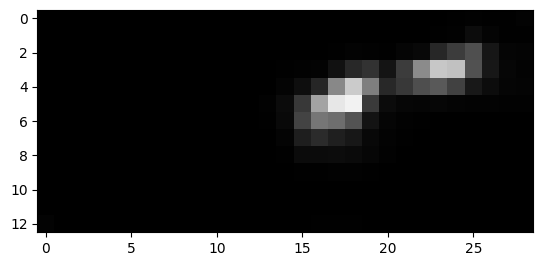

1689


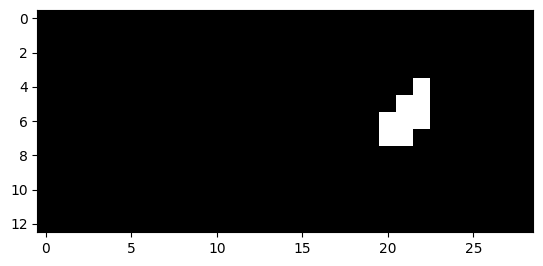

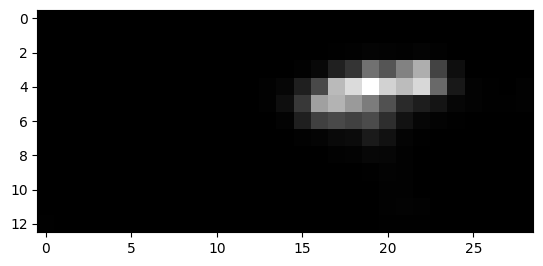

1690


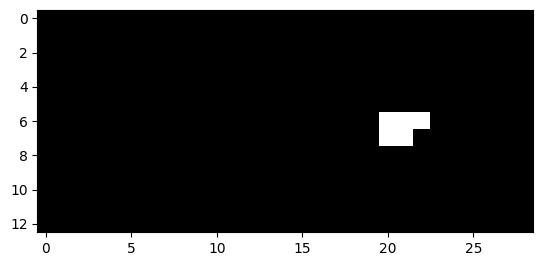

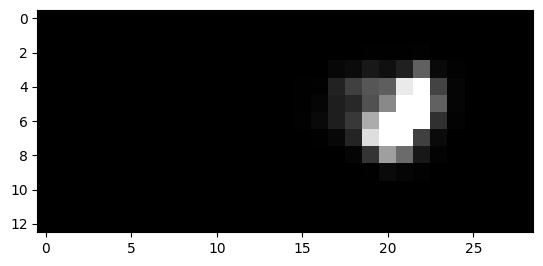

1691


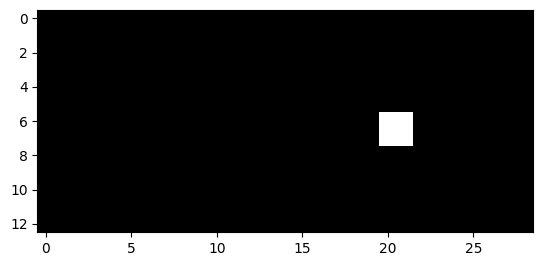

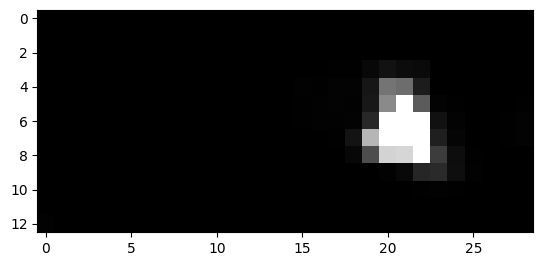

1710


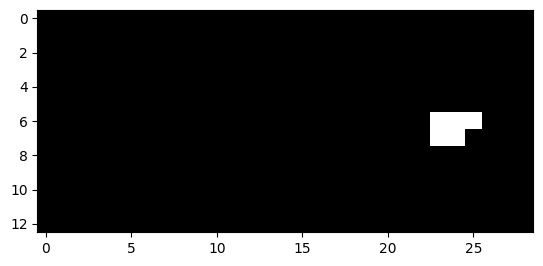

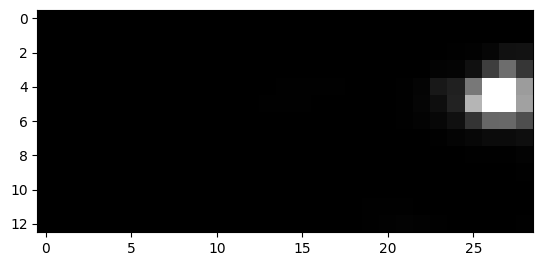

1711


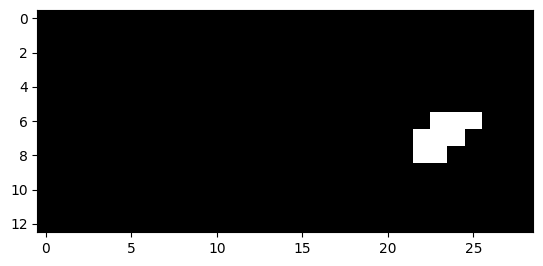

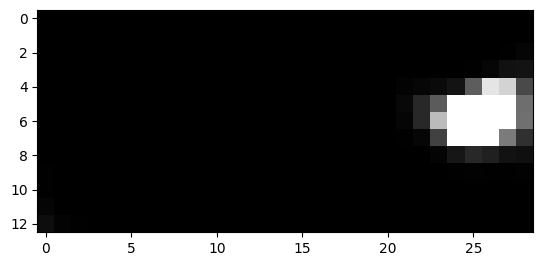

1712


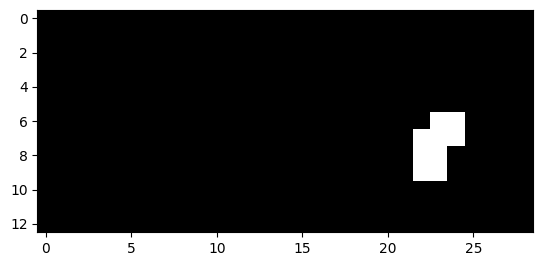

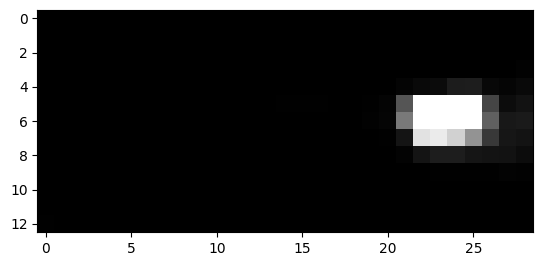

1713


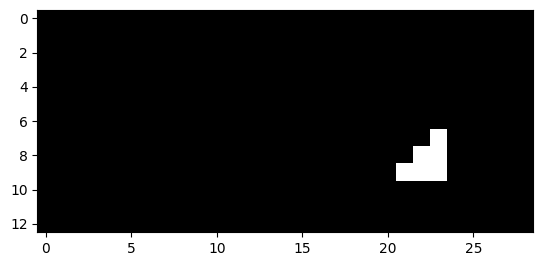

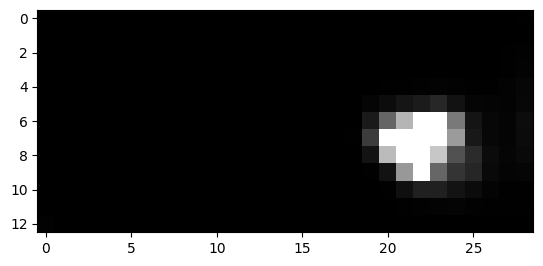

1714


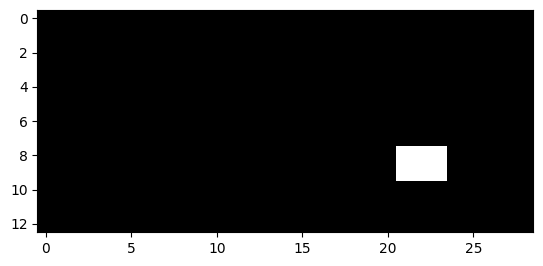

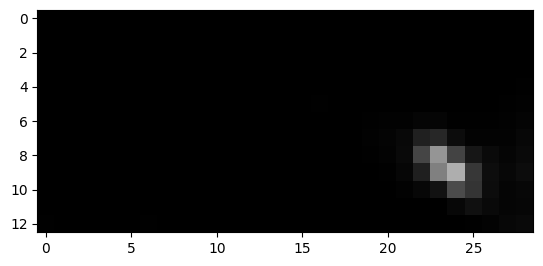

1715


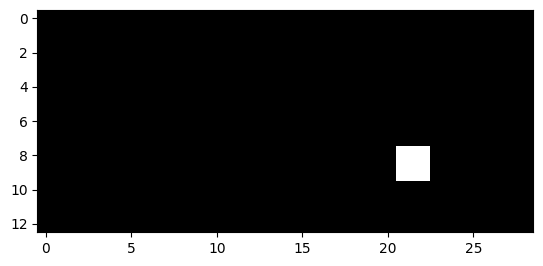

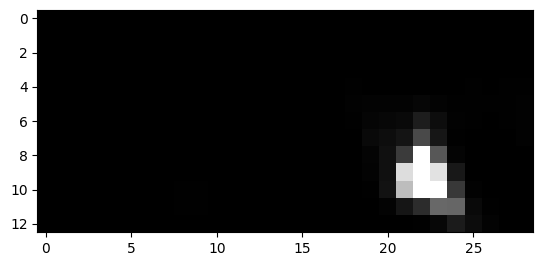

1728


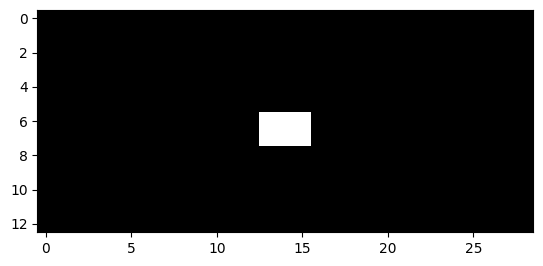

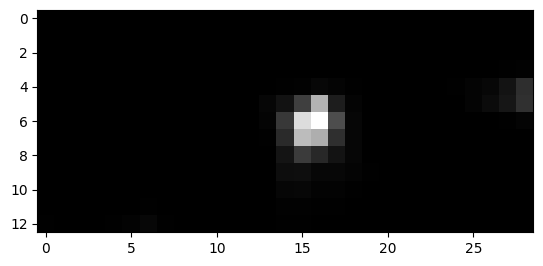

1729


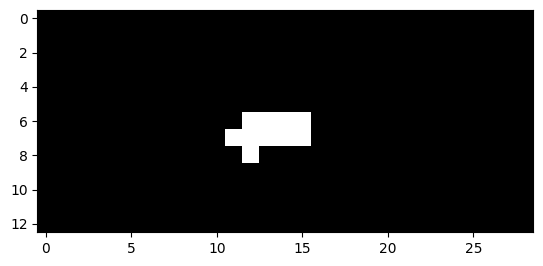

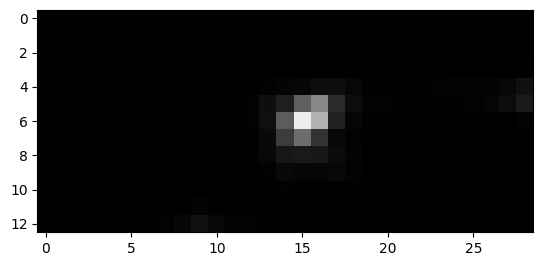

1730


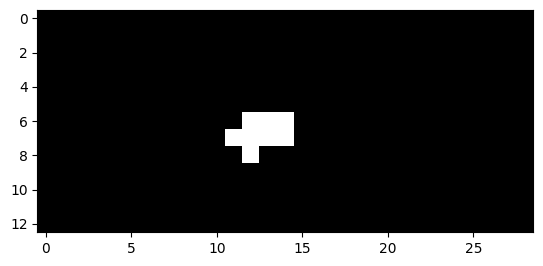

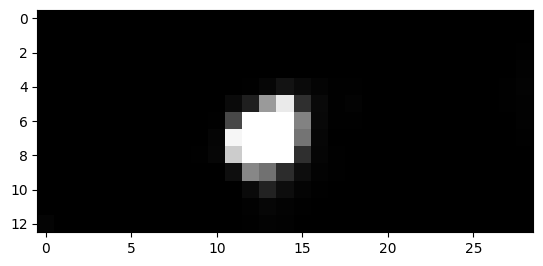

1731


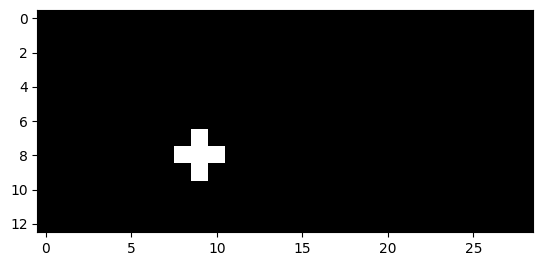

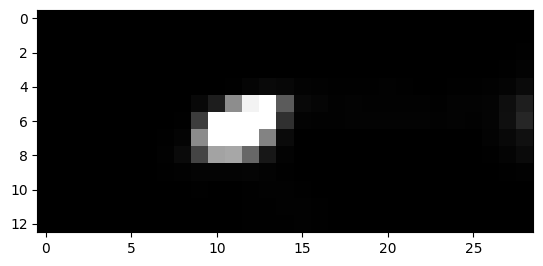

1732


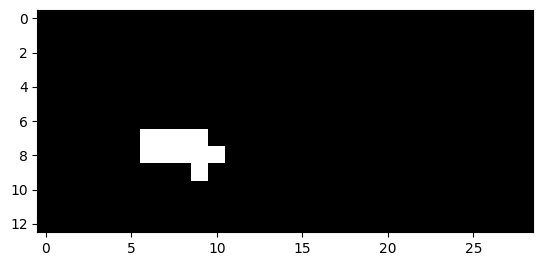

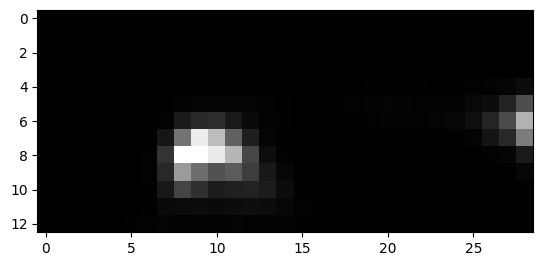

1733


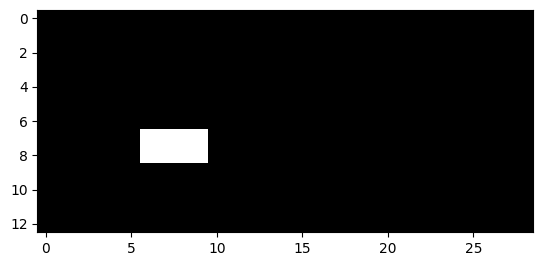

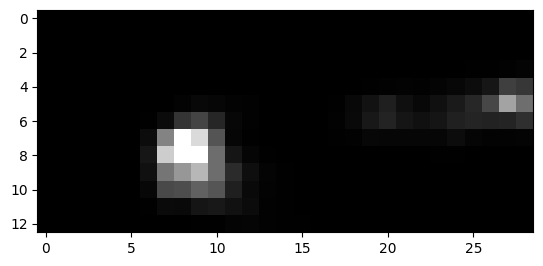

1735


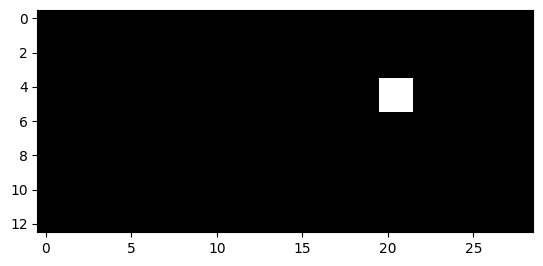

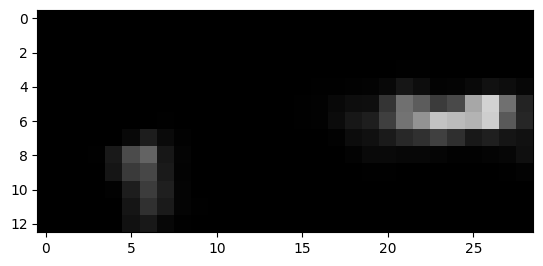

1736


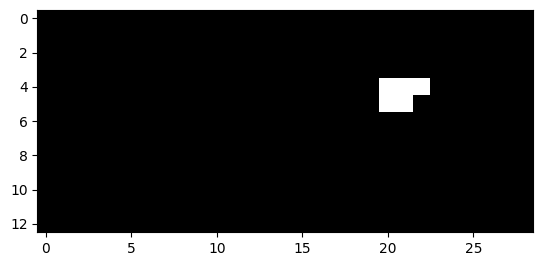

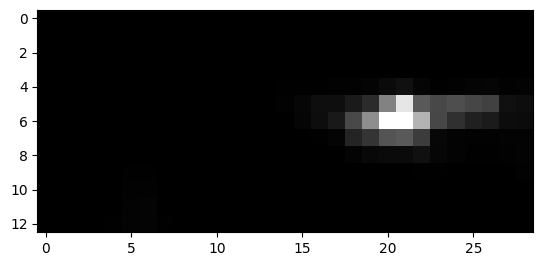

1737


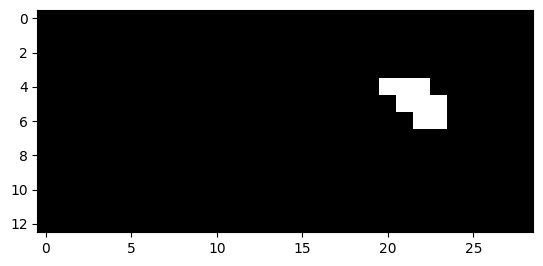

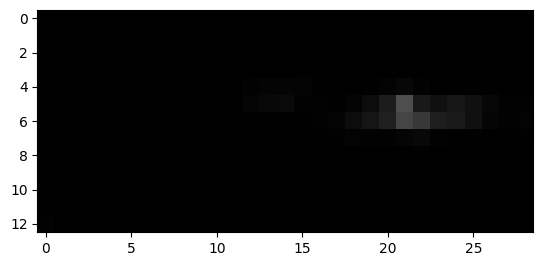

1738


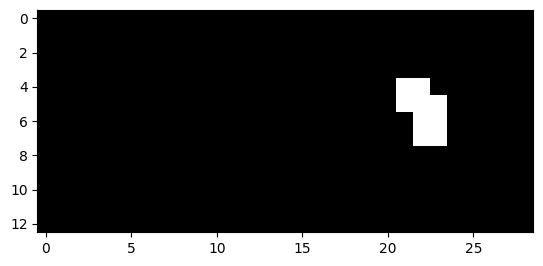

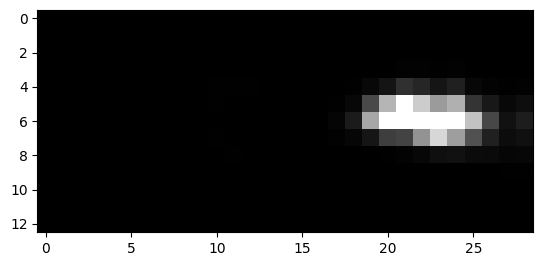

1739


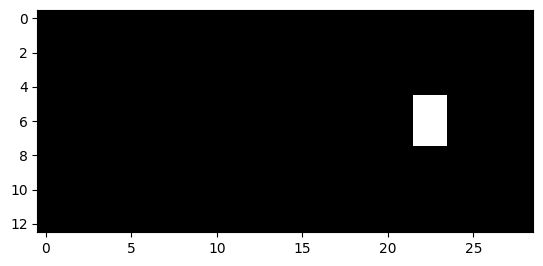

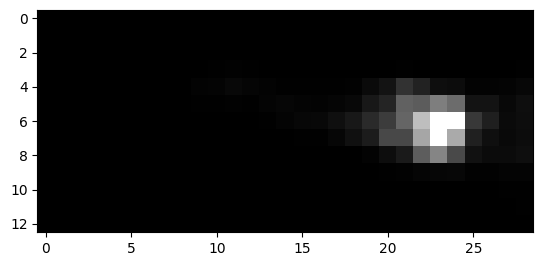

1740


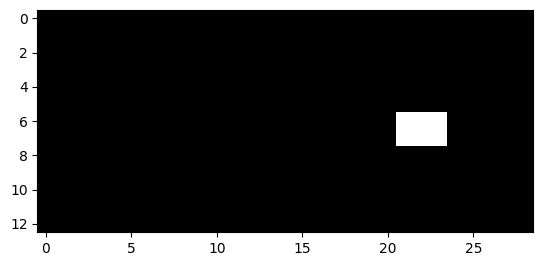

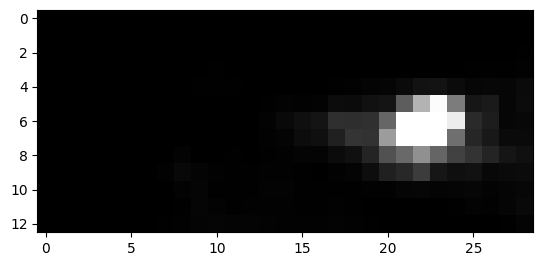

1741


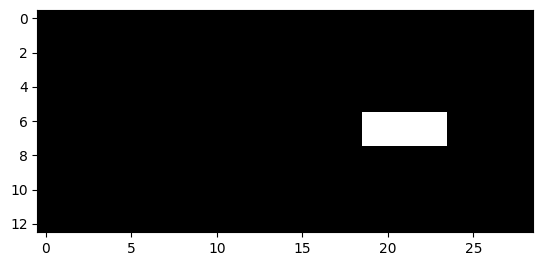

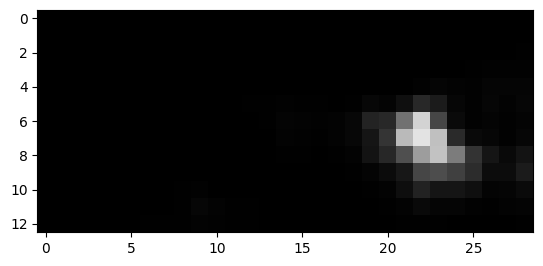

1742


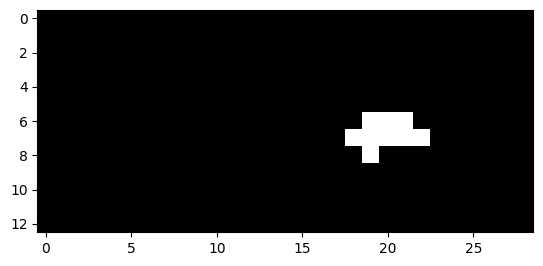

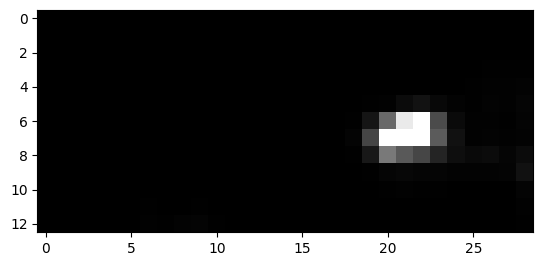

1743


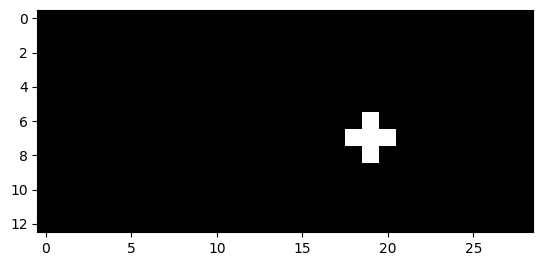

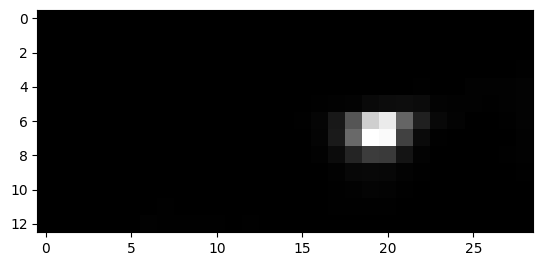

1750


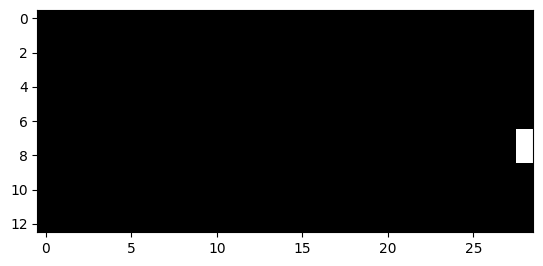

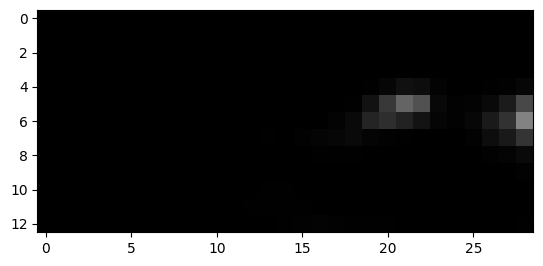

1751


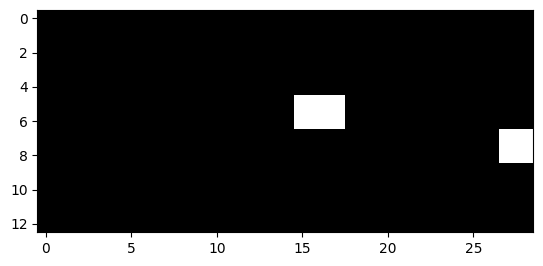

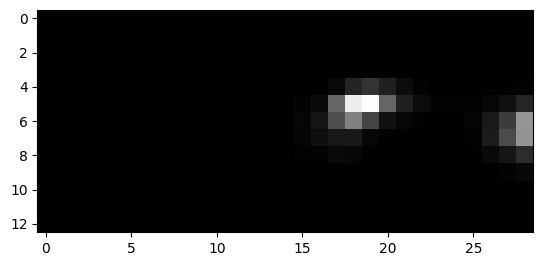

1752


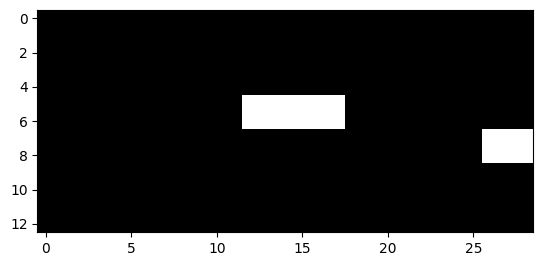

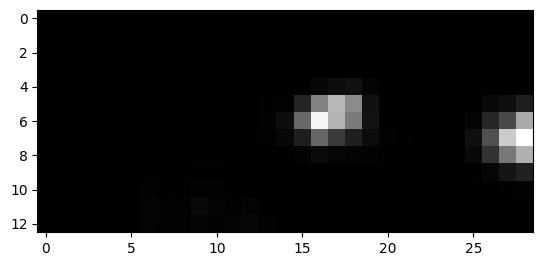

1753


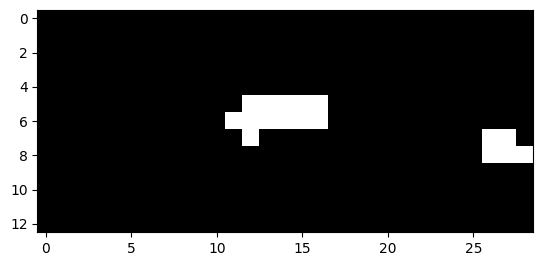

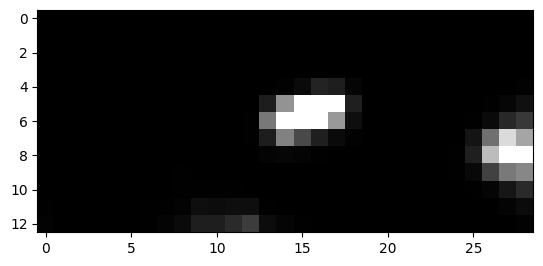

1754


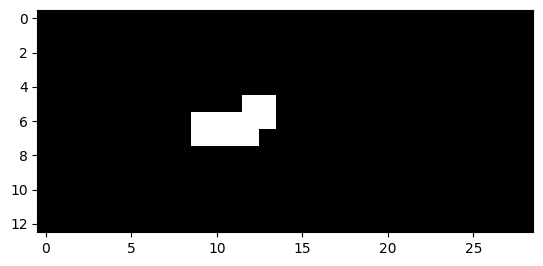

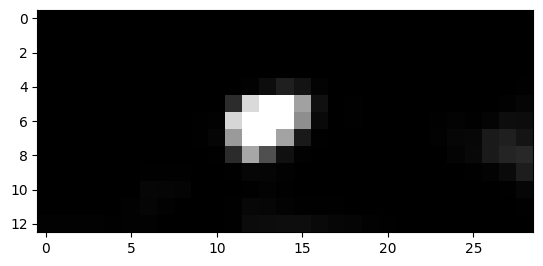

1755


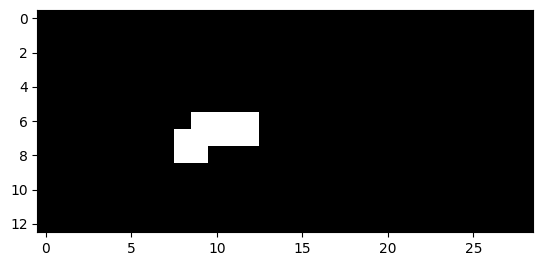

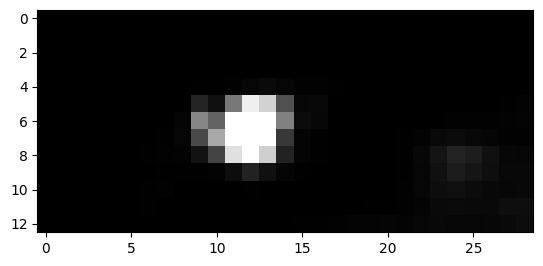

1756


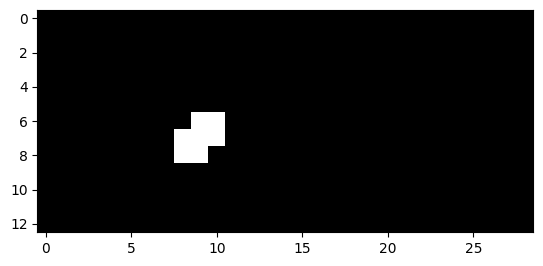

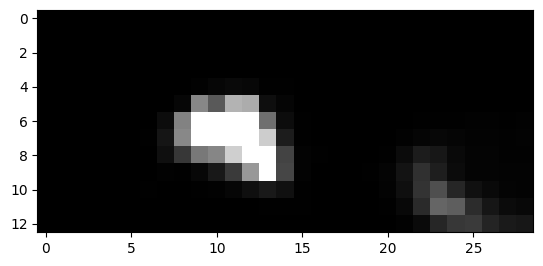

1760


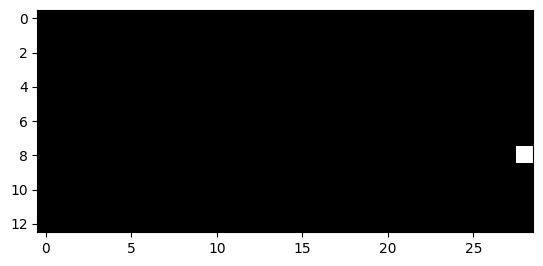

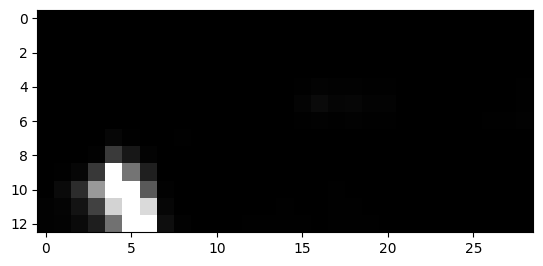

1761


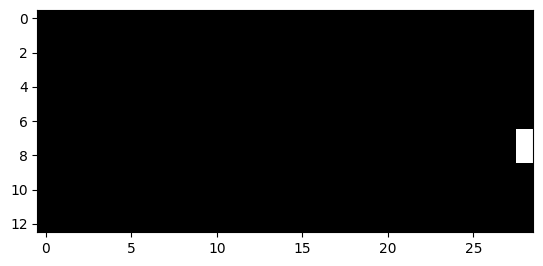

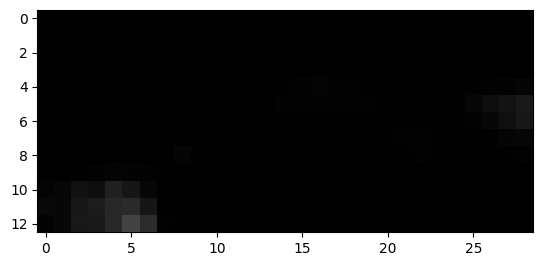

1762


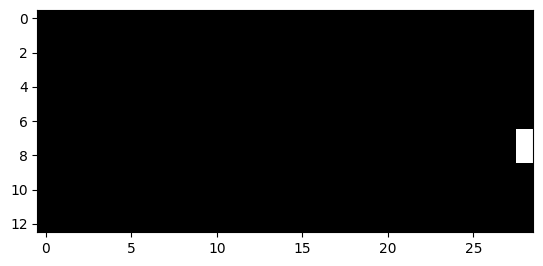

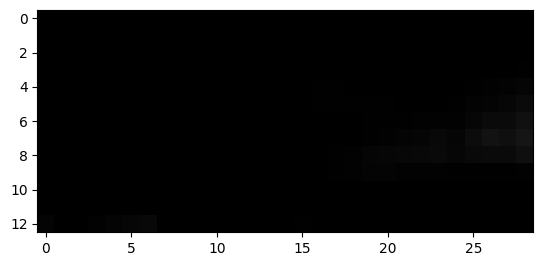

1770


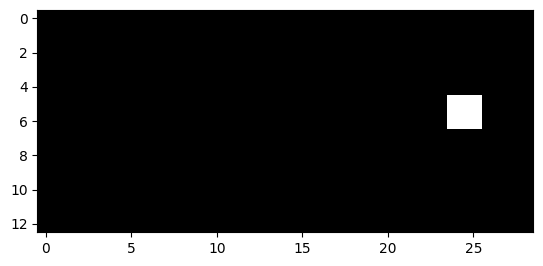

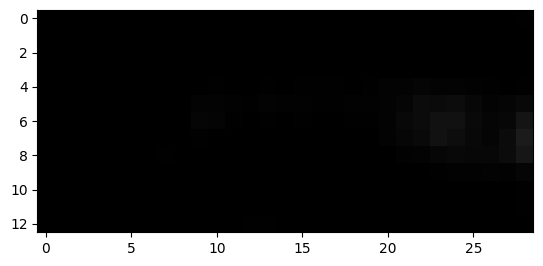

1771


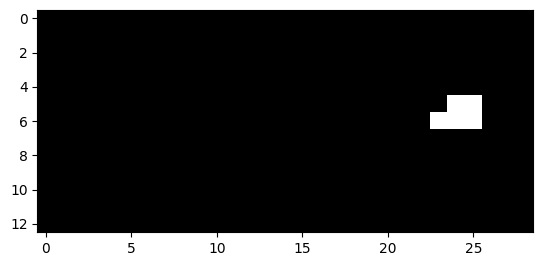

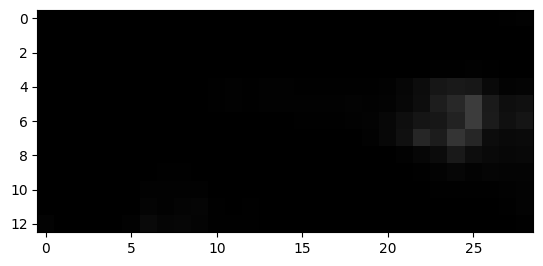

1772


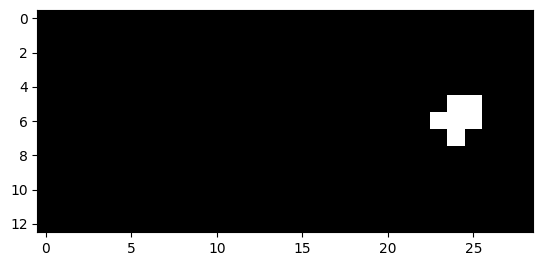

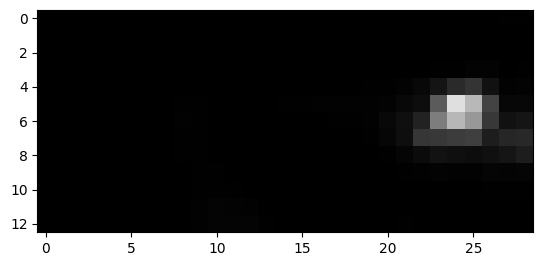

1773


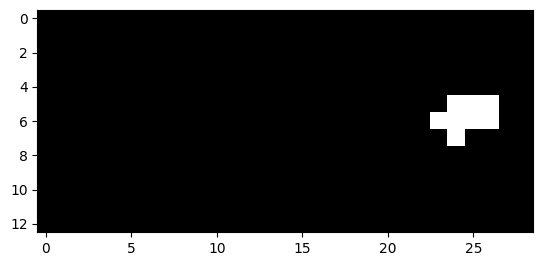

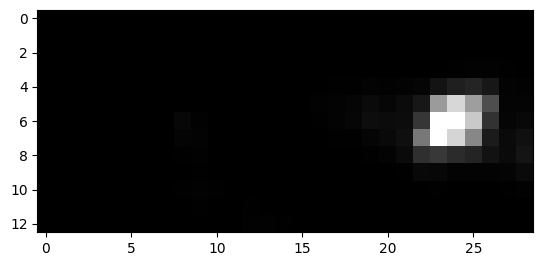

1774


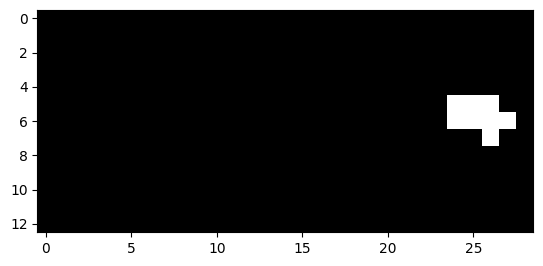

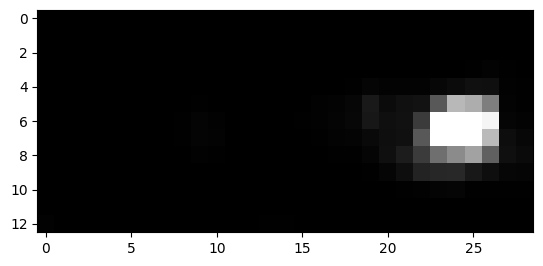

1775


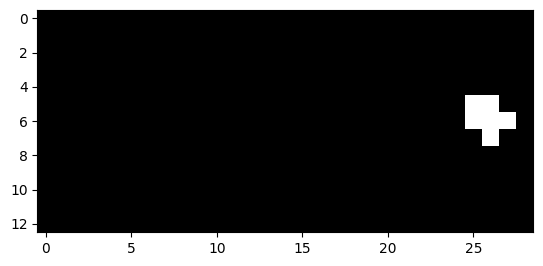

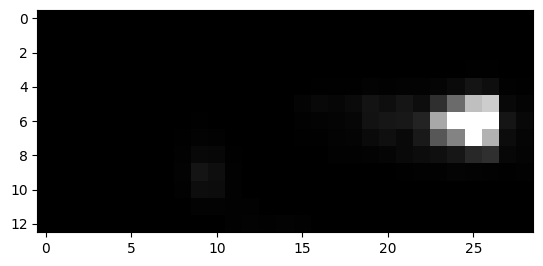

1776


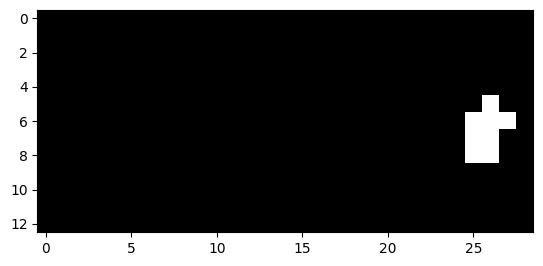

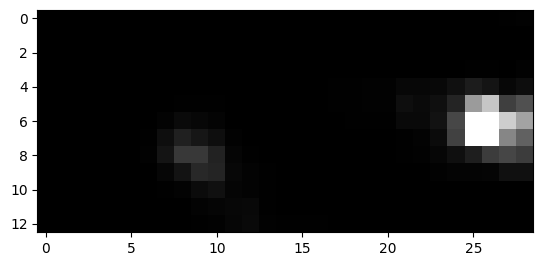

1777


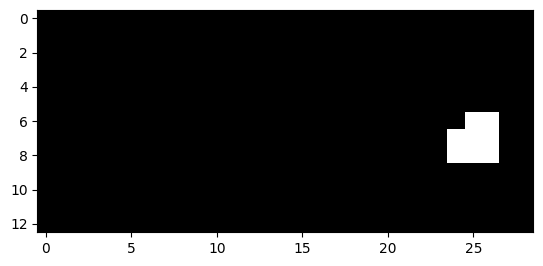

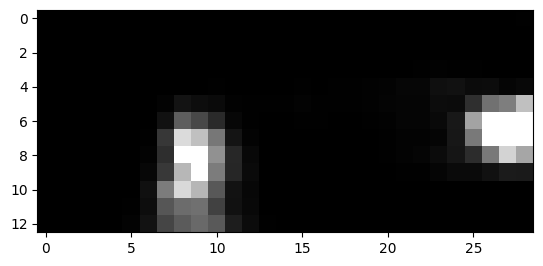

1778


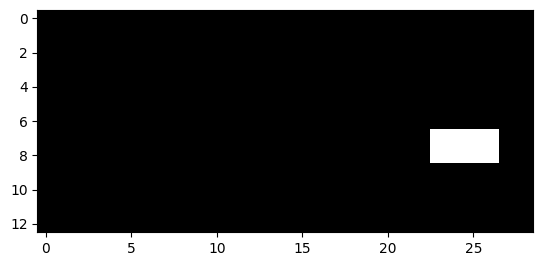

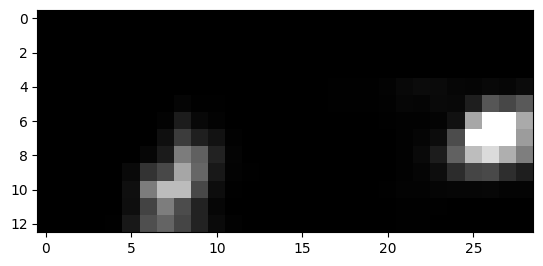

1779


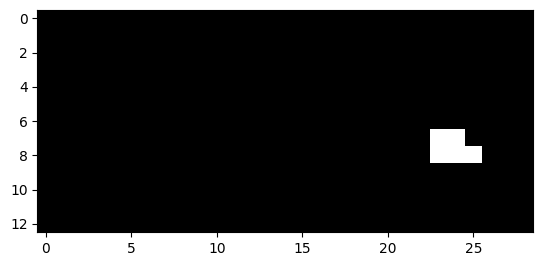

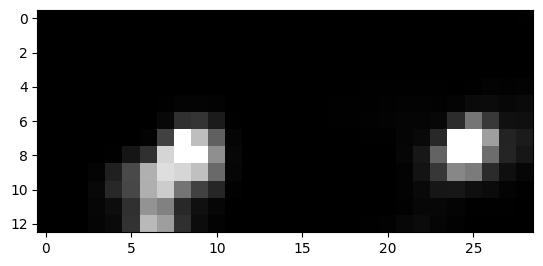

1786


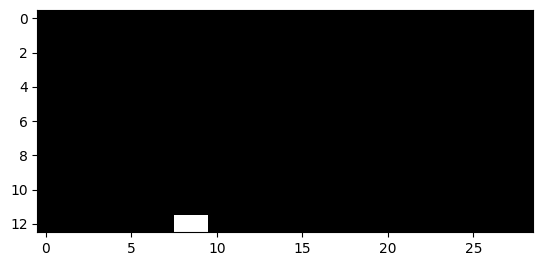

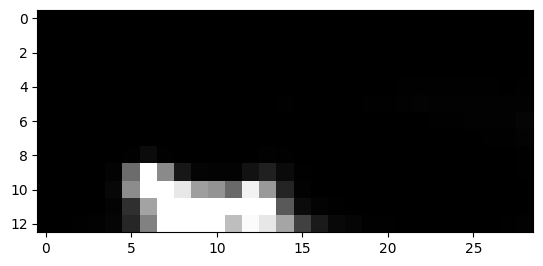

1787


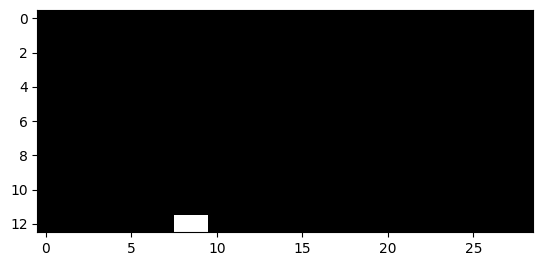

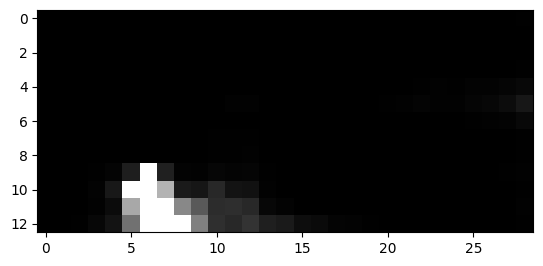

1792


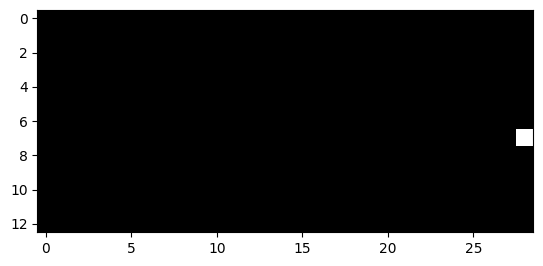

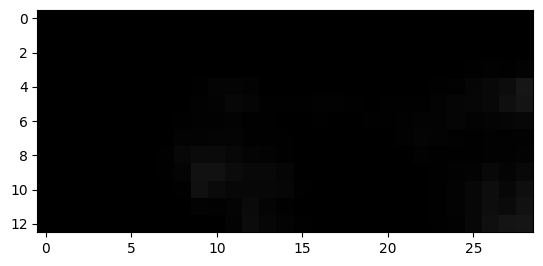

1793


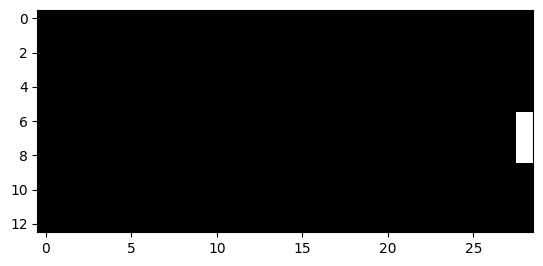

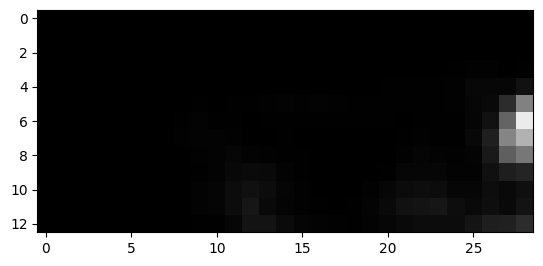

1794


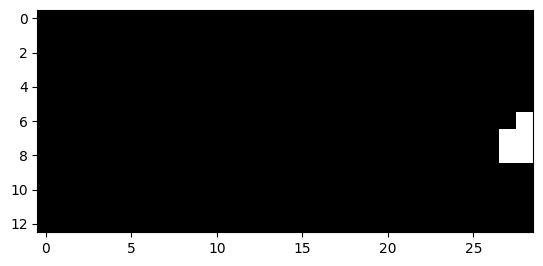

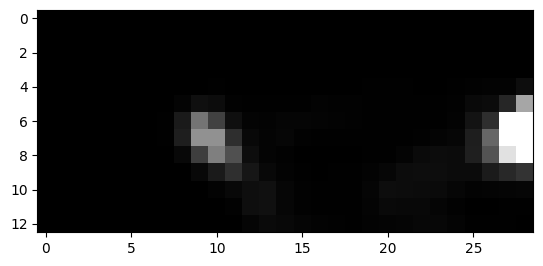

1795


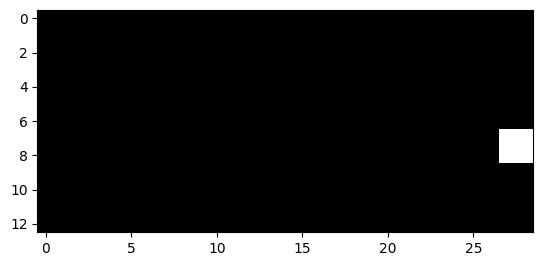

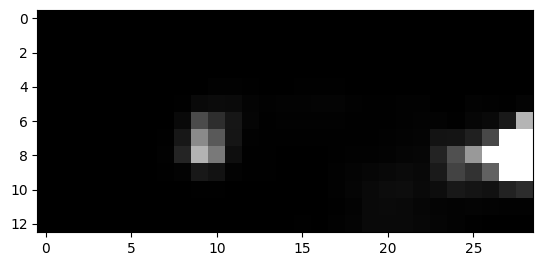

1796


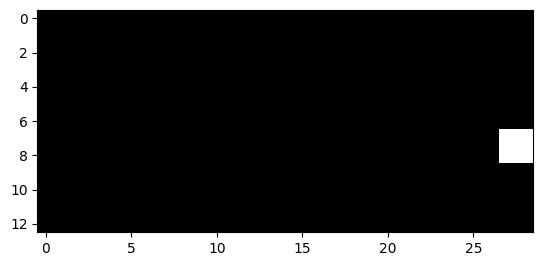

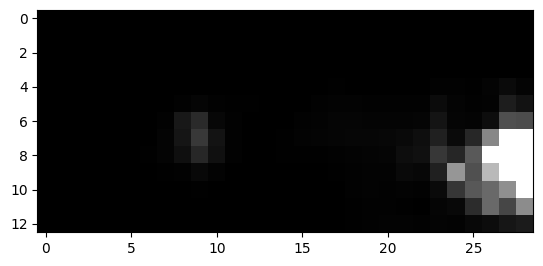

1797


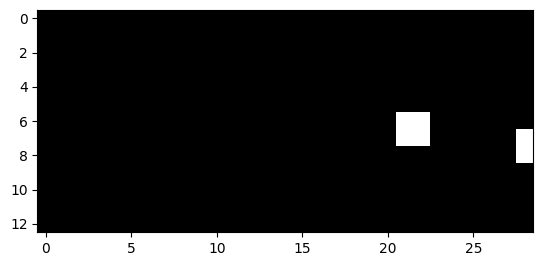

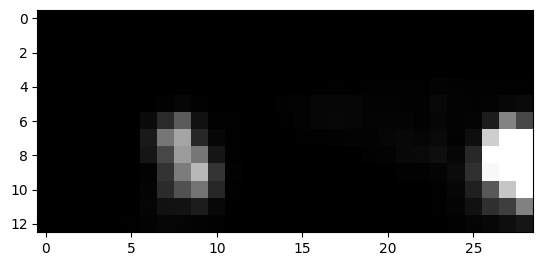

1798


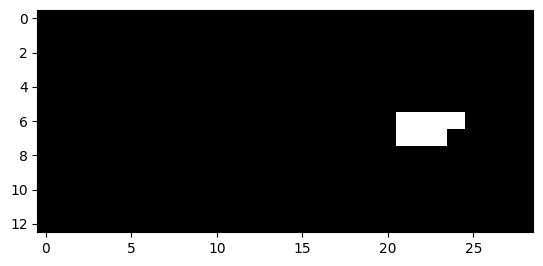

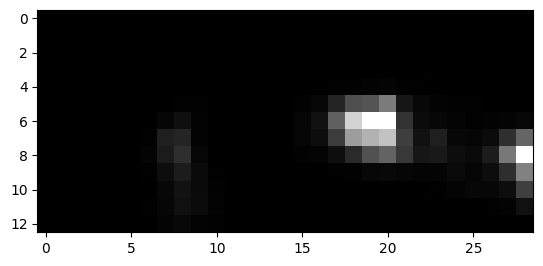

1799


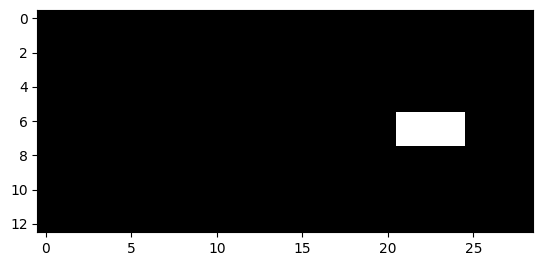

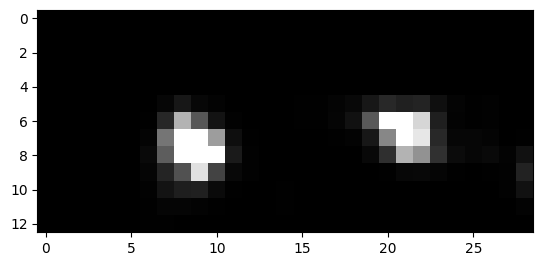

1800


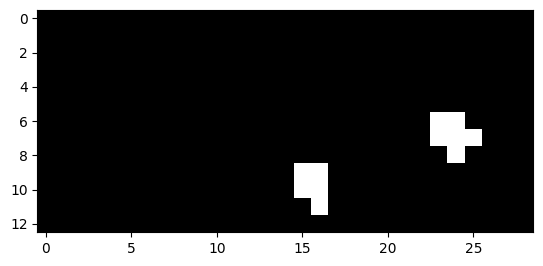

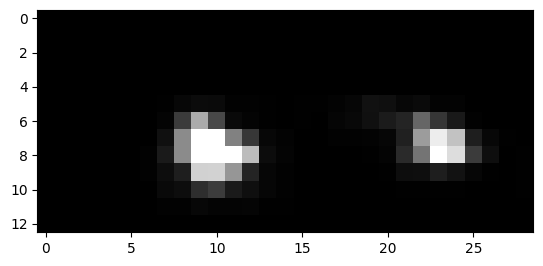

1801


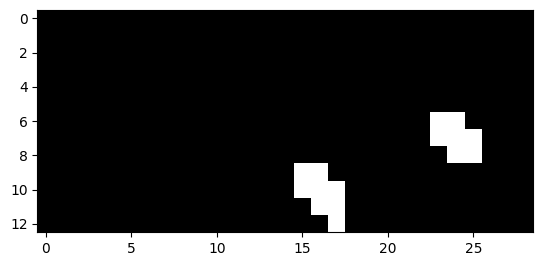

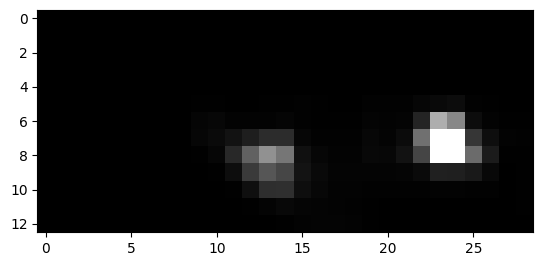

1802


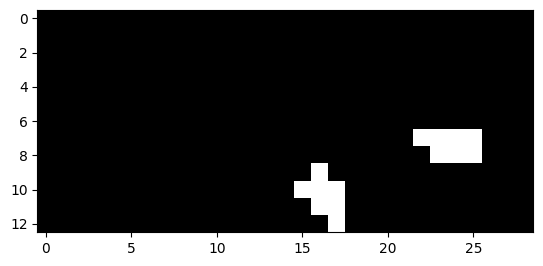

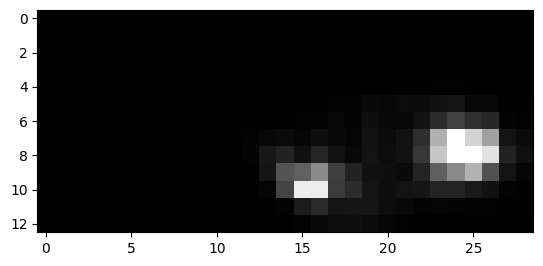

1803


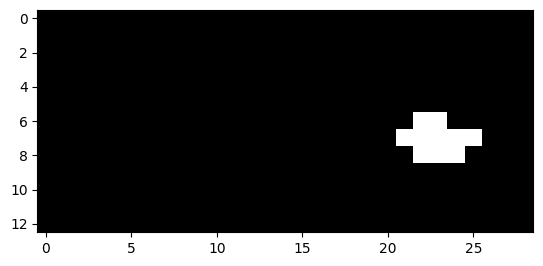

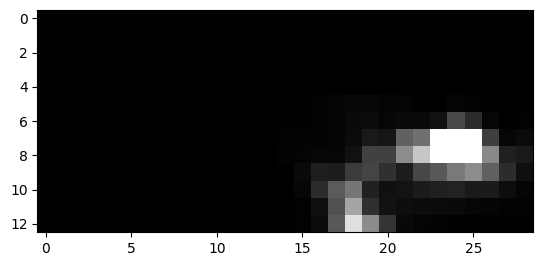

1804


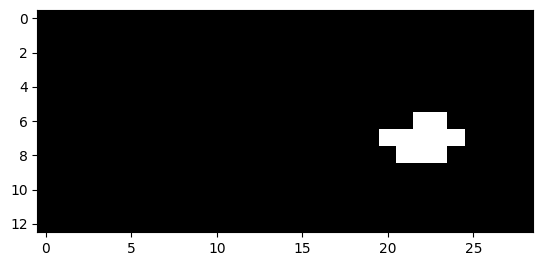

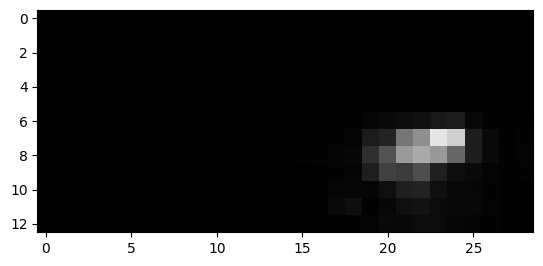

1805


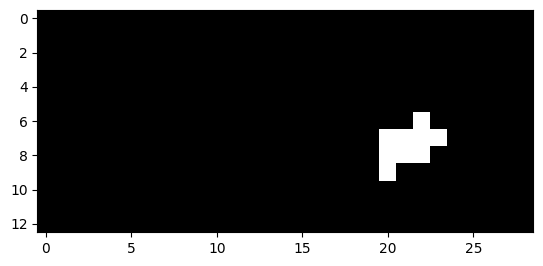

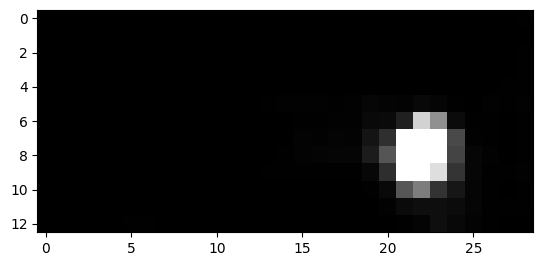

1806


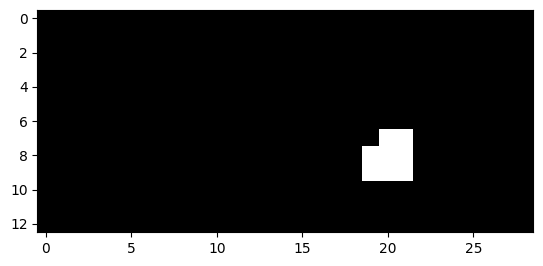

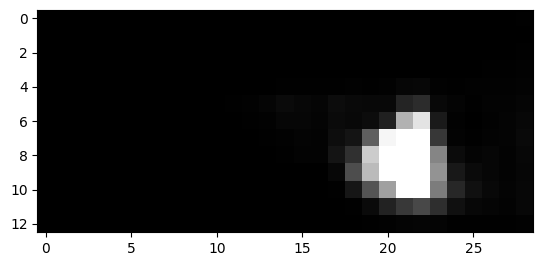

1807


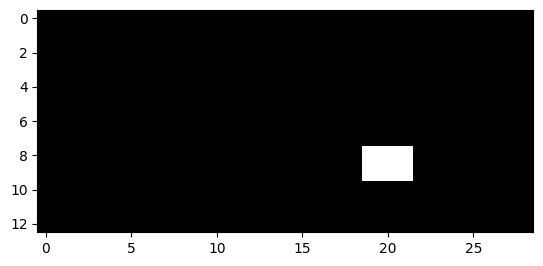

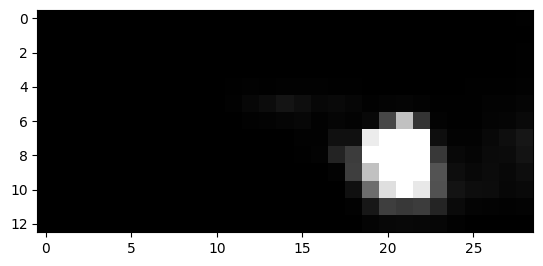

1808


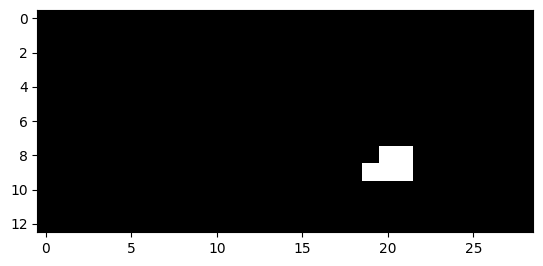

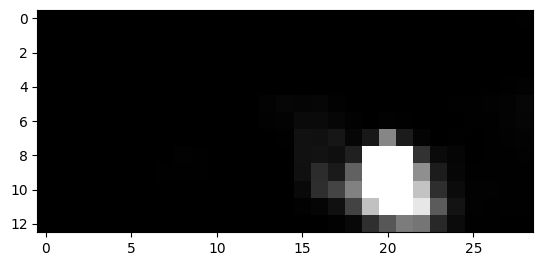

1809


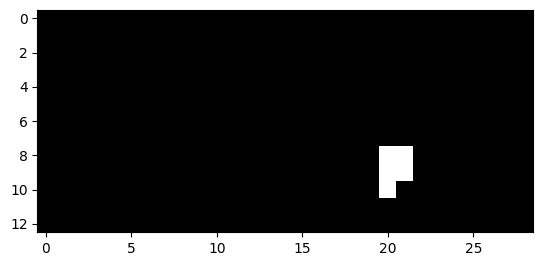

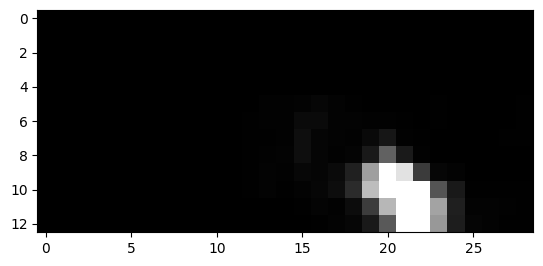

1810


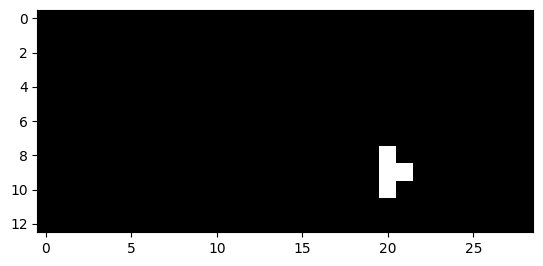

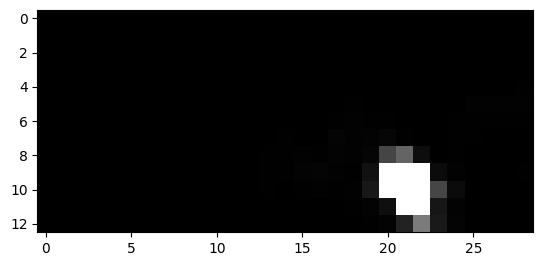

1845


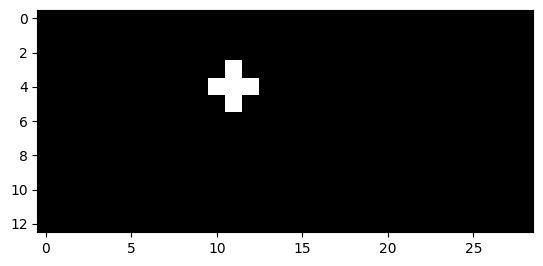

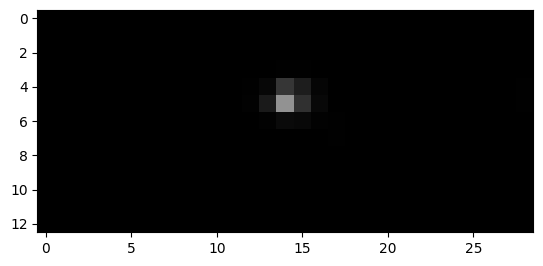

1846


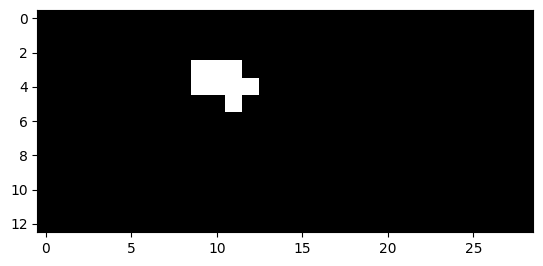

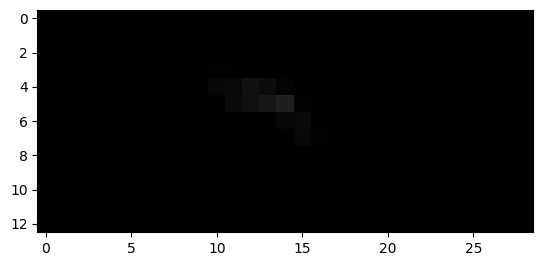

1847


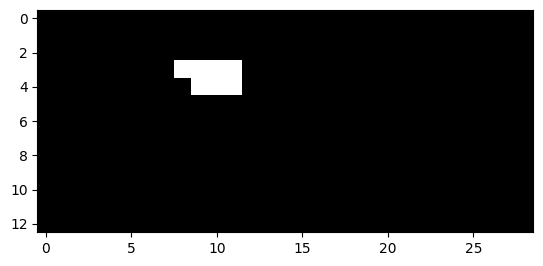

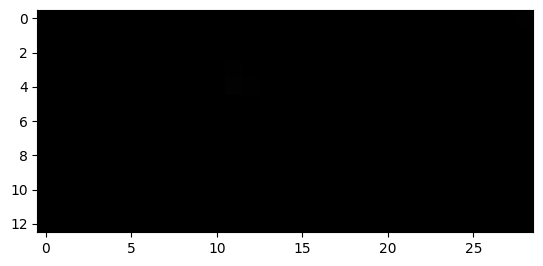

1848


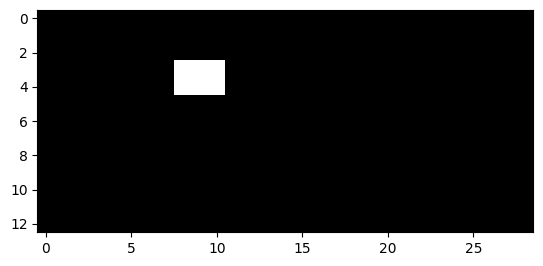

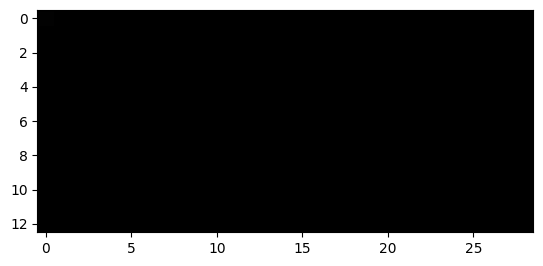

1849


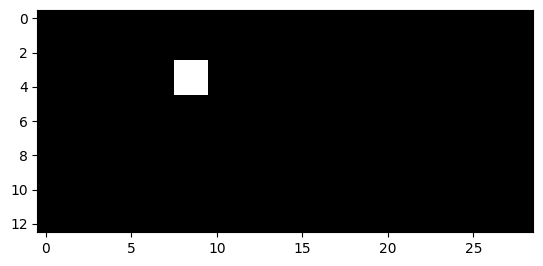

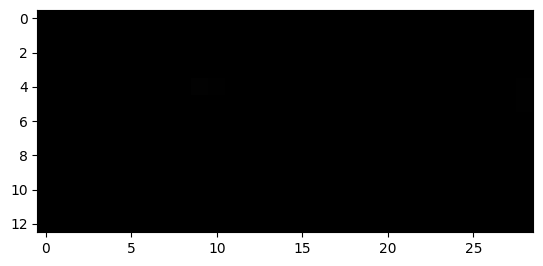

2122


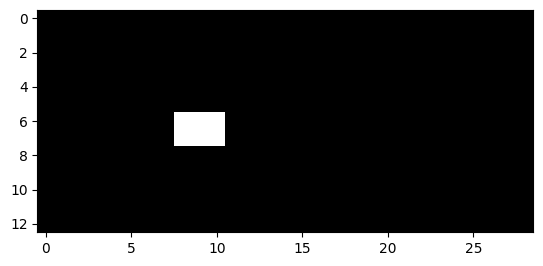

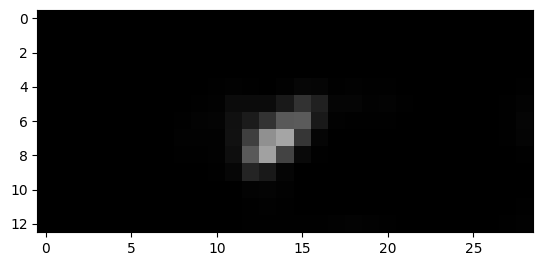

2123


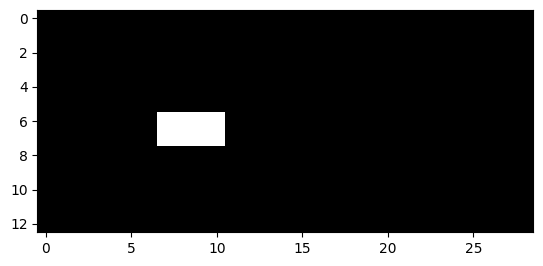

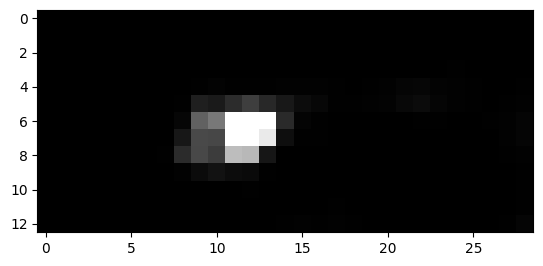

2124


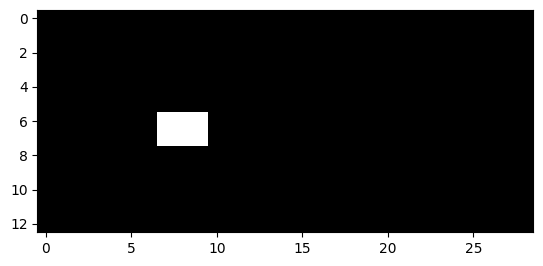

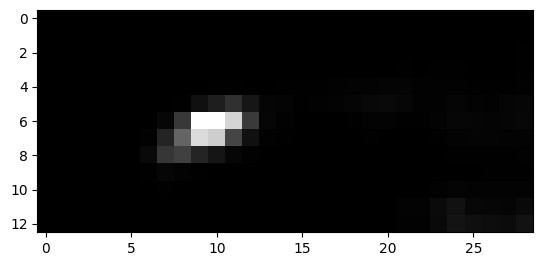

2126


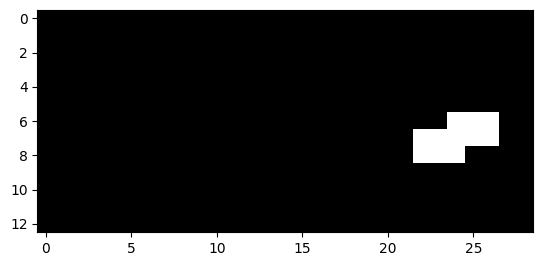

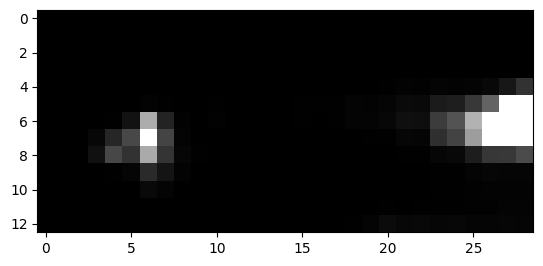

2127


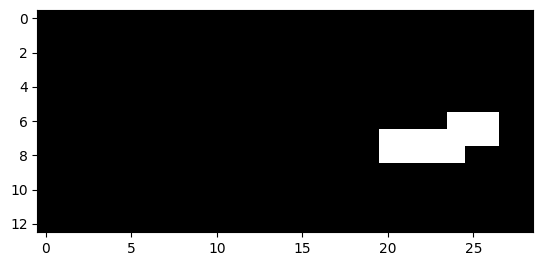

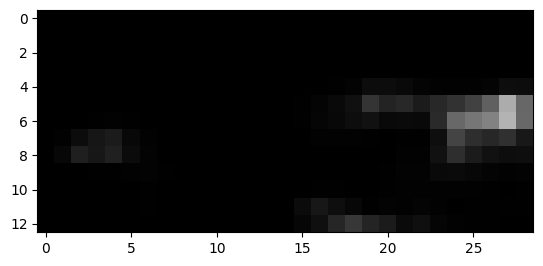

2128


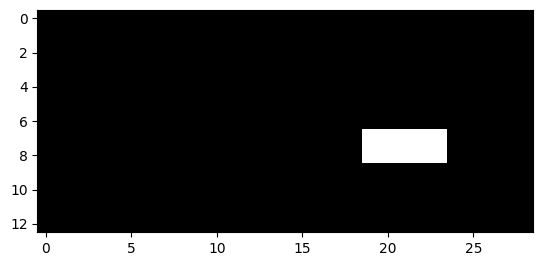

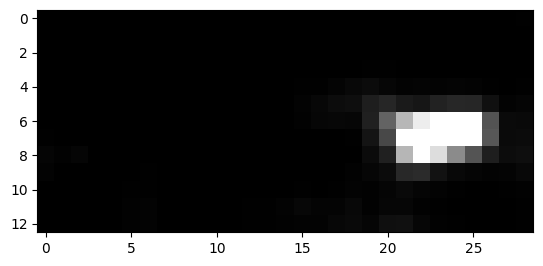

2129


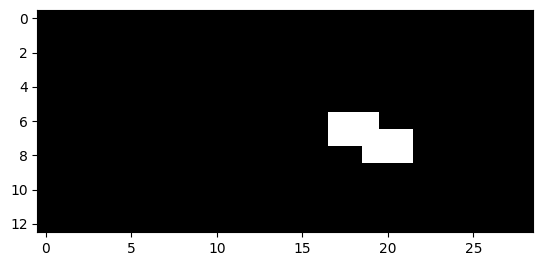

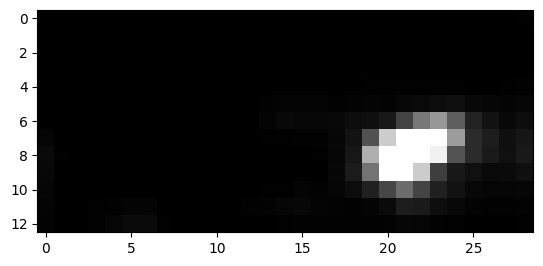

2130


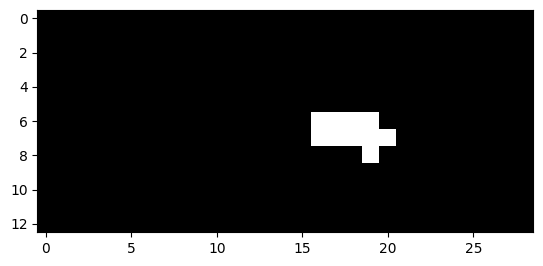

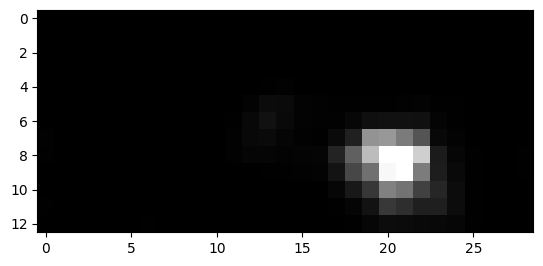

2131


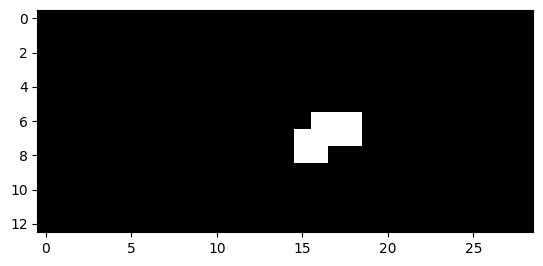

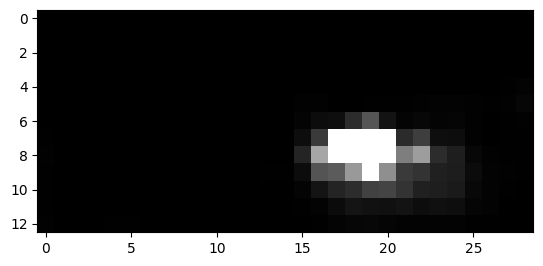

2132


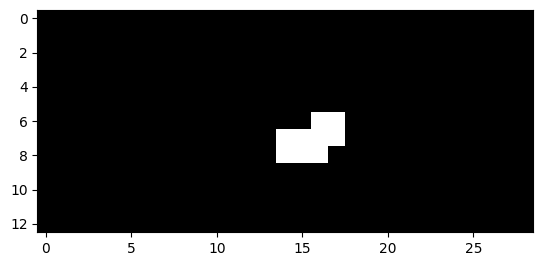

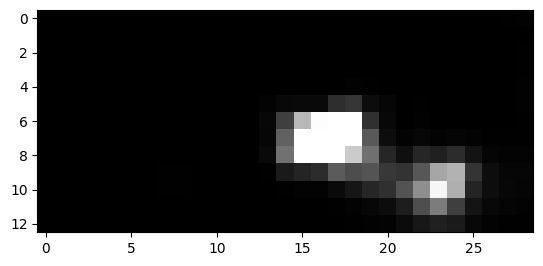

2133


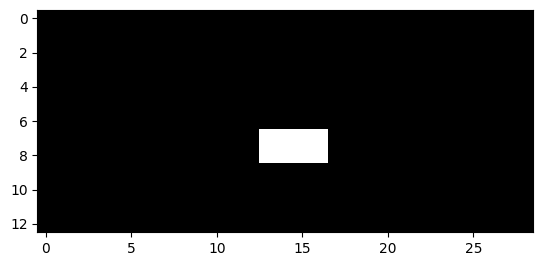

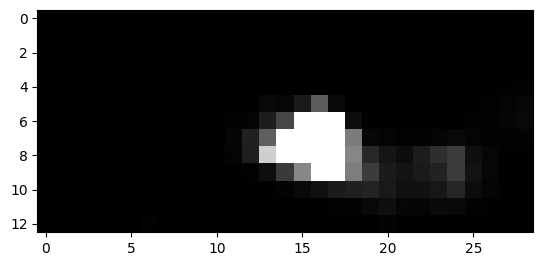

2134


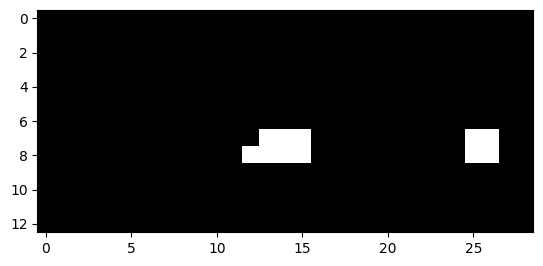

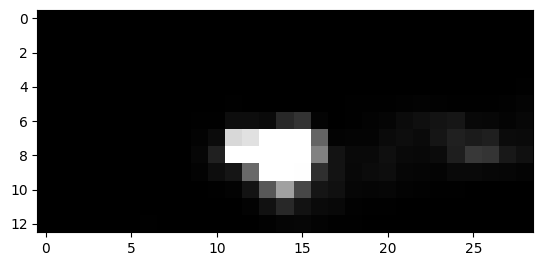

2135


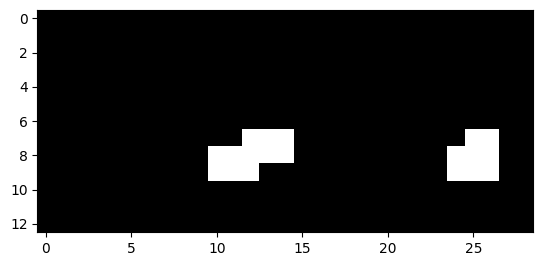

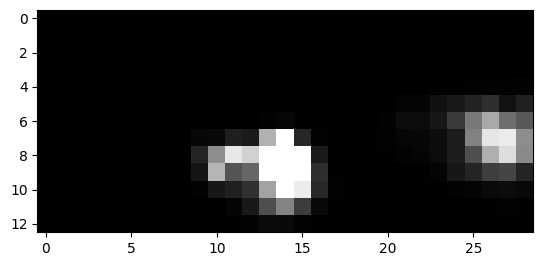

2136


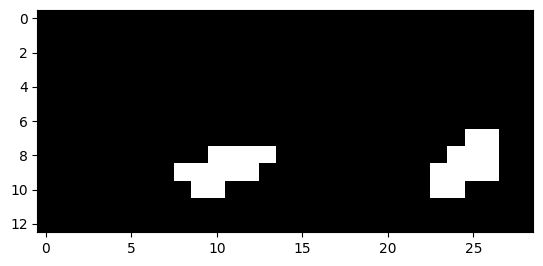

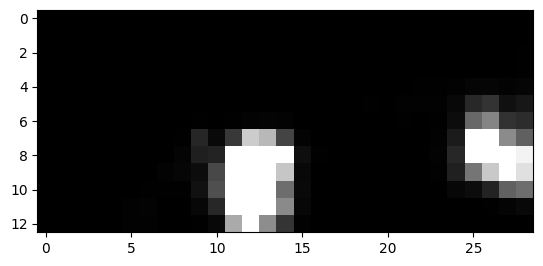

2137


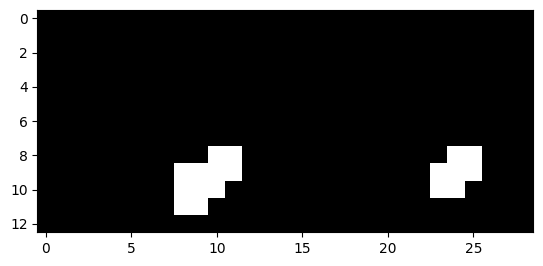

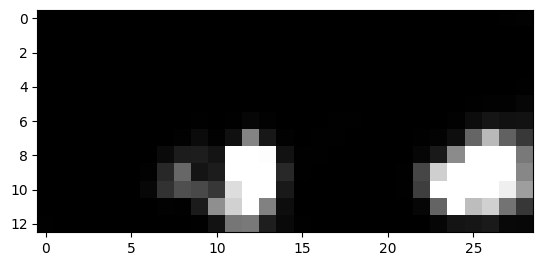

2138


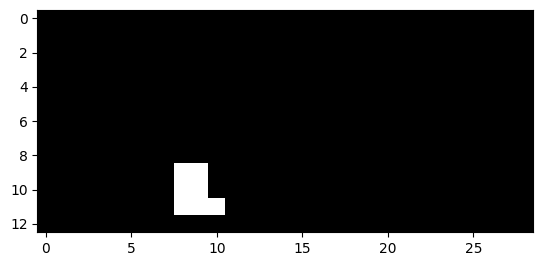

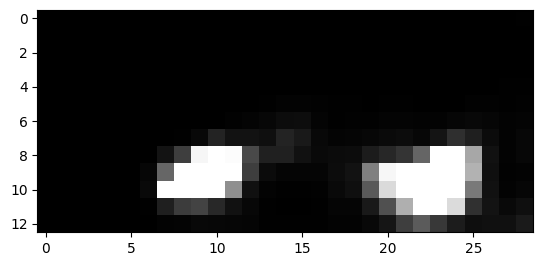

2139


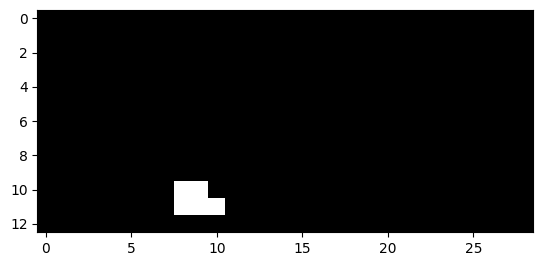

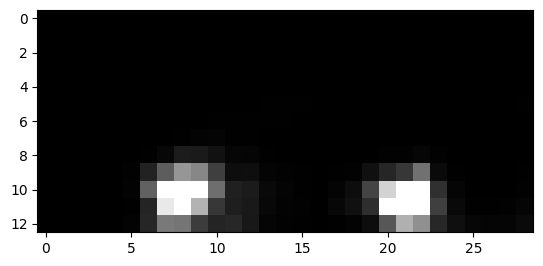

2143


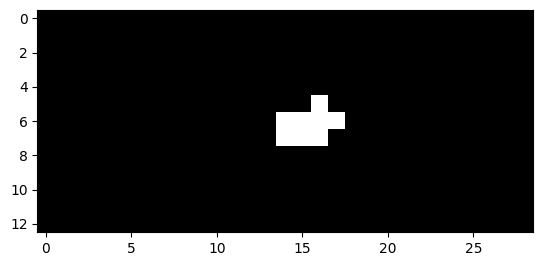

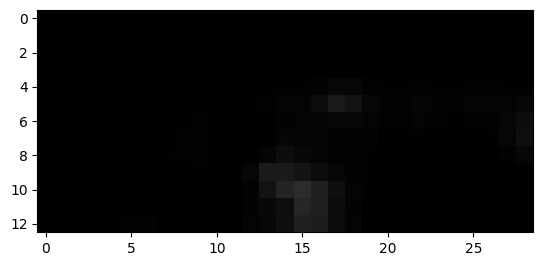

2144


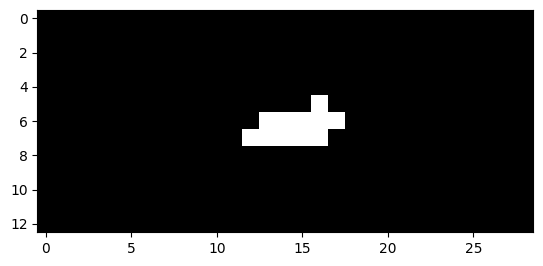

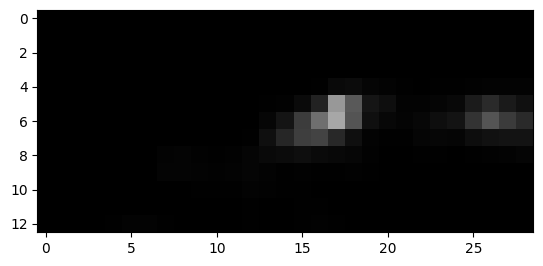

2145


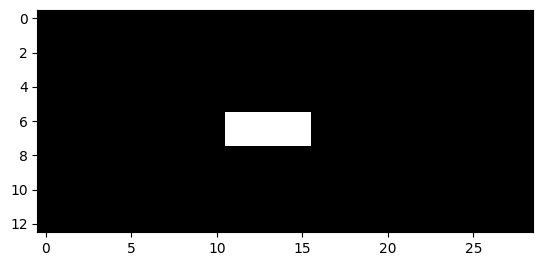

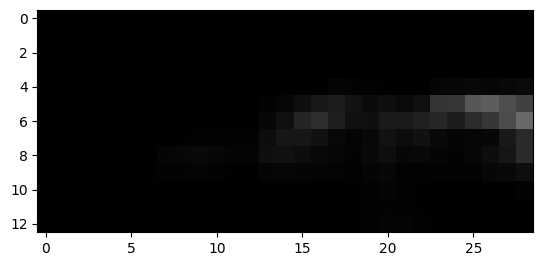

2146


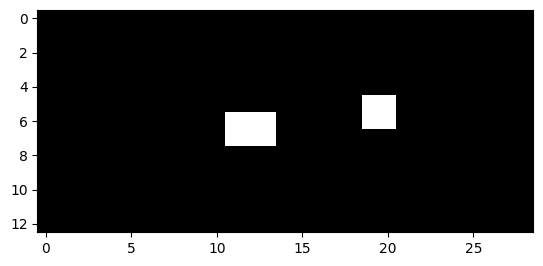

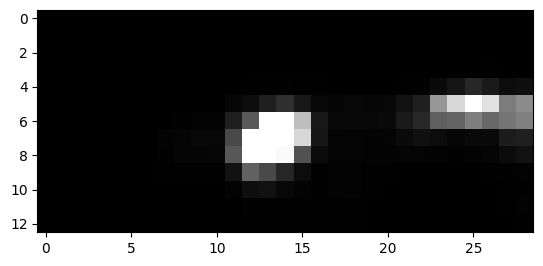

2147


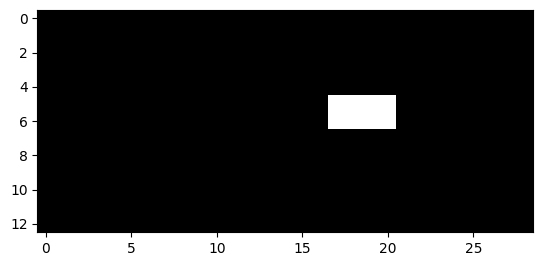

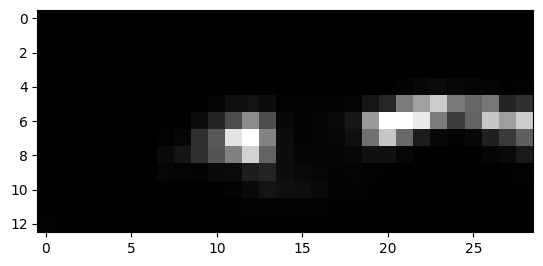

2148


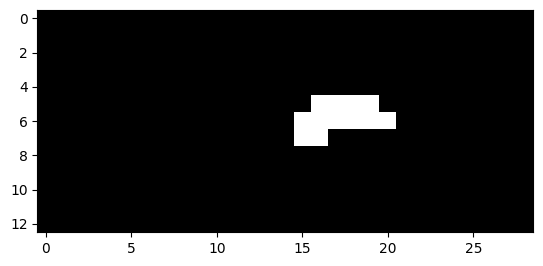

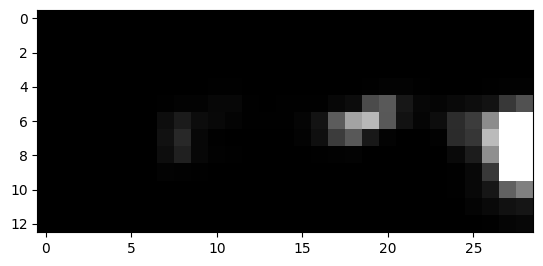

2149


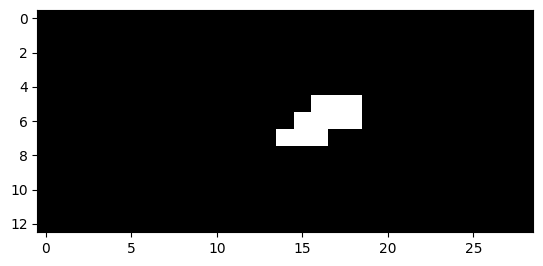

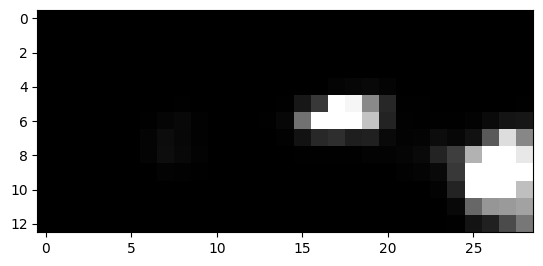

2150


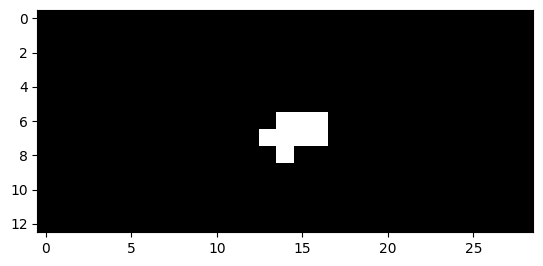

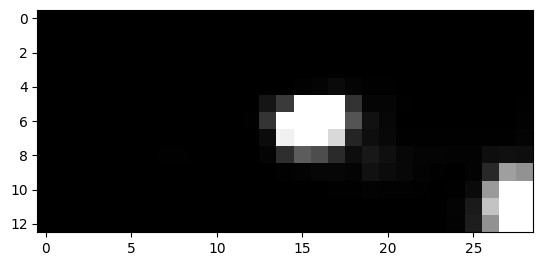

2151


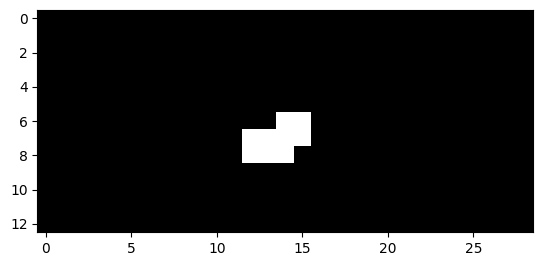

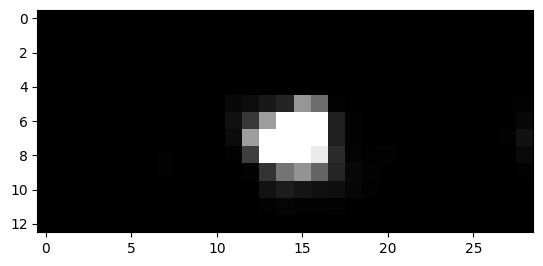

2152


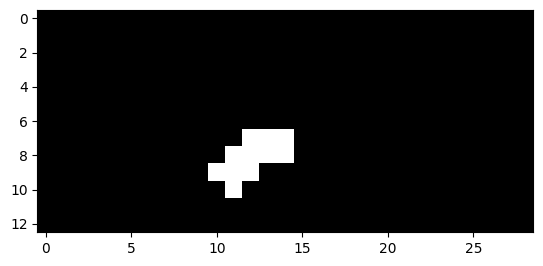

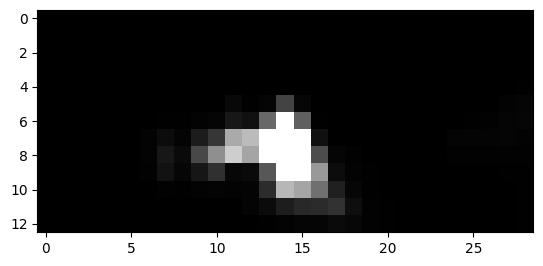

2153


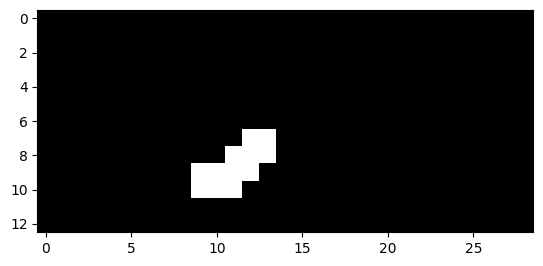

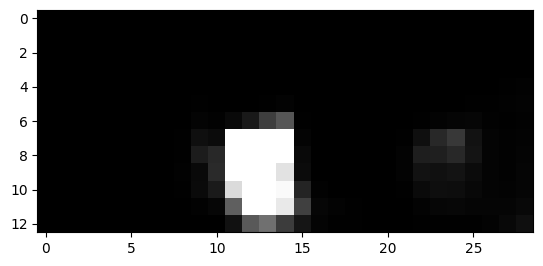

2154


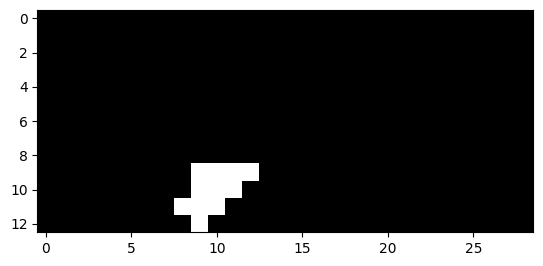

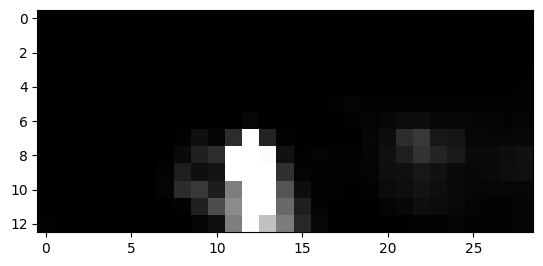

2155


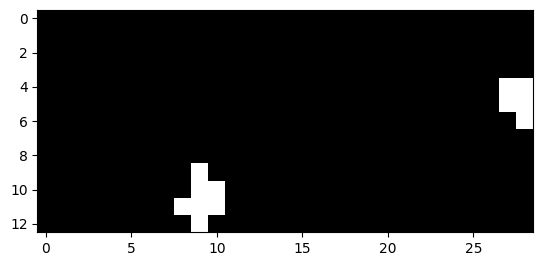

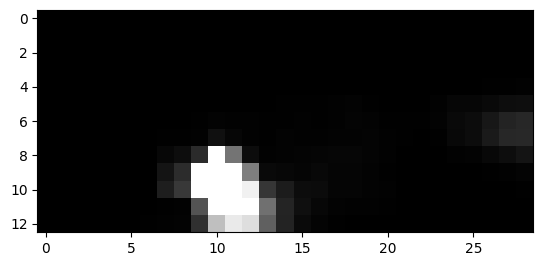

2156


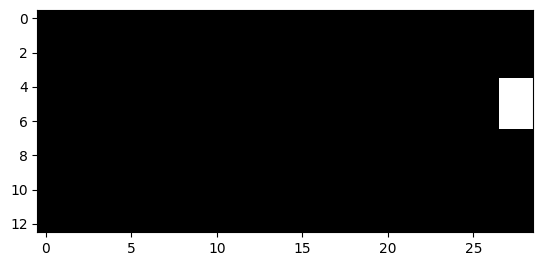

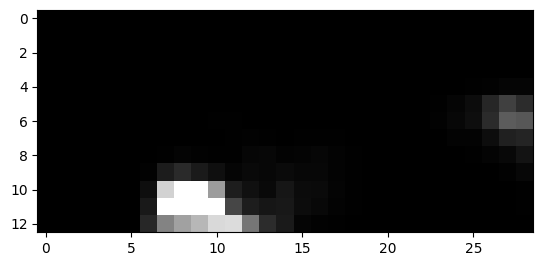

2157


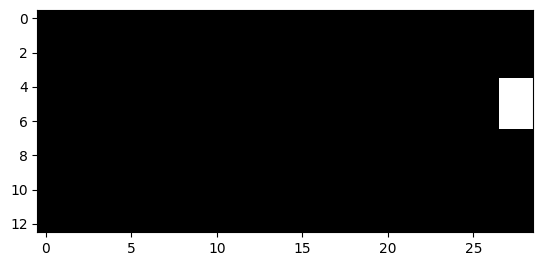

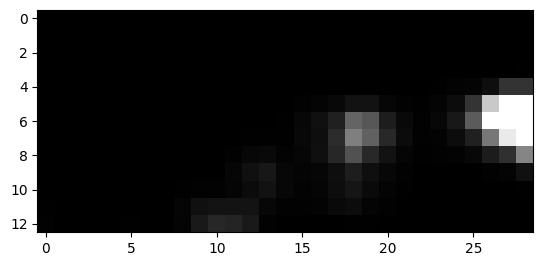

2166


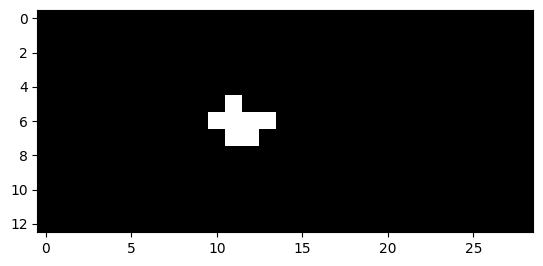

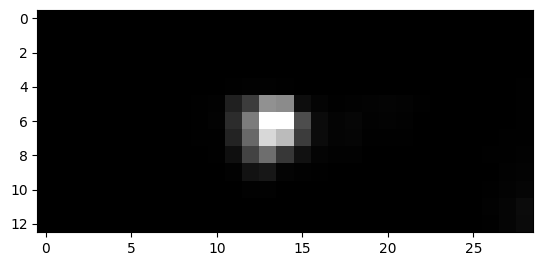

2167


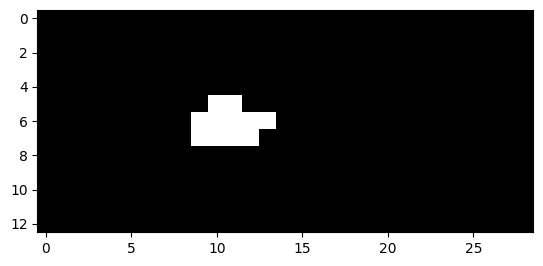

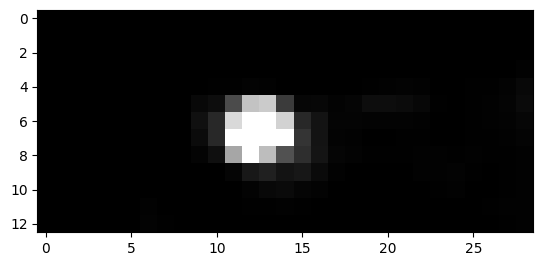

2168


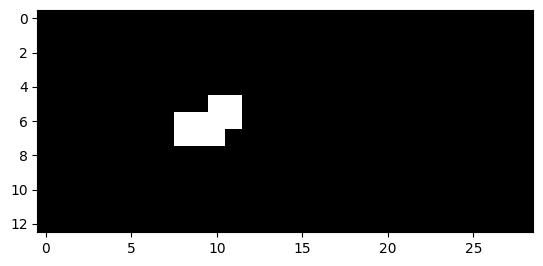

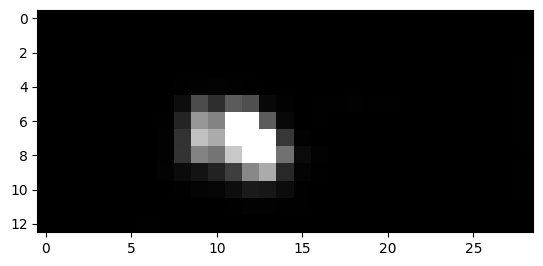

2169


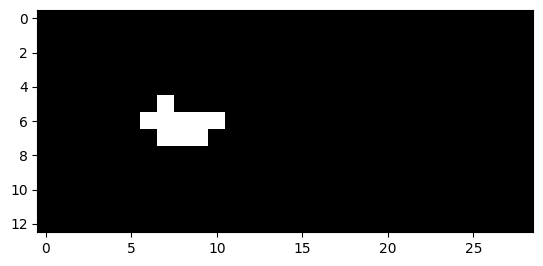

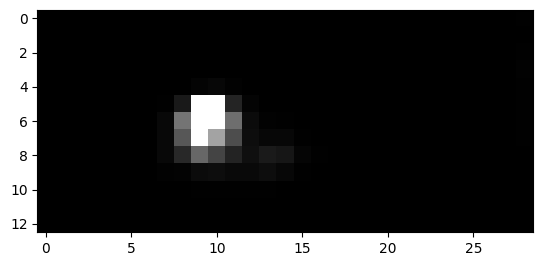

2170


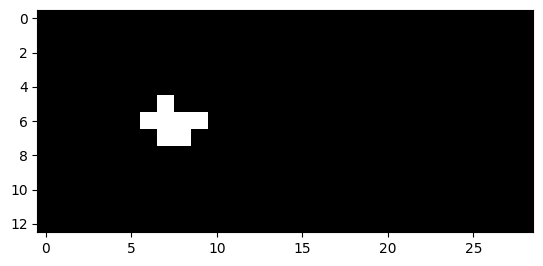

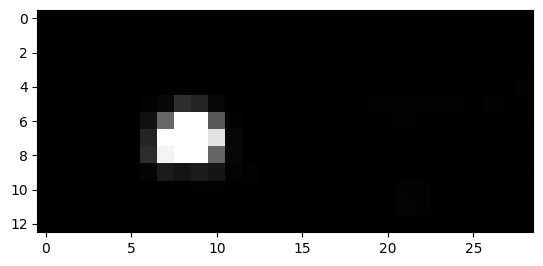

2171


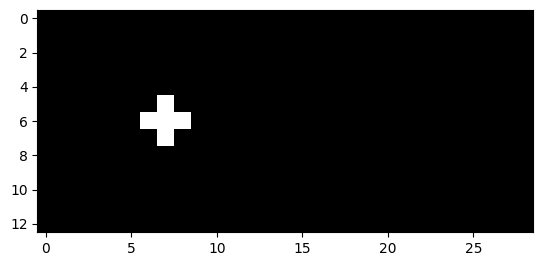

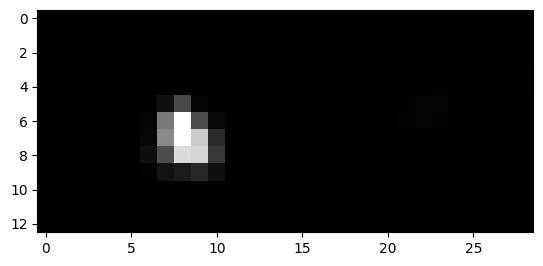

2174


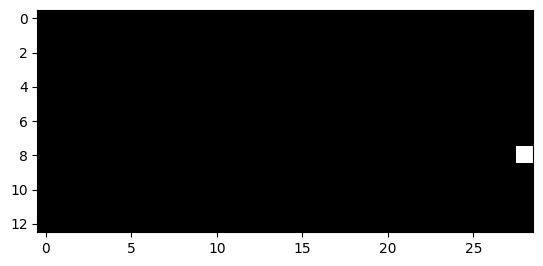

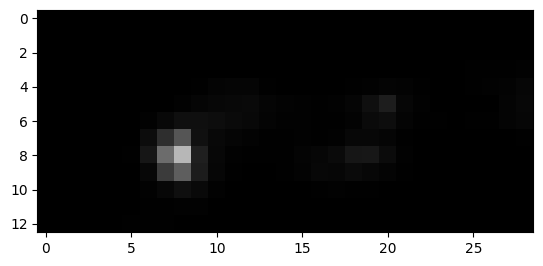

2175


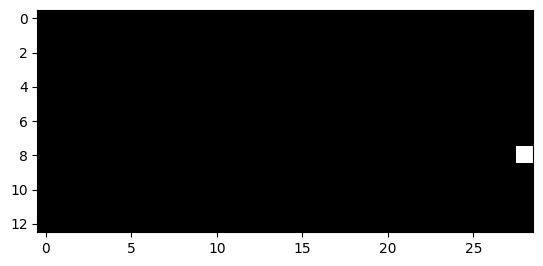

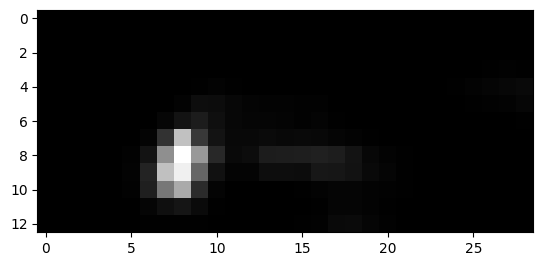

2181


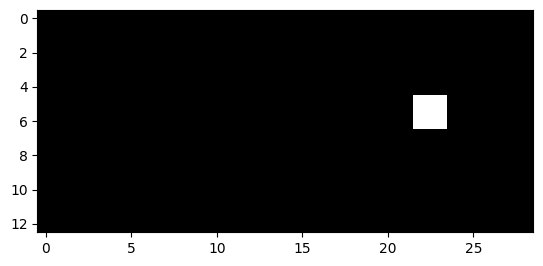

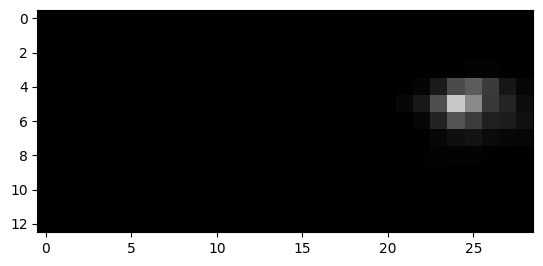

2182


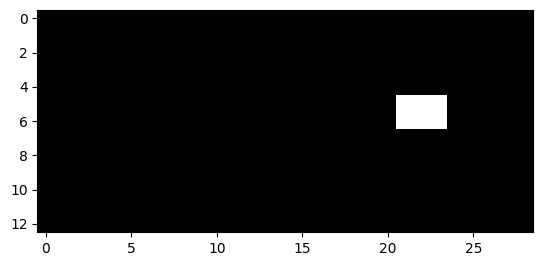

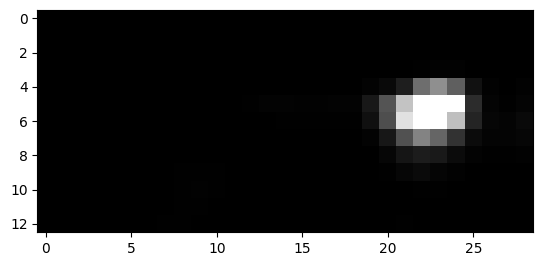

2183


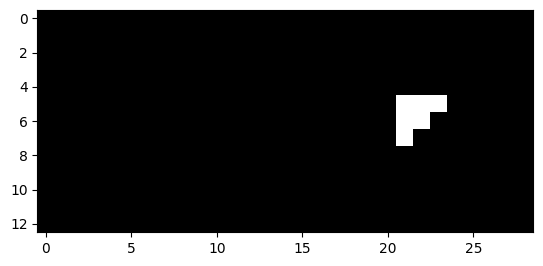

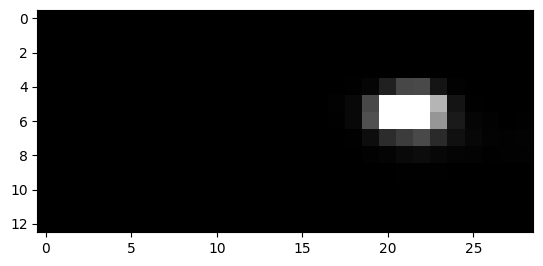

2184


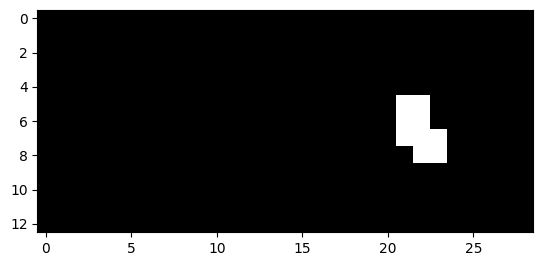

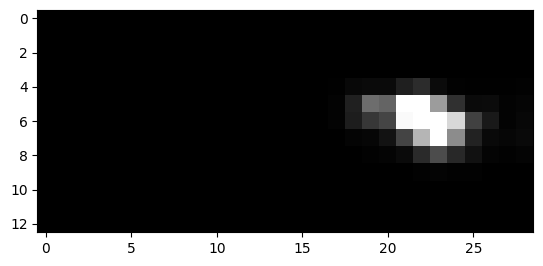

2185


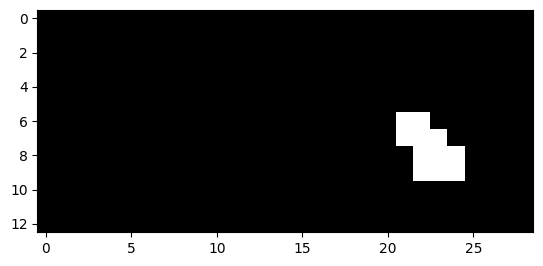

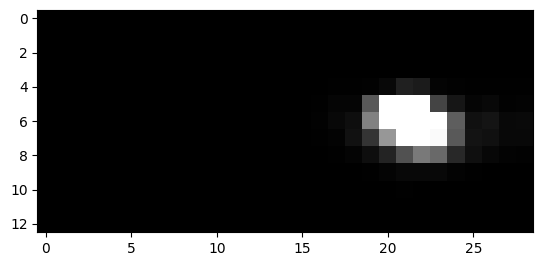

2186


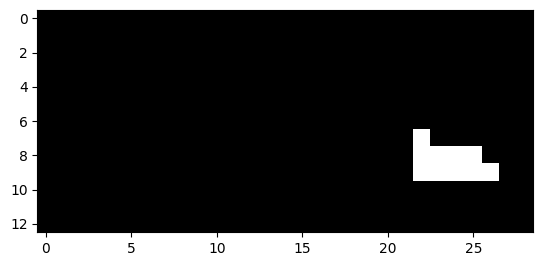

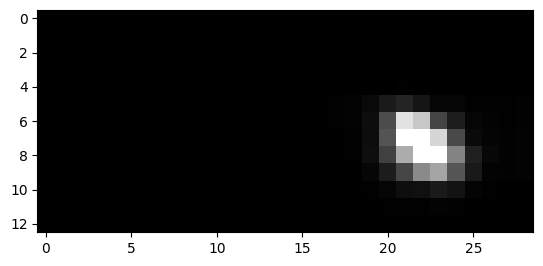

2187


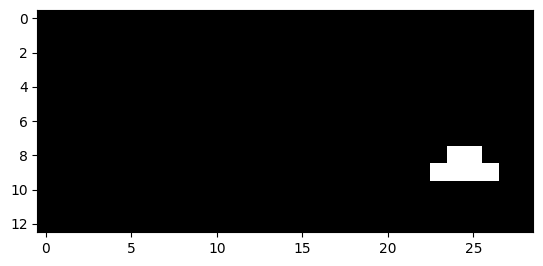

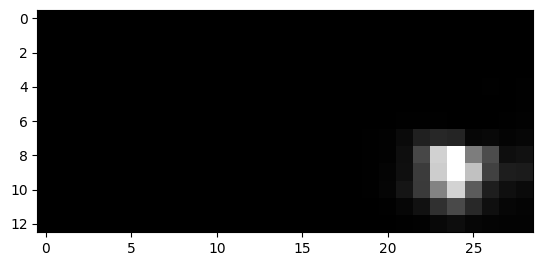

2188


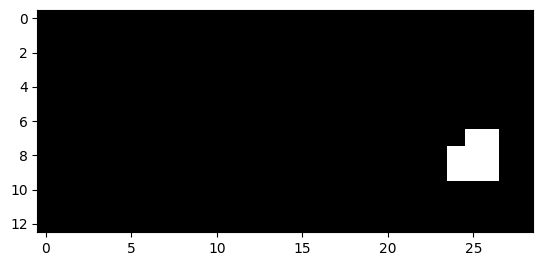

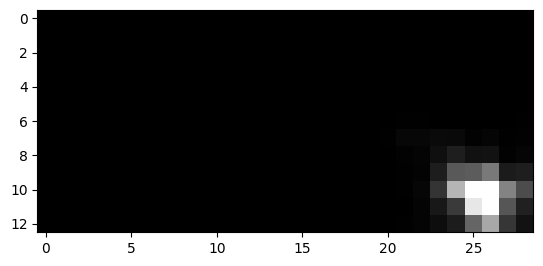

2189


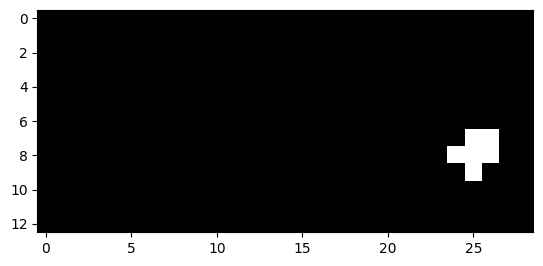

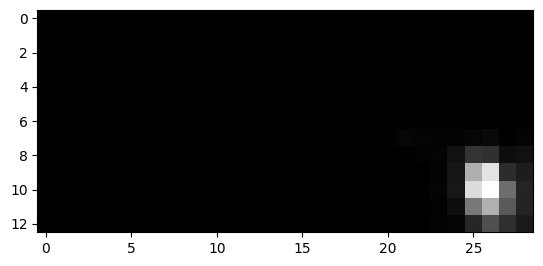

2190


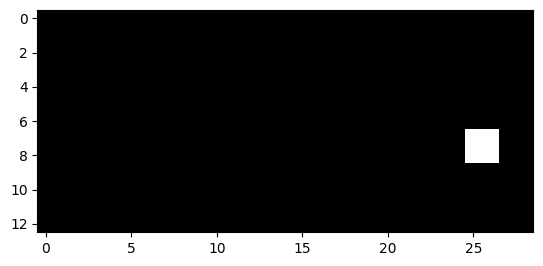

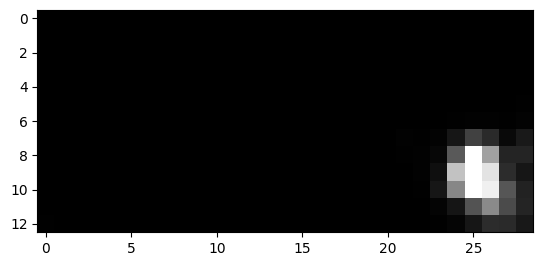

2191


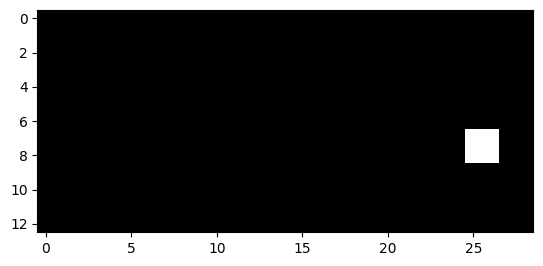

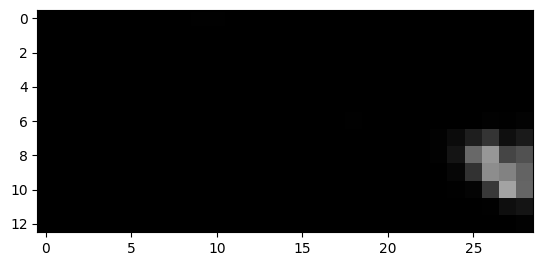

2214


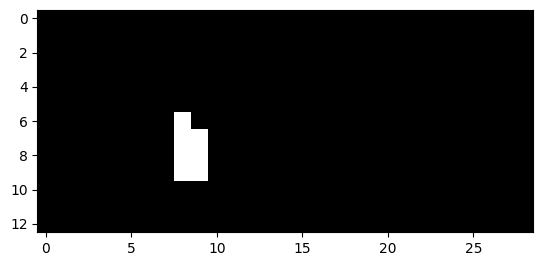

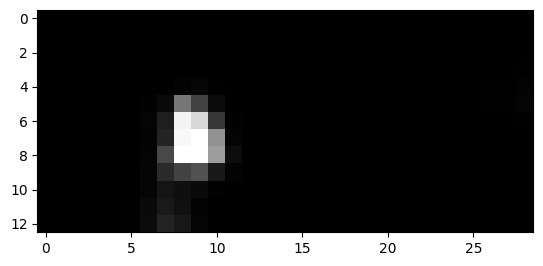

2215


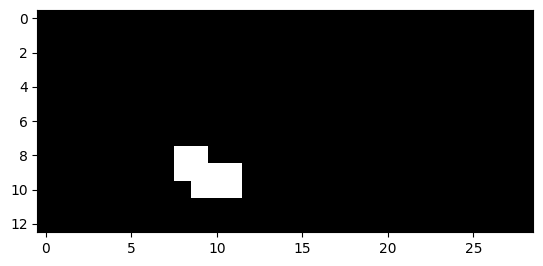

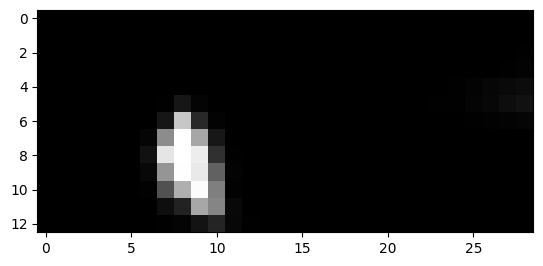

2216


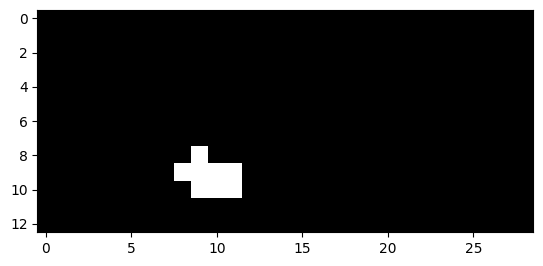

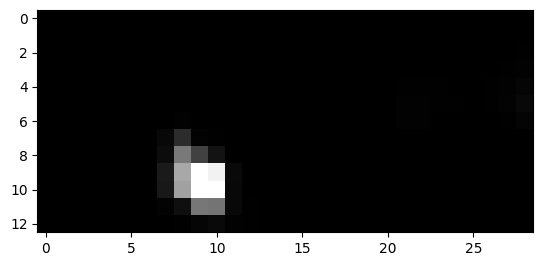

2226


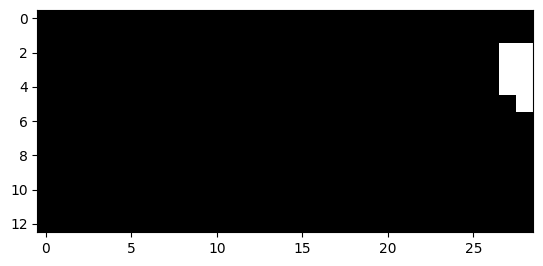

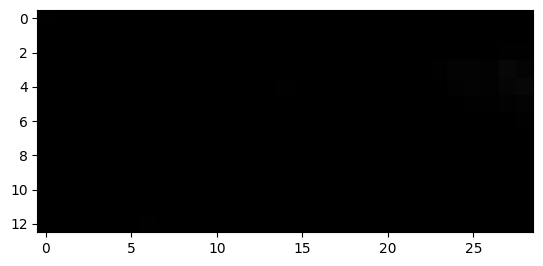

2227


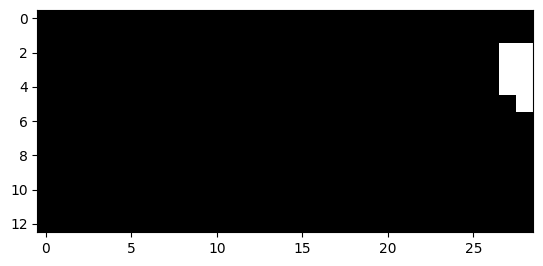

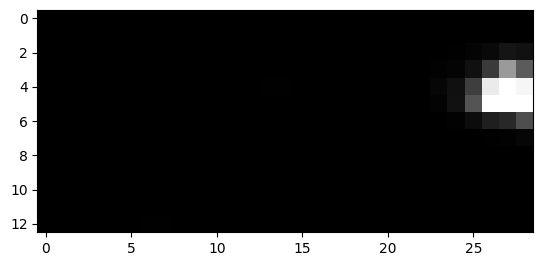

2228


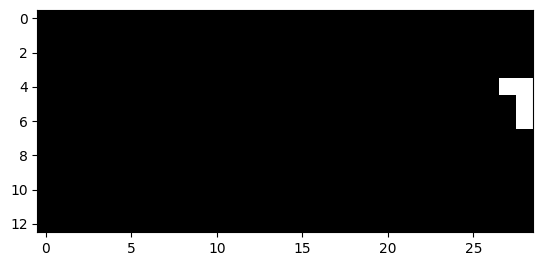

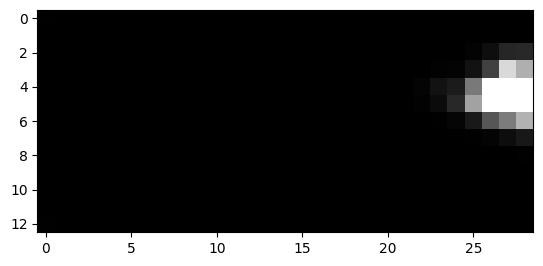

2229


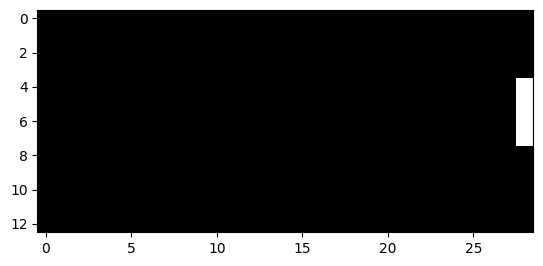

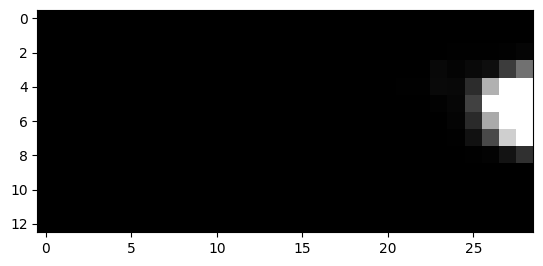

2230


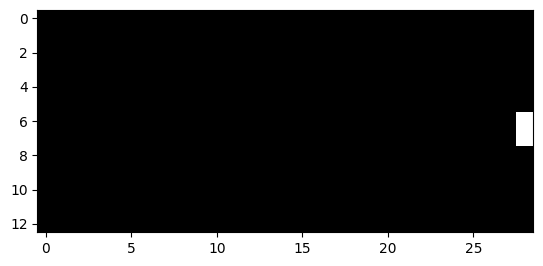

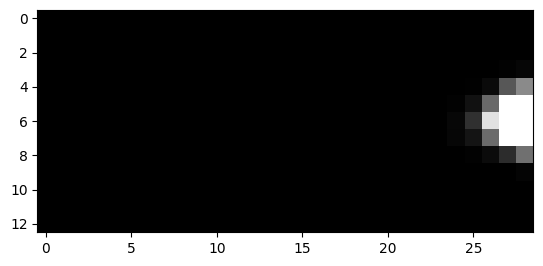

IndexError: index 2466 is out of bounds for axis 0 with size 2466

In [26]:
from sklearn.calibration import CalibrationDisplay
from sklearn.metrics import brier_score_loss

for lag in [1]:
    ### Model summary
    model = Sequential()
    model.add(layers.Input(shape=(13, 29, 9)))
    
    model.add(layers.Conv2D(8, (3,3), activation='relu', padding='same'))
    model.add(layers.MaxPooling2D((2, 2), padding='same'))

    model.add(layers.Conv2D(8, (3,3), activation='relu', padding='same'))
    model.add(layers.UpSampling2D((2,2)))
    
    model.add(layers.Conv2D(1, (3, 3), activation='sigmoid', padding='same')) # sigmoidal activation to have probabilities
    
    model.add(layers.Cropping2D(cropping=((0,1),(0,1))))
    
    model.summary()
    
    
    model.compile(loss='binary_crossentropy', optimizer='adam')
    
    monitor = EarlyStopping(monitor='val_loss', min_delta=1e-5, patience=20, 
            verbose=1, mode='auto', restore_best_weights=True)
    
    ### Model training
    model.fit(train_img_std[:-lag], y_train_img[lag:], validation_data=(val_img_std[:-lag],y_val_img[lag:]),
        callbacks=[monitor],epochs=100)
    
    ### Confusion matrices
    t = model.predict(test_img_std[:-lag])

    ranges = [0.025,0.05,0.075,0.1]
    
    for j in ranges:
        classes = []
        for i in t.reshape(-1,1):
            if i<=j: classes.append(0)
            else: classes.append(1)
    
        ConfusionMatrixDisplay(confusion_matrix(y_test_img[lag:].reshape(-1,1), classes)).plot(colorbar=False,cmap=plt.cm.Blues, values_format='d')
        ConfusionMatrixDisplay(confusion_matrix(y_test_img[lag:].reshape(-1,1), classes, normalize='true')).plot(colorbar=False,cmap=plt.cm.Blues)
    
    ### ROC
    plot_roc(t.reshape(-1,1),y_test_img[lag:].reshape(-1,1))
    
    z = np.zeros((lag,13,29,1))
    tt = np.concatenate((t,z))
    #test['predictions_lag'+str(lag)] = tt.reshape(-1,1)
    #test.to_csv("test_with_newTarget_predictions.csv")
    
    ### calibration
    display = CalibrationDisplay.from_predictions(y_test_img[lag:].reshape(-1,1), t.reshape(-1,1), n_bins=10)
    print(f'All zeros Brier score: {brier_score_loss(y_test_img[lag:].reshape(-1,1), np.zeros(len(y_test_img[lag:].reshape(-1,1))))}')
    print(f'Model Brier score: {brier_score_loss(y_test_img[lag:].reshape(-1,1), t.reshape(-1,1))}')
    
    # plot of first 10000
    k=0
    for i in range(10000): 
        if(np.max(y_test_img[i].reshape(-1))>0.1):
            print(i)
            plt.figure()
            plt.imshow(y_test_img[i], cmap = "gray", vmin=0, vmax=1)
            plt.show()
            plt.imshow(t[i-lag], vmin=0, vmax=0.3, cmap = "gray")
            plt.show()
            k+=1
    print(k)
    

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_24 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_8 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_25 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_8 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_26 (Conv2D)          (None, 14, 30, 1)         73        
                                                                 
 cropping2d_8 (Cropping2D)   (None, 13, 29, 1)        

2023-05-31 13:28:59.890517: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - ETA: 0s - loss: 0.0674

2023-05-31 13:29:04.253159: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


354/354 [==============================] - 5s 12ms/step - loss: 0.0674 - val_loss: 0.0200
Epoch 2/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0211 - val_loss: 0.0173
Epoch 3/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0189 - val_loss: 0.0169
Epoch 4/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0180 - val_loss: 0.0163
Epoch 5/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0174 - val_loss: 0.0156
Epoch 6/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0168 - val_loss: 0.0151
Epoch 7/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0164 - val_loss: 0.0150
Epoch 8/100
354/354 [==============================] - 3s 8ms/step - loss: 0.0161 - val_loss: 0.0150
Epoch 9/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0160 - val_loss: 0.0145
Epoch 10/100
354/354 [==============================] - 3s 7ms/step - loss: 0.0157 - val_loss: 0.0144


2023-05-31 13:31:27.431488: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


77/77 [==============================] - 0s 3ms/step


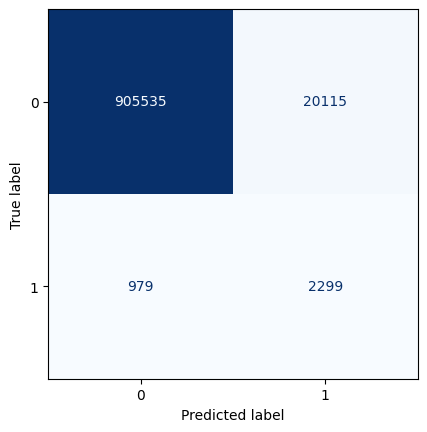

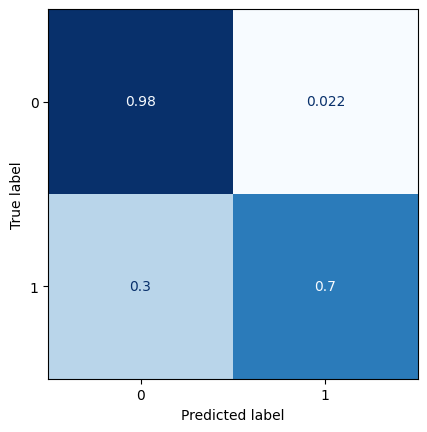

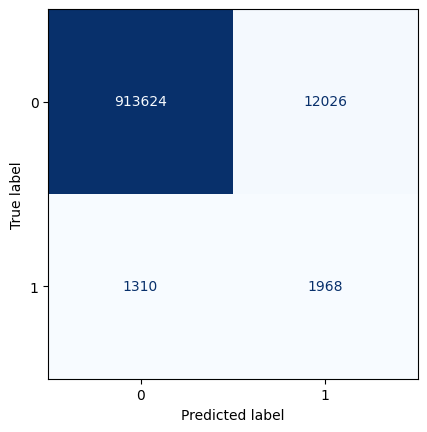

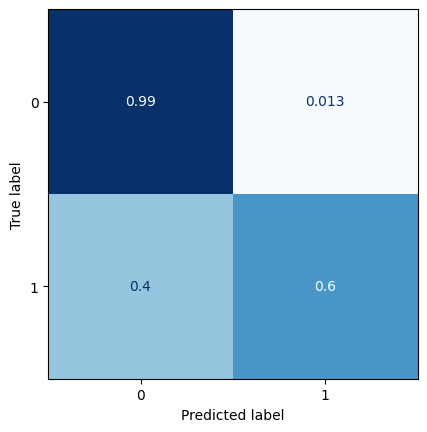

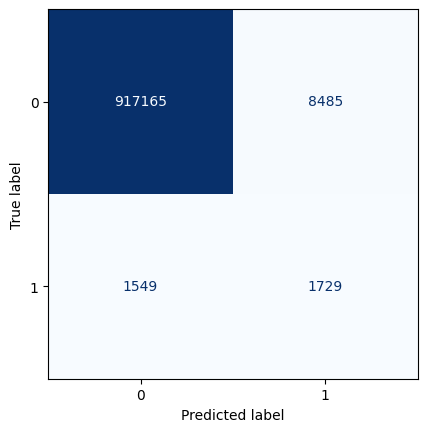

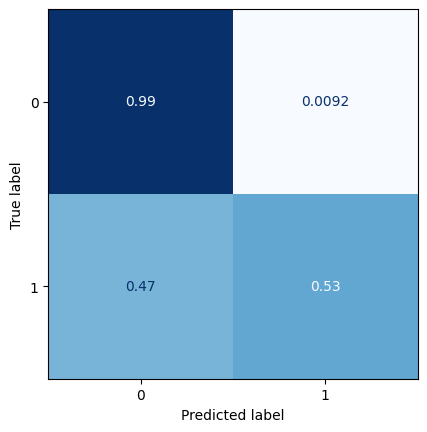

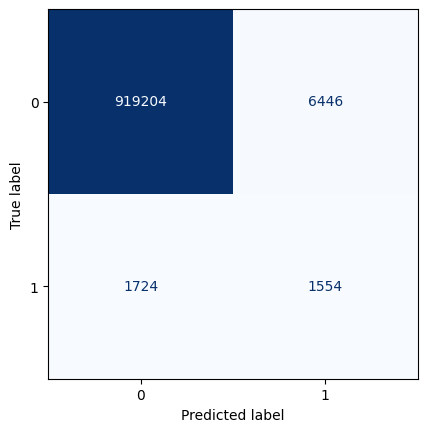

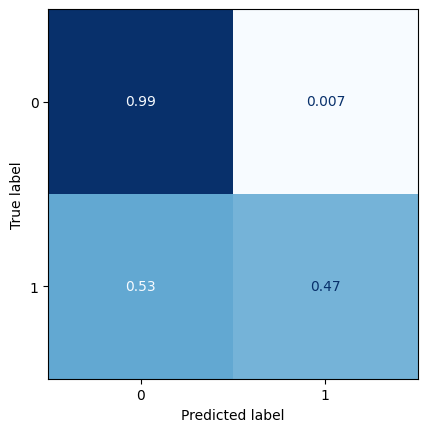

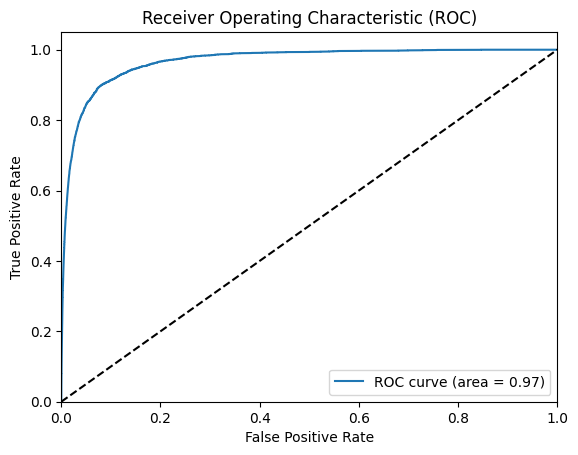

All zeros Brier score: 0.003528798787419477
Model Brier score: 0.003102126174651733
9


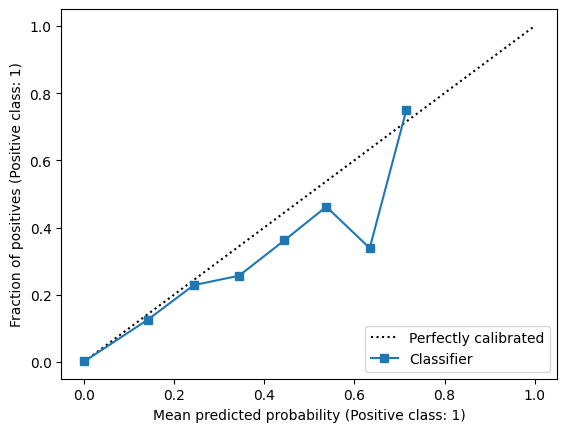

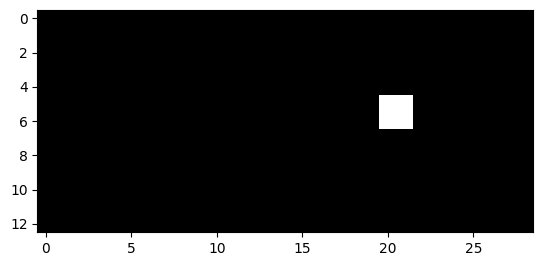

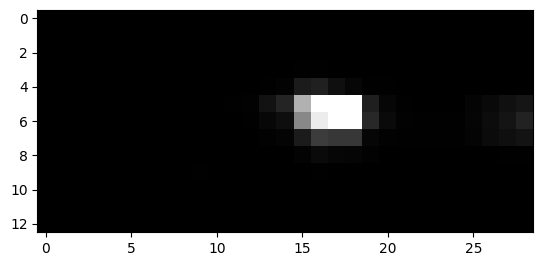

10


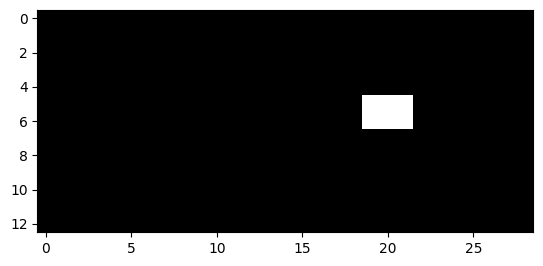

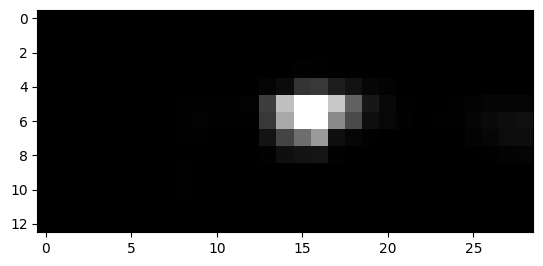

11


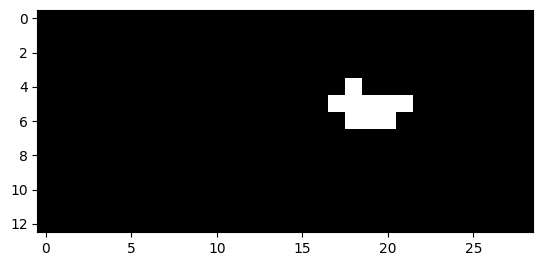

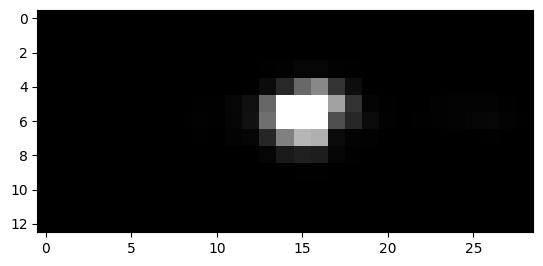

12


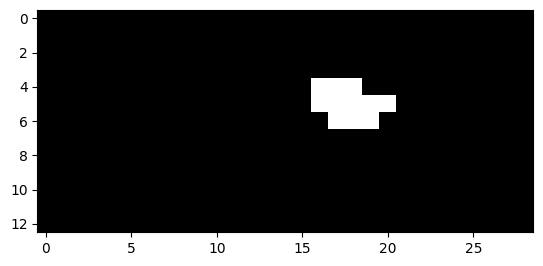

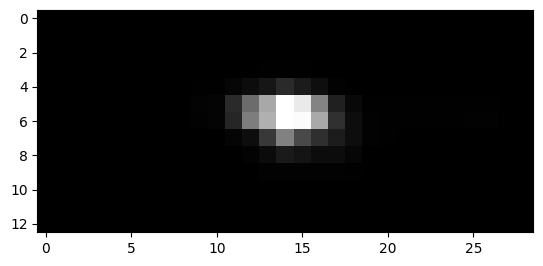

13


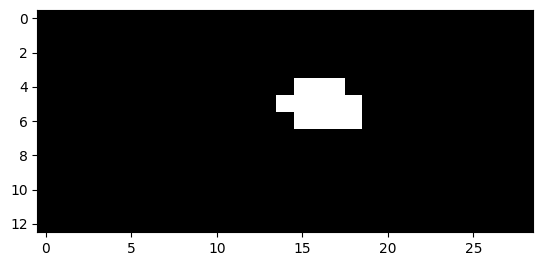

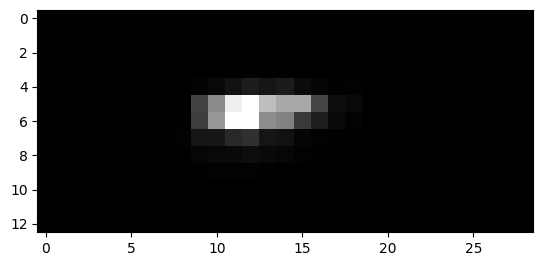

14


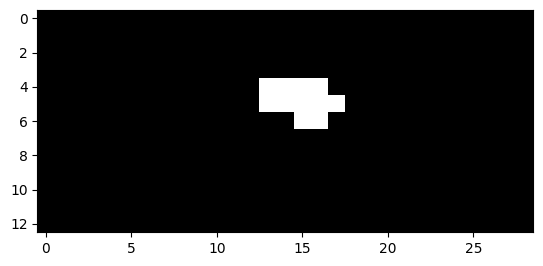

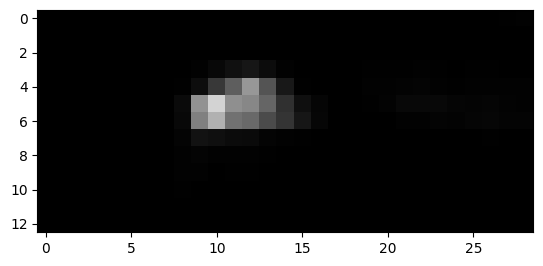

15


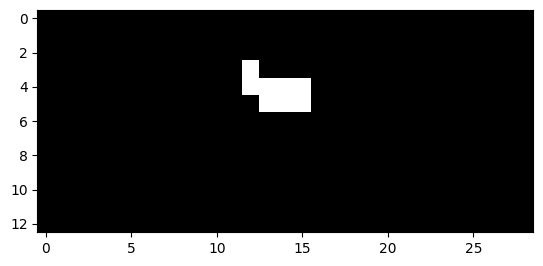

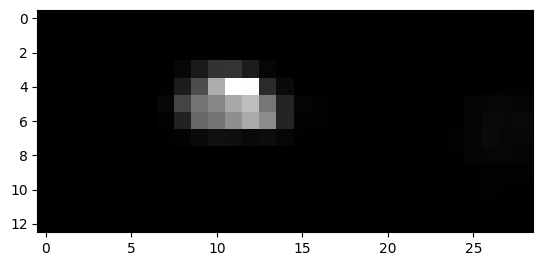

16


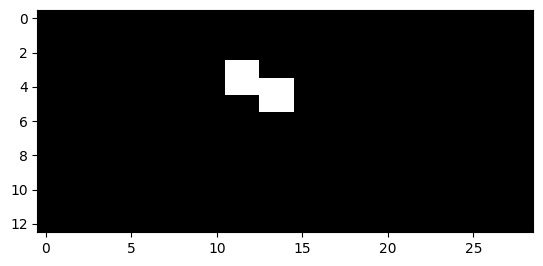

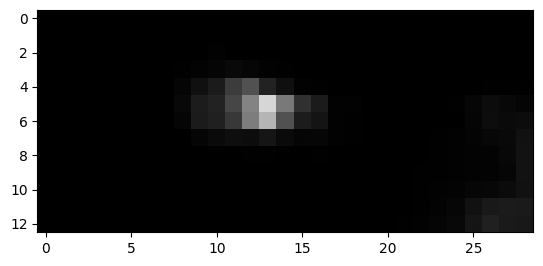

17


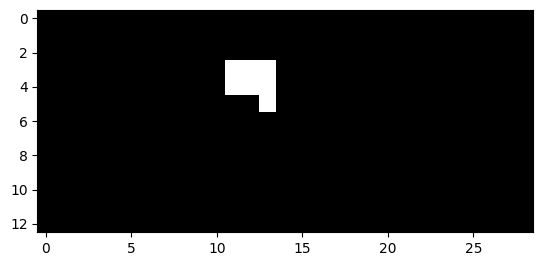

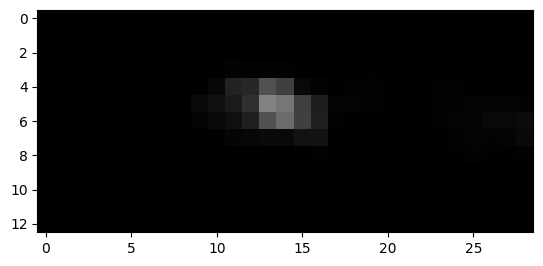

18


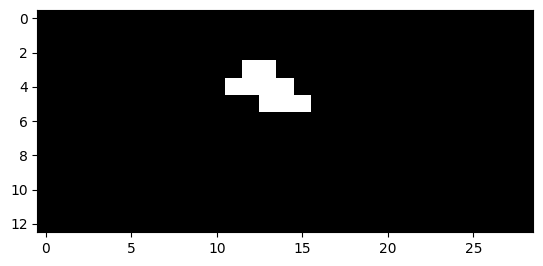

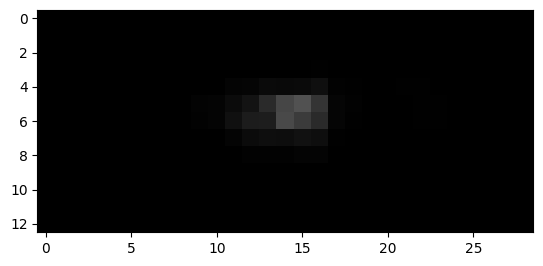

19


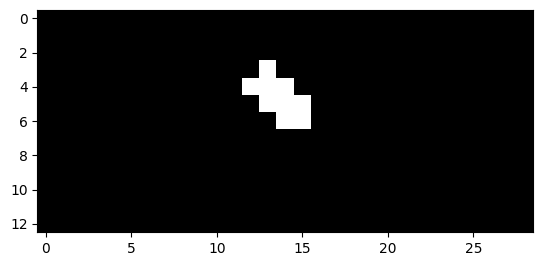

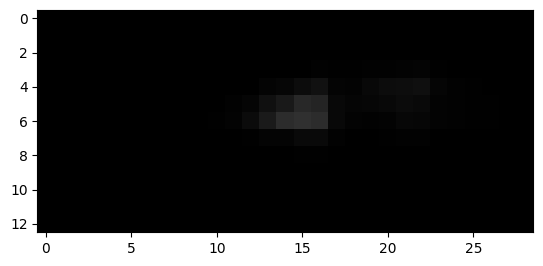

20


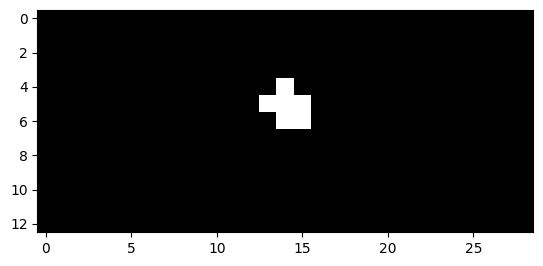

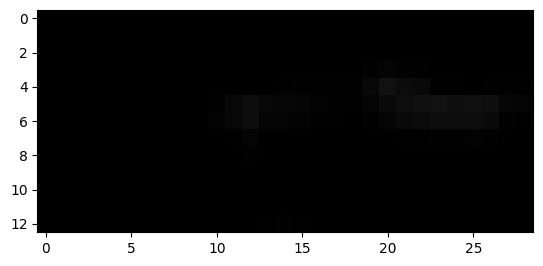

21


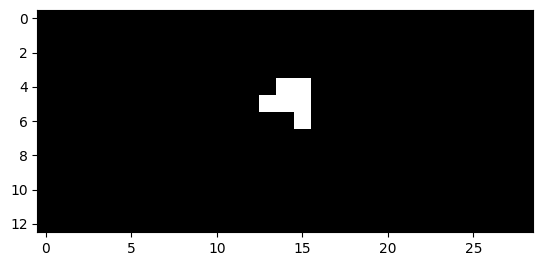

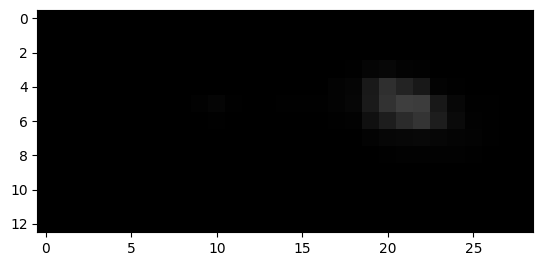

22


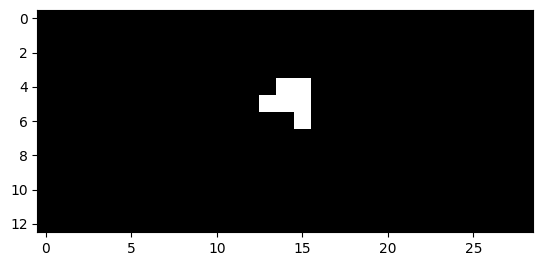

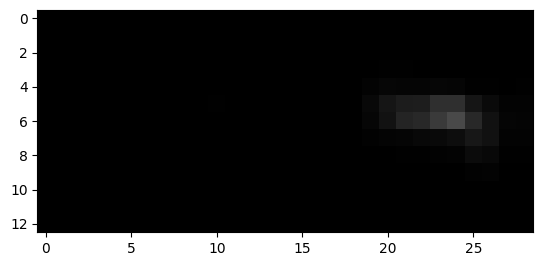

105


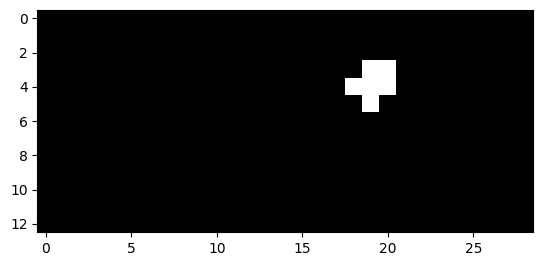

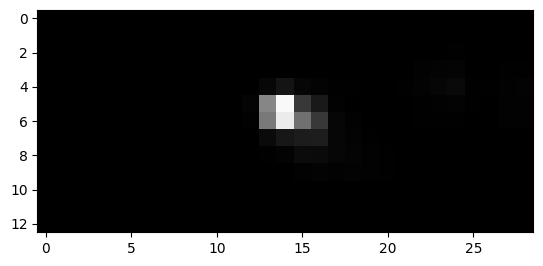

106


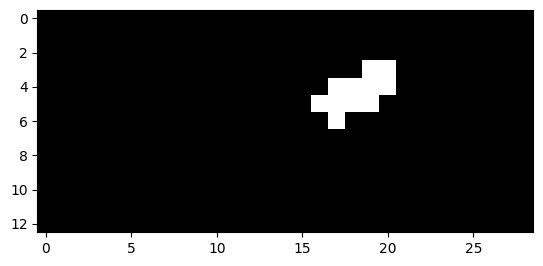

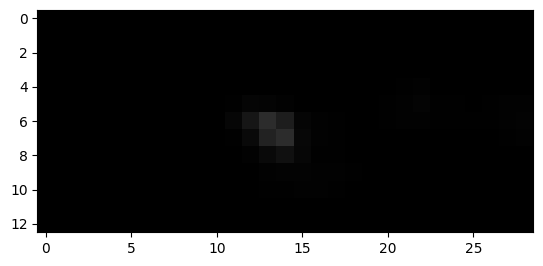

107


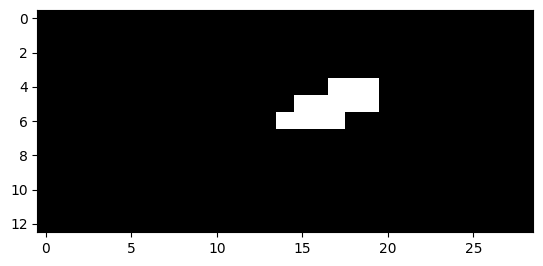

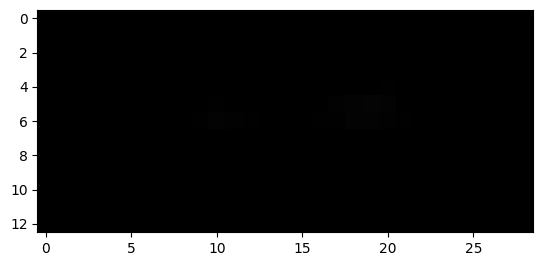

108


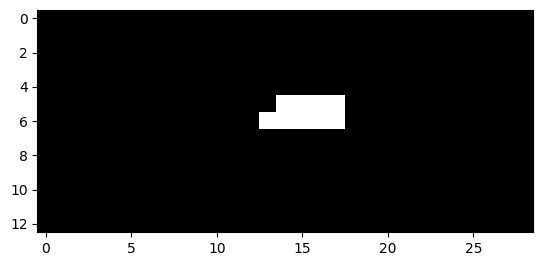

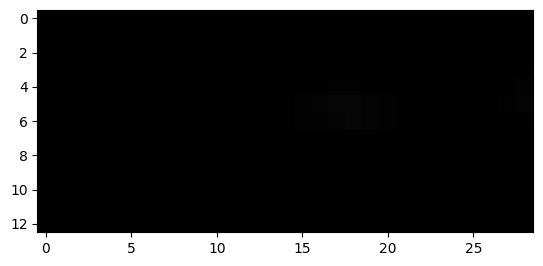

109


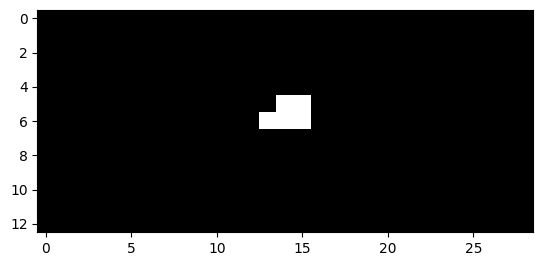

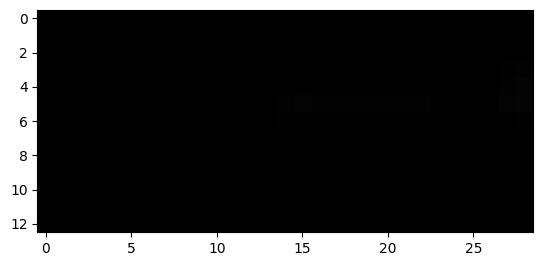

184


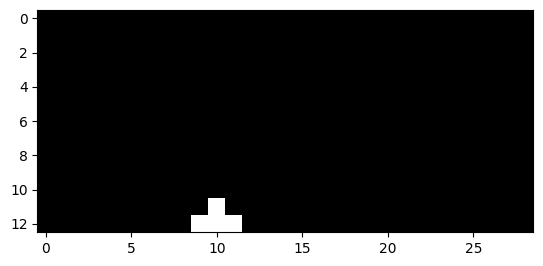

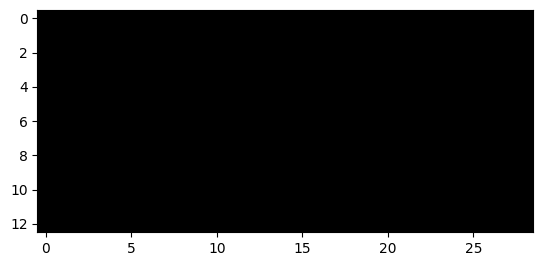

185


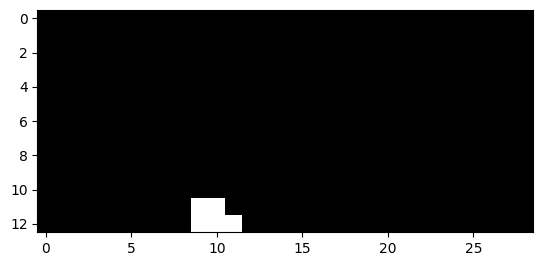

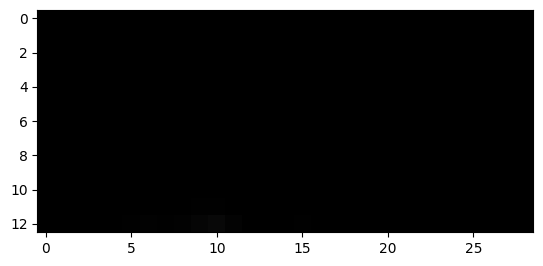

186


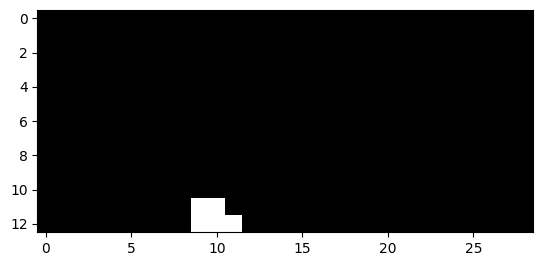

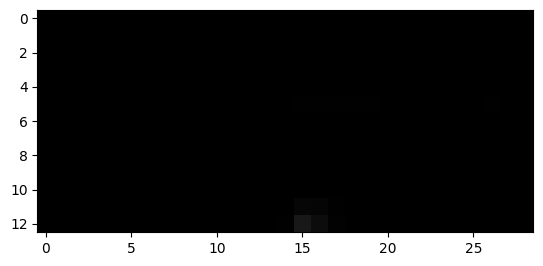

187


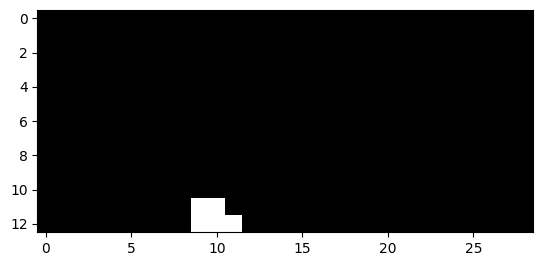

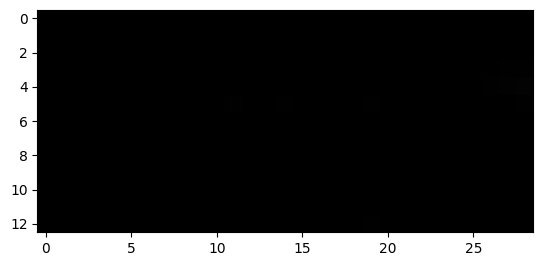

188


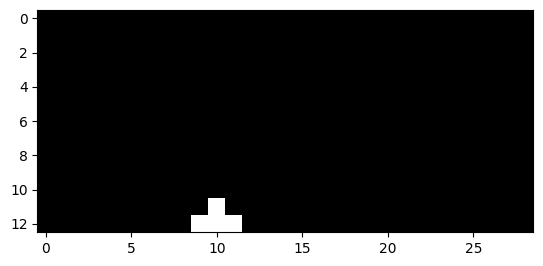

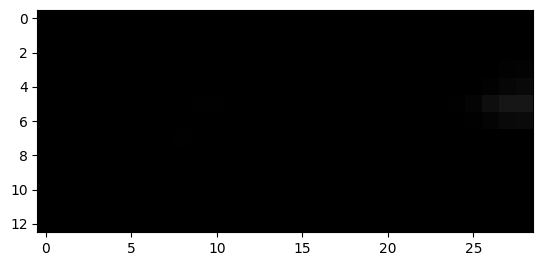

308


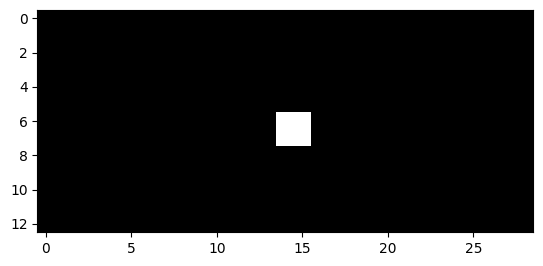

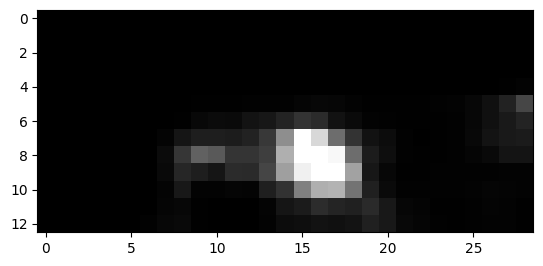

309


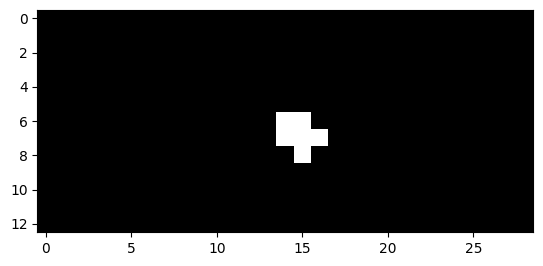

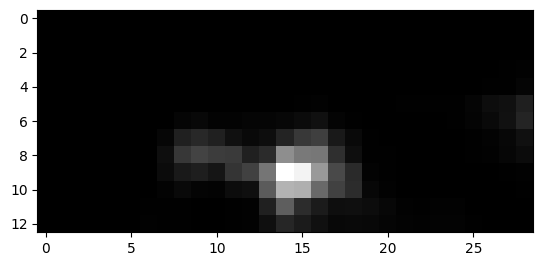

310


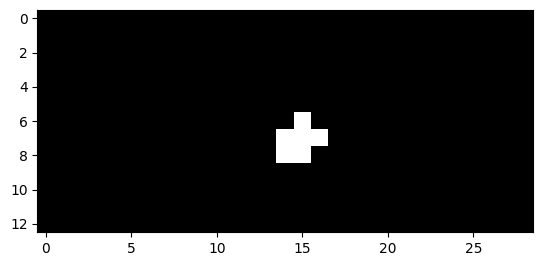

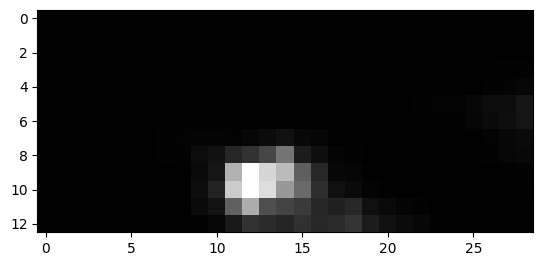

311


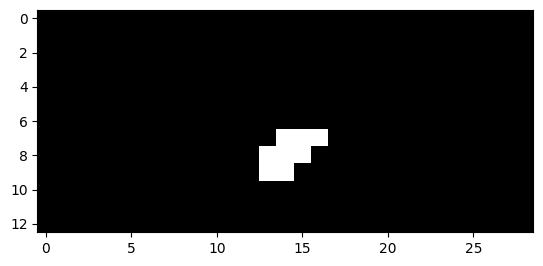

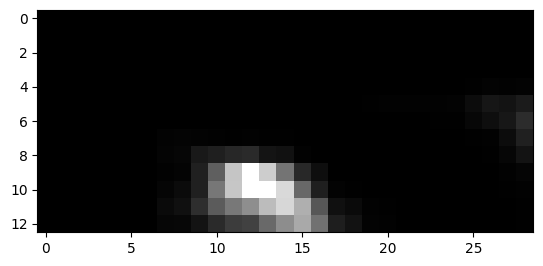

312


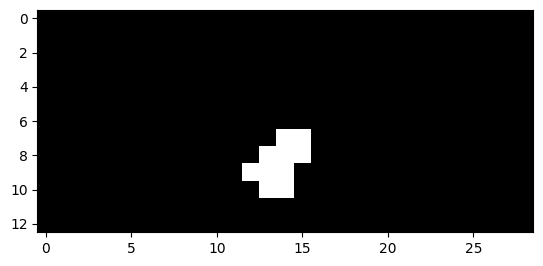

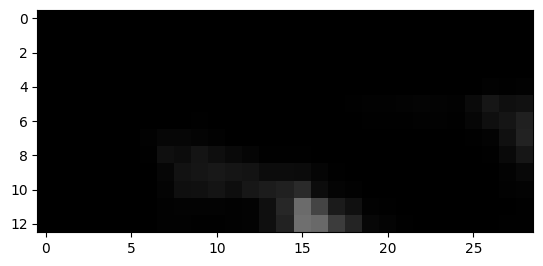

313


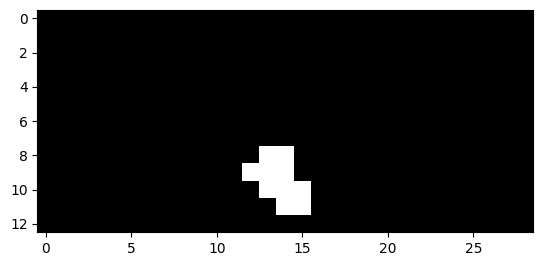

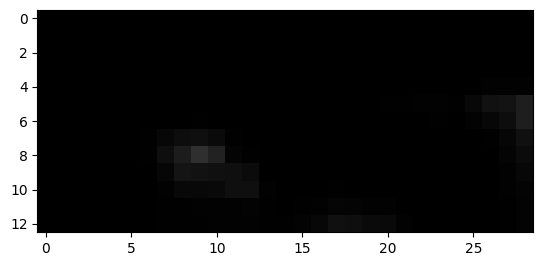

314


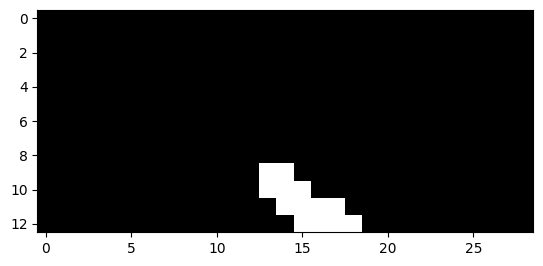

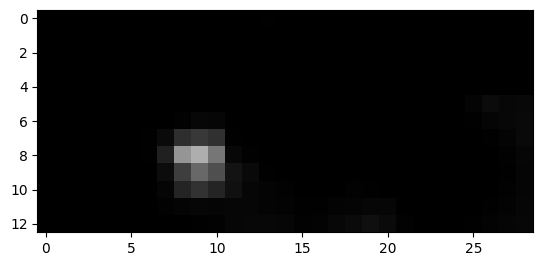

315


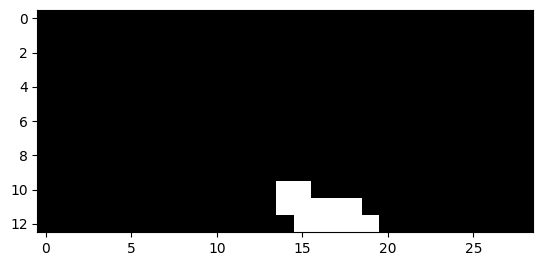

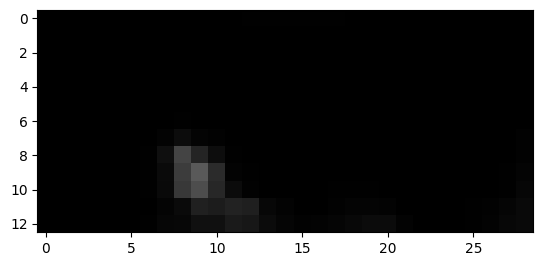

316


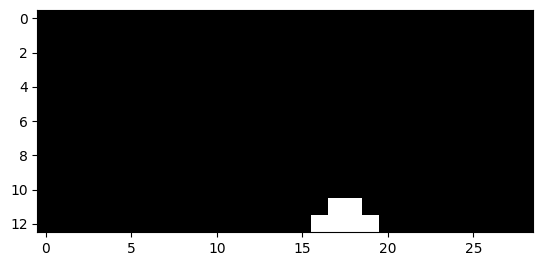

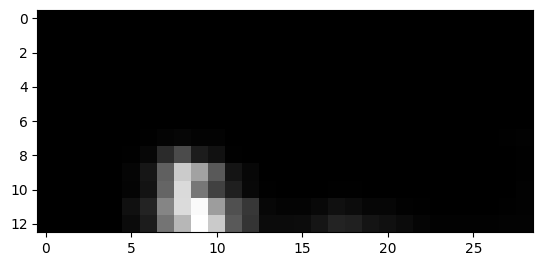

317


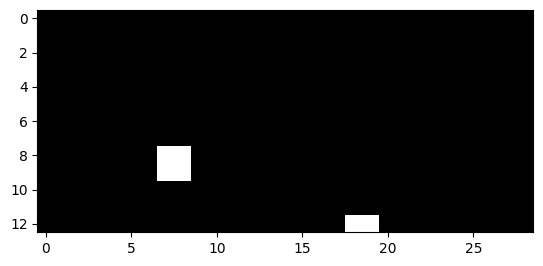

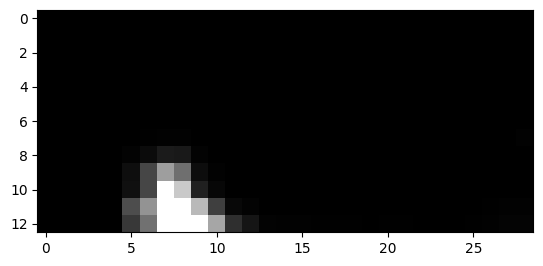

318


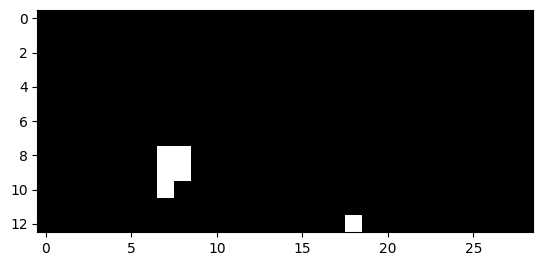

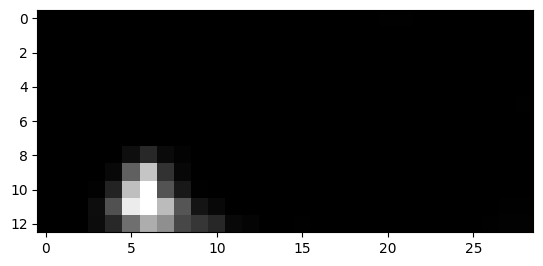

319


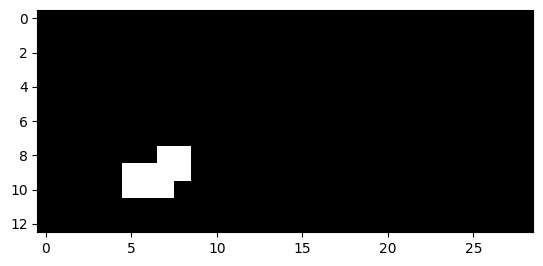

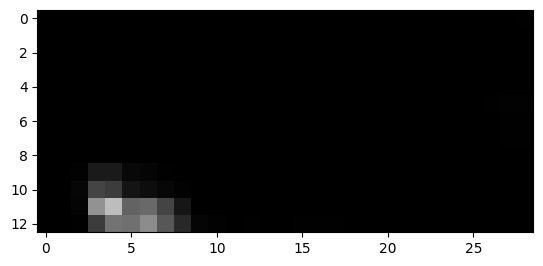

320


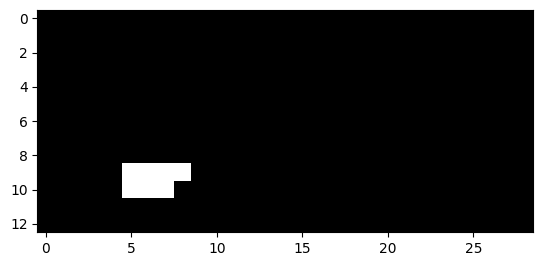

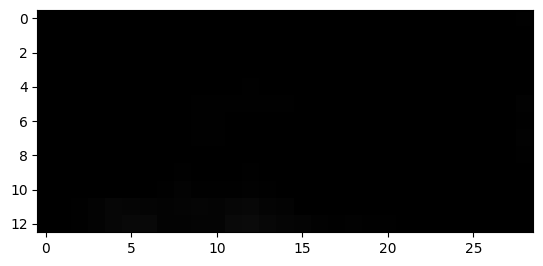

321


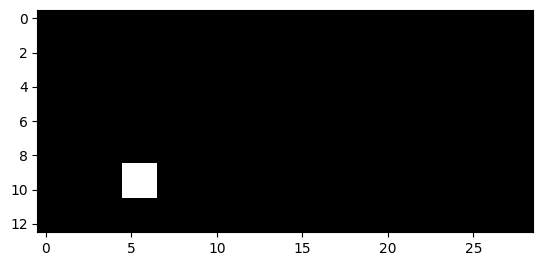

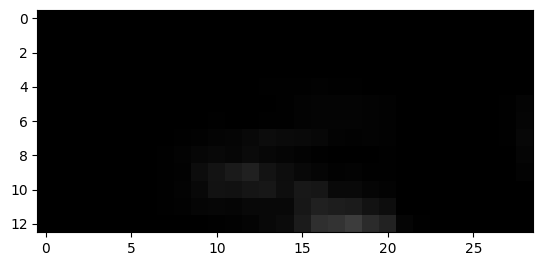

335


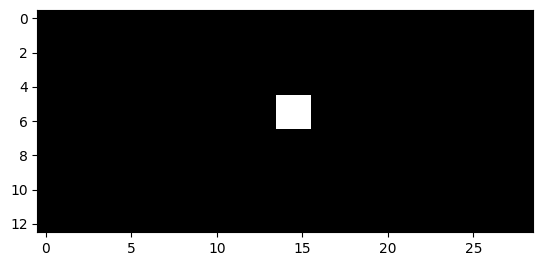

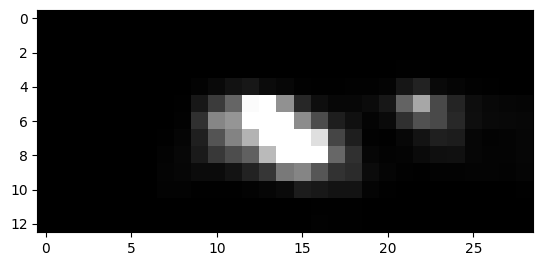

336


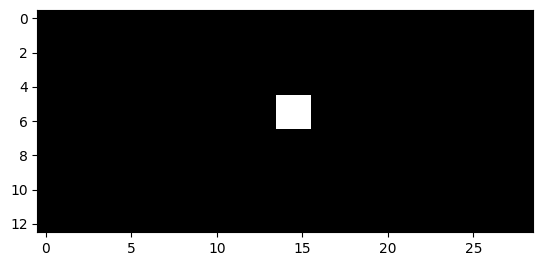

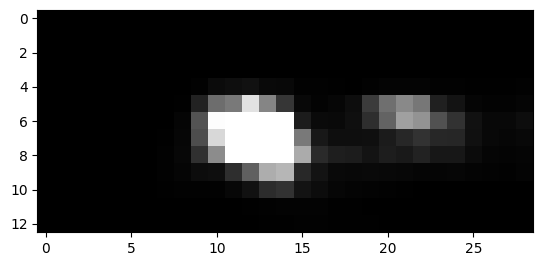

337


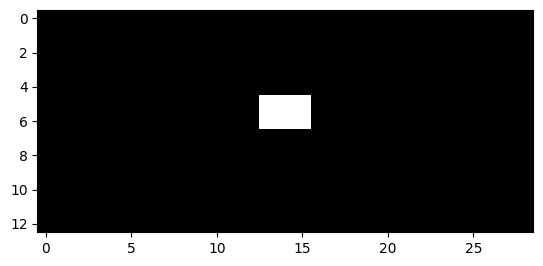

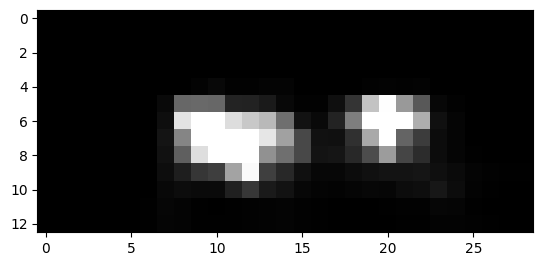

338


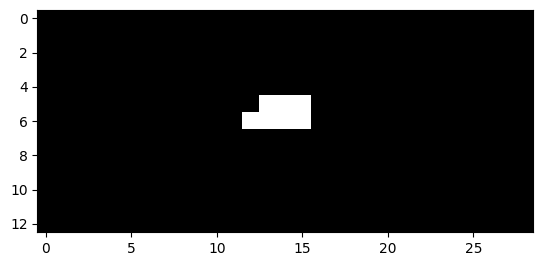

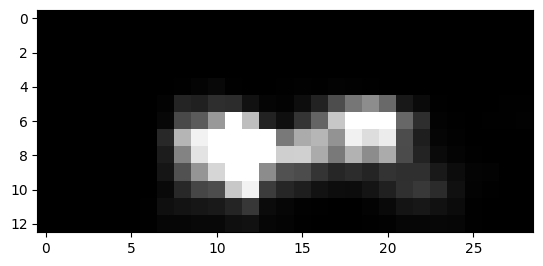

339


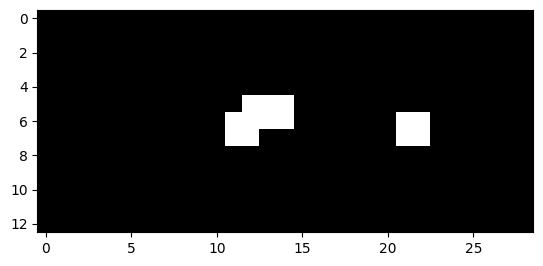

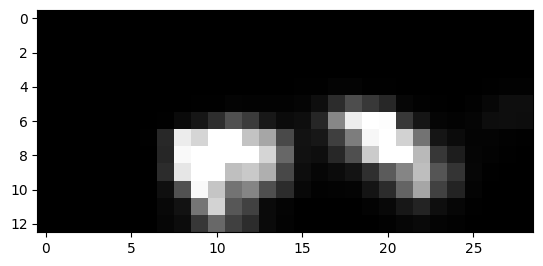

340


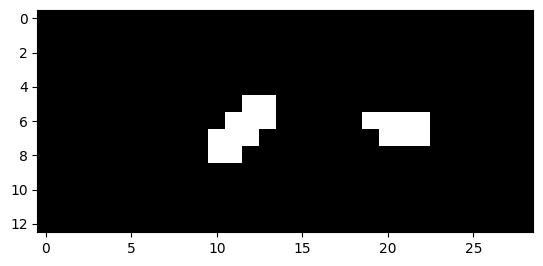

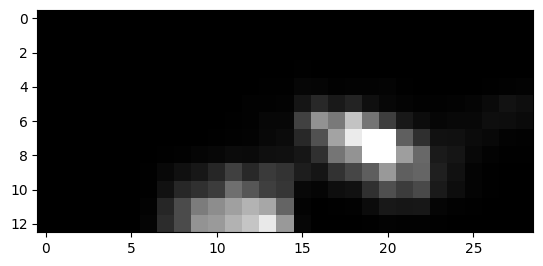

341


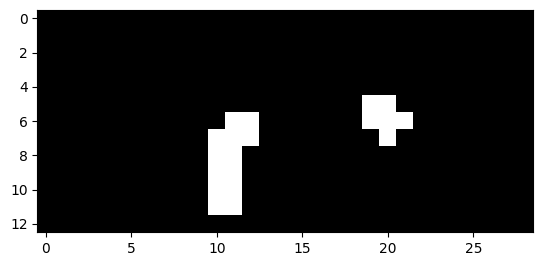

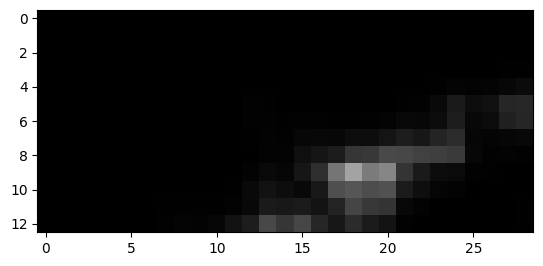

342


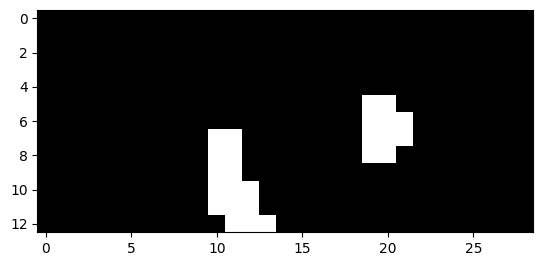

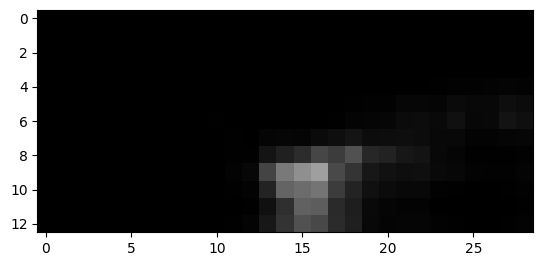

343


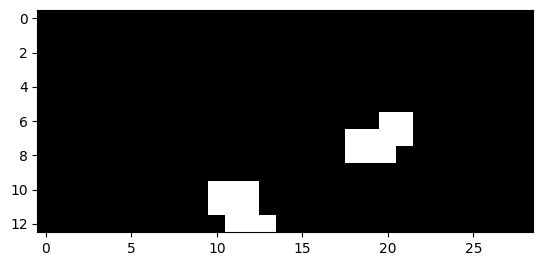

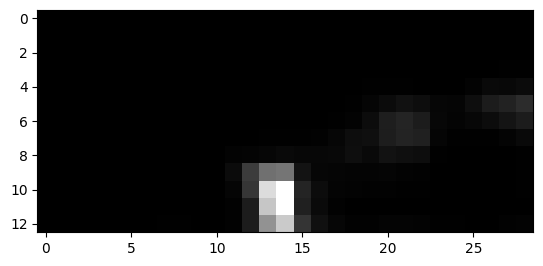

344


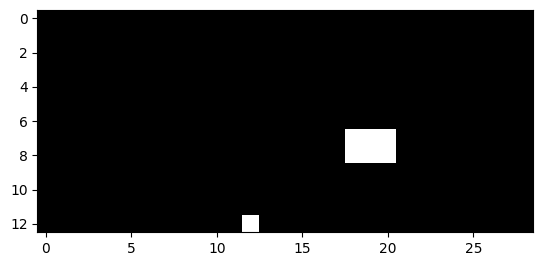

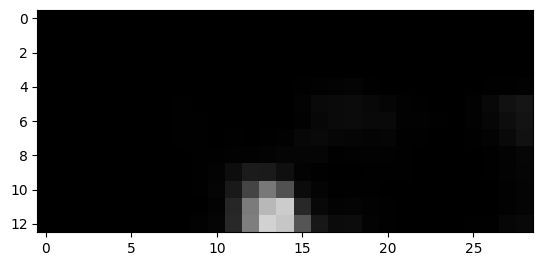

346


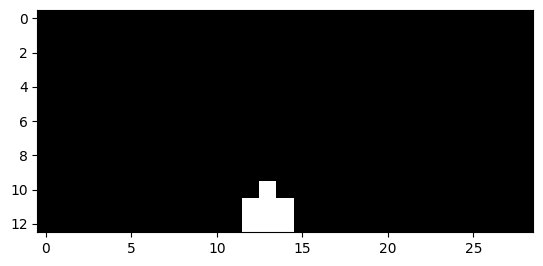

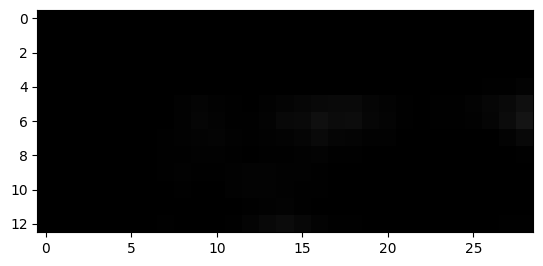

347


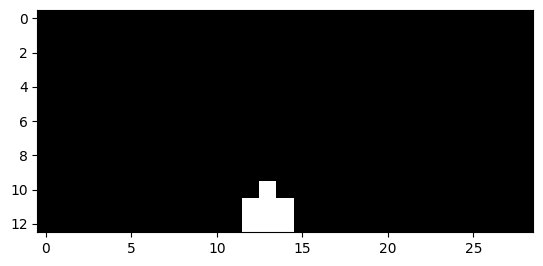

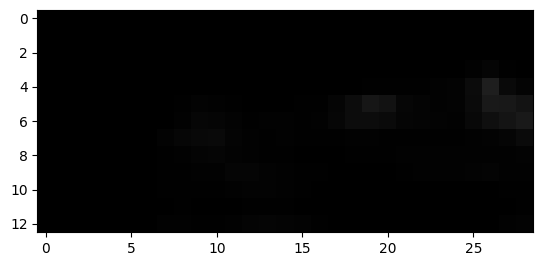

348


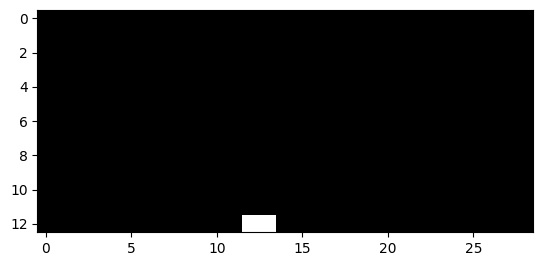

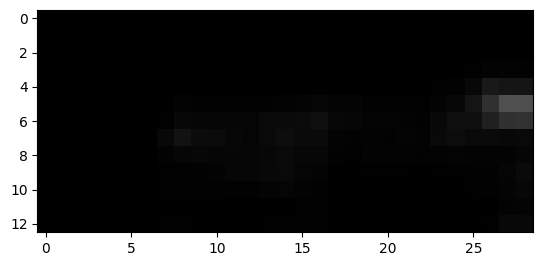

640


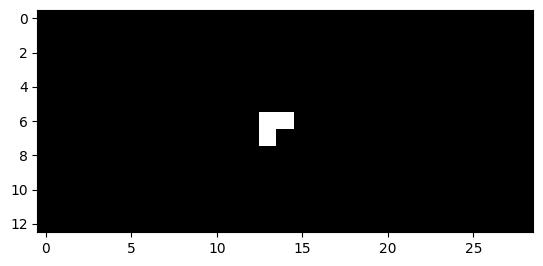

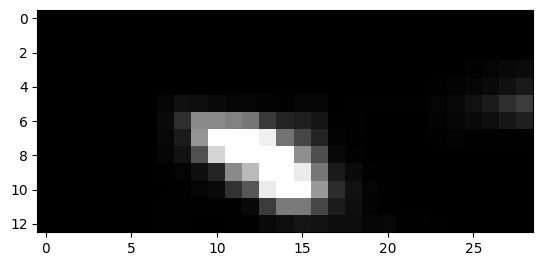

641


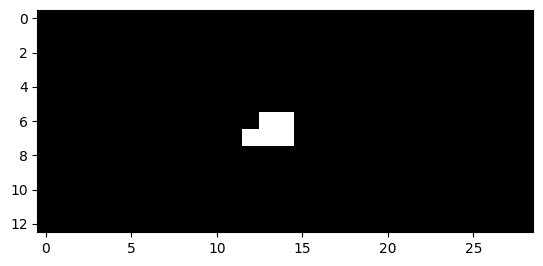

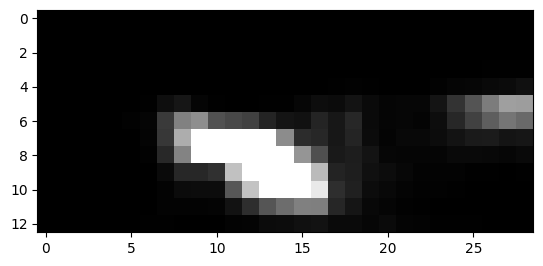

642


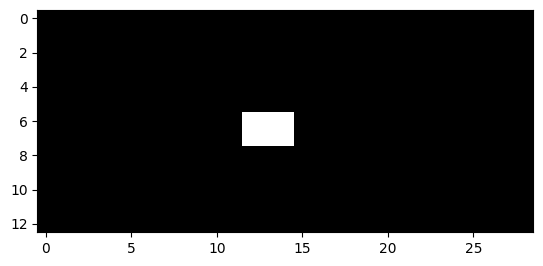

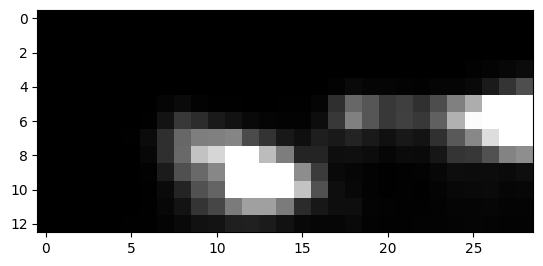

643


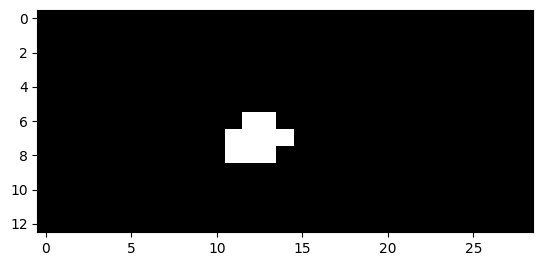

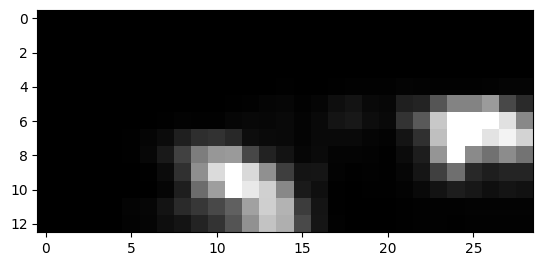

644


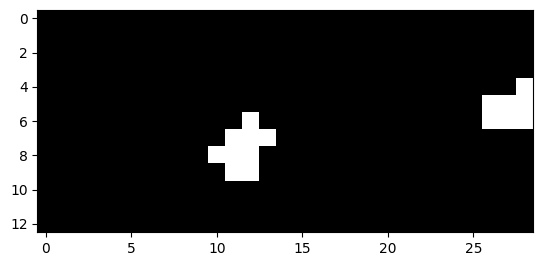

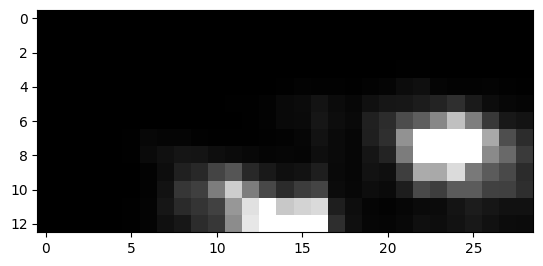

645


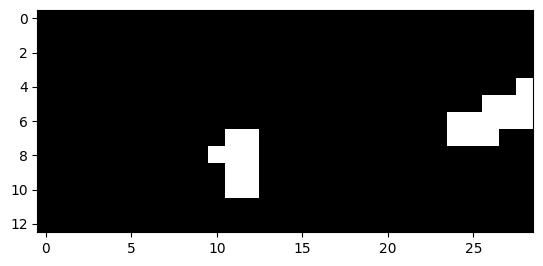

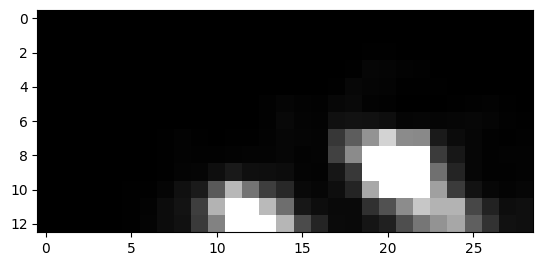

646


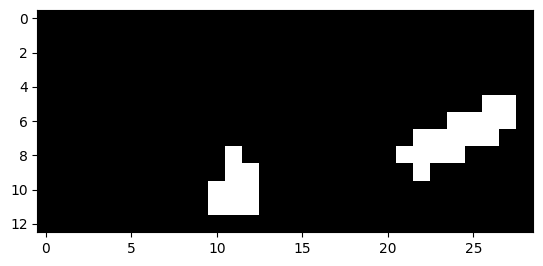

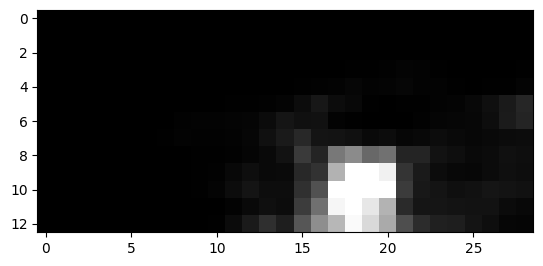

647


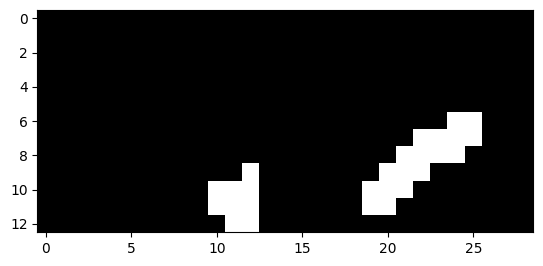

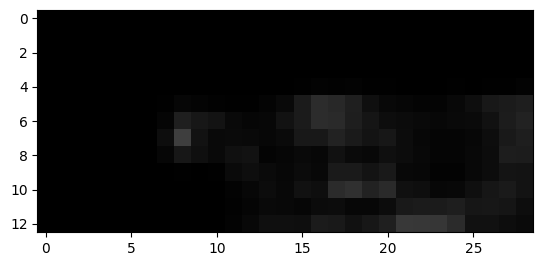

648


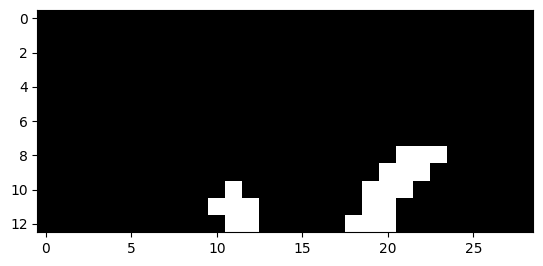

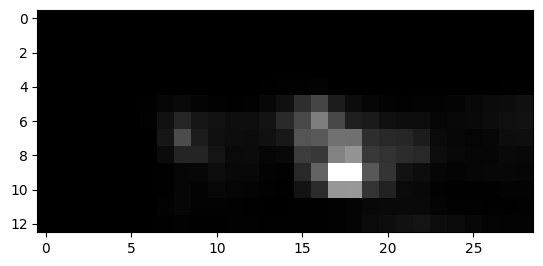

649


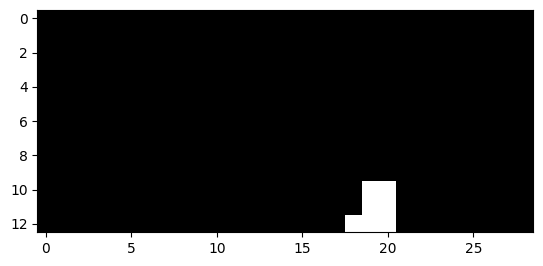

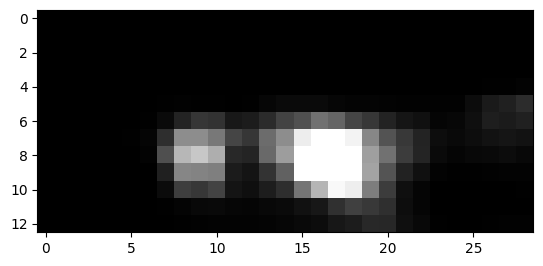

651


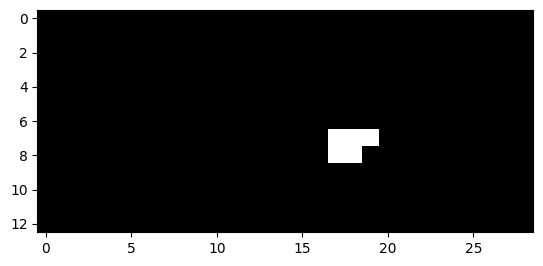

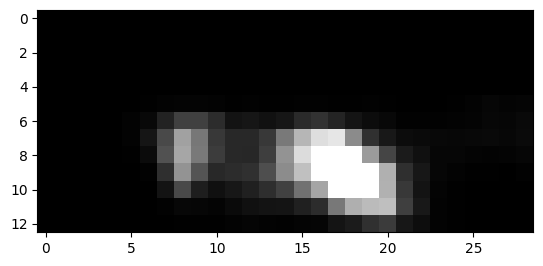

652


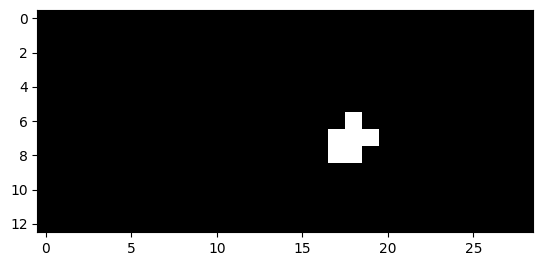

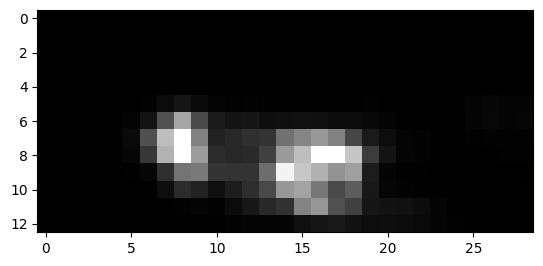

653


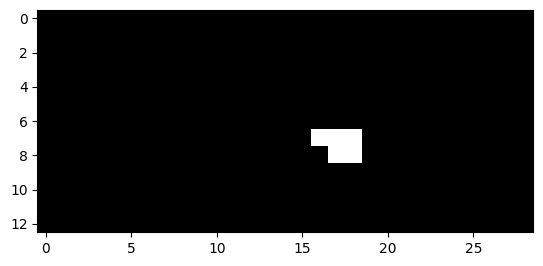

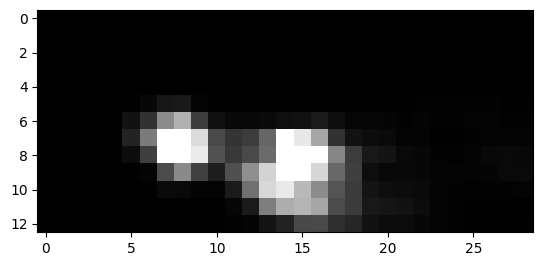

654


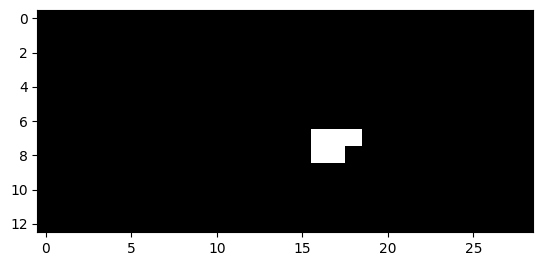

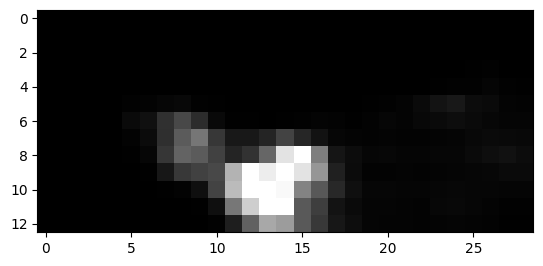

655


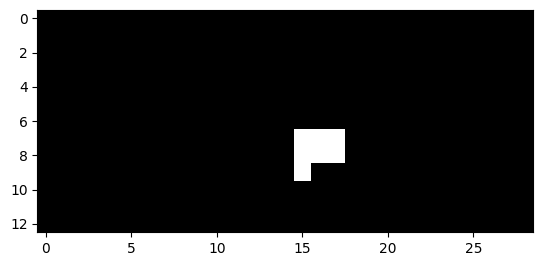

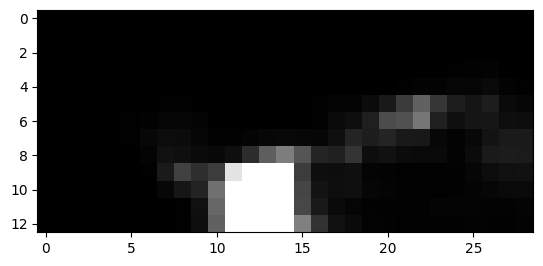

656


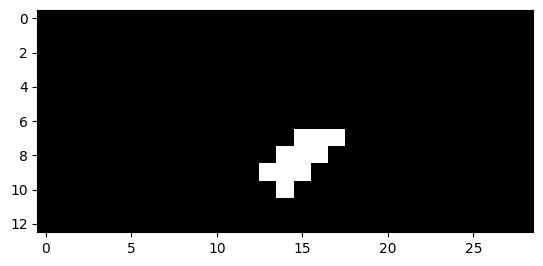

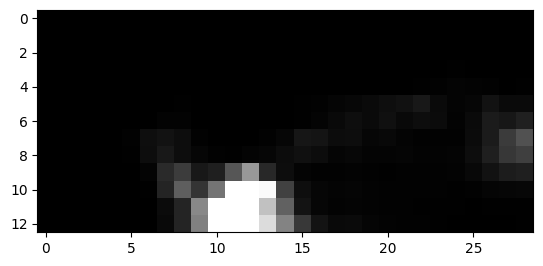

657


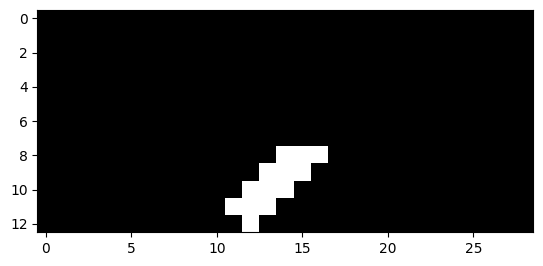

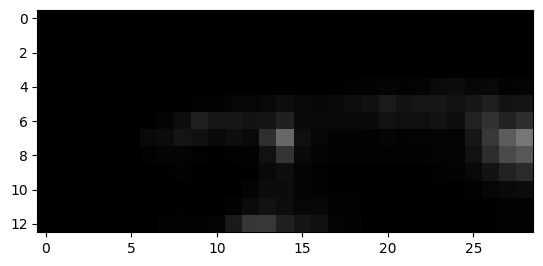

658


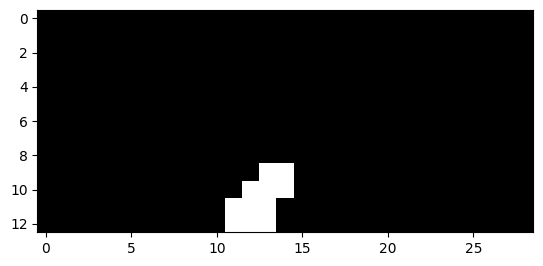

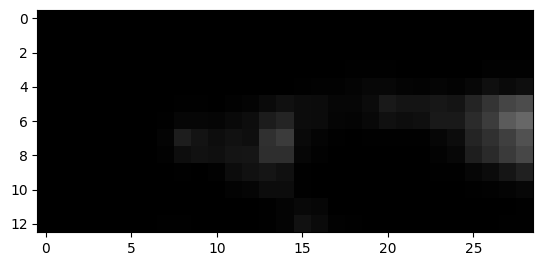

659


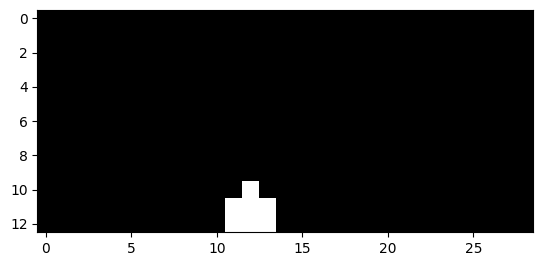

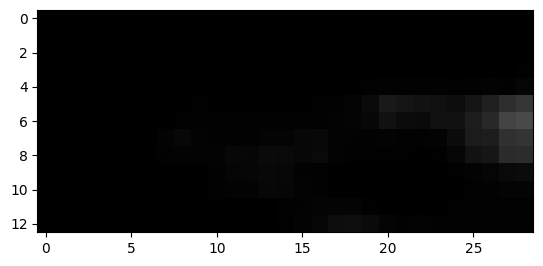

665


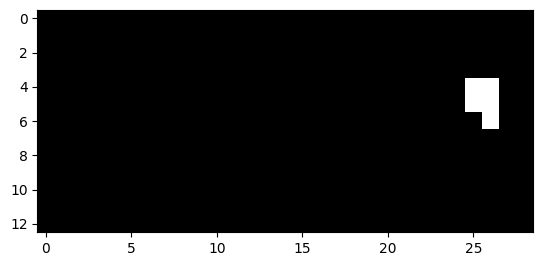

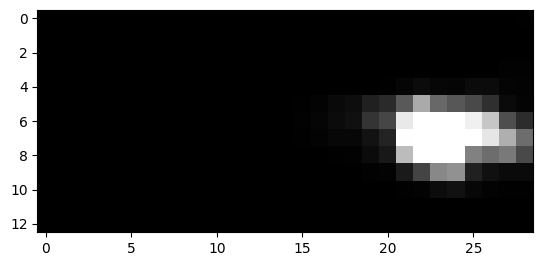

666


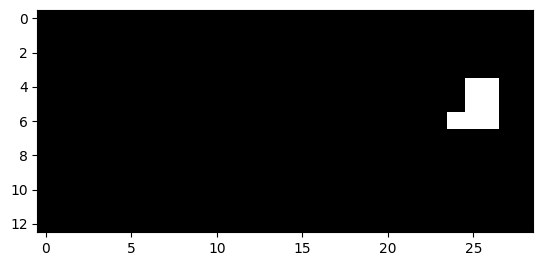

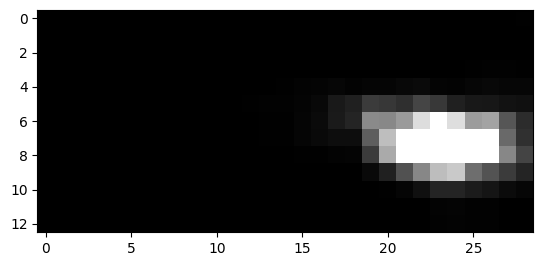

667


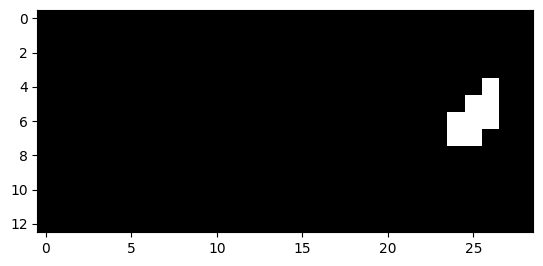

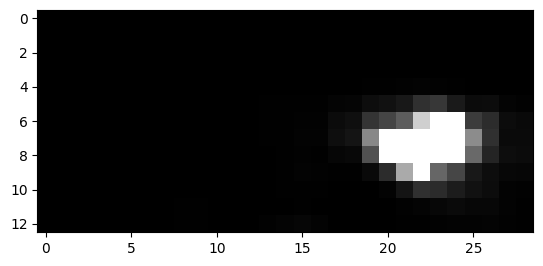

668


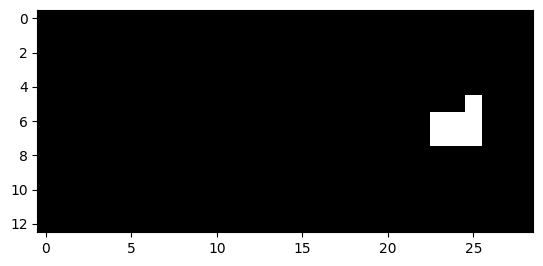

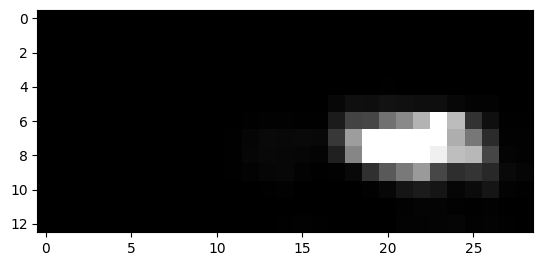

669


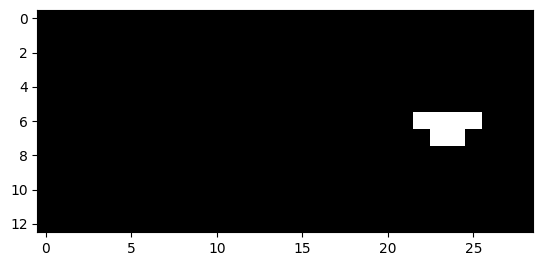

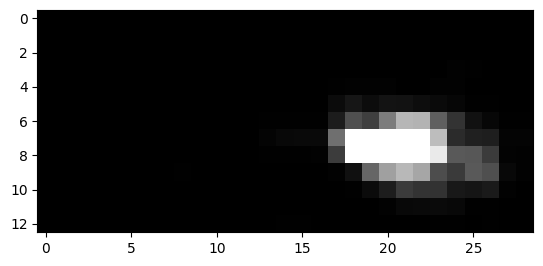

670


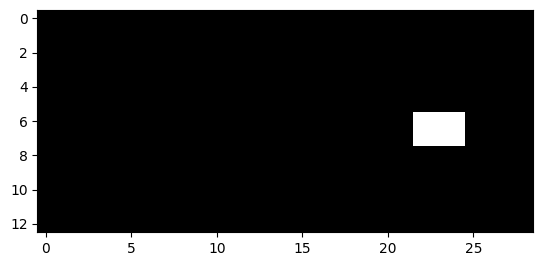

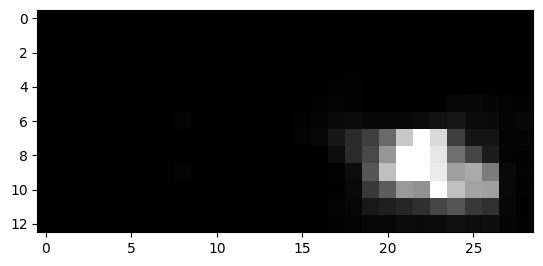

671


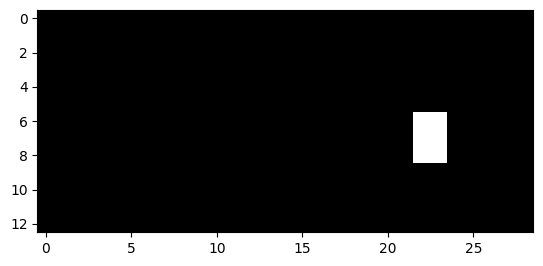

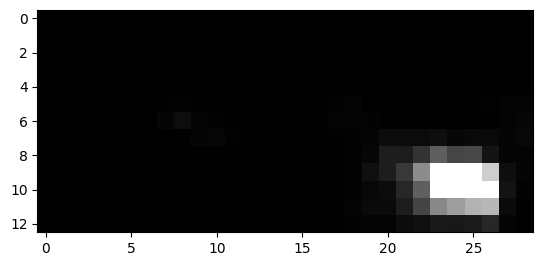

672


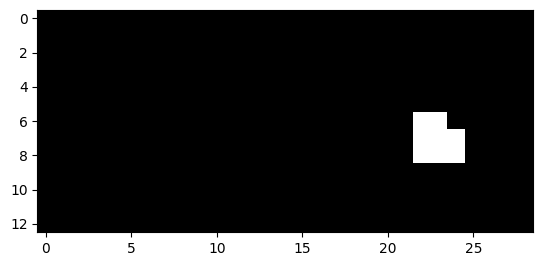

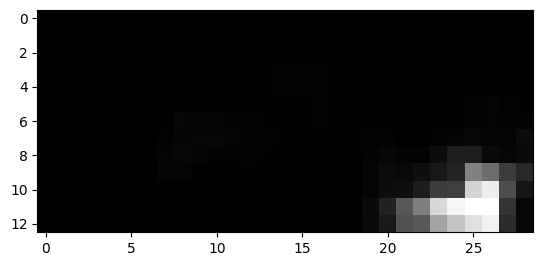

673


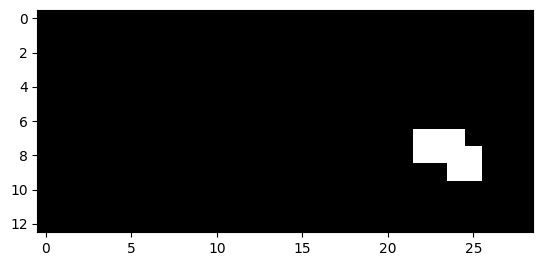

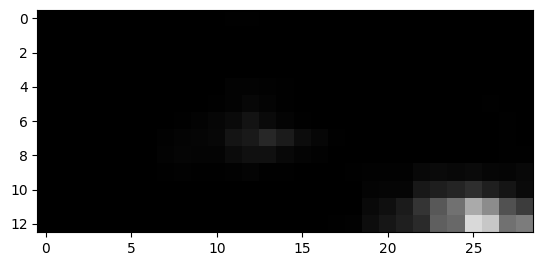

674


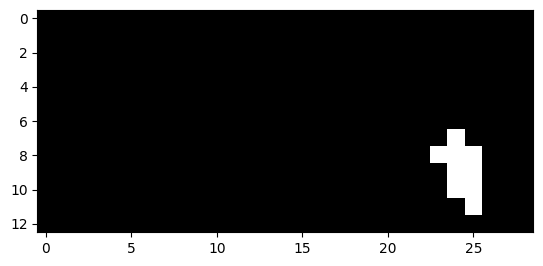

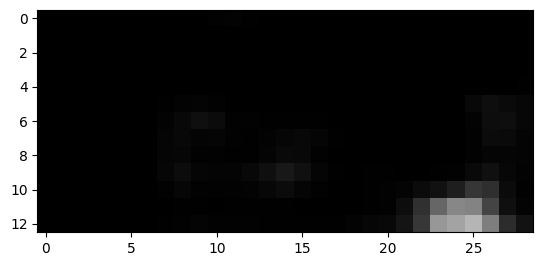

675


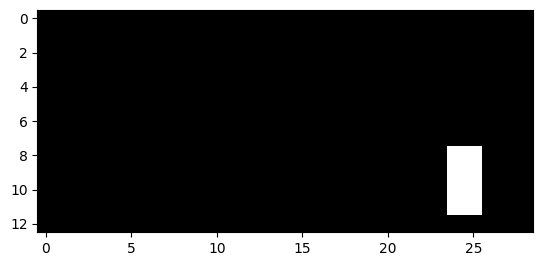

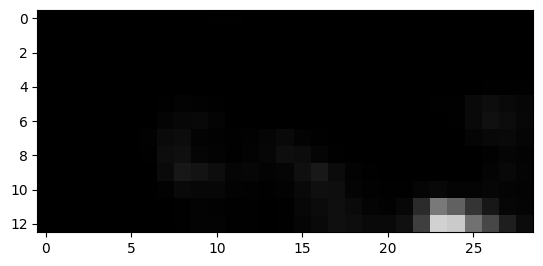

676


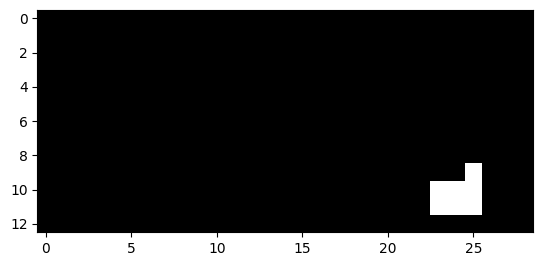

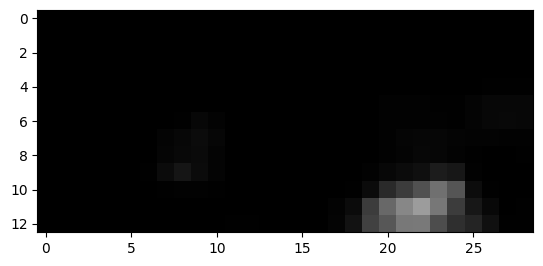

677


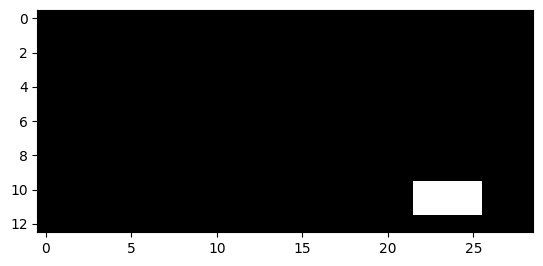

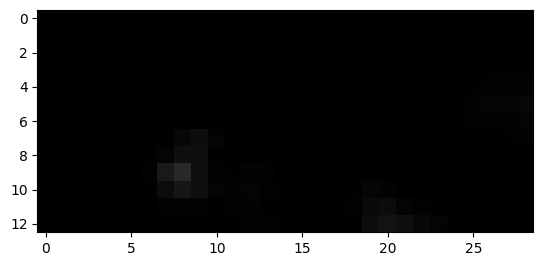

678


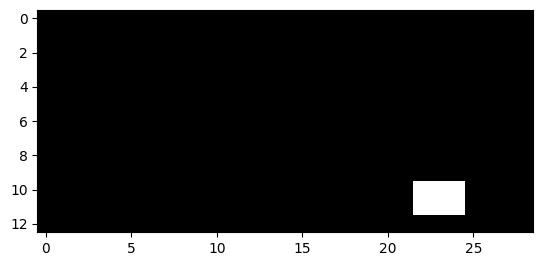

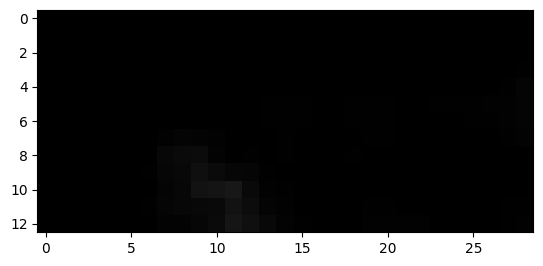

699


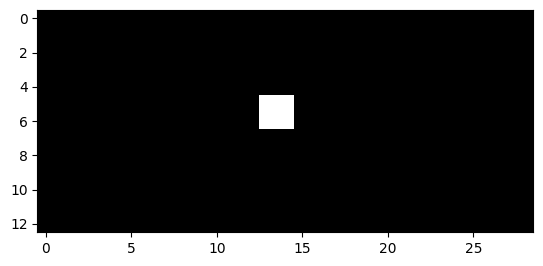

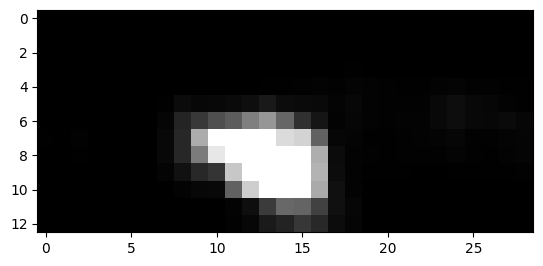

700


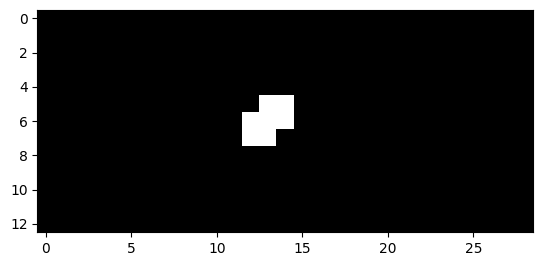

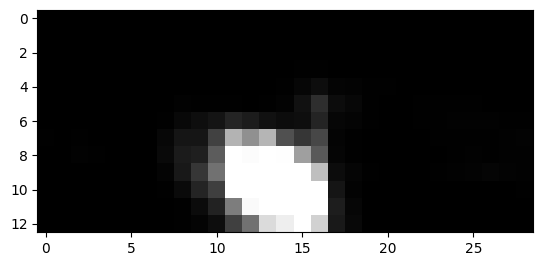

701


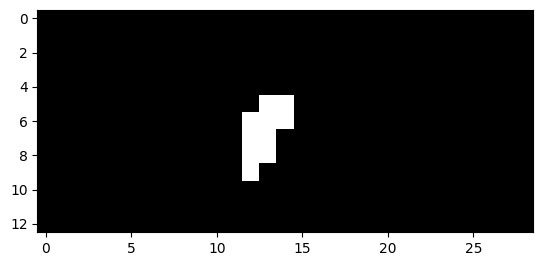

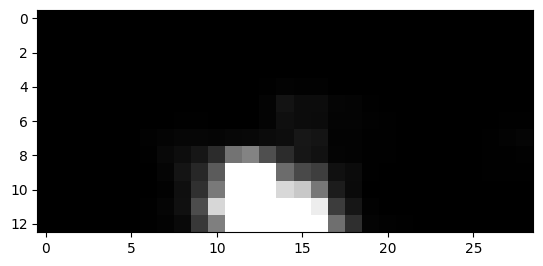

702


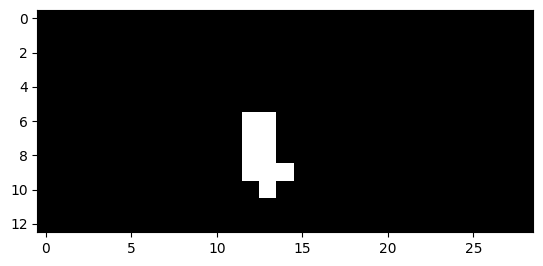

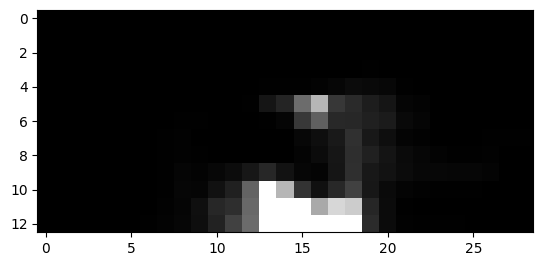

703


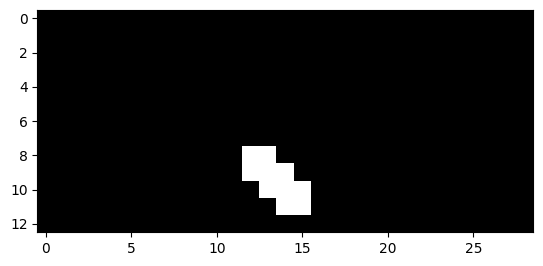

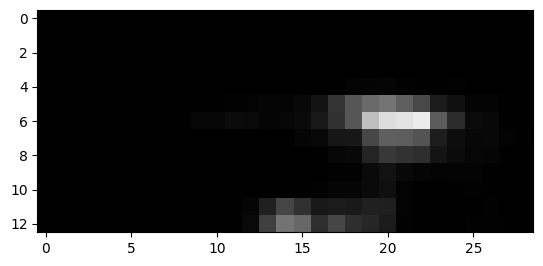

704


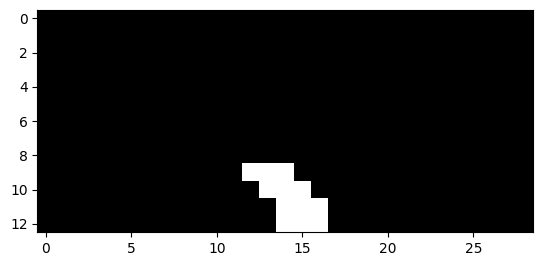

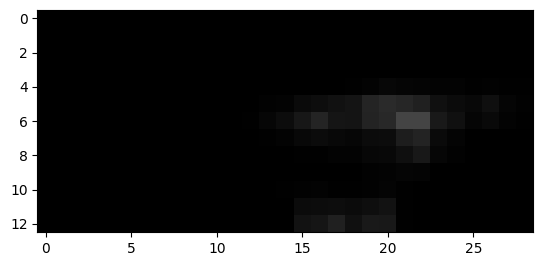

705


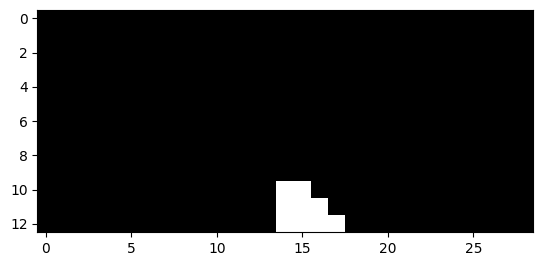

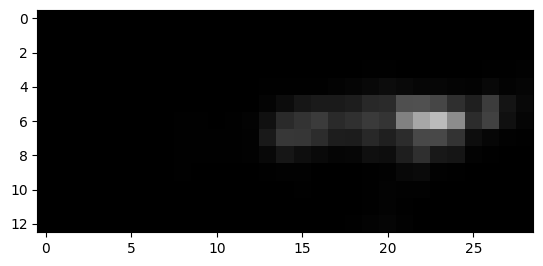

706


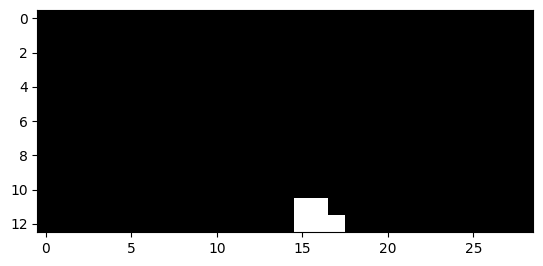

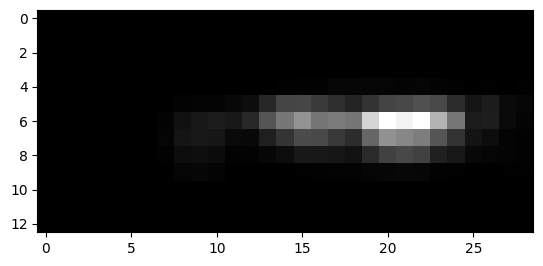

711


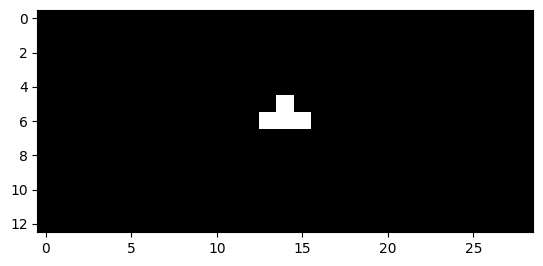

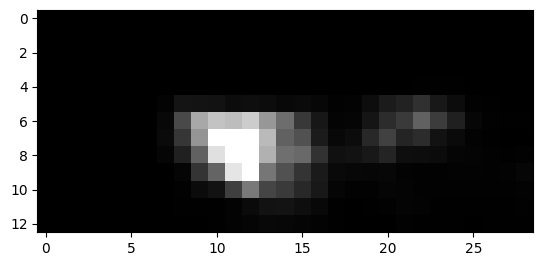

712


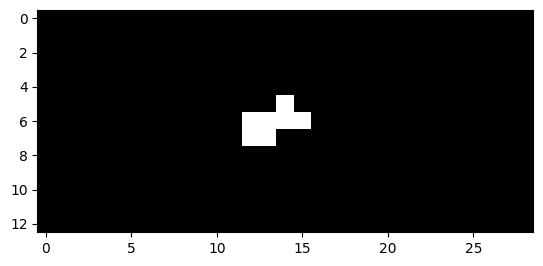

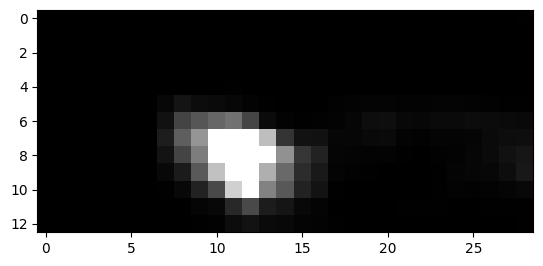

713


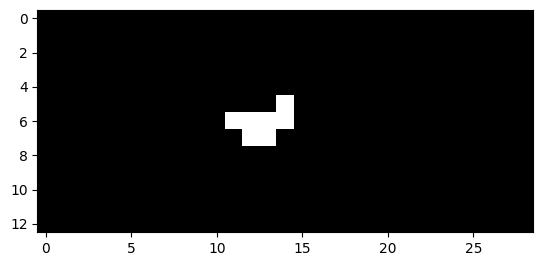

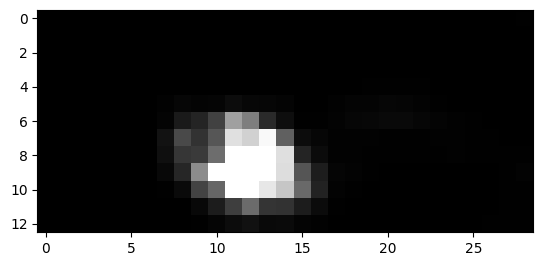

714


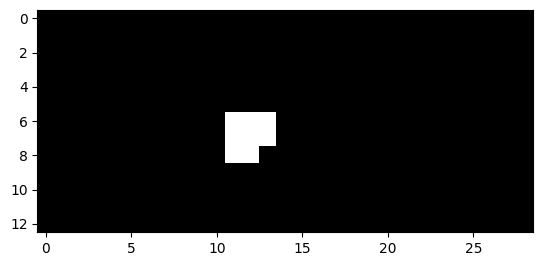

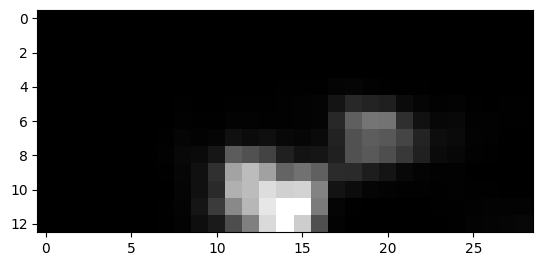

715


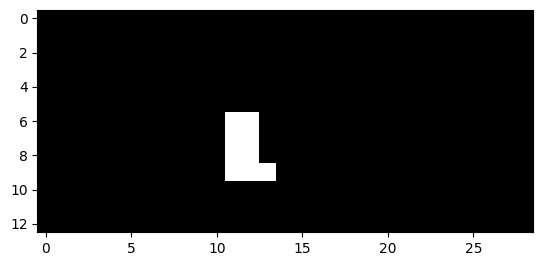

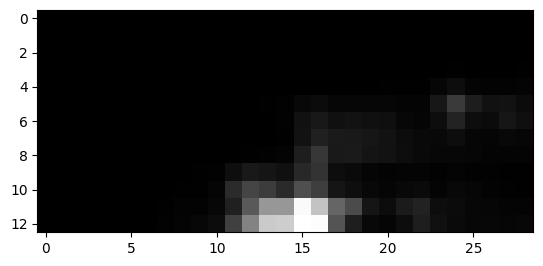

716


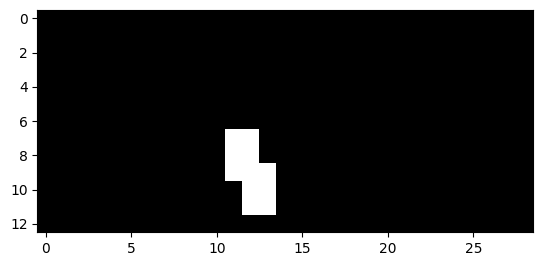

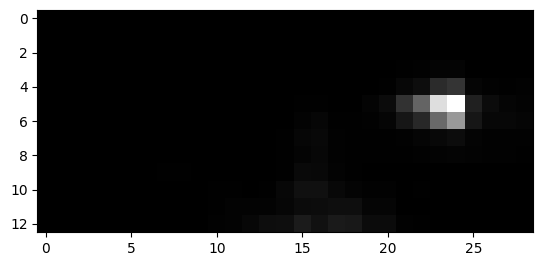

717


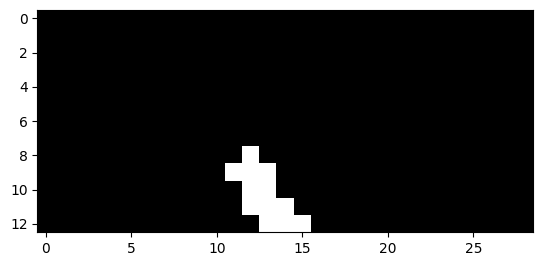

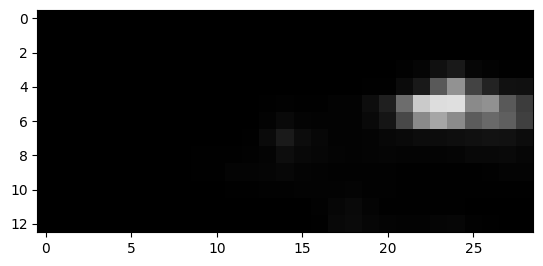

718


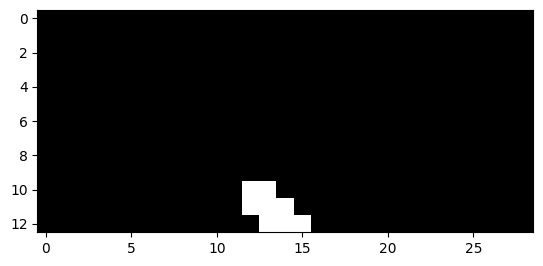

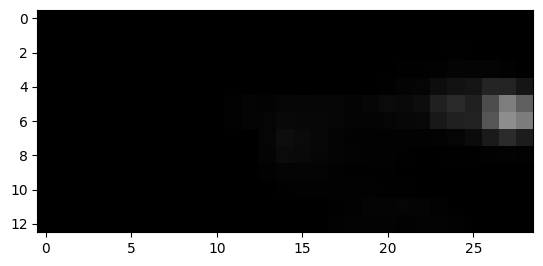

719


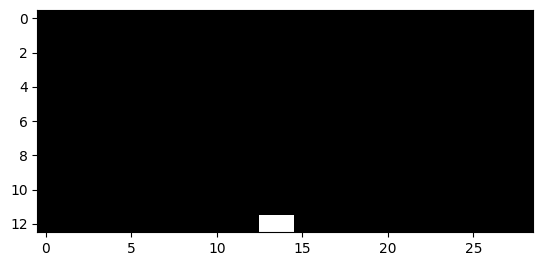

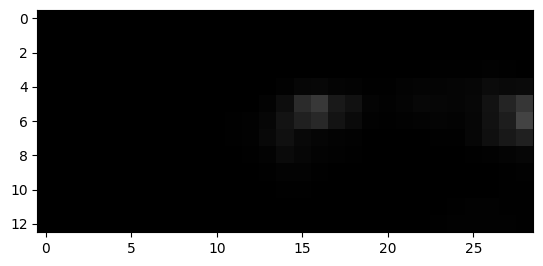

751


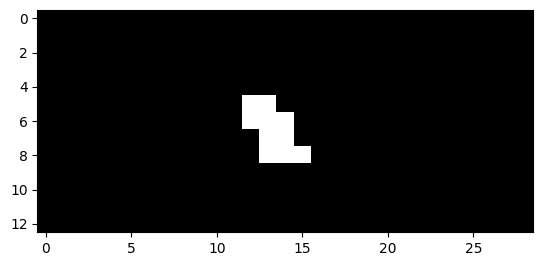

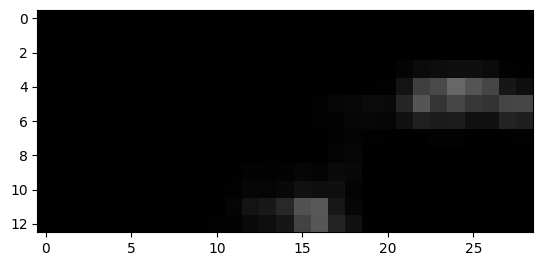

752


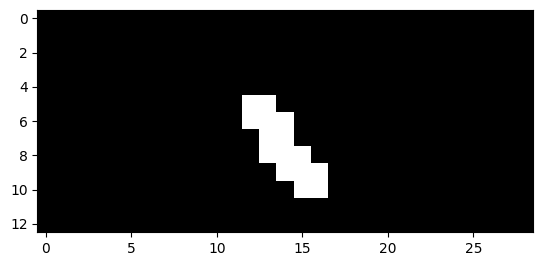

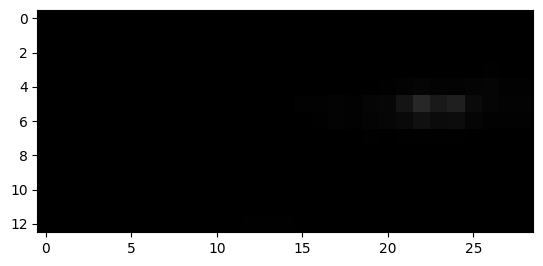

753


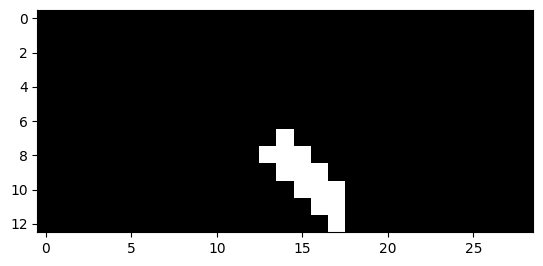

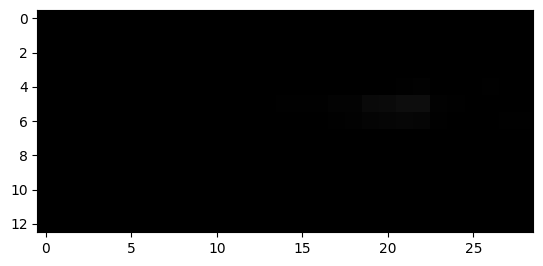

754


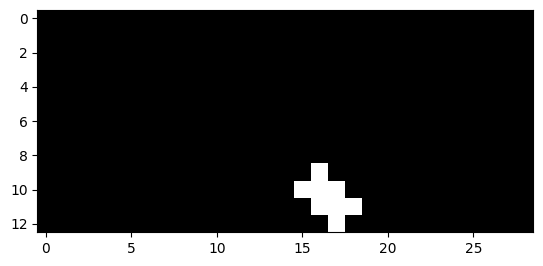

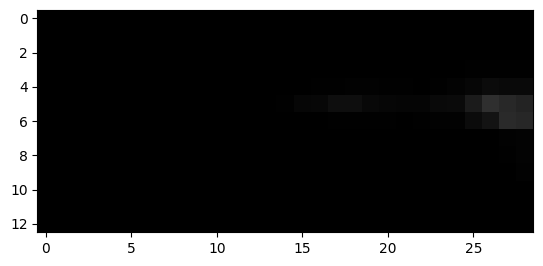

755


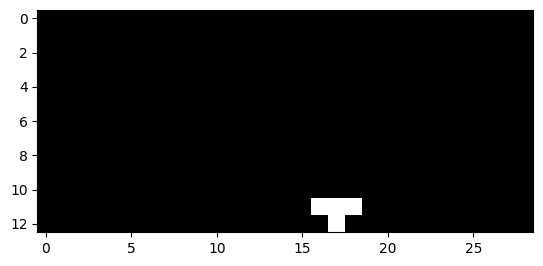

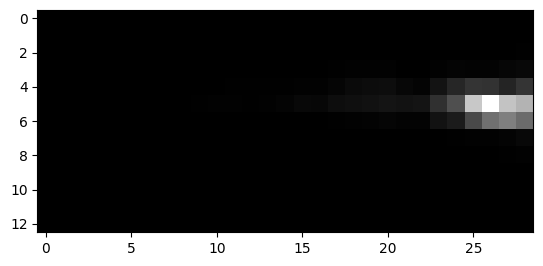

756


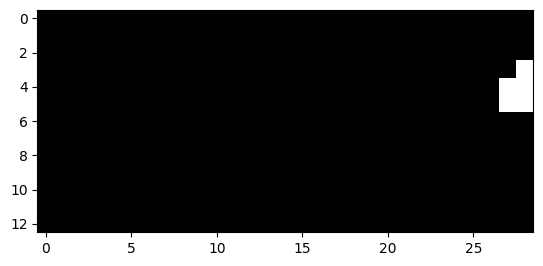

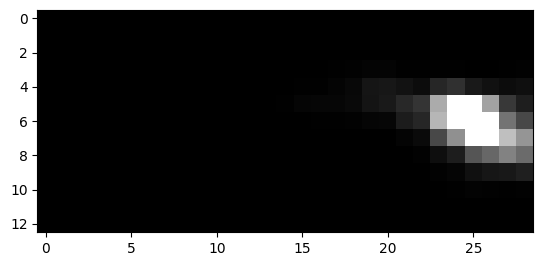

757


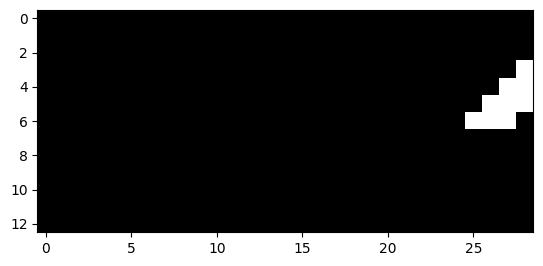

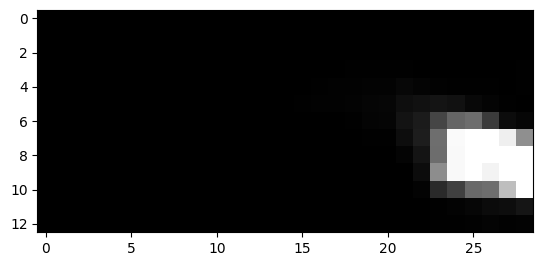

758


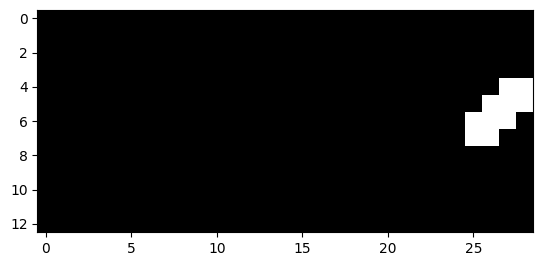

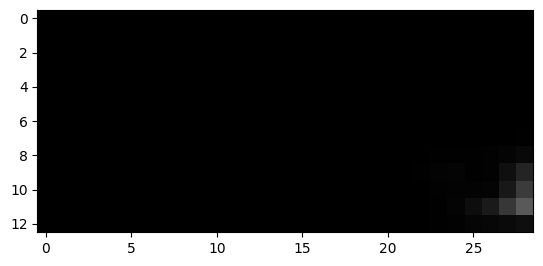

759


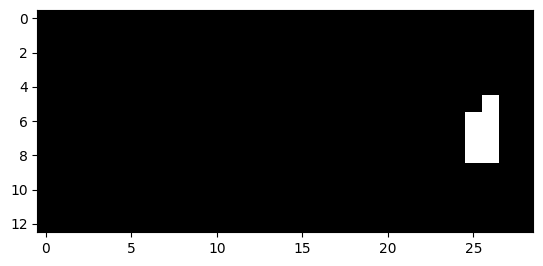

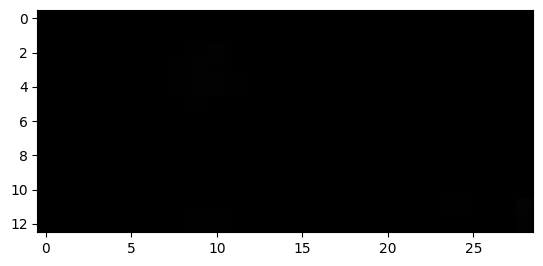

760


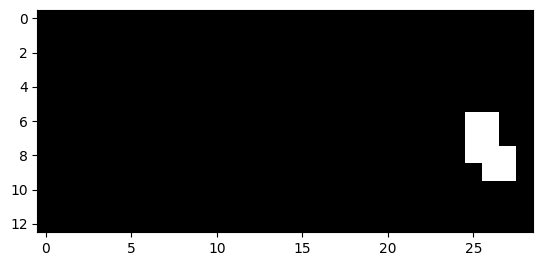

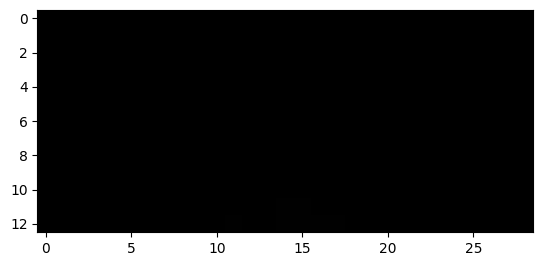

761


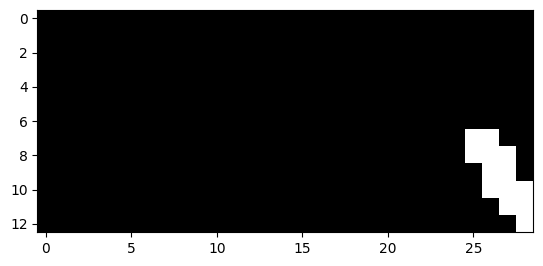

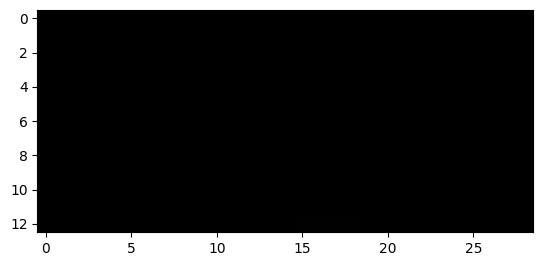

762


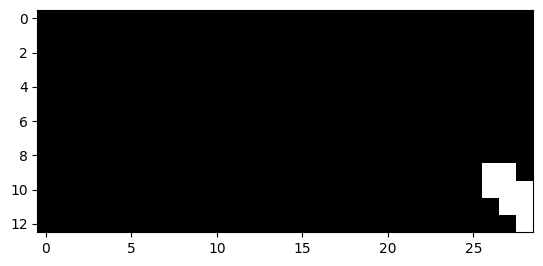

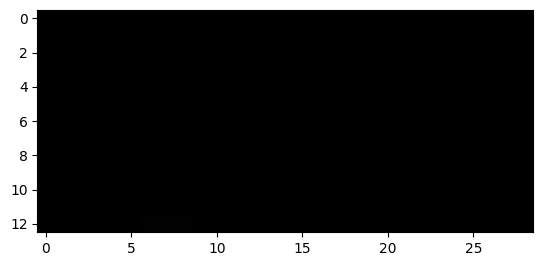

763


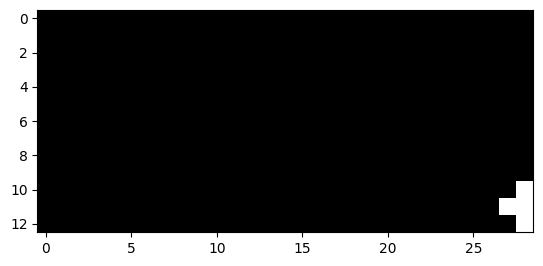

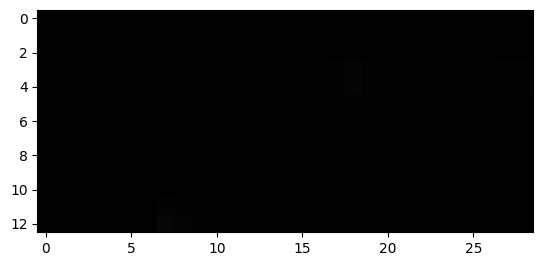

896


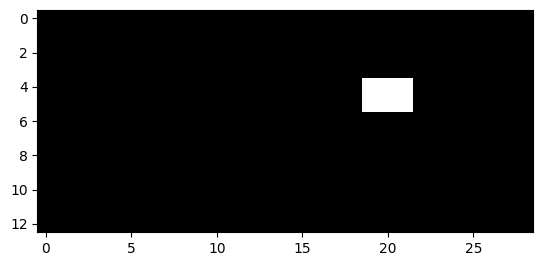

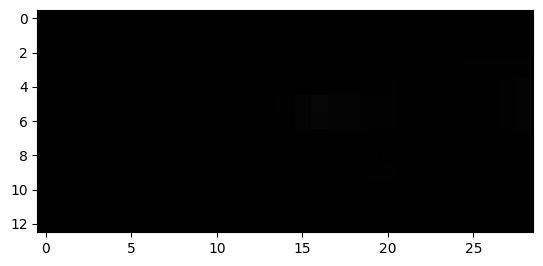

897


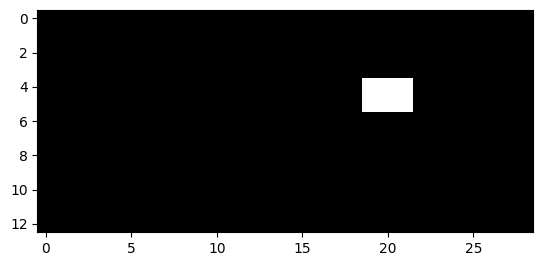

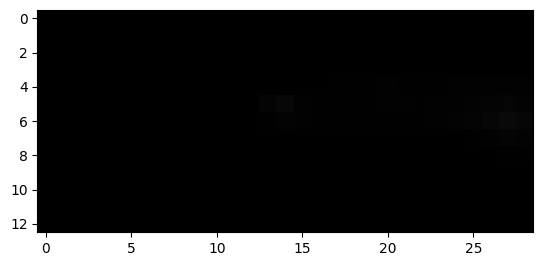

948


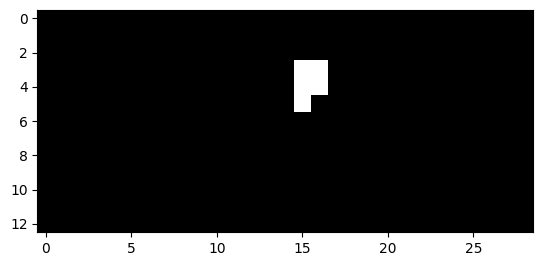

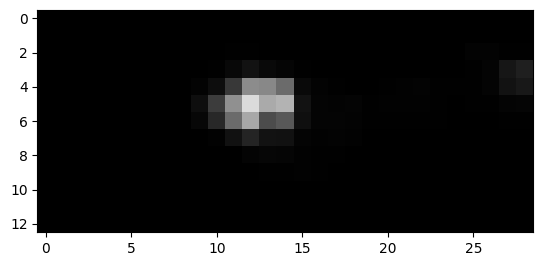

949


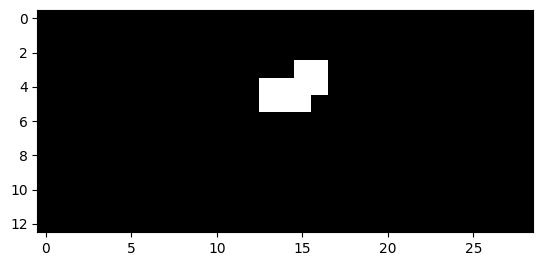

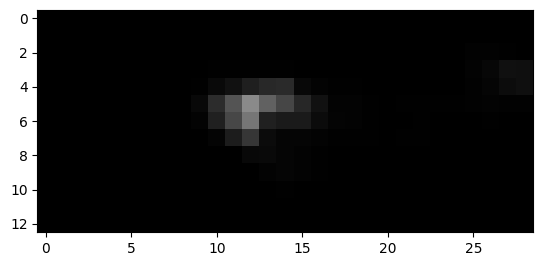

950


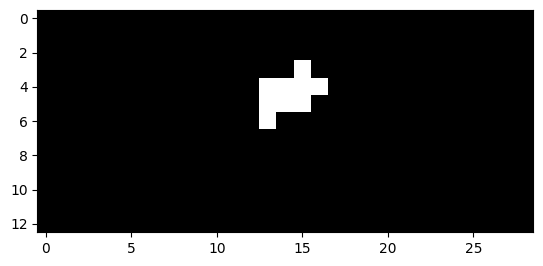

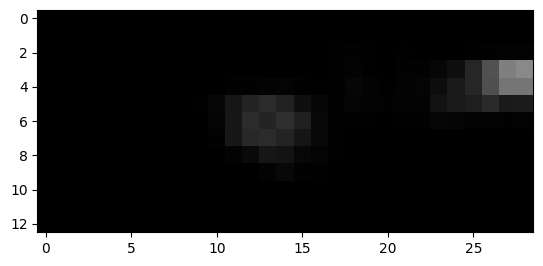

951


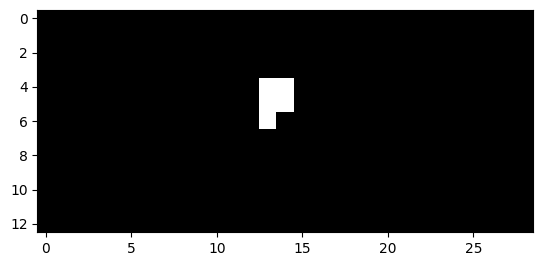

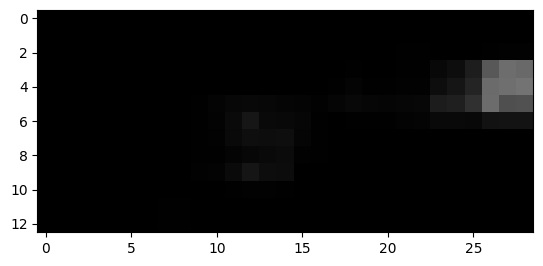

952


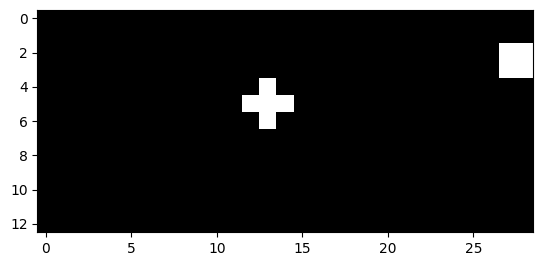

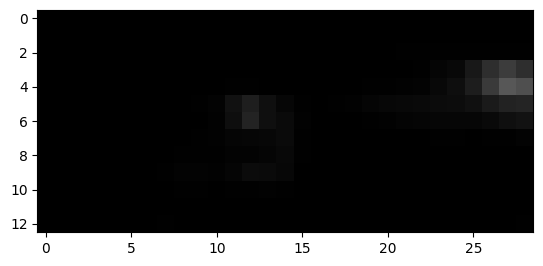

953


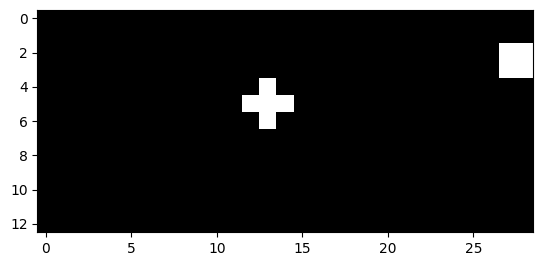

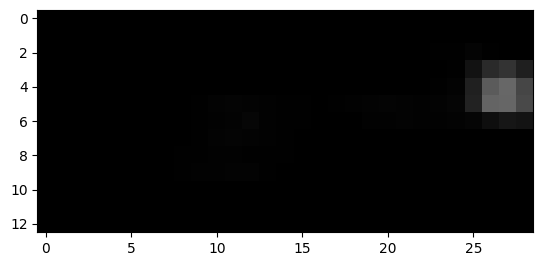

954


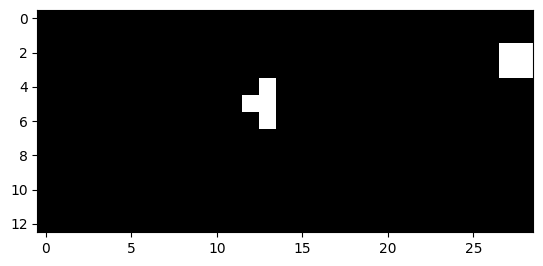

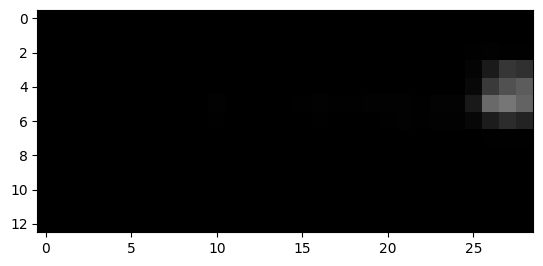

955


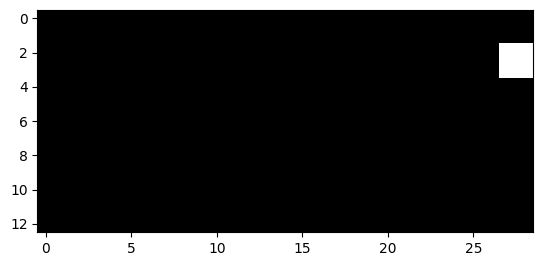

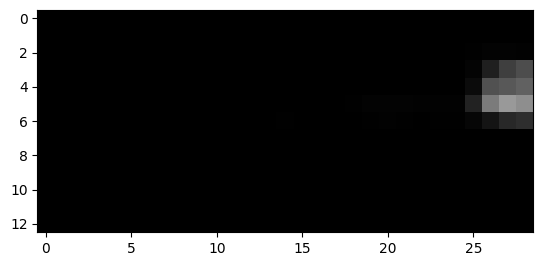

959


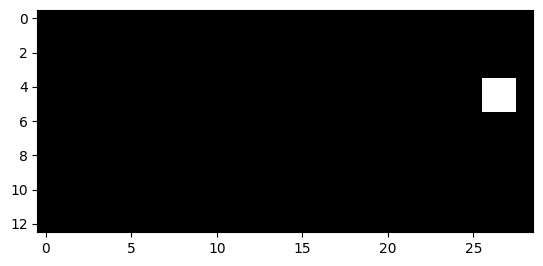

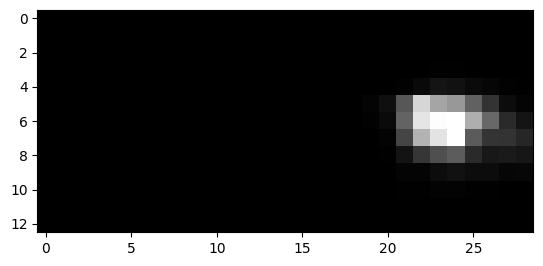

960


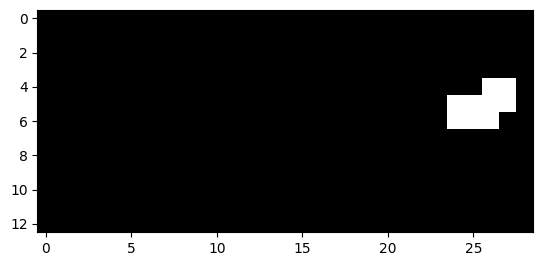

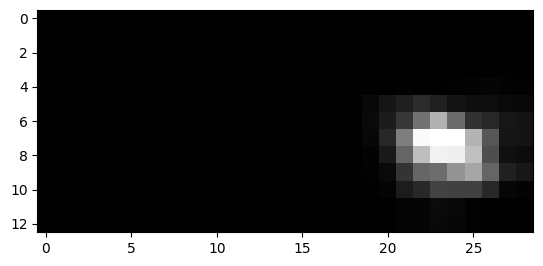

961


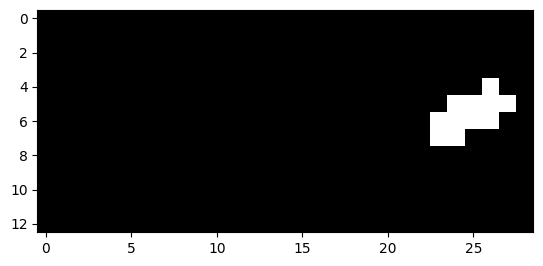

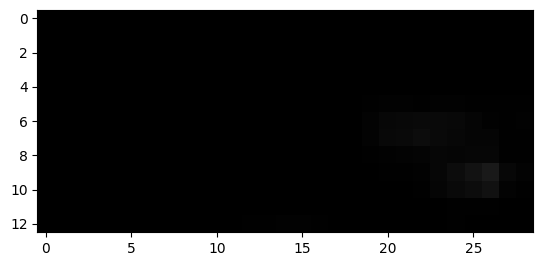

962


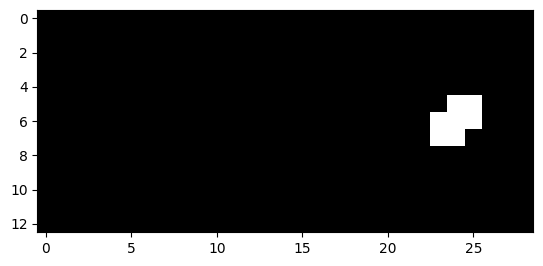

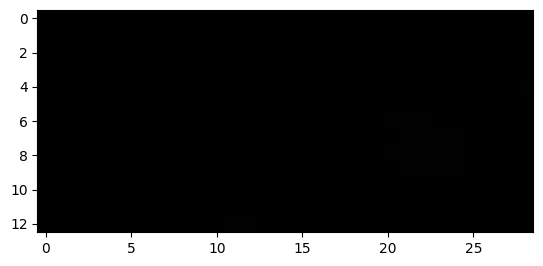

987


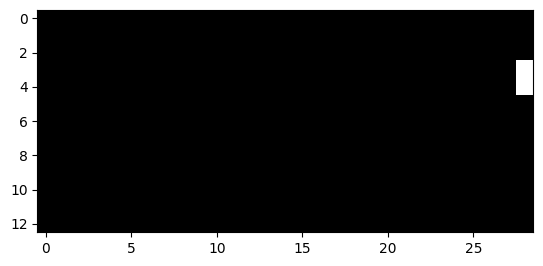

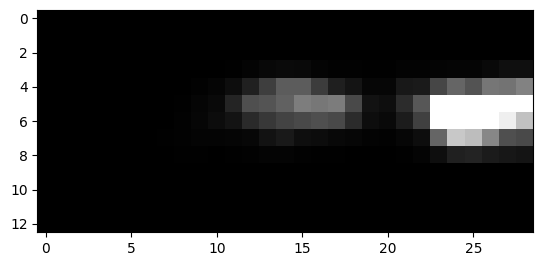

988


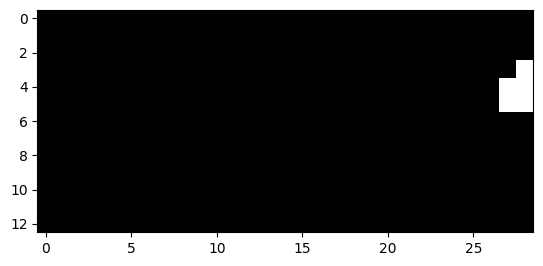

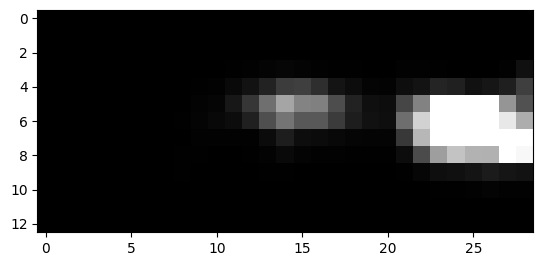

989


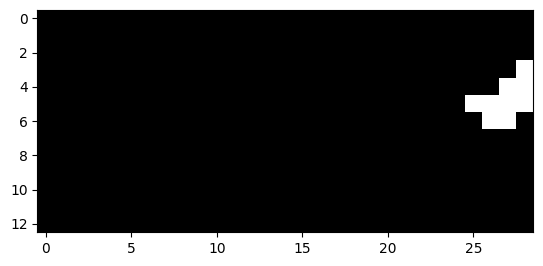

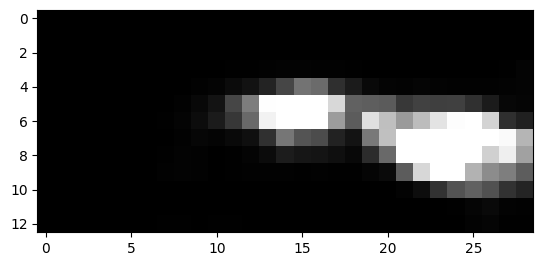

990


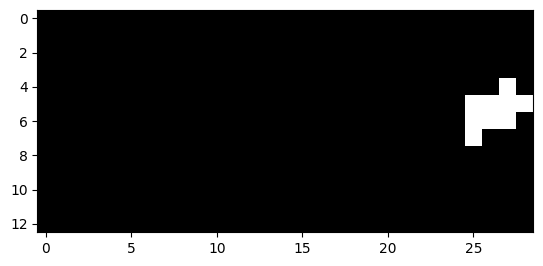

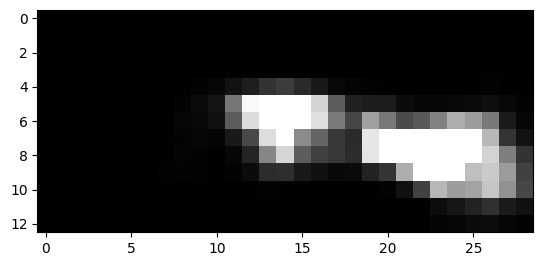

991


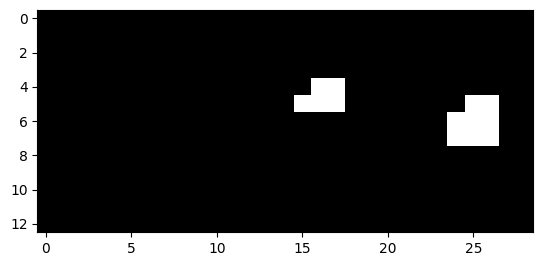

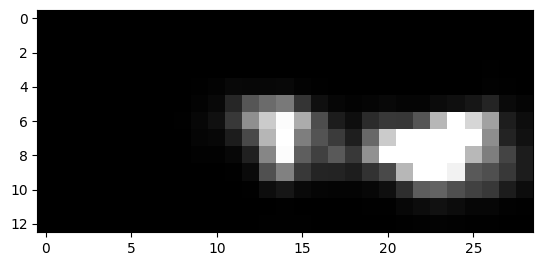

992


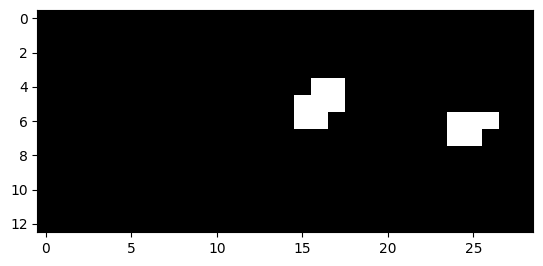

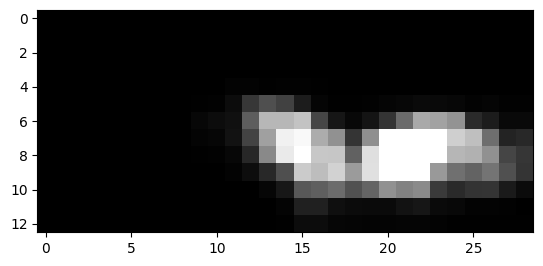

993


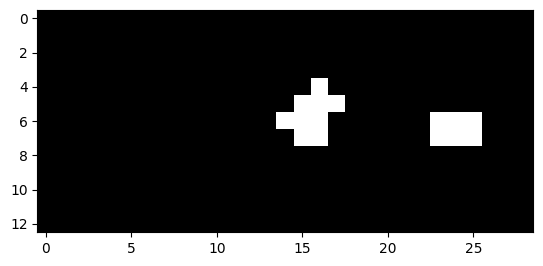

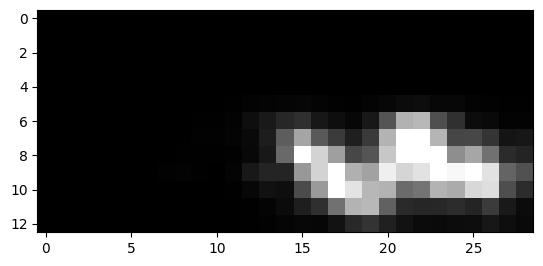

994


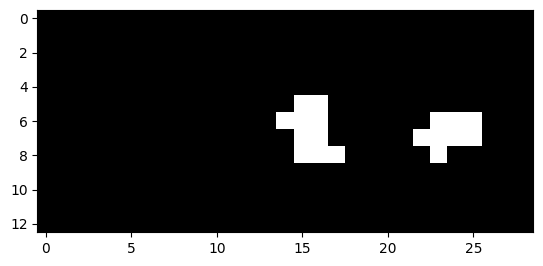

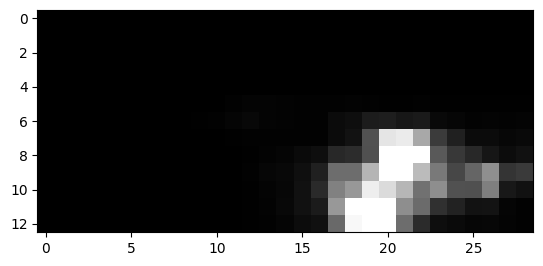

995


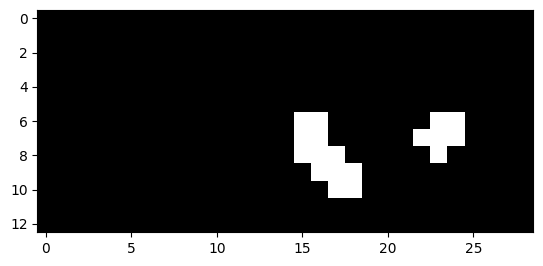

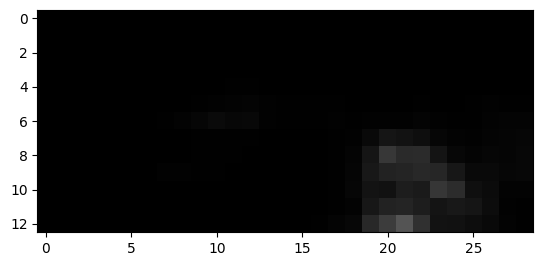

996


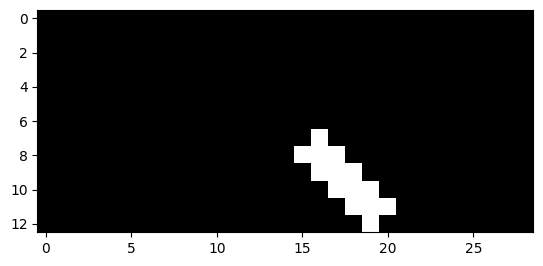

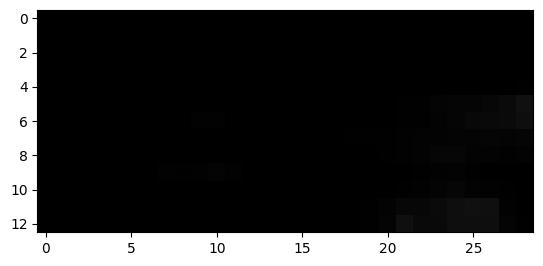

997


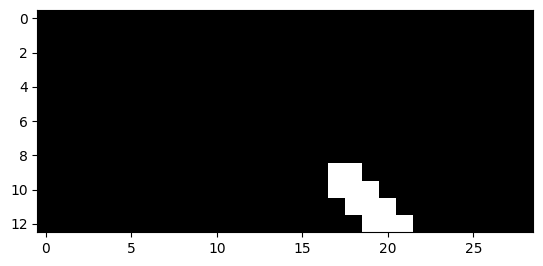

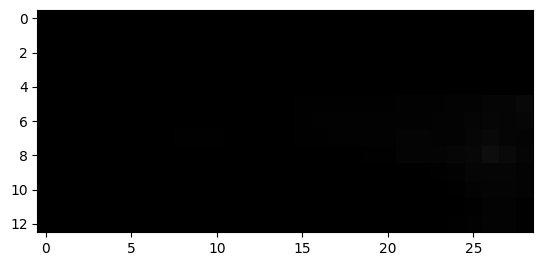

998


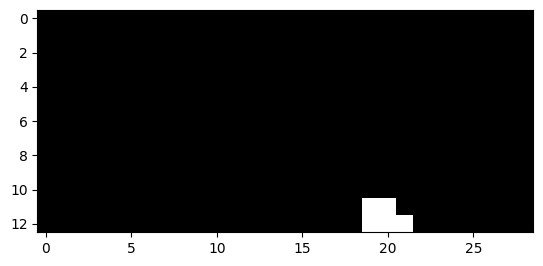

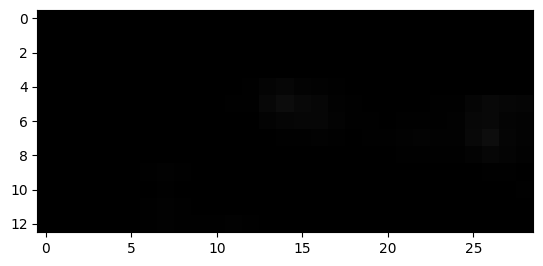

1023


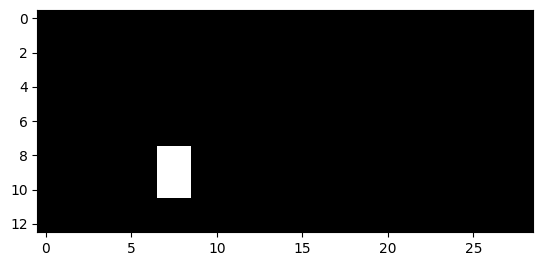

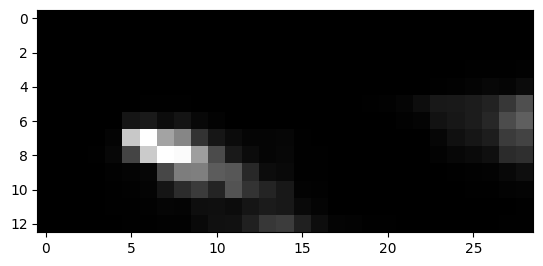

1024


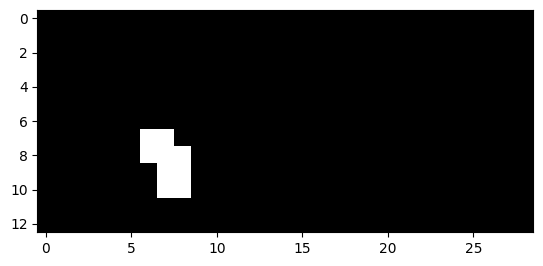

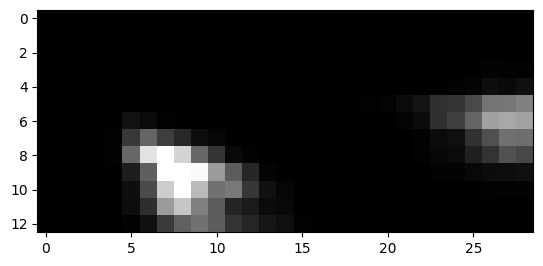

1025


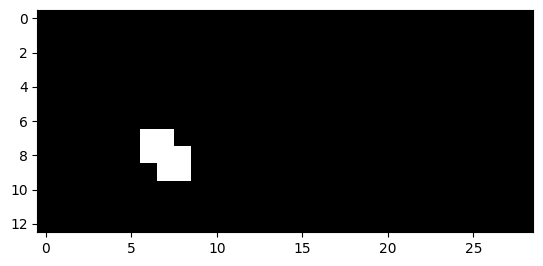

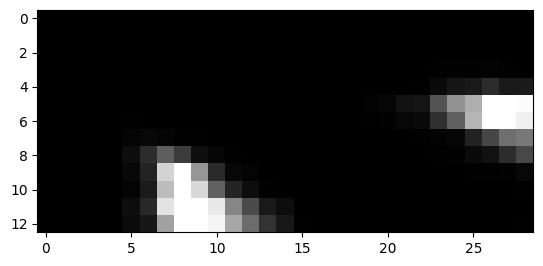

1027


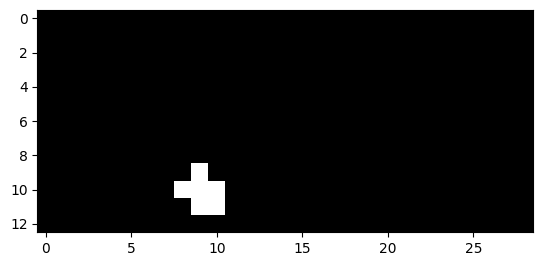

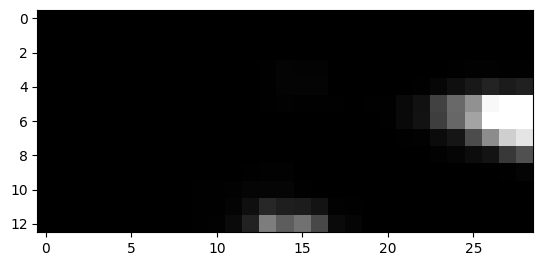

1028


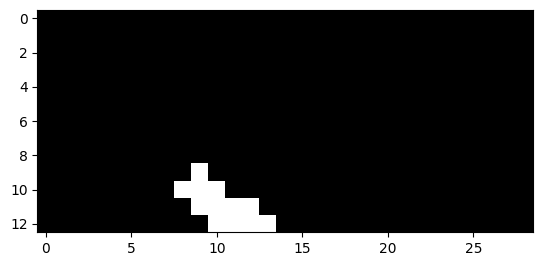

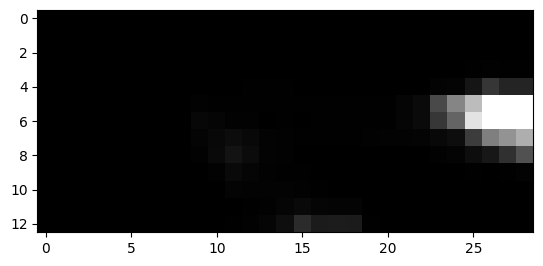

1029


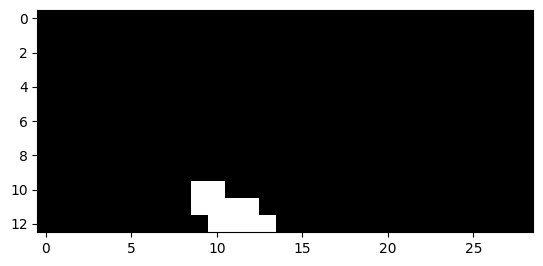

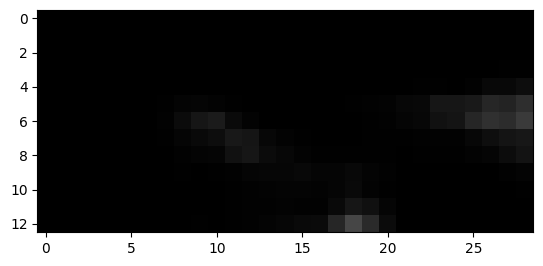

1039


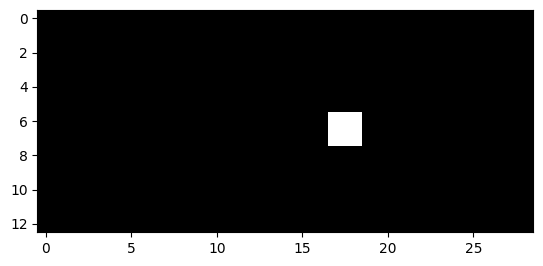

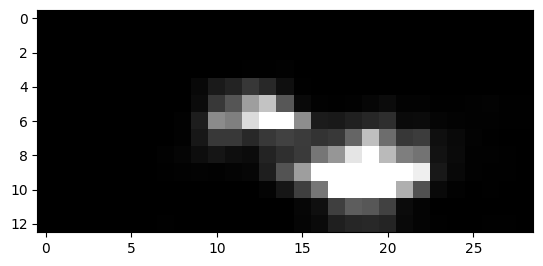

1040


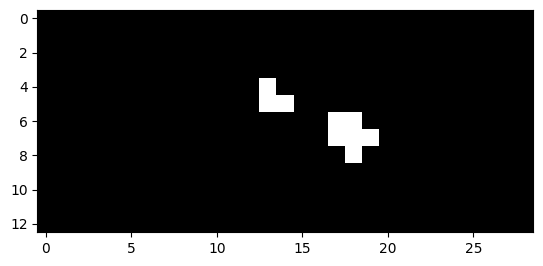

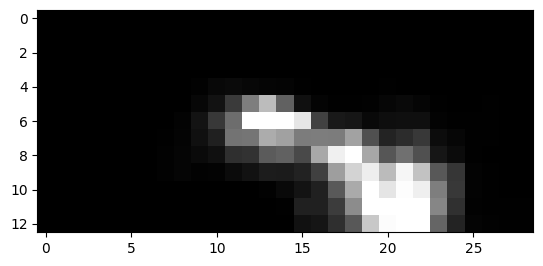

1041


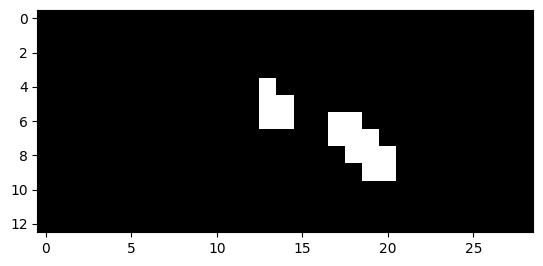

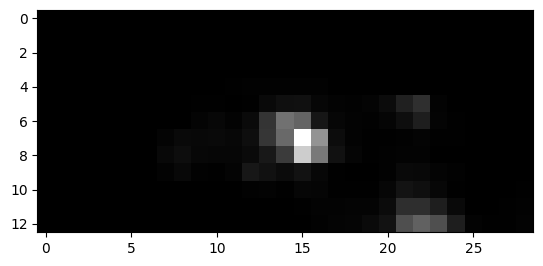

1042


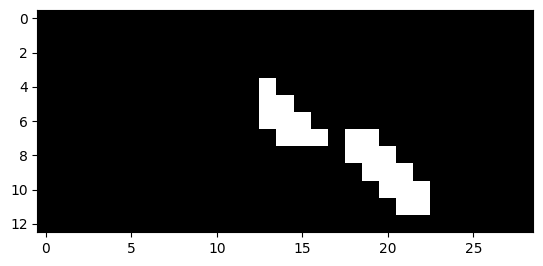

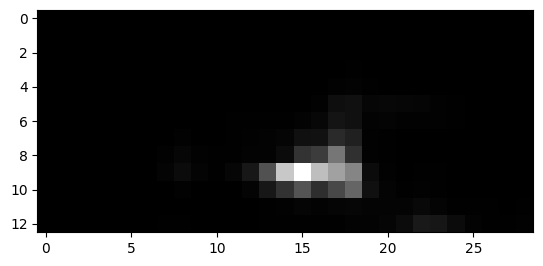

1043


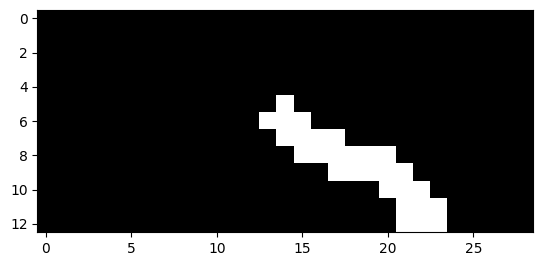

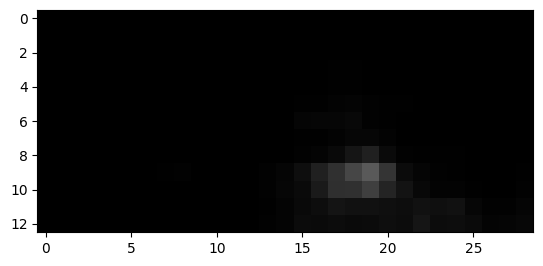

1044


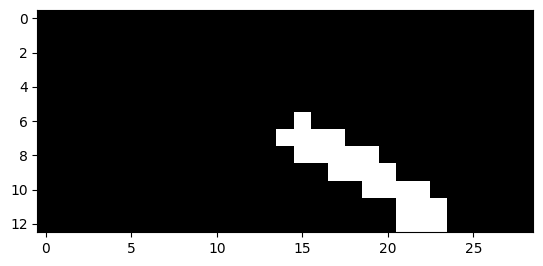

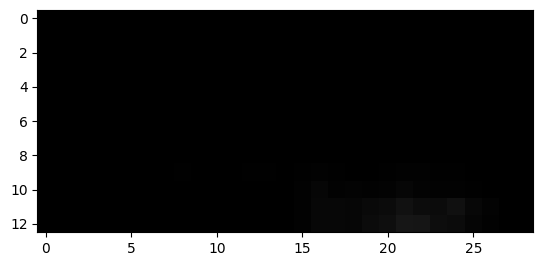

1045


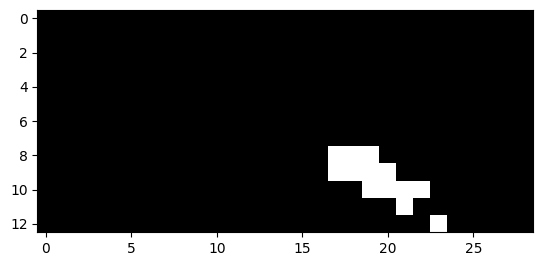

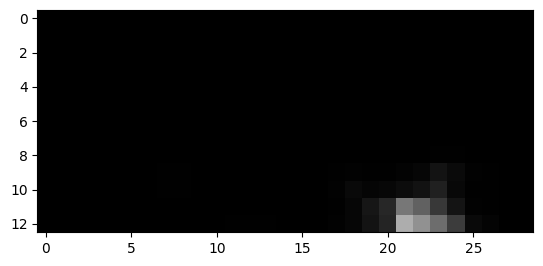

1046


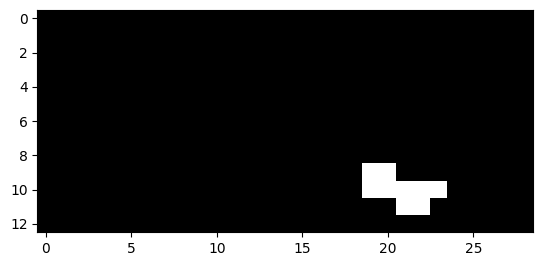

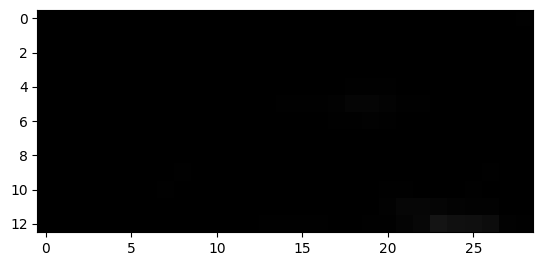

1047


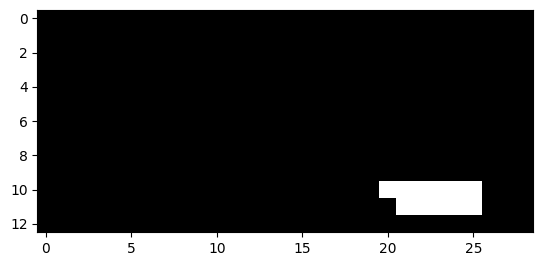

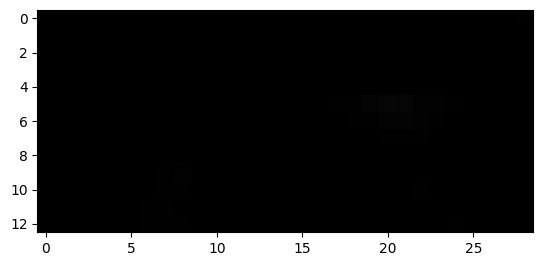

1048


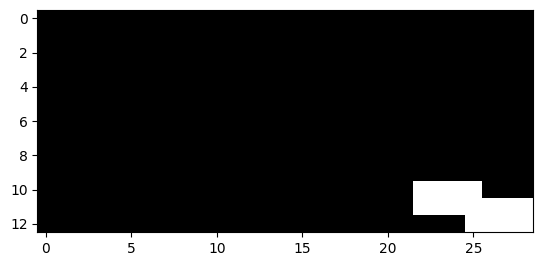

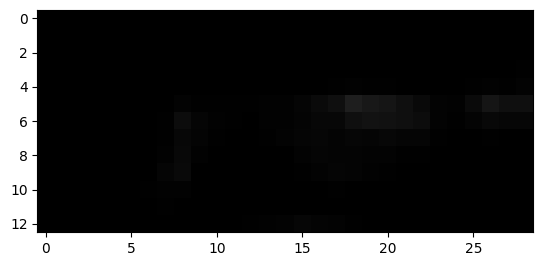

1049


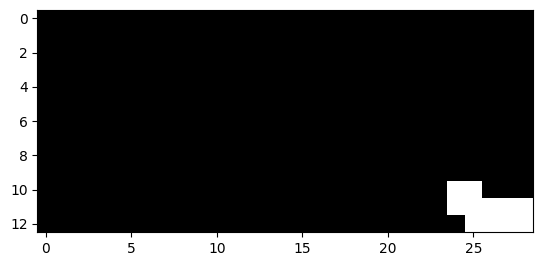

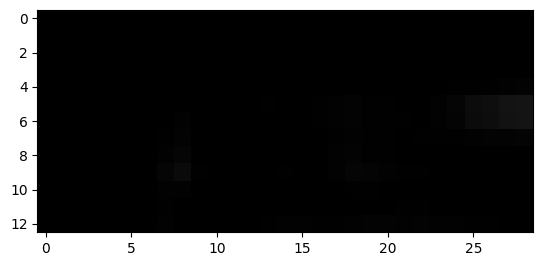

1050


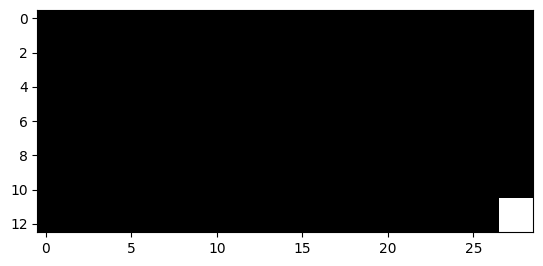

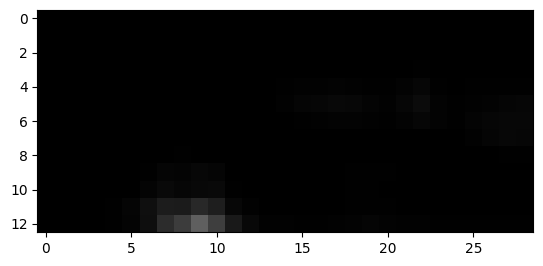

1064


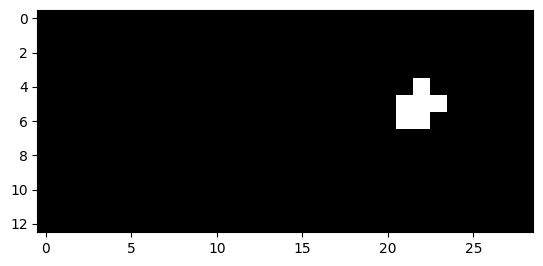

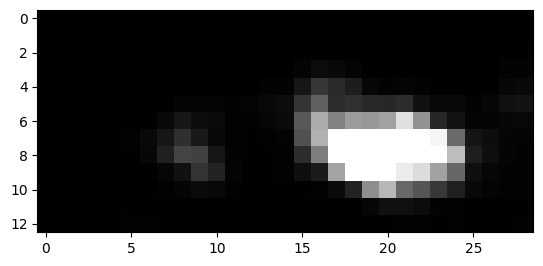

1065


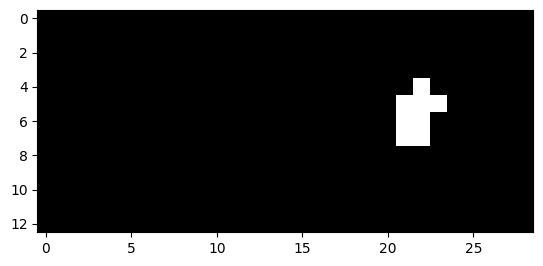

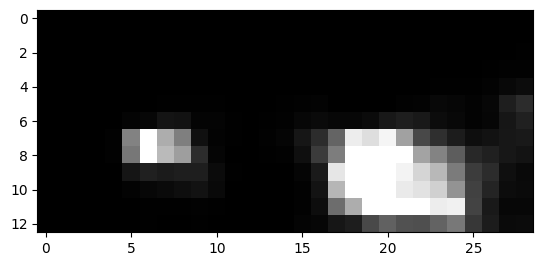

1066


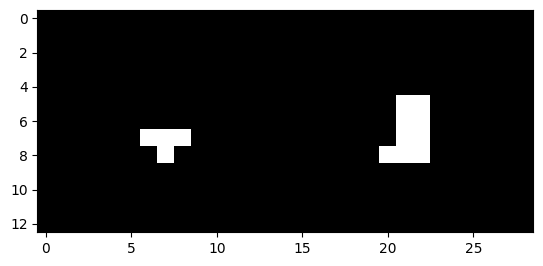

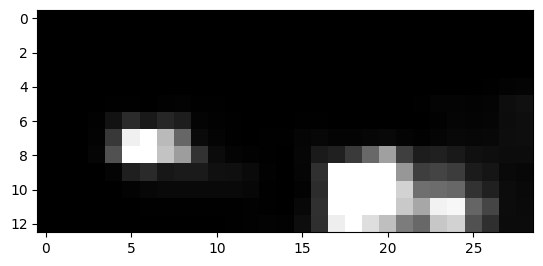

1067


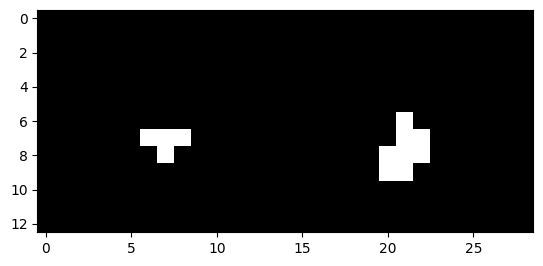

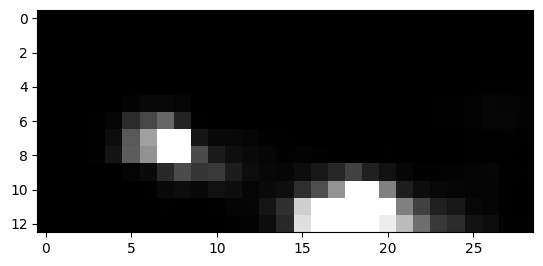

1068


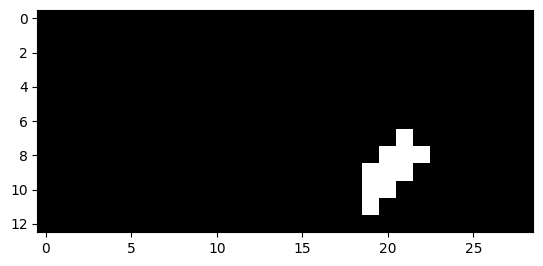

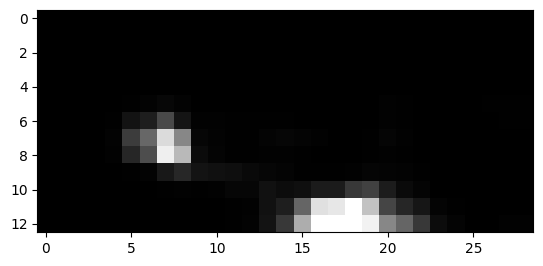

1069


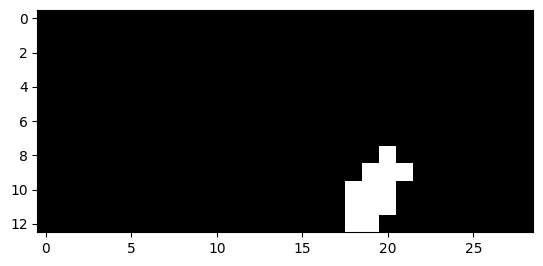

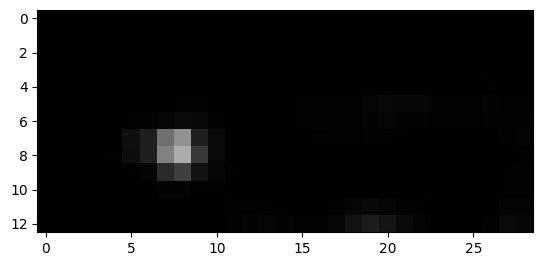

1070


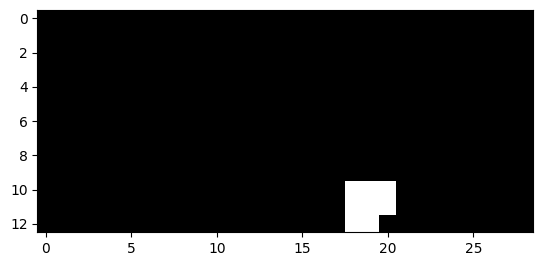

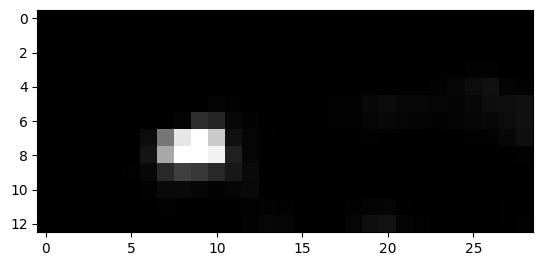

1071


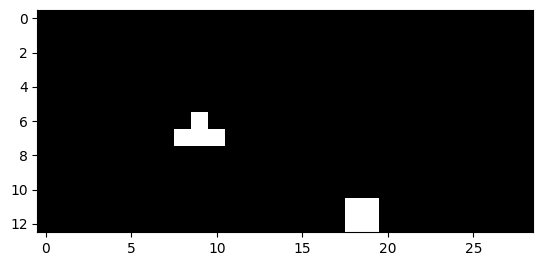

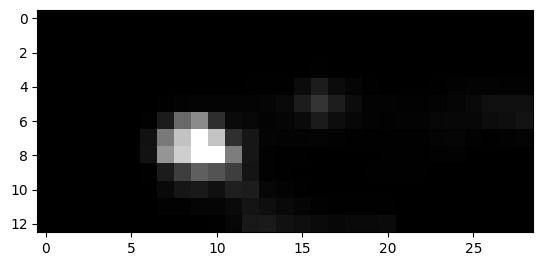

1072


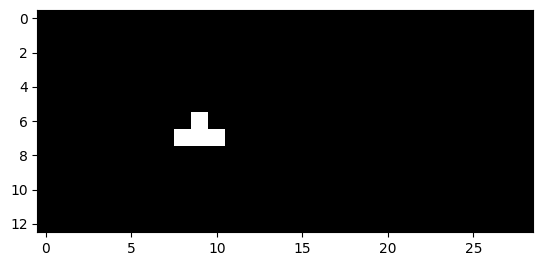

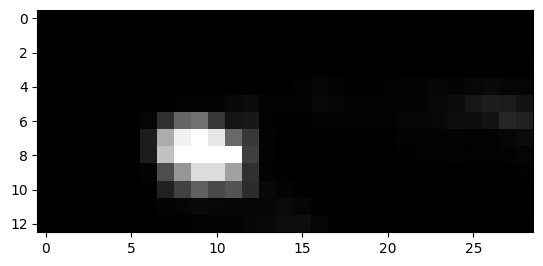

1073


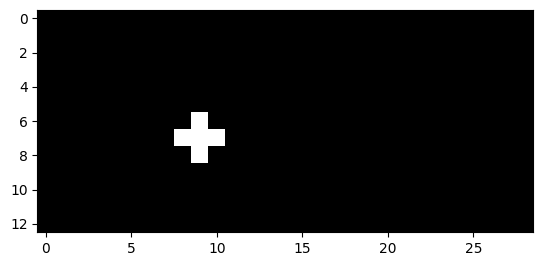

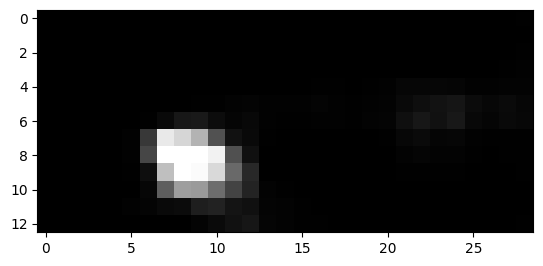

1074


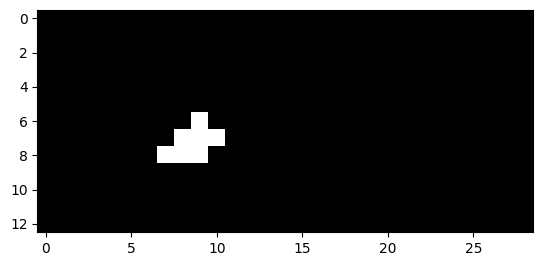

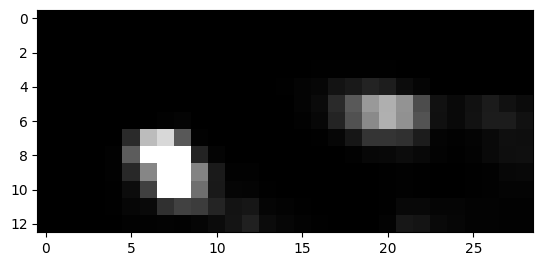

1075


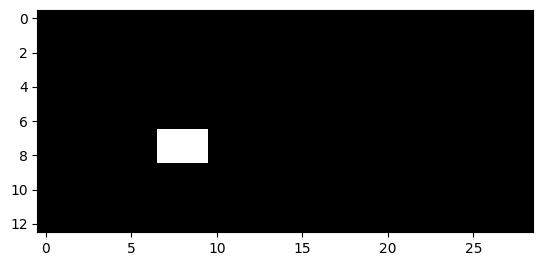

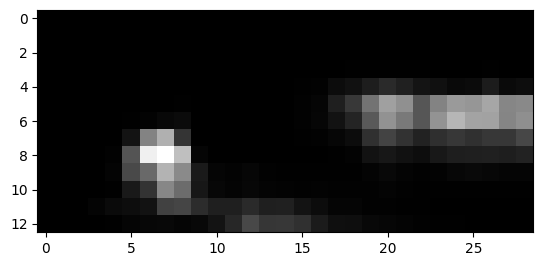

1076


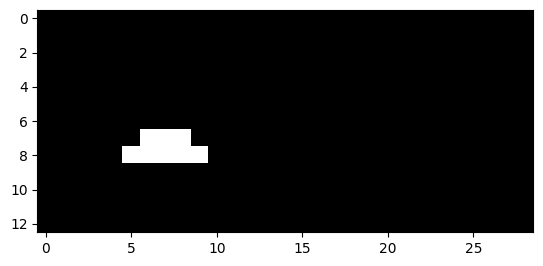

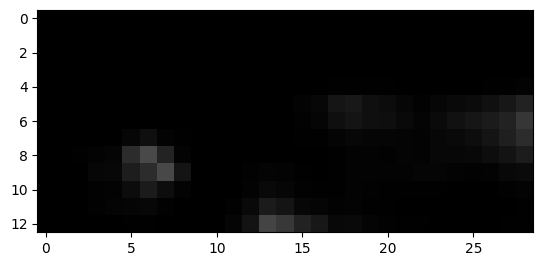

1077


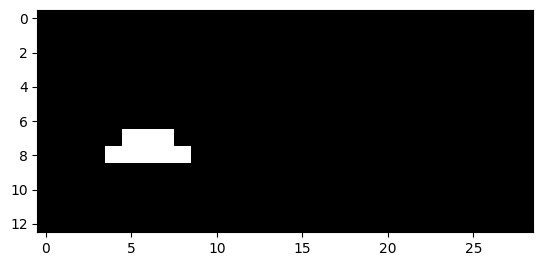

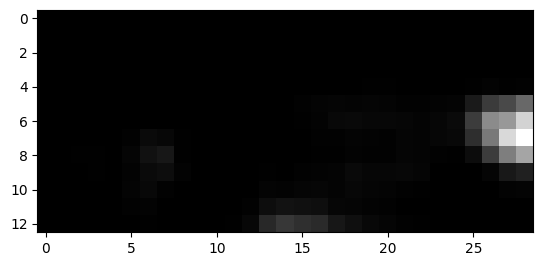

1078


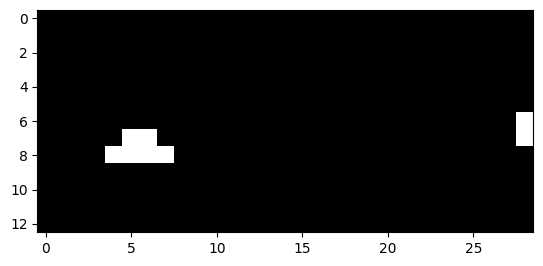

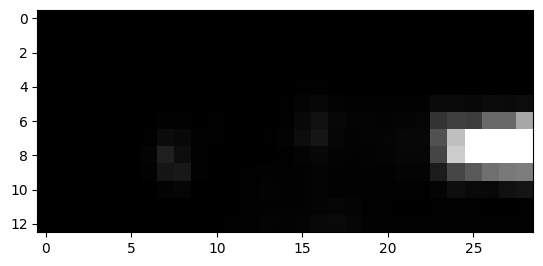

1079


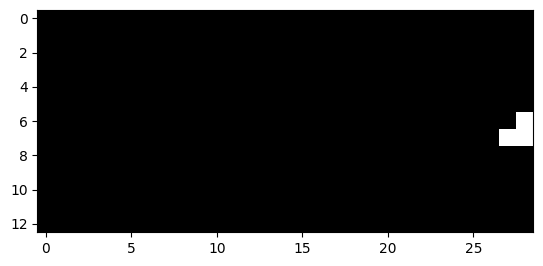

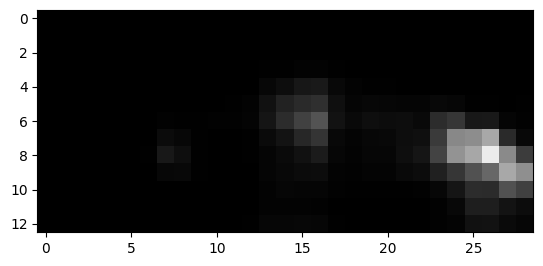

1080


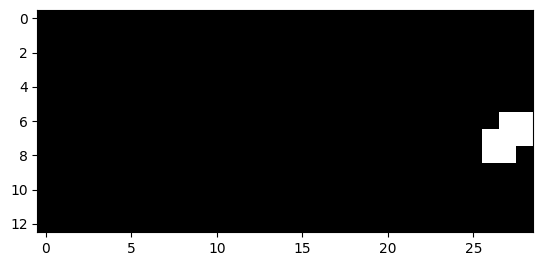

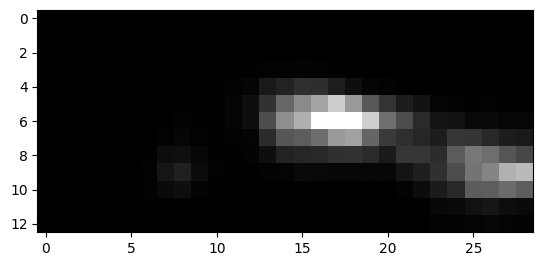

1081


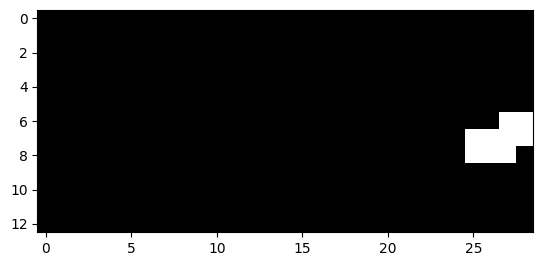

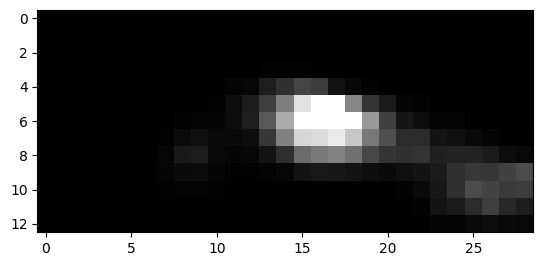

1082


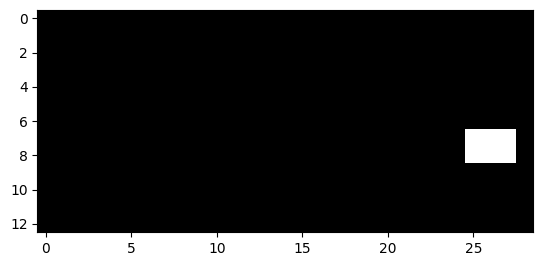

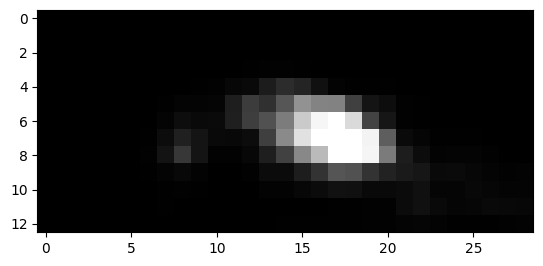

1083


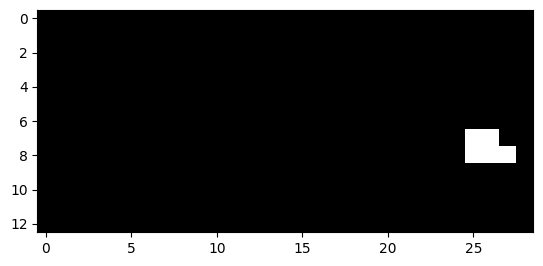

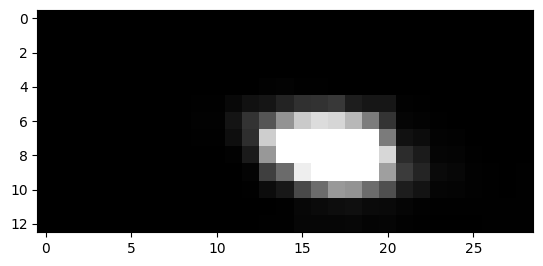

1084


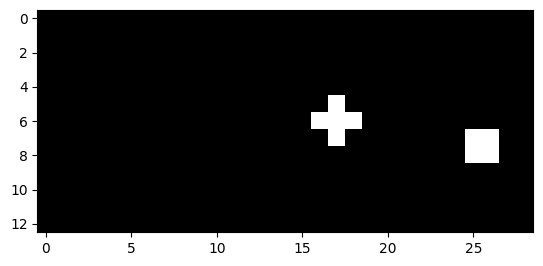

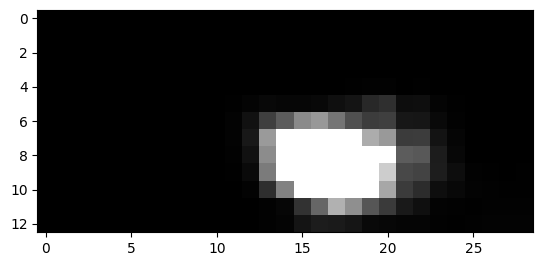

1085


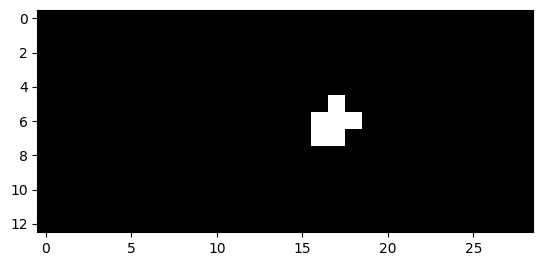

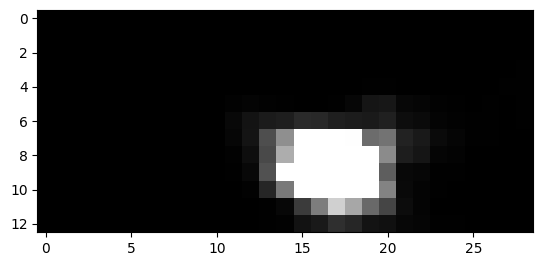

1086


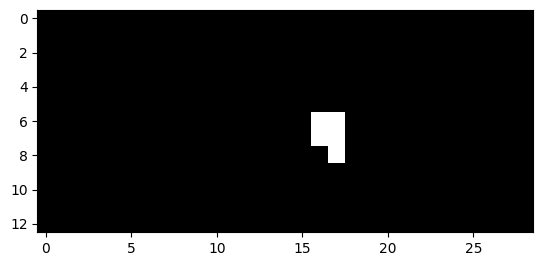

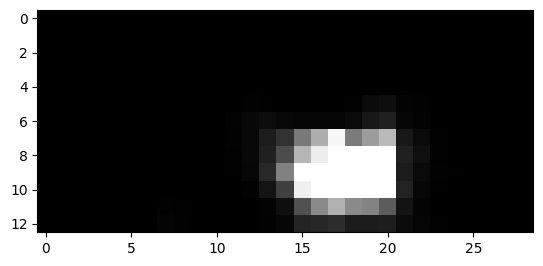

1087


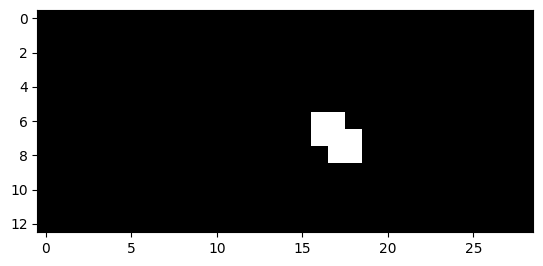

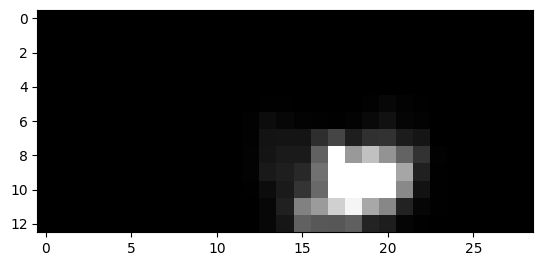

1088


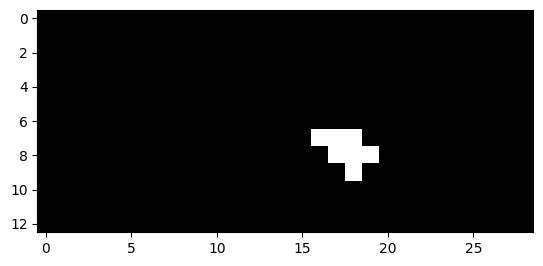

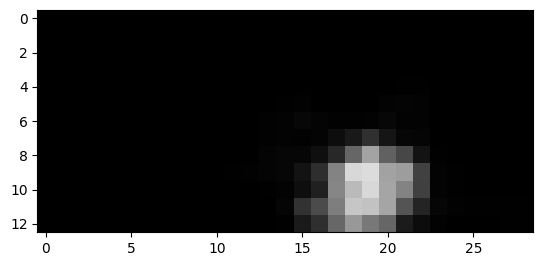

1089


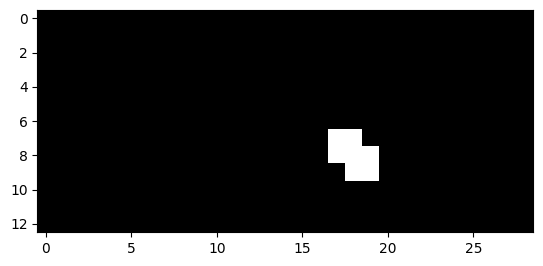

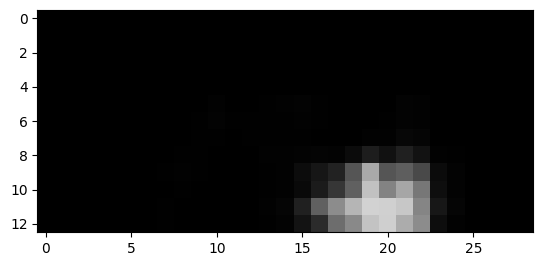

1090


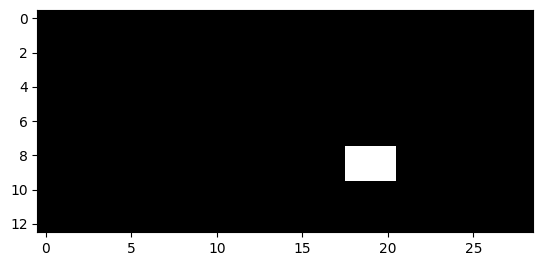

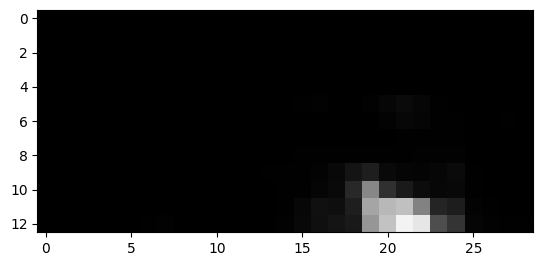

1091


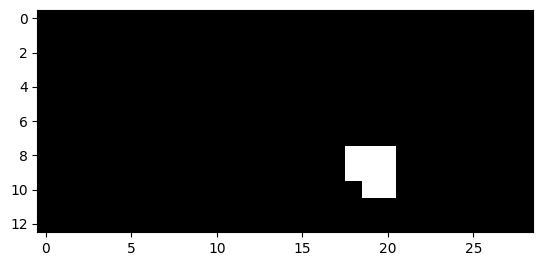

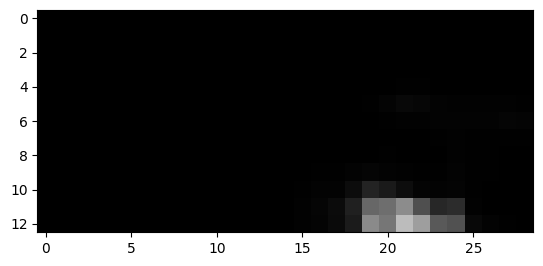

1092


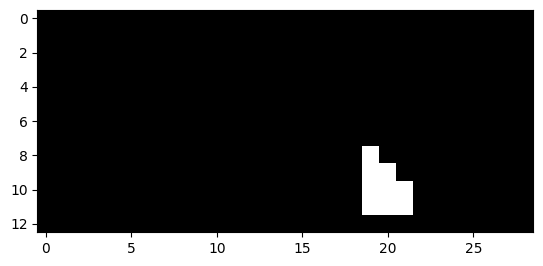

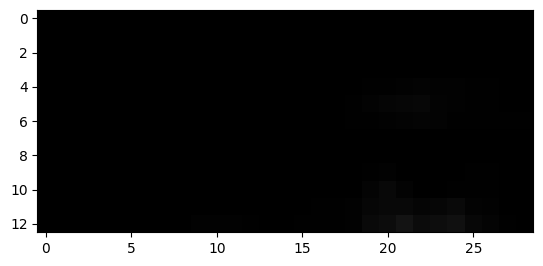

1093


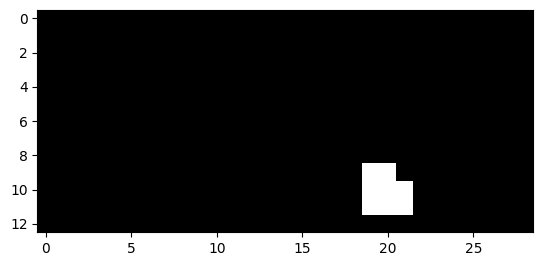

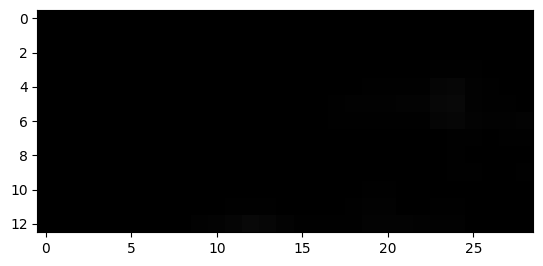

1094


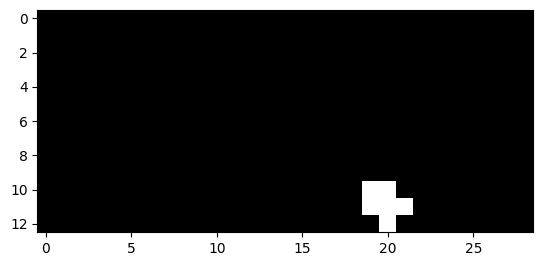

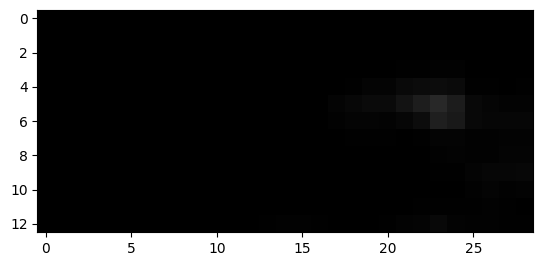

1095


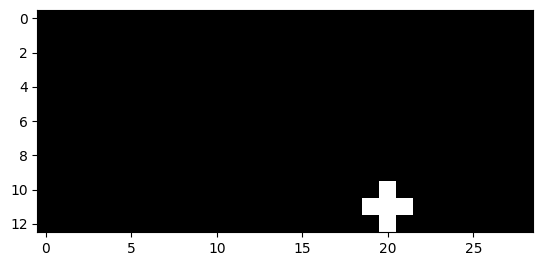

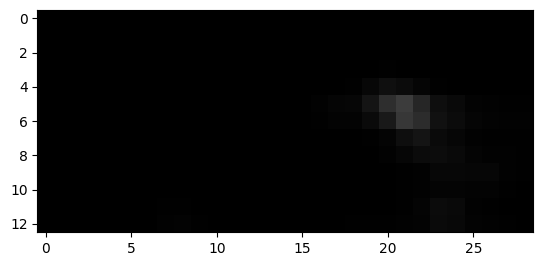

1116


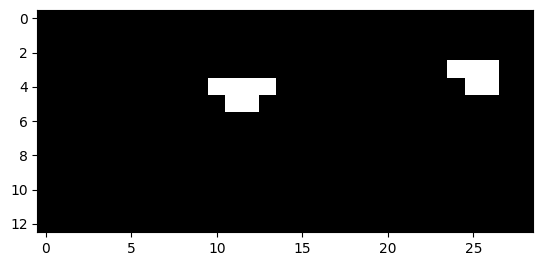

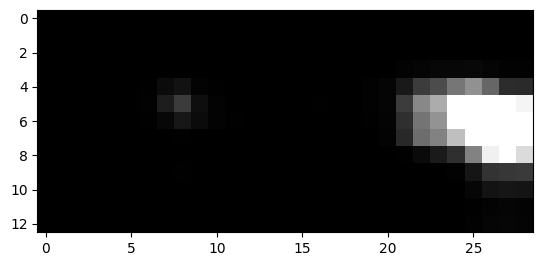

1117


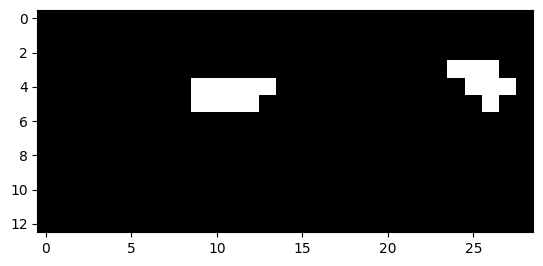

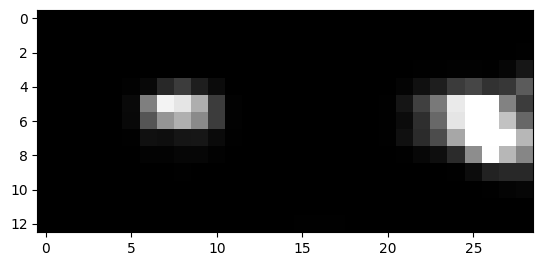

1118


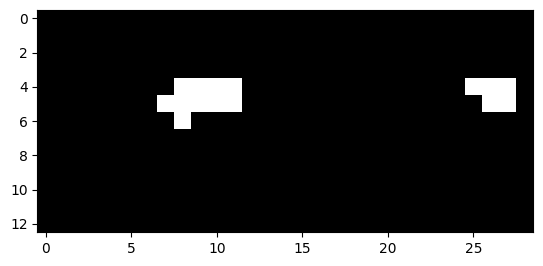

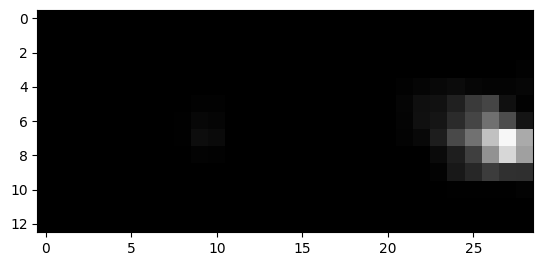

1119


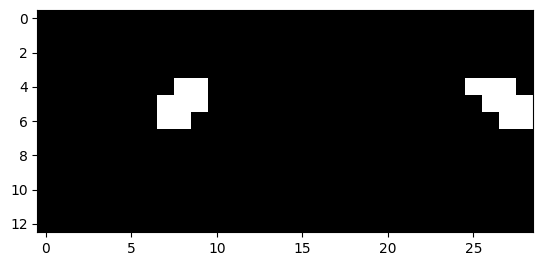

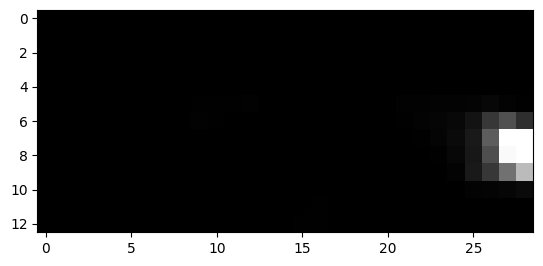

1120


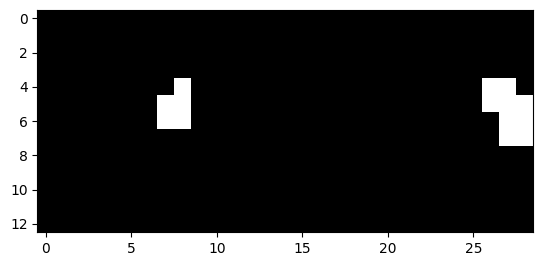

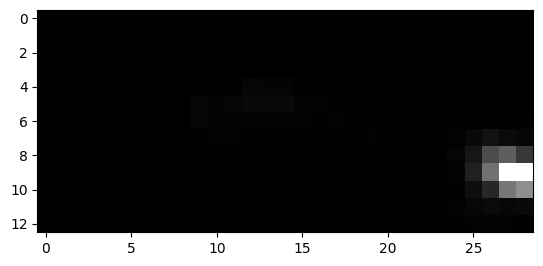

1121


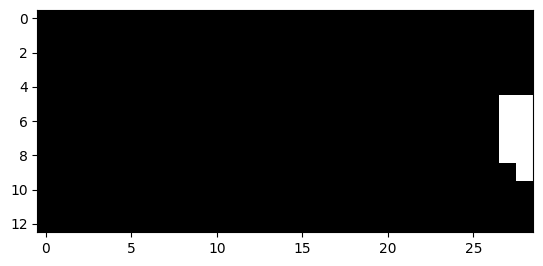

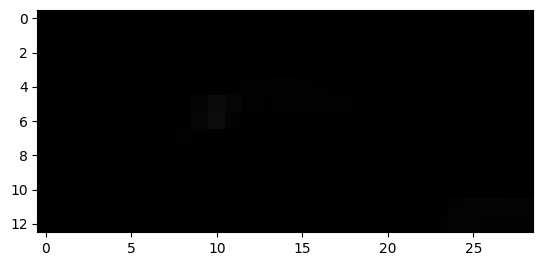

1122


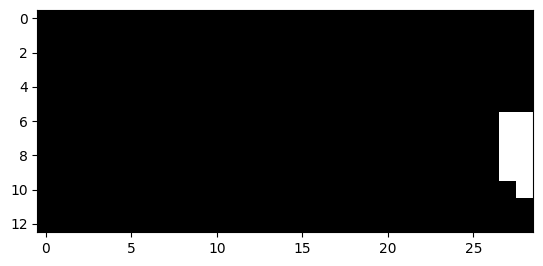

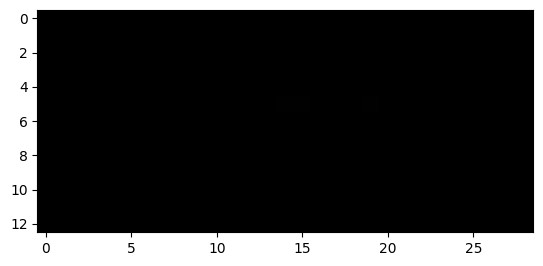

1123


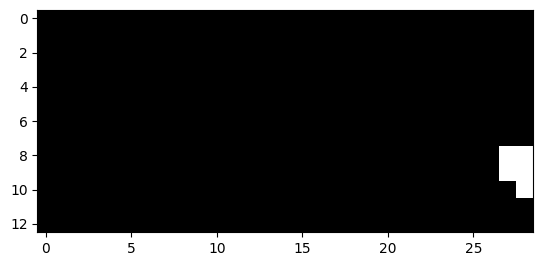

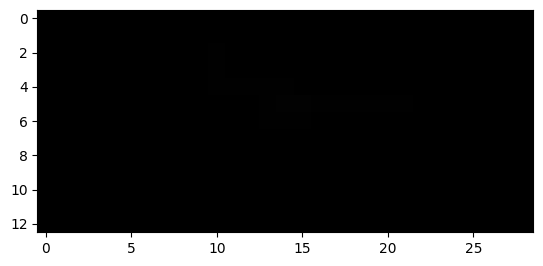

1341


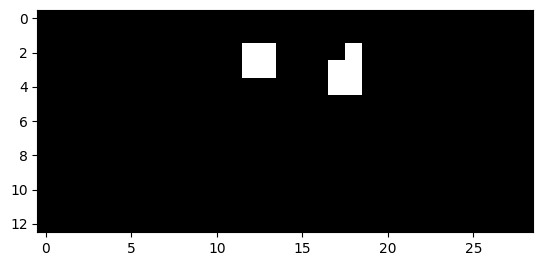

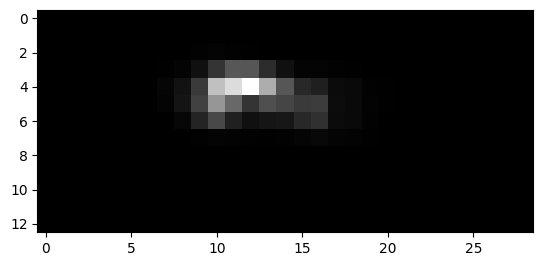

1342


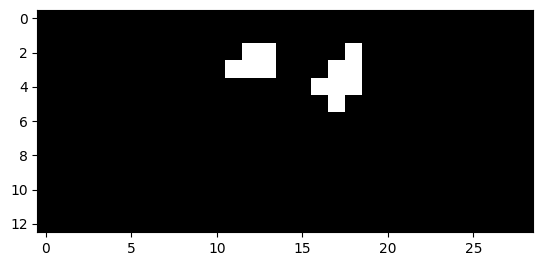

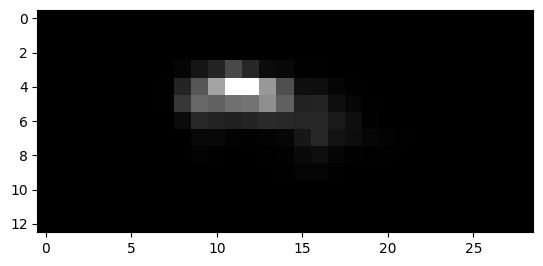

1343


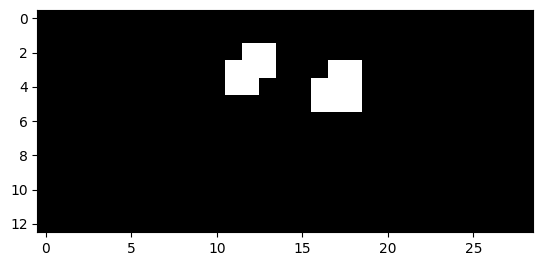

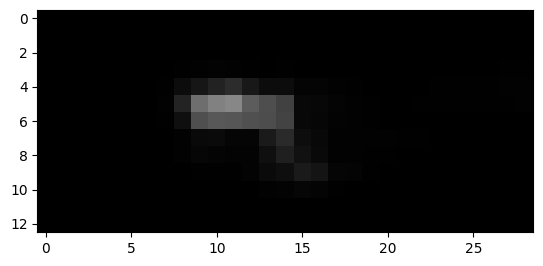

1344


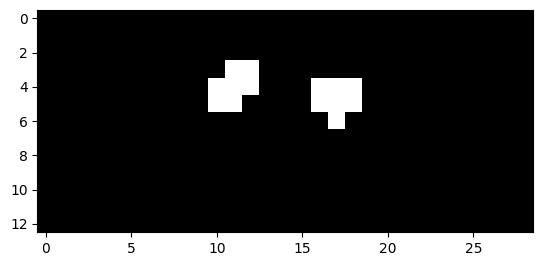

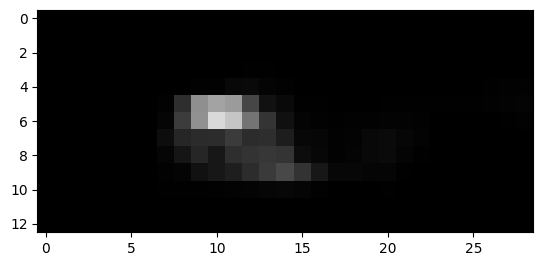

1345


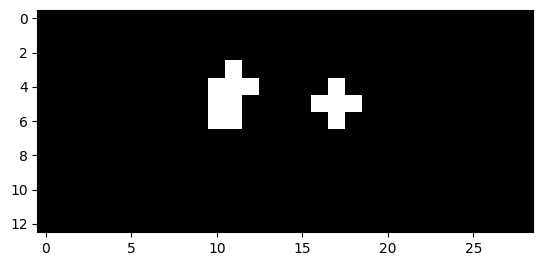

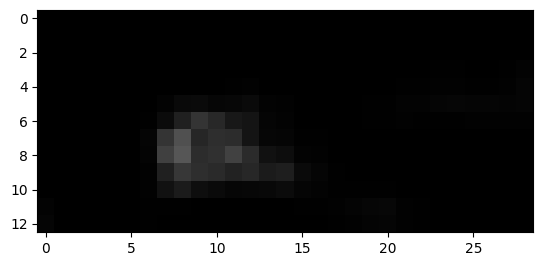

1346


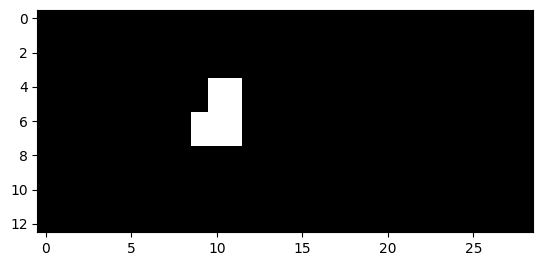

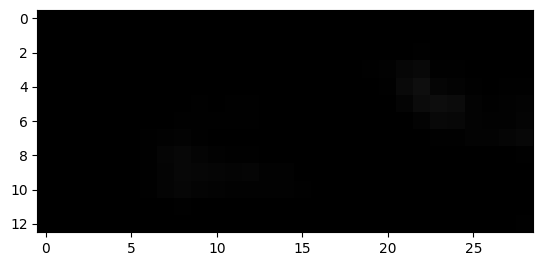

1347


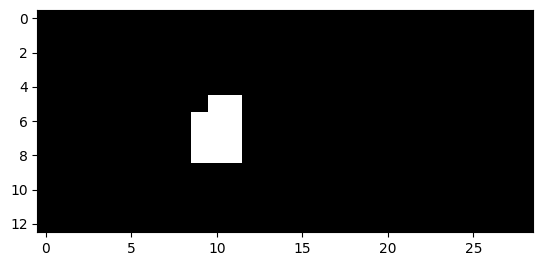

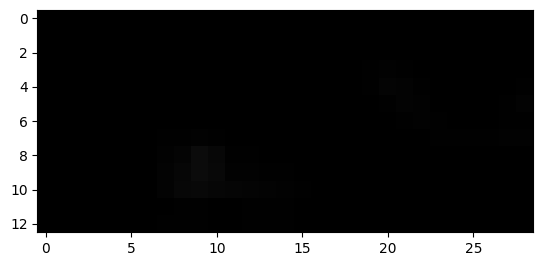

1348


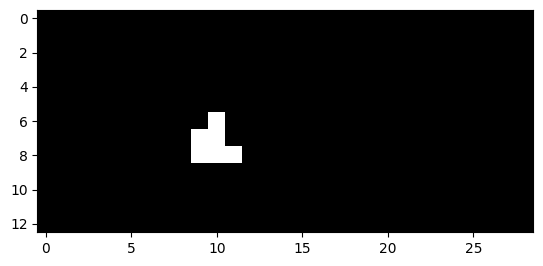

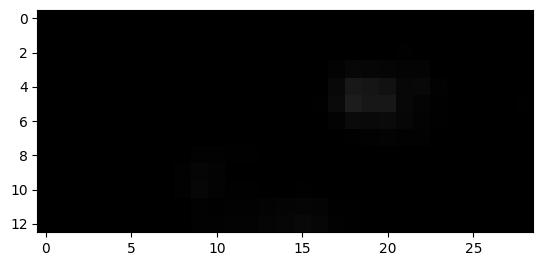

1366


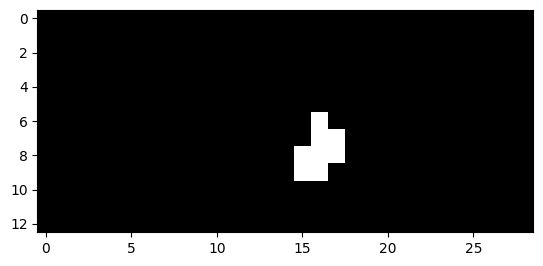

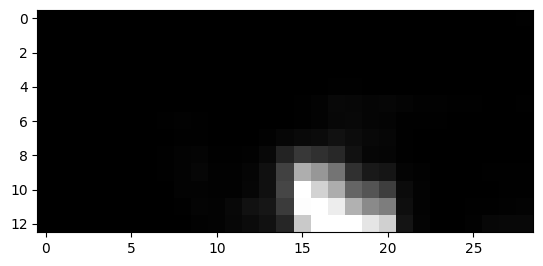

1367


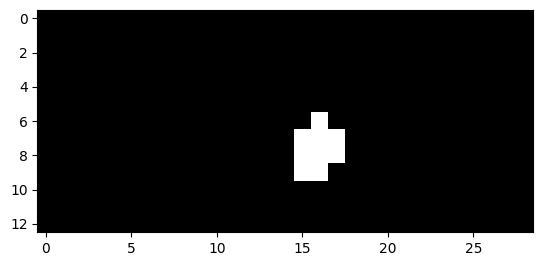

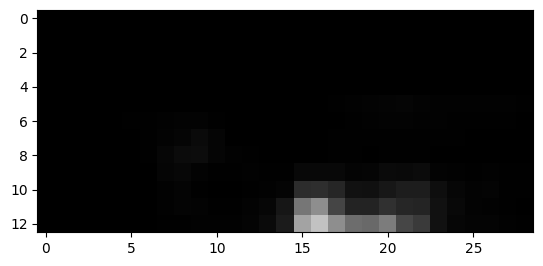

1368


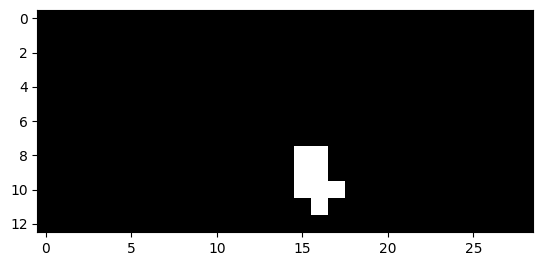

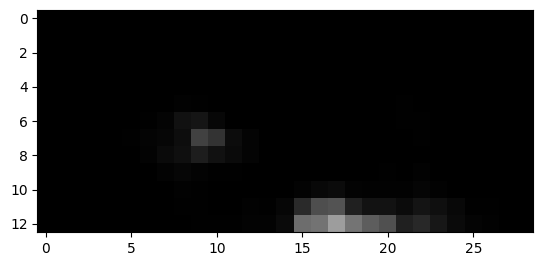

1369


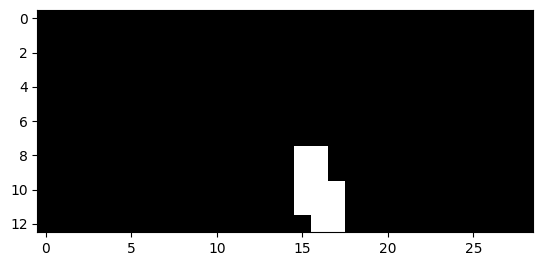

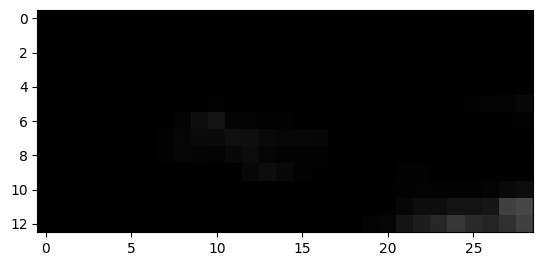

1370


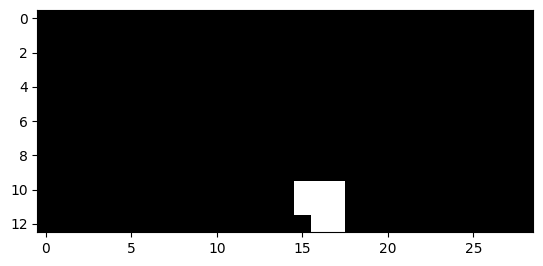

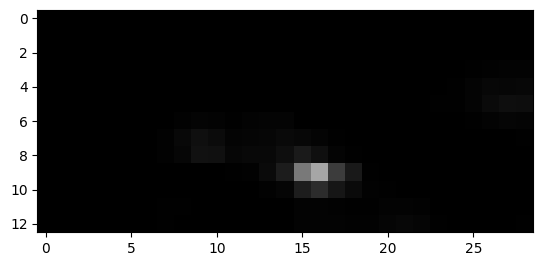

1371


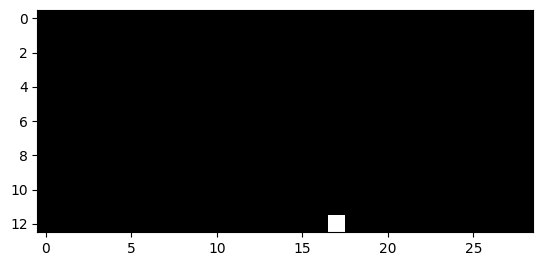

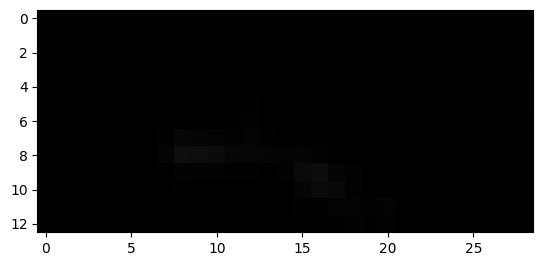

1389


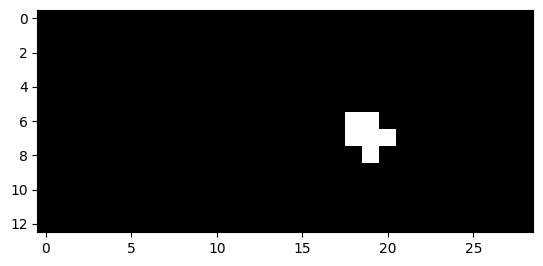

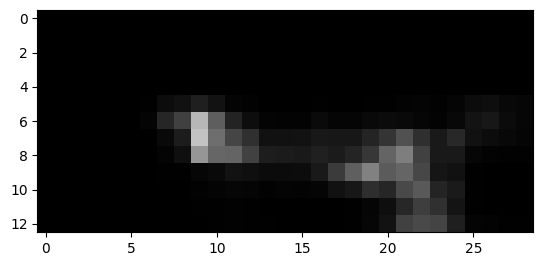

1390


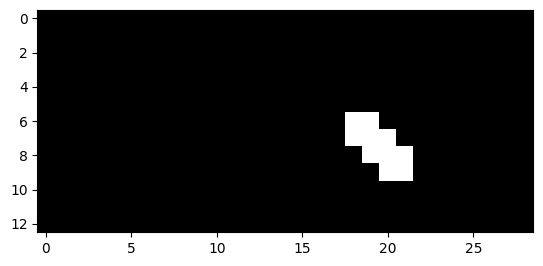

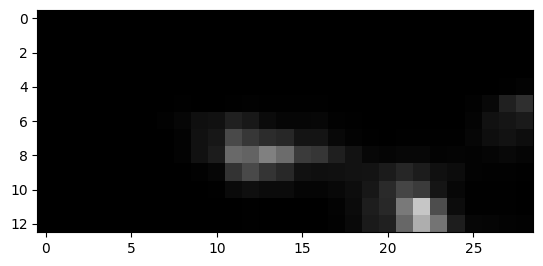

1391


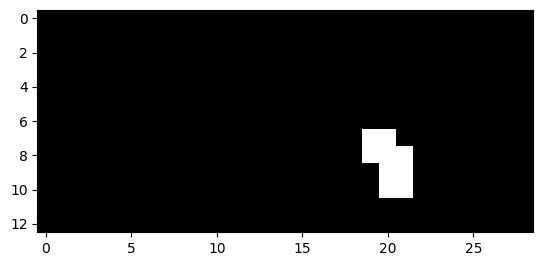

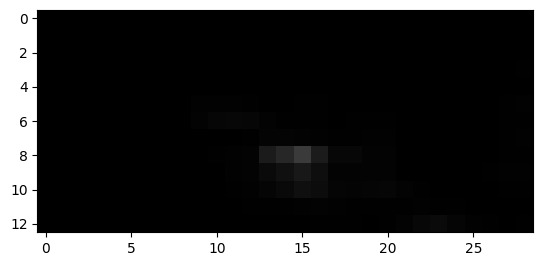

1392


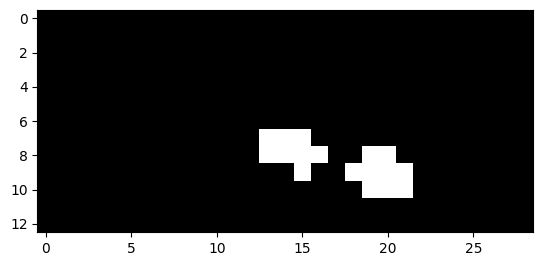

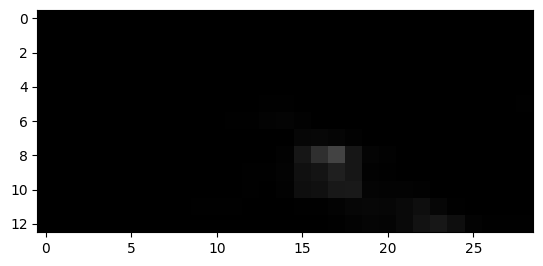

1393


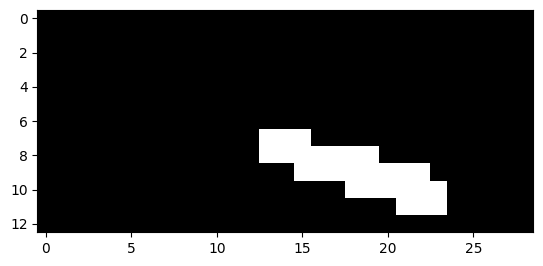

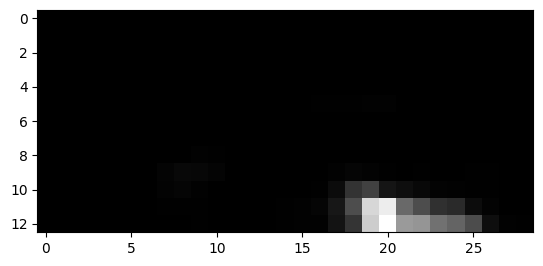

1394


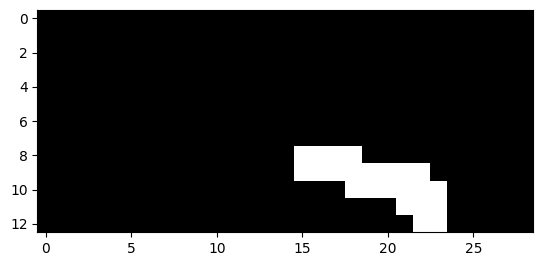

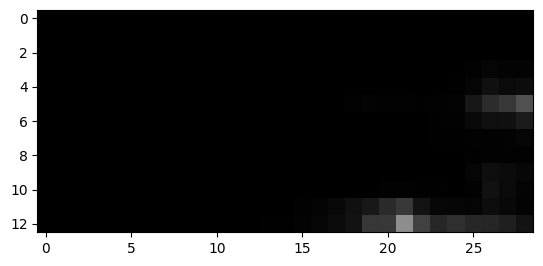

1395


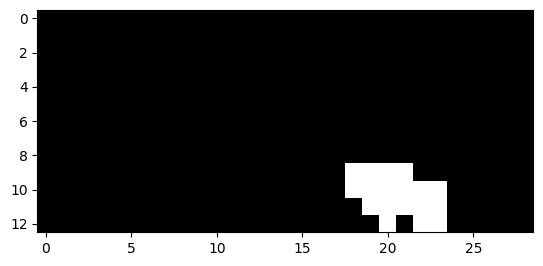

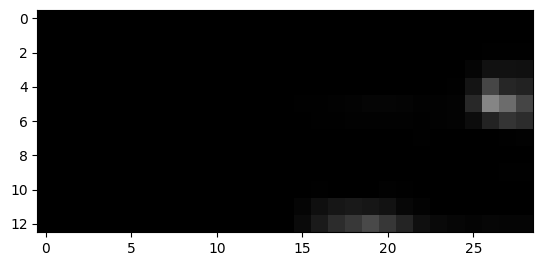

1396


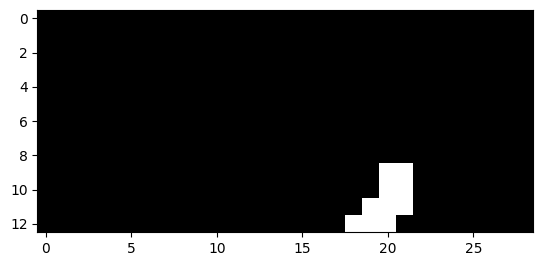

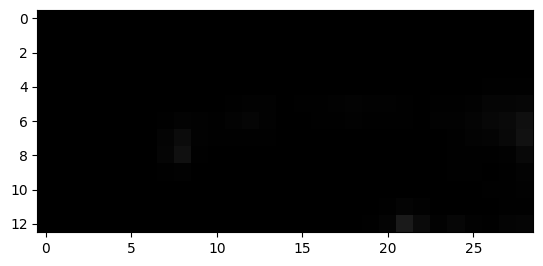

1397


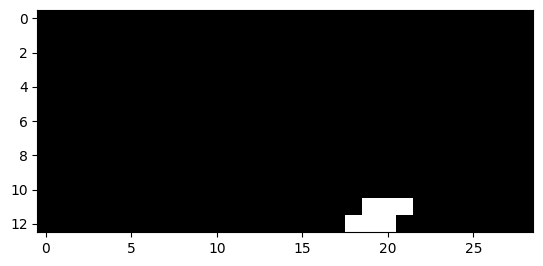

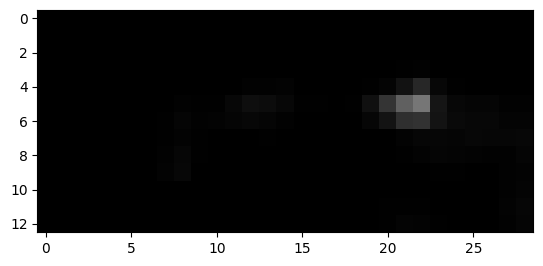

1398


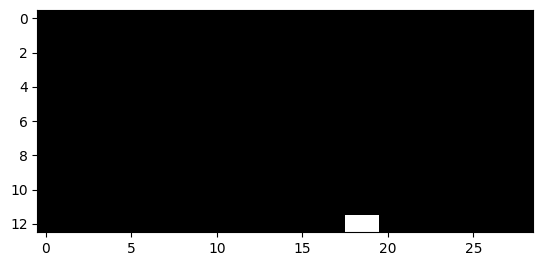

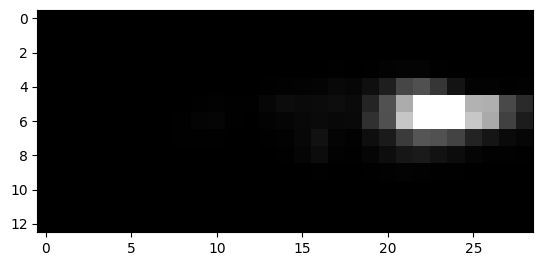

1403


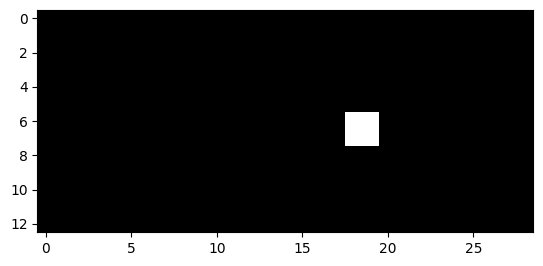

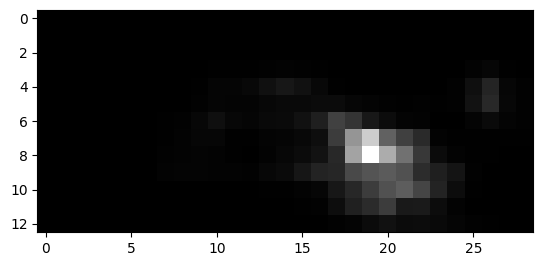

1404


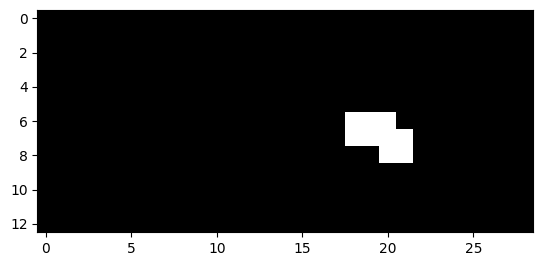

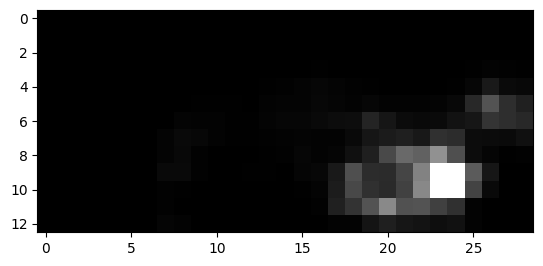

1405


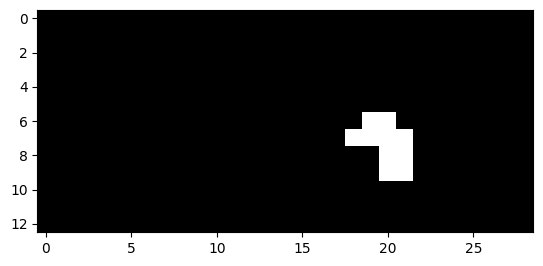

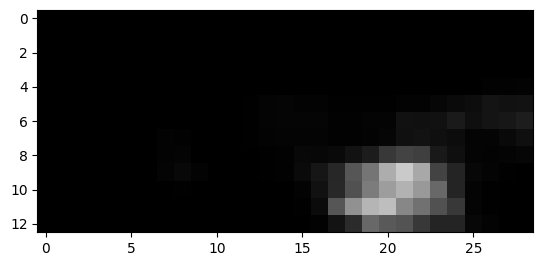

1406


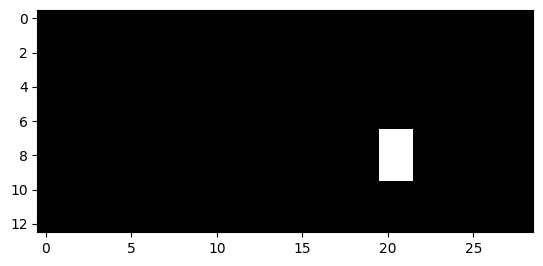

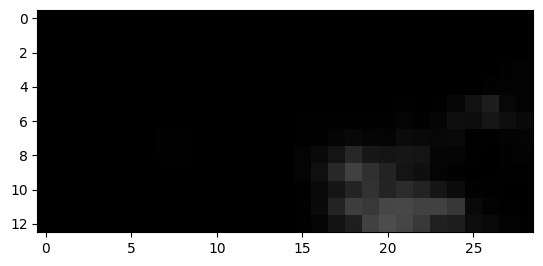

1407


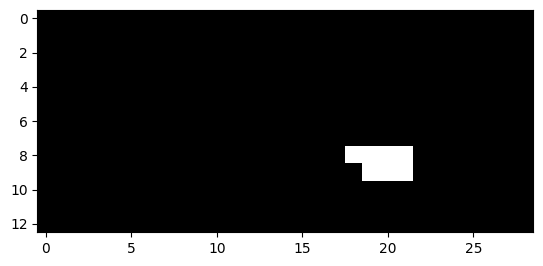

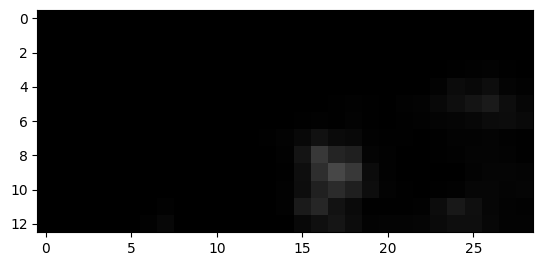

1408


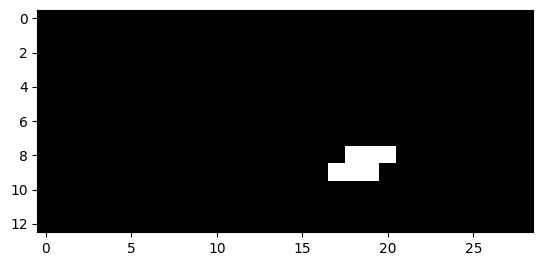

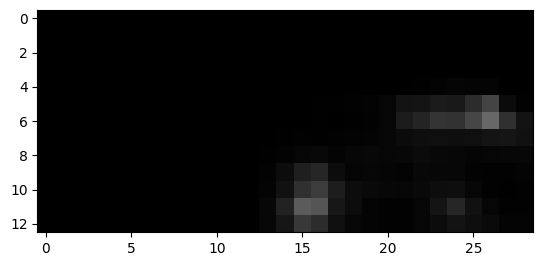

1409


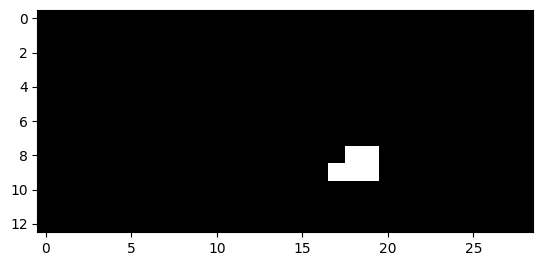

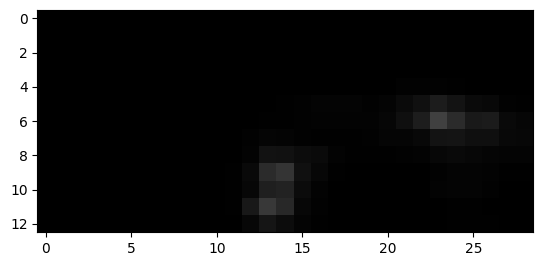

1412


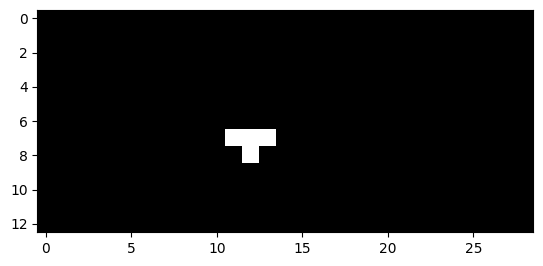

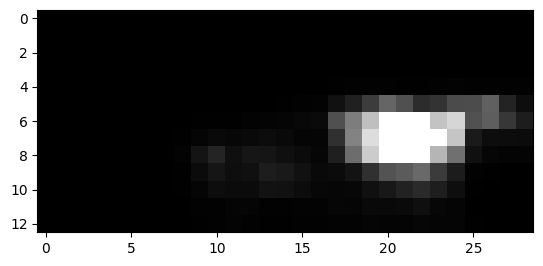

1413


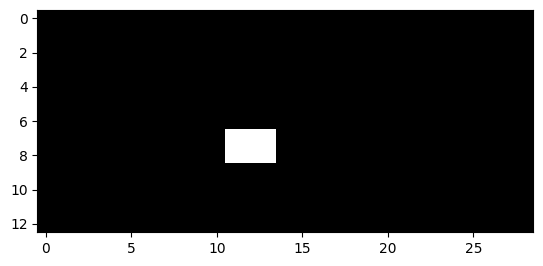

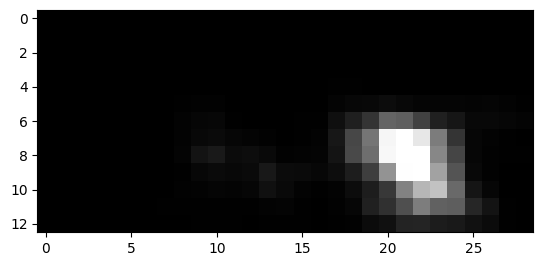

1414


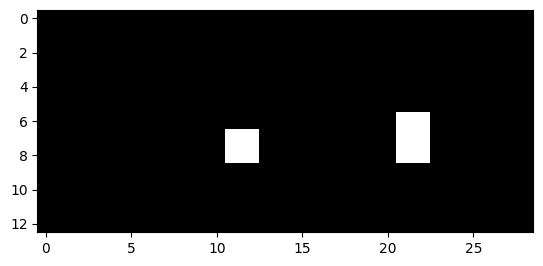

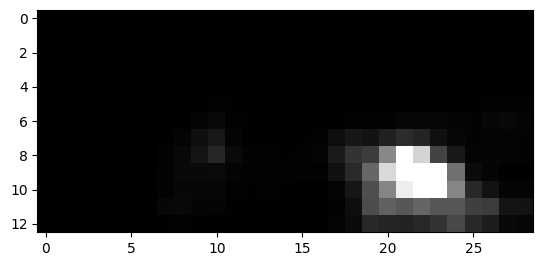

1415


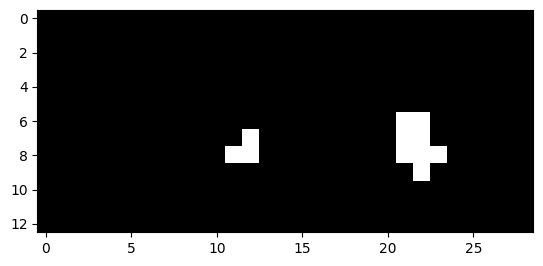

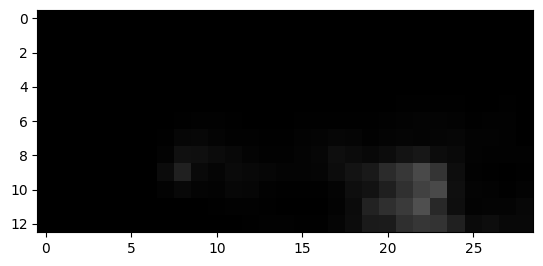

1416


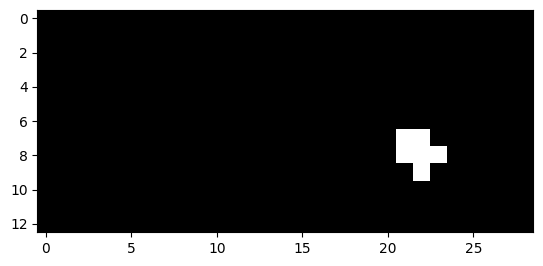

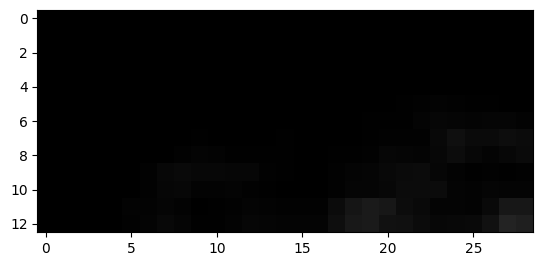

1417


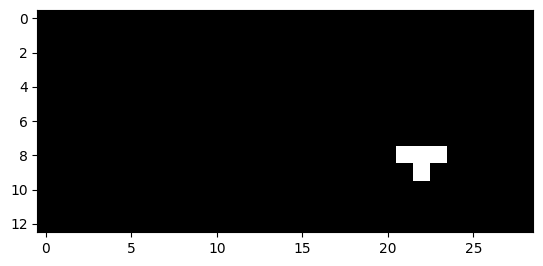

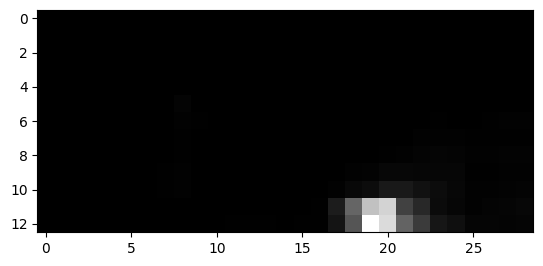

1419


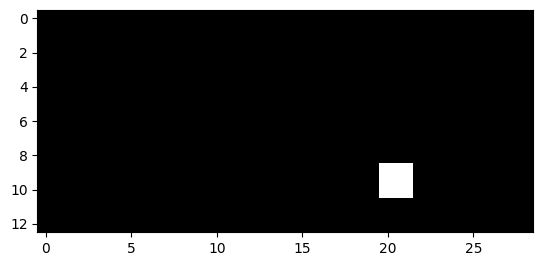

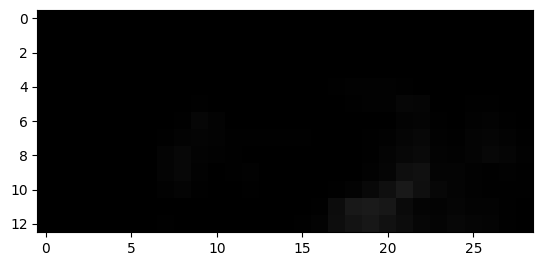

1420


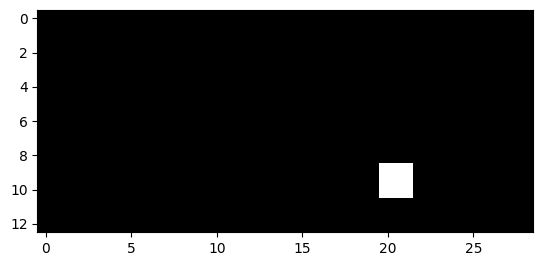

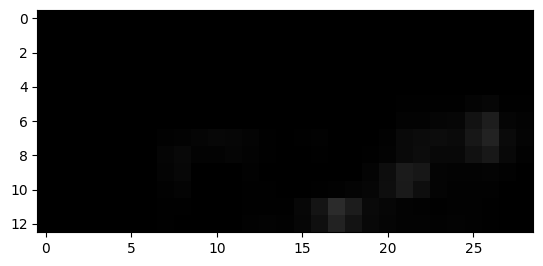

1441


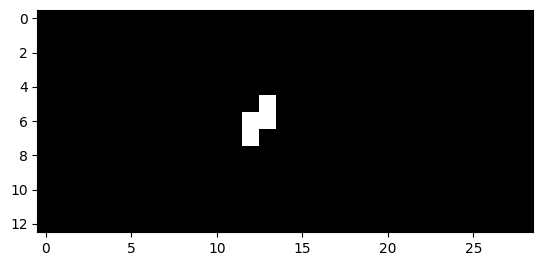

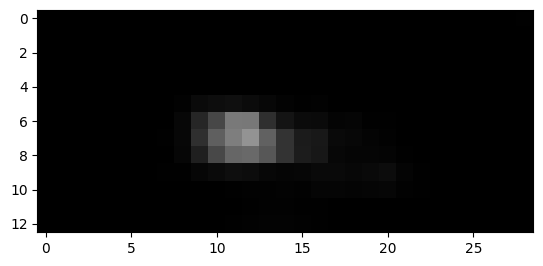

1442


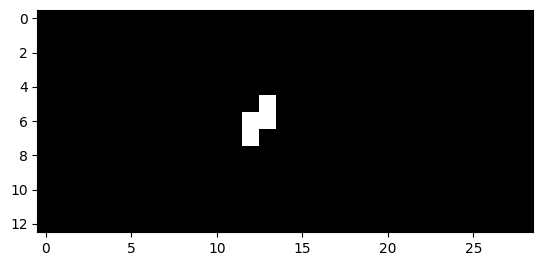

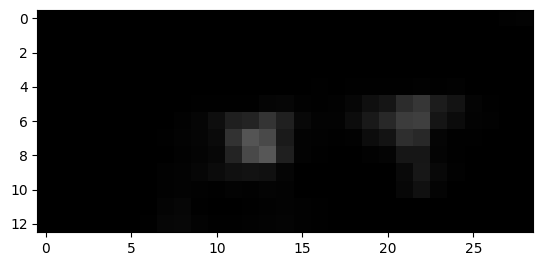

1443


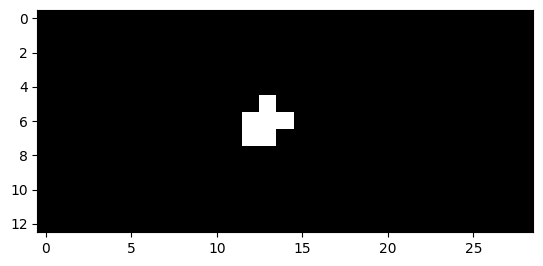

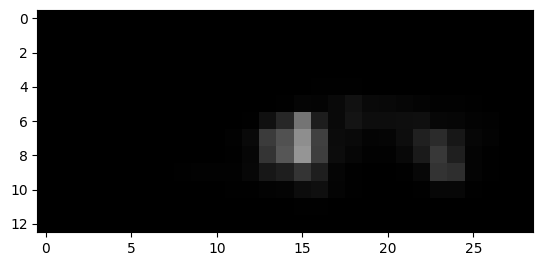

1444


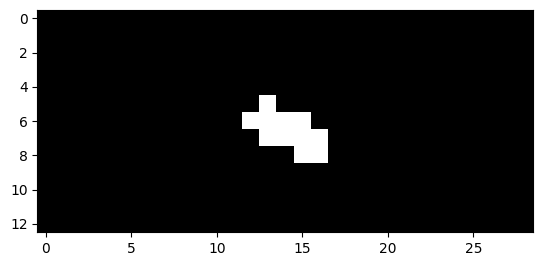

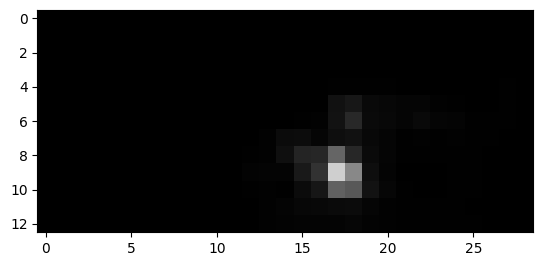

1445


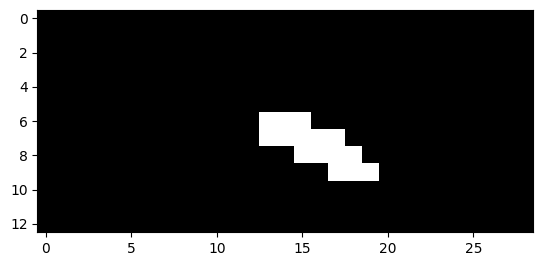

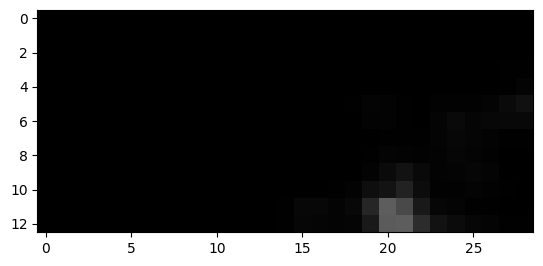

1446


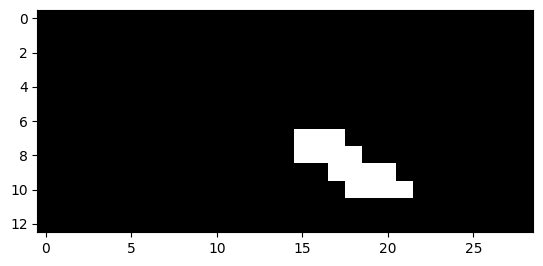

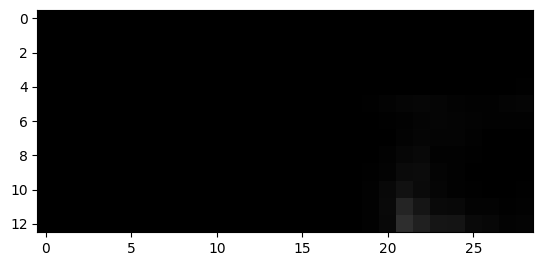

1447


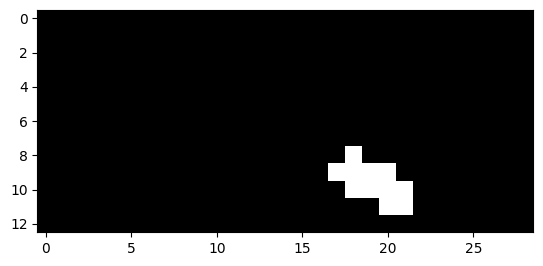

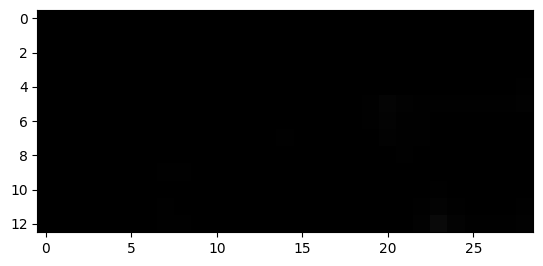

1448


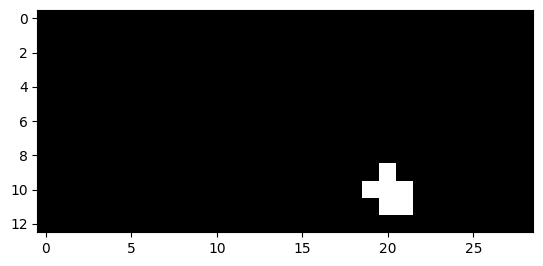

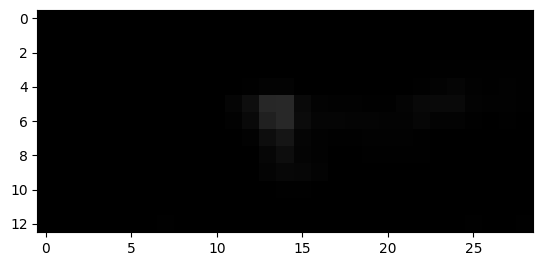

1460


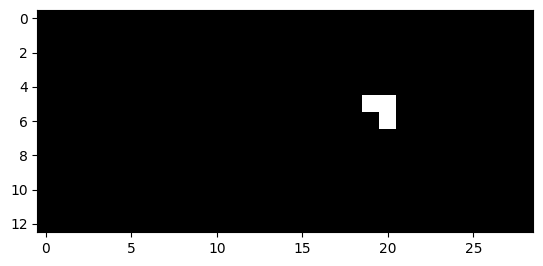

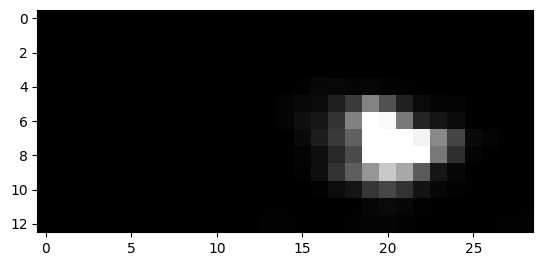

1461


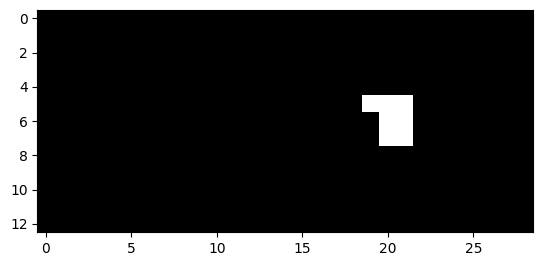

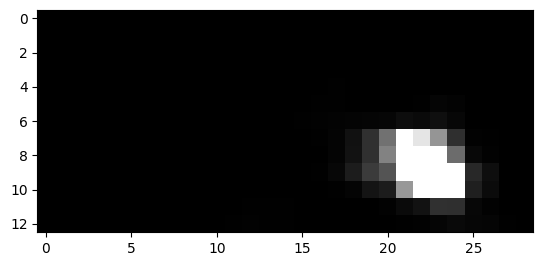

1462


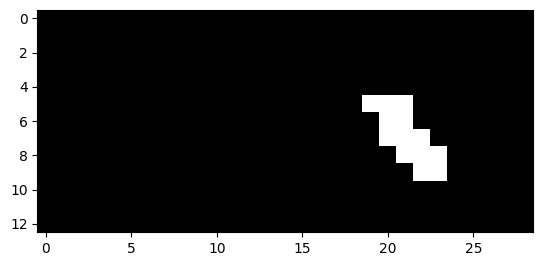

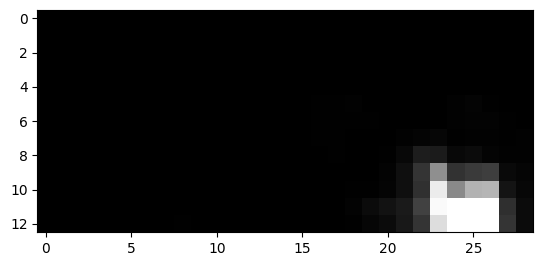

1463


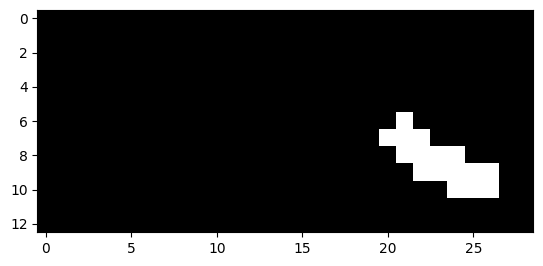

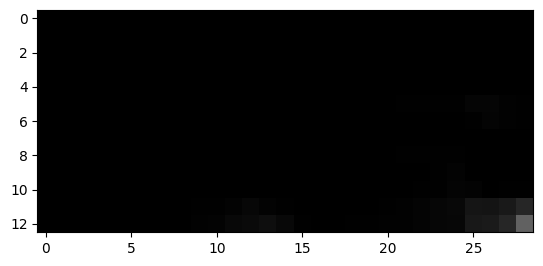

1464


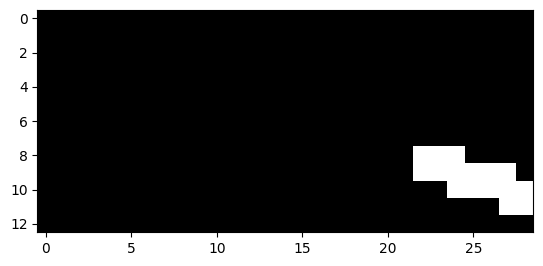

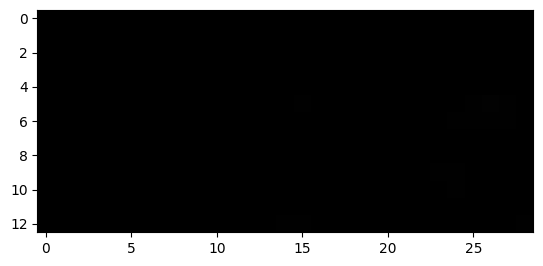

1465


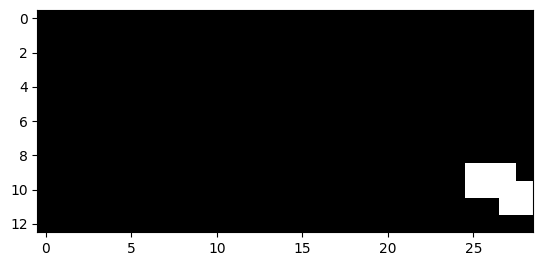

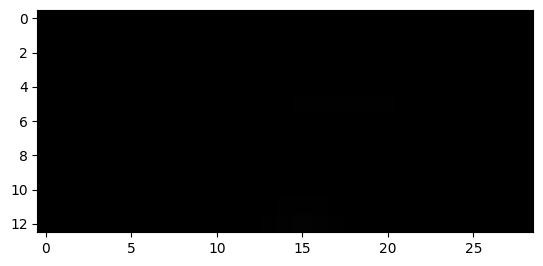

1466


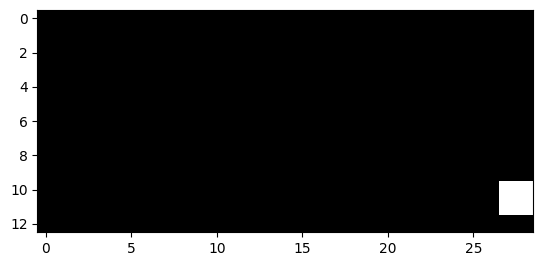

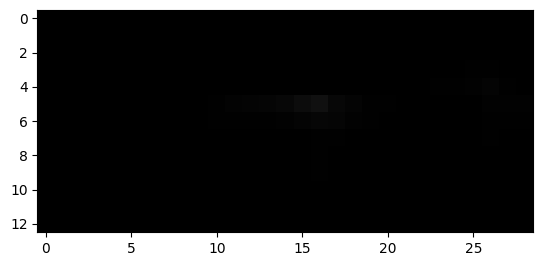

1473


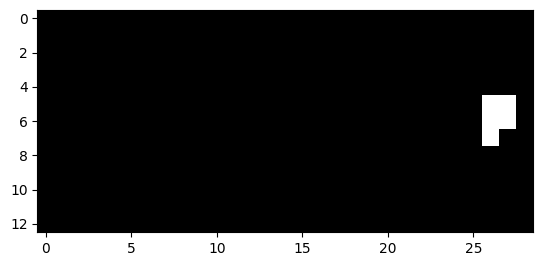

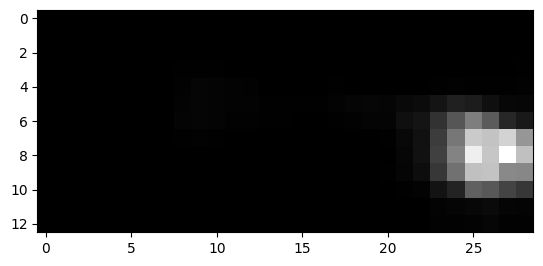

1474


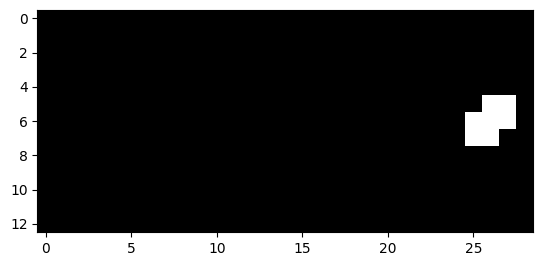

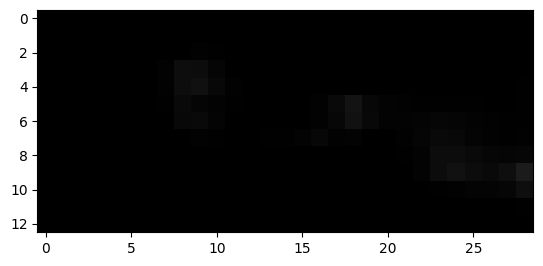

1475


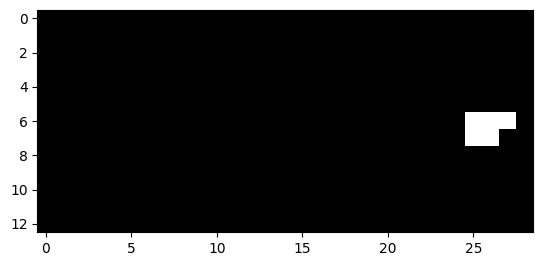

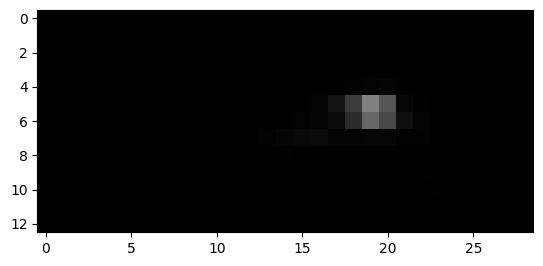

1509


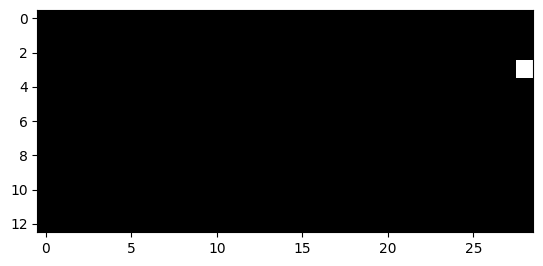

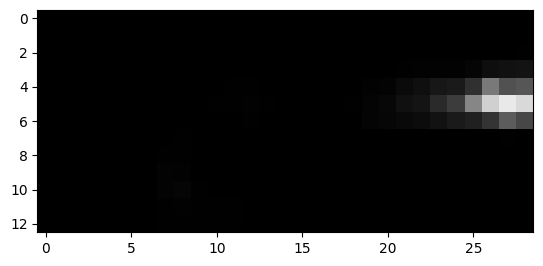

1510


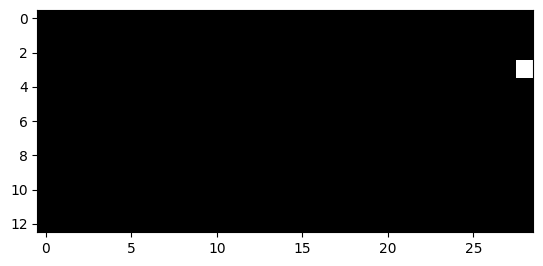

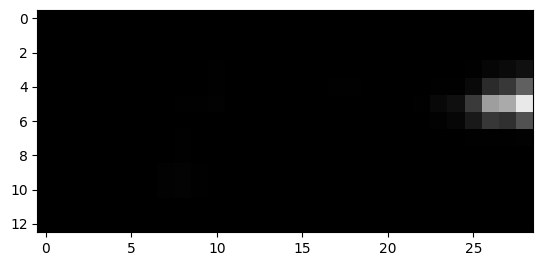

1511


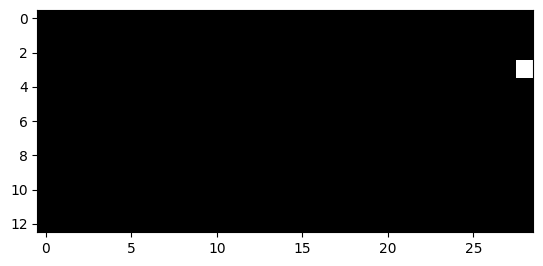

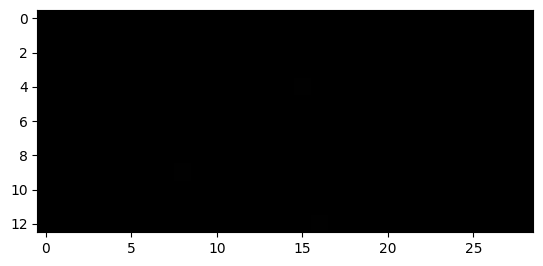

1687


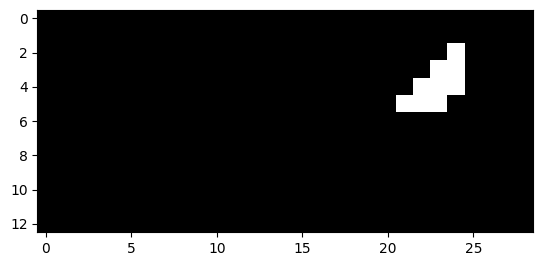

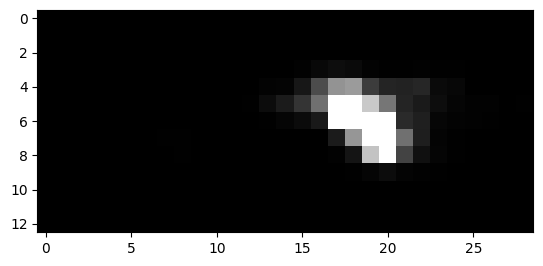

1688


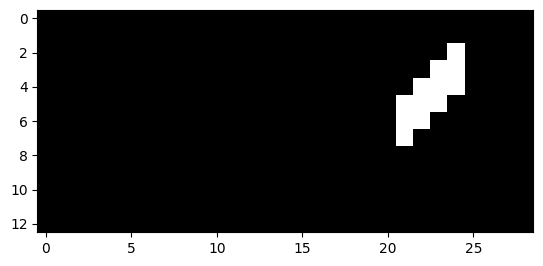

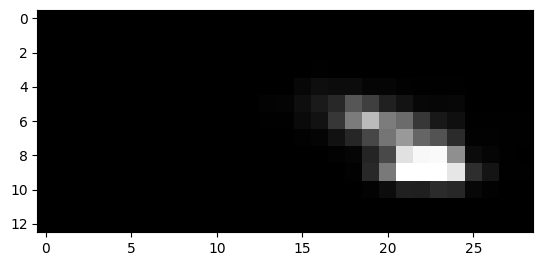

1689


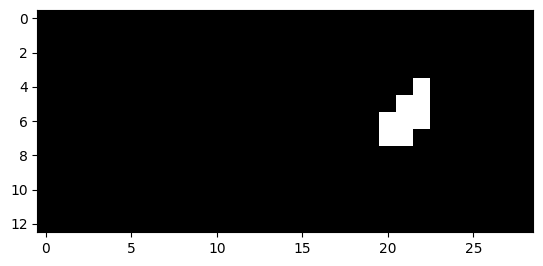

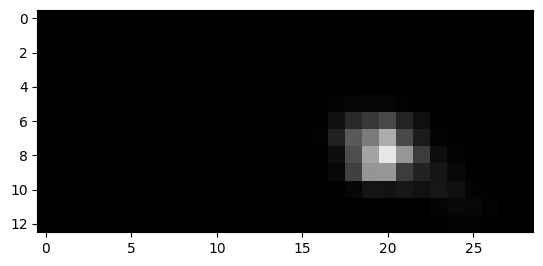

1690


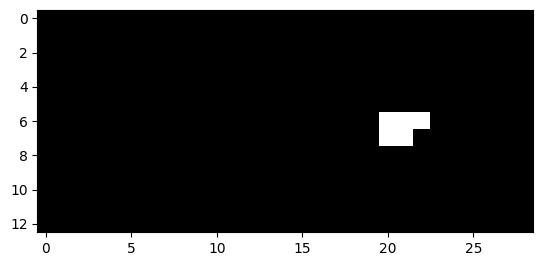

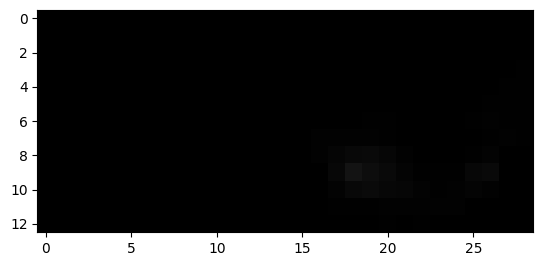

1691


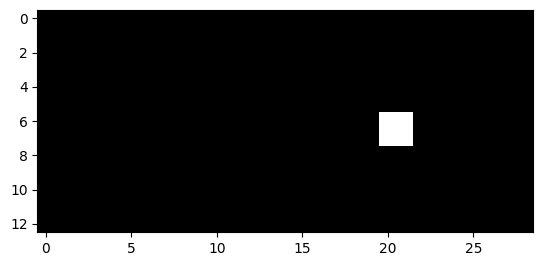

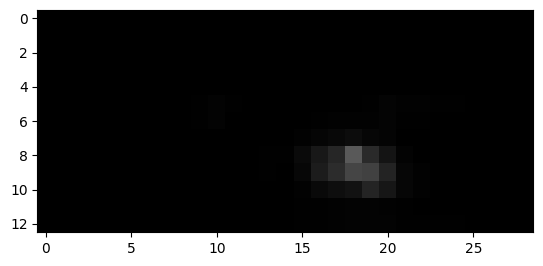

1710


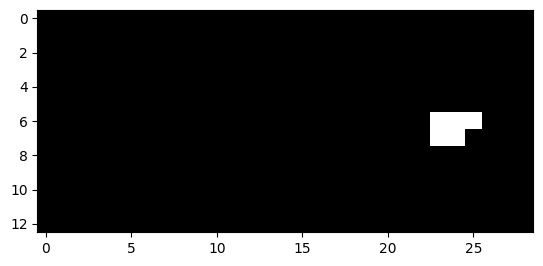

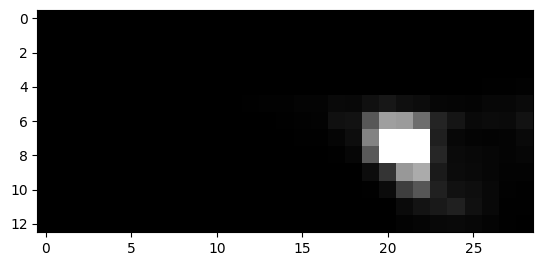

1711


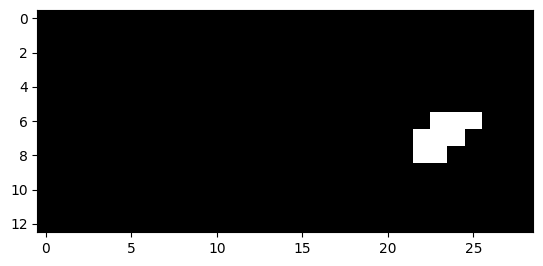

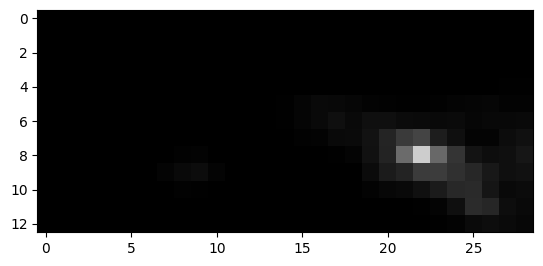

1712


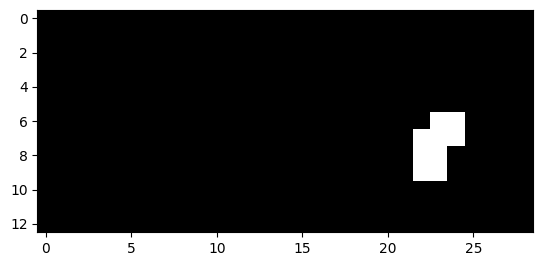

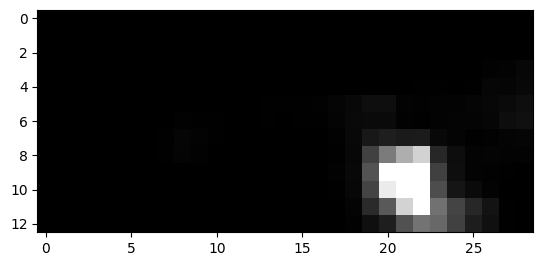

1713


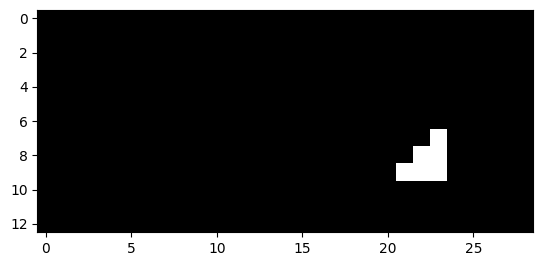

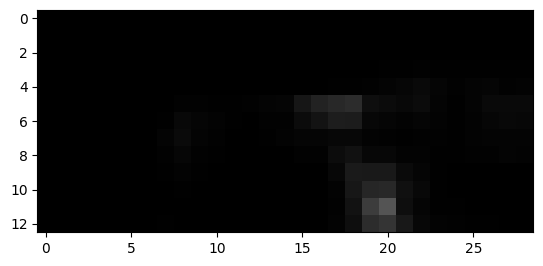

1714


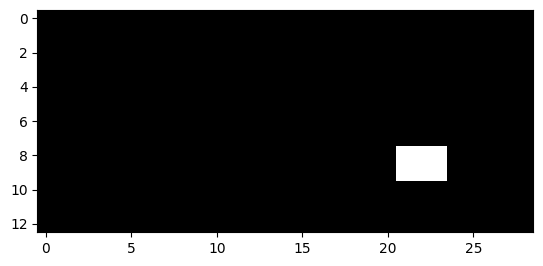

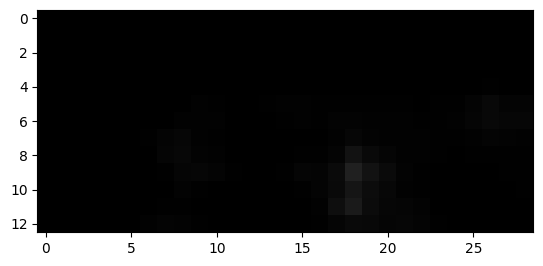

1715


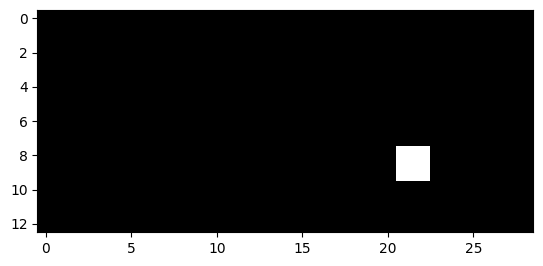

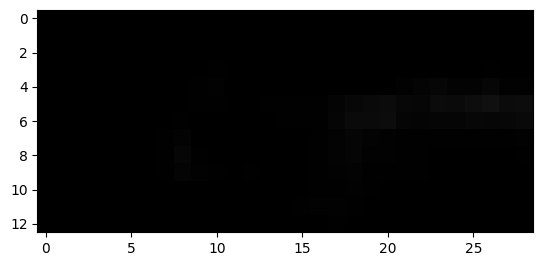

1728


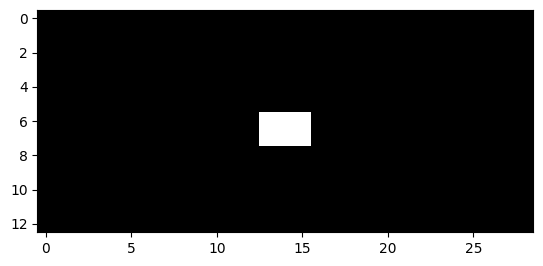

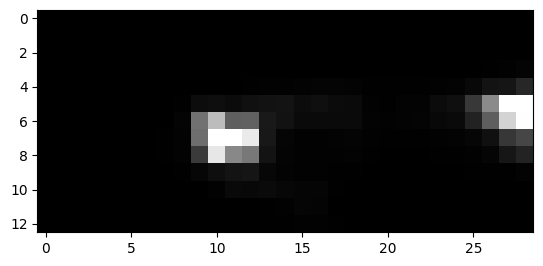

1729


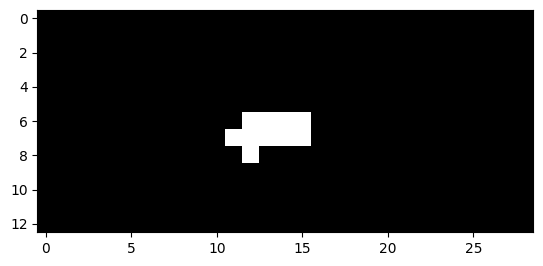

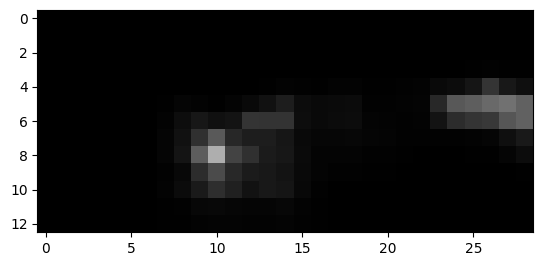

1730


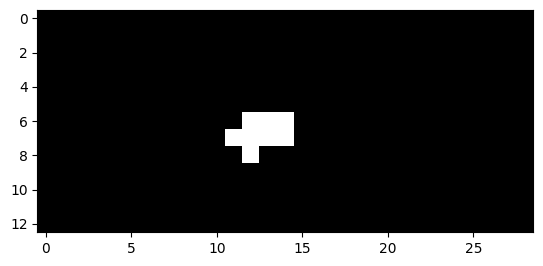

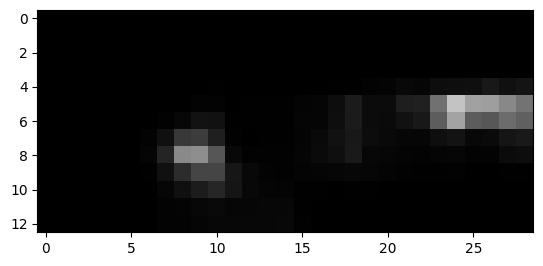

1731


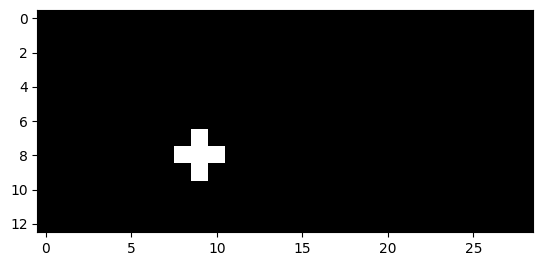

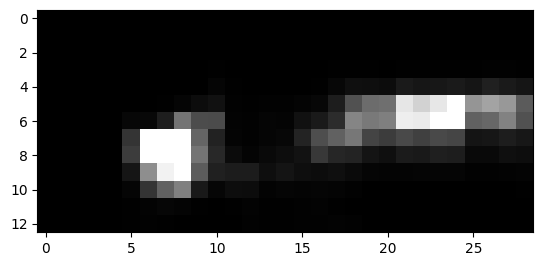

1732


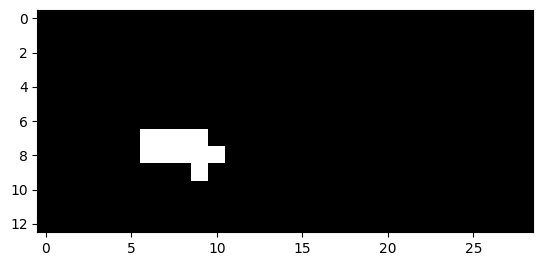

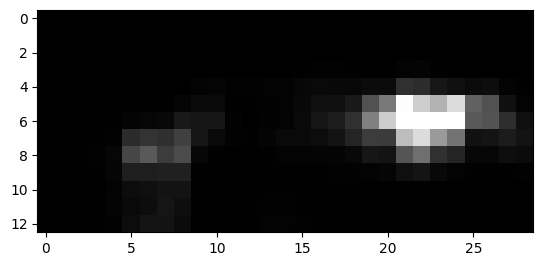

1733


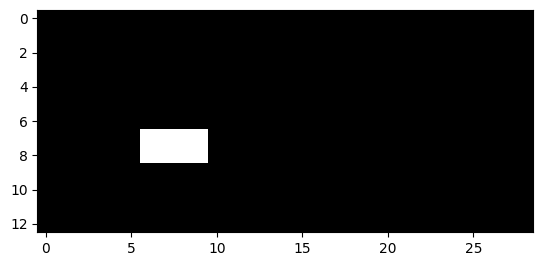

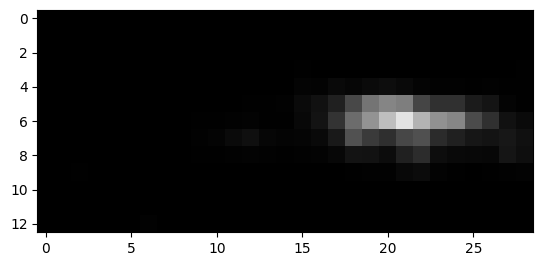

1735


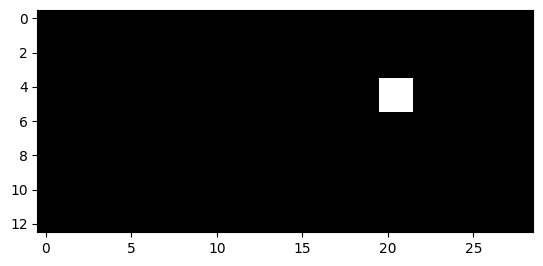

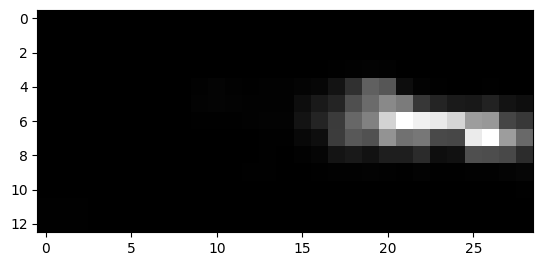

1736


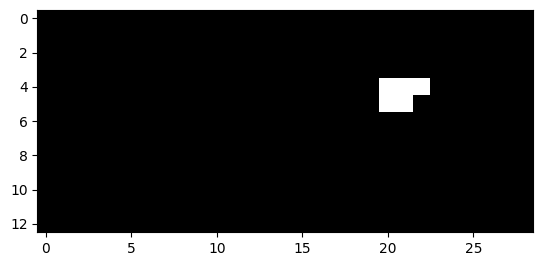

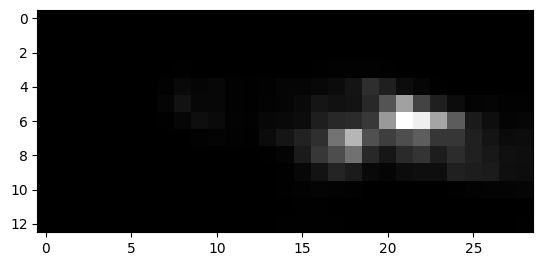

1737


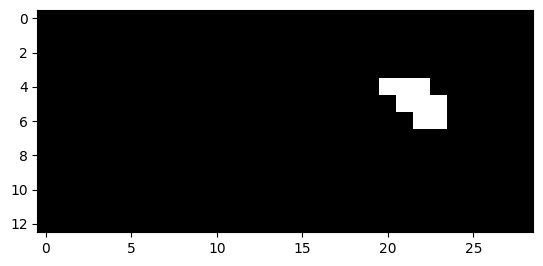

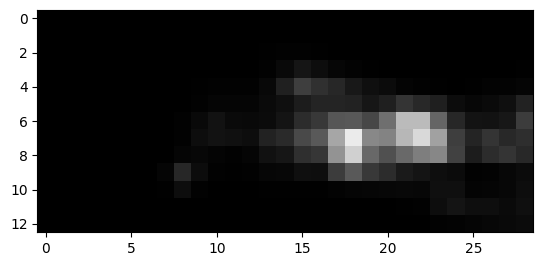

1738


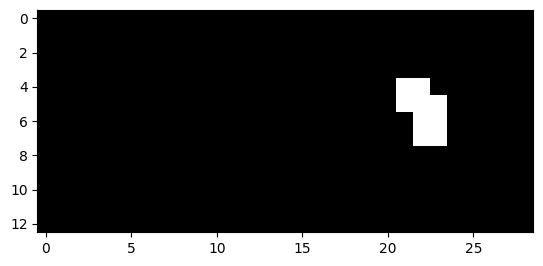

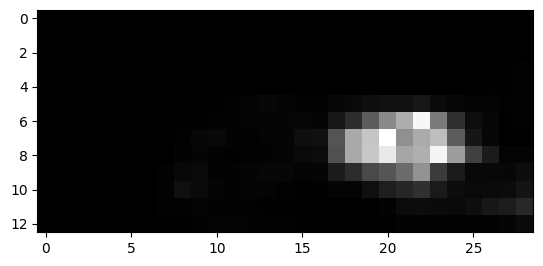

1739


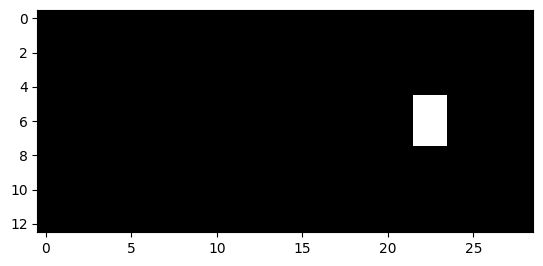

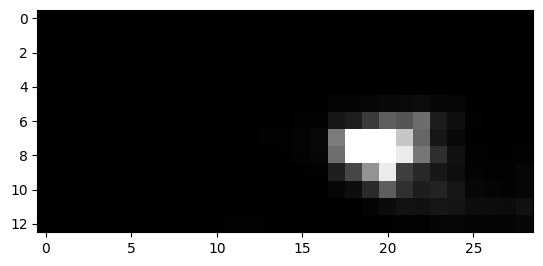

1740


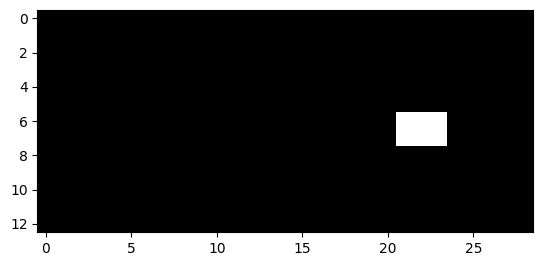

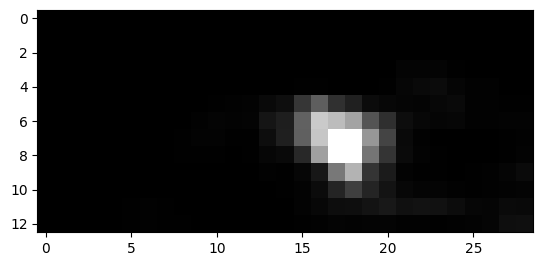

1741


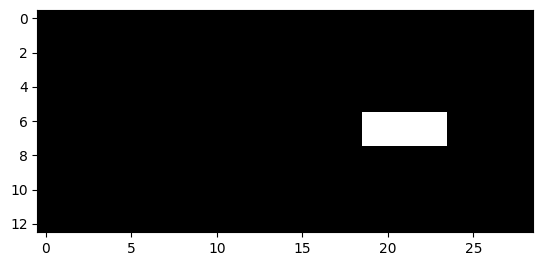

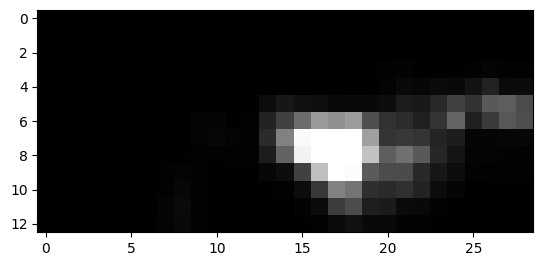

1742


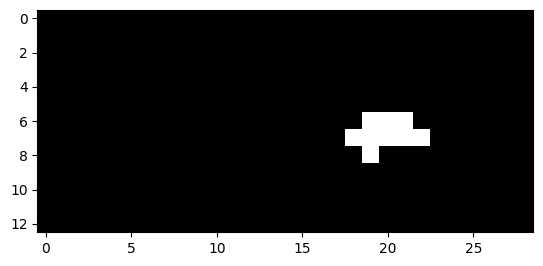

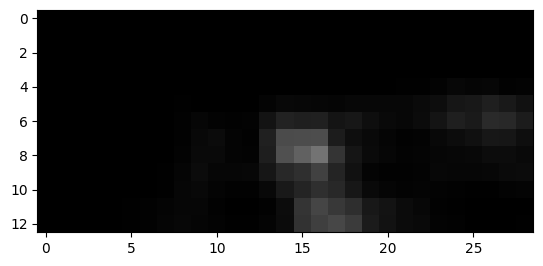

1743


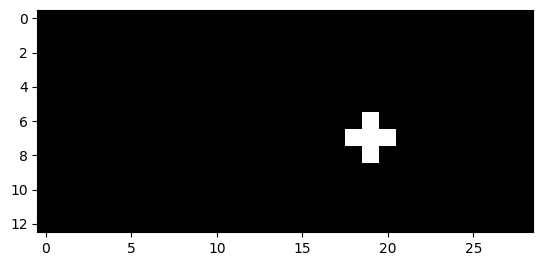

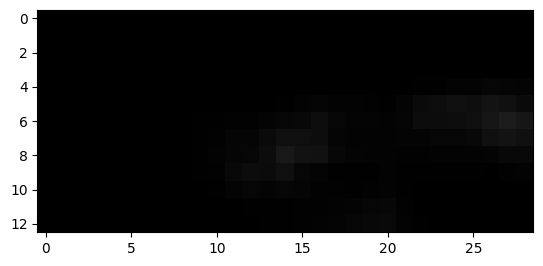

1750


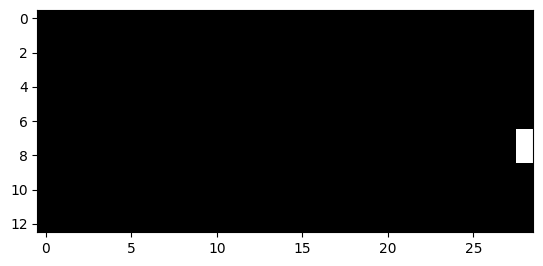

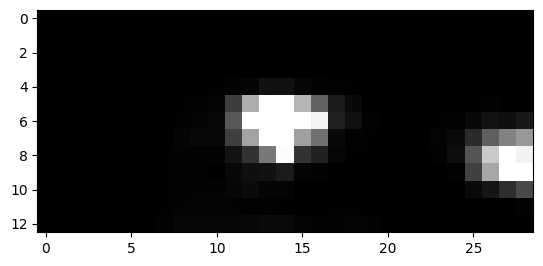

1751


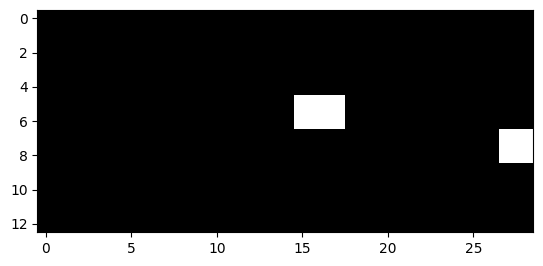

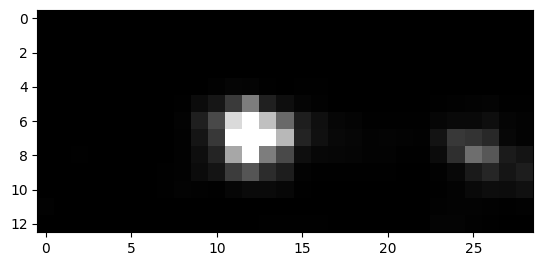

1752


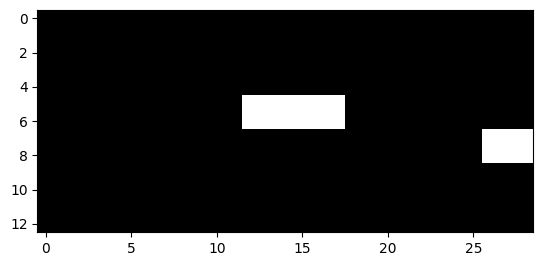

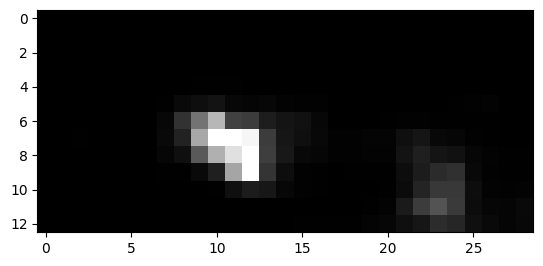

1753


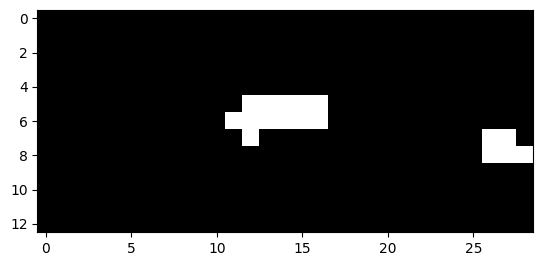

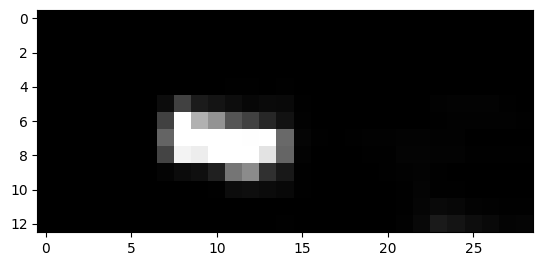

1754


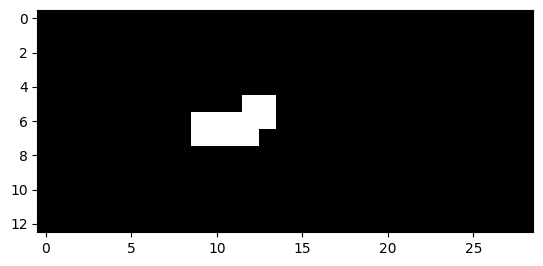

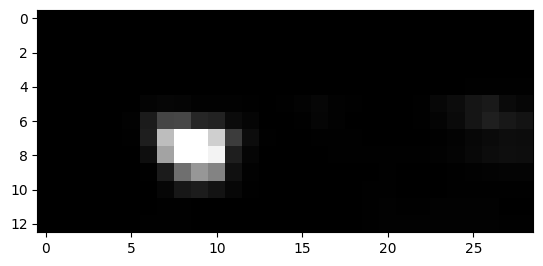

1755


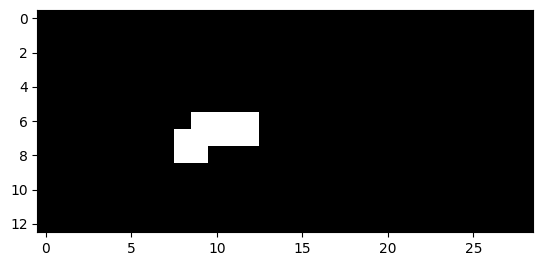

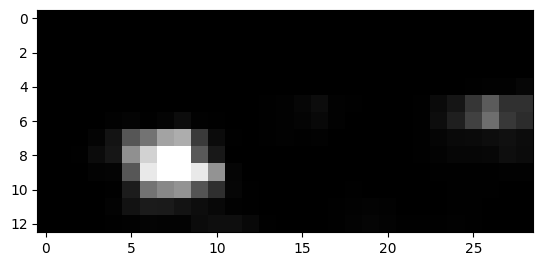

1756


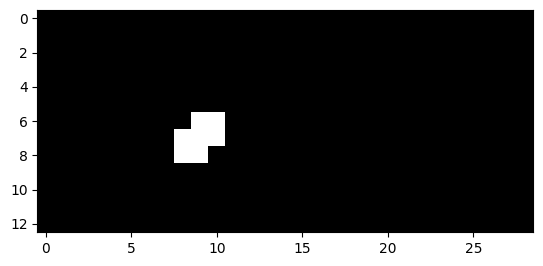

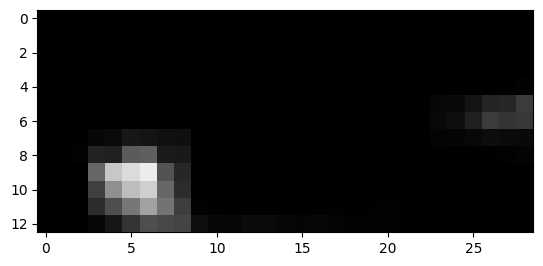

1760


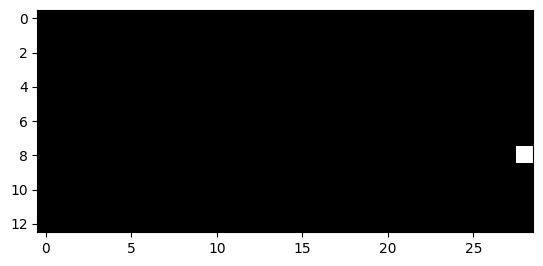

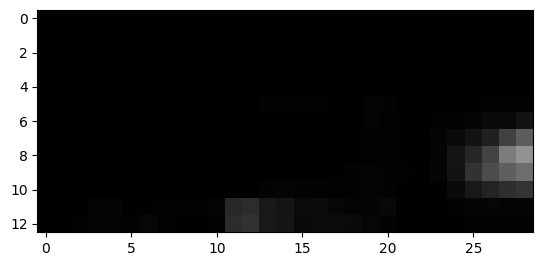

1761


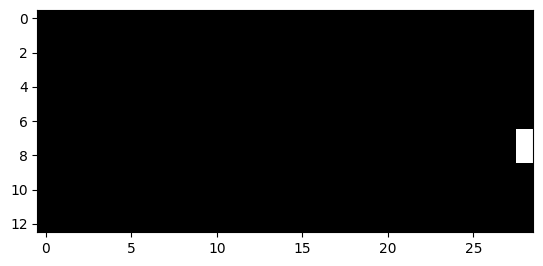

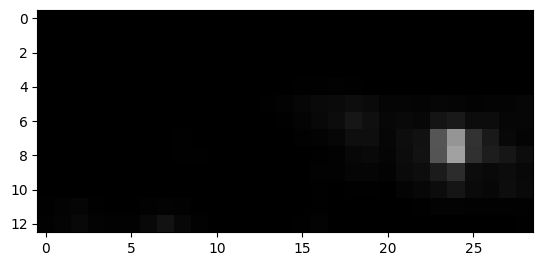

1762


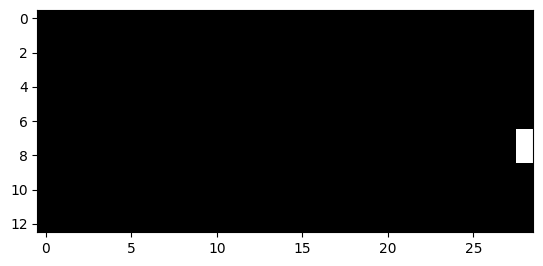

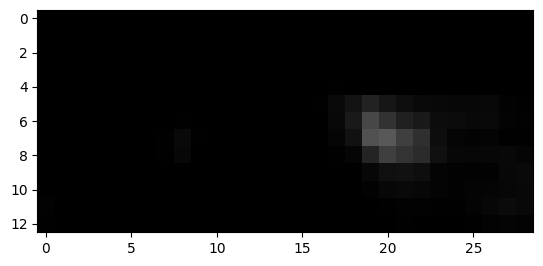

1770


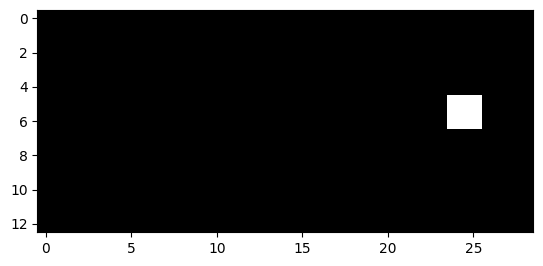

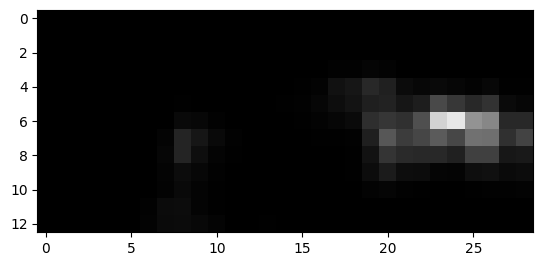

1771


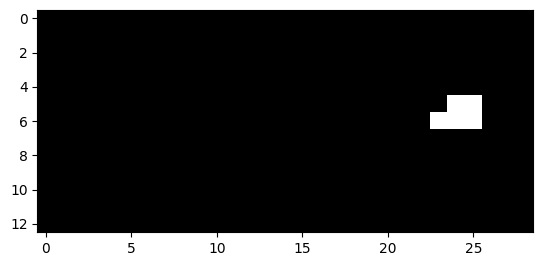

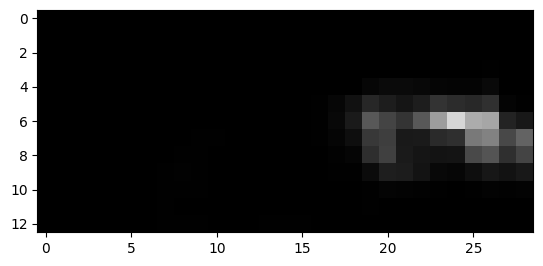

1772


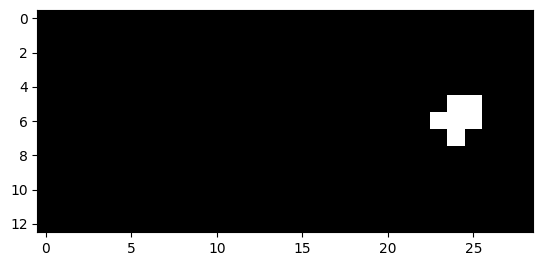

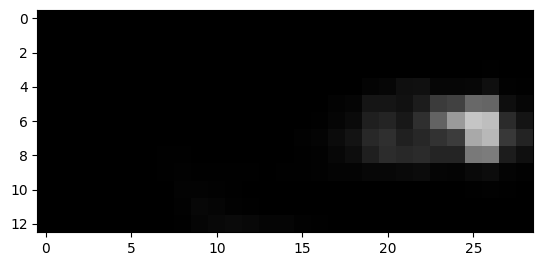

1773


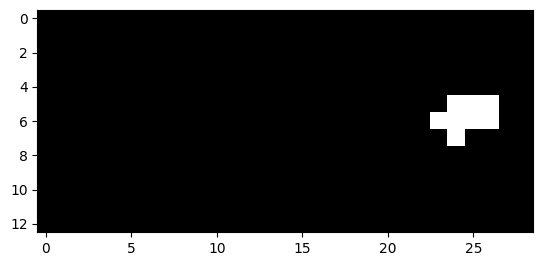

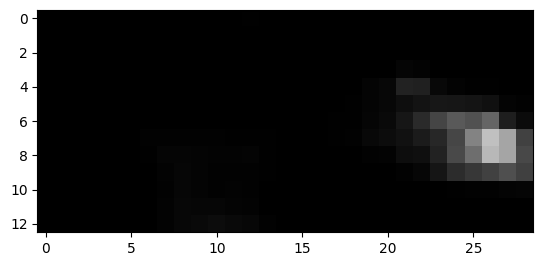

1774


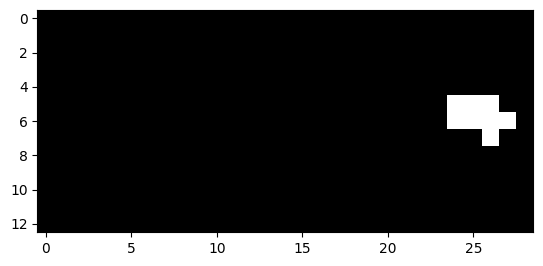

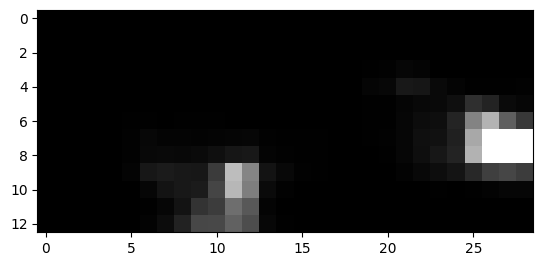

1775


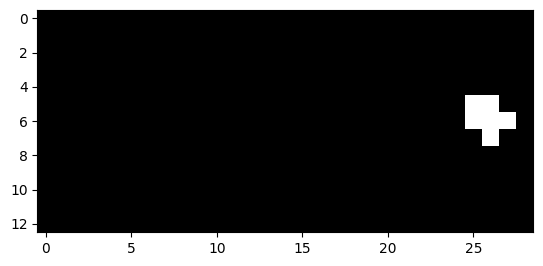

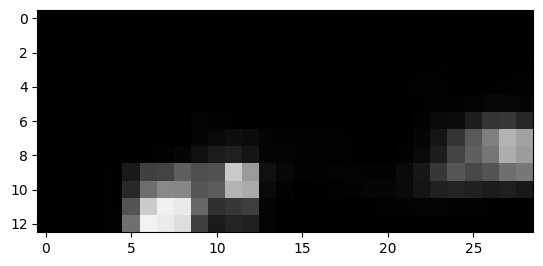

1776


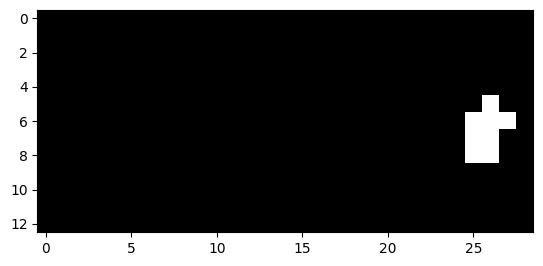

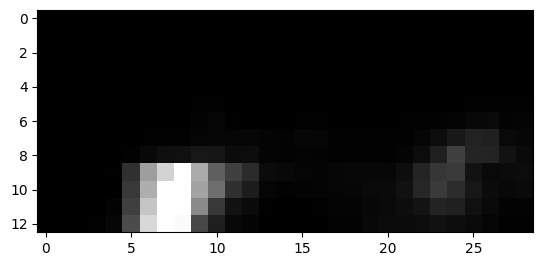

1777


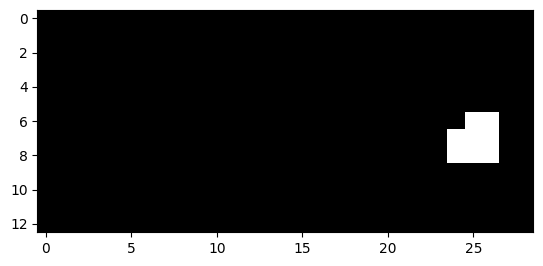

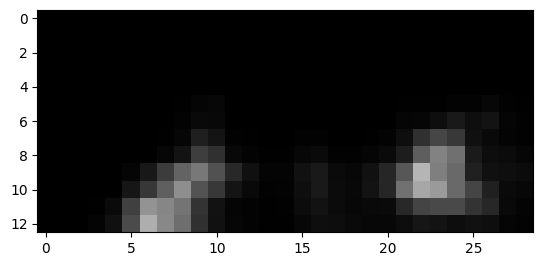

1778


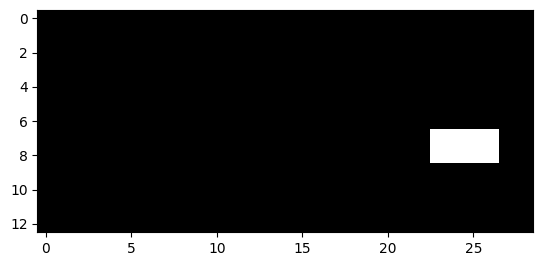

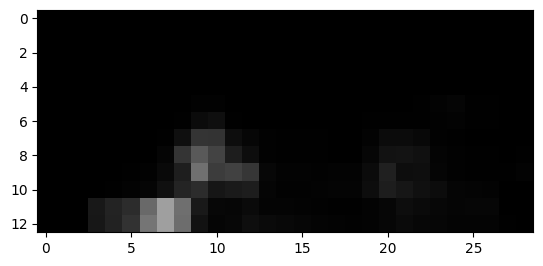

1779


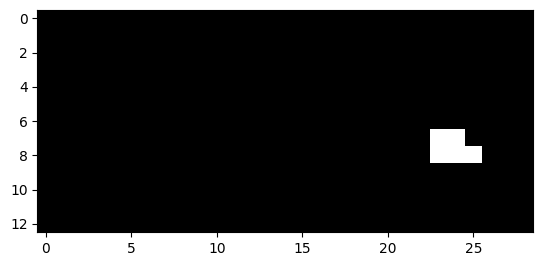

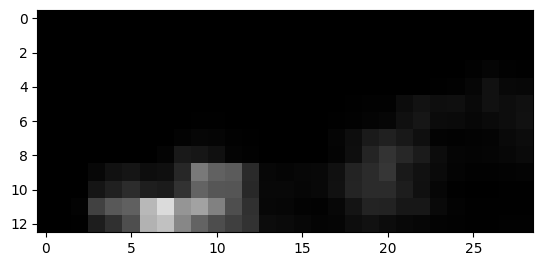

1786


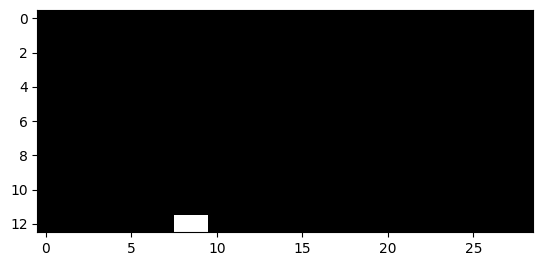

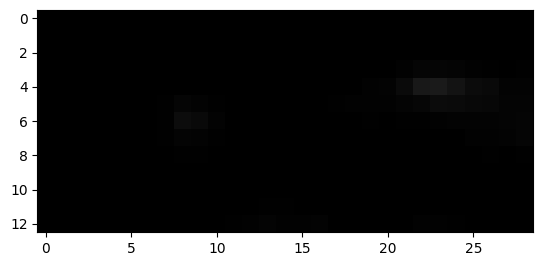

1787


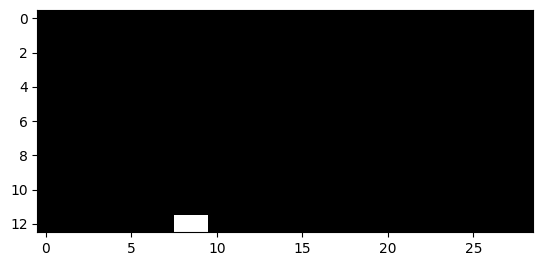

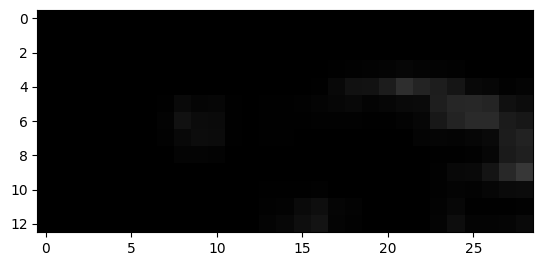

1792


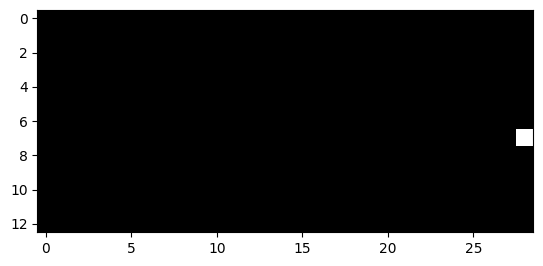

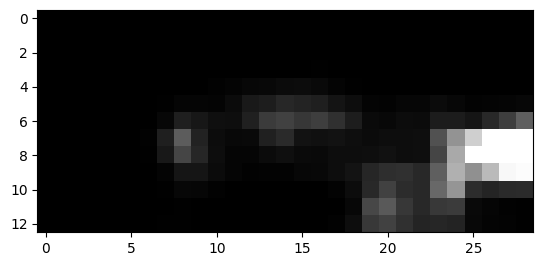

1793


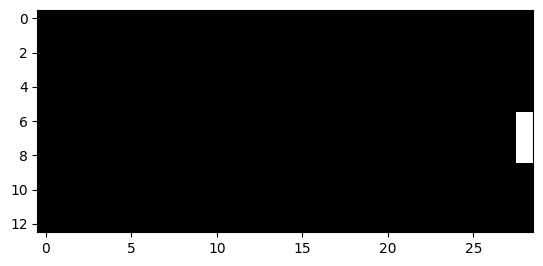

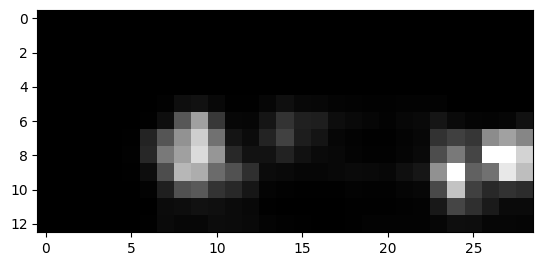

1794


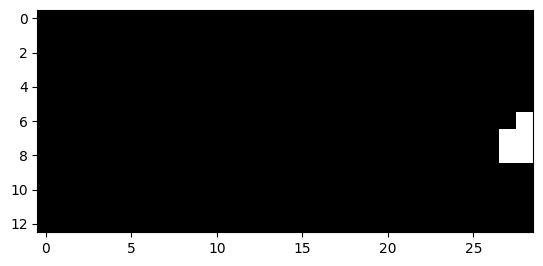

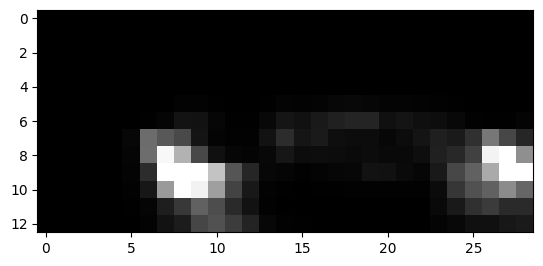

1795


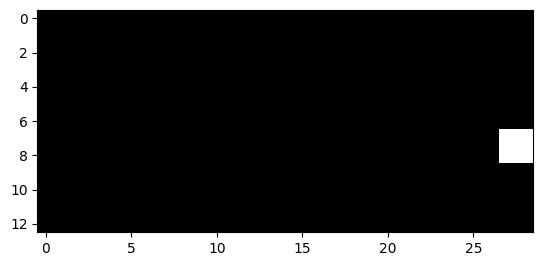

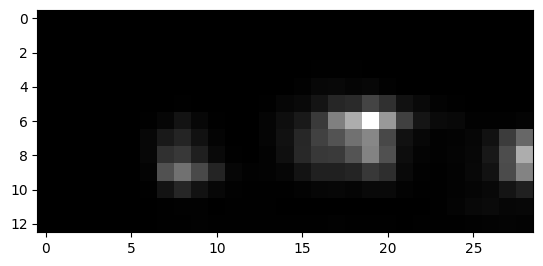

1796


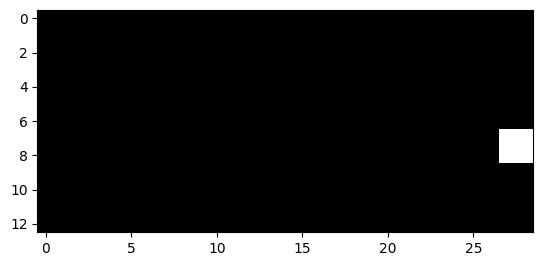

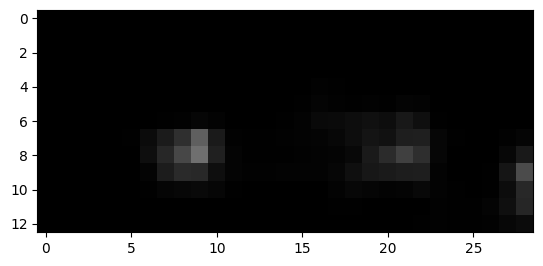

1797


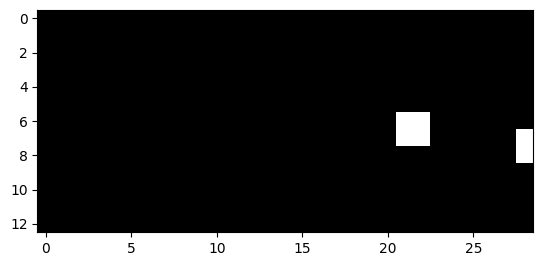

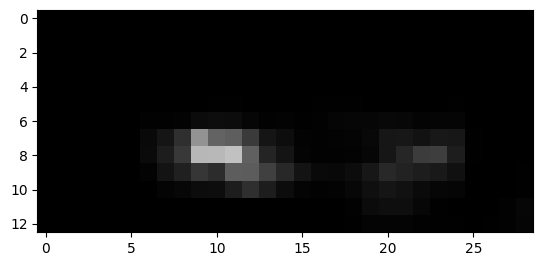

1798


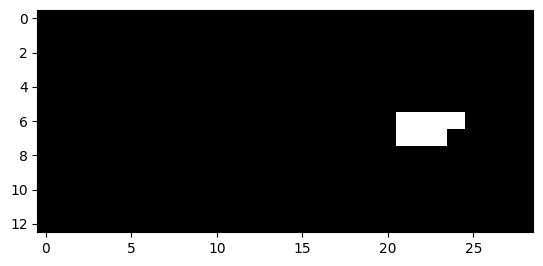

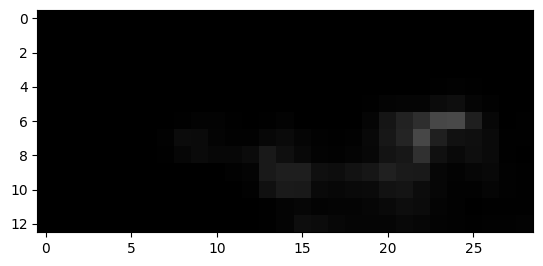

1799


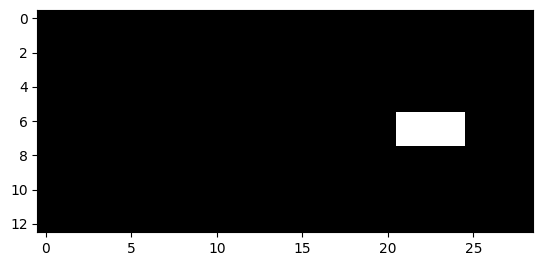

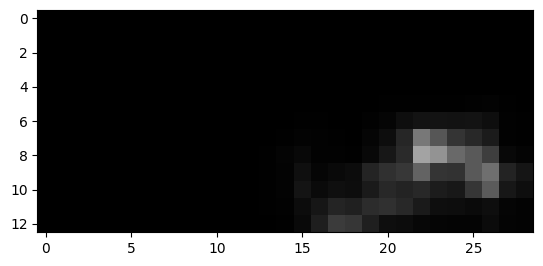

1800


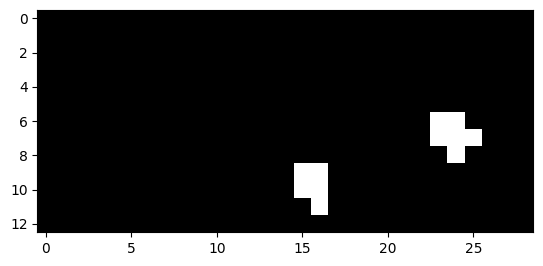

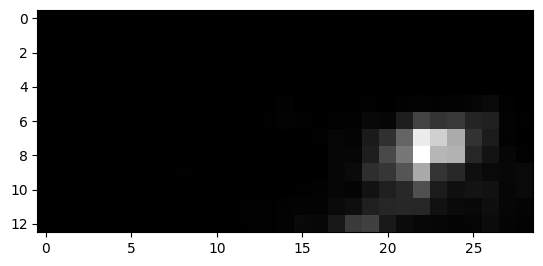

1801


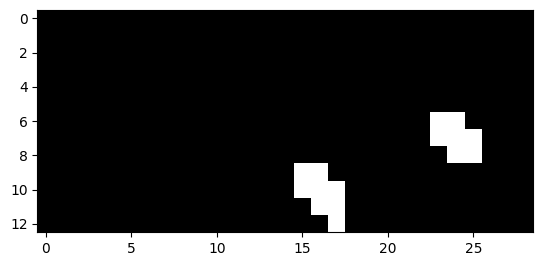

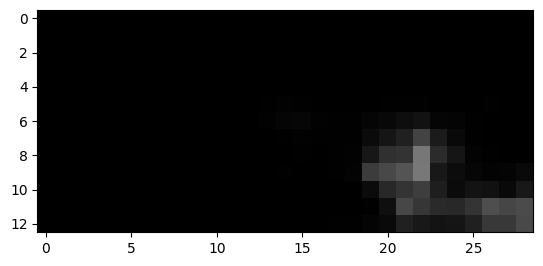

1802


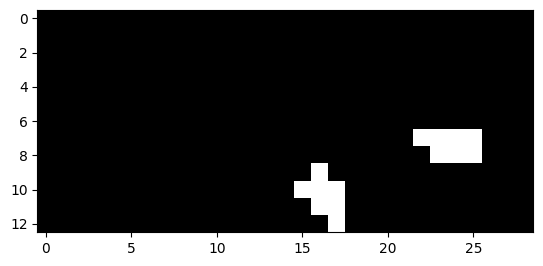

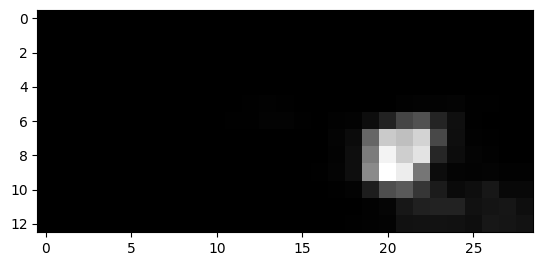

1803


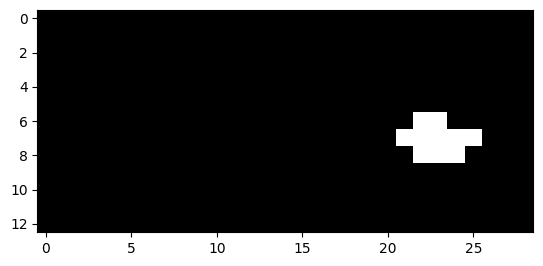

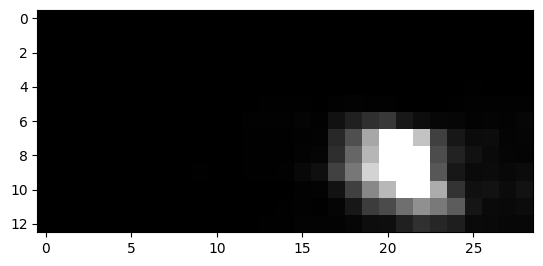

1804


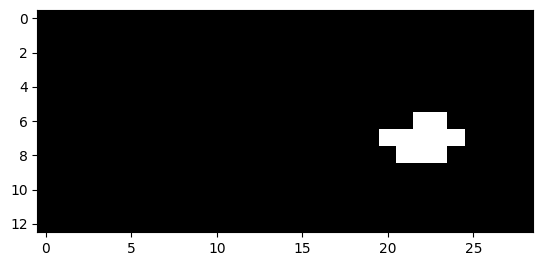

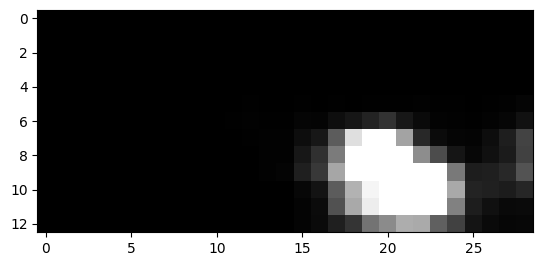

1805


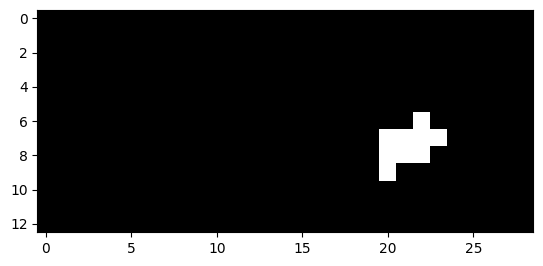

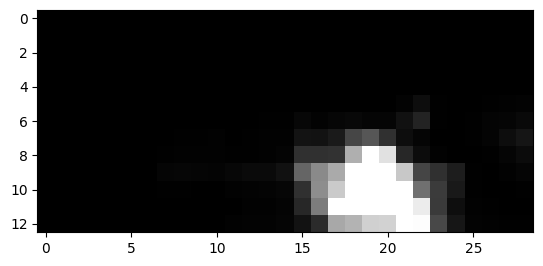

1806


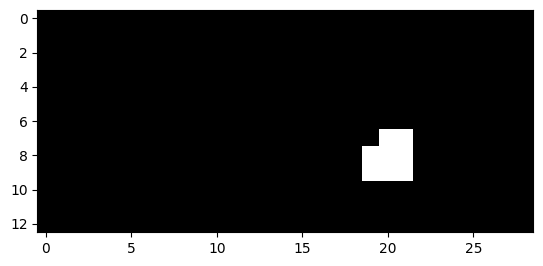

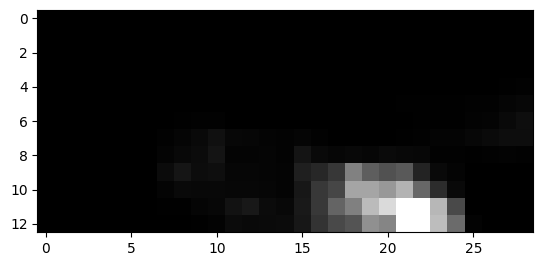

1807


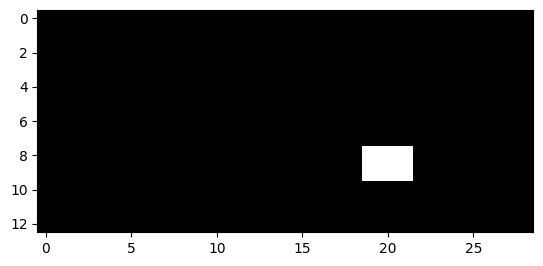

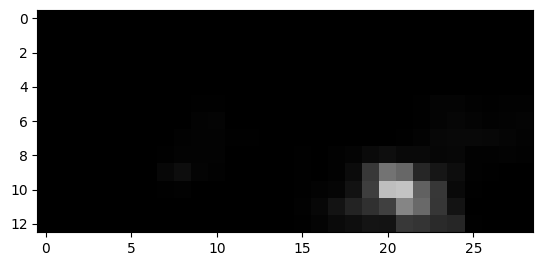

1808


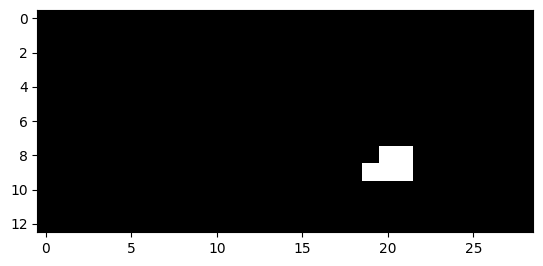

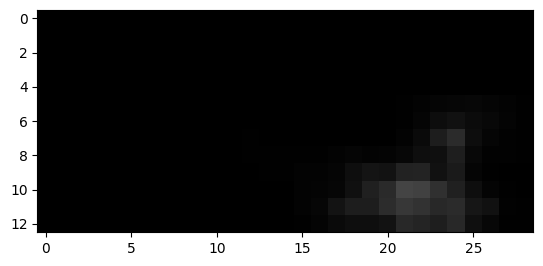

1809


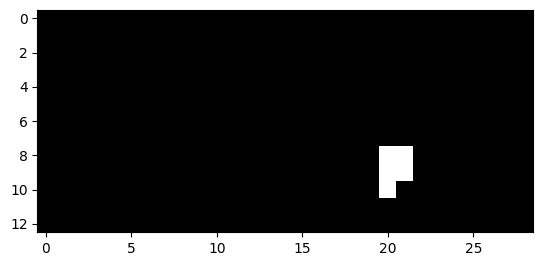

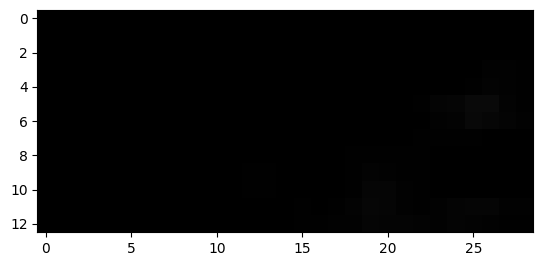

1810


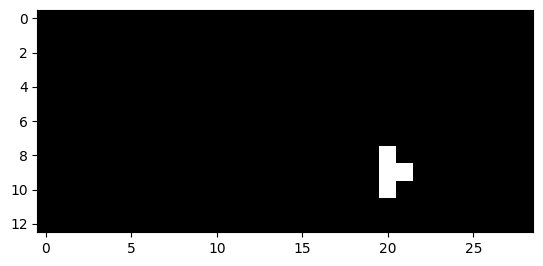

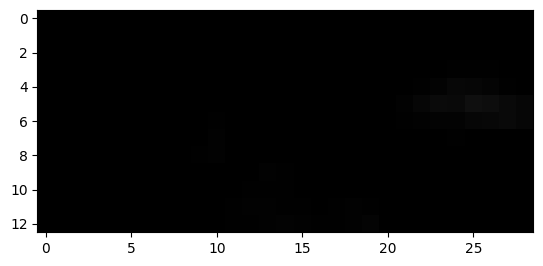

1845


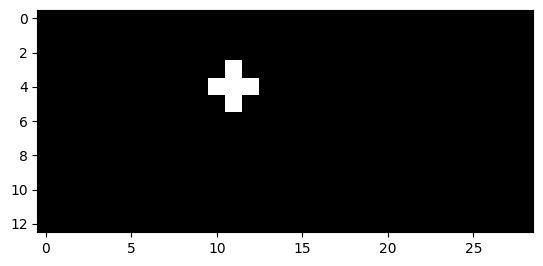

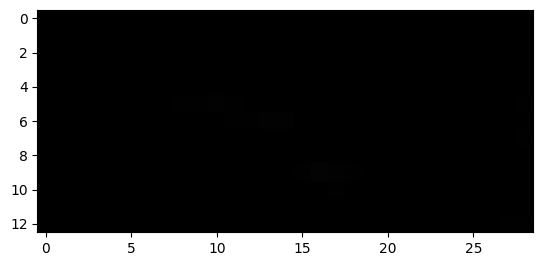

1846


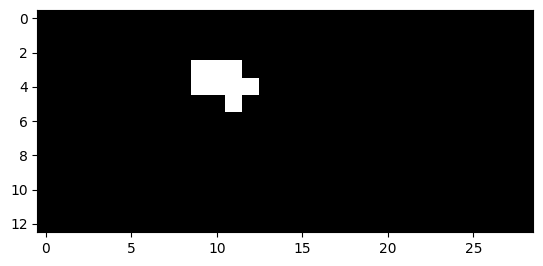

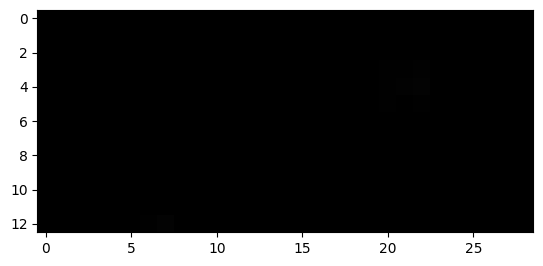

1847


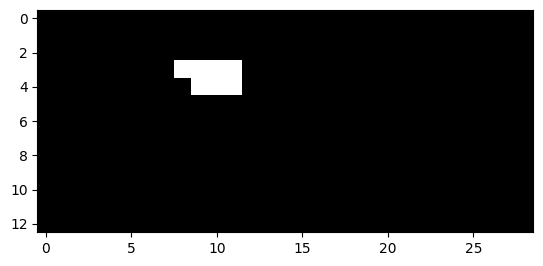

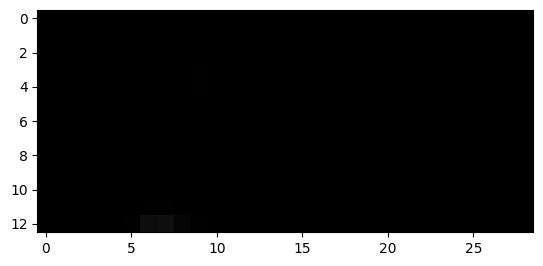

1848


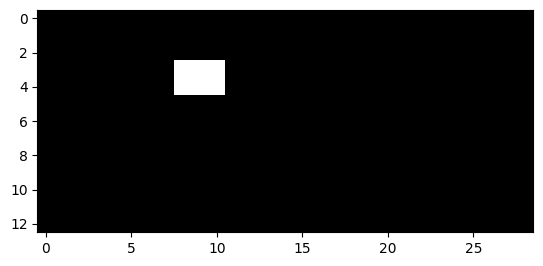

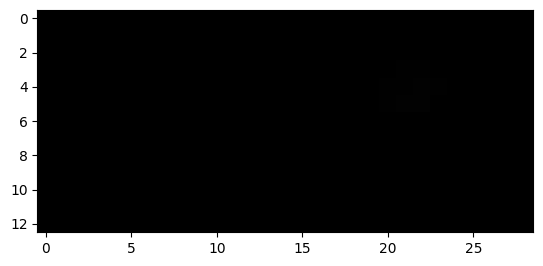

1849


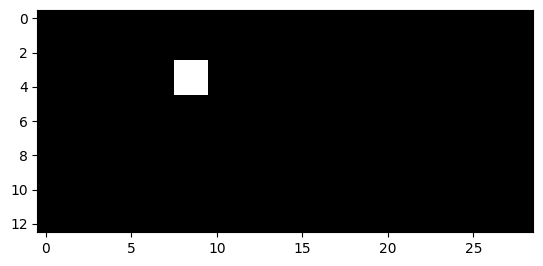

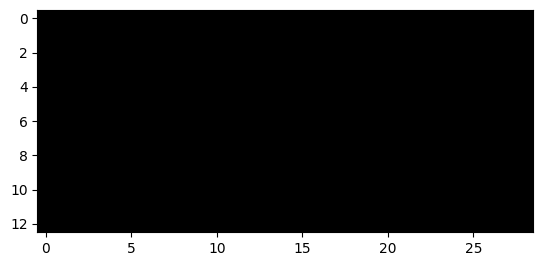

2122


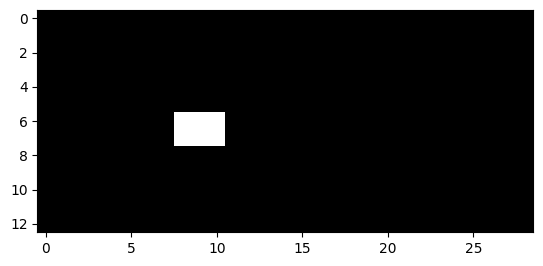

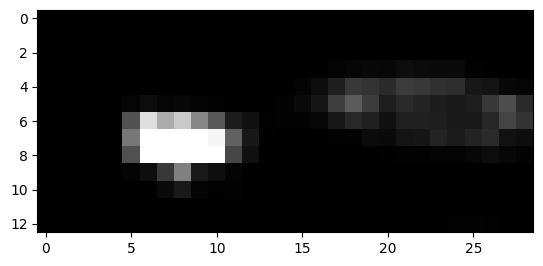

2123


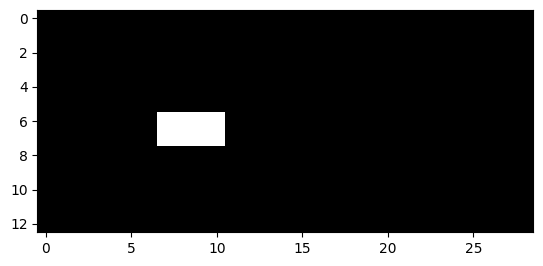

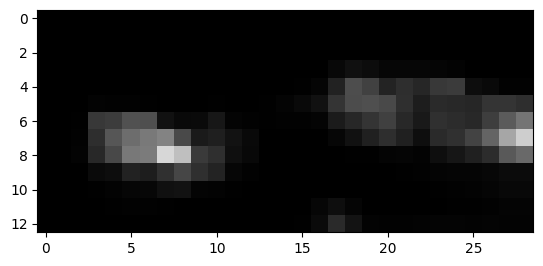

2124


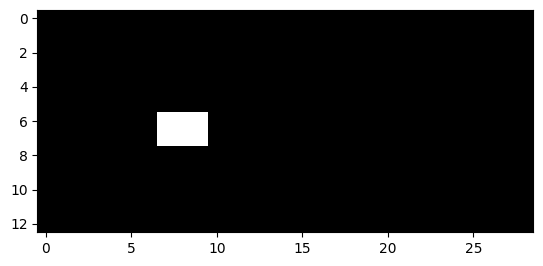

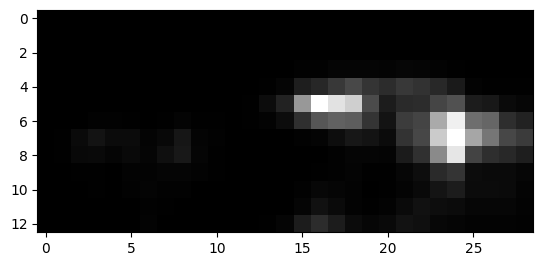

2126


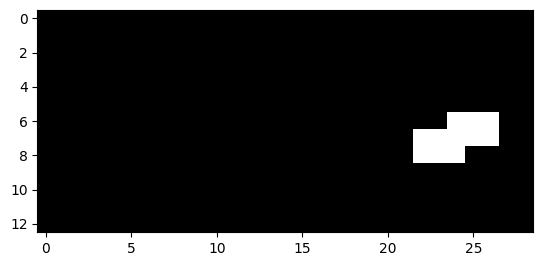

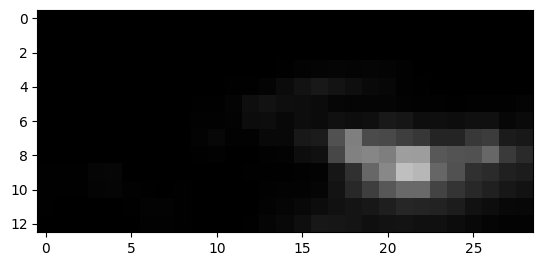

2127


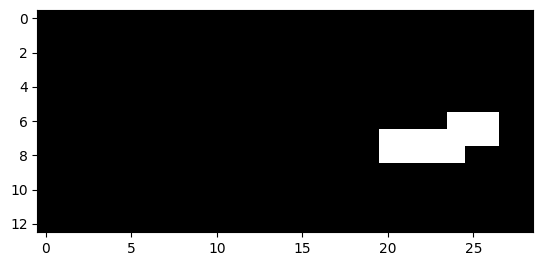

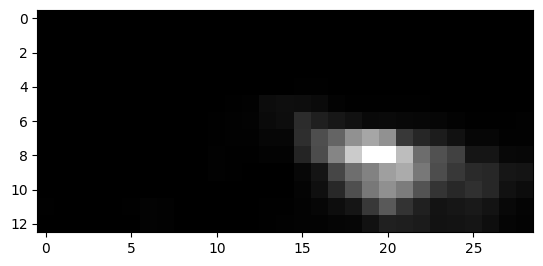

2128


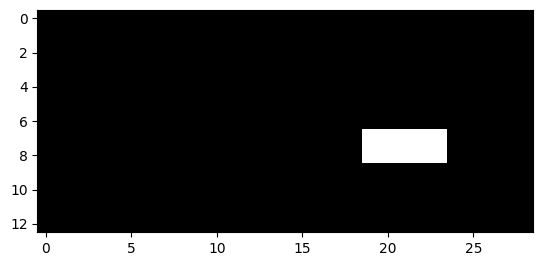

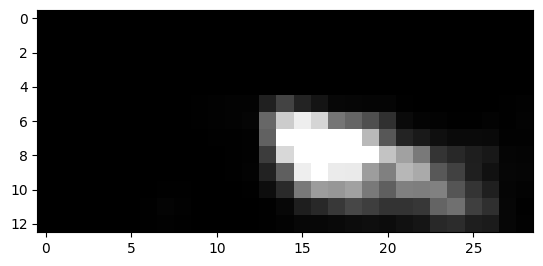

2129


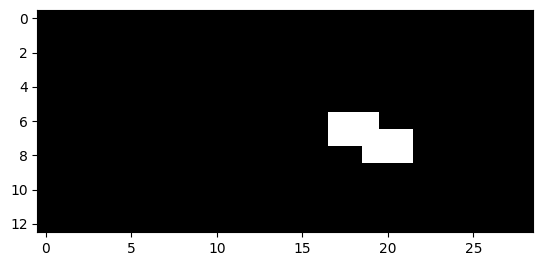

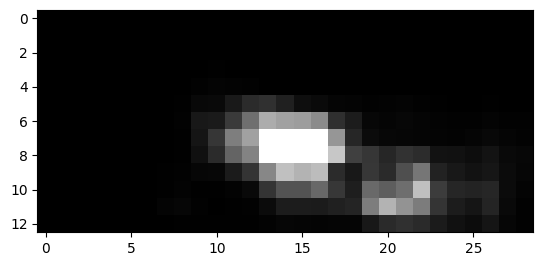

2130


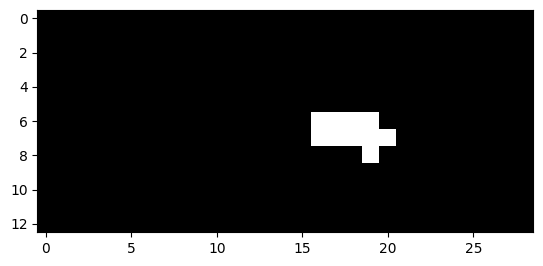

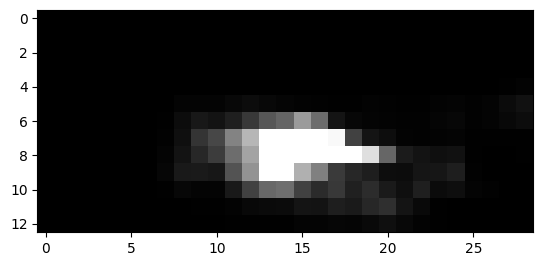

2131


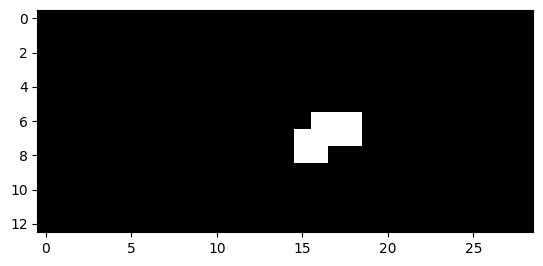

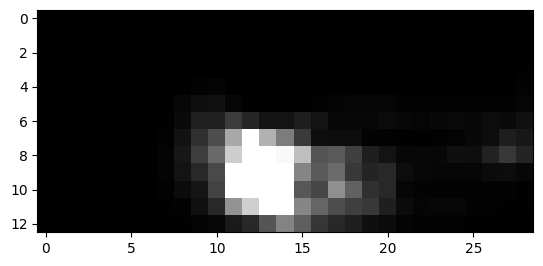

2132


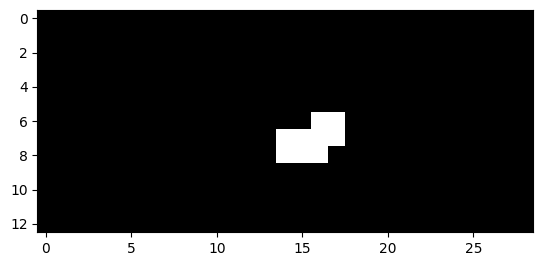

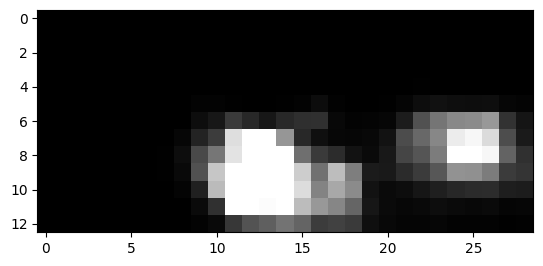

2133


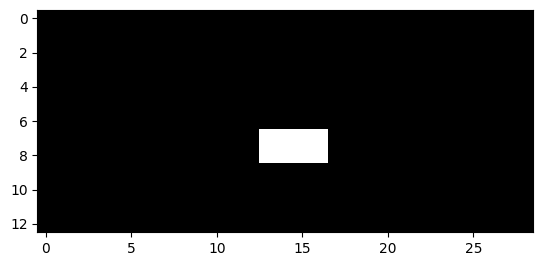

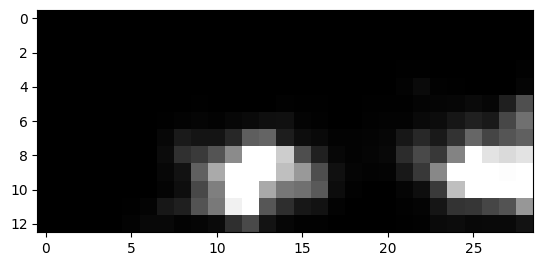

2134


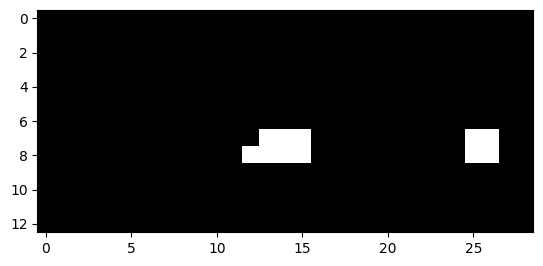

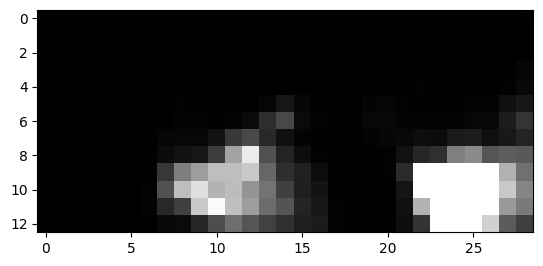

2135


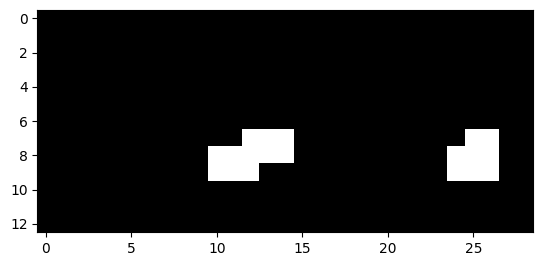

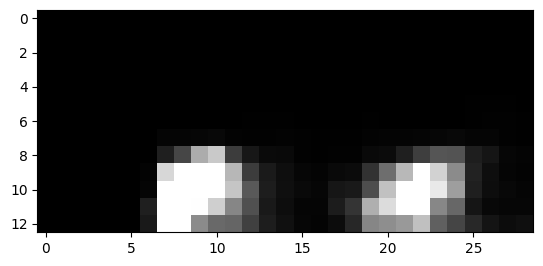

2136


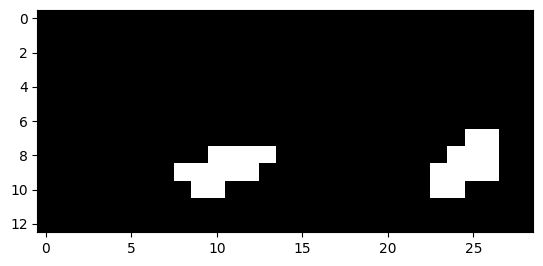

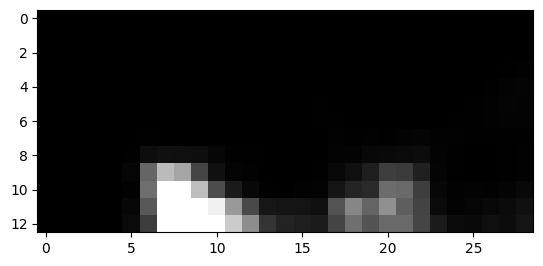

2137


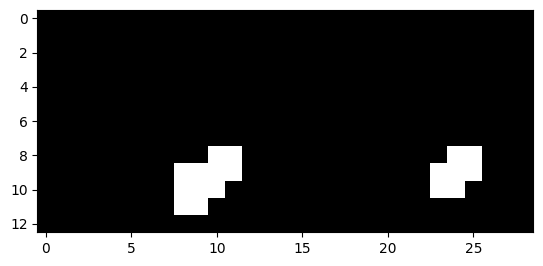

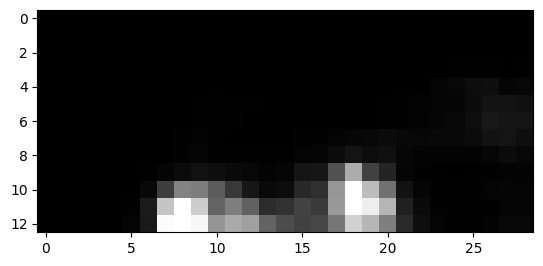

2138


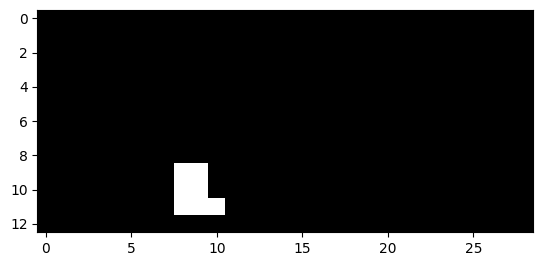

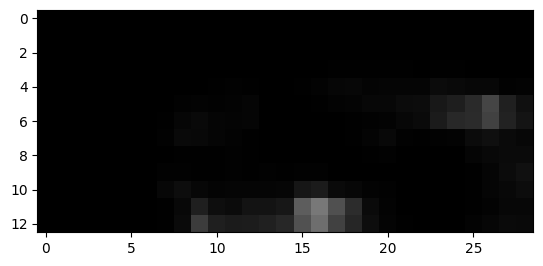

2139


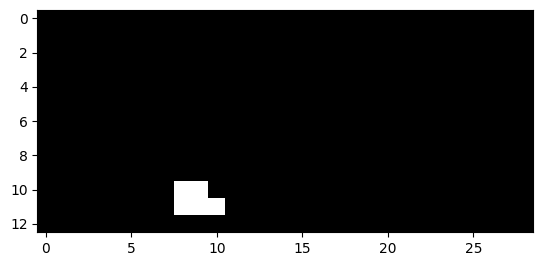

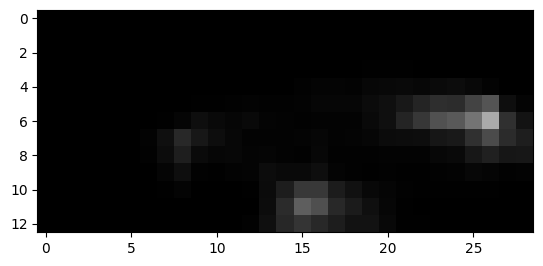

2143


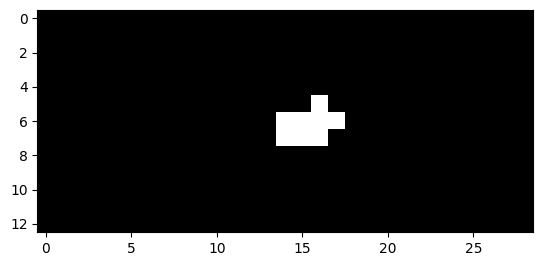

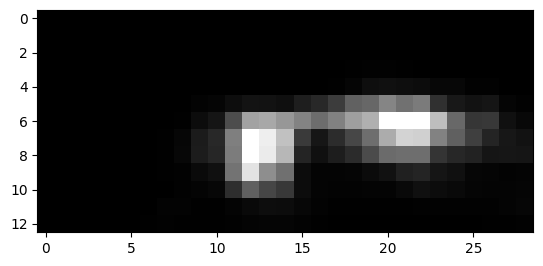

2144


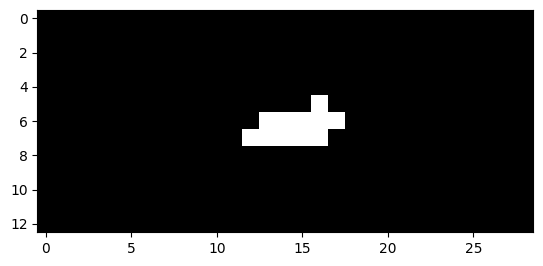

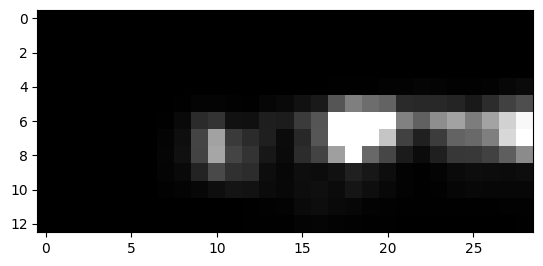

2145


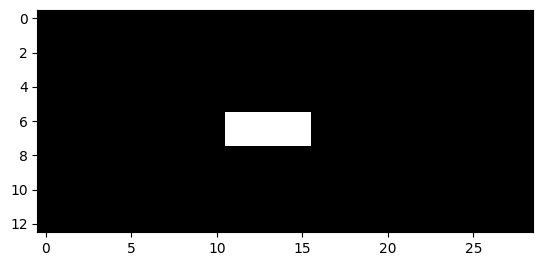

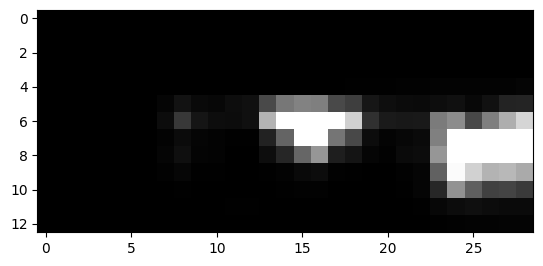

2146


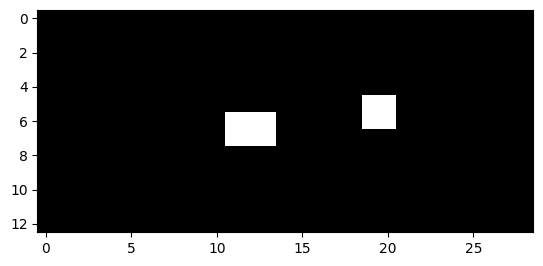

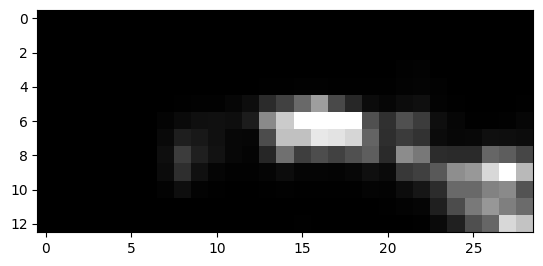

2147


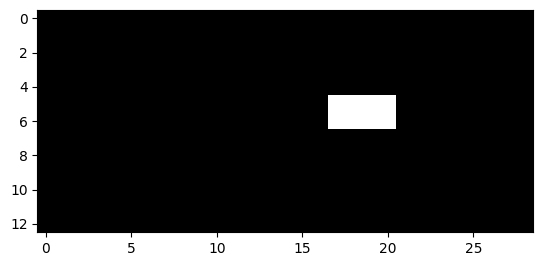

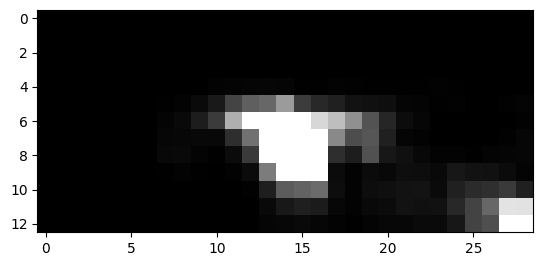

2148


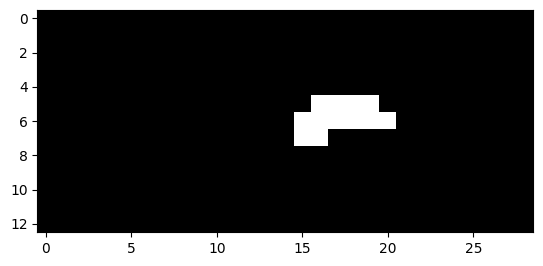

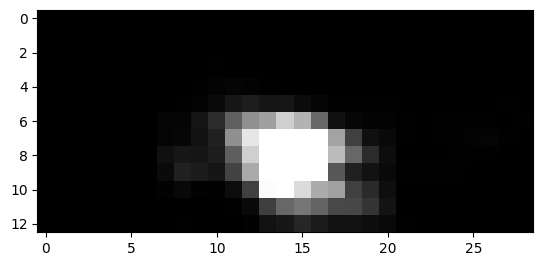

2149


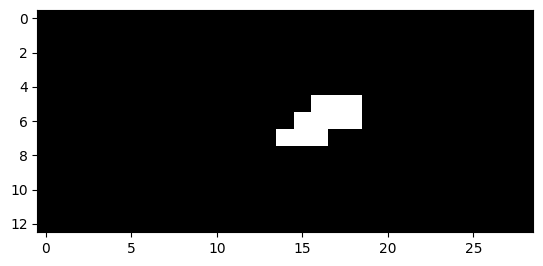

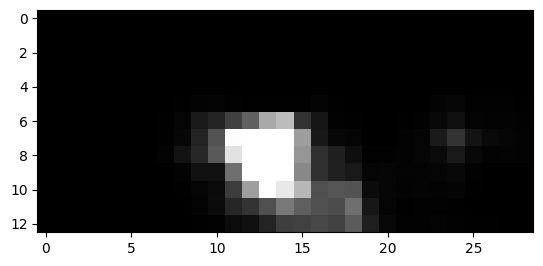

2150


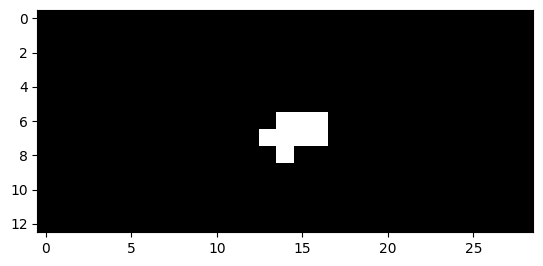

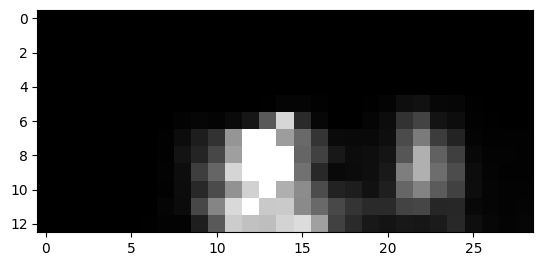

2151


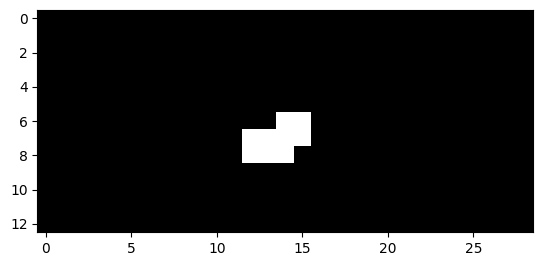

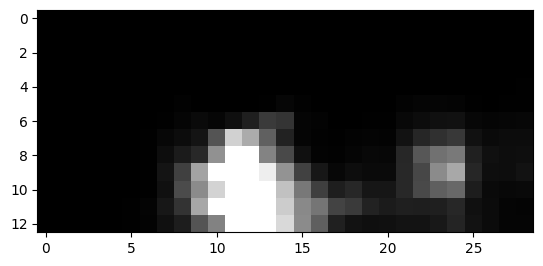

2152


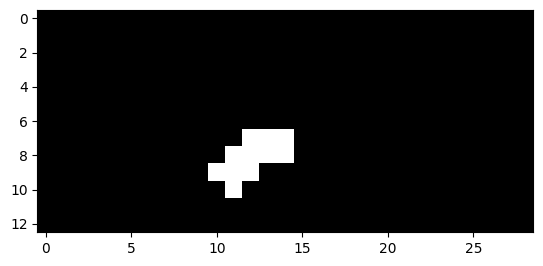

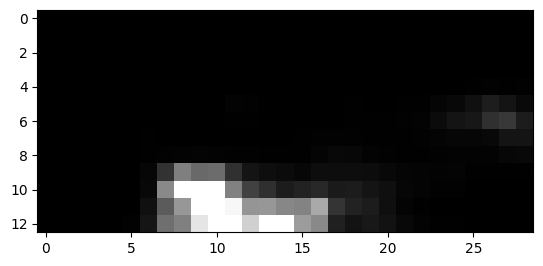

2153


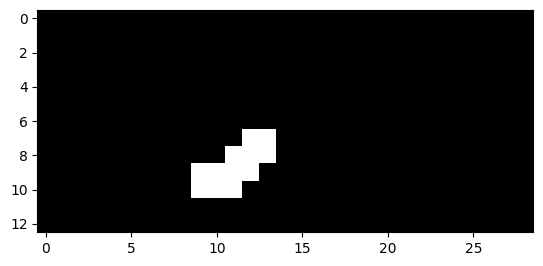

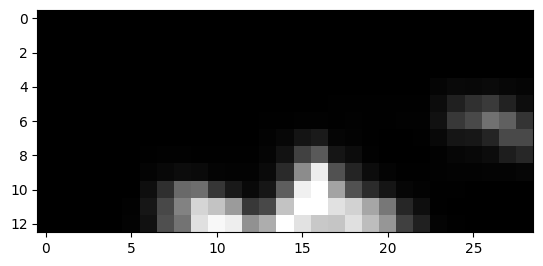

2154


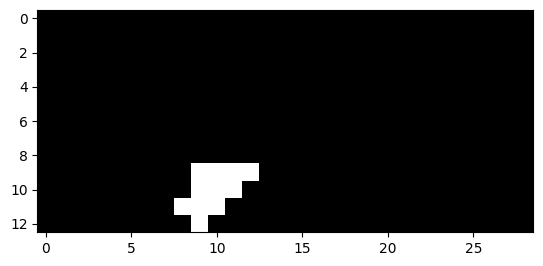

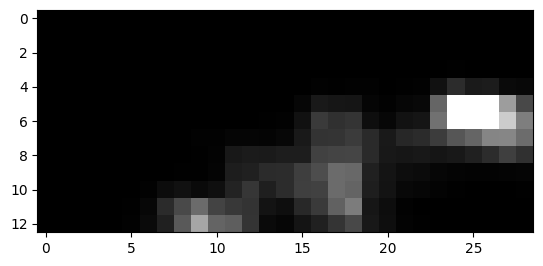

2155


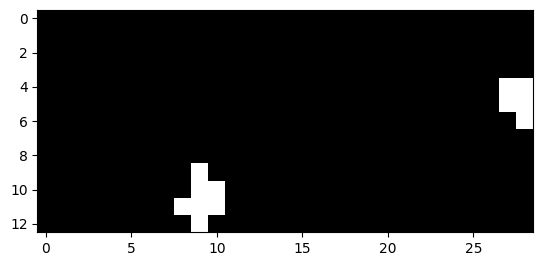

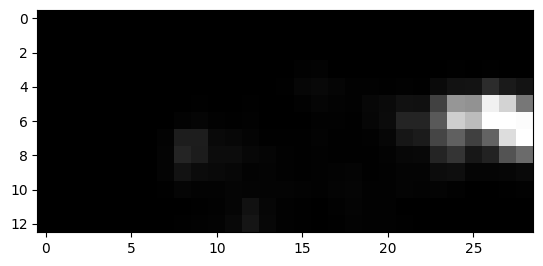

2156


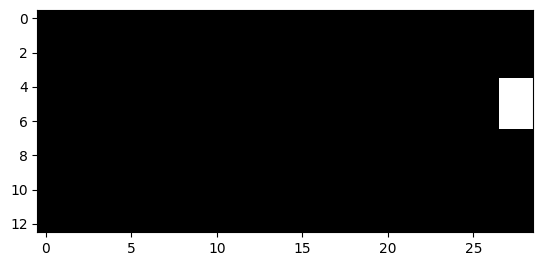

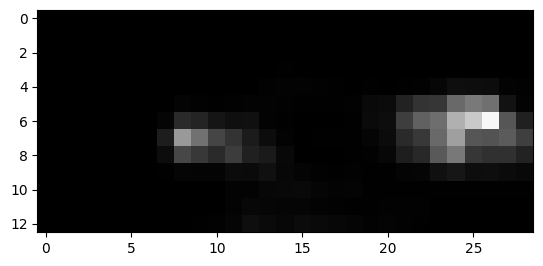

2157


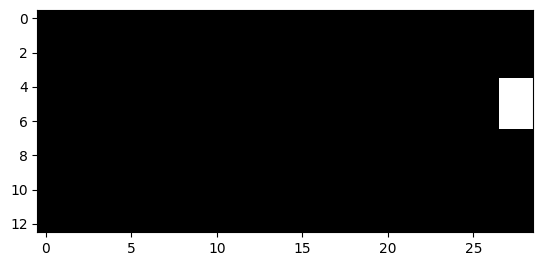

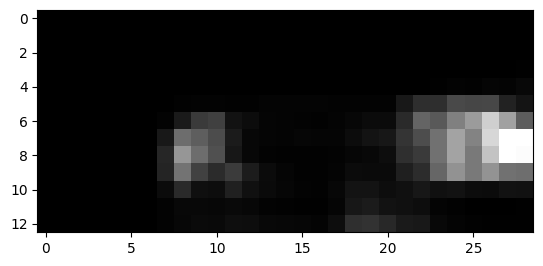

2166


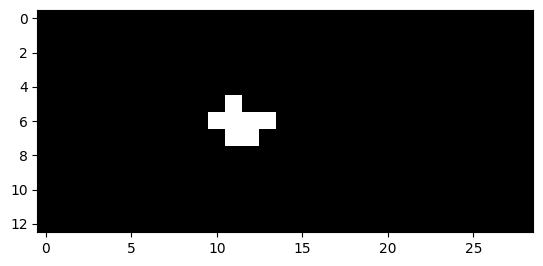

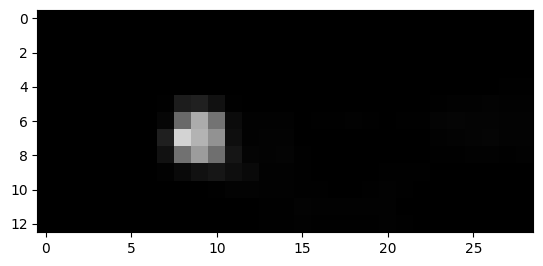

2167


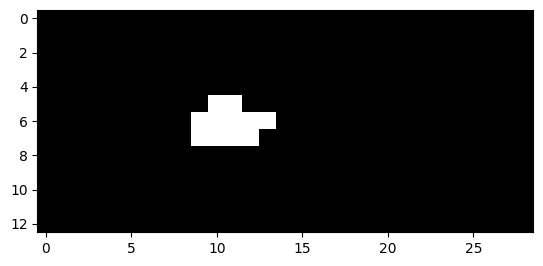

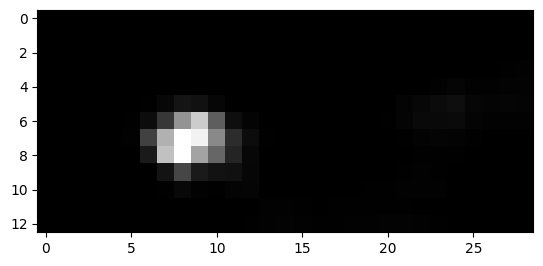

2168


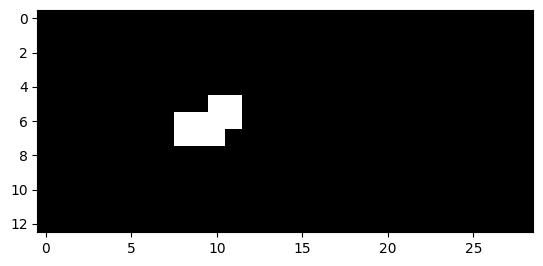

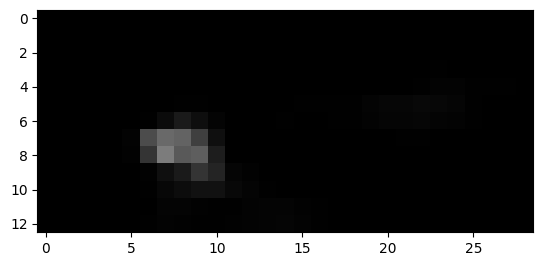

2169


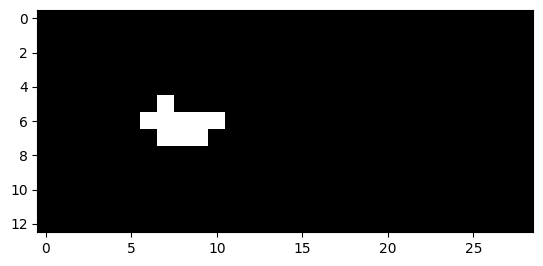

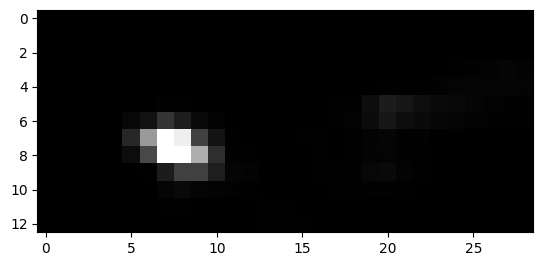

2170


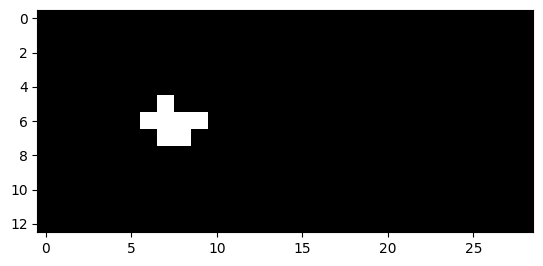

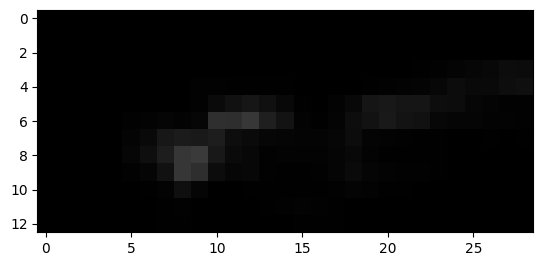

2171


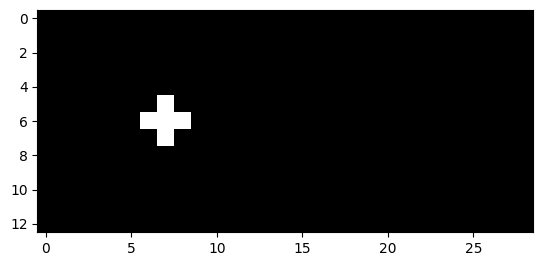

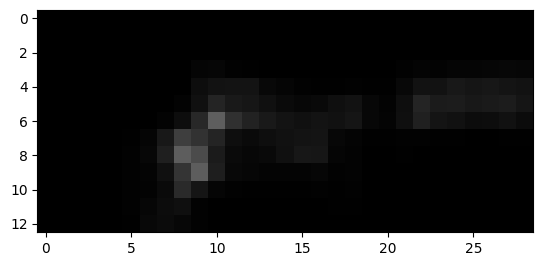

2174


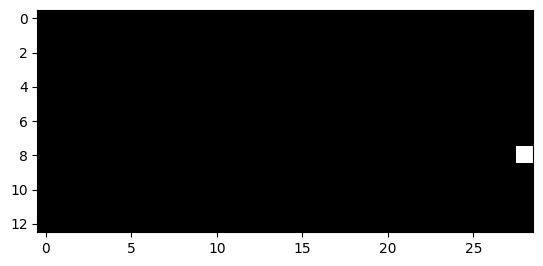

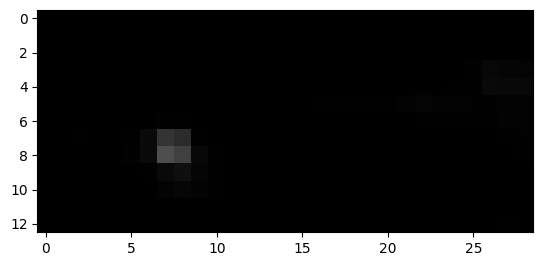

2175


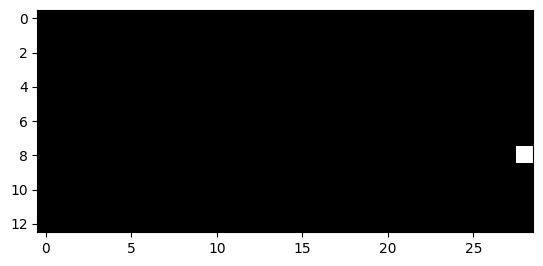

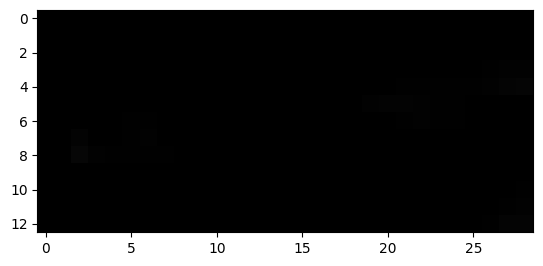

2181


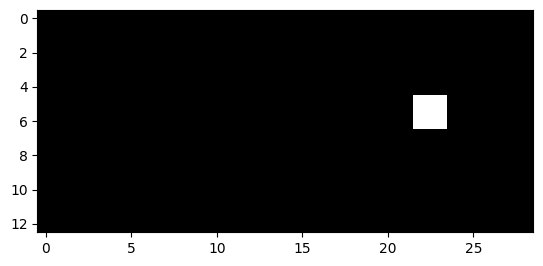

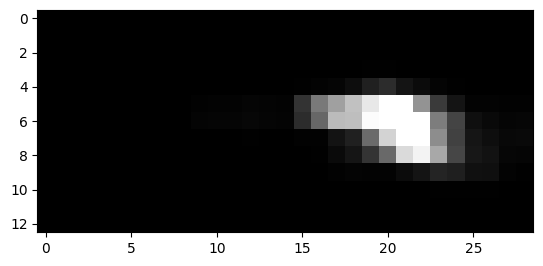

2182


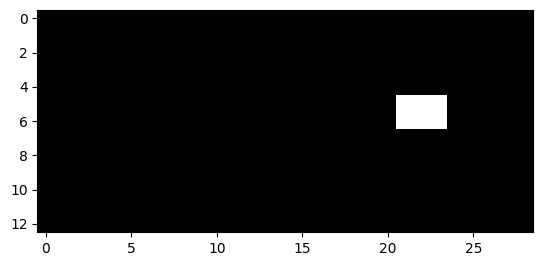

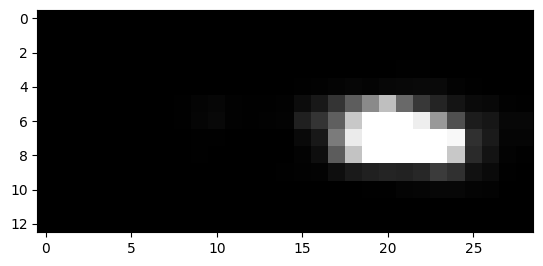

2183


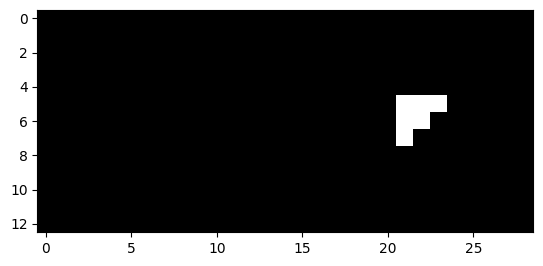

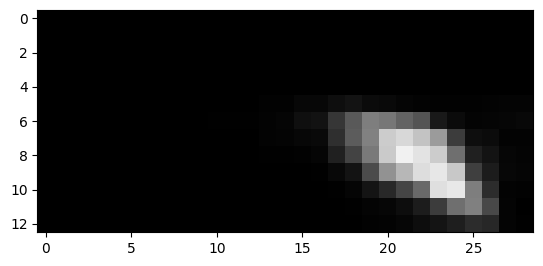

2184


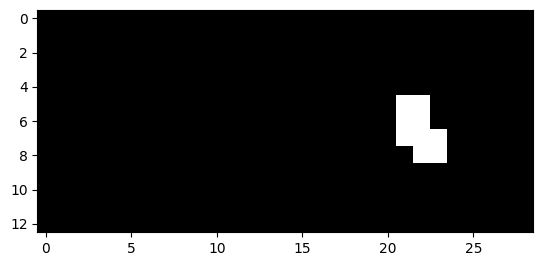

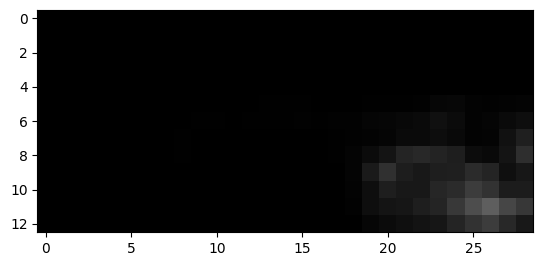

2185


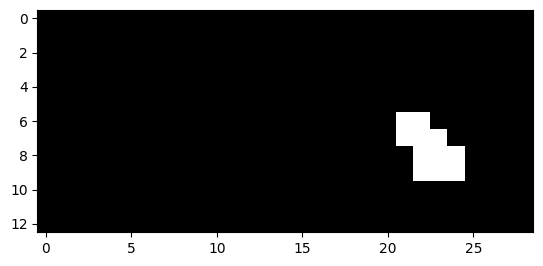

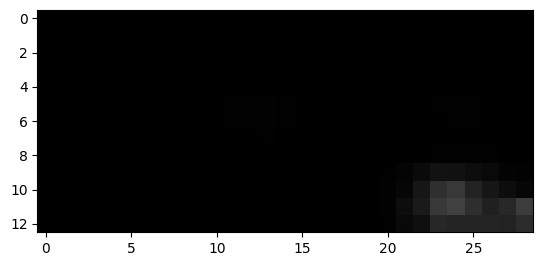

2186


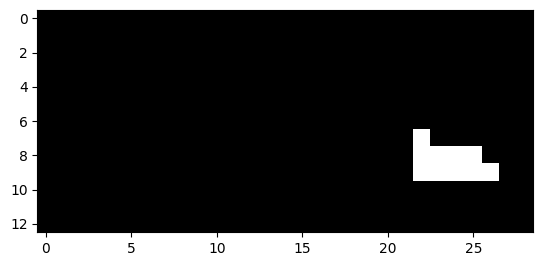

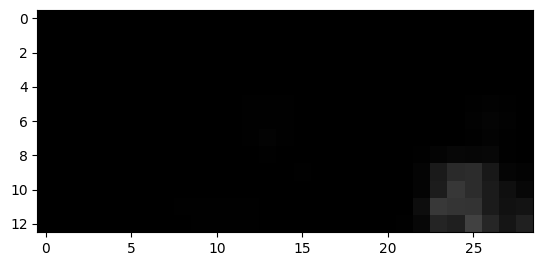

2187


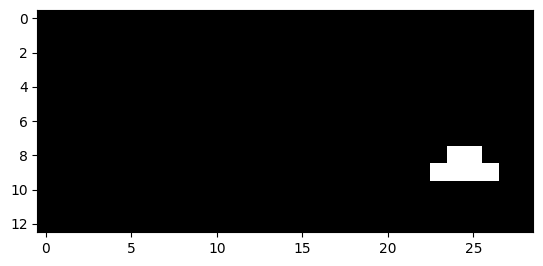

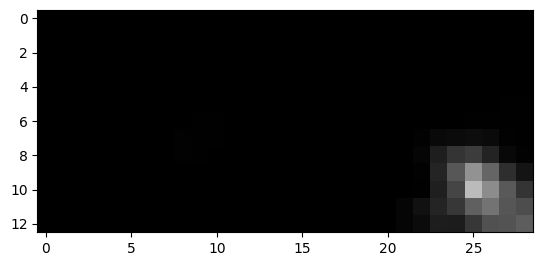

2188


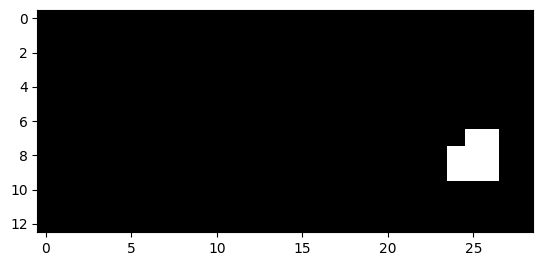

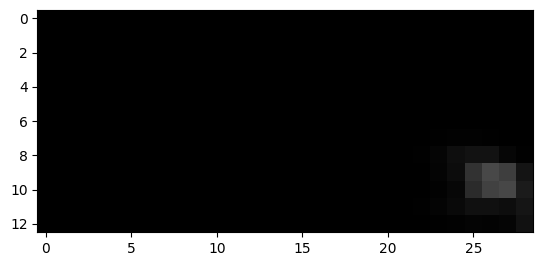

2189


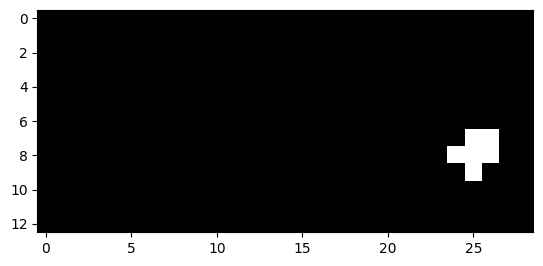

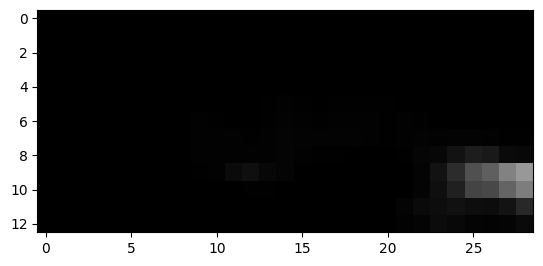

2190


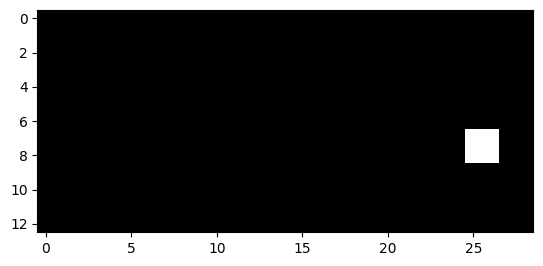

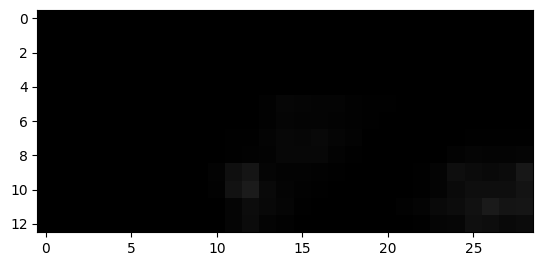

2191


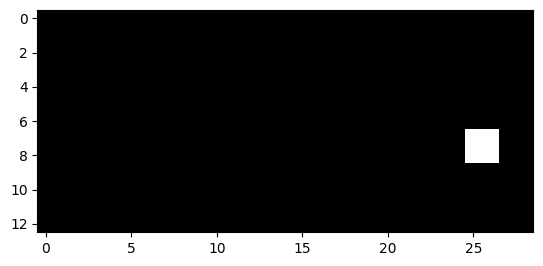

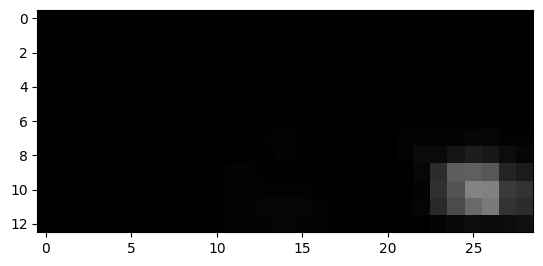

2214


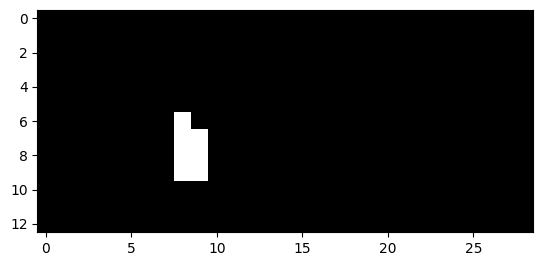

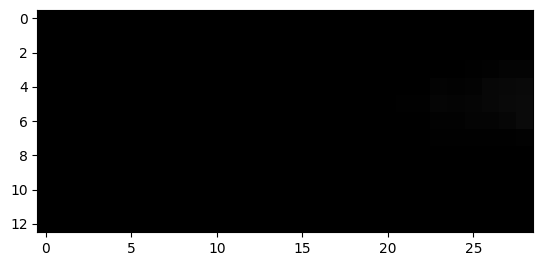

2215


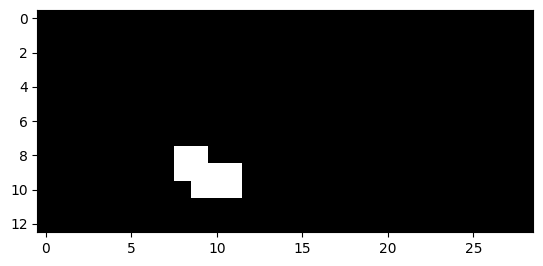

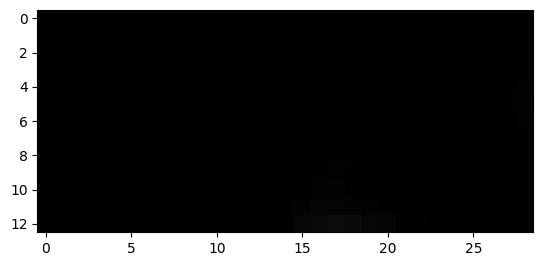

2216


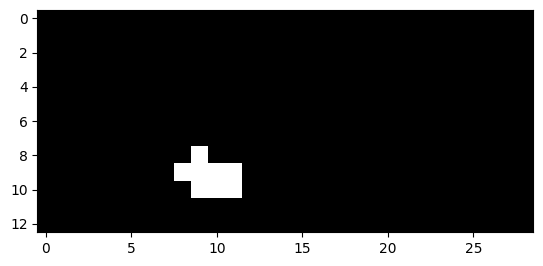

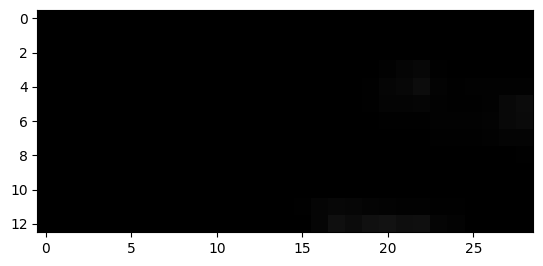

2226


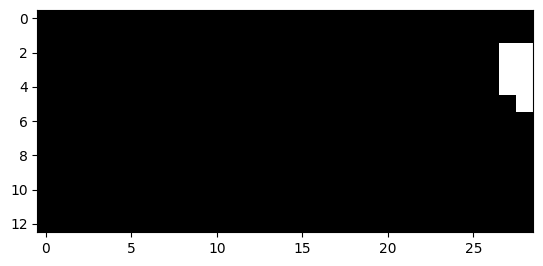

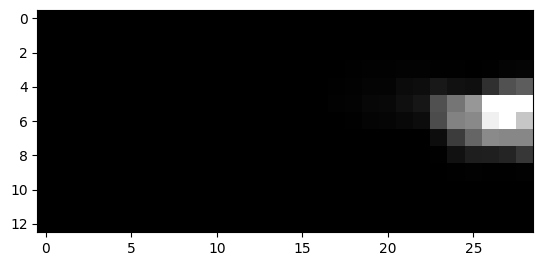

2227


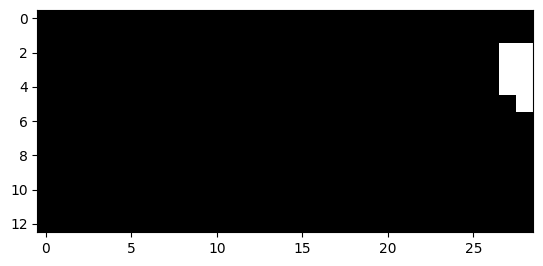

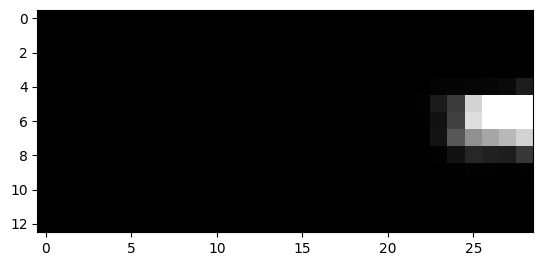

2228


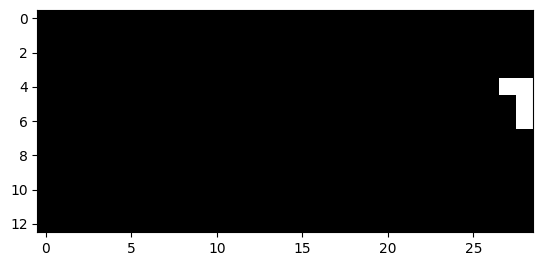

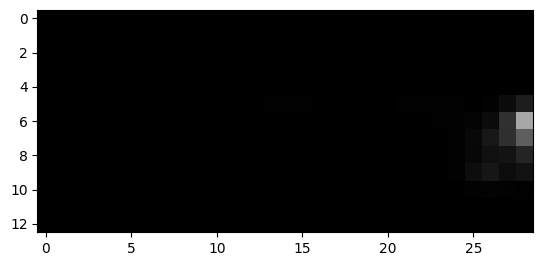

2229


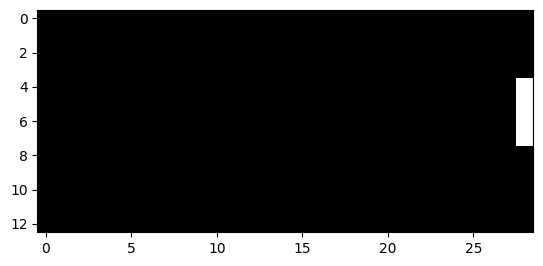

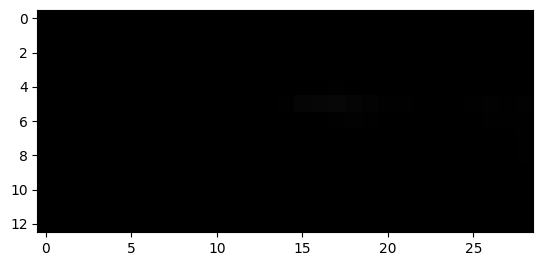

2230


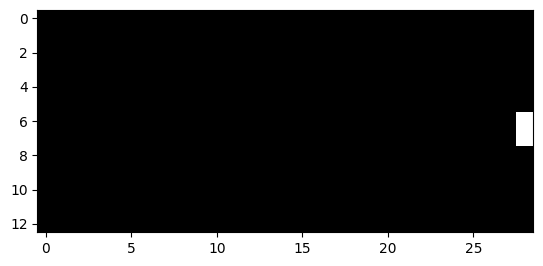

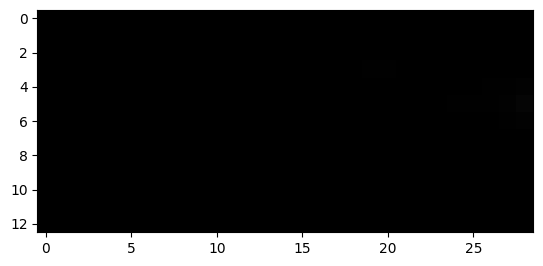

IndexError: index 2466 is out of bounds for axis 0 with size 2466

In [27]:
from sklearn.calibration import CalibrationDisplay
from sklearn.metrics import brier_score_loss

for lag in [2]:
    ### Model summary
    model = Sequential()
    model.add(layers.Input(shape=(13, 29, 9)))
    
    model.add(layers.Conv2D(8, (3,3), activation='relu', padding='same'))
    model.add(layers.MaxPooling2D((2, 2), padding='same'))

    model.add(layers.Conv2D(8, (3,3), activation='relu', padding='same'))
    model.add(layers.UpSampling2D((2,2)))
    
    model.add(layers.Conv2D(1, (3, 3), activation='sigmoid', padding='same')) # sigmoidal activation to have probabilities
    
    model.add(layers.Cropping2D(cropping=((0,1),(0,1))))
    
    model.summary()
    
    
    model.compile(loss='binary_crossentropy', optimizer='adam')
    
    monitor = EarlyStopping(monitor='val_loss', min_delta=1e-5, patience=20, 
            verbose=1, mode='auto', restore_best_weights=True)
    
    ### Model training
    model.fit(train_img_std[:-lag], y_train_img[lag:], validation_data=(val_img_std[:-lag],y_val_img[lag:]),
        callbacks=[monitor],epochs=100)
    
    ### Confusion matrices
    t = model.predict(test_img_std[:-lag])

    ranges = [0.025,0.05,0.075,0.1]
    
    for j in ranges:
        classes = []
        for i in t.reshape(-1,1):
            if i<=j: classes.append(0)
            else: classes.append(1)
    
        ConfusionMatrixDisplay(confusion_matrix(y_test_img[lag:].reshape(-1,1), classes)).plot(colorbar=False,cmap=plt.cm.Blues, values_format='d')
        ConfusionMatrixDisplay(confusion_matrix(y_test_img[lag:].reshape(-1,1), classes, normalize='true')).plot(colorbar=False,cmap=plt.cm.Blues)
    
    ### ROC
    plot_roc(t.reshape(-1,1),y_test_img[lag:].reshape(-1,1))
    
    z = np.zeros((lag,13,29,1))
    tt = np.concatenate((t,z))
    #test['predictions_lag'+str(lag)] = tt.reshape(-1,1)
    #test.to_csv("test_with_newTarget_predictions.csv")
    
    ### calibration
    display = CalibrationDisplay.from_predictions(y_test_img[lag:].reshape(-1,1), t.reshape(-1,1), n_bins=10)
    print(f'All zeros Brier score: {brier_score_loss(y_test_img[lag:].reshape(-1,1), np.zeros(len(y_test_img[lag:].reshape(-1,1))))}')
    print(f'Model Brier score: {brier_score_loss(y_test_img[lag:].reshape(-1,1), t.reshape(-1,1))}')
    
    # plot dei primi 100
    k=0
    for i in range(10000): 
        if(np.max(y_test_img[i].reshape(-1))>0.1):
            print(i)
            plt.figure()
            plt.imshow(y_test_img[i], cmap = "gray", vmin=0, vmax=1)
            plt.show()
            plt.imshow(t[i+lag], vmin=0, vmax=0.3, cmap = "gray")
            plt.show()
            k+=1
    print(k)
    

In [21]:
model = Sequential()
model.add(layers.Input(shape=(13, 29, 9)))

model.add(layers.Conv2D(8, (3,3), activation='relu', padding='same'))
model.add(layers.MaxPooling2D((2, 2), padding='same'))

#model.add(layers.Flatten())

#model.add(layers.Reshape((2,4,16)))

model.add(layers.Conv2D(8, (3,3), activation='relu', padding='same'))
model.add(layers.UpSampling2D((2,2)))

model.add(layers.Conv2D(1, (3, 3), activation='sigmoid', padding='same')) # sigmoidal activation to have probabilities

model.add(layers.Cropping2D(cropping=((0,1),(0,1))))

model.summary()


model.compile(loss='binary_crossentropy', optimizer='adam')

model.fit(np.concatenate((train_img_std,val_img_std)), np.concatenate((y_train_img,y_val_img)) ,epochs=56)



Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_12 (Conv2D)          (None, 13, 29, 8)         656       
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 7, 15, 8)         0         
 2D)                                                             
                                                                 
 conv2d_13 (Conv2D)          (None, 7, 15, 8)          584       
                                                                 
 up_sampling2d_4 (UpSampling  (None, 14, 30, 8)        0         
 2D)                                                             
                                                                 
 conv2d_14 (Conv2D)          (None, 14, 30, 1)         73        
                                                                 
 cropping2d_4 (Cropping2D)   (None, 13, 29, 1)        

2023-05-31 09:01:02.710917: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


411/411 [==============================] - 3s 7ms/step - loss: 0.0394
Epoch 2/56
411/411 [==============================] - 3s 7ms/step - loss: 0.0126
Epoch 3/56
411/411 [==============================] - 3s 7ms/step - loss: 0.0110
Epoch 4/56
411/411 [==============================] - 3s 7ms/step - loss: 0.0103
Epoch 5/56
411/411 [==============================] - 3s 7ms/step - loss: 0.0100
Epoch 6/56
411/411 [==============================] - 3s 7ms/step - loss: 0.0097
Epoch 7/56
411/411 [==============================] - 3s 7ms/step - loss: 0.0096
Epoch 8/56
411/411 [==============================] - 3s 7ms/step - loss: 0.0094
Epoch 9/56
411/411 [==============================] - 3s 7ms/step - loss: 0.0093
Epoch 10/56
411/411 [==============================] - 3s 7ms/step - loss: 0.0092
Epoch 11/56
411/411 [==============================] - 3s 7ms/step - loss: 0.0092
Epoch 12/56
411/411 [==============================] - 3s 7ms/step - loss: 0.0090
Epoch 13/56
411/411 [===============

## Save results and new metric

In [24]:
a1 = test.target.values.reshape(1,-1)
a1

array([[0, 0, 0, ..., 0, 0, 0]])

In [25]:
a2 = y_test_img.reshape(1,-1)
a2

array([[0., 0., 0., ..., 0., 0., 0.]])

In [26]:
a_diff = a1-a2

In [27]:
a_diff[a_diff>0]

array([], dtype=float64)

In [28]:
test['predictions'] = t.reshape(-1,1)
test['predictions_onlySea'] = t_onlySea.reshape(-1,1)

ValueError: Length of values (924781) does not match length of index (929682)

In [ ]:
test

In [ ]:
test.to_csv("test_with_newTarget_predictions.csv")

In [ ]:
import sys
sys.path.append("/Users/paolo/Documents/TC/Paolo/scripts/")

from aux import compute_cyclones

cyclones_real = compute_cyclones(test[test.target==1],2.5)

cyclones_predicted = compute_cyclones(test[test.predictions>=0.025],2.5)

TC_founds = 0 
    
for TC in cyclones_real:
    found = 0 
    for point in TC:
        reduced = test[(test.predictions>=0.025) & (test.time==point[2]) & (test.latitude==point[0]) & (test.longitude==point[1])]
        if reduced.shape[0]>=1:
            found = 1
    if found == 1: TC_founds+=1
        
print(f'Number of test TCs: {len(cyclones_real)}\n')
print(f'Number of test TCs correctly predicted: {TC_founds}\n')
print(f'Number of test TCs predicted, correctly or not: {len(cyclones_predicted)}\n')
print(f'Number of test TCs predicted but not happening: {len(cyclones_predicted)-TC_founds}\n')



In [ ]:
import sys
sys.path.append("/Users/paolo/Documents/TC/Paolo/scripts/")

from aux import compute_cyclones

cyclones_real = compute_cyclones(test[test.target==1],2.5)

cyclones_predicted = compute_cyclones(test[test.predictions>=0.05],2.5)

TC_founds = 0 
    
for TC in cyclones_real:
    found = 0 
    for point in TC:
        reduced = test[(test.predictions>=0.05) & (test.time==point[2]) & (test.latitude==point[0]) & (test.longitude==point[1])]
        if reduced.shape[0]>=1:
            found = 1
    if found == 1: TC_founds+=1
        
print(f'Number of test TCs: {len(cyclones_real)}\n')
print(f'Number of test TCs correctly predicted: {TC_founds}\n')
print(f'Number of test TCs predicted, correctly or not: {len(cyclones_predicted)}\n')
print(f'Number of test TCs predicted but not happening: {len(cyclones_predicted)-TC_founds}\n')



In [ ]:
import sys
sys.path.append("/Users/paolo/Documents/TC/Paolo/scripts/")

from aux import compute_cyclones

cyclones_real = compute_cyclones(test.loc[(test.target==1) & (test.time<='2019-12-01')],2.5)

cyclones_predicted = compute_cyclones(test.loc[(test.predictions>=0.1) & (test.time<='2019-12-01')],2.5)

TC_founds = 0 
    
for TC in cyclones_real:
    found = 0 
    for point in TC:
        reduced = test[(test.predictions>=0.05) & (test.time==point[2]) & (test.latitude==point[0]) & (test.longitude==point[1])]
        if reduced.shape[0]>=1:
            found = 1
    if found == 1: TC_founds+=1
        
print(f'Number of test TCs: {len(cyclones_real)}\n')
print(f'Number of test TCs correctly predicted: {TC_founds}\n')
print(f'Number of test TCs predicted, correctly or not: {len(cyclones_predicted)}\n')
print(f'Number of test TCs predicted but not happening: {len(cyclones_predicted)-TC_founds}\n')



In [ ]:
import sys
sys.path.append("/Users/paolo/Documents/TC/Paolo/scripts/")

from aux import compute_cyclones

cyclones_real = compute_cyclones(test[test.target_sea==1],2.5)

cyclones_predicted = compute_cyclones(test[test.predictions_onlySea>=0.025],2.5)

TC_founds = 0 
    
for TC in cyclones_real:
    found = 0 
    for point in TC:
        reduced = test[(test.predictions_onlySea>=0.025) & (test.time==point[2]) & (test.latitude==point[0]) & (test.longitude==point[1])]
        if reduced.shape[0]>=1:
            found = 1
    if found == 1: TC_founds+=1
        
print(f'Number of test TCs: {len(cyclones_real)}\n')
print(f'Number of test TCs correctly predicted: {TC_founds}\n')
print(f'Number of test TCs predicted, correctly or not: {len(cyclones_predicted)}\n')
print(f'Number of test TCs predicted but not happening: {len(cyclones_predicted)-TC_founds}\n')



In [ ]:
import sys
sys.path.append("/Users/paolo/Documents/TC/Paolo/scripts/")

from aux import compute_cyclones

cyclones_real = compute_cyclones(test[test.target_sea==1],2.5)

cyclones_predicted = compute_cyclones(test[test.predictions_onlySea>=0.05],2.5)

TC_founds = 0 
    
for TC in cyclones_real:
    found = 0 
    for point in TC:
        reduced = test[(test.predictions_onlySea>=0.05) & (test.time==point[2]) & (test.latitude==point[0]) & (test.longitude==point[1])]
        if reduced.shape[0]>=1:
            found = 1
    if found == 1: TC_founds+=1
        
print(f'Number of test TCs: {len(cyclones_real)}\n')
print(f'Number of test TCs correctly predicted: {TC_founds}\n')
print(f'Number of test TCs predicted, correctly or not: {len(cyclones_predicted)}\n')
print(f'Number of test TCs predicted but not happening: {len(cyclones_predicted)-TC_founds}\n')



In [ ]:
import sys
sys.path.append("/Users/paolo/Documents/TC/Paolo/scripts/")

from aux import compute_cyclones

cyclones_real = compute_cyclones(test.loc[(test.target_sea==1) & (test.time<='2019-12-01')],2.5)

cyclones_predicted = compute_cyclones(test.loc[(test.predictions_onlySea>=0.1) & (test.time<='2019-12-01')],2.5)

TC_founds = 0 
    
for TC in cyclones_real:
    found = 0 
    for point in TC:
        reduced = test[(test.predictions_onlySea>=0.1) & (test.time==point[2]) & (test.latitude==point[0]) & (test.longitude==point[1])]
        if reduced.shape[0]>=1:
            found = 1
    if found == 1: TC_founds+=1
        
print(f'Number of test TCs: {len(cyclones_real)}\n')
print(f'Number of test TCs correctly predicted: {TC_founds}\n')
print(f'Number of test TCs predicted, correctly or not: {len(cyclones_predicted)}\n')
print(f'Number of test TCs predicted but not happening: {len(cyclones_predicted)-TC_founds}\n')



## Higher threshold for class 1

In [ ]:
train['target'] = train.apply(lambda x: 1 if x.Real_tom_target>=70 else 0,axis=1)
test['target'] = test.apply(lambda x: 1 if x.Real_tom_target>=70 else 0,axis=1)
val['target'] = val.apply(lambda x: 1 if x.Real_tom_target>=70 else 0,axis=1)

y_train = train.loc[:,['target','latitude','longitude','time']]
y_val = val.loc[:,['target','latitude','longitude','time']]
y_test = test.loc[:,['target','latitude','longitude','time']]

In [ ]:
y_train_img = extract_images(y_train, variables, verbose=True)
y_val_img = extract_images(y_val, variables, verbose=True)
y_test_img = extract_images(y_test, variables, verbose=True)


In [ ]:
model = Sequential()
model.add(layers.Input(shape=(13, 29, 9)))

model.add(layers.Conv2D(8, (3,3), activation='relu', padding='same'))
model.add(layers.MaxPooling2D((2, 2), padding='same'))

#model.add(layers.Flatten())

#model.add(layers.Reshape((2,4,16)))

model.add(layers.Conv2D(8, (3,3), activation='relu', padding='same'))
model.add(layers.UpSampling2D((2,2)))

model.add(layers.Conv2D(1, (3, 3), activation='sigmoid', padding='same')) # sigmoidal activation to have probabilities

model.add(layers.Cropping2D(cropping=((0,1),(0,1))))

model.summary()


model.compile(loss='binary_crossentropy', optimizer='adam')

monitor = EarlyStopping(monitor='val_loss', min_delta=1e-5, patience=20, 
        verbose=1, mode='auto', restore_best_weights=True)


In [ ]:
model.fit(train_img_std, y_train_img, validation_data=(val_img_std,y_val_img),
        callbacks=[monitor],epochs=100)

In [ ]:
t = model.predict(test_img_std)

ranges = [0.025,0.05,0.075,0.1]

for j in ranges:
    classes = []
    for i in t.reshape(-1,1):
        if i<=j: classes.append(0)
        else: classes.append(1)

# confusion matrix with threshold on 0.1, otherwise always 0 
    ConfusionMatrixDisplay(confusion_matrix(y_test_img.reshape(-1,1), classes)).plot(colorbar=False,cmap=plt.cm.Blues, values_format='d')
    ConfusionMatrixDisplay(confusion_matrix(y_test_img.reshape(-1,1), classes, normalize='true')).plot(colorbar=False,cmap=plt.cm.Blues)
    

In [ ]:
plot_roc(t.reshape(-1,1),y_test_img.reshape(-1,1))

display = CalibrationDisplay.from_predictions(y_test_img.reshape(-1,1), t.reshape(-1,1), n_bins=10)

print(brier_score_loss(y_test_img.reshape(-1,1), t.reshape(-1,1)))
print(brier_score_loss(y_test_img.reshape(-1,1), np.zeros(len(y_test_img.reshape(-1,1)))))